In [1]:
from mewpy.io import Reader, Engines, read_model, read_json
from mewpy.germ.analysis import get_real_initial_state, ifva, SRFBA
import pandas as pd
import os
import numpy as np
import re

In [2]:
trn_fname = "..\\data\\pypath\\grouped_sirt1_trn_manually_curated.csv"
trn_reader = Reader(Engines.BooleanRegulatoryCSV,
                        trn_fname, sep=',', id_col=0, rule_col=1, header=0)
sbml_fname = "..\\results\\GTEx\\fastcore_models_HAM_medium_sinks_closed_irreversibles_core\\Recon3D_Colon - Sigmoid.xml"
recon_reader = Reader(Engines.MetabolicSBML, sbml_fname)
model = read_model(recon_reader, trn_reader)

In [16]:
df = pd.read_excel("..\\results\\Infant_Microbiome_Butyrate\\butyrate_sirt1.xlsx", header = None)

df.columns = ["ID", "SIRT1"]
df = df.set_index("ID")

In [19]:
id2sirt = df.to_dict()["SIRT1"]

In [24]:
results = {}
for id, sirt1 in id2sirt.items():
    
    print("ID = ",id)
    model = read_model(recon_reader, trn_reader)
    srfba_model = SRFBA(model, attach=False).build()
    print("srFBA build...")
    if sirt1 > 1:
        sirt1 = 1.0
    print("SIRT1 = ",sirt1)
    real_initial_state = get_real_initial_state(model, initial_state={"SIRT1": sirt1}, strategy="mean")
    sol = srfba_model.optimize(initial_state = real_initial_state)
    results[id] = sol.to_series()

ID =  V3_C005
srFBA build...
SIRT1 =  1.0
ID =  V3_C009
srFBA build...
SIRT1 =  1.0
ID =  V3_C010
srFBA build...
SIRT1 =  1.0
ID =  V3_C016
srFBA build...
SIRT1 =  1.0
ID =  V3_C018
srFBA build...
SIRT1 =  1.0
ID =  V3_C019
srFBA build...
SIRT1 =  1.0
ID =  V3_C100
srFBA build...
SIRT1 =  1.0
ID =  V3_C101
srFBA build...
SIRT1 =  0.8934350888166457
ID =  V3_C105
srFBA build...
SIRT1 =  1.0
ID =  V3_C106
srFBA build...
SIRT1 =  1.0
ID =  V3_C110
srFBA build...
SIRT1 =  1.0
ID =  V3_C111
srFBA build...
SIRT1 =  1.0
ID =  V3_C112
srFBA build...
SIRT1 =  1.0
ID =  V3_C113
srFBA build...
SIRT1 =  1.0
ID =  V3_C114
srFBA build...
SIRT1 =  1.0
ID =  V3_C117
srFBA build...
SIRT1 =  1.0
ID =  V3_C119
srFBA build...
SIRT1 =  1.0
ID =  V3_C120
srFBA build...
SIRT1 =  1.0
ID =  V4_C005
srFBA build...
SIRT1 =  1.0
ID =  V4_C009
srFBA build...
SIRT1 =  0.8435632603434113
ID =  V4_C010
srFBA build...
SIRT1 =  1.0
ID =  V4_C016
srFBA build...
SIRT1 =  0.8161964002166331
ID =  V4_C018
srFBA build...
SI

In [25]:
results

{'V3_C005': 10FTHF7GLUtl       0.0
 10FTHF7GLUtm       0.0
 10FTHFtl           0.0
 10FTHFtm       -1000.0
 11DOCRTSLtm        0.0
                  ...  
 PPA1               1.0
 GALNT14            0.0
 FOXO1              1.0
 PGAM1              0.0
 SIRT1              1.0
 Length: 7722, dtype: float64,
 'V3_C009': 10FTHF7GLUtl       0.0
 10FTHF7GLUtm       0.0
 10FTHFtl           0.0
 10FTHFtm       -1000.0
 11DOCRTSLtm        0.0
                  ...  
 PPA1               1.0
 GALNT14            0.0
 FOXO1              1.0
 PGAM1              0.0
 SIRT1              1.0
 Length: 7722, dtype: float64,
 'V3_C010': 10FTHF7GLUtl       0.0
 10FTHF7GLUtm       0.0
 10FTHFtl           0.0
 10FTHFtm       -1000.0
 11DOCRTSLtm        0.0
                  ...  
 PPA1               1.0
 GALNT14            0.0
 FOXO1              1.0
 PGAM1              0.0
 SIRT1              1.0
 Length: 7722, dtype: float64,
 'V3_C016': 10FTHF7GLUtl       0.0
 10FTHF7GLUtm       0.0
 10FTHFtl           0.0

In [29]:
df = pd.DataFrame(results)

In [32]:
df.to_excel("..\\results\\Infant_Microbiome_Butyrate\\butyrate_sirt1_srfba_fluxes.xlsx")

In [3]:
import pandas as pd
df = pd.read_excel("..\\results\\Infant_Microbiome_Butyrate\\butyrate_sirt1_srfba_fluxes.xlsx").set_index("Unnamed: 0")

In [4]:
df

,V3_C005,V3_C009,V3_C010,V3_C016,V3_C018,V3_C019,V3_C100,V3_C101,V3_C105,V3_C106,...,V6_C105,V6_C106,V6_C110,V6_C111,V6_C112,V6_C113,V6_C114,V6_C117,V6_C119,V6_C120
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
10FTHF7GLUtl,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10FTHF7GLUtm,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10FTHFtl,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10FTHFtm,-1000.0,-1000.0,-1000.0,-1000.0,-1000.0,-1000.0,-1000.0,-1000.000000,-1000.0,-1000.0,...,-1000.000000,-1000.000000,-1000.0,-999.626864,-181.828428,-1000.000000,-1000.000000,-998.466613,-999.000000,-1000.000000
11DOCRTSLtm,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PPA1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.893435,1.0,1.0,...,0.778454,0.792963,1.0,0.936365,0.632554,0.863632,0.712778,0.762185,0.472185,0.853318
GALNT14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.106565,0.0,0.0,...,0.221546,0.207037,0.0,0.063635,0.367446,0.136368,0.287222,0.237815,0.527815,0.146682
FOXO1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.893435,1.0,1.0,...,0.778454,0.792963,1.0,0.936365,0.632554,0.863632,0.712778,0.762185,0.472185,0.853318


In [5]:
df_normalized = df.apply(lambda x: x / np.max(np.abs(x)), axis=1) #Normalization
df_normalized = df_normalized.fillna(0.0)

In [6]:
df_normalized = df_normalized.loc[:, df_normalized.nunique() > 1]

In [7]:
non_zero_df = df_normalized.loc[(df_normalized != 0).all(axis=1)]

In [8]:
non_zero_df

,V3_C005,V3_C009,V3_C010,V3_C016,V3_C018,V3_C019,V3_C100,V3_C101,V3_C105,V3_C106,...,V6_C105,V6_C106,V6_C110,V6_C111,V6_C112,V6_C113,V6_C114,V6_C117,V6_C119,V6_C120
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
10FTHFtm,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-0.999627,-0.181828,-1.000000,-1.000000,-0.998467,-0.999000,-1.000000
2HBt2,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2HCO3_NAt,-0.495568,-0.495568,-0.495568,-0.495568,-0.495568,-0.495568,-0.495568,1.000000,-0.495568,-0.495568,...,1.000000,1.000000,-0.495568,1.000000,1.000000,1.000000,1.000000,-0.589771,-1.000000,1.000000
2OXOADPTm,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
3DSPHR,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,...,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111,0.198111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTSV,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.893435,1.000000,1.000000,...,0.778454,0.792963,1.000000,0.936365,0.632554,0.863632,0.712778,0.762185,0.472185,0.853318
PLTP,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.893435,1.000000,1.000000,...,0.778454,0.792963,1.000000,0.936365,0.632554,0.863632,0.712778,0.762185,0.472185,0.853318
PPA1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.893435,1.000000,1.000000,...,0.778454,0.792963,1.000000,0.936365,0.632554,0.863632,0.712778,0.762185,0.472185,0.853318


In [9]:
non_zero_df_T = non_zero_df.T

In [10]:
# Calculate the variance for each reaction across all conditions before normalization
reaction_variance = non_zero_df_T.std(axis=0).sort_values(ascending=False)
# Apply the top percentage filter (e.g., top 10%)
top_percentage = 0.15  # Change this to the desired percentage
threshold = reaction_variance.quantile(1 - top_percentage)
variance_filter = reaction_variance[reaction_variance >= threshold].index
#if fba_type == "regulatory":
#    variance_filter = variance_filter.append(pd.Index(["SIRT1"]))
df_filtered = non_zero_df_T[variance_filter].T

C:\Users\jroma\AppData\Local\miniconda3\envs\cobrapy\lib\site-packages\seaborn\matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


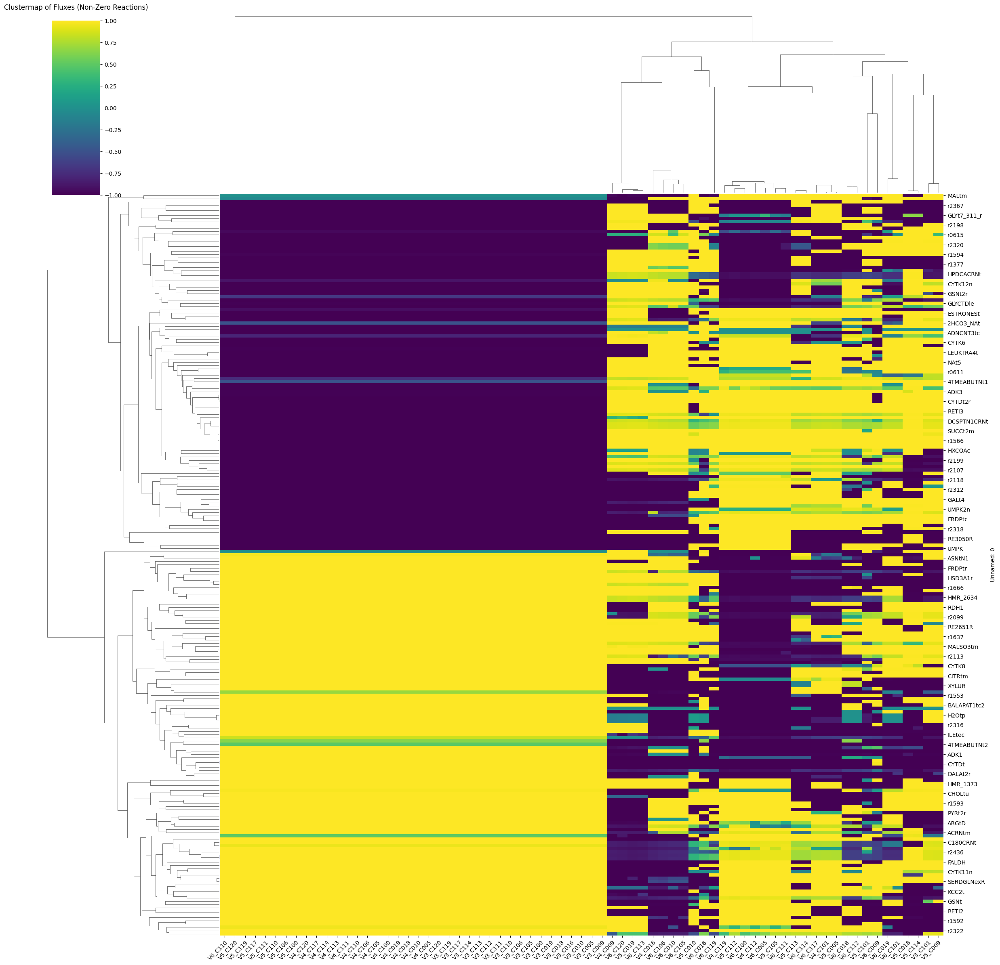

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming non_zero_flux_df is already defined
# Clustermap
g = sns.clustermap(df_filtered, cmap="viridis", figsize=(24, 24), vmin=-1,vmax=1)
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.title('Clustermap of Fluxes (Non-Zero Reactions)', pad=20)

# Save the figure
#plt.savefig(f"..\\results\\GTEx\\data\\Figures\\clustermap_fluxes_non_zero_reactions_{fba_type}.png", dpi=300, bbox_inches="tight")

plt.show()

Correlation with SIRT1 Expression:
 Unnamed: 0
10FTHFtm    -0.457183
2HBt2        0.374873
2HCO3_NAt   -0.327140
2OXOADPTm   -0.088656
3DSPHR      -0.455260
               ...   
PPARA        1.000000
CTSV         1.000000
PLTP         1.000000
PPA1         1.000000
FOXO1        1.000000
Name: SIRT1, Length: 1513, dtype: float64


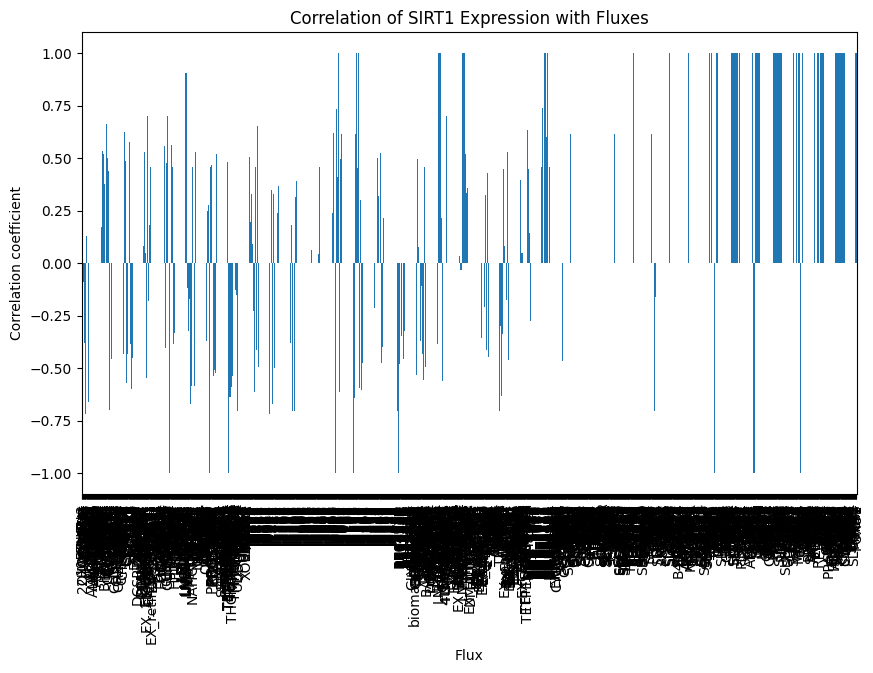

In [13]:
# Ensure SIRT1 data is present in the dataframe
# Example:
# non_zero_df_T['SIRT1'] = your_SIRT1_data

targets_to_drop = list(model.targets.keys())
# Calculate correlation between SIRT1 and each flux column
correlation_with_SIRT1 = non_zero_df_T.corr()['SIRT1'].drop('SIRT1')
filtered_correlation_with_SIRT1 = correlation_with_SIRT1.drop(targets_to_drop, errors='ignore')

print("Correlation with SIRT1 Expression:\n", correlation_with_SIRT1)

# Plot the correlations
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
correlation_with_SIRT1.plot(kind='bar')
plt.title('Correlation of SIRT1 Expression with Fluxes')
plt.ylabel('Correlation coefficient')
plt.xlabel('Flux')
plt.show()


In [14]:
filtered_correlation_with_SIRT1

Unnamed: 0
10FTHFtm    -0.457183
2HBt2        0.374873
2HCO3_NAt   -0.327140
2OXOADPTm   -0.088656
3DSPHR      -0.455260
               ...   
AKR1C4       0.296198
SLC27A2           NaN
FDFT1             NaN
SLCO1B1           NaN
SLCO1A2           NaN
Name: SIRT1, Length: 1223, dtype: float64

Significant Correlations with SIRT1:
           Flux  Correlation       P-value  R-squared
7      ACCOAtr    -0.716645  2.098527e-12   0.513580
18    ADRNCRNt     1.000000  0.000000e+00   1.000000
49    C160CRNt     0.709475  4.342820e-12   0.503354
55    C204CRNt     1.000000  0.000000e+00   1.000000
71       COAtm    -0.784625  5.703429e-16   0.615637
...        ...          ...           ...        ...
1077    SLC4A5     1.000000  0.000000e+00   1.000000
1147   SLC19A3     1.000000  0.000000e+00   1.000000
1154     SGMS1     1.000000  0.000000e+00   1.000000
1184   ALDH9A1     1.000000  0.000000e+00   1.000000
1208   SLC29A2     1.000000  0.000000e+00   1.000000

[107 rows x 4 columns]


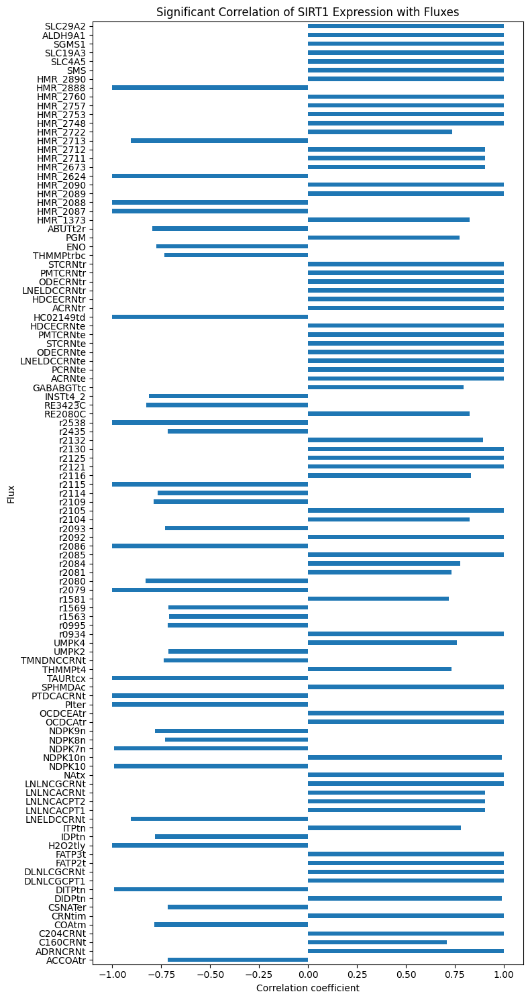

In [44]:
import pandas as pd
import numpy as np
from scipy.stats import linregress
import matplotlib.pyplot as plt

# Assuming 'non_zero_df_T' is already loaded and contains 'SIRT1' column
# Also assuming 'targets_to_drop' is defined from model.targets.keys()

# Calculate correlation and p-values
correlation_results = []
for column in non_zero_df_T.columns:
    if column != 'SIRT1' and column not in targets_to_drop:
        slope, intercept, r_value, p_value, std_err = linregress(non_zero_df_T['SIRT1'], non_zero_df_T[column])
        correlation_results.append({
            'Flux': column,
            'Correlation': r_value,
            'P-value': p_value,
            'R-squared': r_value**2
        })

# Convert to DataFrame
correlation_df = pd.DataFrame(correlation_results)

# Filter for high correlation, statistically significant p-value, and high R-squared
significant_correlations = correlation_df[
    (correlation_df['P-value'] < 0.05) & 
    (correlation_df['R-squared'] > 0.5) &
    (correlation_df['Correlation'].abs() > 0.7)
]

# Display significant correlations
print("Significant Correlations with SIRT1:\n", significant_correlations)

# Plot the filtered correlations with a vertical layout
plt.figure(figsize=(8, 15))
ax = significant_correlations.set_index('Flux')['Correlation'].plot(kind='barh')
plt.title('Significant Correlation of SIRT1 Expression with Fluxes')
plt.xlabel('Correlation coefficient')
plt.ylabel('Flux')

# Rotate y-axis labels for better readability if needed
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')
plt.tight_layout()

plt.show()


In [48]:
significant_correlations_list = significant_correlations["Flux"].to_list()

In [50]:
df.loc[significant_correlations_list].to_excel("..\\results\\Infant_Microbiome_Butyrate\\significant_correlations.xlsx")

In [71]:
!pip install ace_tools

ERROR: Could not find a version that satisfies the requirement ace_tools (from versions: none)
ERROR: No matching distribution found for ace_tools


In [15]:
filtered_correlation_with_SIRT1 = correlation_with_SIRT1.drop(targets_to_drop, errors='ignore')

In [21]:
sorted_series = filtered_correlation_with_SIRT1.abs().sort_values(ascending=False)

# Applying the sorted index to the original series to maintain original values
sorted_series = filtered_correlation_with_SIRT1.loc[sorted_series.index]

In [25]:
df.loc[sorted_series[:200].index.to_list()].to_excel("..\\results\\Infant_Microbiome_Butyrate\\top_200_most_significant_correlations.xlsx")

In [57]:
# Linear regression analysis
from scipy.stats import linregress

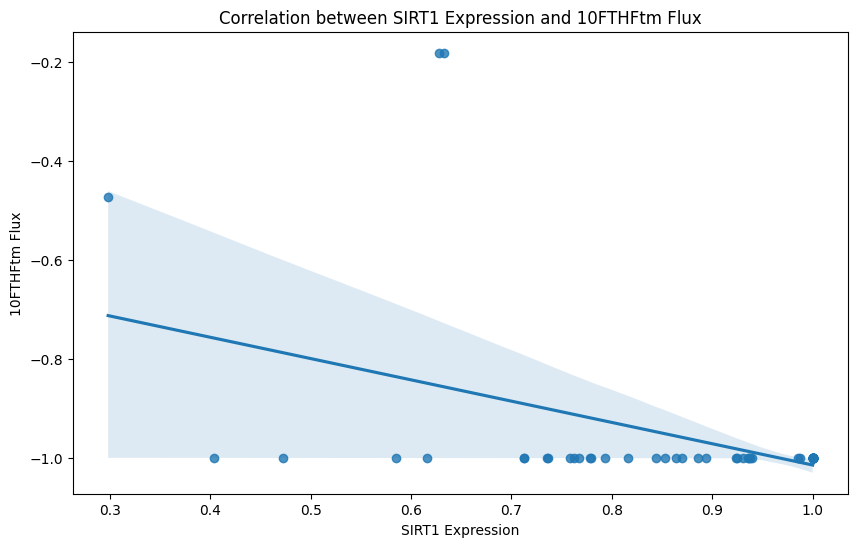

Linear regression results for SIRT1 and 10FTHFtm:
Slope: -0.4295614765058998
Intercept: -0.5840224074462554
R-squared: 0.20901636373556304
P-value: 6.122232029766571e-05
Standard error: 0.10059916745841428



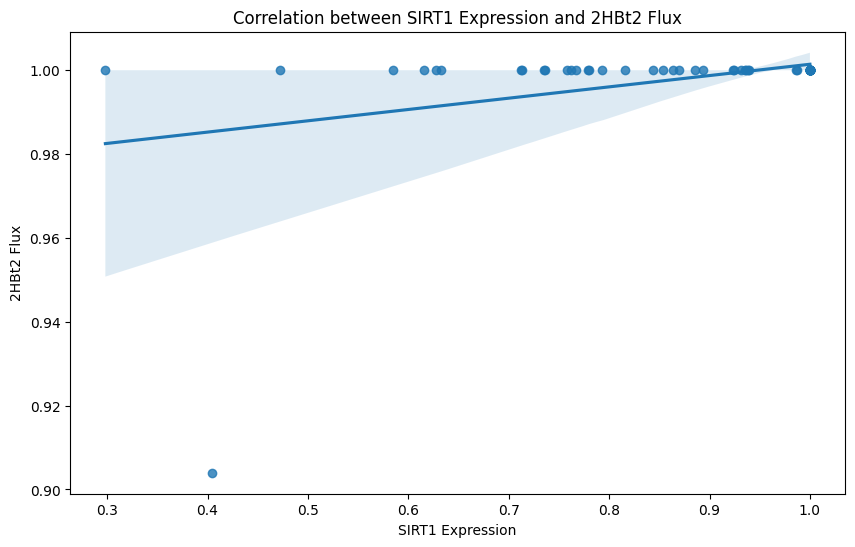

Linear regression results for SIRT1 and 2HBt2:
Slope: 0.026974287746097086
Intercept: 0.9744477991511935
R-squared: 0.14052942307431637
P-value: 0.0012774825911393726
Standard error: 0.00803077236390914



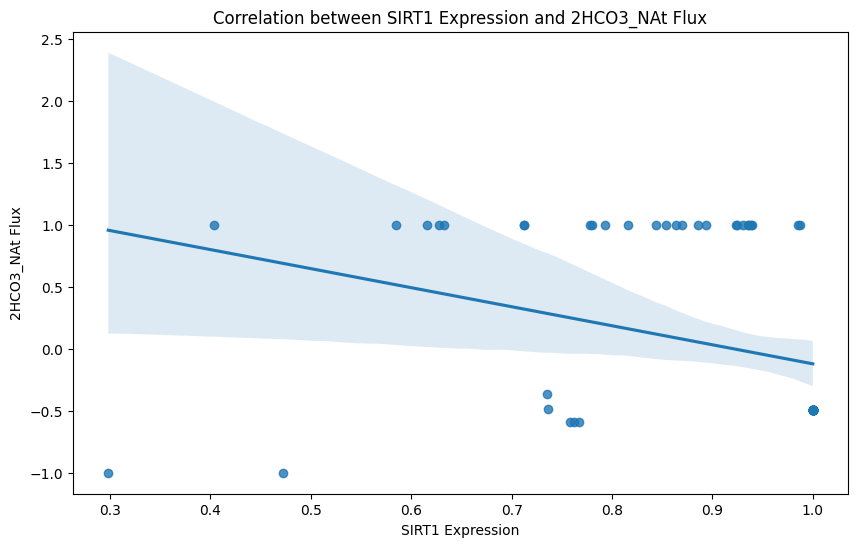

Linear regression results for SIRT1 and 2HCO3_NAt:
Slope: -1.5351847485338568
Intercept: 1.413135180369322
R-squared: 0.1070207101032135
P-value: 0.005358229378276423
Standard error: 0.5338544670932224



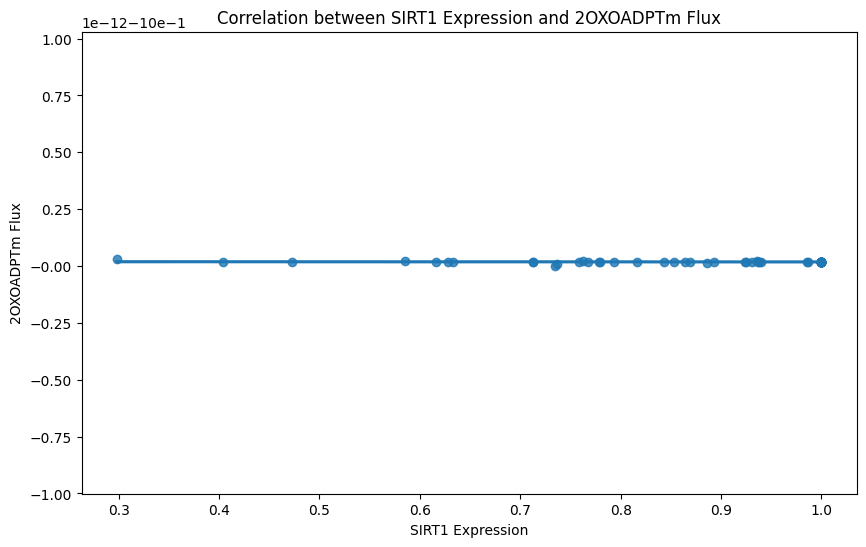

Linear regression results for SIRT1 and 2OXOADPTm:
Slope: -1.6204385598653227e-15
Intercept: -0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



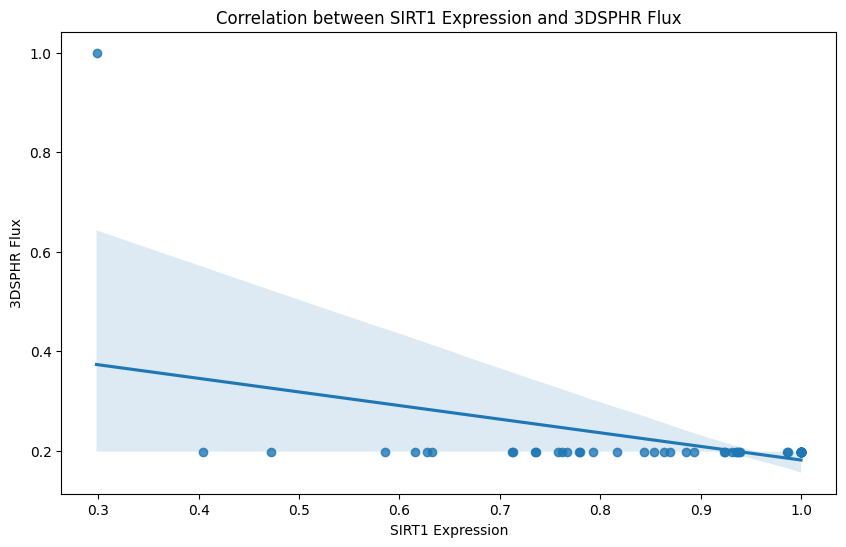

Linear regression results for SIRT1 and 3DSPHR:
Slope: -0.27359581843282493
Intercept: 0.4548604256245904
R-squared: 0.20726185396935212
P-value: 6.633427550940555e-05
Standard error: 0.0644154580131101



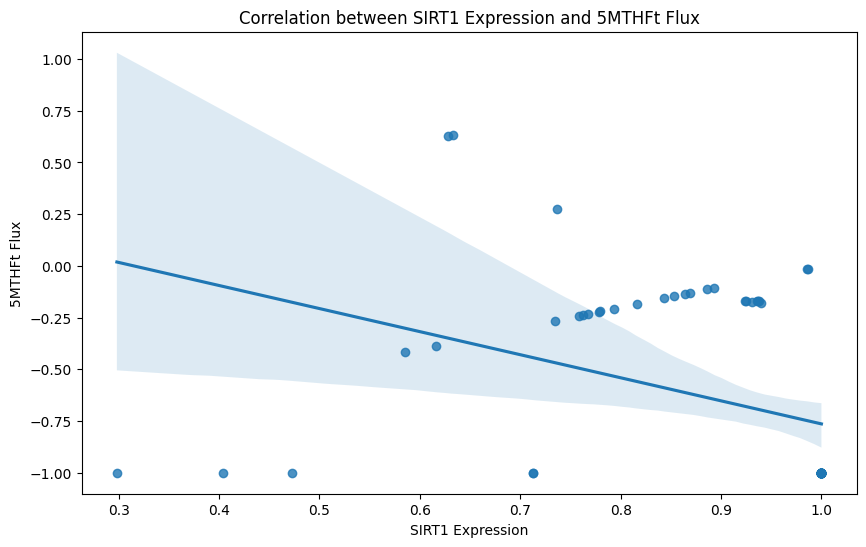

Linear regression results for SIRT1 and 5MTHFt:
Slope: -1.1150109937643142
Intercept: 0.35099945398136845
R-squared: 0.1456563103678243
P-value: 0.0010234209592427561
Standard error: 0.32509198311797566



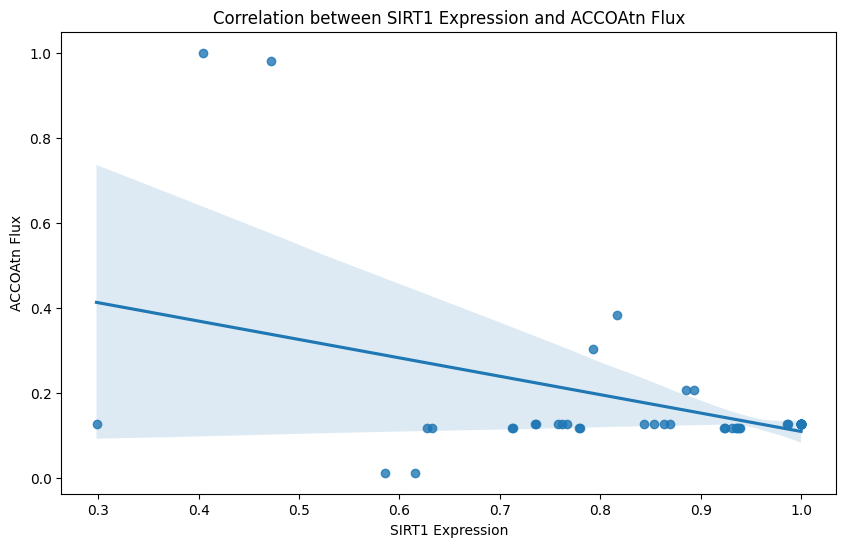

Linear regression results for SIRT1 and ACCOAtn:
Slope: -0.432400764778259
Intercept: 0.5420230816586586
R-squared: 0.20833202731259698
P-value: 6.316865041232708e-05
Standard error: 0.10147415087115964



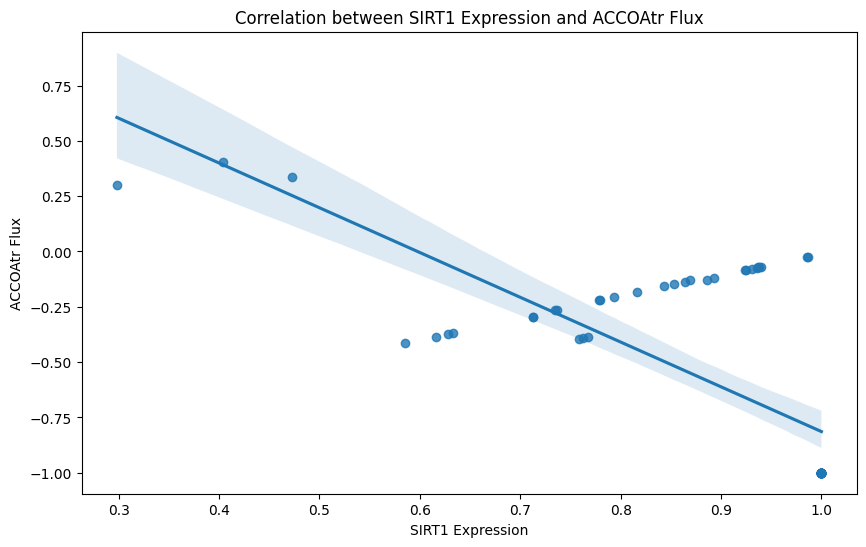

Linear regression results for SIRT1 and ACCOAtr:
Slope: -2.0232307633118647
Intercept: 1.209210460494204
R-squared: 0.5135800117108026
P-value: 2.0985270904832785e-12
Standard error: 0.23704048361474409



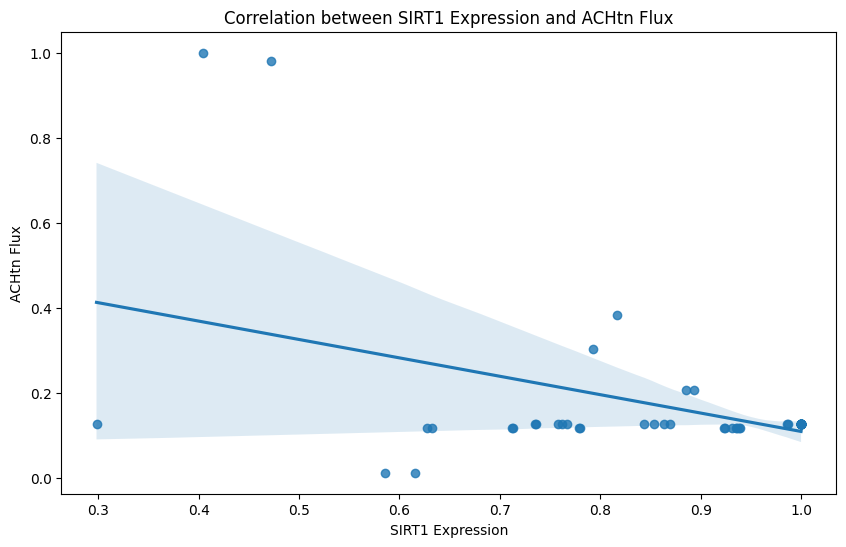

Linear regression results for SIRT1 and ACHtn:
Slope: -0.432400764778259
Intercept: 0.5420230816586586
R-squared: 0.20833202731259698
P-value: 6.316865041232708e-05
Standard error: 0.10147415087115964



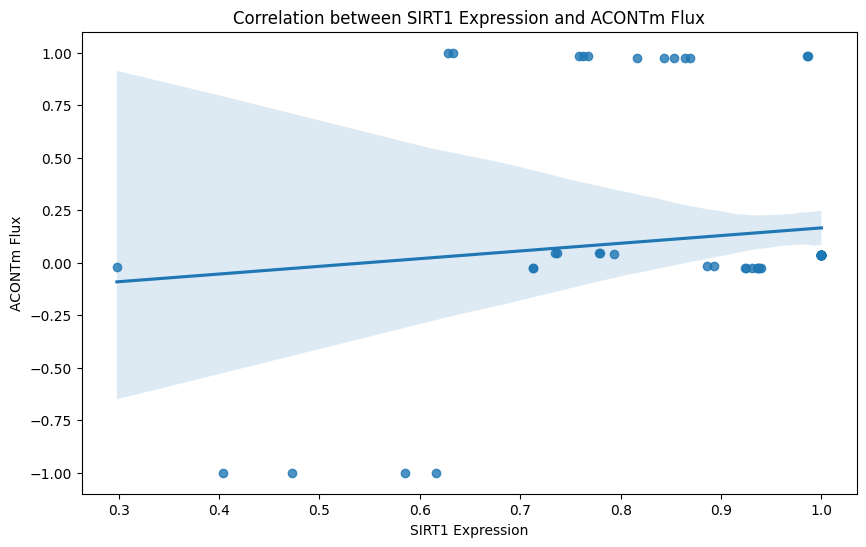

Linear regression results for SIRT1 and ACONTm:
Slope: 0.36624316681187424
Intercept: -0.200338951400302
R-squared: 0.016214532188526604
P-value: 0.2899529825432027
Standard error: 0.34343375245514796



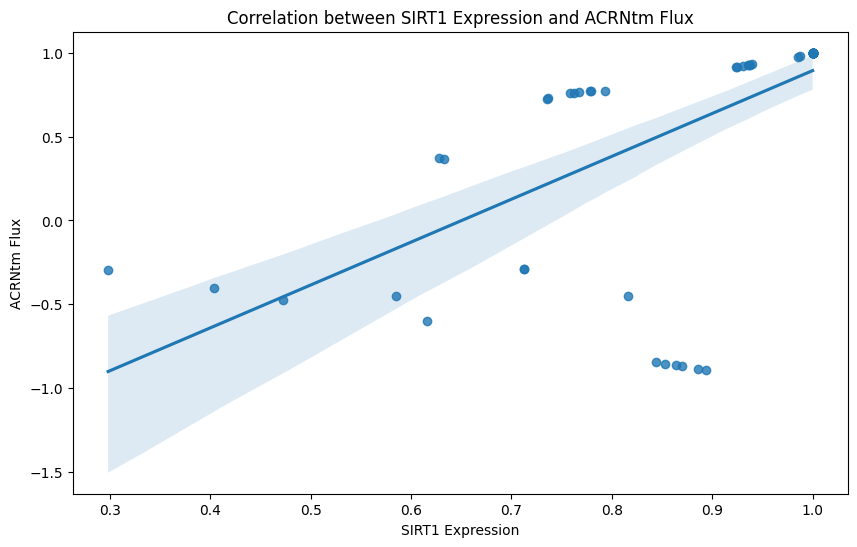

Linear regression results for SIRT1 and ACRNtm:
Slope: 2.5572587806155322
Intercept: -1.6637152759769889
R-squared: 0.4036740912198985
P-value: 2.6515099015496402e-09
Standard error: 0.3741765224073197



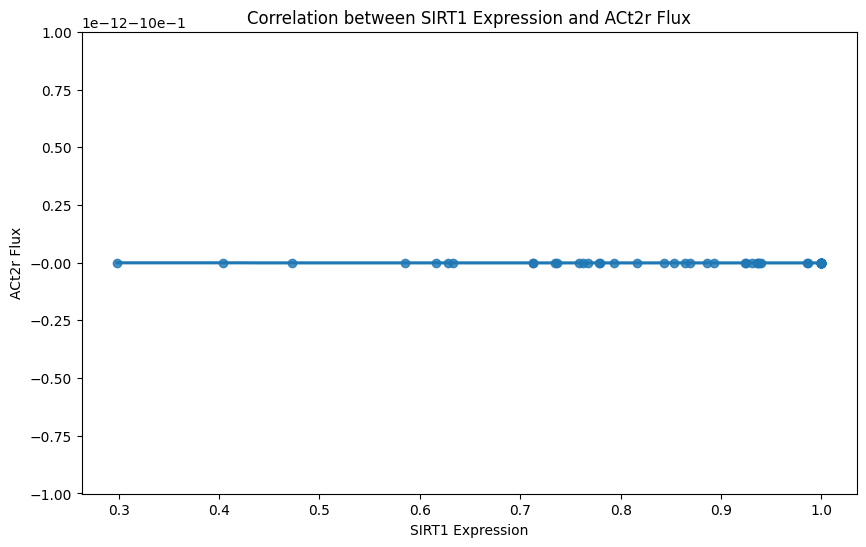

Linear regression results for SIRT1 and ACt2r:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



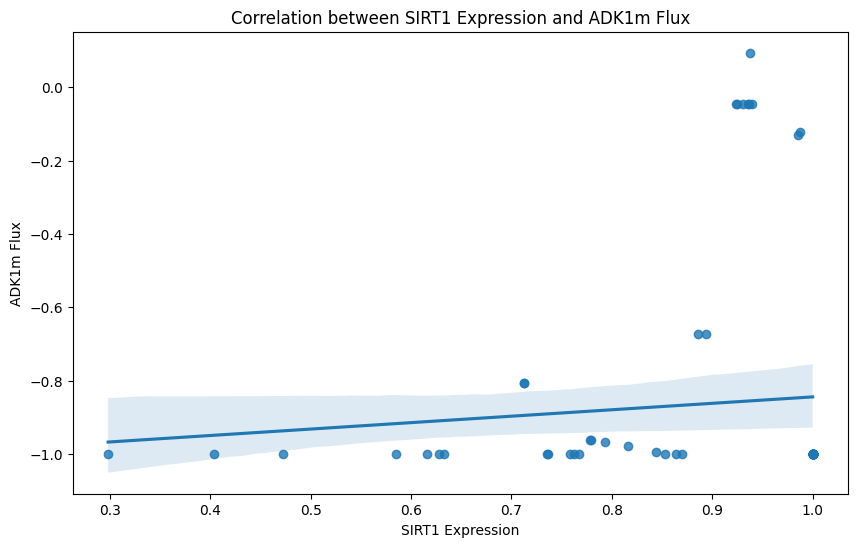

Linear regression results for SIRT1 and ADK1m:
Slope: 0.1755748908345321
Intercept: -1.0202080150808026
R-squared: 0.007565614346551504
P-value: 0.47074307279442285
Standard error: 0.24208432154074988



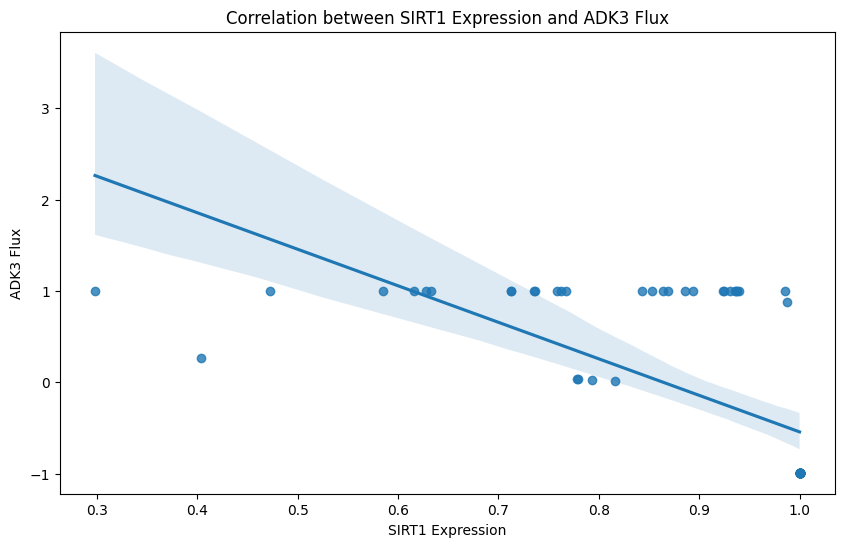

Linear regression results for SIRT1 and ADK3:
Slope: -3.9996903764339007
Intercept: 3.4559916819031966
R-squared: 0.4394162133470817
P-value: 3.0207341936938584e-10
Standard error: 0.5438561644506297



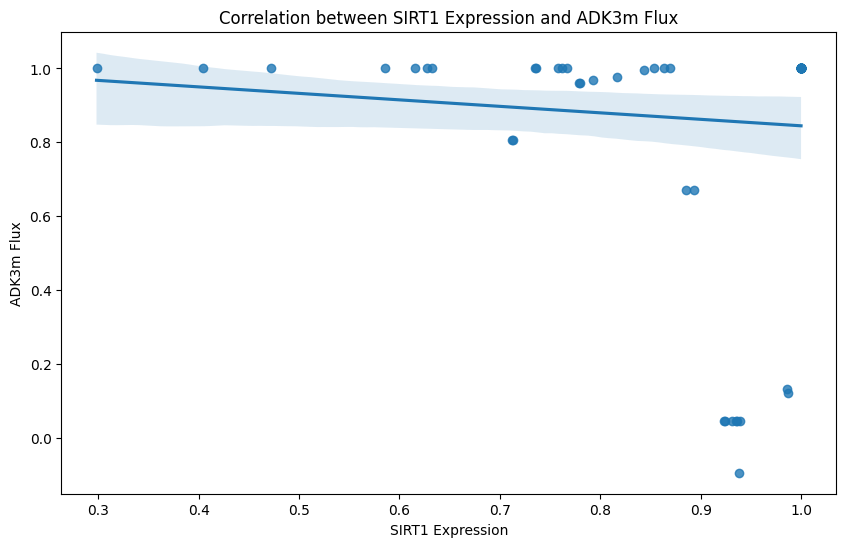

Linear regression results for SIRT1 and ADK3m:
Slope: -0.1755748908345321
Intercept: 1.0202080150808026
R-squared: 0.007565614346551504
P-value: 0.47074307279442285
Standard error: 0.24208432154074988



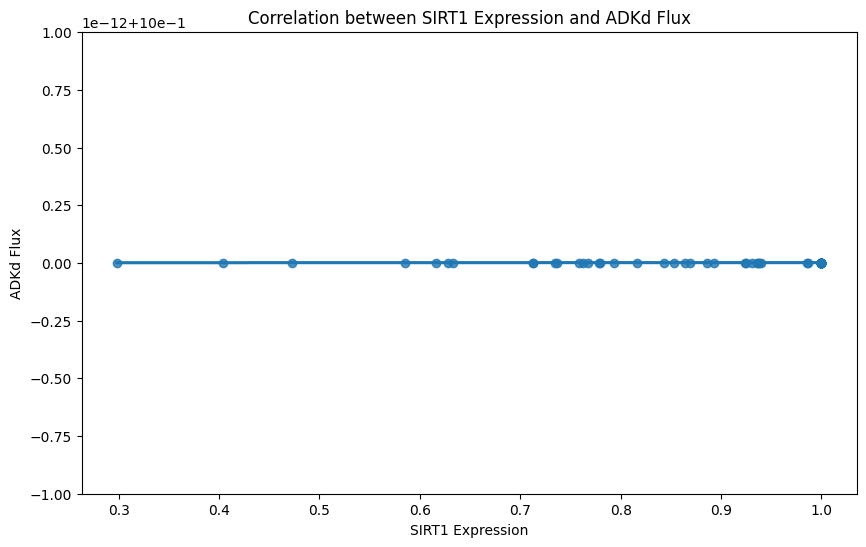

Linear regression results for SIRT1 and ADKd:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



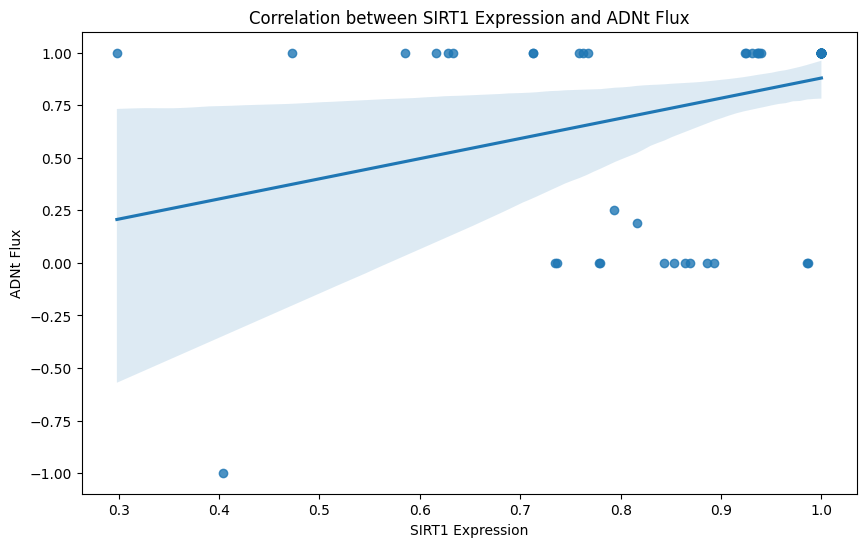

Linear regression results for SIRT1 and ADNt:
Slope: 0.9587761362048137
Intercept: -0.07912482625976625
R-squared: 0.11706602253124557
P-value: 0.003494442843933812
Standard error: 0.3169869287759333



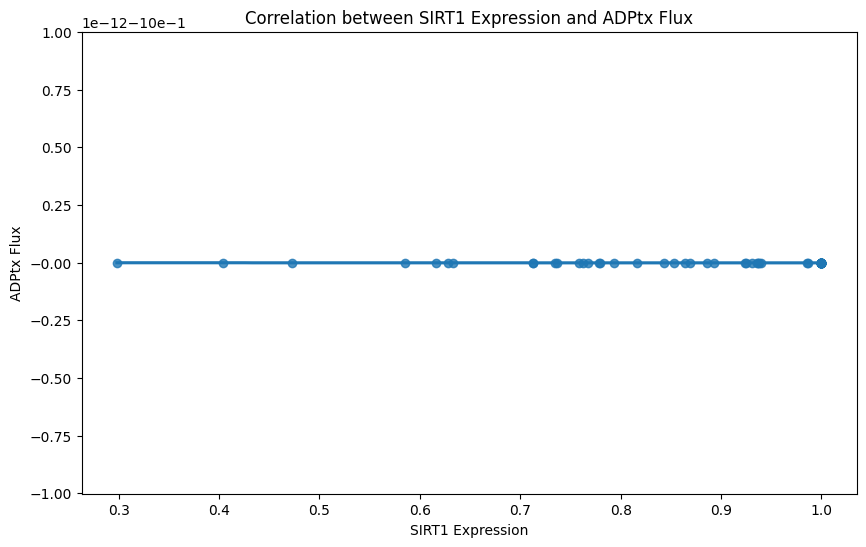

Linear regression results for SIRT1 and ADPtx:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



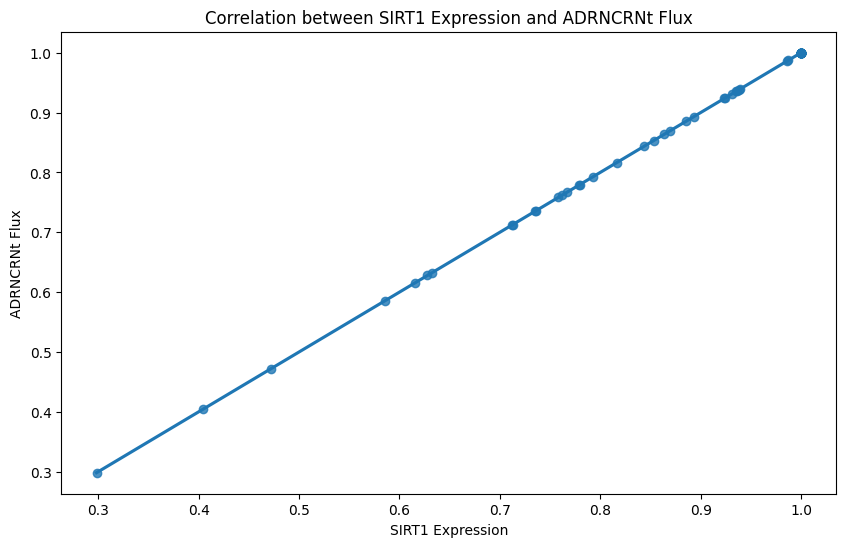

Linear regression results for SIRT1 and ADRNCRNt:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



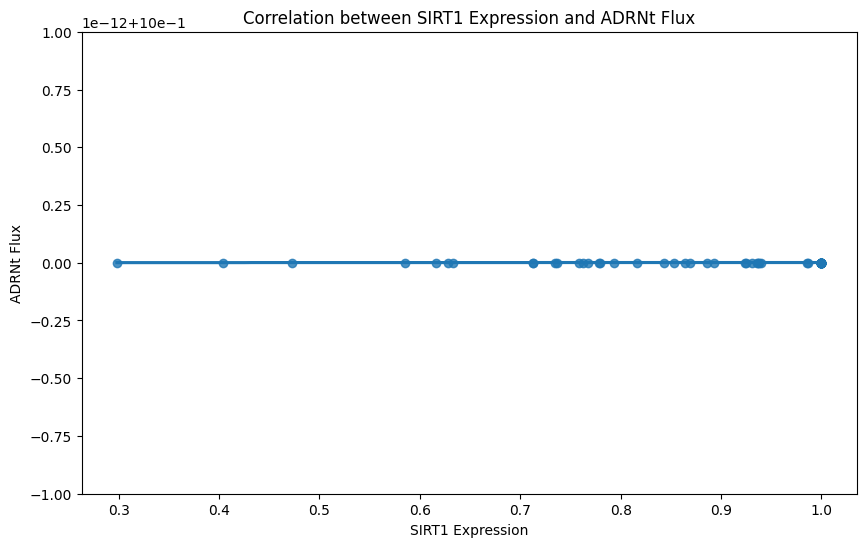

Linear regression results for SIRT1 and ADRNt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



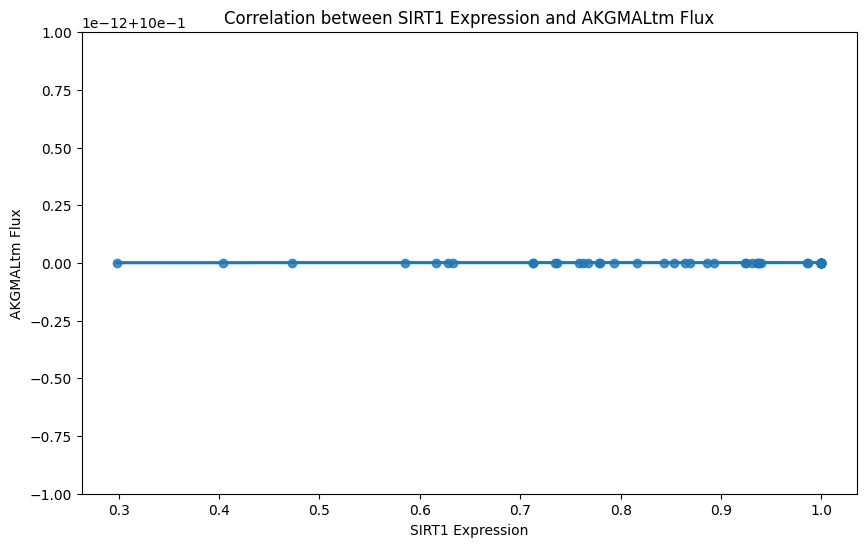

Linear regression results for SIRT1 and AKGMALtm:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



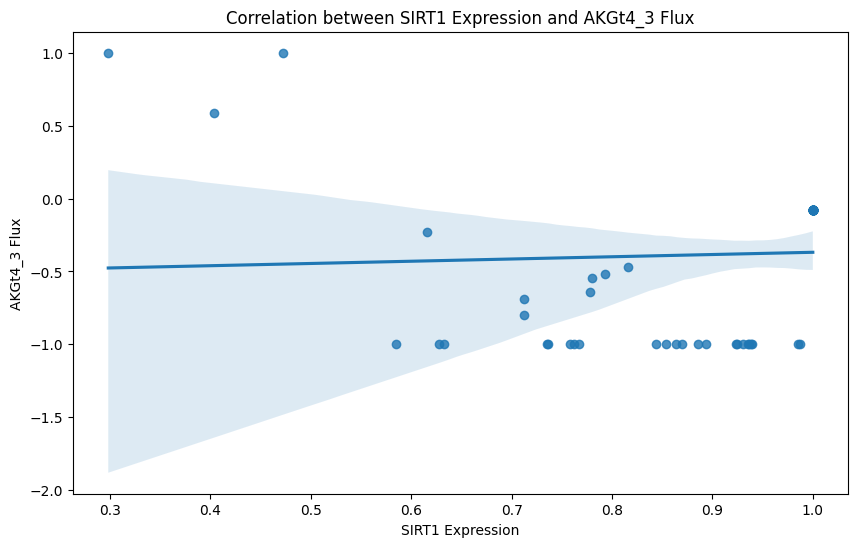

Linear regression results for SIRT1 and AKGt4_3:
Slope: 0.15354852291210086
Intercept: -0.5223462897215665
R-squared: 0.0023730499438355825
P-value: 0.6866356525502626
Standard error: 0.37901093898749777



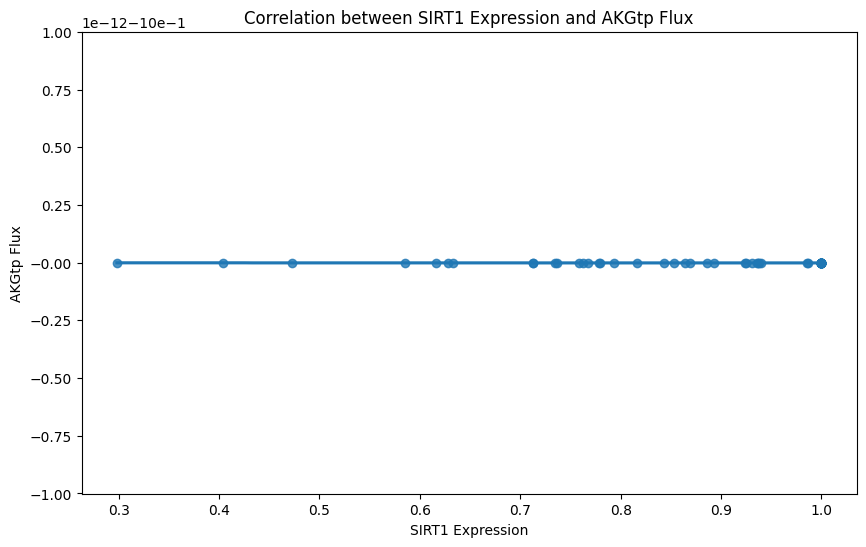

Linear regression results for SIRT1 and AKGtp:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



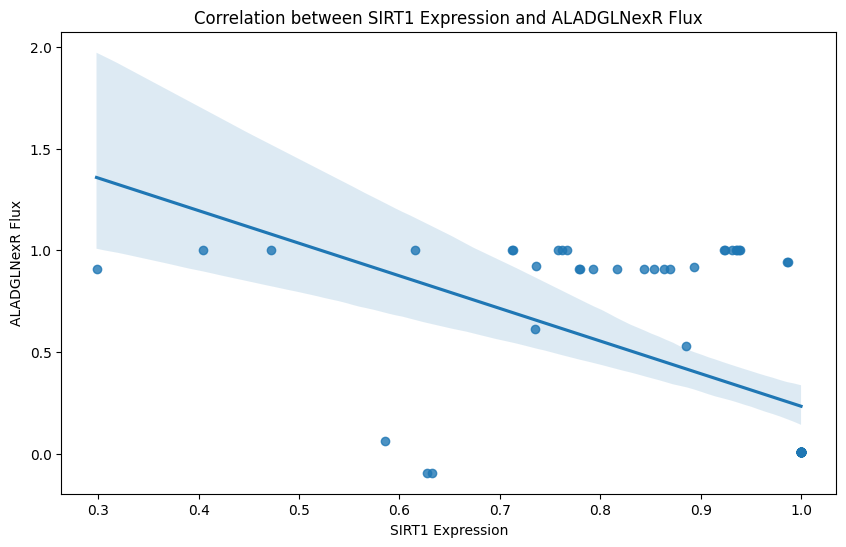

Linear regression results for SIRT1 and ALADGLNexR:
Slope: -1.6024623263724682
Intercept: 1.8359873669715612
R-squared: 0.2949929328217348
P-value: 9.888456712845016e-07
Standard error: 0.29823198020895914



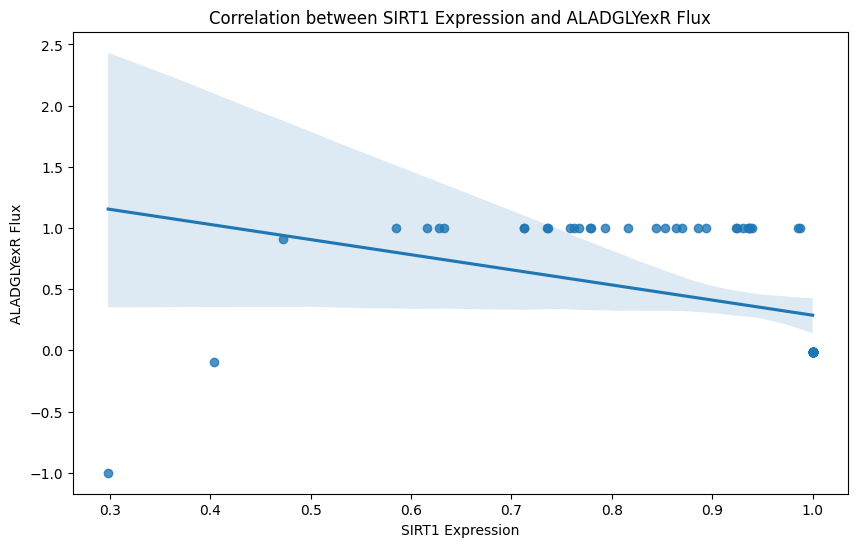

Linear regression results for SIRT1 and ALADGLYexR:
Slope: -1.2360863838485587
Intercept: 1.5234831650144482
R-squared: 0.13654681324088336
P-value: 0.001516850091798259
Standard error: 0.37419923127058674



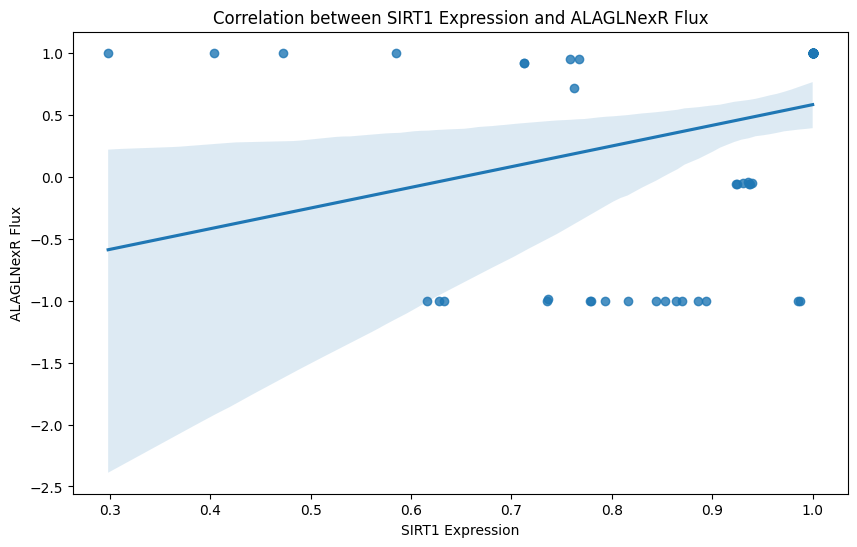

Linear regression results for SIRT1 and ALAGLNexR:
Slope: 1.6683759138054615
Intercept: -1.087237056103672
R-squared: 0.09562255998437817
P-value: 0.008690090124274165
Standard error: 0.6176807160493514



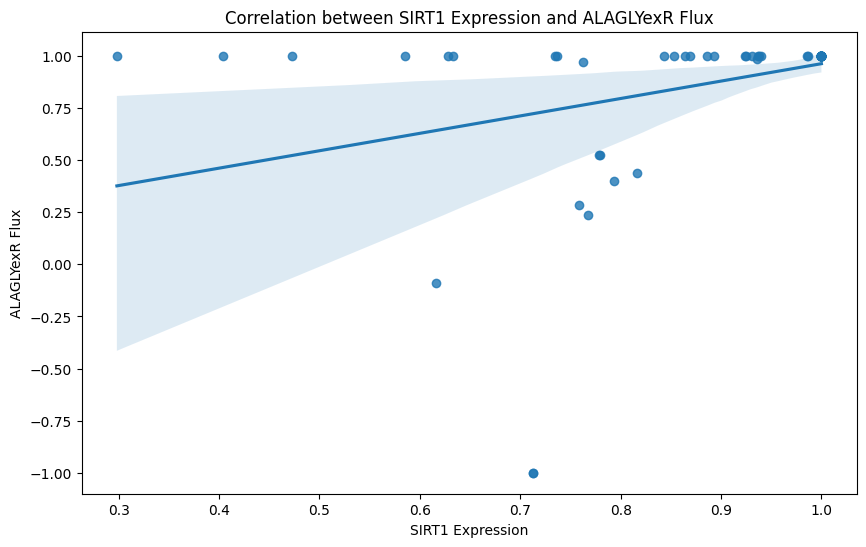

Linear regression results for SIRT1 and ALAGLYexR:
Slope: 0.8356746174508414
Intercept: 0.1273512456534991
R-squared: 0.11860182051506518
P-value: 0.0032728923643936514
Standard error: 0.27425405824713595



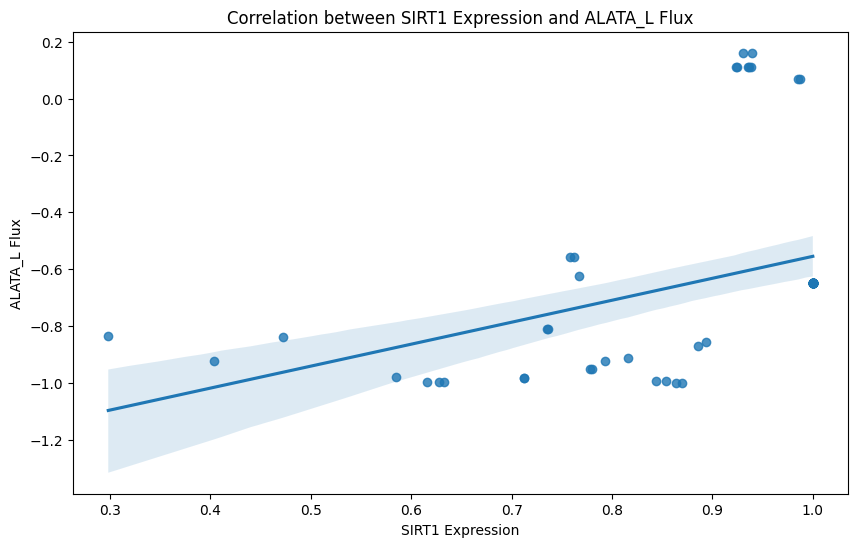

Linear regression results for SIRT1 and ALATA_L:
Slope: 0.7714956589241811
Intercept: -1.325927871053124
R-squared: 0.14902068553374268
P-value: 0.0008844597025037047
Standard error: 0.22194489724794003



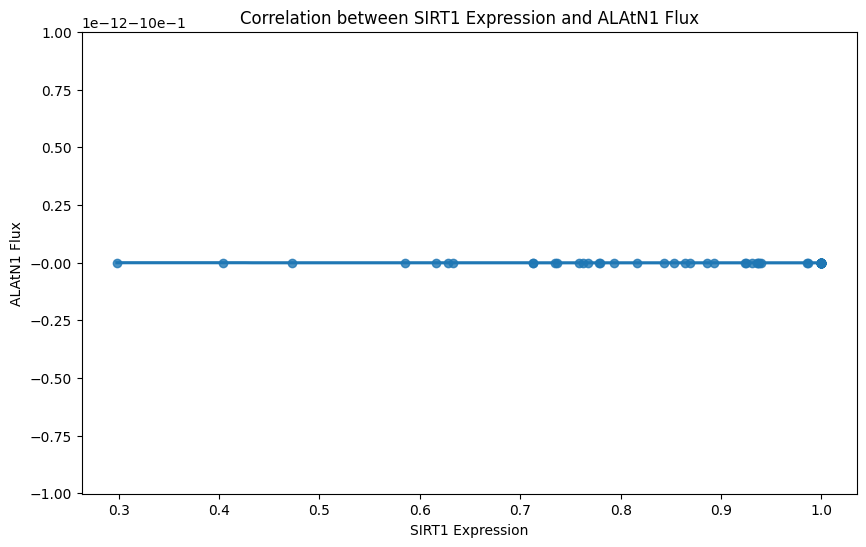

Linear regression results for SIRT1 and ALAtN1:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



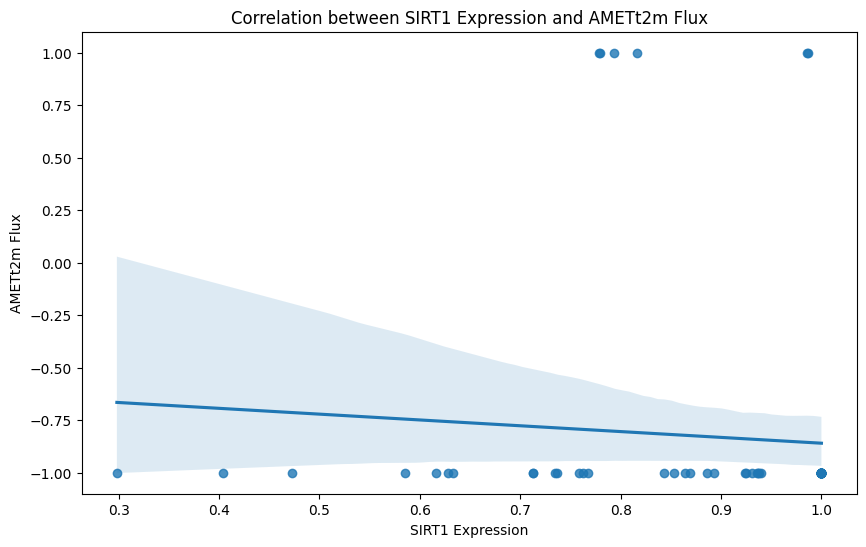

Linear regression results for SIRT1 and AMETt2m:
Slope: -0.27681869664557485
Intercept: -0.5826388475604516
R-squared: 0.006122006179760728
P-value: 0.516608341068919
Standard error: 0.4246103046763848



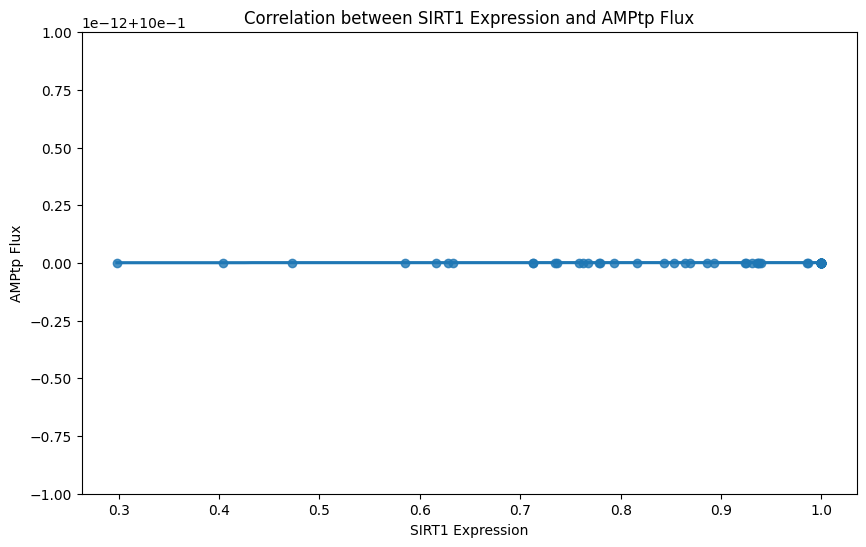

Linear regression results for SIRT1 and AMPtp:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



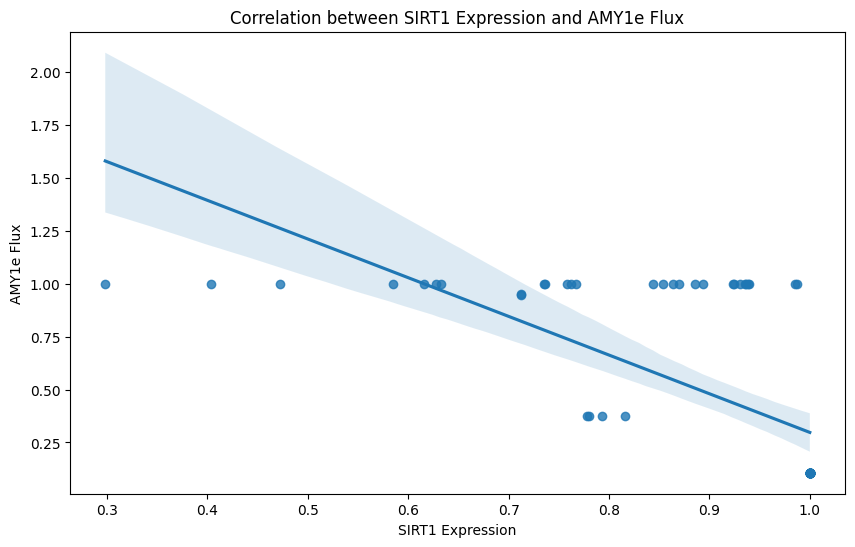

Linear regression results for SIRT1 and AMY1e:
Slope: -1.8280645346643143
Intercept: 2.125250745014519
R-squared: 0.44850537504066046
P-value: 1.7021712245047777e-10
Standard error: 0.24403594152486893



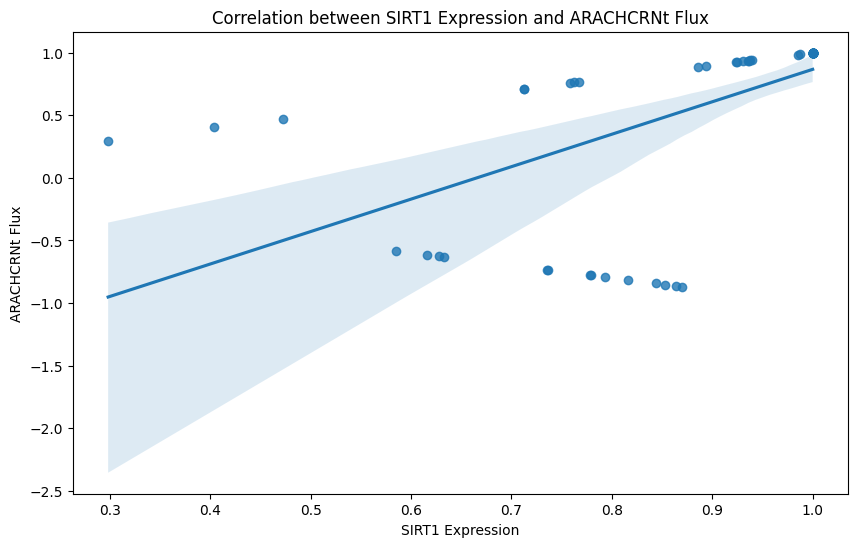

Linear regression results for SIRT1 and ARACHCRNt:
Slope: 2.5932003654021782
Intercept: -1.7259434039636747
R-squared: 0.35453300123510095
P-value: 4.327644052672766e-08
Standard error: 0.4212308947262819



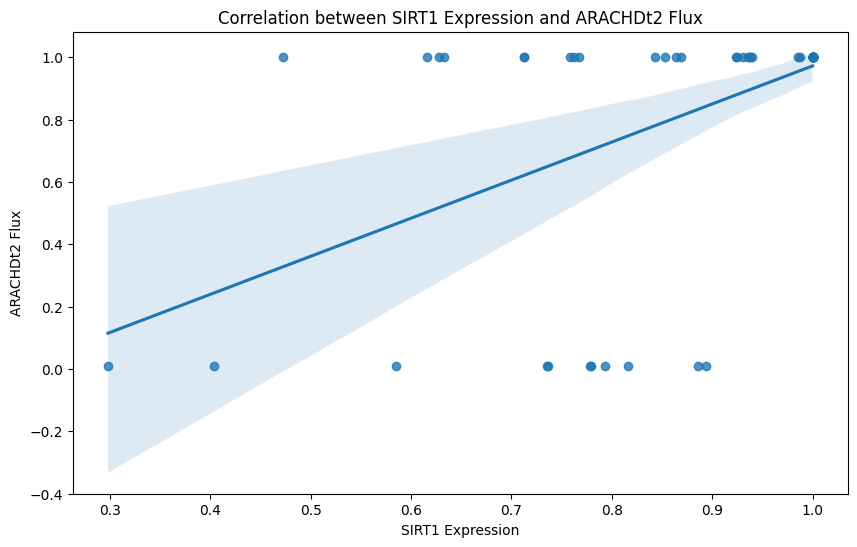

Linear regression results for SIRT1 and ARACHDt2:
Slope: 1.2217610611138172
Intercept: -0.24963060156504813
R-squared: 0.28703211629889164
P-value: 1.4750639543304061e-06
Standard error: 0.23180962863110222



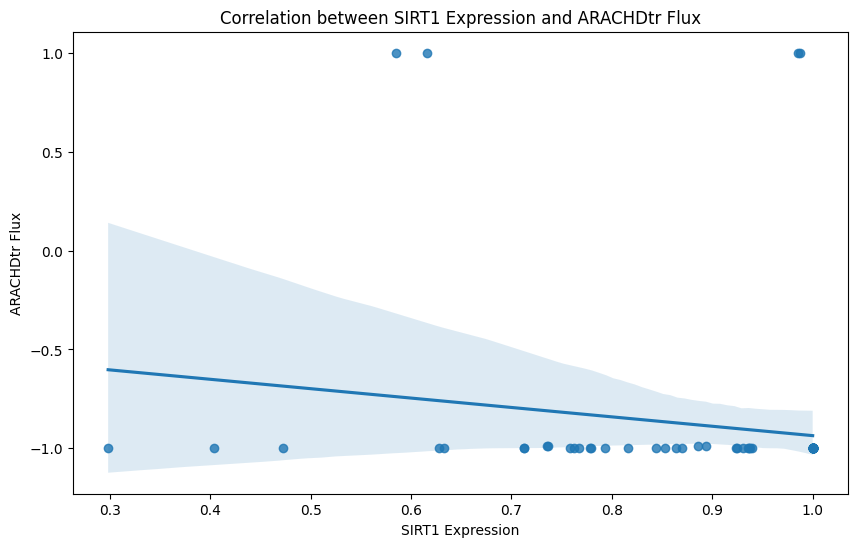

Linear regression results for SIRT1 and ARACHDtr:
Slope: -0.47473619860900484
Intercept: -0.46085239345911583
R-squared: 0.026217177233538468
P-value: 0.17732331736471593
Standard error: 0.34830995910902246



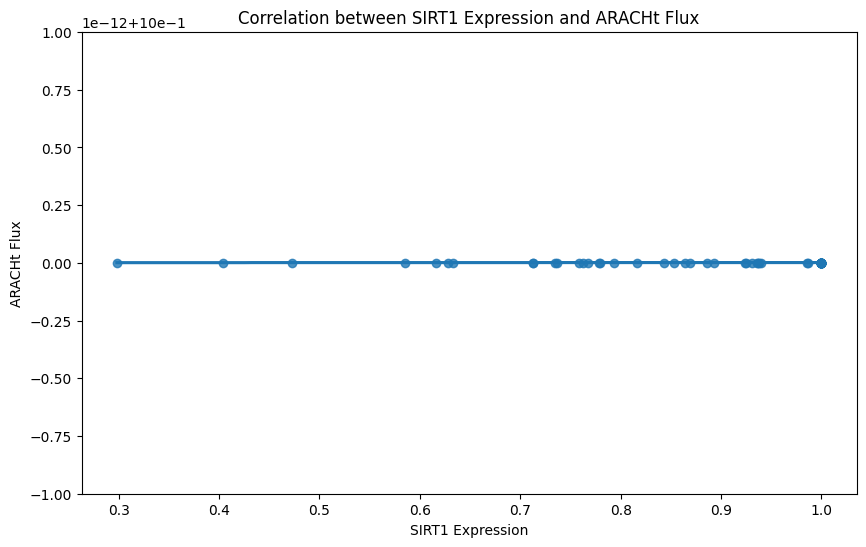

Linear regression results for SIRT1 and ARACHt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



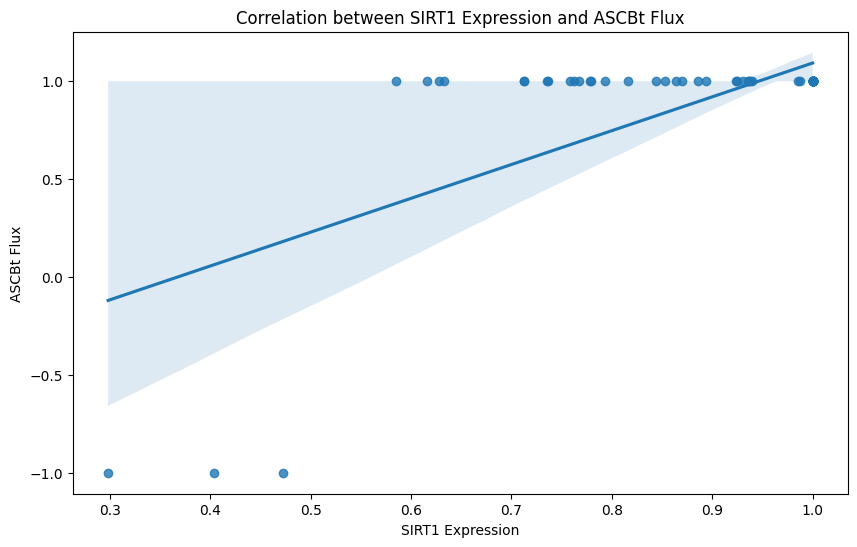

Linear regression results for SIRT1 and ASCBt:
Slope: 1.7284493326840358
Intercept: -0.6351802050261025
R-squared: 0.4563002122297234
P-value: 1.0332236442853775e-10
Standard error: 0.2271361992234



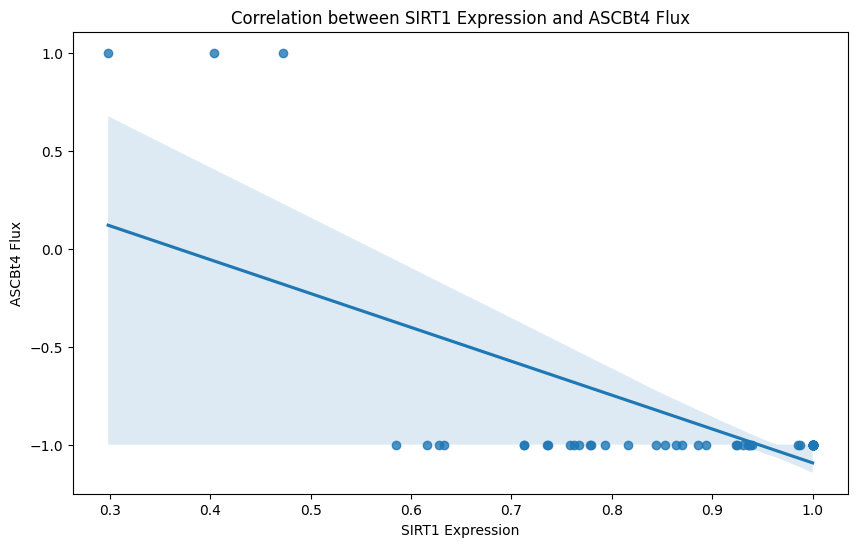

Linear regression results for SIRT1 and ASCBt4:
Slope: -1.7284493326840358
Intercept: 0.6351802050261025
R-squared: 0.4563002122297234
P-value: 1.0332236442853775e-10
Standard error: 0.2271361992234



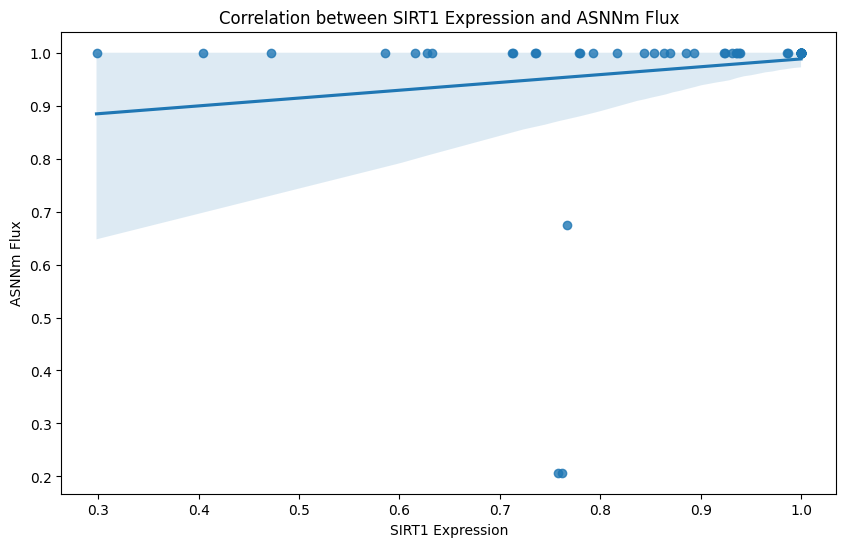

Linear regression results for SIRT1 and ASNNm:
Slope: 0.14777041563432716
Intercept: 0.8405093496131859
R-squared: 0.02921175991355441
P-value: 0.15412884001644953
Standard error: 0.10255252116099546



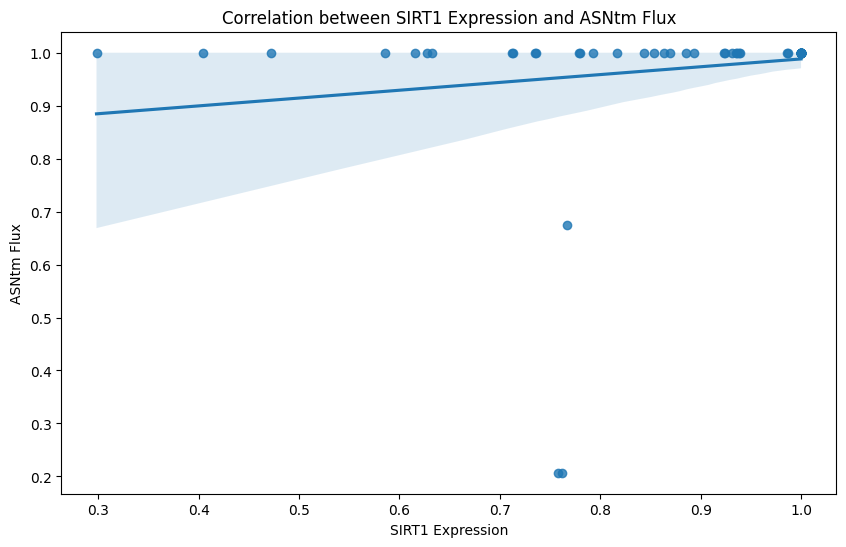

Linear regression results for SIRT1 and ASNtm:
Slope: 0.14777041563432716
Intercept: 0.8405093496131859
R-squared: 0.02921175991355441
P-value: 0.15412884001644953
Standard error: 0.10255252116099546



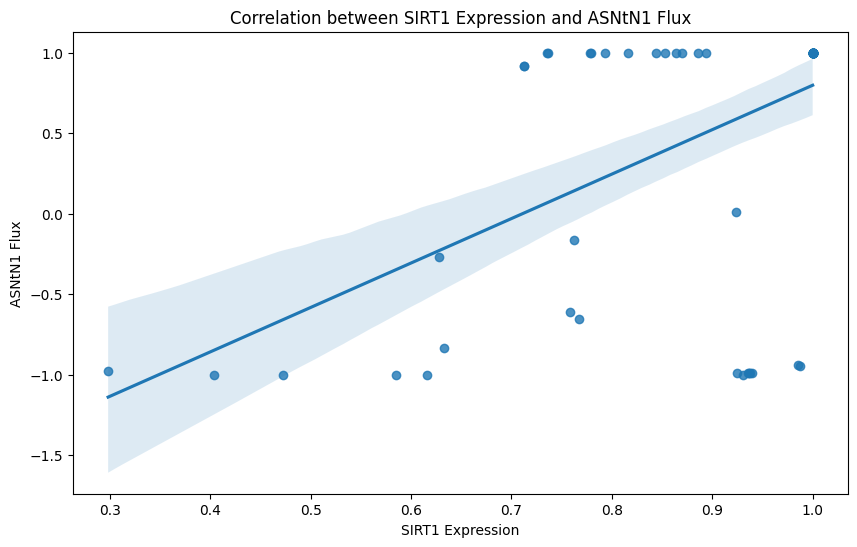

Linear regression results for SIRT1 and ASNtN1:
Slope: 2.760533243654932
Intercept: -1.962434097153423
R-squared: 0.28374687461246995
P-value: 1.7377181790706e-06
Standard error: 0.5280027176082172



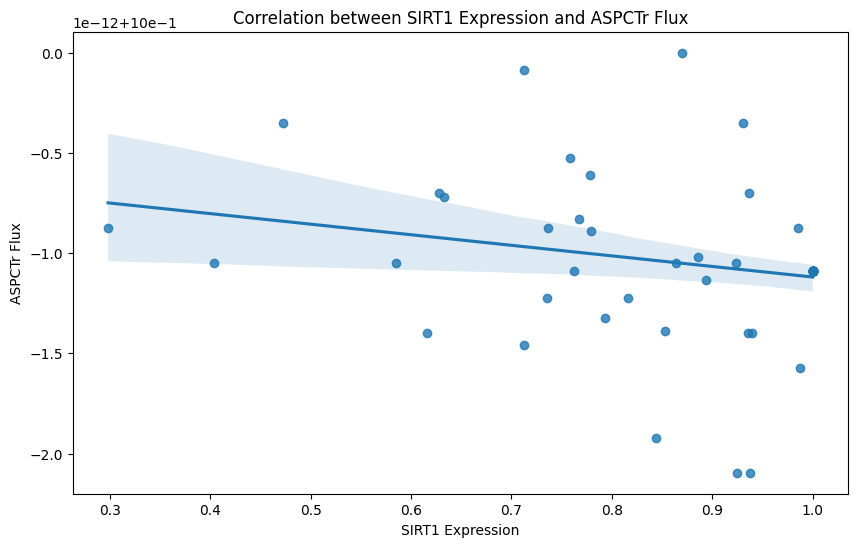

Linear regression results for SIRT1 and ASPCTr:
Slope: -5.277829540545984e-13
Intercept: 0.9999999999994079
R-squared: 0.06079076289091417
P-value: 0.03819330844196844
Standard error: 2.4974292565829327e-13



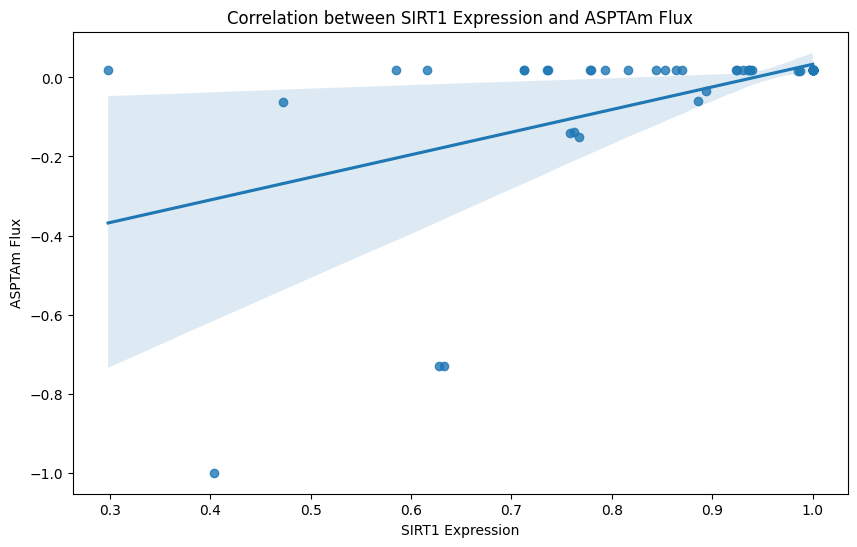

Linear regression results for SIRT1 and ASPTAm:
Slope: 0.5719183110801159
Intercept: -0.538777259561062
R-squared: 0.27171858190490583
P-value: 3.148438050562259e-06
Standard error: 0.11271959017650834



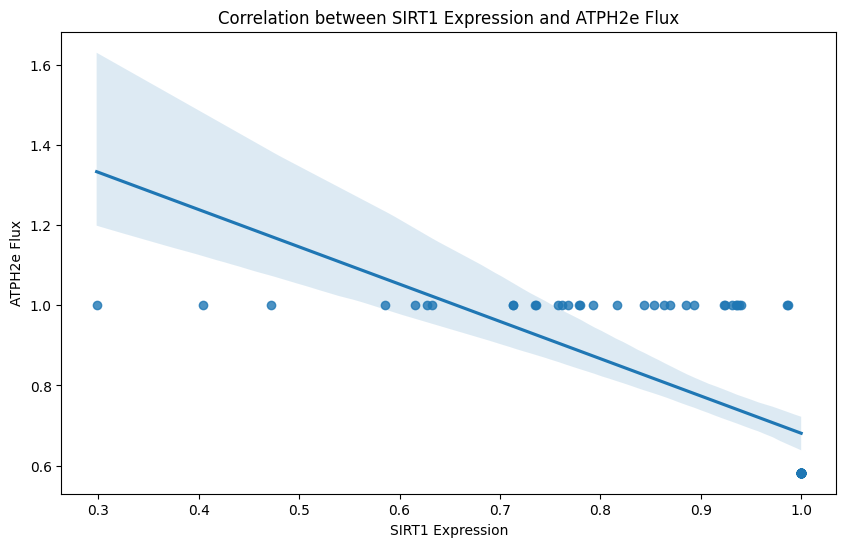

Linear regression results for SIRT1 and ATPH2e:
Slope: -0.9306353430384663
Intercept: 1.611212863196387
R-squared: 0.49271140514695655
P-value: 9.117085759106804e-12
Standard error: 0.11368056882526818



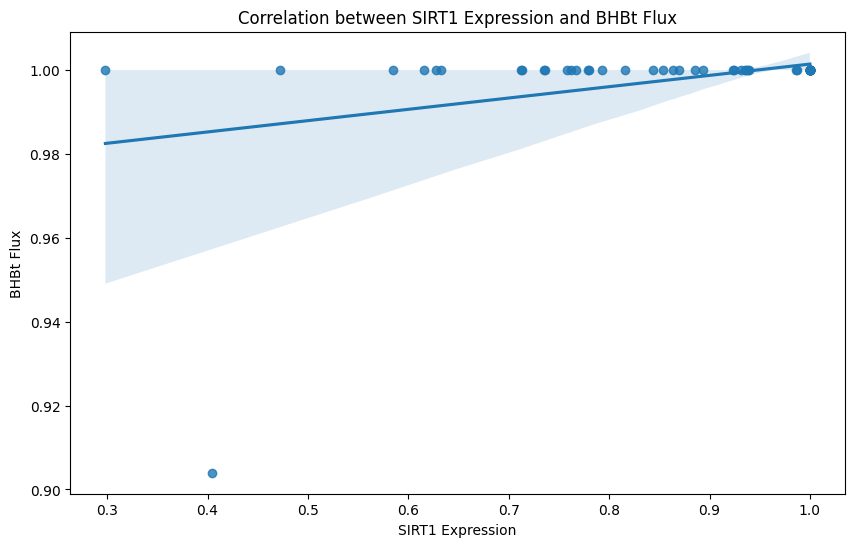

Linear regression results for SIRT1 and BHBt:
Slope: 0.026974287746097086
Intercept: 0.9744477991511935
R-squared: 0.14052942307431637
P-value: 0.0012774825911393726
Standard error: 0.00803077236390914



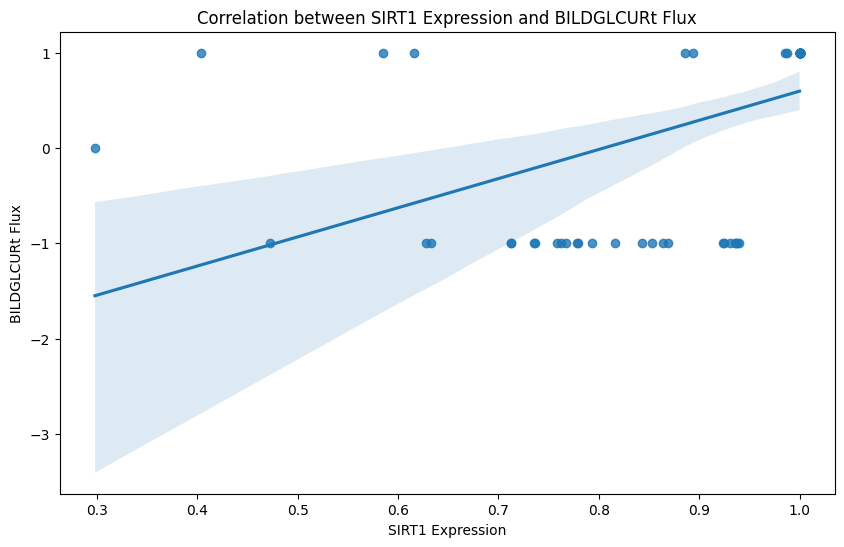

Linear regression results for SIRT1 and BILDGLCURt:
Slope: 3.0598429832478238
Intercept: -2.4634318216679922
R-squared: 0.25533567868937423
P-value: 6.977318492856518e-06
Standard error: 0.6290702062472137



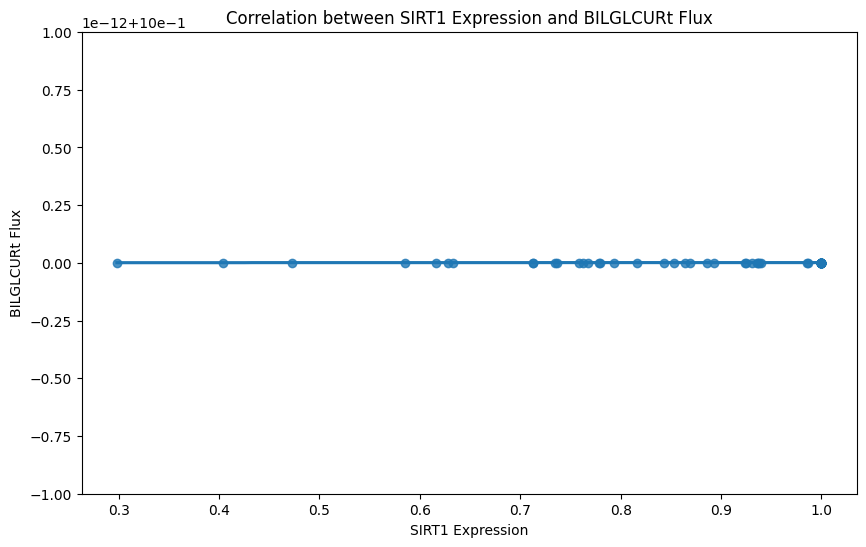

Linear regression results for SIRT1 and BILGLCURt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



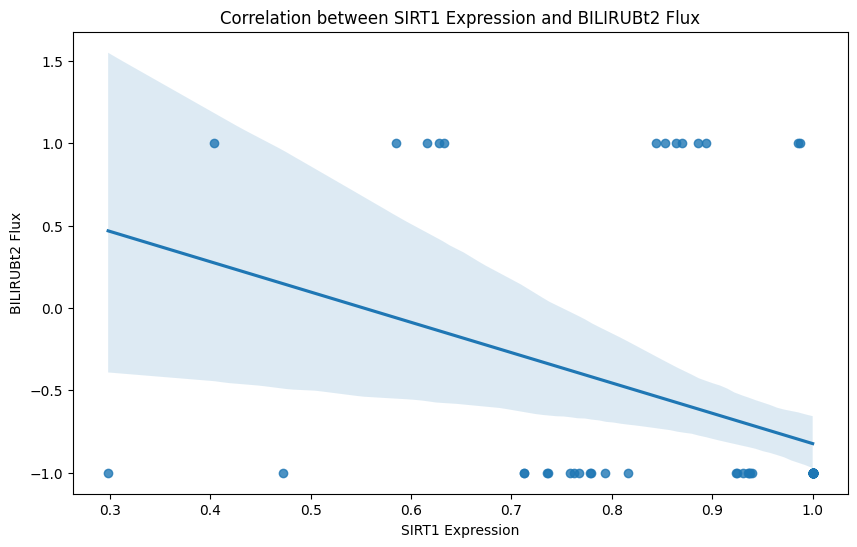

Linear regression results for SIRT1 and BILIRUBt2:
Slope: -1.8409748585322785
Intercept: 1.017822285717037
R-squared: 0.14005283387235426
P-value: 0.0013040390254072363
Standard error: 0.5491781459713138



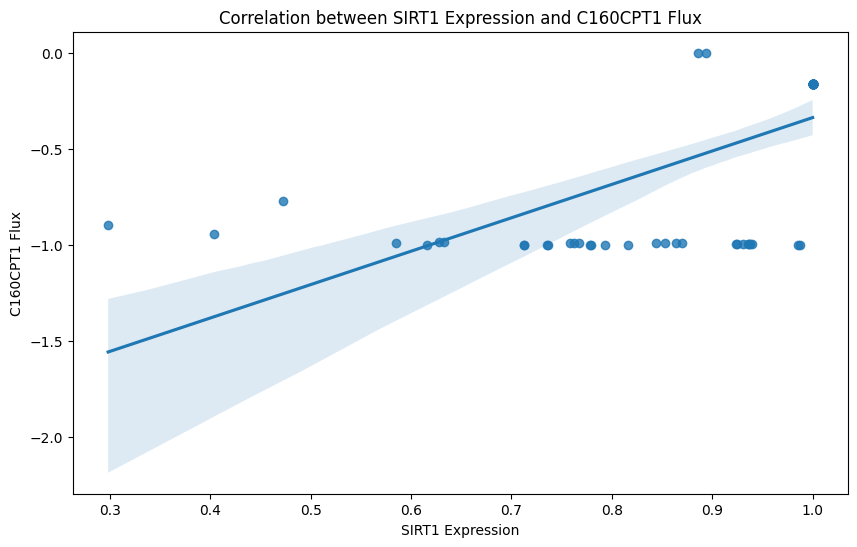

Linear regression results for SIRT1 and C160CPT1:
Slope: 1.7390213934908254
Intercept: -2.0767698035793822
R-squared: 0.439770503727145
P-value: 2.9544419390522893e-10
Standard error: 0.23629270625021173



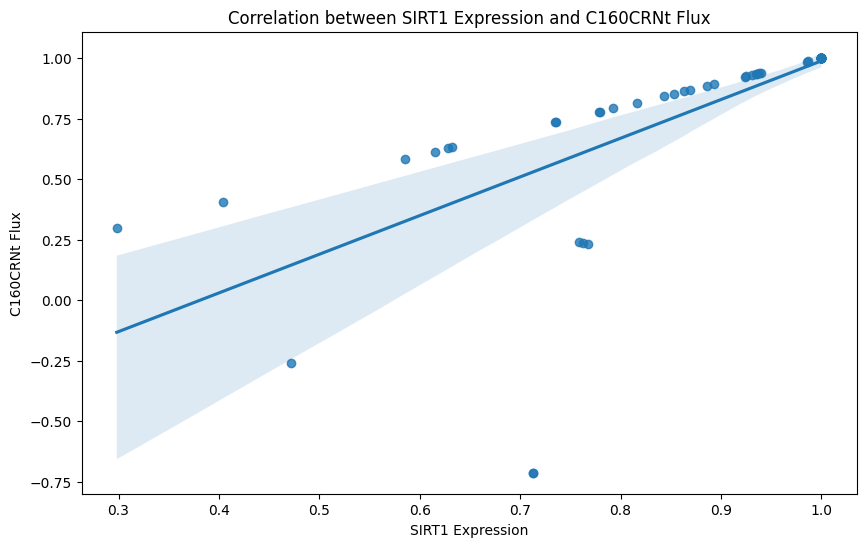

Linear regression results for SIRT1 and C160CRNt:
Slope: 1.5980002857542888
Intercept: -0.6091632698838555
R-squared: 0.5033542766176542
P-value: 4.342819562278918e-12
Standard error: 0.19109035881336348



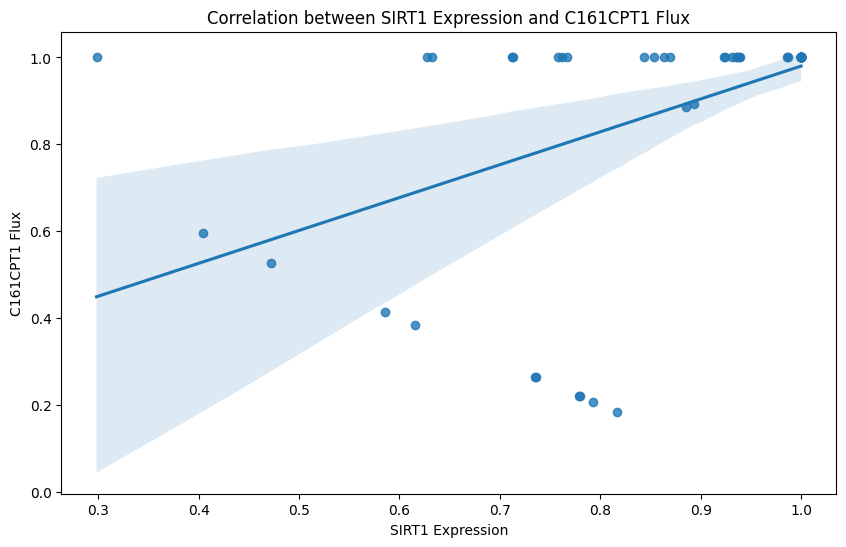

Linear regression results for SIRT1 and C161CPT1:
Slope: 0.7564362208781098
Intercept: 0.22367177111115644
R-squared: 0.24828605364282175
P-value: 9.780746508040103e-06
Standard error: 0.15845206807842835



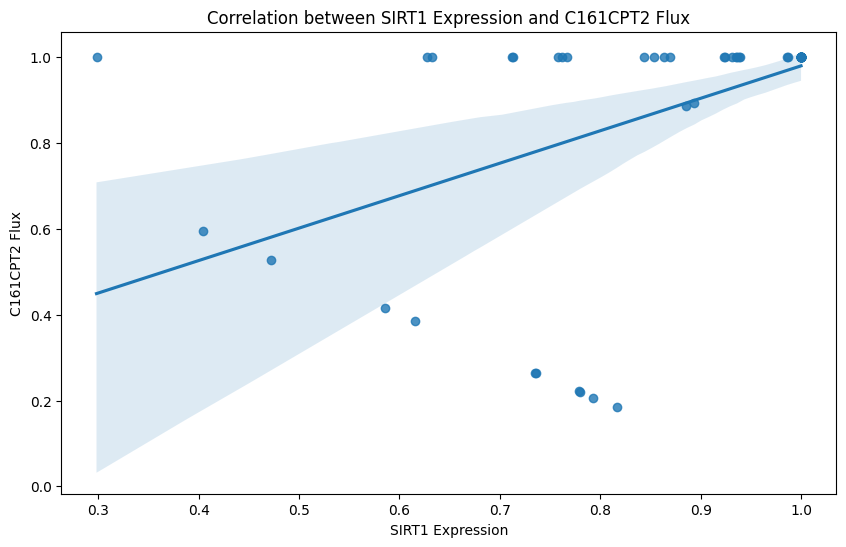

Linear regression results for SIRT1 and C161CPT2:
Slope: 0.7564362208781098
Intercept: 0.22367177111115666
R-squared: 0.2482860536428217
P-value: 9.780746508040174e-06
Standard error: 0.15845206807842838



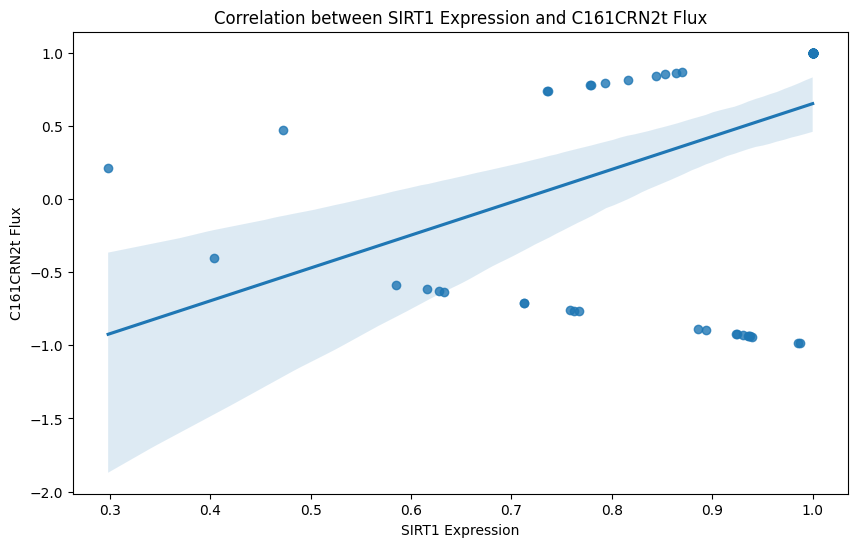

Linear regression results for SIRT1 and C161CRN2t:
Slope: 2.2464511770383493
Intercept: -1.594375624355199
R-squared: 0.19144801891060784
P-value: 0.00013582207176383583
Standard error: 0.5557775160313289



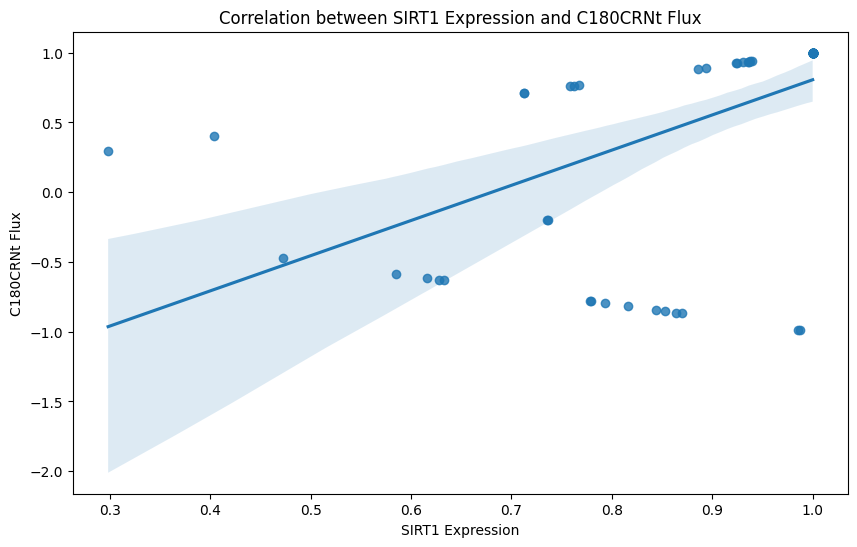

Linear regression results for SIRT1 and C180CRNt:
Slope: 2.522292411540295
Intercept: -1.716045789363587
R-squared: 0.30456568898499586
P-value: 6.080253234944544e-07
Standard error: 0.45883702669574994



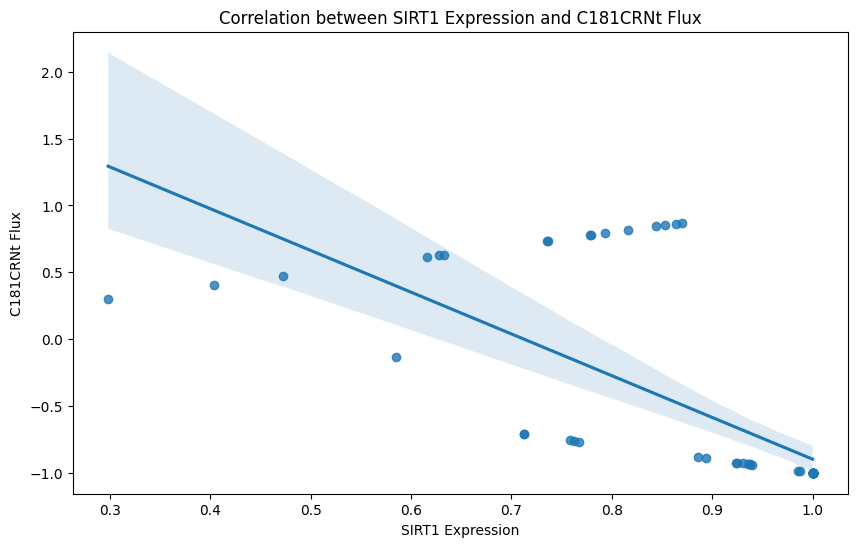

Linear regression results for SIRT1 and C181CRNt:
Slope: -3.1242033169752386
Intercept: 2.2252578664650304
R-squared: 0.49108525424709965
P-value: 1.0197371145099408e-11
Standard error: 0.3828765907692125



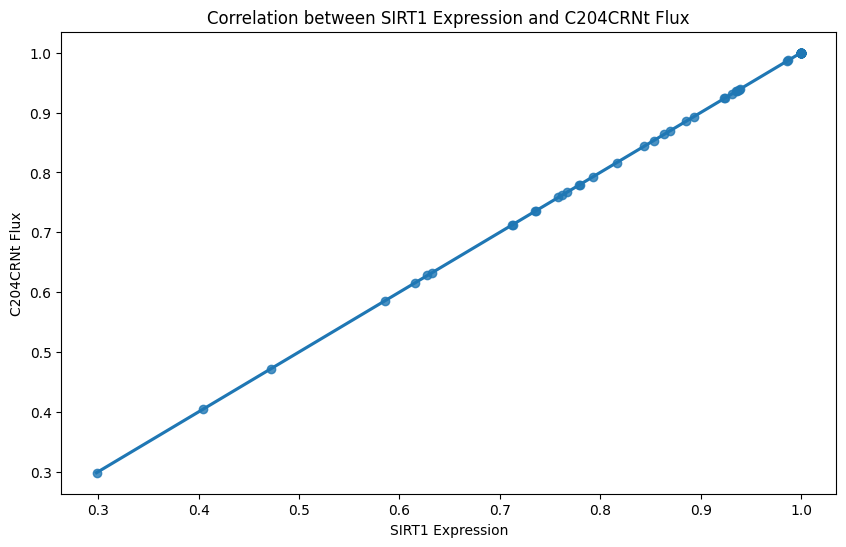

Linear regression results for SIRT1 and C204CRNt:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



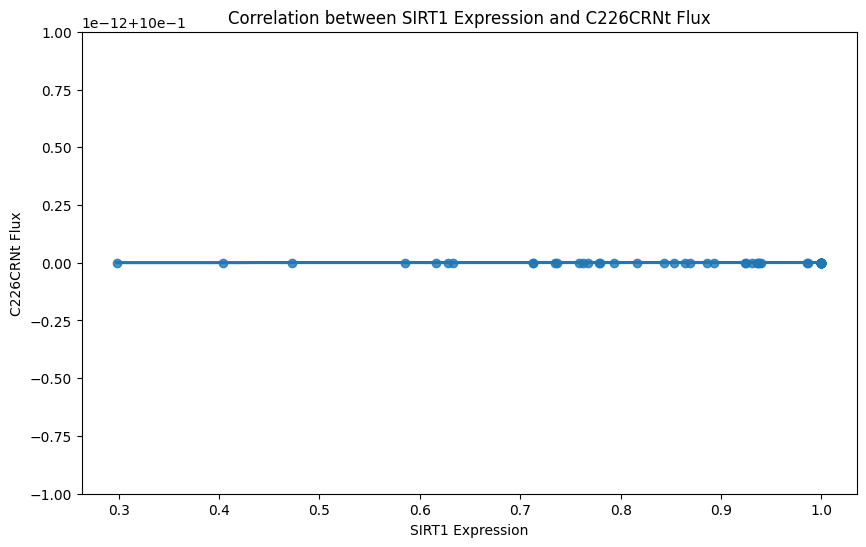

Linear regression results for SIRT1 and C226CRNt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



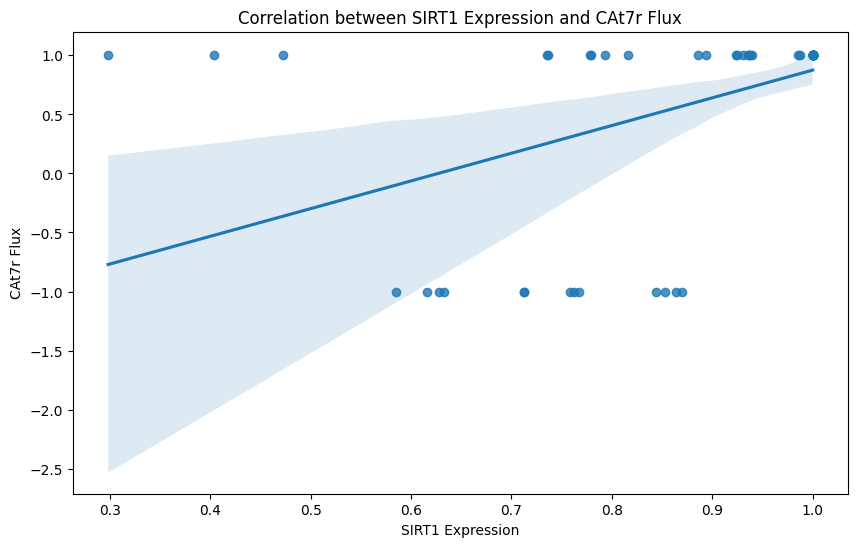

Linear regression results for SIRT1 and CAt7r:
Slope: 2.345612582519947
Intercept: -1.470556514434728
R-squared: 0.22735722040483644
P-value: 2.6245839710407135e-05
Standard error: 0.5205551374453816



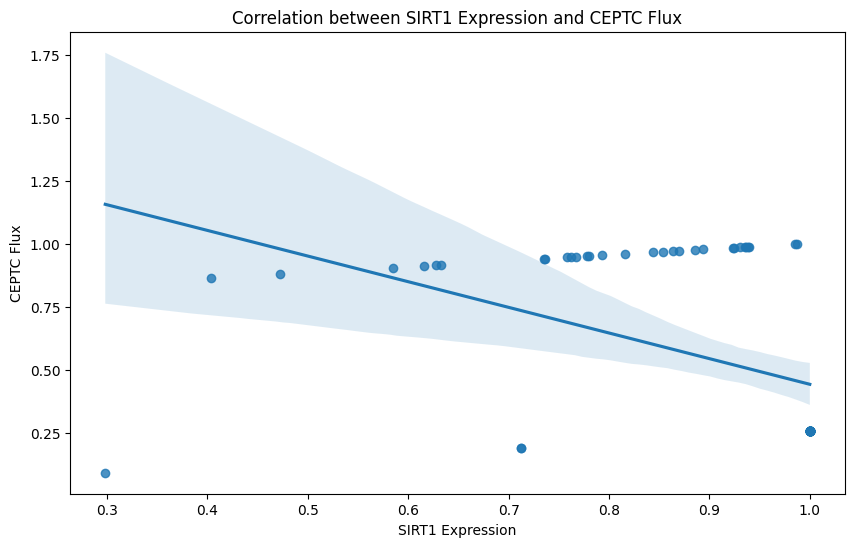

Linear regression results for SIRT1 and CEPTC:
Slope: -1.0169991138024843
Intercept: 1.4603145658719163
R-squared: 0.2080822283253635
P-value: 6.389407858103978e-05
Standard error: 0.2388463334147436



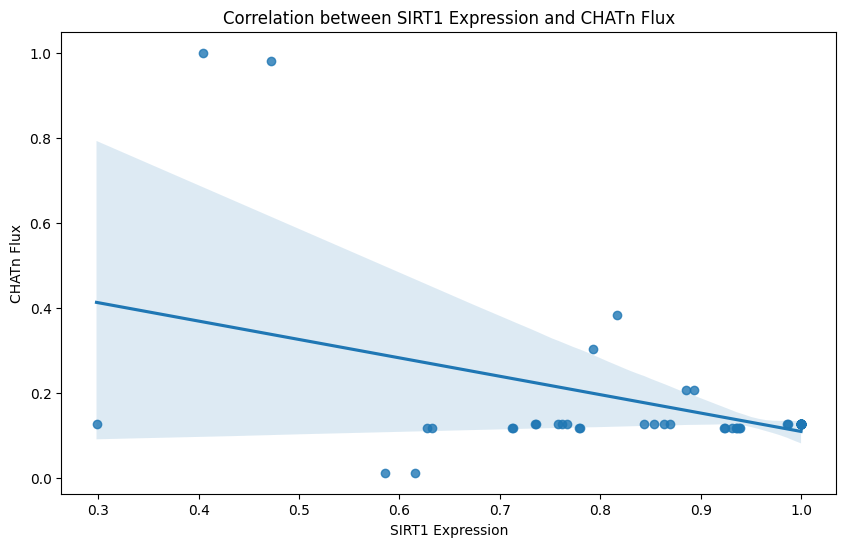

Linear regression results for SIRT1 and CHATn:
Slope: -0.432400764778259
Intercept: 0.5420230816586586
R-squared: 0.20833202731259698
P-value: 6.316865041232708e-05
Standard error: 0.10147415087115964



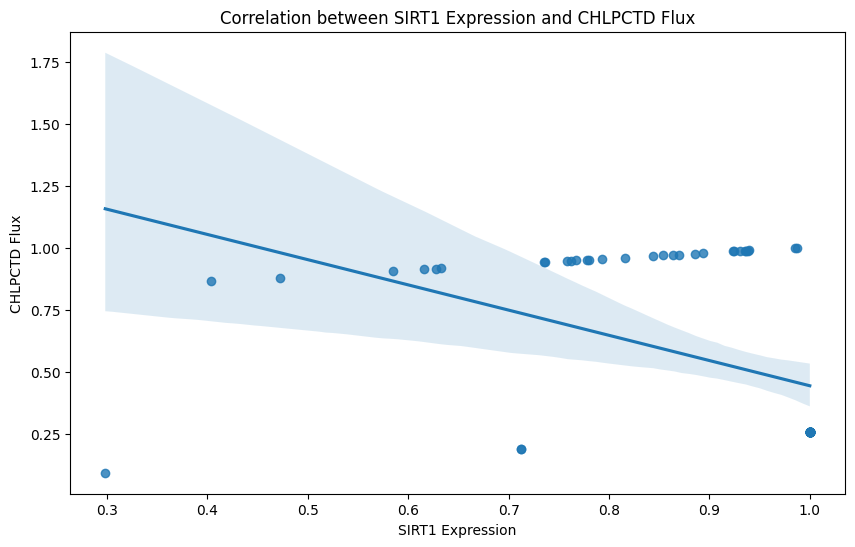

Linear regression results for SIRT1 and CHLPCTD:
Slope: -1.0169991138024843
Intercept: 1.4603145658719163
R-squared: 0.2080822283253635
P-value: 6.389407858103978e-05
Standard error: 0.2388463334147436



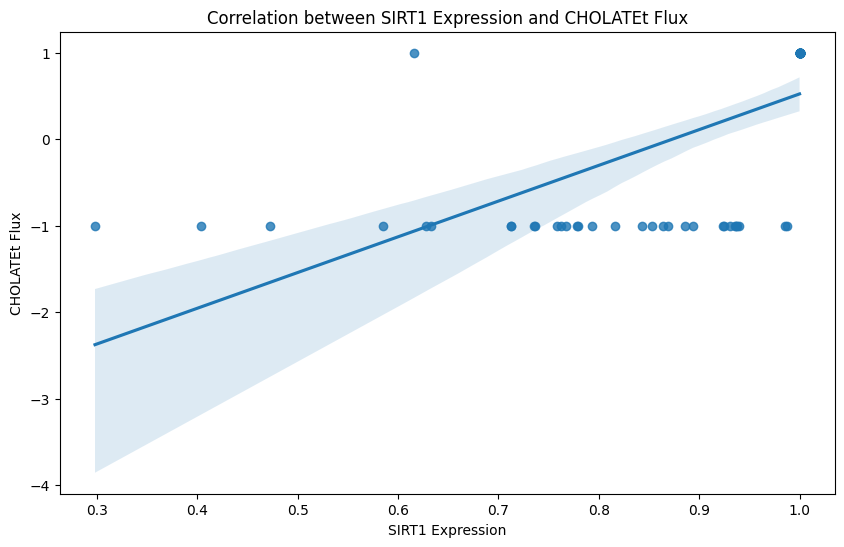

Linear regression results for SIRT1 and CHOLATEt:
Slope: 4.132392297788901
Intercept: -3.6087718735467536
R-squared: 0.4263399531372972
P-value: 6.788360829155282e-10
Standard error: 0.5770670583777396



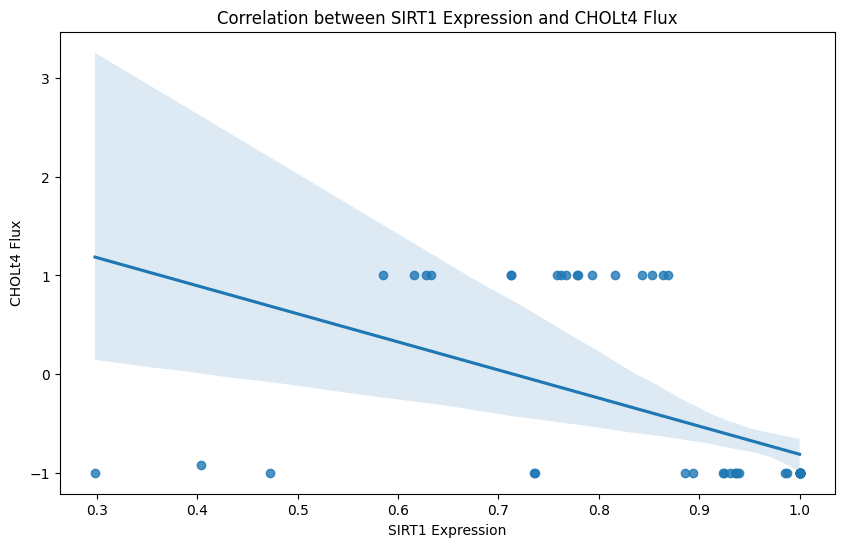

Linear regression results for SIRT1 and CHOLt4:
Slope: -2.846333128739733
Intercept: 2.034317305420468
R-squared: 0.27562017568503566
P-value: 2.598886546287405e-06
Standard error: 0.5555061258487154



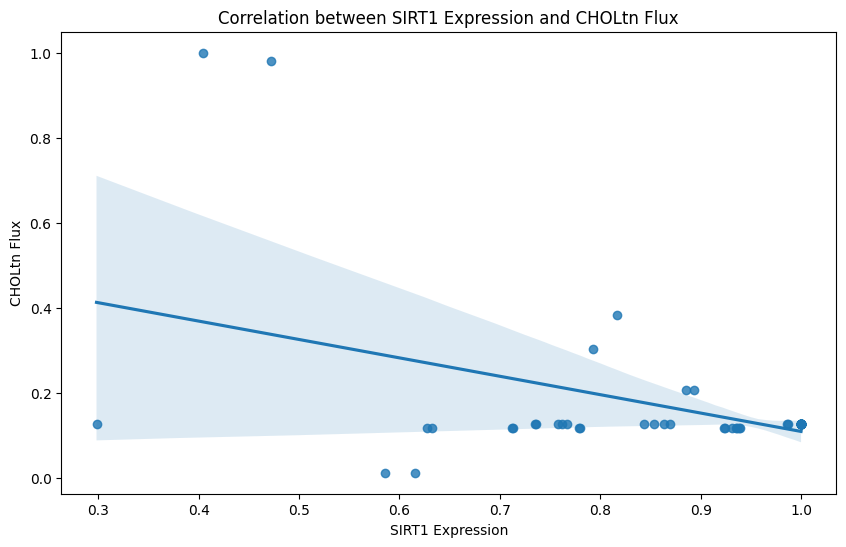

Linear regression results for SIRT1 and CHOLtn:
Slope: -0.432400764778259
Intercept: 0.5420230816586586
R-squared: 0.20833202731259698
P-value: 6.316865041232708e-05
Standard error: 0.10147415087115964



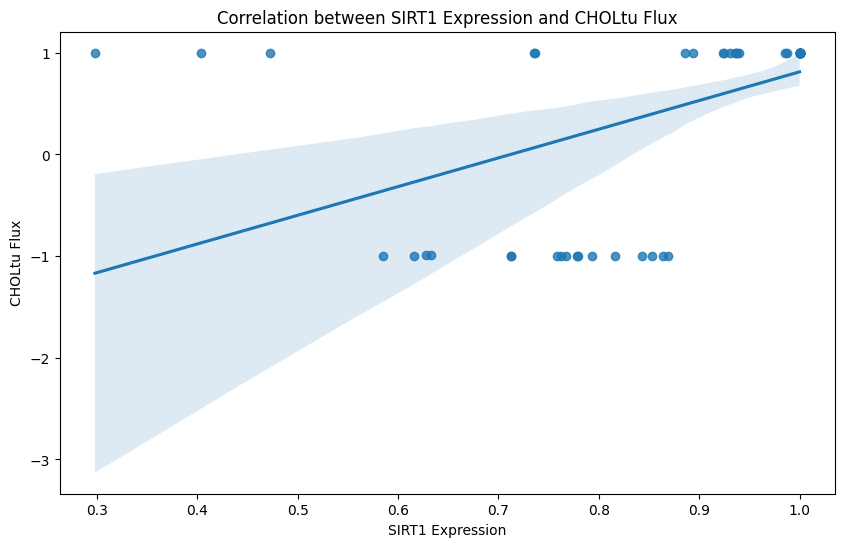

Linear regression results for SIRT1 and CHOLtu:
Slope: 2.821832175953341
Intercept: -2.0100078539688884
R-squared: 0.270786904025945
P-value: 3.295568354653938e-06
Standard error: 0.5574681210252423



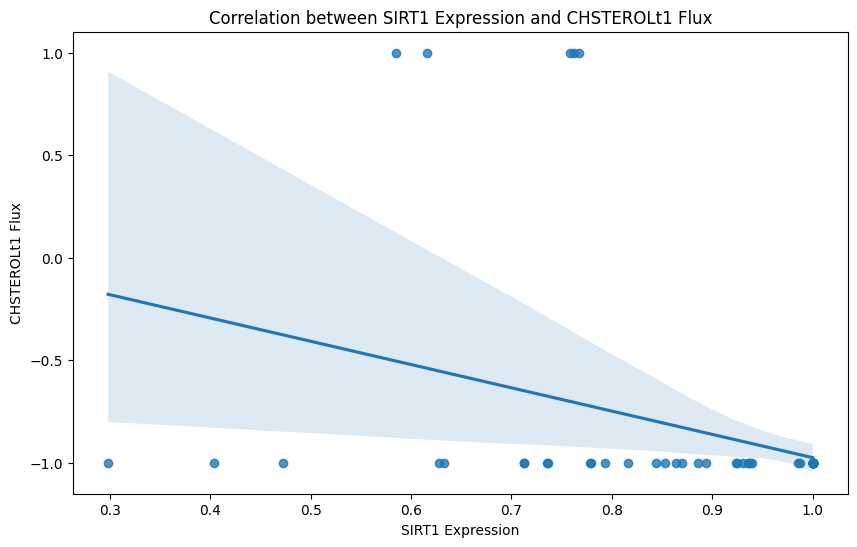

Linear regression results for SIRT1 and CHSTEROLt1:
Slope: -1.1358877710448712
Intercept: 0.15988931130224804
R-squared: 0.12184600214632908
P-value: 0.0028495652531319972
Standard error: 0.3671052351683552



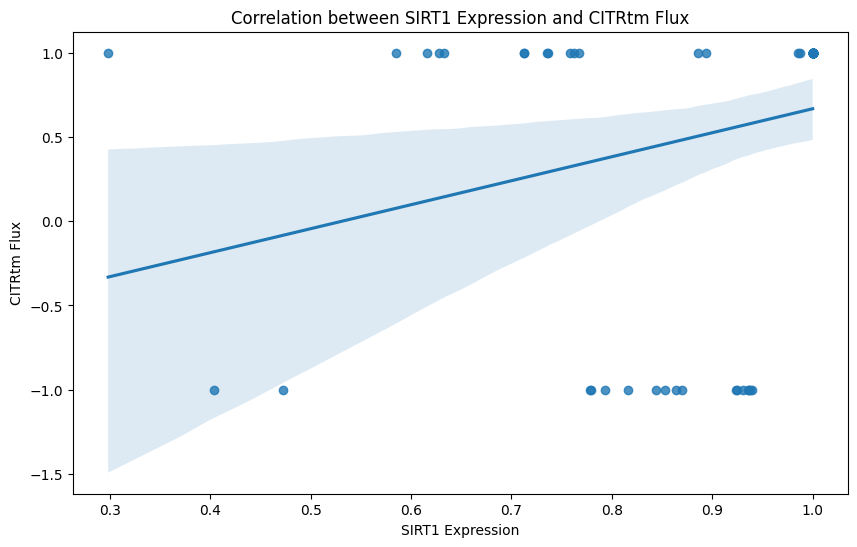

Linear regression results for SIRT1 and CITRtm:
Slope: 1.4236008641345321
Intercept: -0.7559984579718144
R-squared: 0.0688017328574128
P-value: 0.027118802082031157
Standard error: 0.6304999969936312



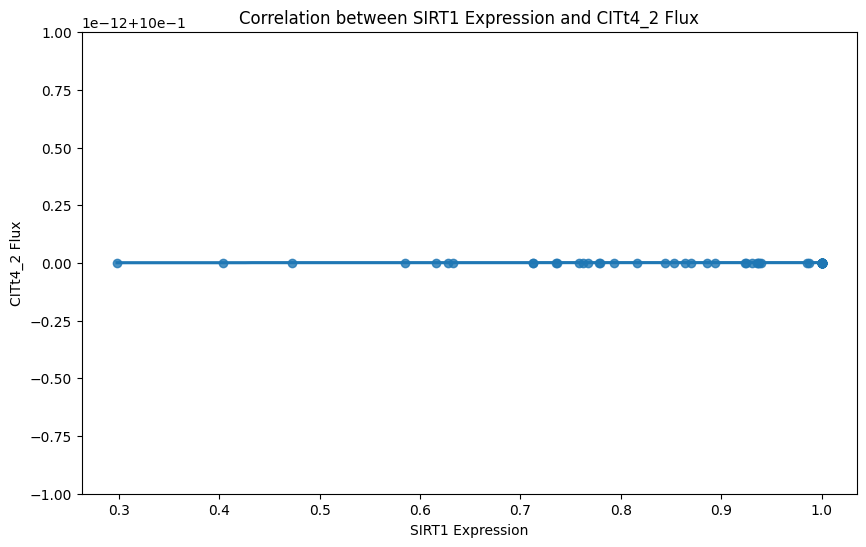

Linear regression results for SIRT1 and CITt4_2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



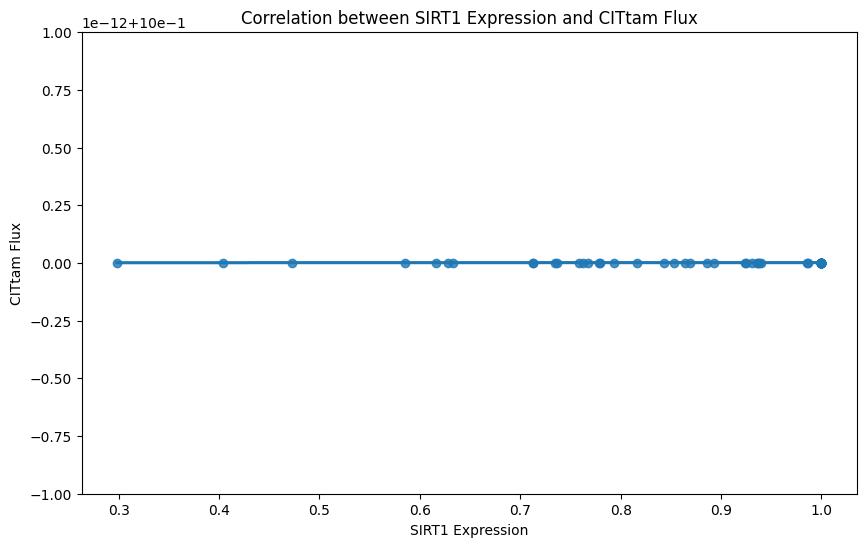

Linear regression results for SIRT1 and CITtam:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



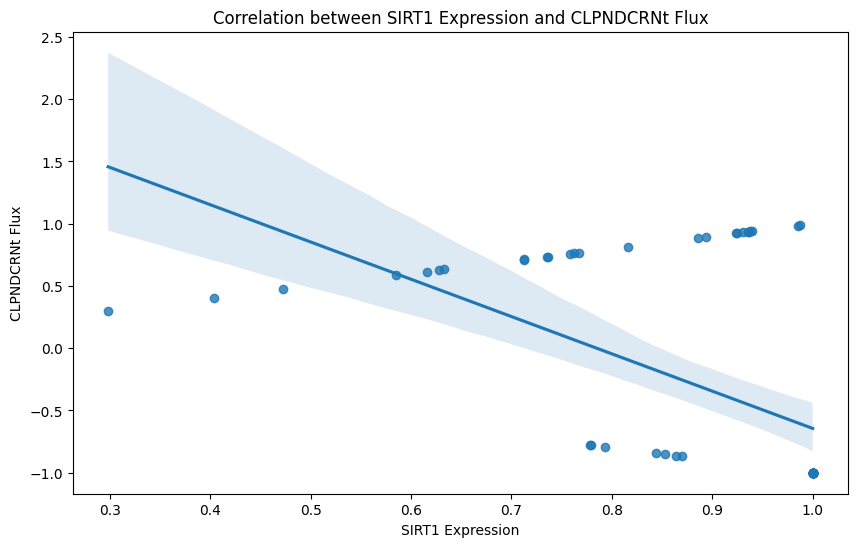

Linear regression results for SIRT1 and CLPNDCRNt:
Slope: -2.9947559356826914
Intercept: 2.3506161724701826
R-squared: 0.3094176237214228
P-value: 4.7409252213820245e-07
Standard error: 0.5386071460961688



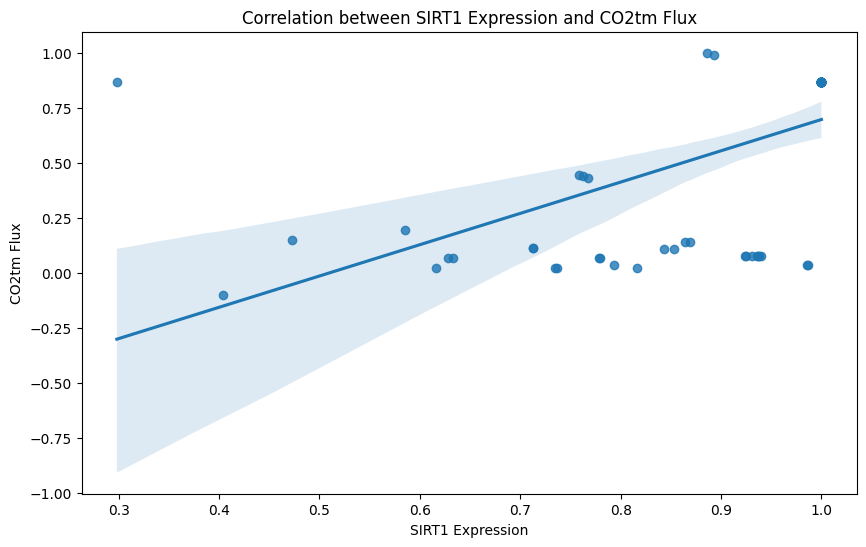

Linear regression results for SIRT1 and CO2tm:
Slope: 1.4229220241121647
Intercept: -0.7264200824092808
R-squared: 0.3356636928151607
P-value: 1.1994864156821517e-07
Standard error: 0.24098963619210373



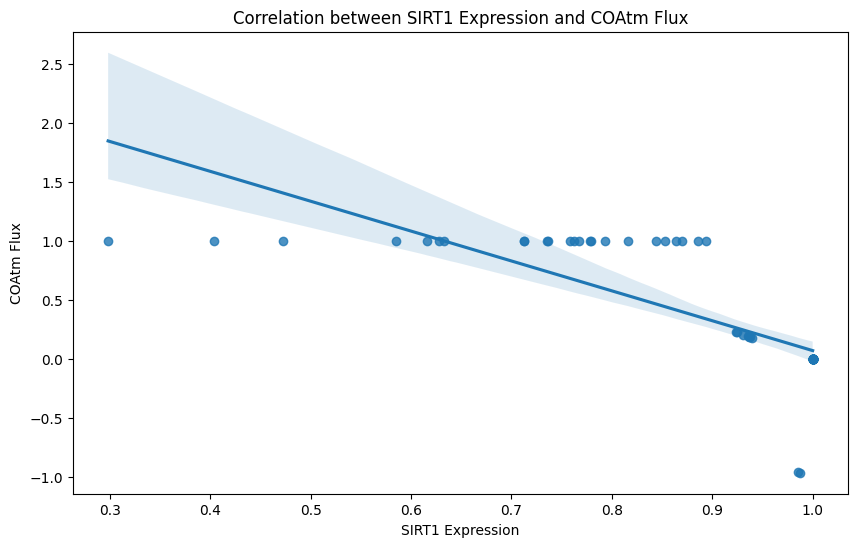

Linear regression results for SIRT1 and COAtm:
Slope: -2.529707590026735
Intercept: 2.6027002281909795
R-squared: 0.615636670790716
P-value: 5.703429319502978e-16
Standard error: 0.2406326263650109



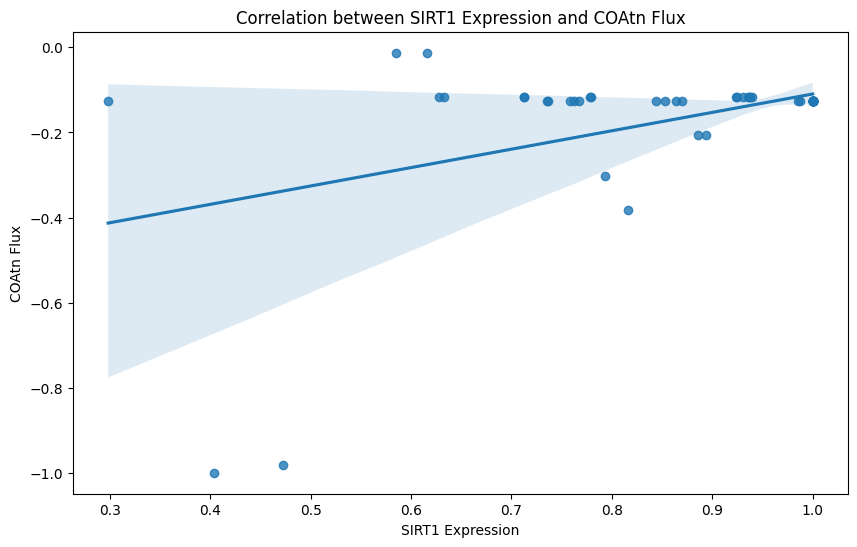

Linear regression results for SIRT1 and COAtn:
Slope: 0.432400764778259
Intercept: -0.5420230816586586
R-squared: 0.20833202731259698
P-value: 6.316865041232708e-05
Standard error: 0.10147415087115964



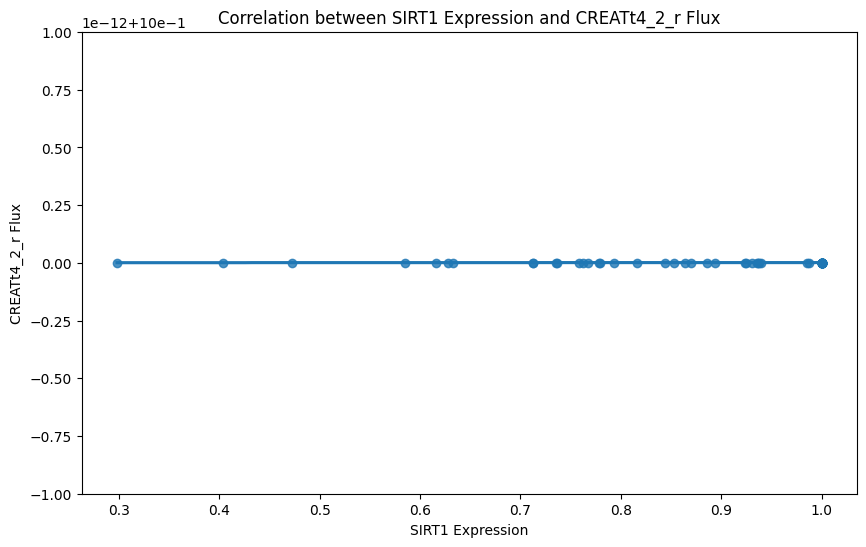

Linear regression results for SIRT1 and CREATt4_2_r:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



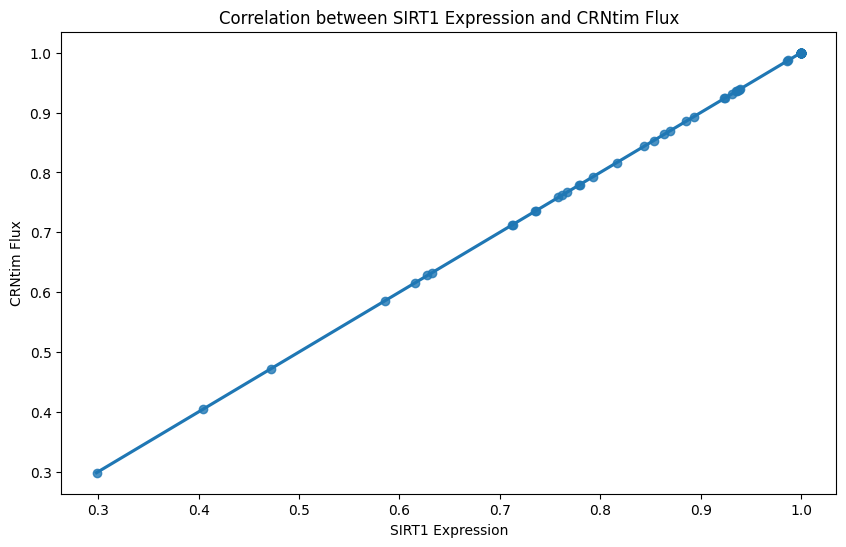

Linear regression results for SIRT1 and CRNtim:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



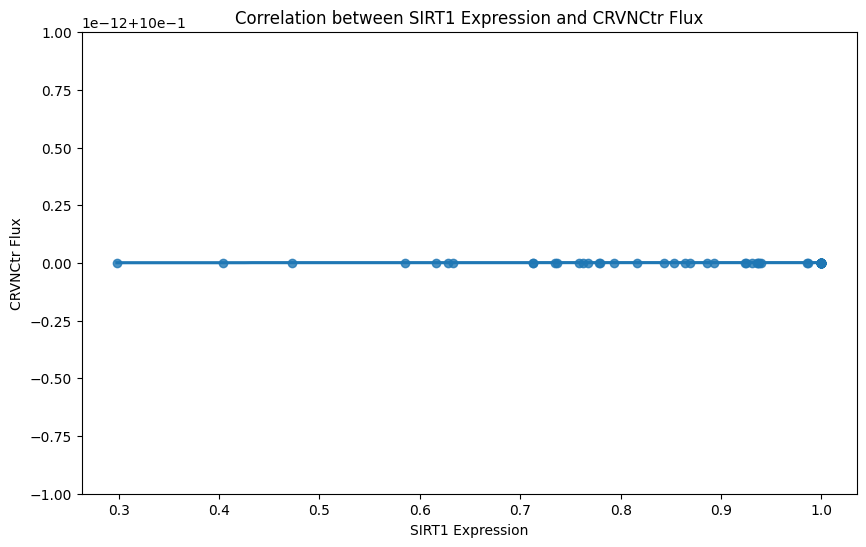

Linear regression results for SIRT1 and CRVNCtr:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



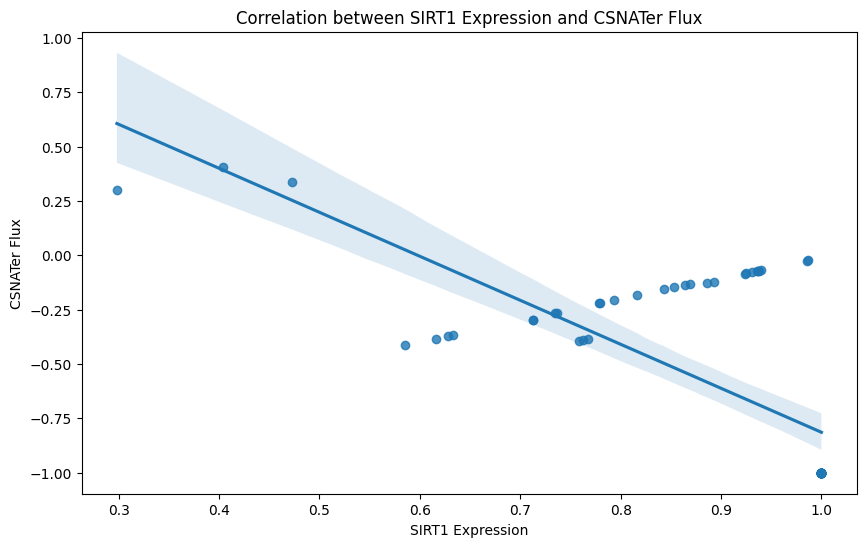

Linear regression results for SIRT1 and CSNATer:
Slope: -2.0232307633118647
Intercept: 1.209210460494204
R-squared: 0.5135800117108026
P-value: 2.0985270904832785e-12
Standard error: 0.23704048361474409



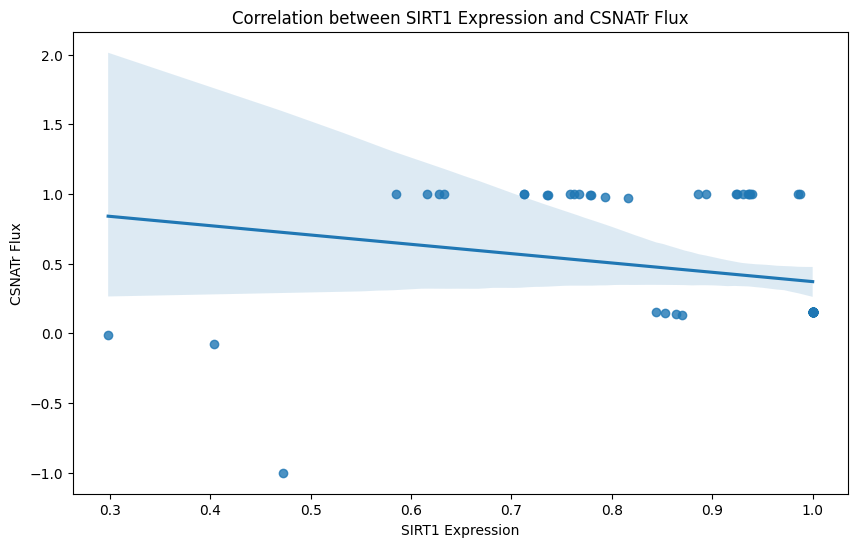

Linear regression results for SIRT1 and CSNATr:
Slope: -0.6691409206890424
Intercept: 1.0406591751583916
R-squared: 0.055923515024685816
P-value: 0.04708671070652186
Standard error: 0.3309782108446818



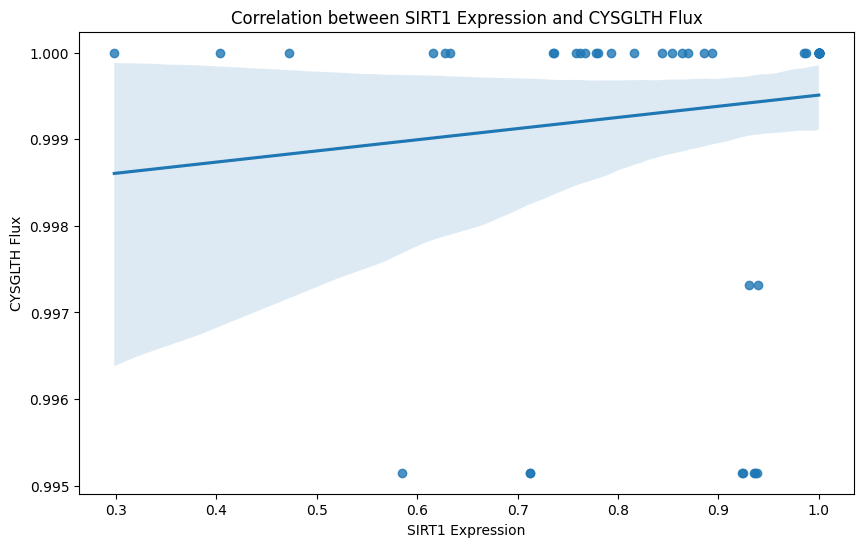

Linear regression results for SIRT1 and CYSGLTH:
Slope: 0.0012897305830300776
Intercept: 0.9982208816474427
R-squared: 0.01667157251384948
P-value: 0.2831994560487344
Standard error: 0.0011924370660505396



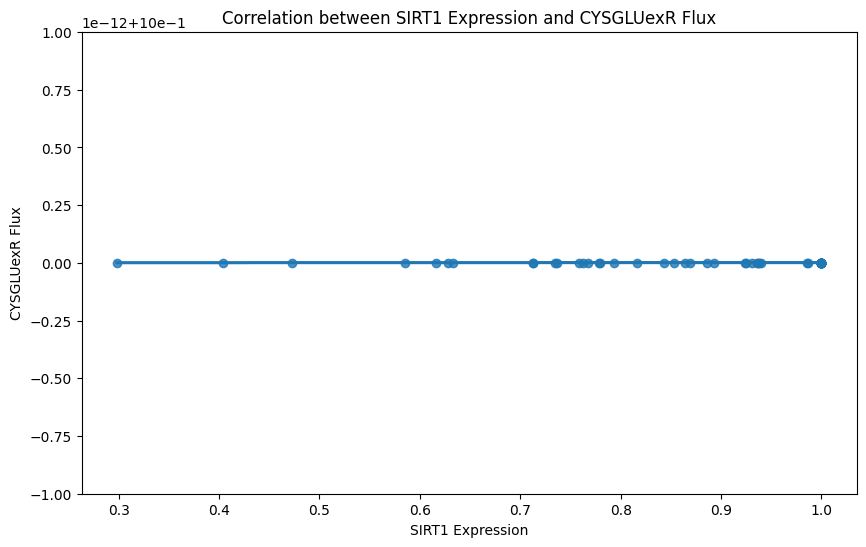

Linear regression results for SIRT1 and CYSGLUexR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



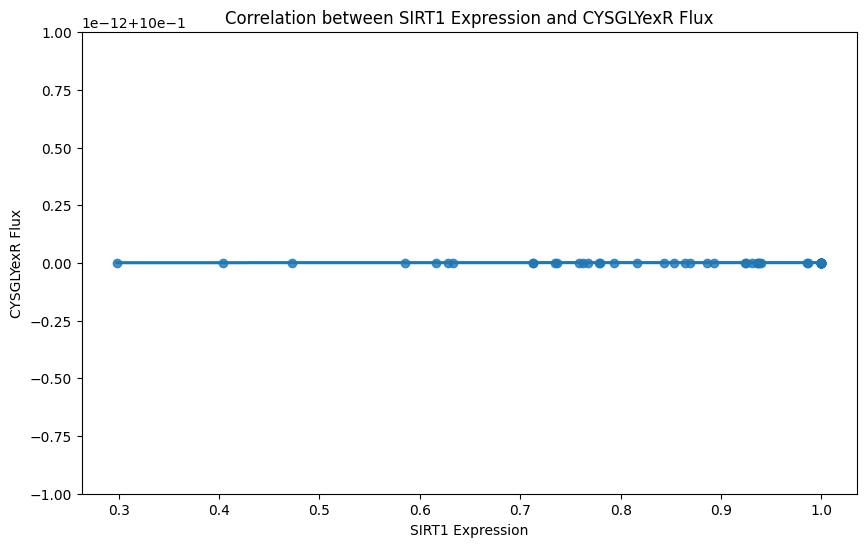

Linear regression results for SIRT1 and CYSGLYexR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



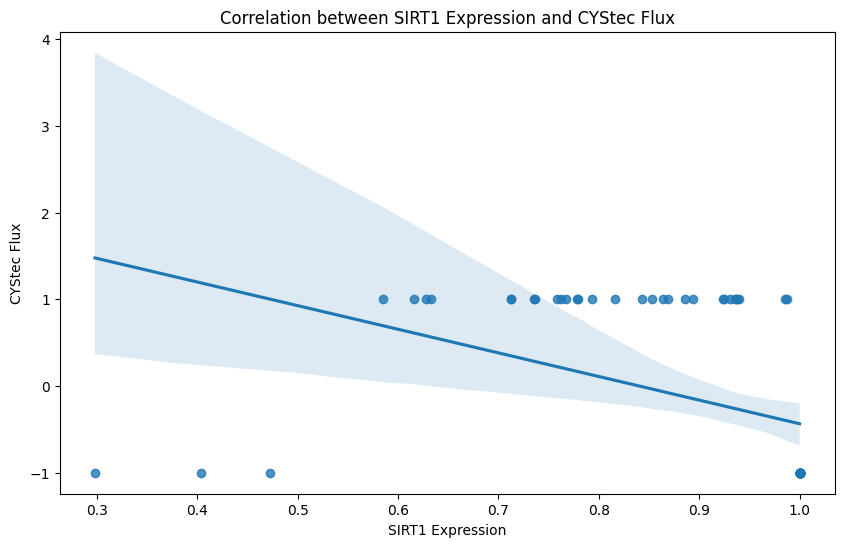

Linear regression results for SIRT1 and CYStec:
Slope: -2.7246390008016044
Intercept: 2.289472174379269
R-squared: 0.18805303977889612
P-value: 0.00015819025298023748
Standard error: 0.6815662466595587



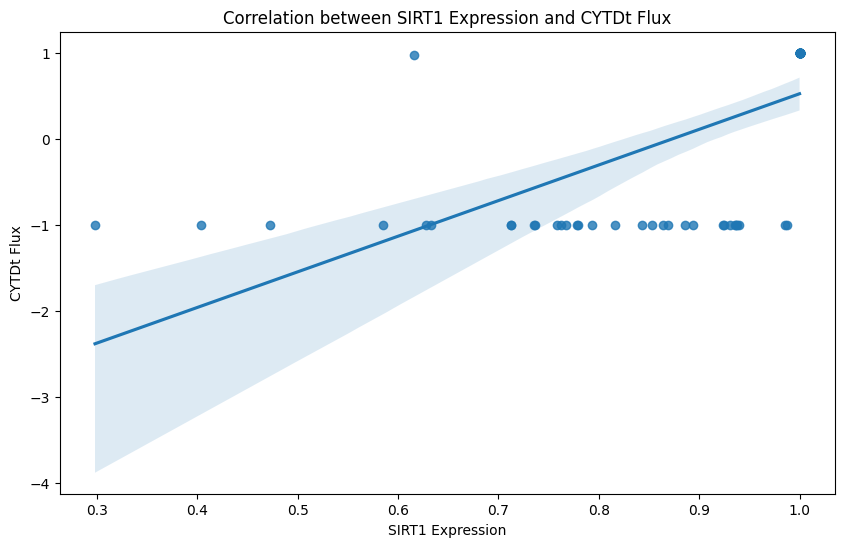

Linear regression results for SIRT1 and CYTDt:
Slope: 4.136871651203458
Intercept: -3.6131839655747555
R-squared: 0.4275663075845064
P-value: 6.296716597029649e-10
Standard error: 0.5762465757398693



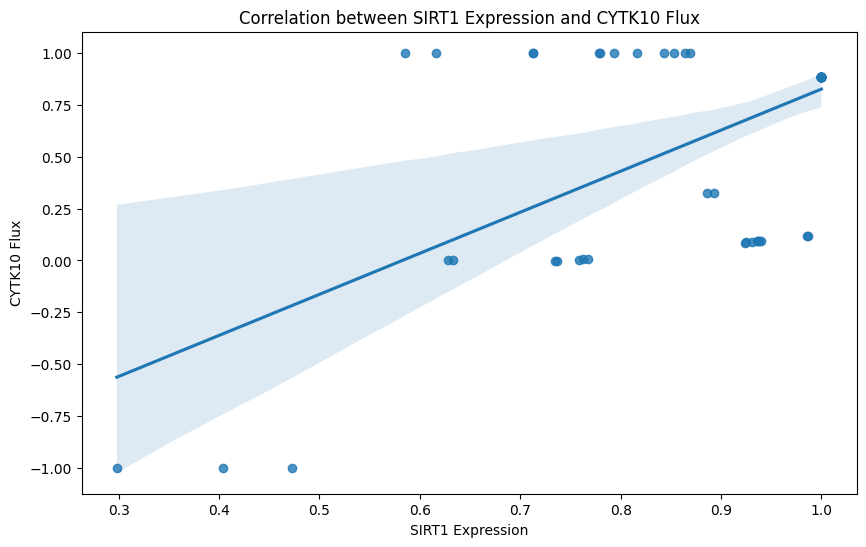

Linear regression results for SIRT1 and CYTK10:
Slope: 1.9762178664011696
Intercept: -1.1512849421985227
R-squared: 0.3901276428412112
P-value: 5.847680145684595e-09
Standard error: 0.29745850346541297



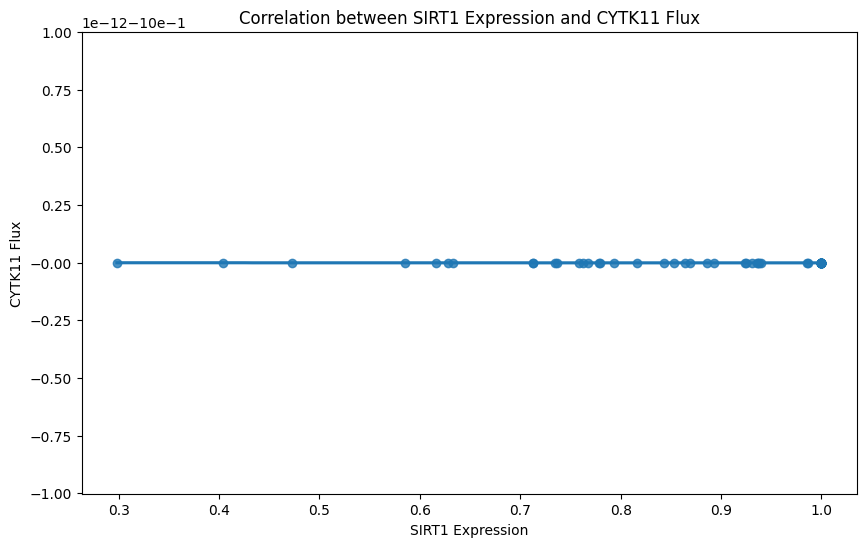

Linear regression results for SIRT1 and CYTK11:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



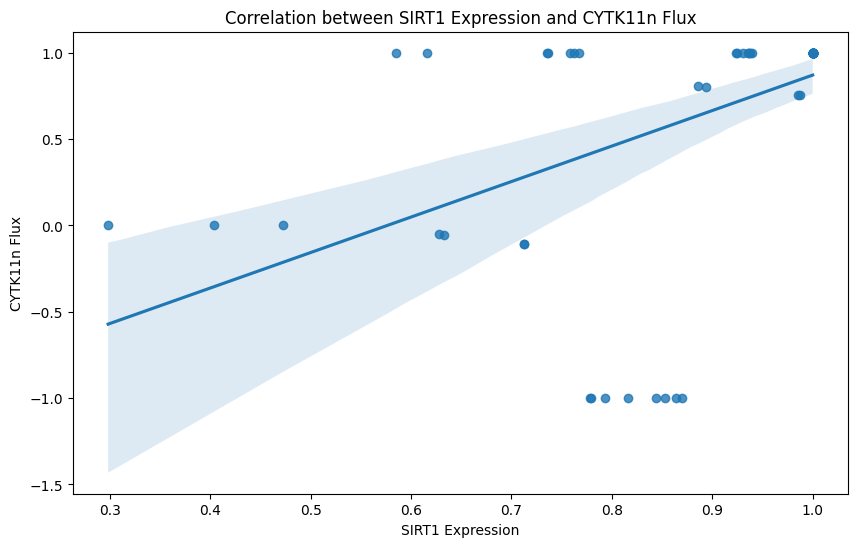

Linear regression results for SIRT1 and CYTK11n:
Slope: 2.0551291357770243
Intercept: -1.1845497348748675
R-squared: 0.23448530424154923
P-value: 1.8800219491140605e-05
Standard error: 0.4470267606215513



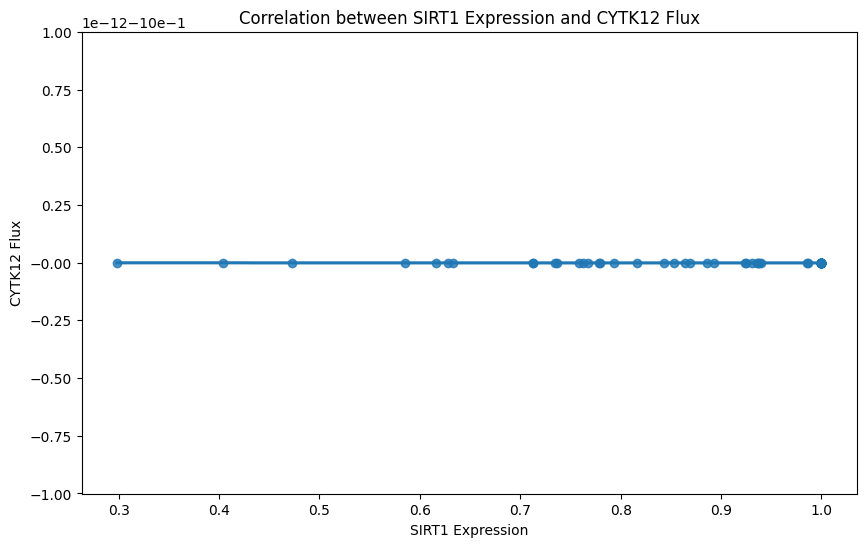

Linear regression results for SIRT1 and CYTK12:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



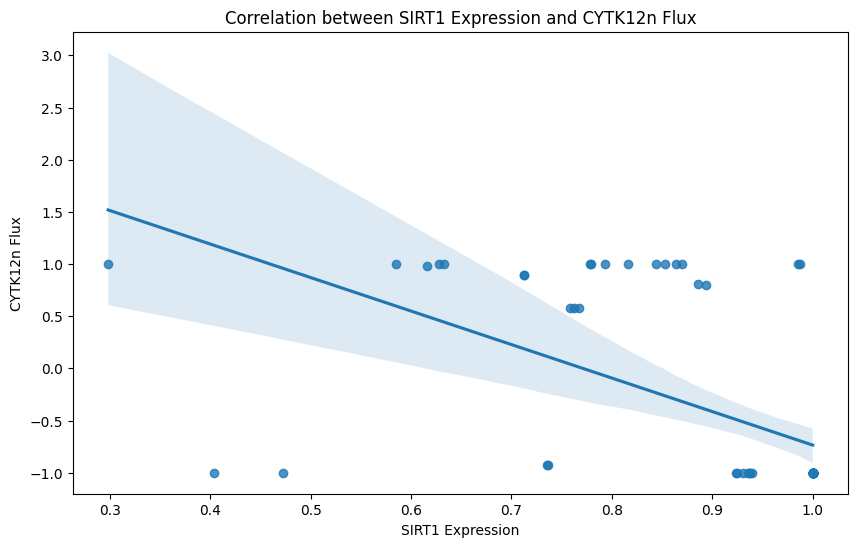

Linear regression results for SIRT1 and CYTK12n:
Slope: -3.210870374855193
Intercept: 2.475760843260331
R-squared: 0.323426637535004
P-value: 2.2904913383858685e-07
Standard error: 0.559072052041368



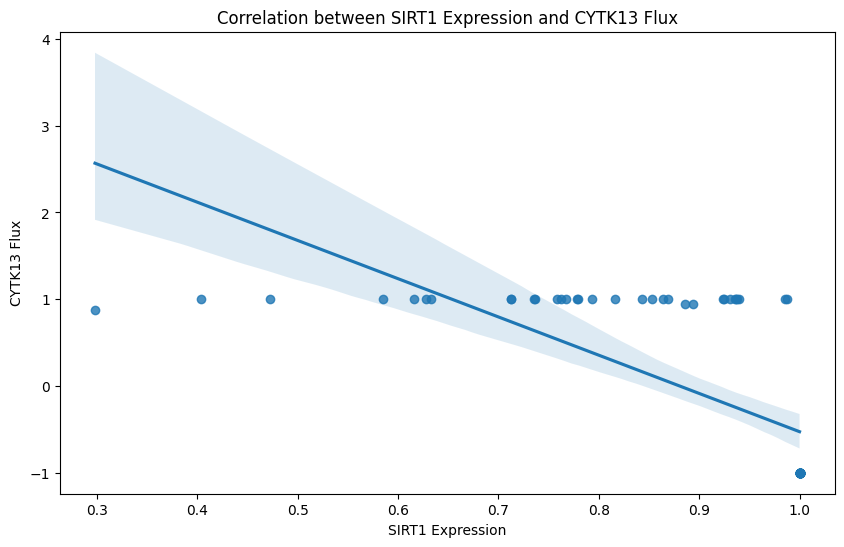

Linear regression results for SIRT1 and CYTK13:
Slope: -4.409070073524626
Intercept: 3.881946942128388
R-squared: 0.48623993762743023
P-value: 1.4207031575304428e-11
Standard error: 0.5456037074310783



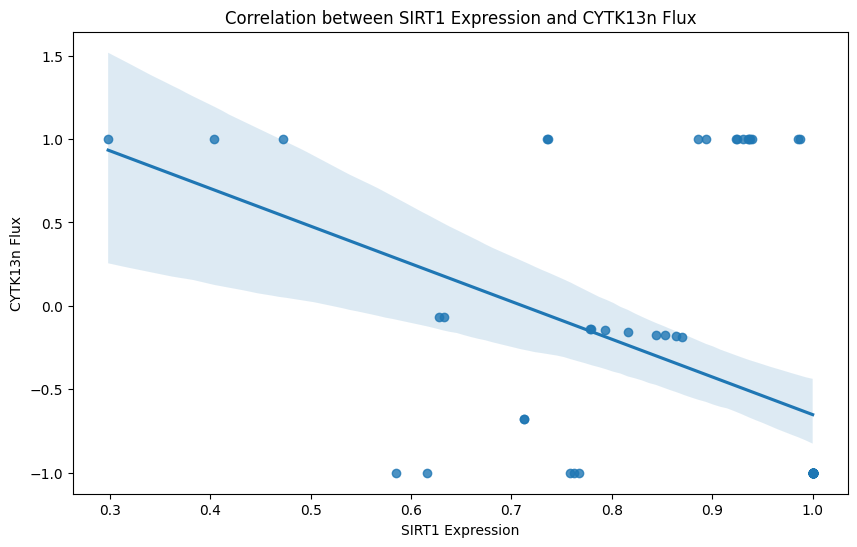

Linear regression results for SIRT1 and CYTK13n:
Slope: -2.2586199457457554
Intercept: 1.6067503990090173
R-squared: 0.1879342948433502
P-value: 0.00015903464777665597
Standard error: 0.5652117468622297



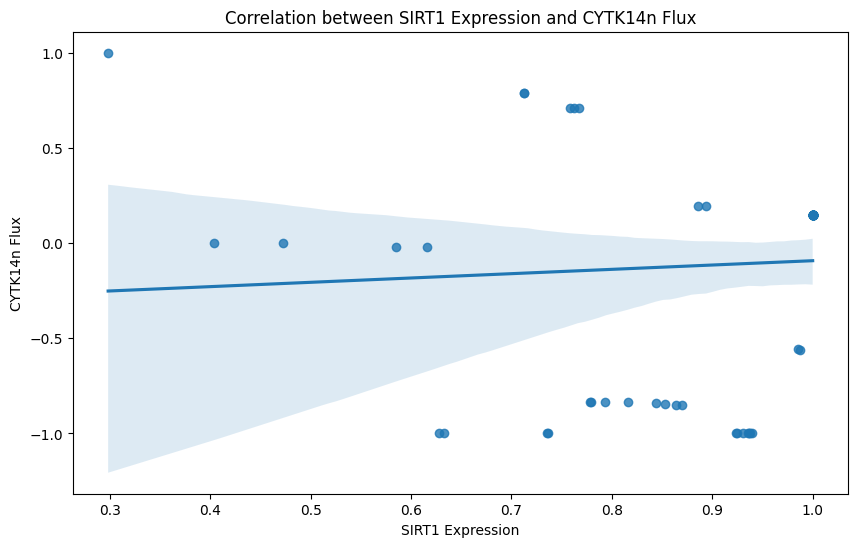

Linear regression results for SIRT1 and CYTK14n:
Slope: 0.22704534372628166
Intercept: -0.3195762829254728
R-squared: 0.004319928026148568
P-value: 0.5860440641402168
Standard error: 0.41496331682661736



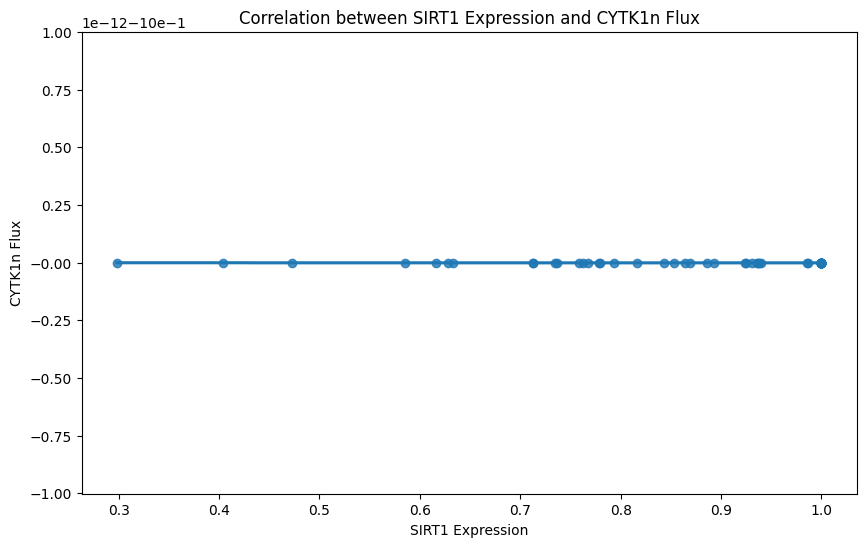

Linear regression results for SIRT1 and CYTK1n:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



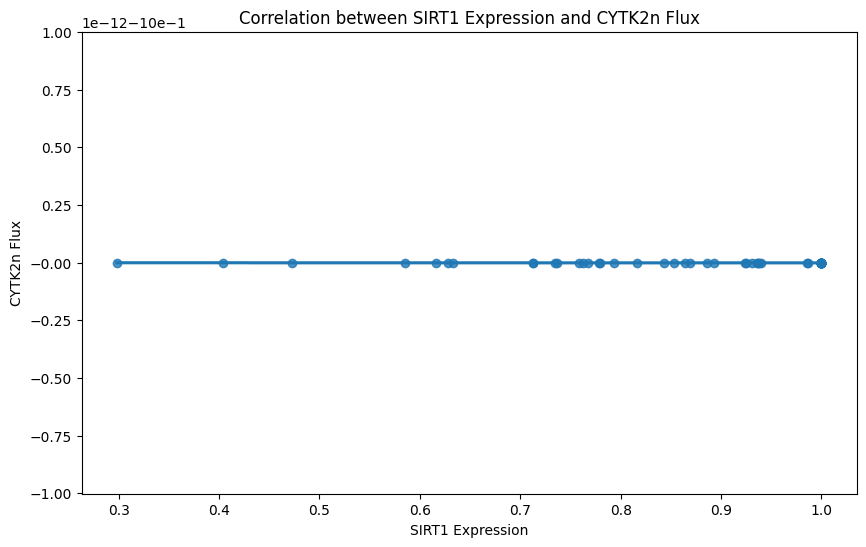

Linear regression results for SIRT1 and CYTK2n:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



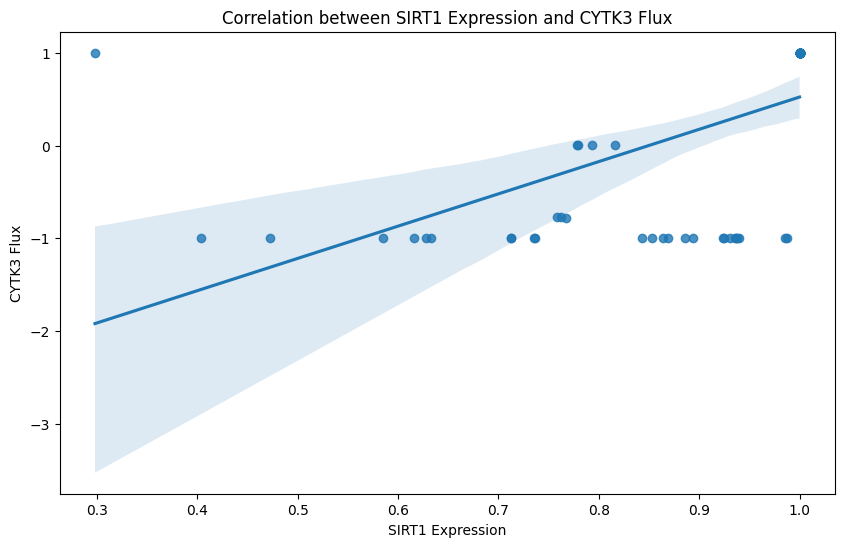

Linear regression results for SIRT1 and CYTK3:
Slope: 3.47799580308734
Intercept: -2.9556194874034047
R-squared: 0.33240209727985565
P-value: 1.4267173168316013e-07
Standard error: 0.5933761855272035



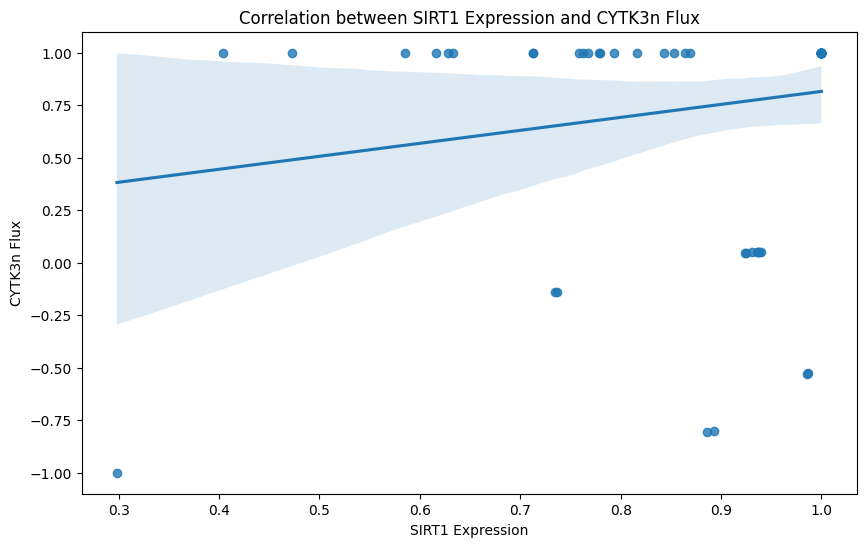

Linear regression results for SIRT1 and CYTK3n:
Slope: 0.617881055455128
Intercept: 0.19784138595845369
R-squared: 0.033949925651455146
P-value: 0.1239983925441611
Standard error: 0.3967900194657373



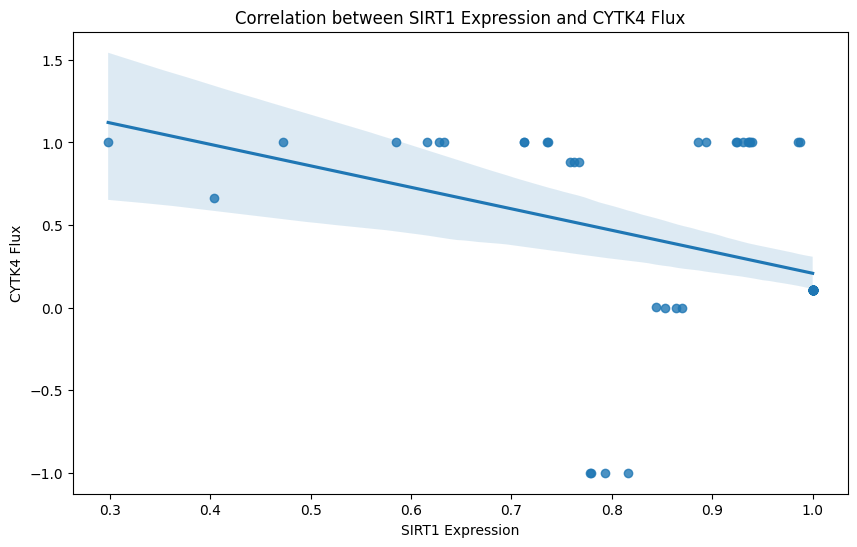

Linear regression results for SIRT1 and CYTK4:
Slope: -1.3012359030569471
Intercept: 1.5091121921593151
R-squared: 0.14947927211583334
P-value: 0.0008670176277333435
Standard error: 0.3736658908139708



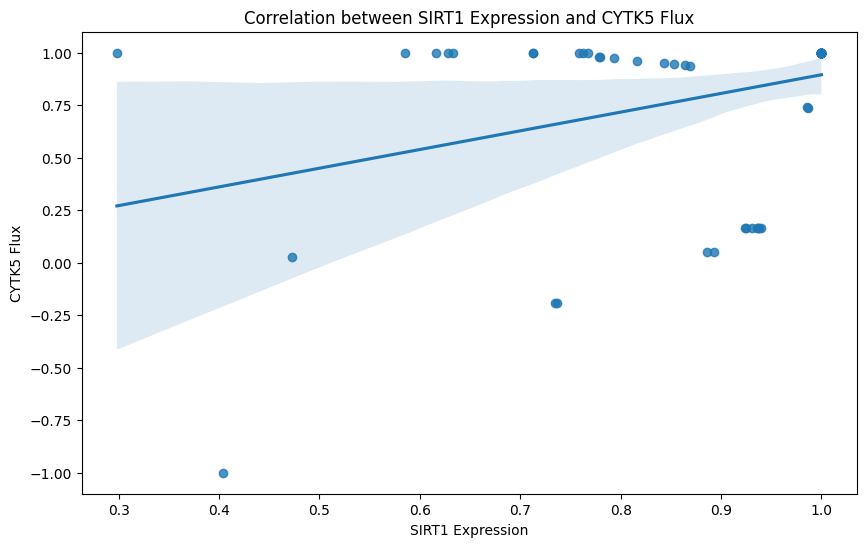

Linear regression results for SIRT1 and CYTK5:
Slope: 0.8902286938403469
Intercept: 0.004952185887260319
R-squared: 0.1170899721686737
P-value: 0.0034908765196237073
Standard error: 0.2942899399104525



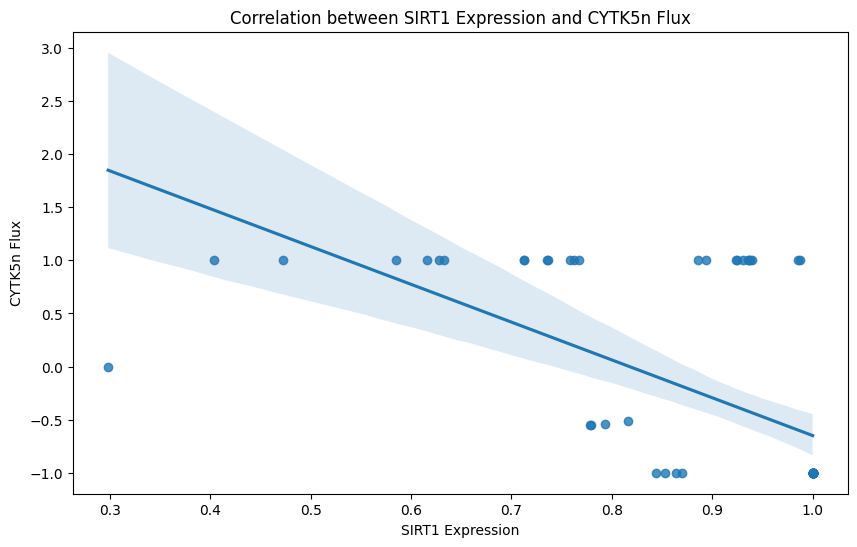

Linear regression results for SIRT1 and CYTK5n:
Slope: -3.5604884006822104
Intercept: 2.910246622098941
R-squared: 0.3621553755604172
P-value: 2.8442464042898572e-08
Standard error: 0.5688463972109068



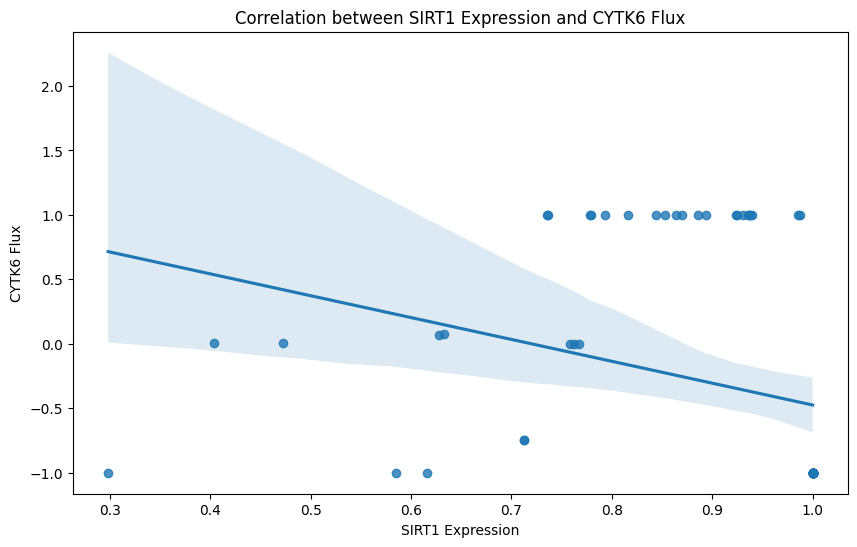

Linear regression results for SIRT1 and CYTK6:
Slope: -1.6959115954734618
Intercept: 1.220952645733473
R-squared: 0.08903229589136173
P-value: 0.011489383085098288
Standard error: 0.6530649384371493



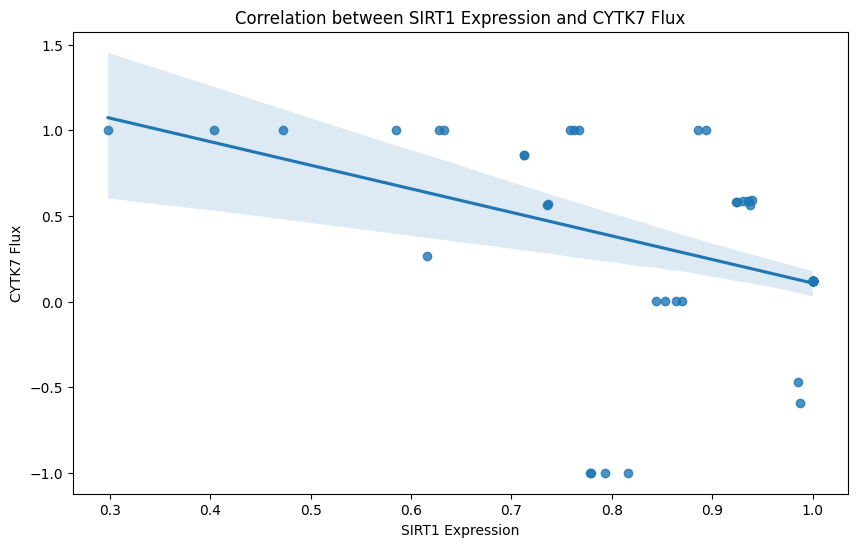

Linear regression results for SIRT1 and CYTK7:
Slope: -1.3764918297710276
Intercept: 1.4842292471572116
R-squared: 0.20454935960053616
P-value: 7.506945258717376e-05
Standard error: 0.32678088786886256



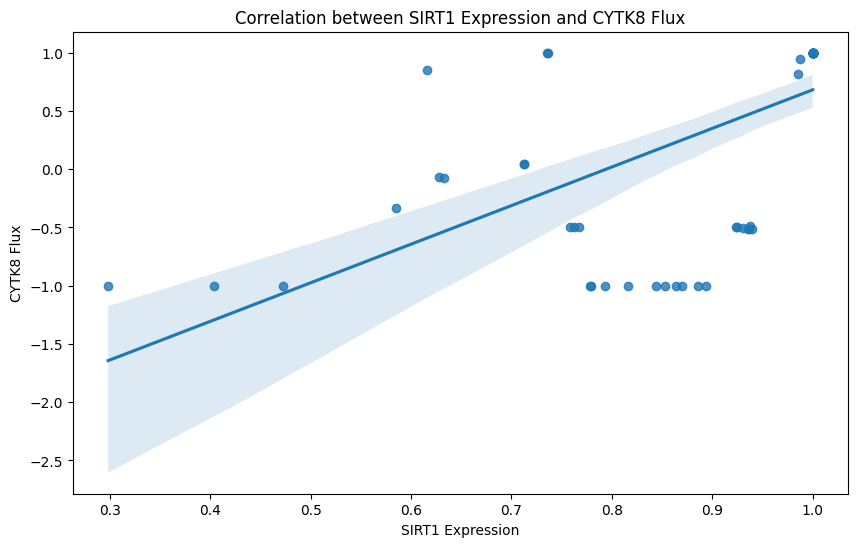

Linear regression results for SIRT1 and CYTK8:
Slope: 3.313002601236973
Intercept: -2.6312359097923097
R-squared: 0.38771678785952407
P-value: 6.719758271646067e-09
Standard error: 0.5012058189120066



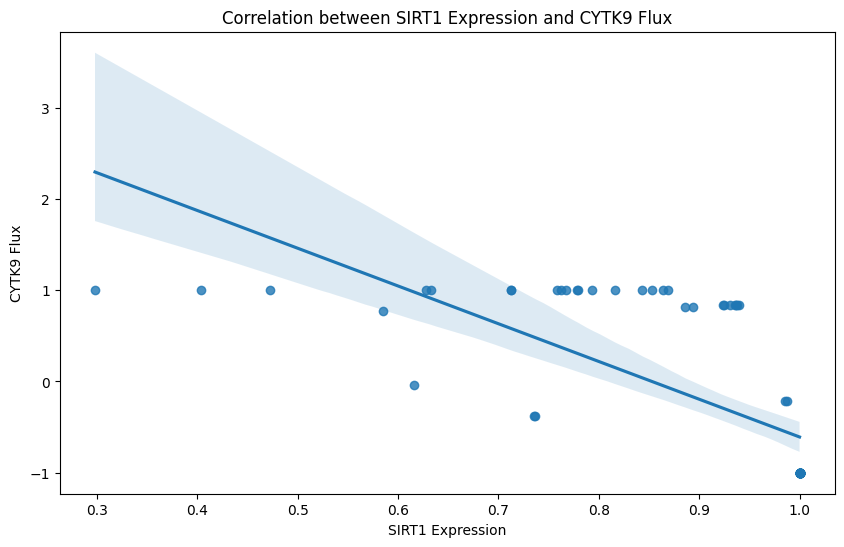

Linear regression results for SIRT1 and CYTK9:
Slope: -4.138043086513773
Intercept: 3.5298531607039534
R-squared: 0.4943339195127792
P-value: 8.150444287215355e-12
Standard error: 0.5038394493517405



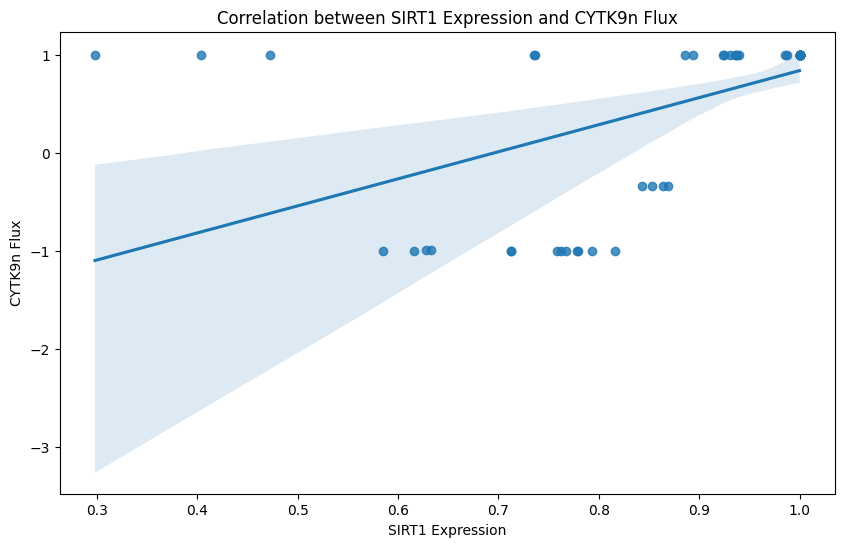

Linear regression results for SIRT1 and CYTK9n:
Slope: 2.7622220587553565
Intercept: -1.9191322865125553
R-squared: 0.2962014085439896
P-value: 9.302699068480604e-07
Standard error: 0.5125835691218144



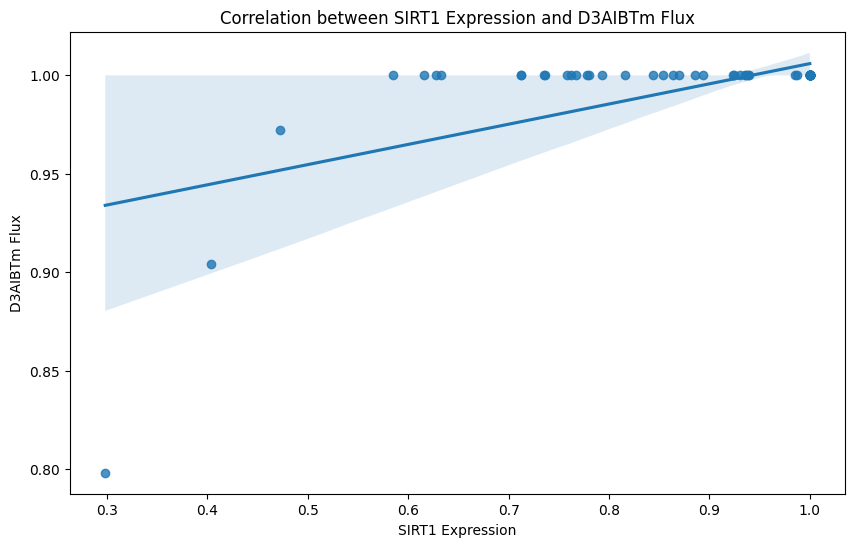

Linear regression results for SIRT1 and D3AIBTm:
Slope: 0.10254859013715918
Intercept: 0.9034129966203988
R-squared: 0.3751333362118147
P-value: 1.3767251311291382e-08
Standard error: 0.01593330966852077



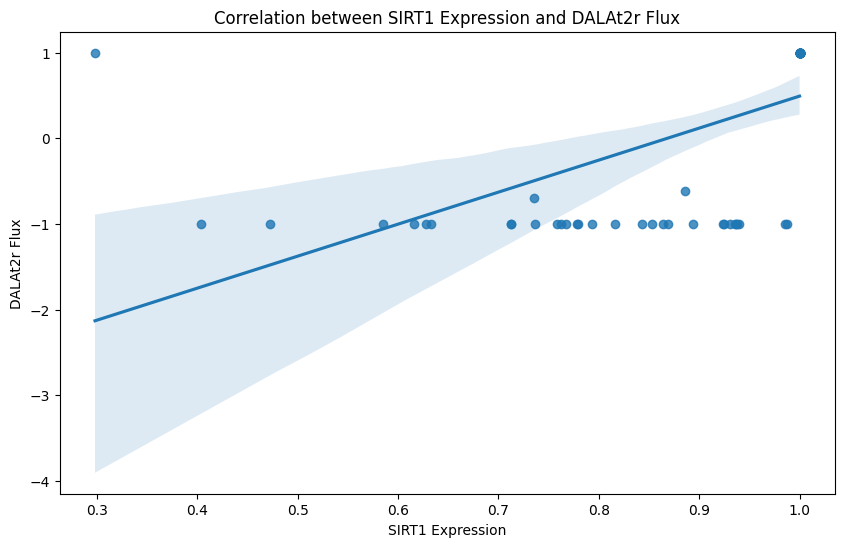

Linear regression results for SIRT1 and DALAt2r:
Slope: 3.7398824828848936
Intercept: -3.246820155006068
R-squared: 0.35572952333271135
P-value: 4.0529504715211705e-08
Standard error: 0.6059092329398121



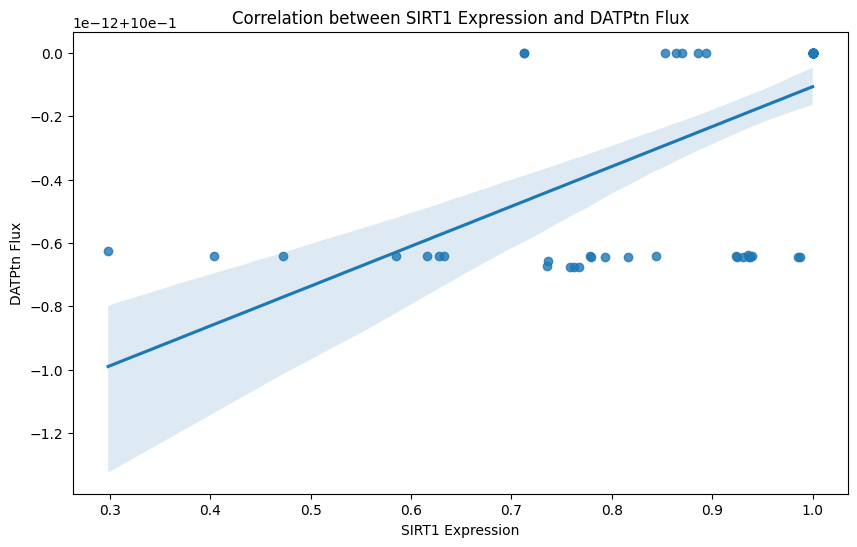

Linear regression results for SIRT1 and DATPtn:
Slope: 1.2574640663410983e-12
Intercept: 0.9999999999986351
R-squared: 0.40166800833792343
P-value: 2.984186197347282e-09
Standard error: 1.847602447012381e-13



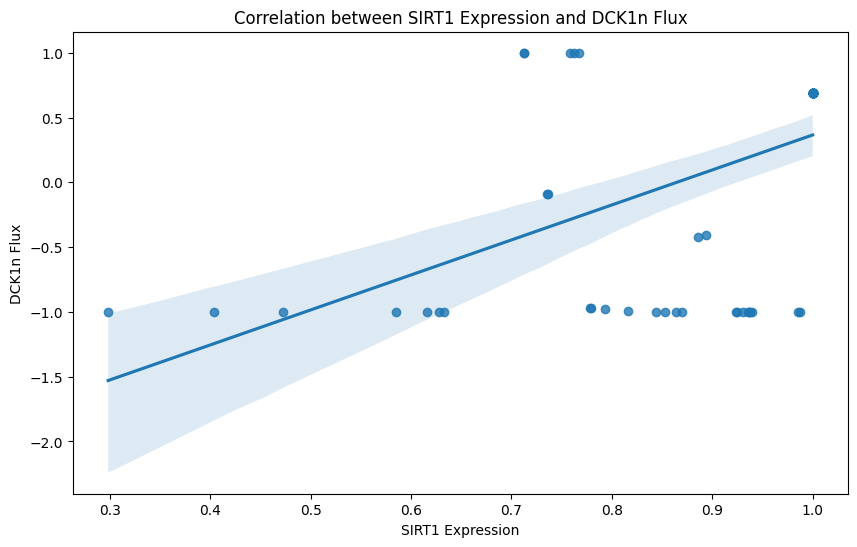

Linear regression results for SIRT1 and DCK1n:
Slope: 2.7009486900381514
Intercept: -2.335479755478249
R-squared: 0.27448654251249277
P-value: 2.7481075371765625e-06
Standard error: 0.5286326664008487



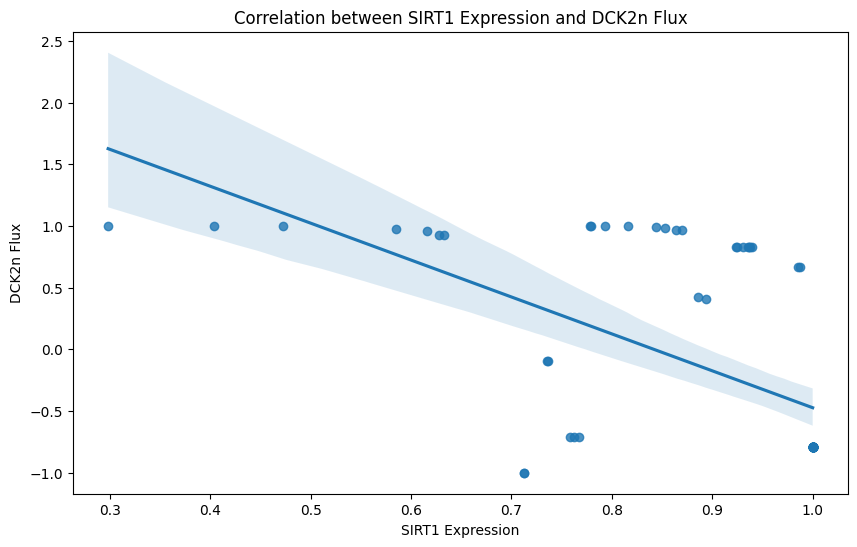

Linear regression results for SIRT1 and DCK2n:
Slope: -2.9916304030947334
Intercept: 2.518739968607706
R-squared: 0.34191651288911734
P-value: 8.58206897821383e-08
Standard error: 0.4996476530101619



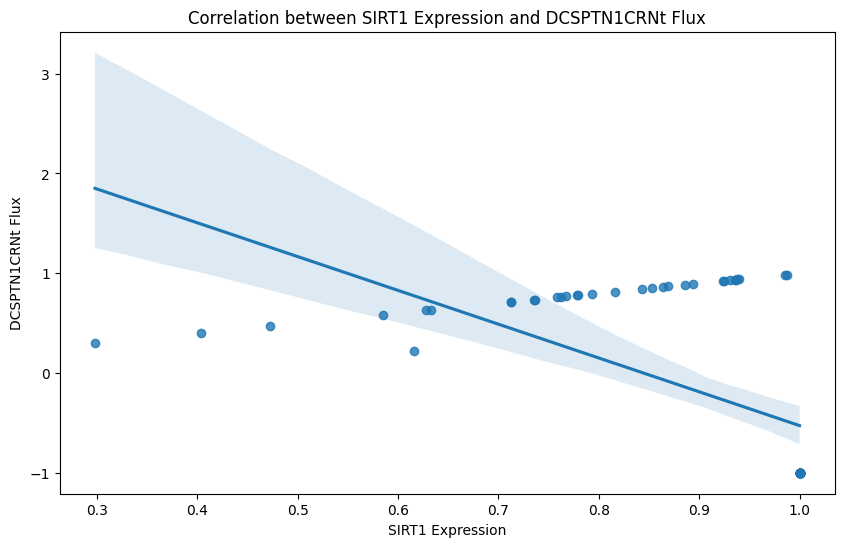

Linear regression results for SIRT1 and DCSPTN1CRNt:
Slope: -3.389490330140359
Intercept: 2.862009355382141
R-squared: 0.35821051414401694
P-value: 3.536383643280964e-08
Standard error: 0.5461815031506813



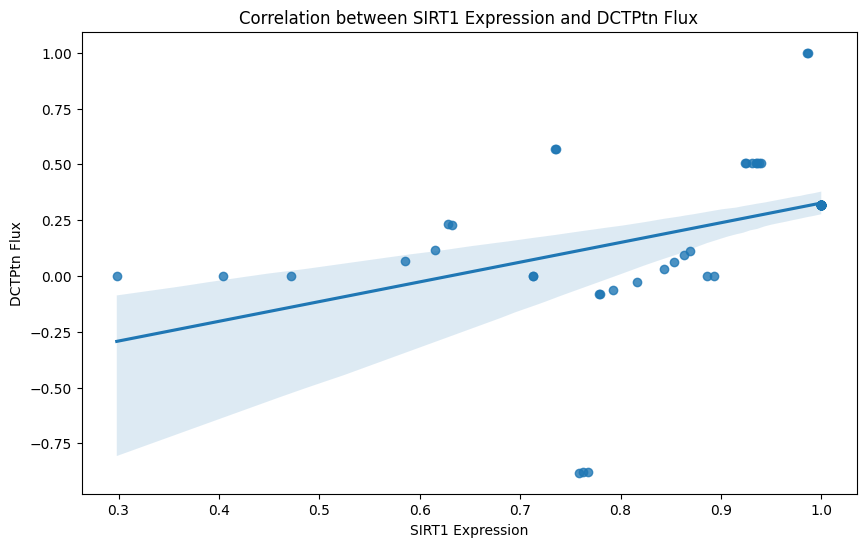

Linear regression results for SIRT1 and DCTPtn:
Slope: 0.8833309881012104
Intercept: -0.5567125136548651
R-squared: 0.20205936701642885
P-value: 8.407272100061826e-05
Standard error: 0.21132200237743737



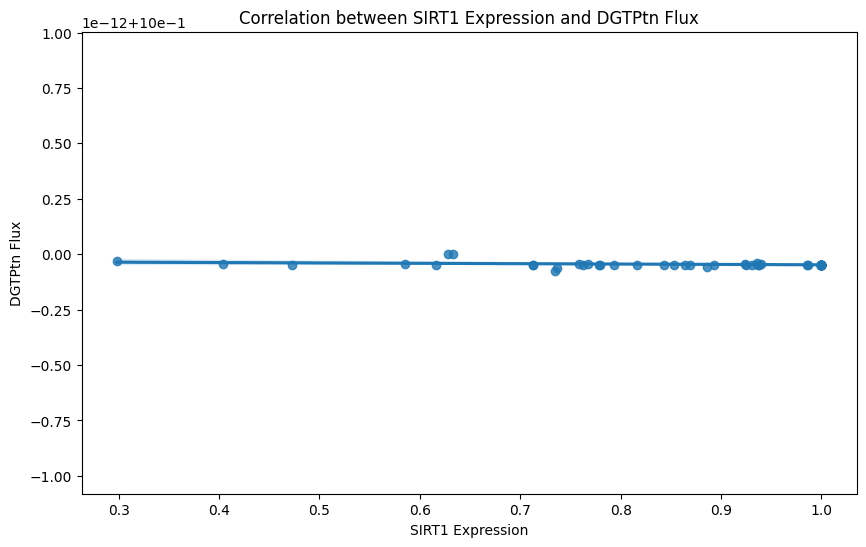

Linear regression results for SIRT1 and DGTPtn:
Slope: -1.658010796944337e-14
Intercept: 0.9999999999999695
R-squared: 0.08242259267067785
P-value: 0.015203590115284384
Standard error: 6.659797577467705e-15



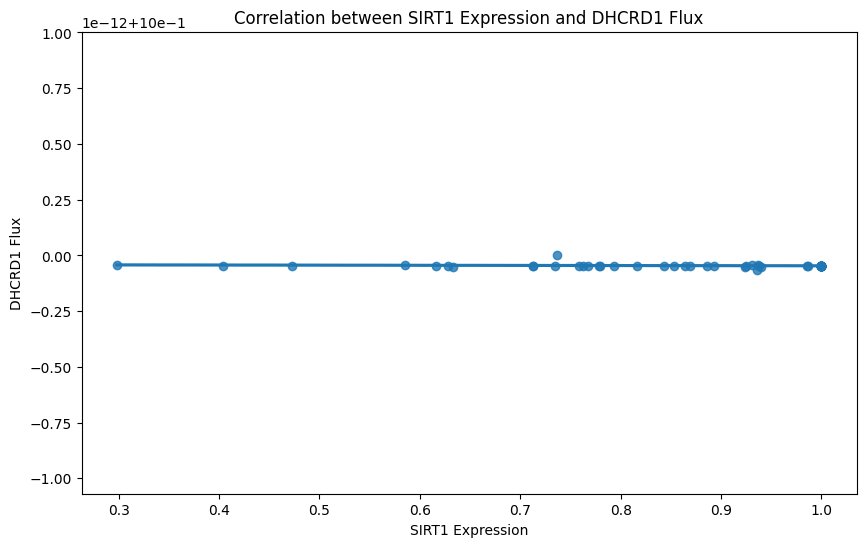

Linear regression results for SIRT1 and DHCRD1:
Slope: -4.997886021535517e-15
Intercept: 0.9999999999999586
R-squared: 0.016735624068259652
P-value: 0.2822687440840215
Standard error: 4.611858764576622e-15



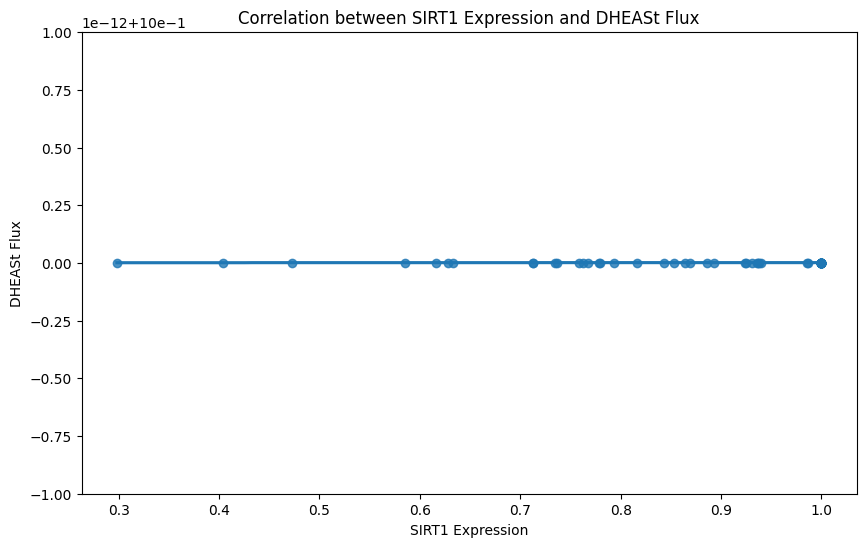

Linear regression results for SIRT1 and DHEASt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



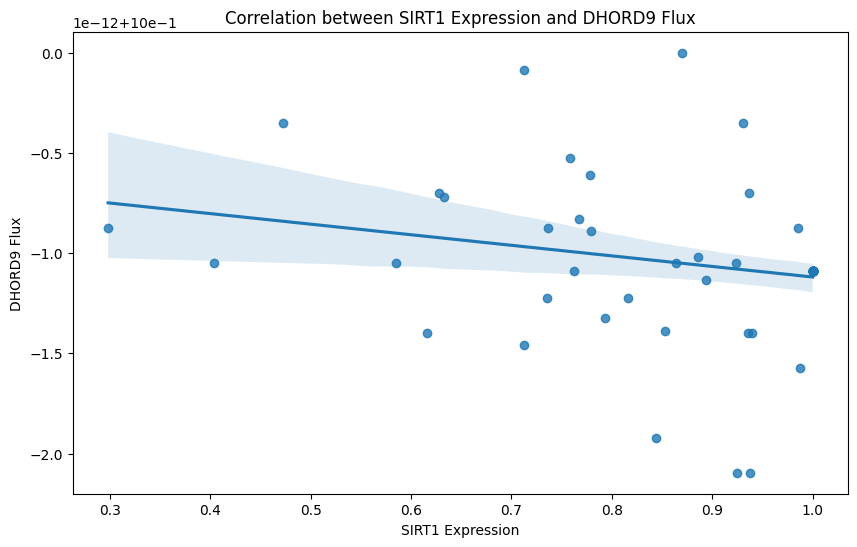

Linear regression results for SIRT1 and DHORD9:
Slope: -5.277829540545984e-13
Intercept: 0.9999999999994079
R-squared: 0.06079076289091417
P-value: 0.03819330844196844
Standard error: 2.4974292565829327e-13



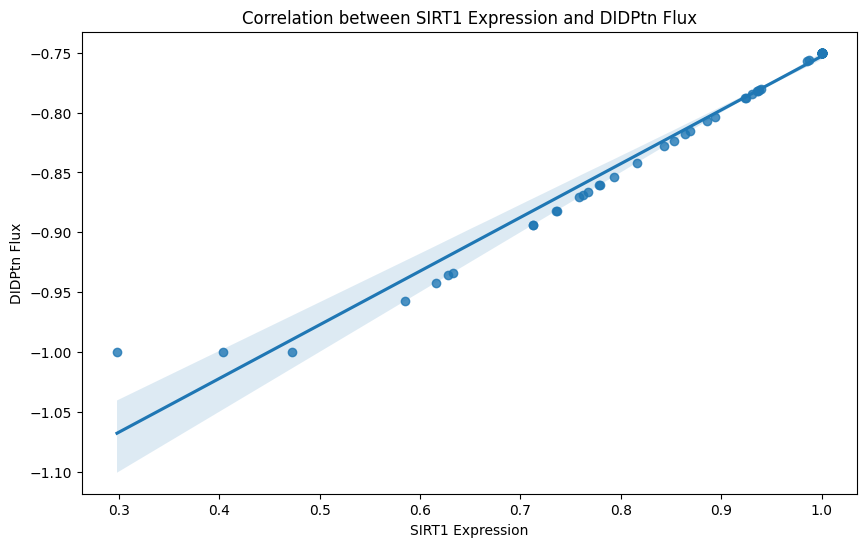

Linear regression results for SIRT1 and DIDPtn:
Slope: 0.4487257049314206
Intercept: -1.2017064983101997
R-squared: 0.9787139549542303
P-value: 2.017241600918774e-59
Standard error: 0.007966654834260182



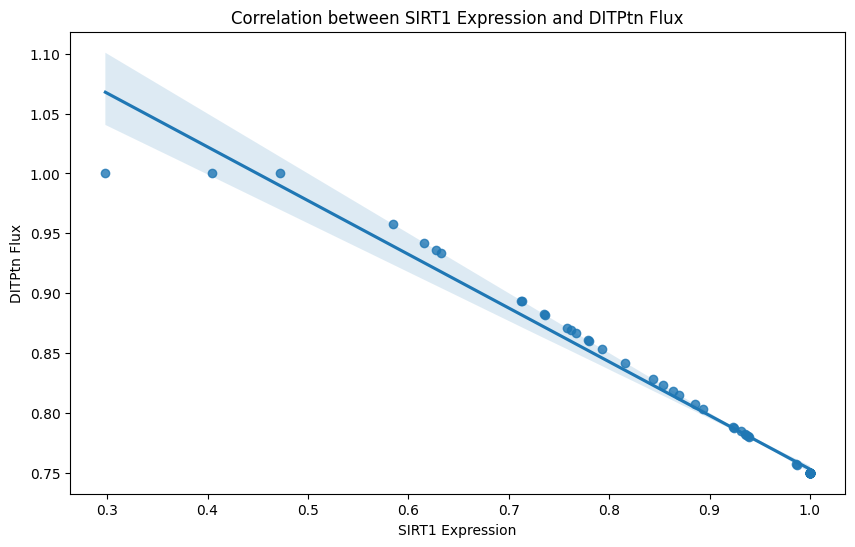

Linear regression results for SIRT1 and DITPtn:
Slope: -0.4487257049314206
Intercept: 1.2017064983101997
R-squared: 0.9787139549542303
P-value: 2.017241600918774e-59
Standard error: 0.007966654834260182



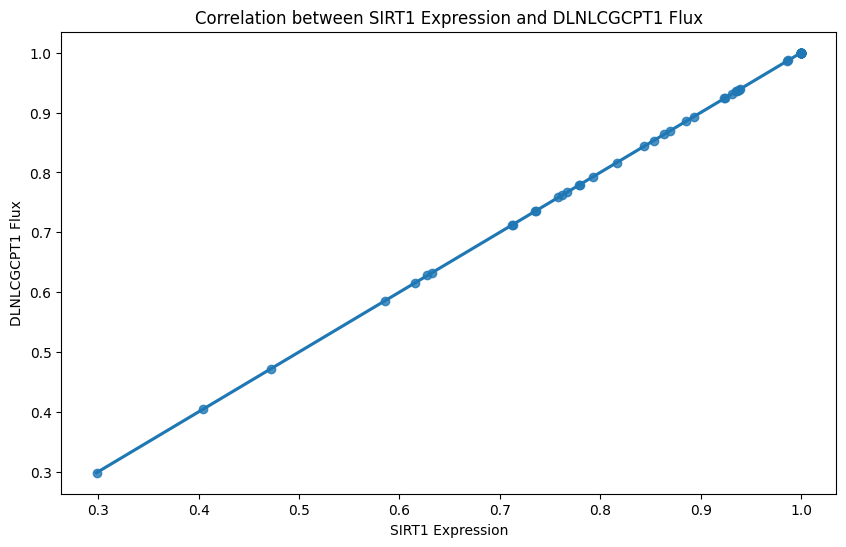

Linear regression results for SIRT1 and DLNLCGCPT1:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



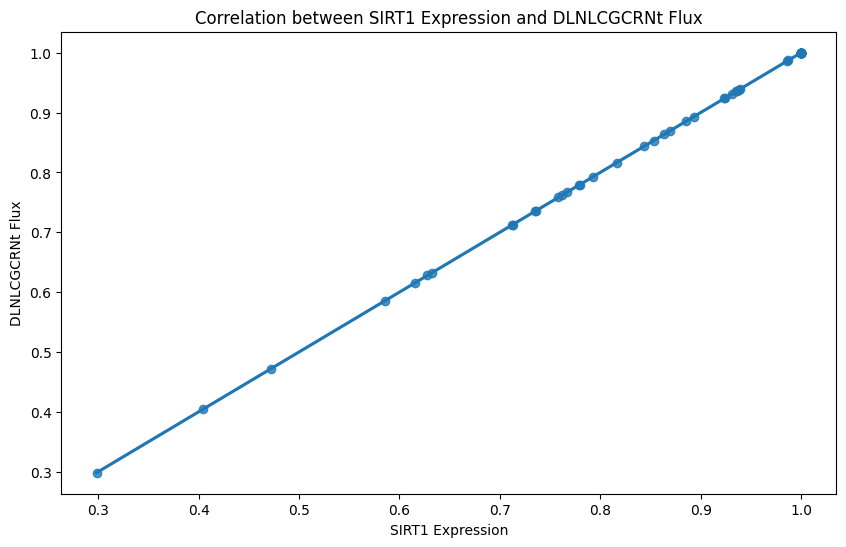

Linear regression results for SIRT1 and DLNLCGCRNt:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



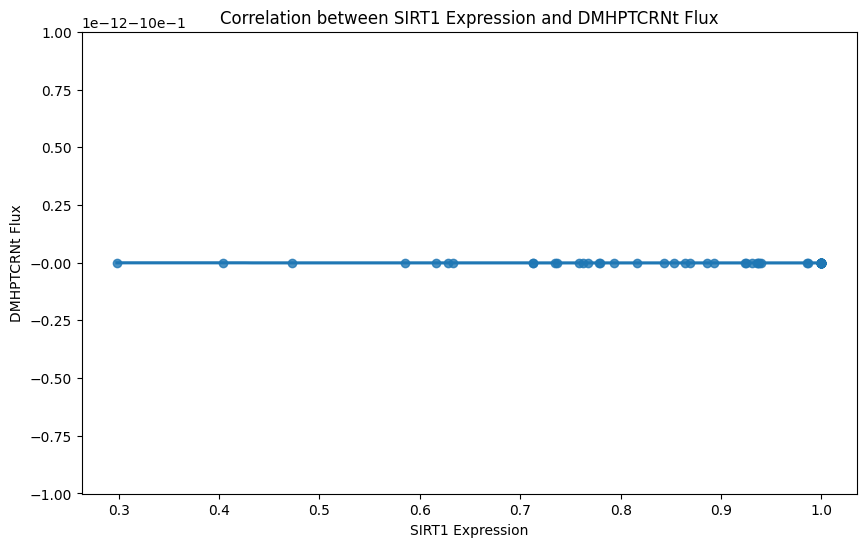

Linear regression results for SIRT1 and DMHPTCRNt:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



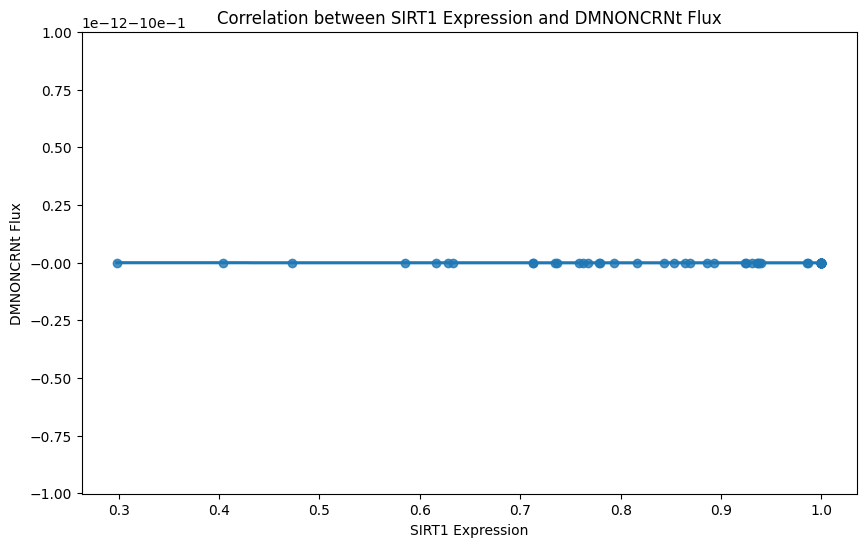

Linear regression results for SIRT1 and DMNONCRNt:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



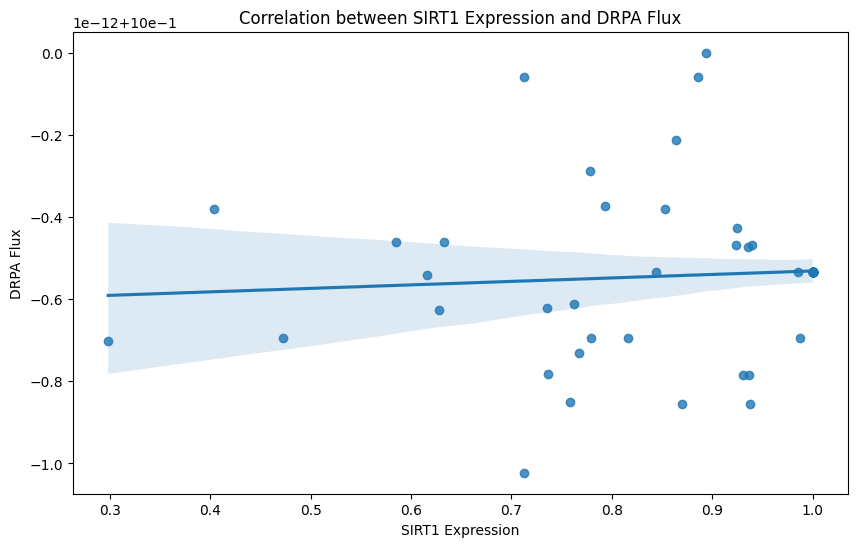

Linear regression results for SIRT1 and DRPA:
Slope: 8.416250730103698e-14
Intercept: 0.999999999999383
R-squared: 0.006456491204908167
P-value: 0.5053337828450151
Standard error: 1.2568668824786563e-13



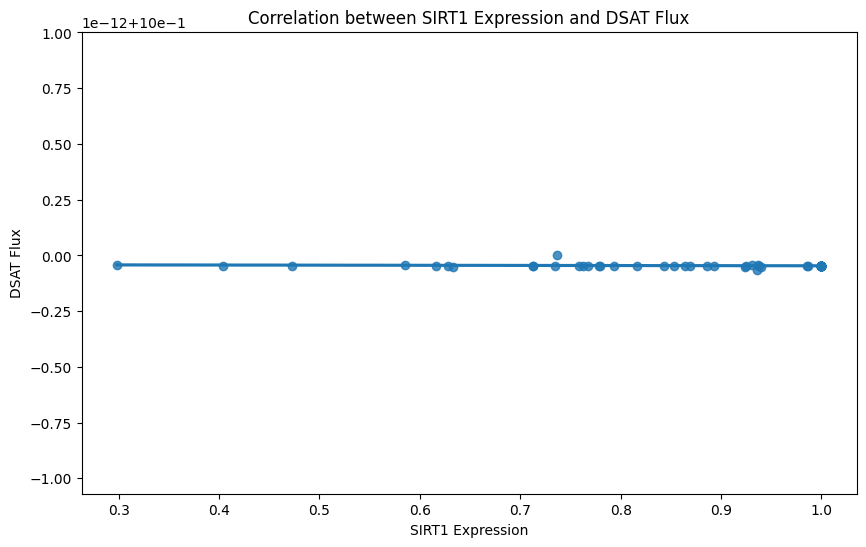

Linear regression results for SIRT1 and DSAT:
Slope: -4.997886021535517e-15
Intercept: 0.9999999999999586
R-squared: 0.016735624068259652
P-value: 0.2822687440840215
Standard error: 4.611858764576622e-15



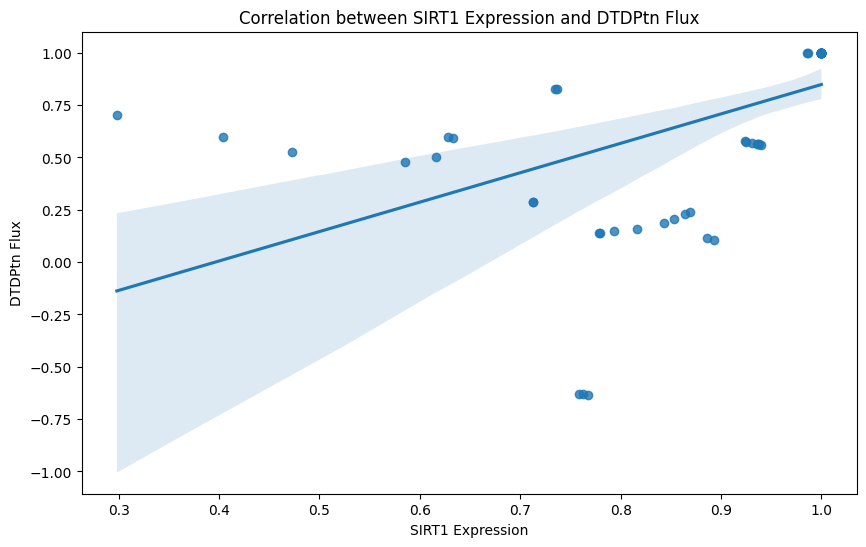

Linear regression results for SIRT1 and DTDPtn:
Slope: 1.4052372147473307
Intercept: -0.5569761360889693
R-squared: 0.2788587040364599
P-value: 2.2148042343370423e-06
Standard error: 0.272046521959827



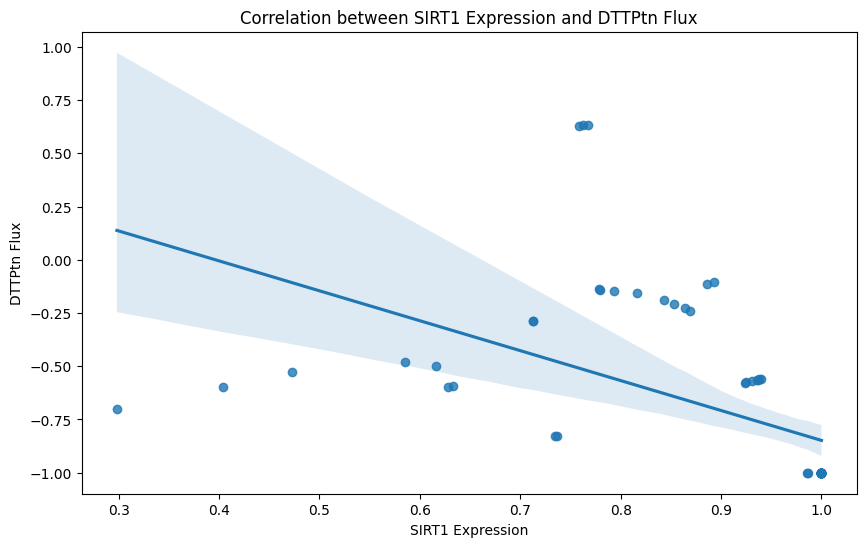

Linear regression results for SIRT1 and DTTPtn:
Slope: -1.4053547367510346
Intercept: 0.5571063482362939
R-squared: 0.2788587040364594
P-value: 2.2148042343370914e-06
Standard error: 0.2720692736006363



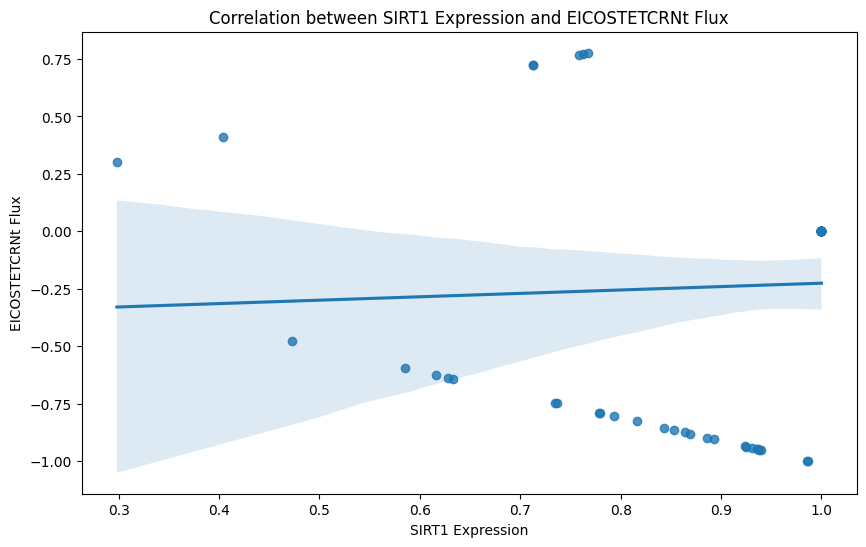

Linear regression results for SIRT1 and EICOSTETCRNt:
Slope: 0.14786380250870693
Intercept: -0.3732801788021759
R-squared: 0.0022128897895057776
P-value: 0.6968636727332265
Standard error: 0.3779865767722663



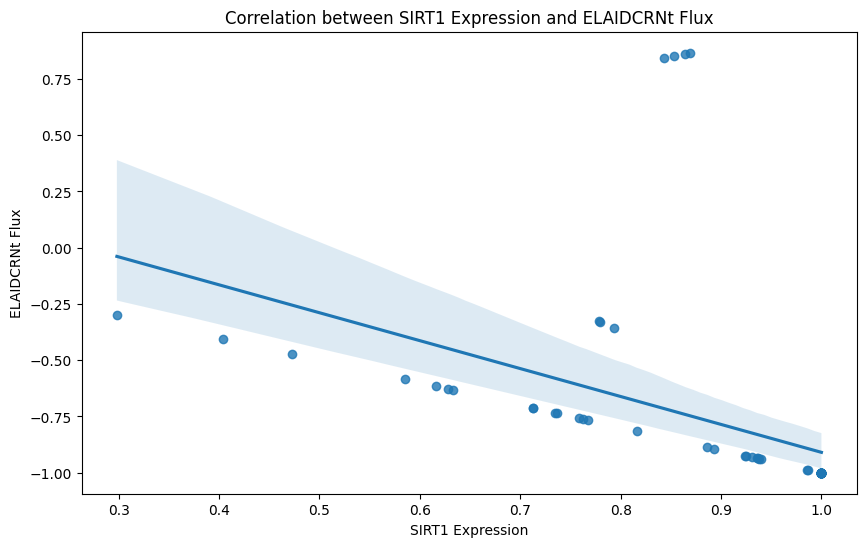

Linear regression results for SIRT1 and ELAIDCRNt:
Slope: -1.2409459633640947
Intercept: 0.3315412420206145
R-squared: 0.1930922236479533
P-value: 0.00012613326553854821
Standard error: 0.3053921600747916



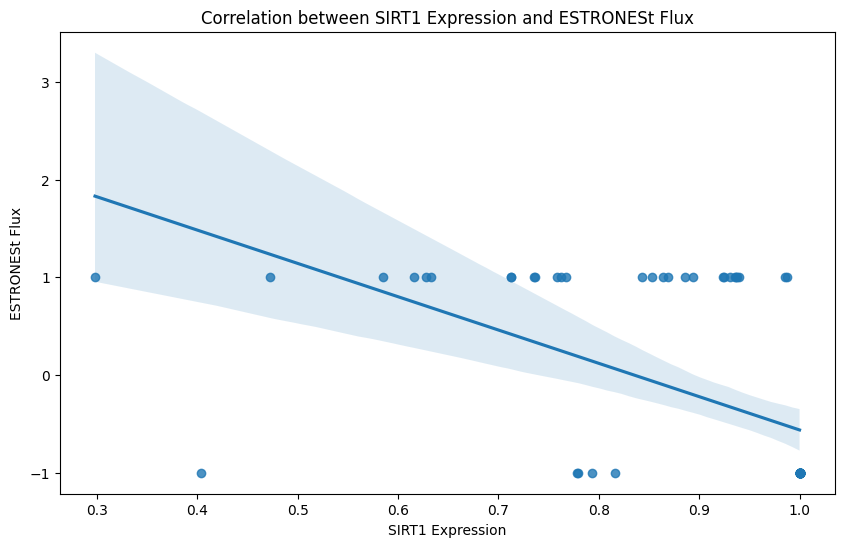

Linear regression results for SIRT1 and ESTRONESt:
Slope: -3.4110940508354277
Intercept: 2.8489852466206975
R-squared: 0.30111225595763597
P-value: 7.251327630163091e-07
Standard error: 0.6256171486455506



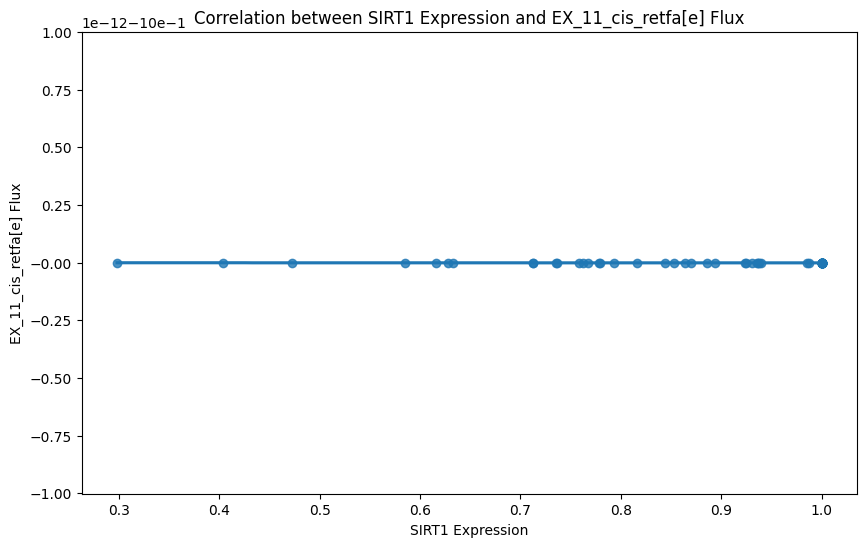

Linear regression results for SIRT1 and EX_11_cis_retfa[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



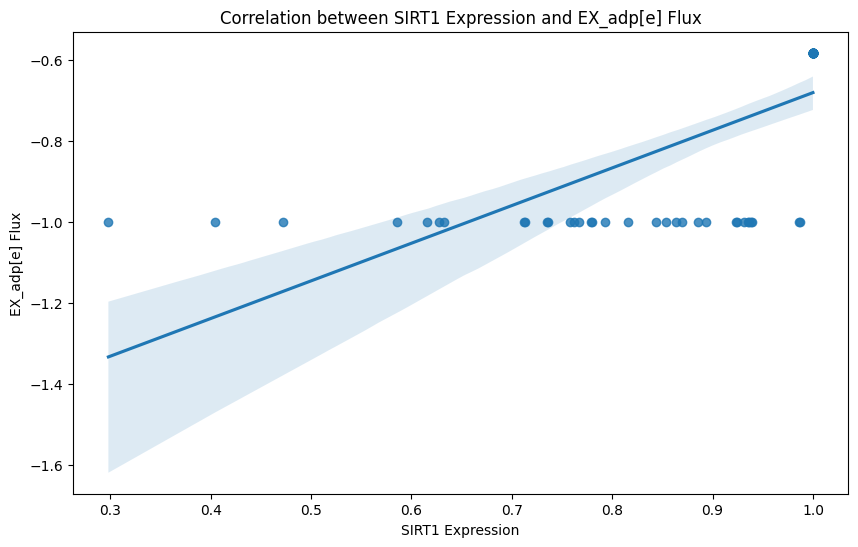

Linear regression results for SIRT1 and EX_adp[e]:
Slope: 0.9306353430384663
Intercept: -1.611212863196387
R-squared: 0.49271140514695655
P-value: 9.117085759106804e-12
Standard error: 0.11368056882526818



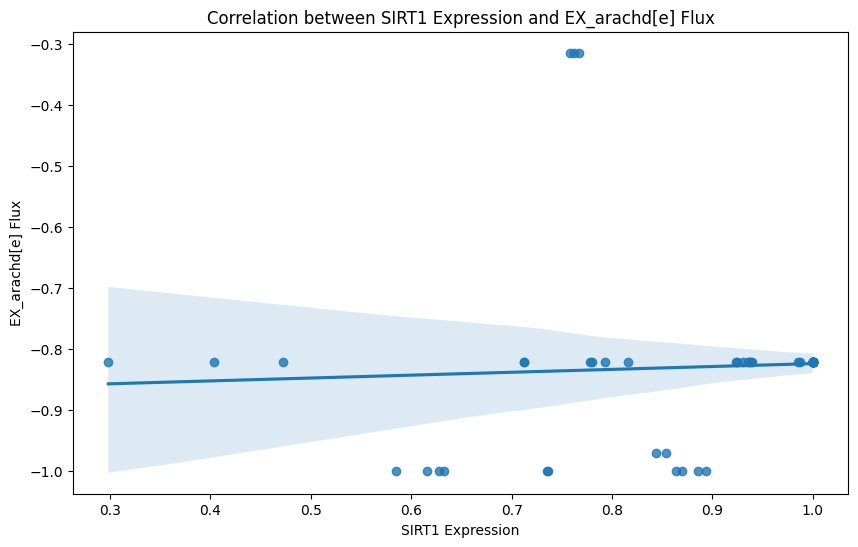

Linear regression results for SIRT1 and EX_arachd[e]:
Slope: 0.047286775626375045
Intercept: -0.8717030495999782
R-squared: 0.003473477954700703
P-value: 0.6253972749879992
Standard error: 0.09642226156756165



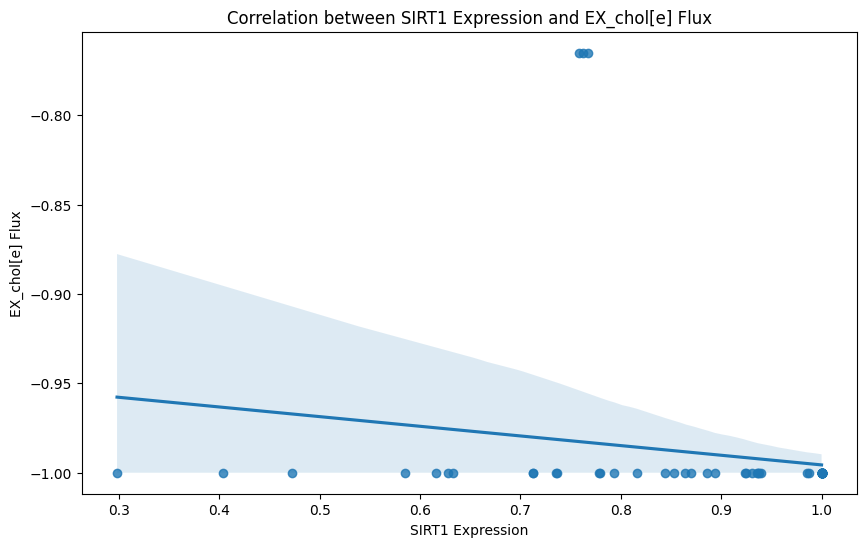

Linear regression results for SIRT1 and EX_chol[e]:
Slope: -0.05402904287515024
Intercept: -0.9416011948816129
R-squared: 0.03231158447371453
P-value: 0.1336147338815128
Standard error: 0.03559519464488706



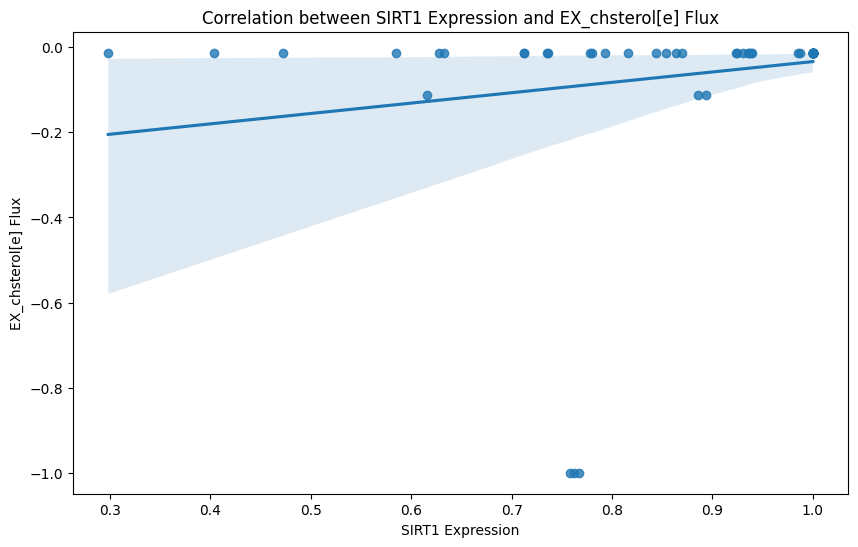

Linear regression results for SIRT1 and EX_chsterol[e]:
Slope: 0.24387213659777315
Intercept: -0.2777494078450472
R-squared: 0.03725119396374746
P-value: 0.10682478719603347
Standard error: 0.14925333141438377



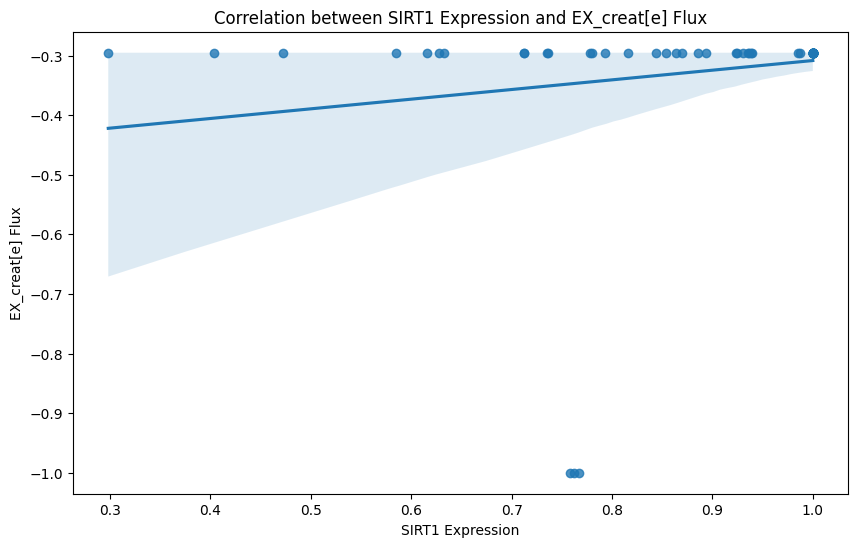

Linear regression results for SIRT1 and EX_creat[e]:
Slope: 0.16208712862540875
Intercept: -0.47039287169445276
R-squared: 0.03231158447372936
P-value: 0.13361473388142192
Standard error: 0.10678558393460819



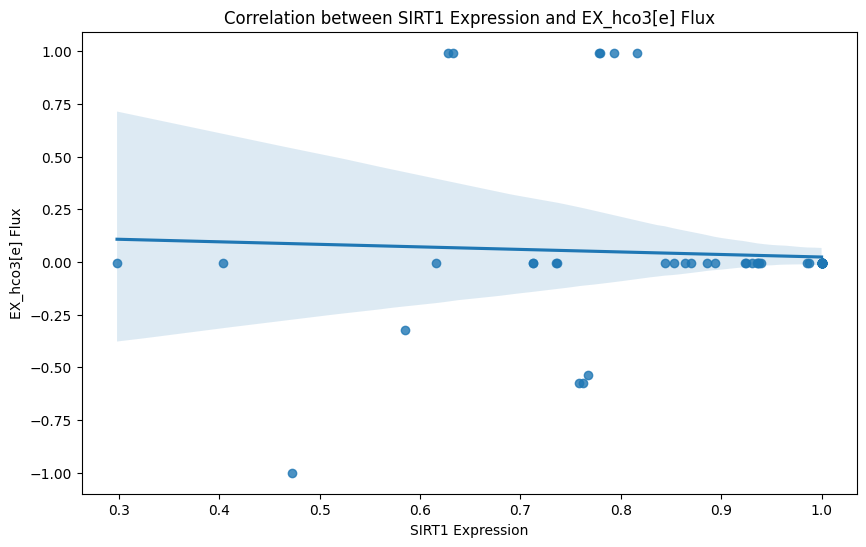

Linear regression results for SIRT1 and EX_hco3[e]:
Slope: -0.12031853441058983
Intercept: 0.14412239087618525
R-squared: 0.0032261465954725515
P-value: 0.6380097017001749
Standard error: 0.2546034343862332



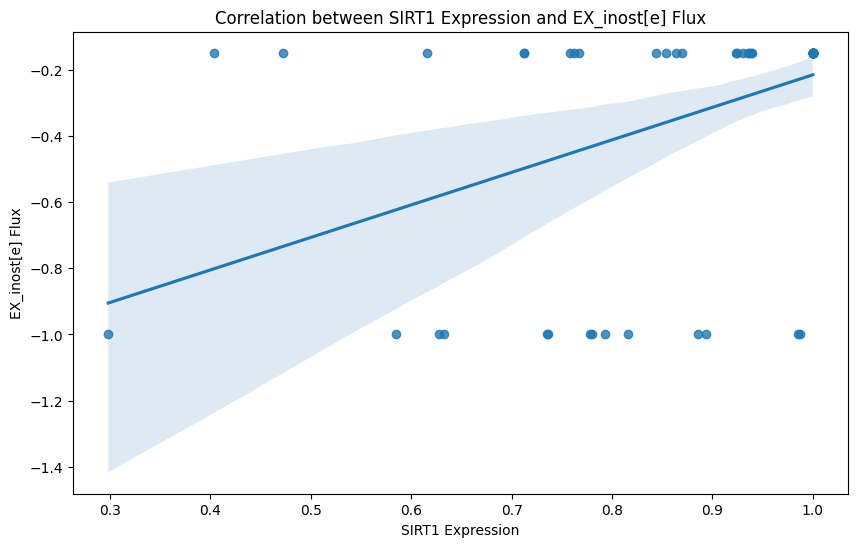

Linear regression results for SIRT1 and EX_inost[e]:
Slope: 0.9822528483781708
Intercept: -1.1979755858358192
R-squared: 0.2080393234453617
P-value: 6.401949369765978e-05
Standard error: 0.23071606933619002



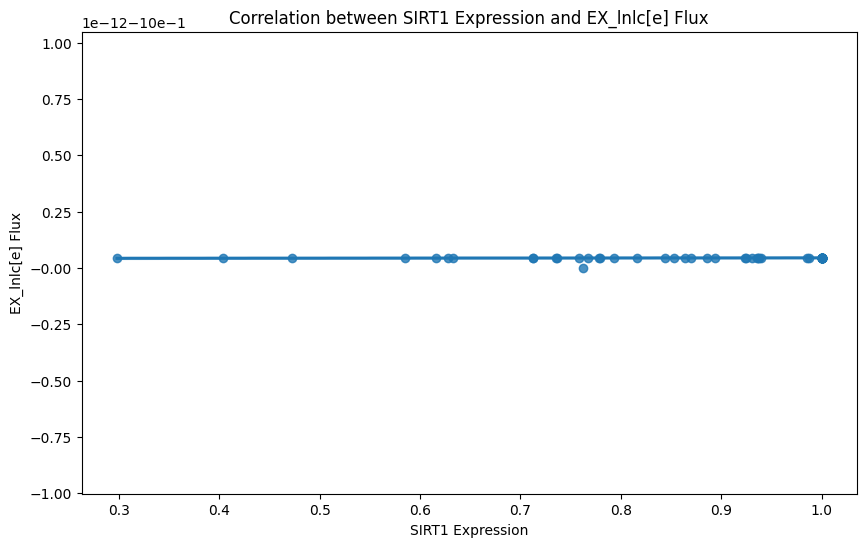

Linear regression results for SIRT1 and EX_lnlc[e]:
Slope: 3.499746346208894e-15
Intercept: -0.9999999999999585
R-squared: 0.010502533036377097
P-value: 0.39507927208787974
Standard error: 4.089520020659197e-15



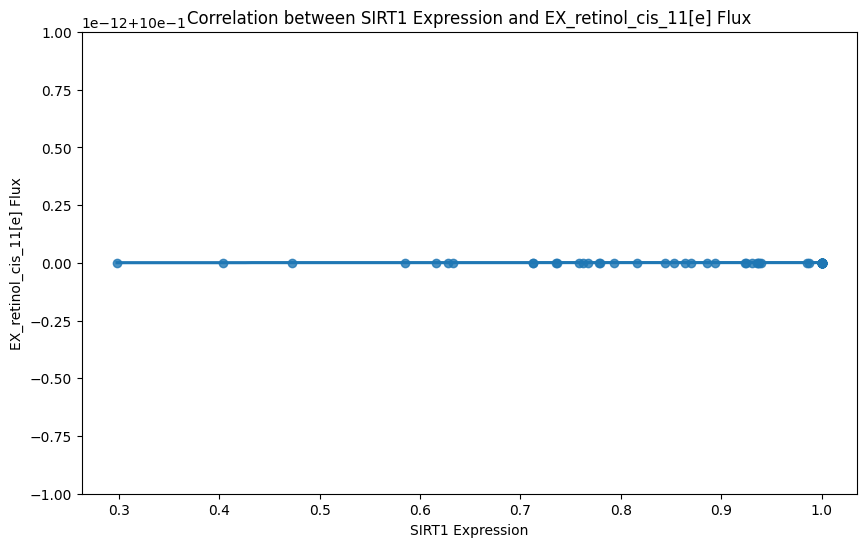

Linear regression results for SIRT1 and EX_retinol_cis_11[e]:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



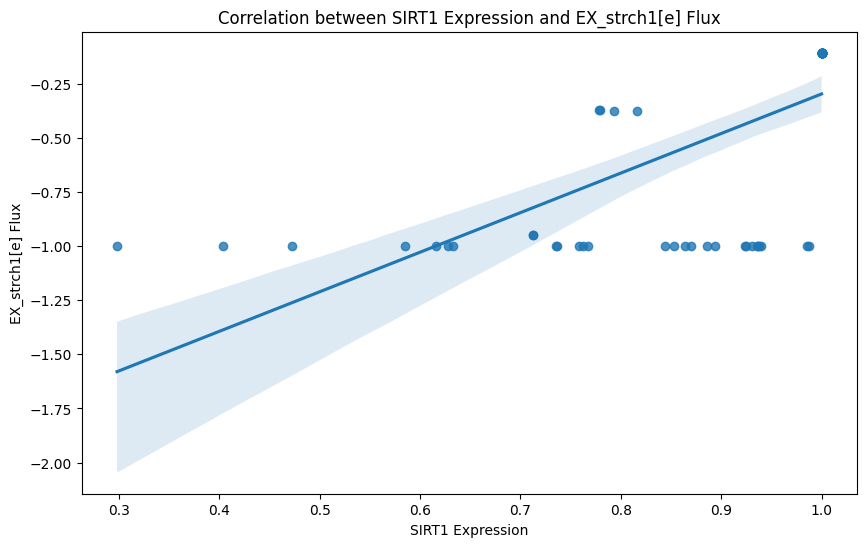

Linear regression results for SIRT1 and EX_strch1[e]:
Slope: 1.8280645346643143
Intercept: -2.125250745014519
R-squared: 0.44850537504066046
P-value: 1.7021712245047777e-10
Standard error: 0.24403594152486893



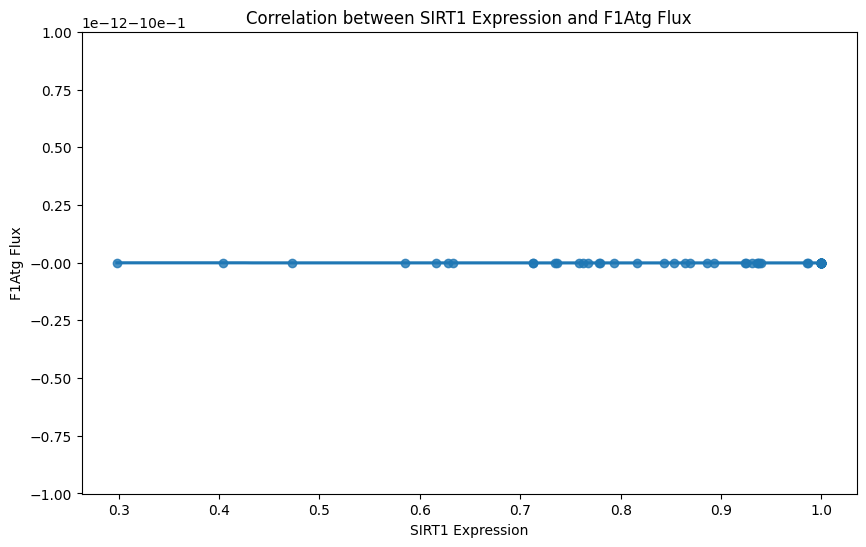

Linear regression results for SIRT1 and F1Atg:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



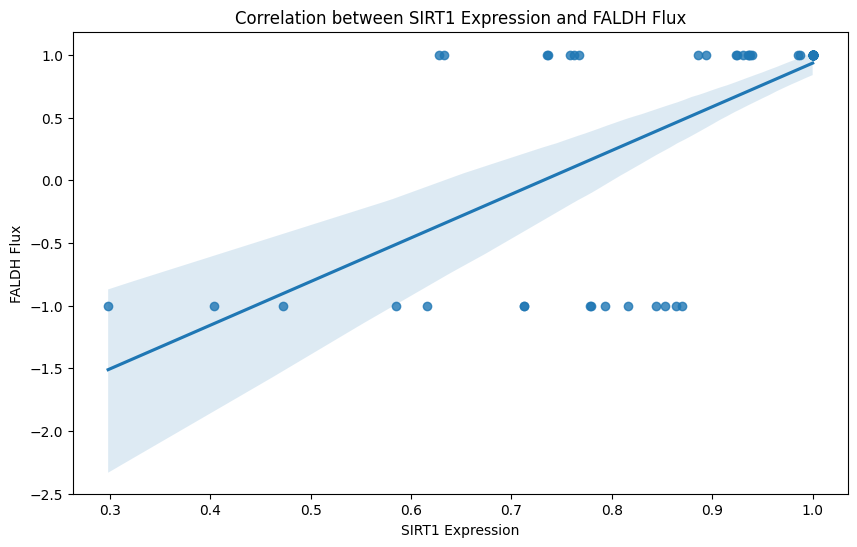

Linear regression results for SIRT1 and FALDH:
Slope: 3.4858450057442614
Intercept: -2.5498506597329844
R-squared: 0.4507174692877088
P-value: 1.478349664207781e-10
Standard error: 0.46326471748885545



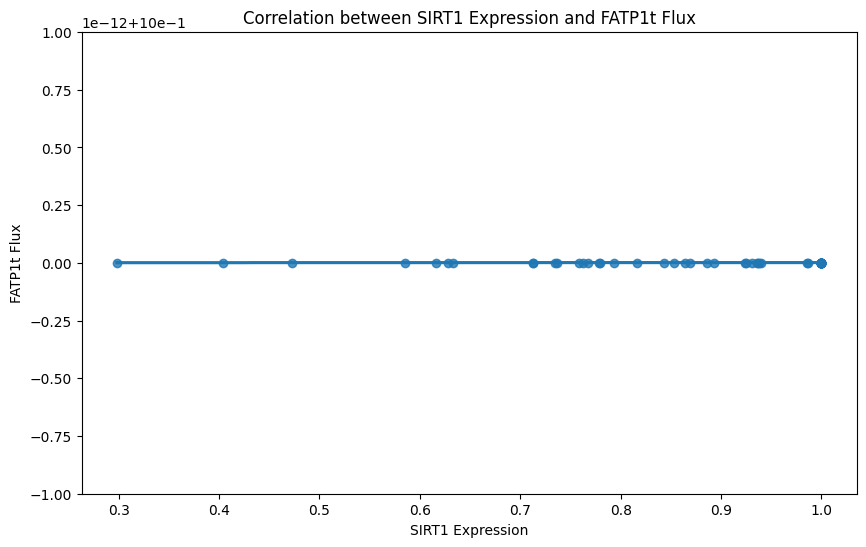

Linear regression results for SIRT1 and FATP1t:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



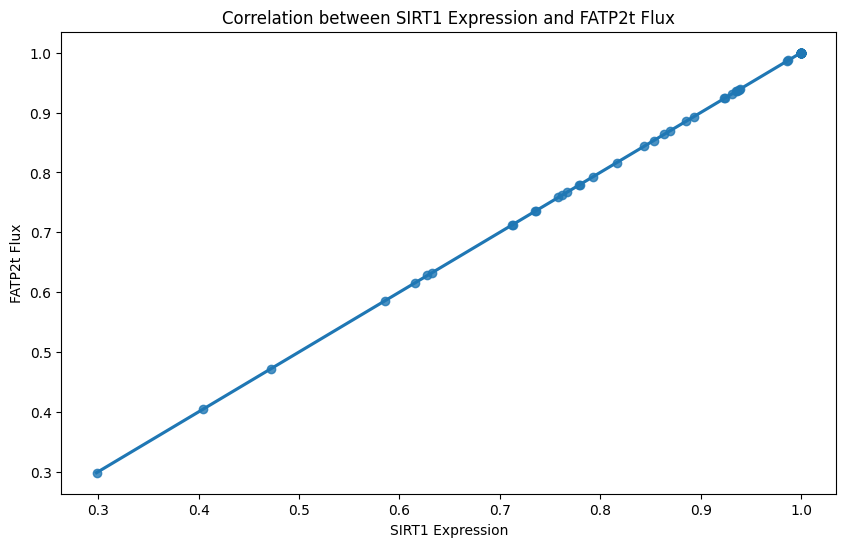

Linear regression results for SIRT1 and FATP2t:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



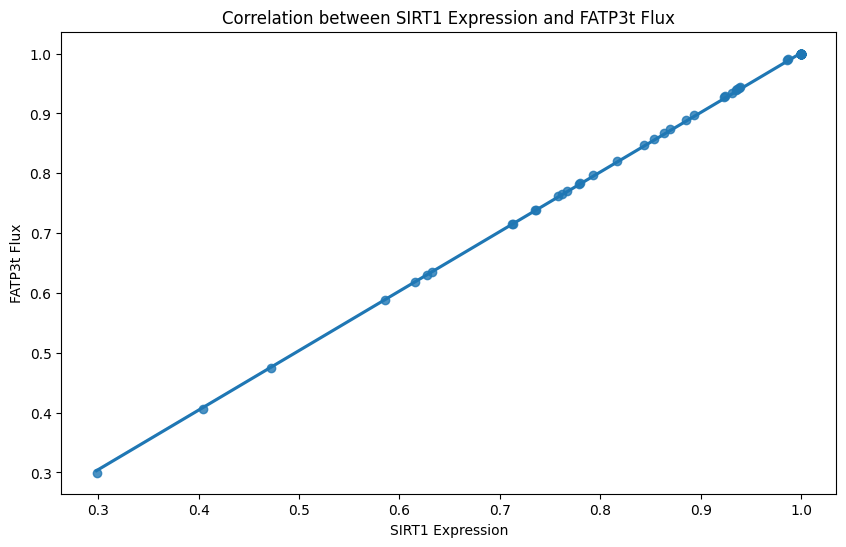

Linear regression results for SIRT1 and FATP3t:
Slope: 0.9946916587569009
Intercept: 0.006328778558603698
R-squared: 0.999903382125056
P-value: 2.9204214650801505e-140
Standard error: 0.00117710079390063



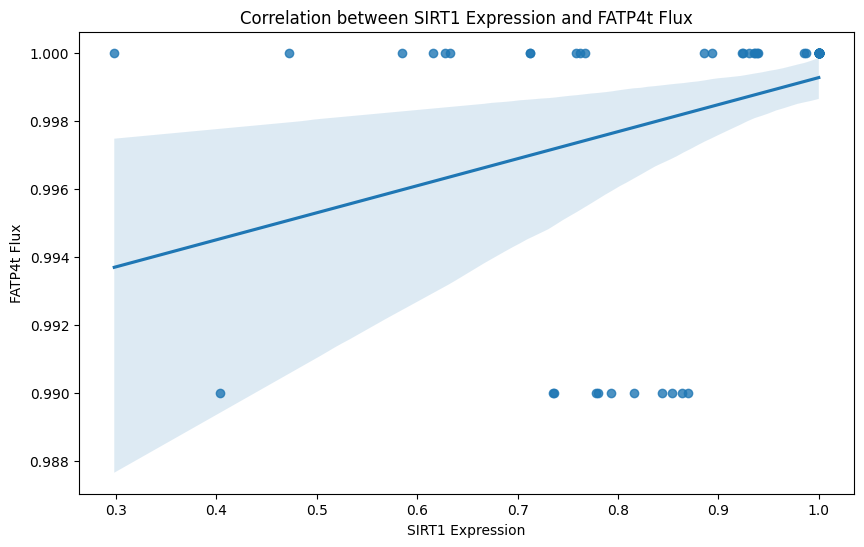

Linear regression results for SIRT1 and FATP4t:
Slope: 0.007954181258023291
Intercept: 0.9913146342374096
R-squared: 0.1194743163685098
P-value: 0.003153281596024774
Standard error: 0.0025995889066810053



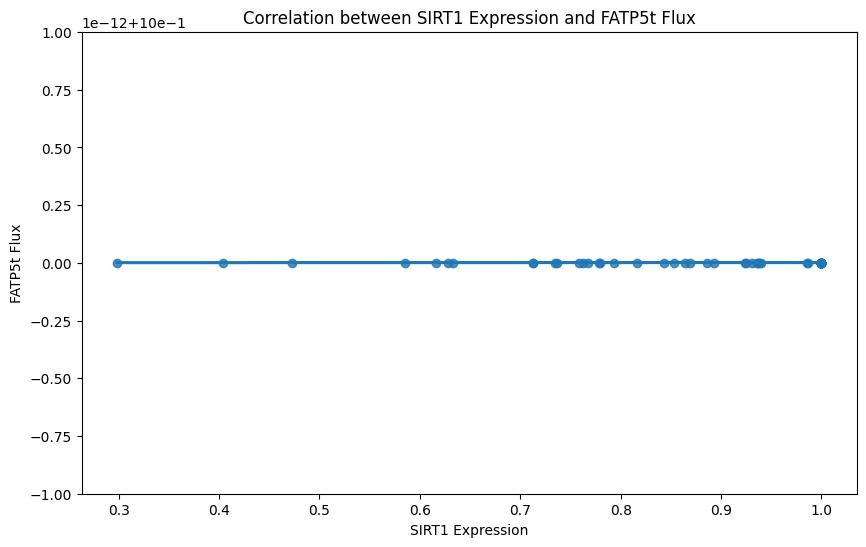

Linear regression results for SIRT1 and FATP5t:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



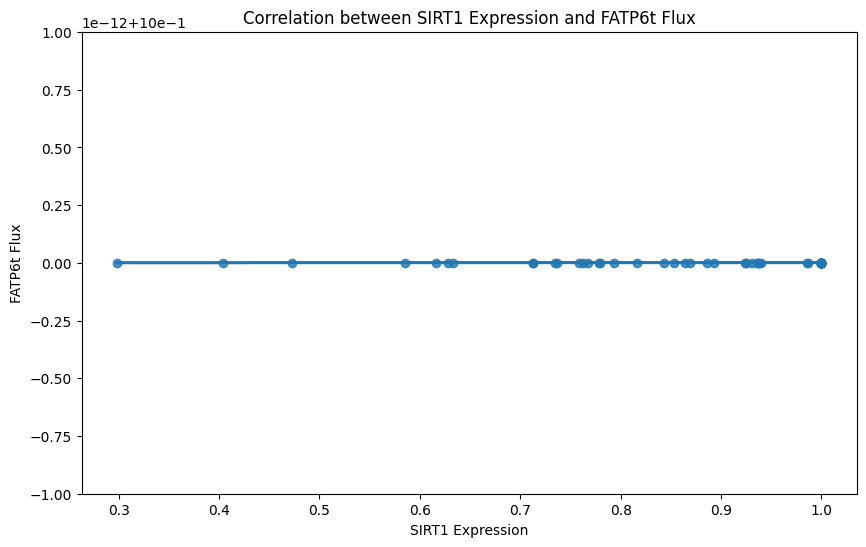

Linear regression results for SIRT1 and FATP6t:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



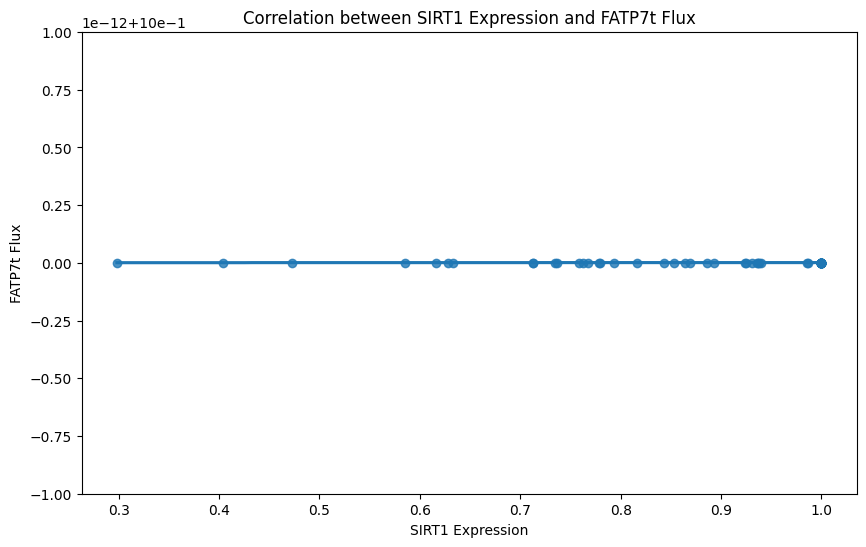

Linear regression results for SIRT1 and FATP7t:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



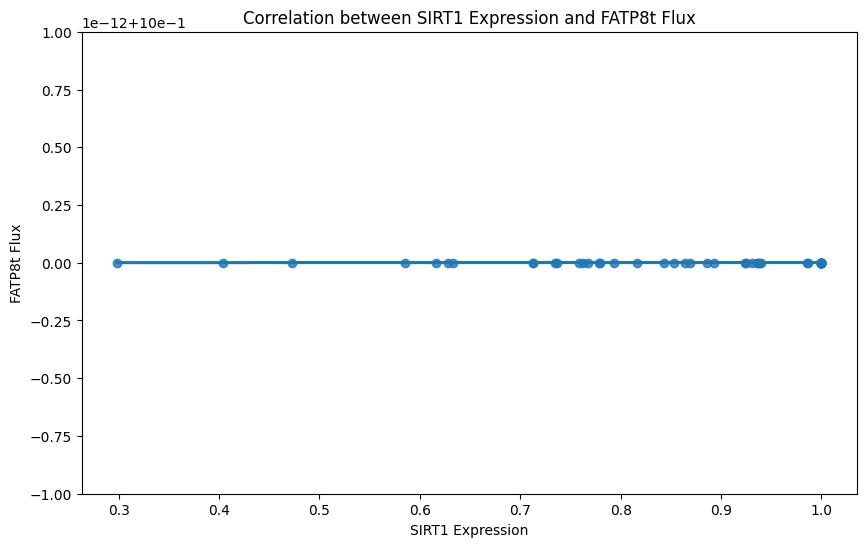

Linear regression results for SIRT1 and FATP8t:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



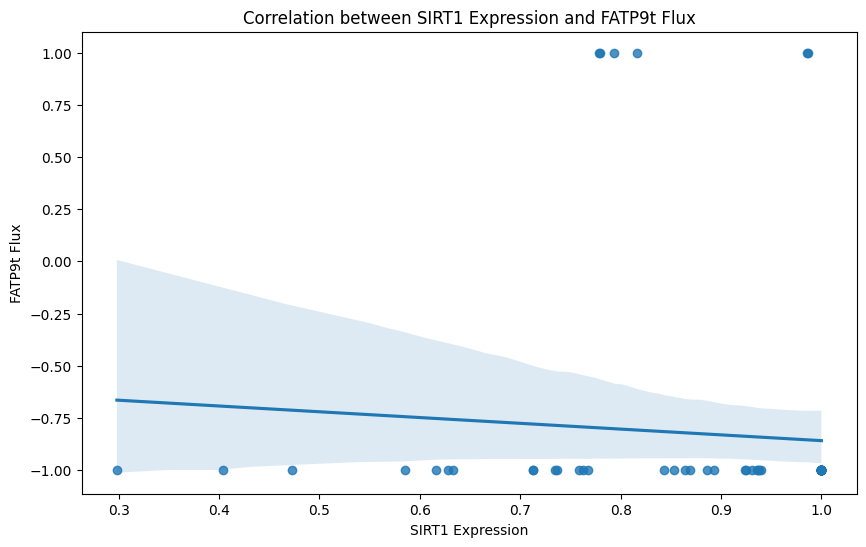

Linear regression results for SIRT1 and FATP9t:
Slope: -0.27681869664557485
Intercept: -0.5826388475604516
R-squared: 0.006122006179760728
P-value: 0.516608341068919
Standard error: 0.4246103046763848



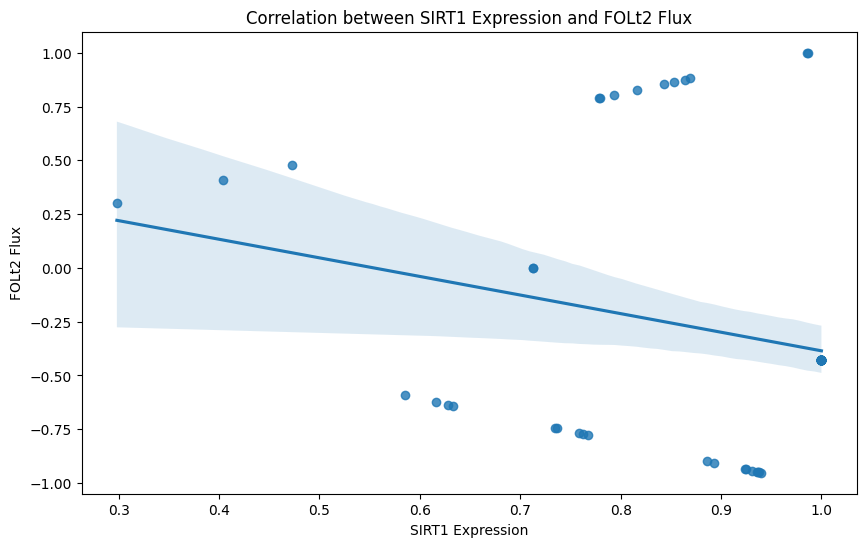

Linear regression results for SIRT1 and FOLt2:
Slope: -0.8642209655564724
Intercept: 0.4787812735268886
R-squared: 0.062187694285171256
P-value: 0.03597346114366645
Standard error: 0.4040229065212556



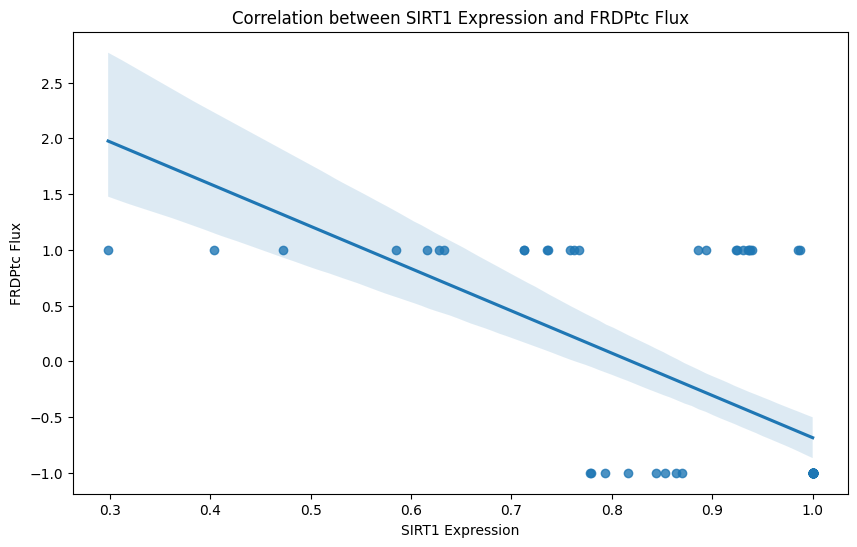

Linear regression results for SIRT1 and FRDPtc:
Slope: -3.7922663858676304
Intercept: 3.10644582768648
R-squared: 0.3896434359452706
P-value: 6.013492062588685e-09
Standard error: 0.5713897148961938



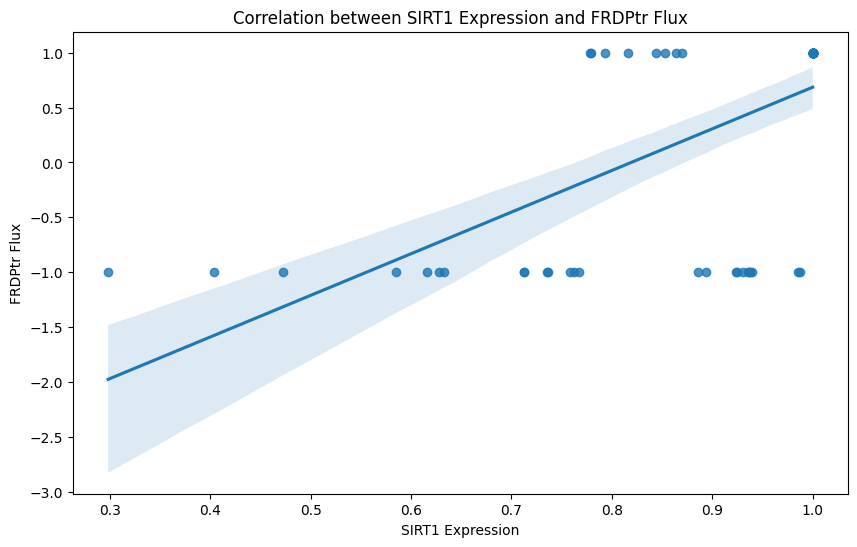

Linear regression results for SIRT1 and FRDPtr:
Slope: 3.7922663858676304
Intercept: -3.10644582768648
R-squared: 0.3896434359452706
P-value: 6.013492062588685e-09
Standard error: 0.5713897148961938



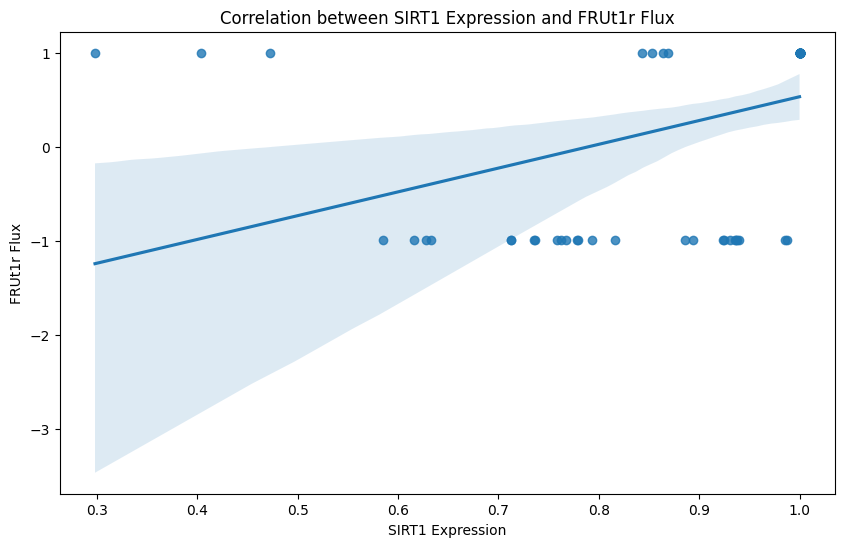

Linear regression results for SIRT1 and FRUt1r:
Slope: 2.531204840816912
Intercept: -1.999595266603101
R-squared: 0.17234158913585346
P-value: 0.00031839808731023495
Standard error: 0.6677797832421012



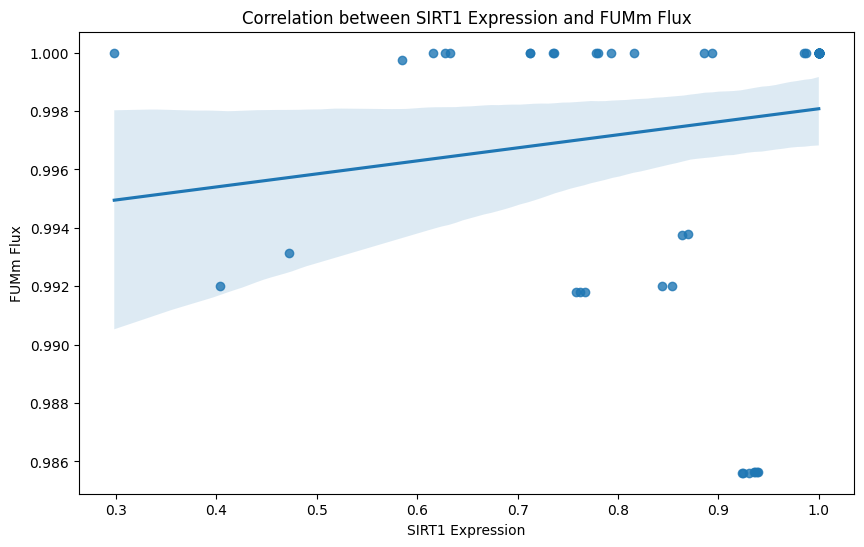

Linear regression results for SIRT1 and FUMm:
Slope: 0.004464176406555565
Intercept: 0.9936168770340253
R-squared: 0.022356948850107503
P-value: 0.21329903456542745
Standard error: 0.003553863105244759



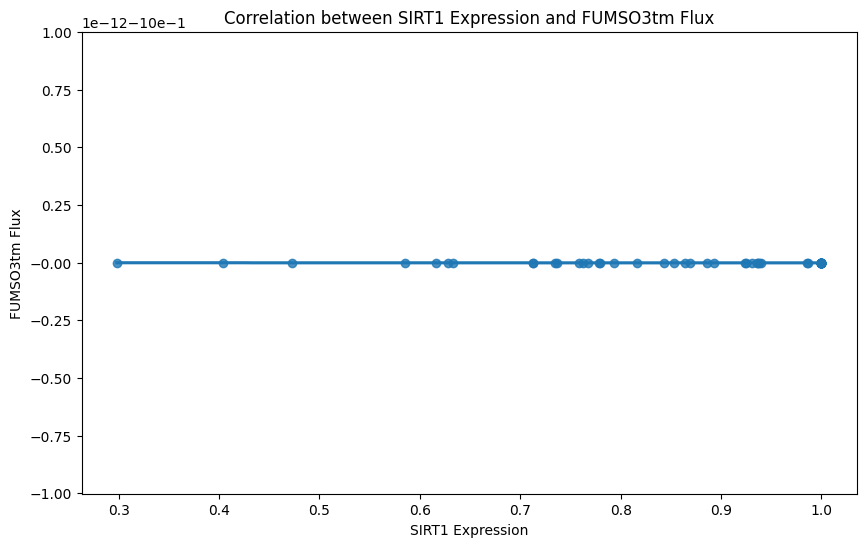

Linear regression results for SIRT1 and FUMSO3tm:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



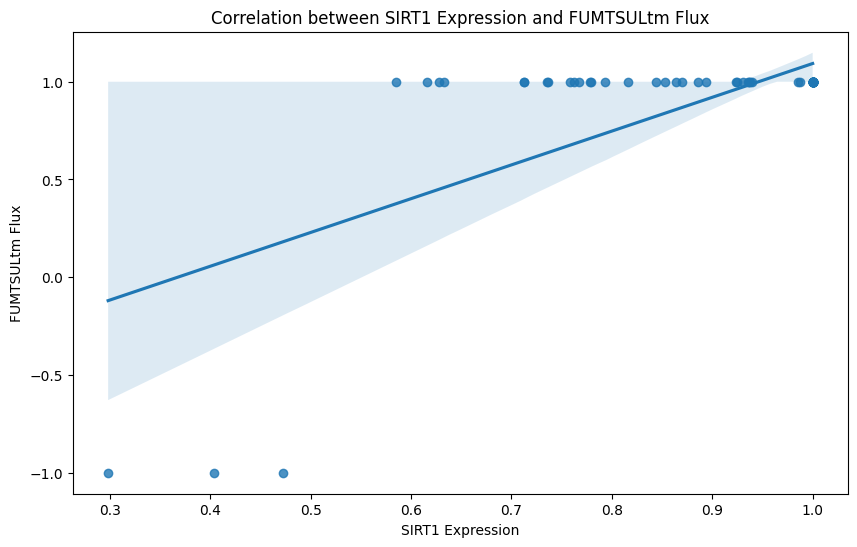

Linear regression results for SIRT1 and FUMTSULtm:
Slope: 1.7284493326840358
Intercept: -0.6351802050261025
R-squared: 0.4563002122297234
P-value: 1.0332236442853775e-10
Standard error: 0.2271361992234



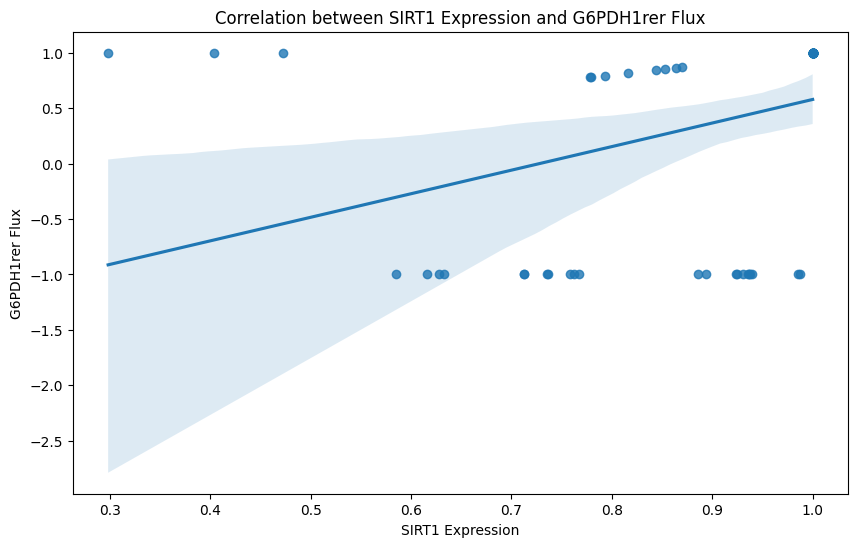

Linear regression results for SIRT1 and G6PDH1rer:
Slope: 2.1251956363569953
Intercept: -1.5466244494543868
R-squared: 0.13398032556165487
P-value: 0.0016939948331245634
Standard error: 0.6504557168094408



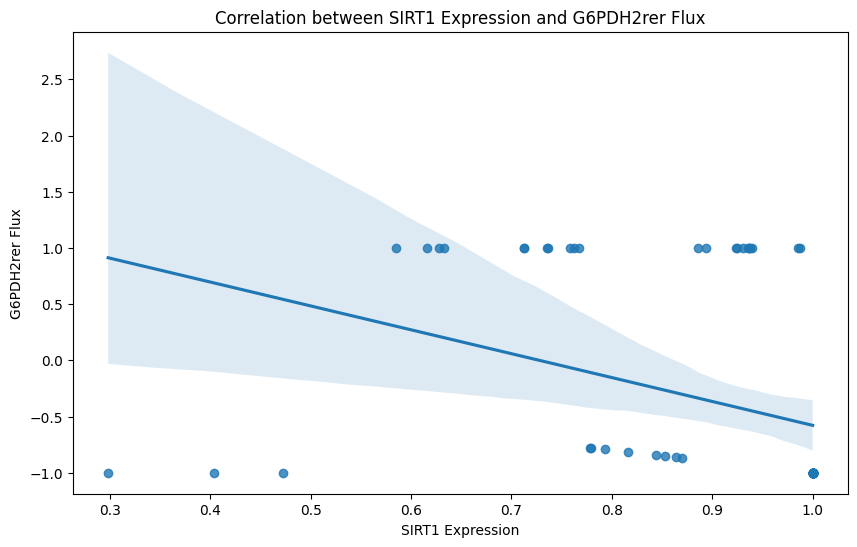

Linear regression results for SIRT1 and G6PDH2rer:
Slope: -2.1251956363569953
Intercept: 1.5466244494543868
R-squared: 0.13398032556165487
P-value: 0.0016939948331245634
Standard error: 0.6504557168094408



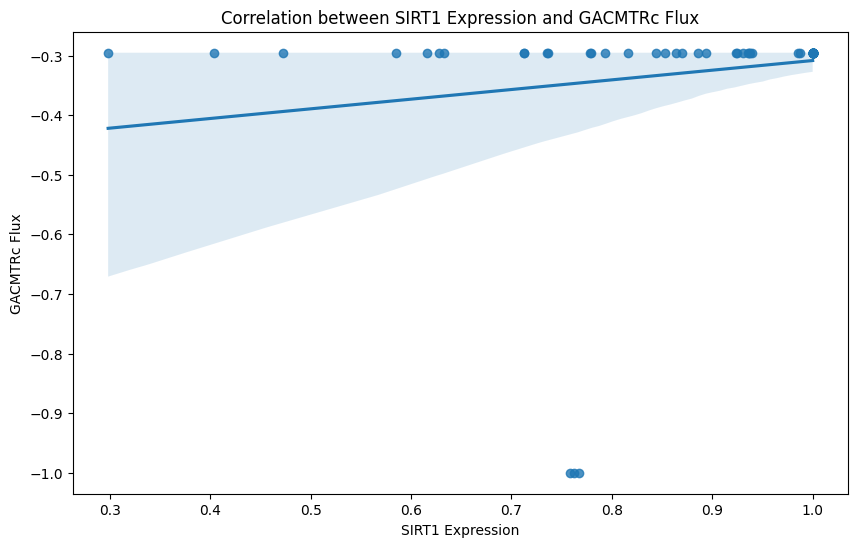

Linear regression results for SIRT1 and GACMTRc:
Slope: 0.1620871286253687
Intercept: -0.47039287169445465
R-squared: 0.032311584473717035
P-value: 0.13361473388149736
Standard error: 0.10678558393460284



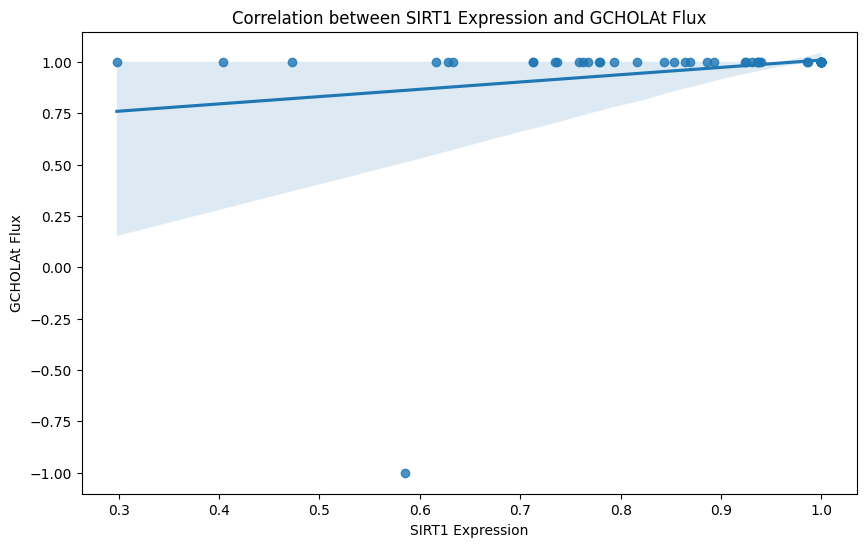

Linear regression results for SIRT1 and GCHOLAt:
Slope: 0.35540227158293386
Intercept: 0.652982898146401
R-squared: 0.056222465970433275
P-value: 0.046483561953571235
Standard error: 0.1752974208370211



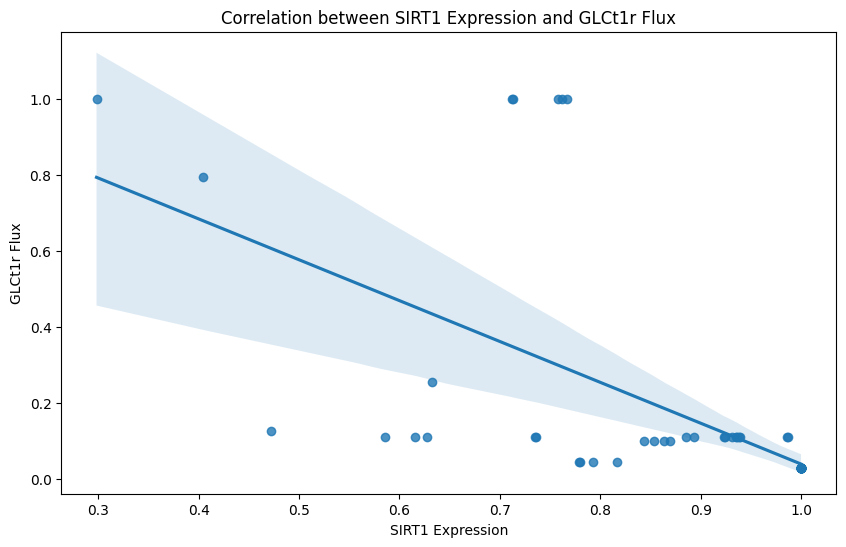

Linear regression results for SIRT1 and GLCt1r:
Slope: -1.0759721959009674
Intercept: 1.1151111602497452
R-squared: 0.376685927441432
P-value: 1.2610618517828864e-08
Standard error: 0.16662504192556382



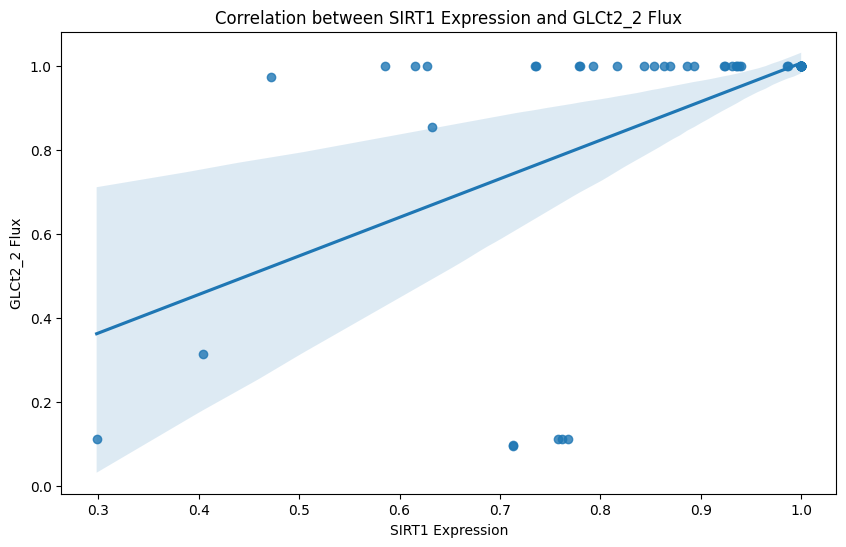

Linear regression results for SIRT1 and GLCt2_2:
Slope: 0.919273797484707
Intercept: 0.08758977376092136
R-squared: 0.31224575702708096
P-value: 4.097865438786661e-07
Standard error: 0.16424369331912456



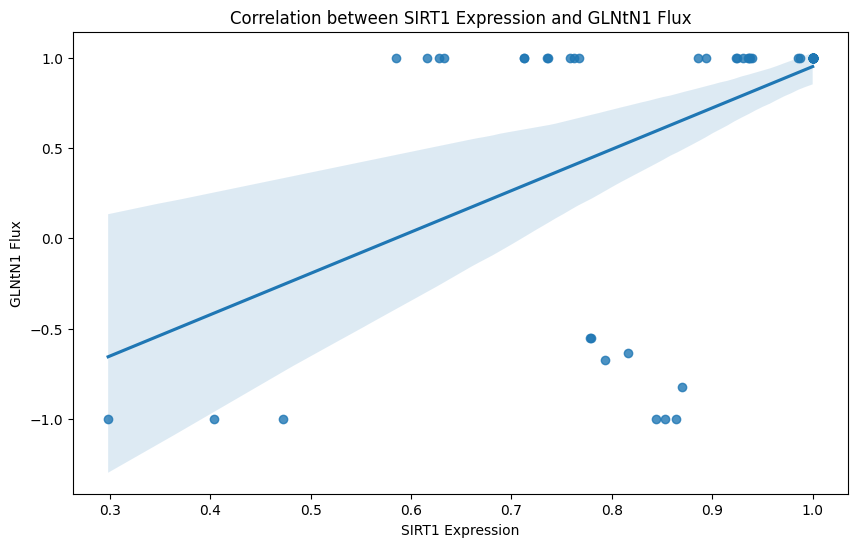

Linear regression results for SIRT1 and GLNtN1:
Slope: 2.2897676235232507
Intercept: -1.3392519504542268
R-squared: 0.2889987969396246
P-value: 1.3367985896680705e-06
Standard error: 0.43236846932839634



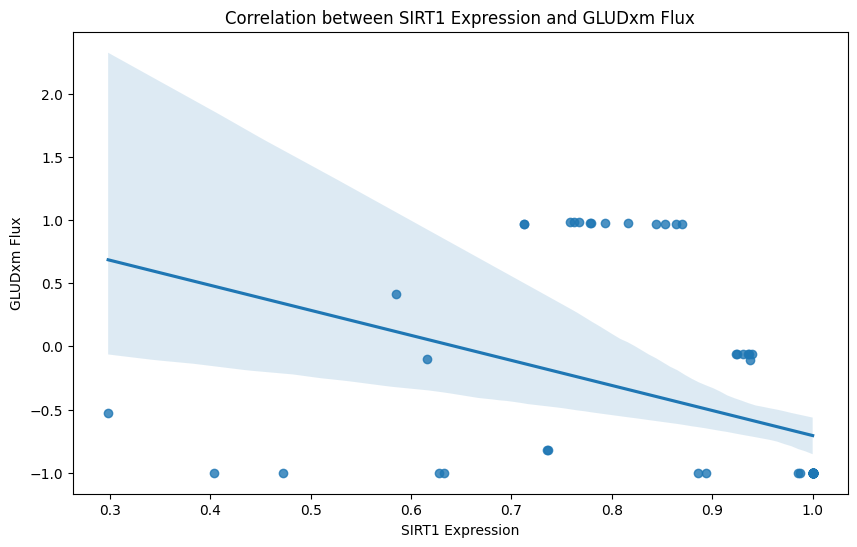

Linear regression results for SIRT1 and GLUDxm:
Slope: -1.9822225384796344
Intercept: 1.27630464374576
R-squared: 0.16303651316389317
P-value: 0.0004797123596439757
Standard error: 0.5406779783162837



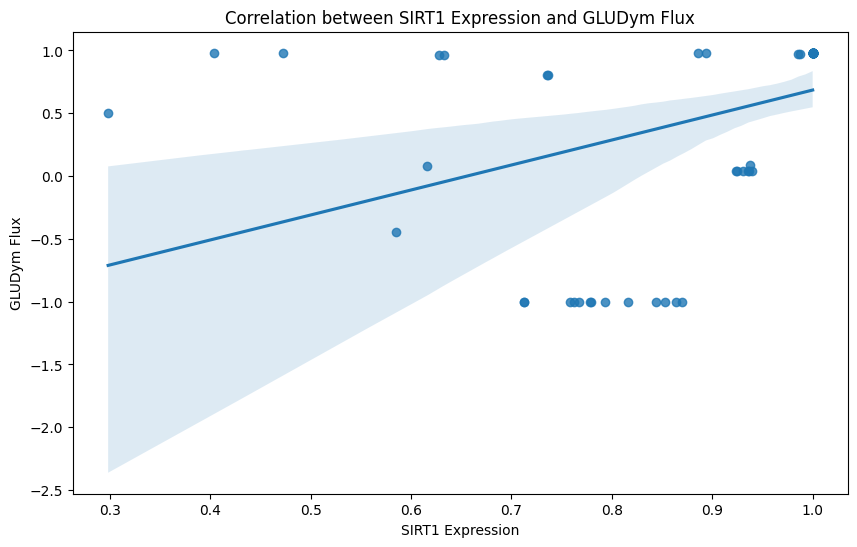

Linear regression results for SIRT1 and GLUDym:
Slope: 1.9897518642883503
Intercept: -1.3049222786237826
R-squared: 0.16367013045456774
P-value: 0.0004665541286483952
Standard error: 0.5414750680896346



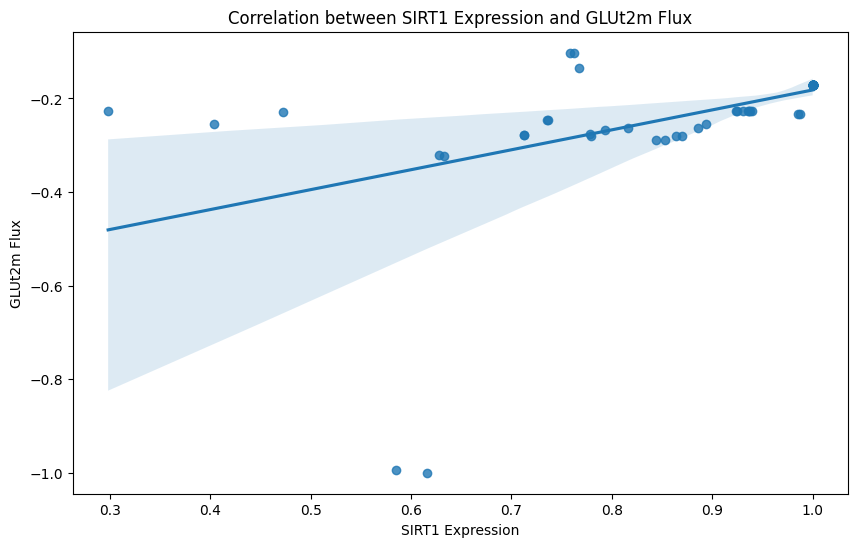

Linear regression results for SIRT1 and GLUt2m:
Slope: 0.4261886338786894
Intercept: -0.607954671273165
R-squared: 0.22876605629428715
P-value: 2.4575955750543423e-05
Standard error: 0.09420513861596767



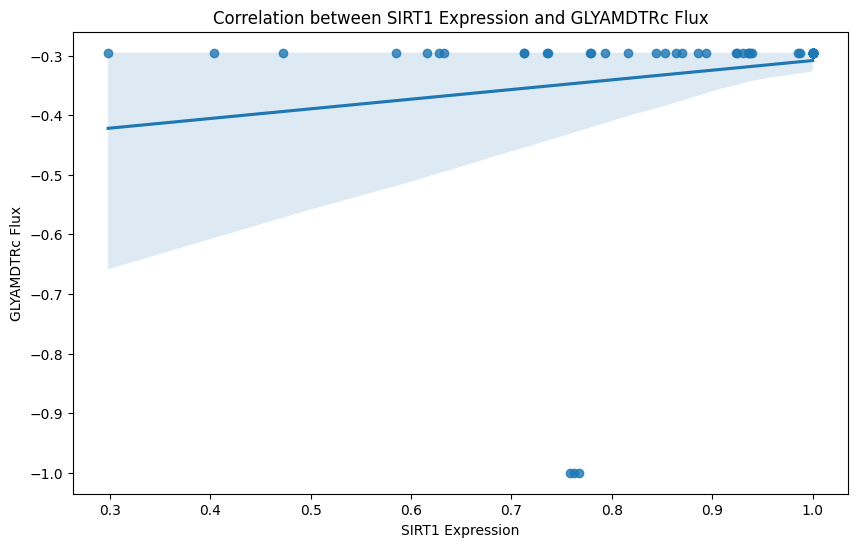

Linear regression results for SIRT1 and GLYAMDTRc:
Slope: 0.1620871286253687
Intercept: -0.47039287169445465
R-squared: 0.032311584473717035
P-value: 0.13361473388149736
Standard error: 0.10678558393460284



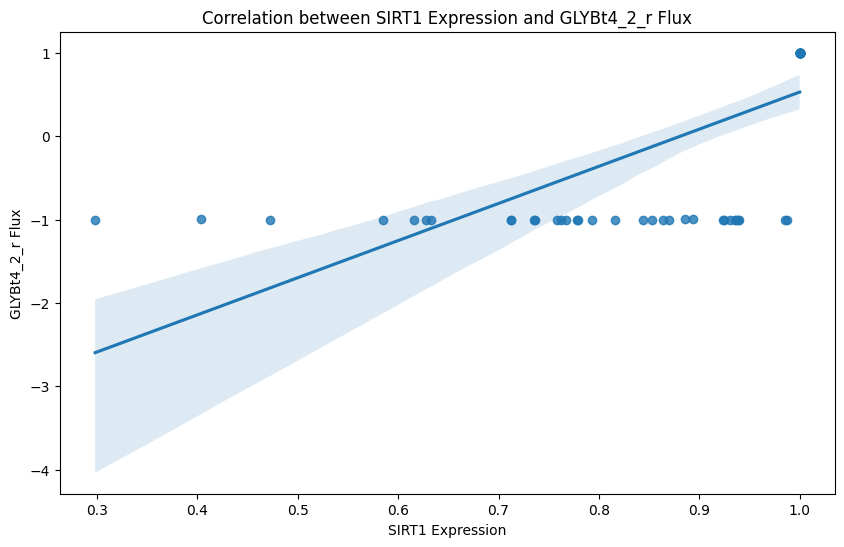

Linear regression results for SIRT1 and GLYBt4_2_r:
Slope: 4.452798415411912
Intercept: -3.92434756215458
R-squared: 0.4926946317463968
P-value: 9.127638760268333e-12
Standard error: 0.5439441406303789



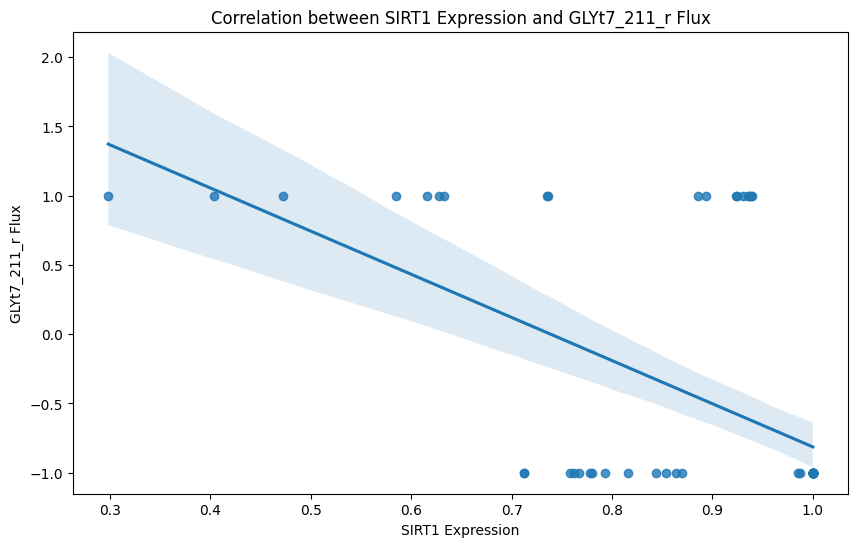

Linear regression results for SIRT1 and GLYt7_211_r:
Slope: -3.115129869225446
Intercept: 2.3017717231191774
R-squared: 0.3169359259713782
P-value: 3.2140019124915846e-07
Standard error: 0.5505497860423078



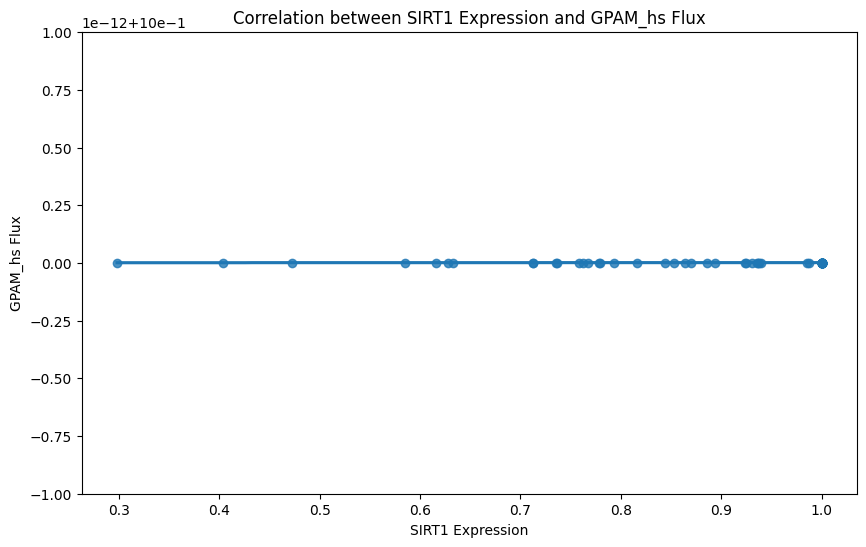

Linear regression results for SIRT1 and GPAM_hs:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



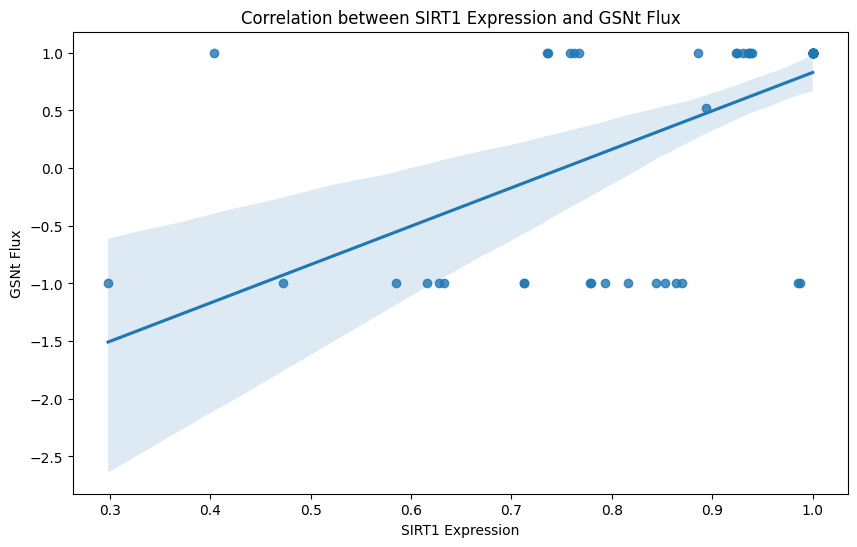

Linear regression results for SIRT1 and GSNt:
Slope: 3.330062894328778
Intercept: -2.501385144175777
R-squared: 0.3639383604885014
P-value: 2.5765201401319308e-08
Standard error: 0.5299849970807949



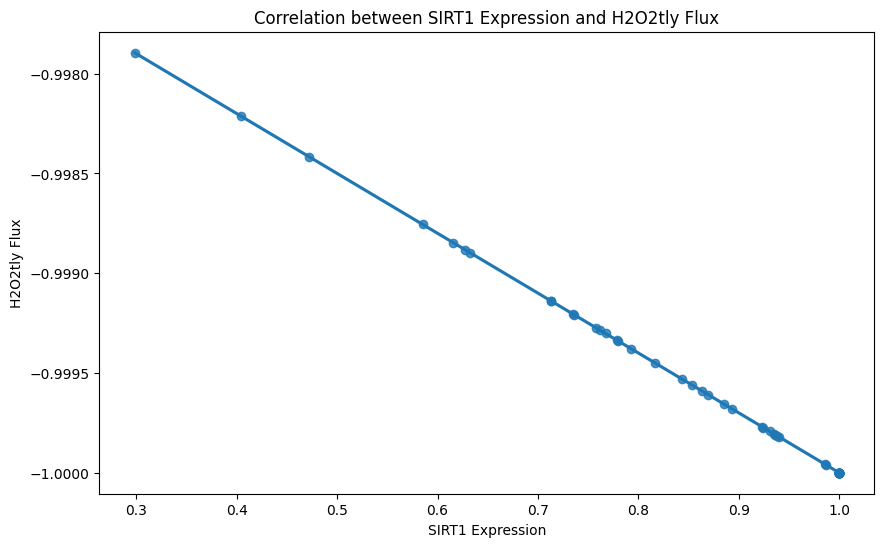

Linear regression results for SIRT1 and H2O2tly:
Slope: -0.003000000000000002
Intercept: -0.997
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



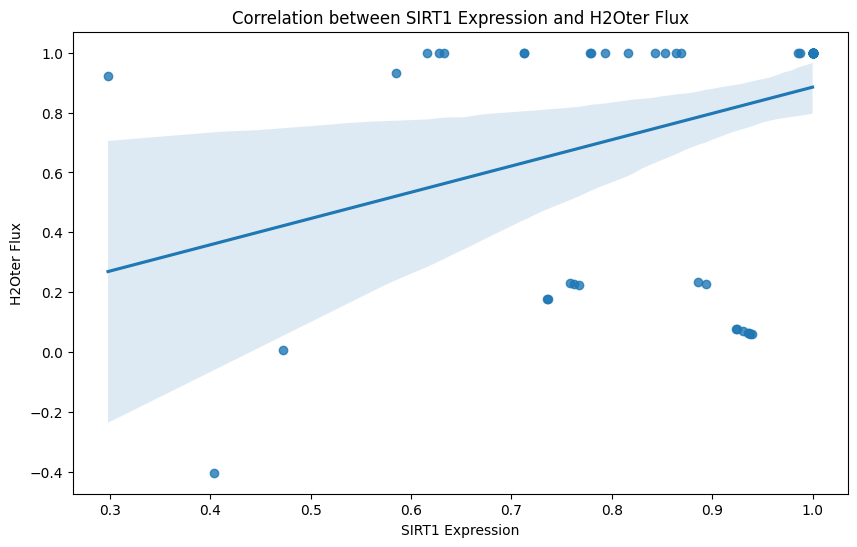

Linear regression results for SIRT1 and H2Oter:
Slope: 0.8778119259566373
Intercept: 0.007170166665677047
R-squared: 0.13012841982842183
P-value: 0.001998810821991498
Standard error: 0.2732237353867498



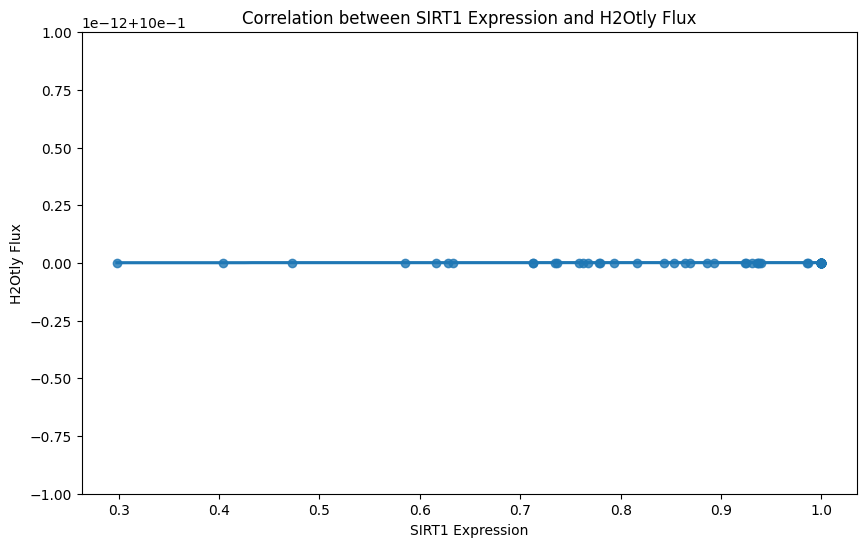

Linear regression results for SIRT1 and H2Otly:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



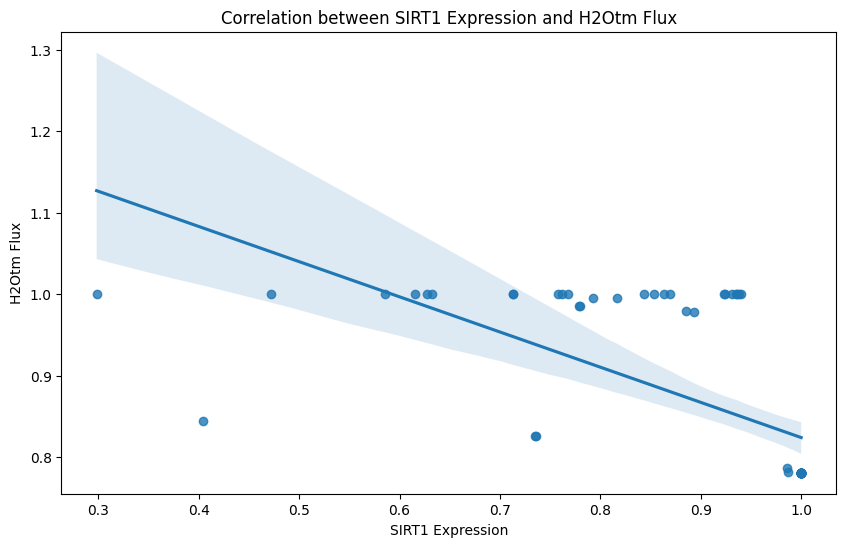

Linear regression results for SIRT1 and H2Otm:
Slope: -0.43158079407321986
Intercept: 1.255594812949476
R-squared: 0.42230421435503807
P-value: 8.68446111171962e-10
Standard error: 0.06076793189370566



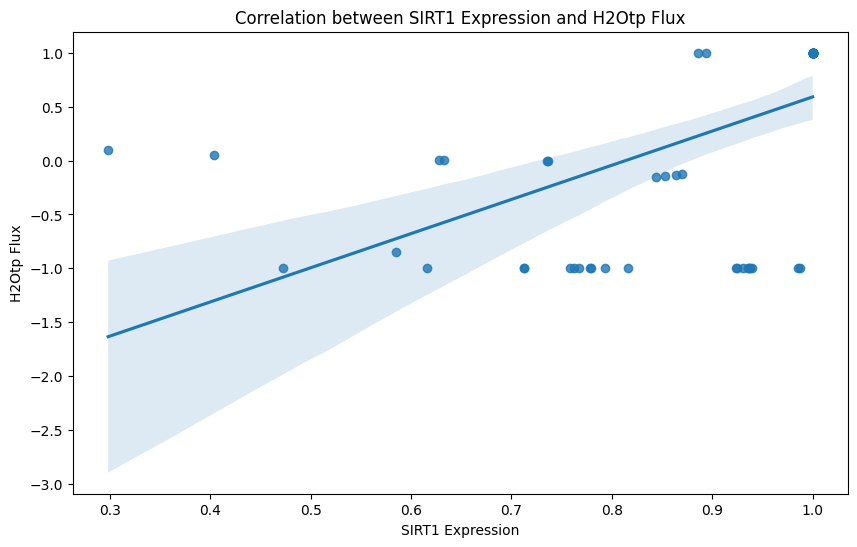

Linear regression results for SIRT1 and H2Otp:
Slope: 3.1699680189323507
Intercept: -2.5796887243308366
R-squared: 0.3159154491604626
P-value: 3.3889049994280696e-07
Standard error: 0.5615646924124909



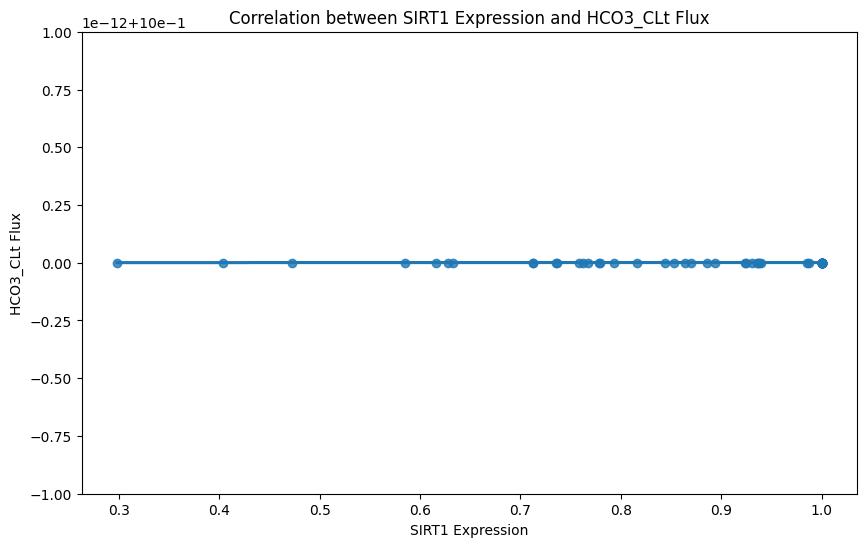

Linear regression results for SIRT1 and HCO3_CLt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



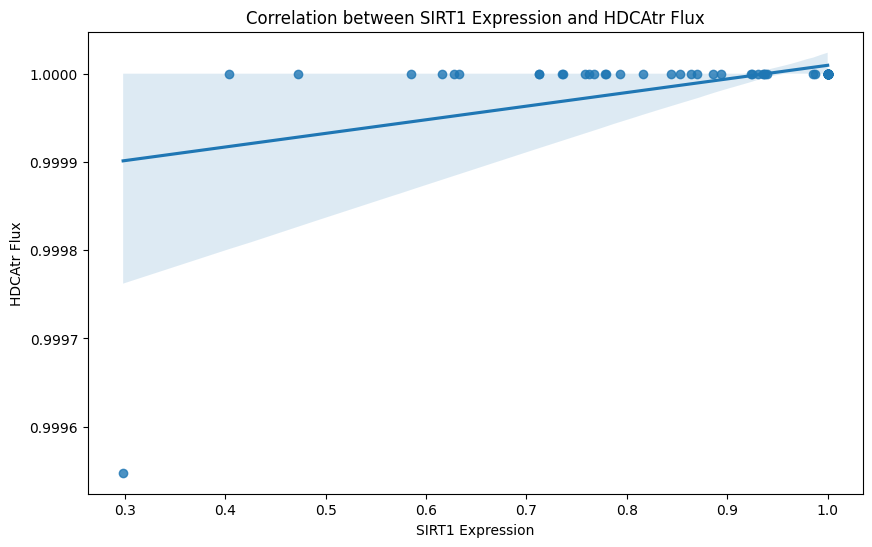

Linear regression results for SIRT1 and HDCAtr:
Slope: 0.0001542597987538526
Intercept: 0.9998552383343637
R-squared: 0.207261853969341
P-value: 6.63342755094393e-05
Standard error: 3.6318960014294494e-05



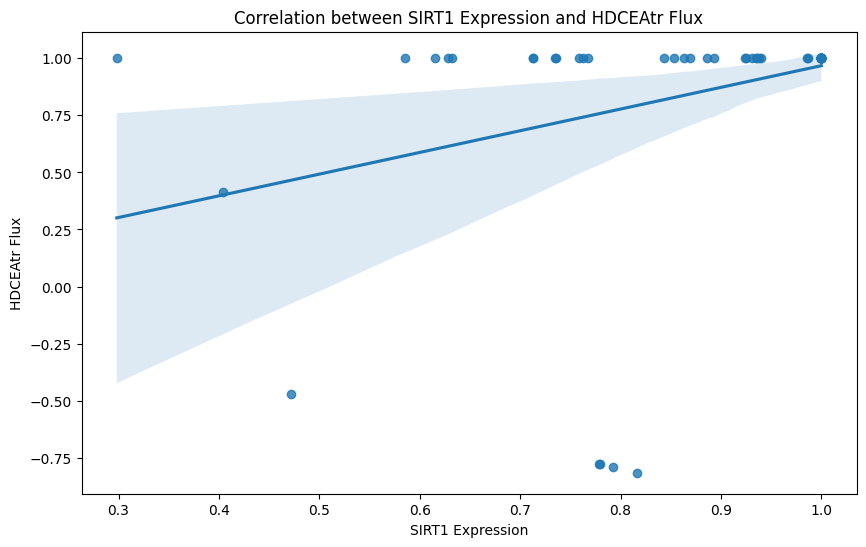

Linear regression results for SIRT1 and HDCEAtr:
Slope: 0.9506434840080749
Intercept: 0.01719778444128306
R-squared: 0.11207006441904209
P-value: 0.004323050668467651
Standard error: 0.32213481833531077



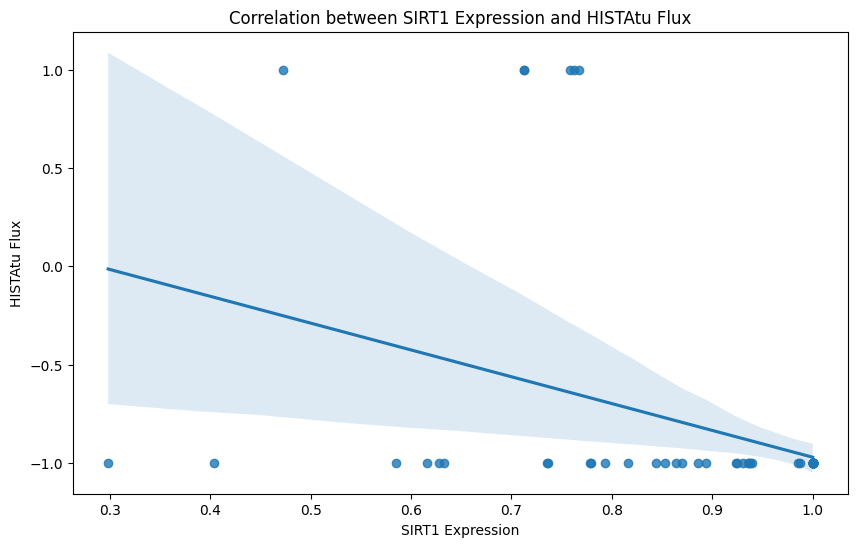

Linear regression results for SIRT1 and HISTAtu:
Slope: -1.3646098048704804
Intercept: 0.39326970025195807
R-squared: 0.14877155398911215
P-value: 0.0008940795082140351
Standard error: 0.3929588339807566



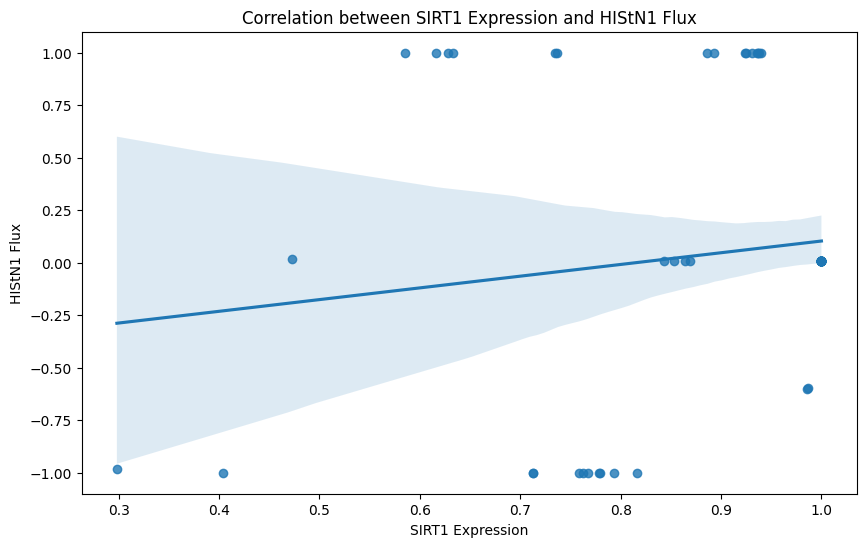

Linear regression results for SIRT1 and HIStN1:
Slope: 0.5579182920871667
Intercept: -0.45457817140333606
R-squared: 0.020594320627515914
P-value: 0.23250092513933066
Standard error: 0.4631840857150841



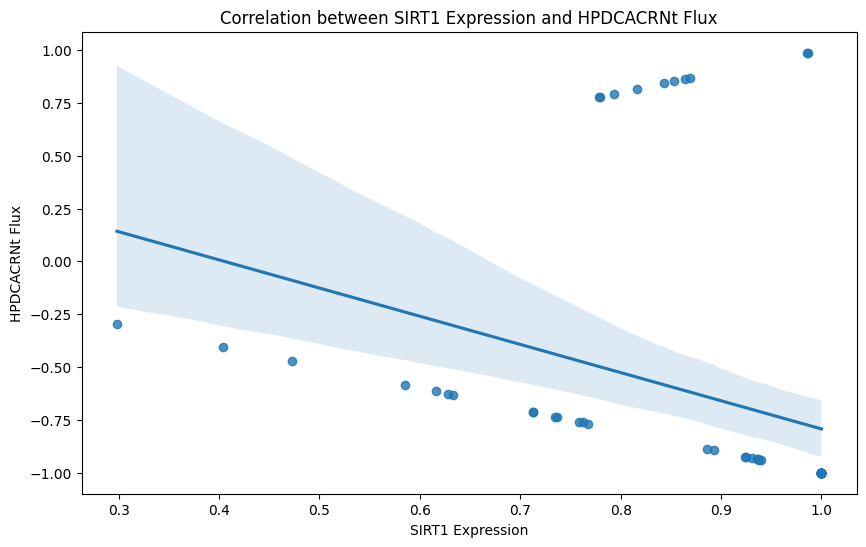

Linear regression results for SIRT1 and HPDCACRNt:
Slope: -1.3330950665425827
Intercept: 0.5402408692030255
R-squared: 0.10995325302341569
P-value: 0.004730357178105944
Standard error: 0.45660319188339504



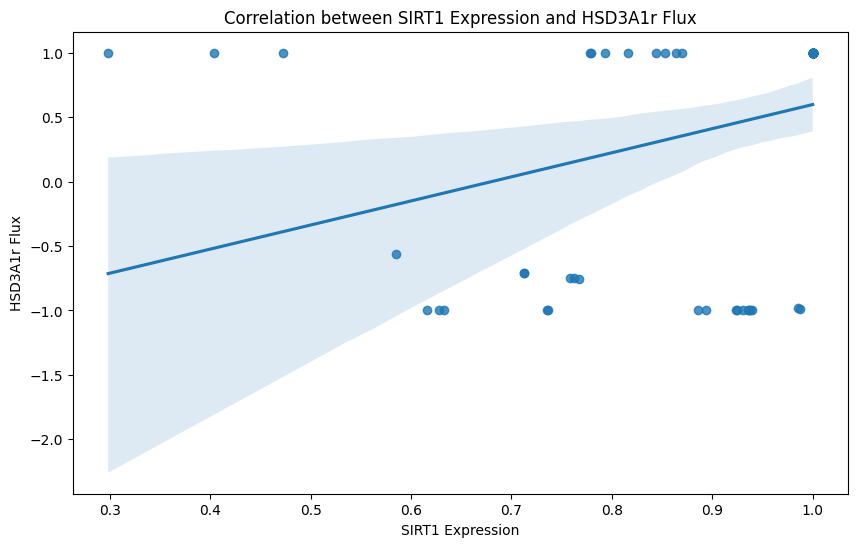

Linear regression results for SIRT1 and HSD3A1r:
Slope: 1.869394469675105
Intercept: -1.2716130381990405
R-squared: 0.10898218334243852
P-value: 0.004929728509326403
Standard error: 0.6434900709870754



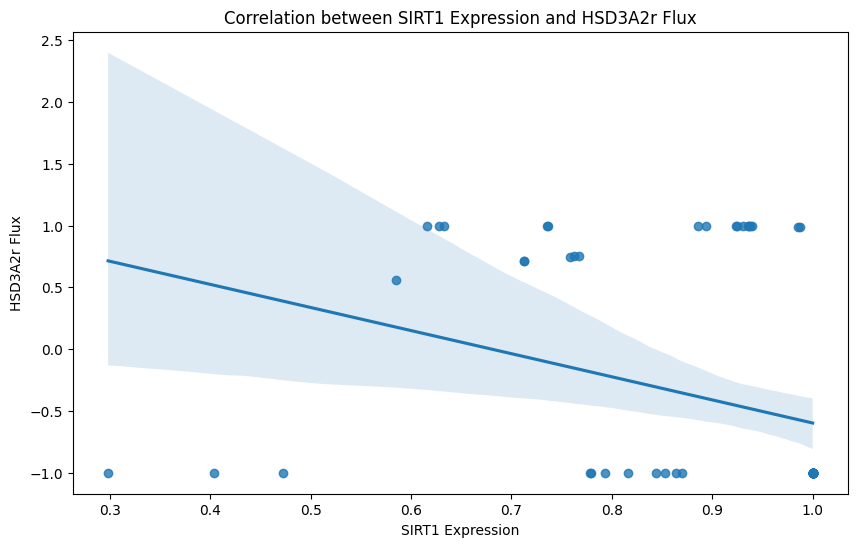

Linear regression results for SIRT1 and HSD3A2r:
Slope: -1.869394469675105
Intercept: 1.2716130381990405
R-squared: 0.10898218334243852
P-value: 0.004929728509326403
Standard error: 0.6434900709870754



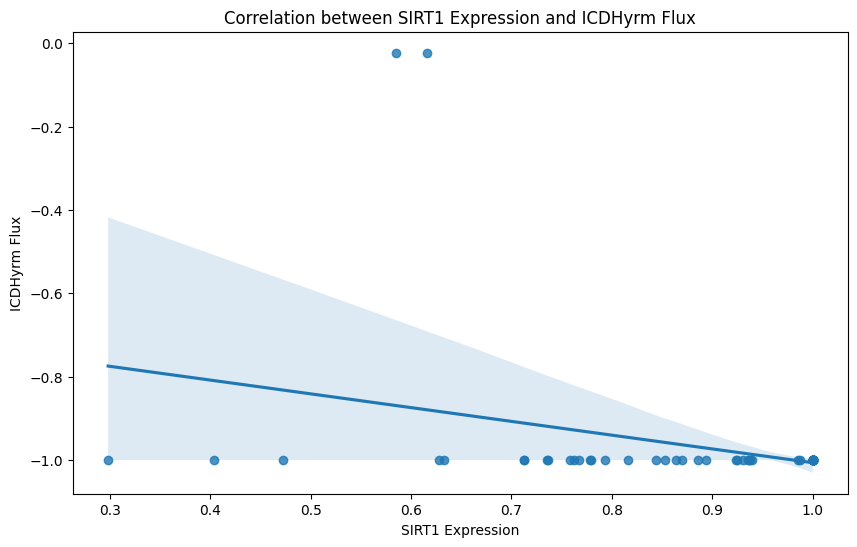

Linear regression results for SIRT1 and ICDHyrm:
Slope: -0.33035604414913183
Intercept: -0.6760941210593748
R-squared: 0.10320692467296574
P-value: 0.006300071718000968
Standard error: 0.11723287510693417



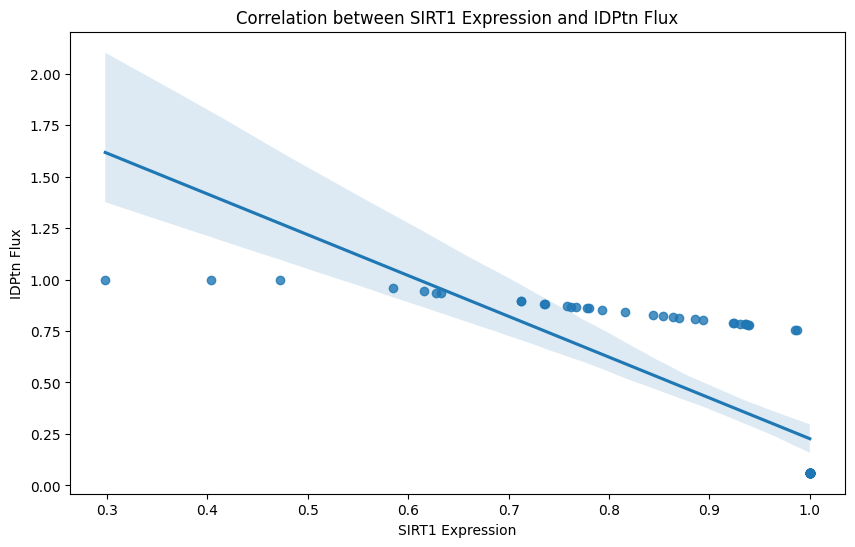

Linear regression results for SIRT1 and IDPtn:
Slope: -1.9811771360470487
Intercept: 2.2081737831905124
R-squared: 0.6098461109034041
P-value: 9.597109548782793e-16
Standard error: 0.19076847274713246



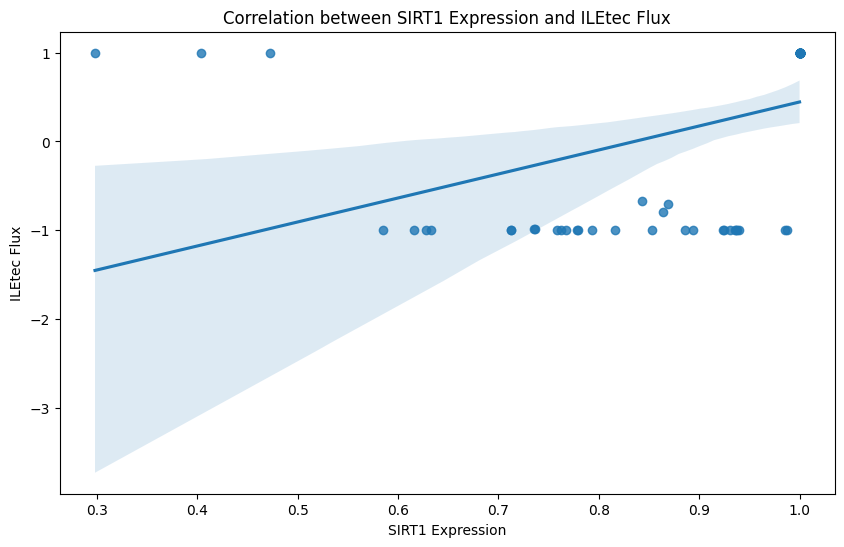

Linear regression results for SIRT1 and ILEtec:
Slope: 2.7039737432306556
Intercept: -2.2588249446475395
R-squared: 0.1900162775171909
P-value: 0.00014484974654762332
Standard error: 0.6720795291959887



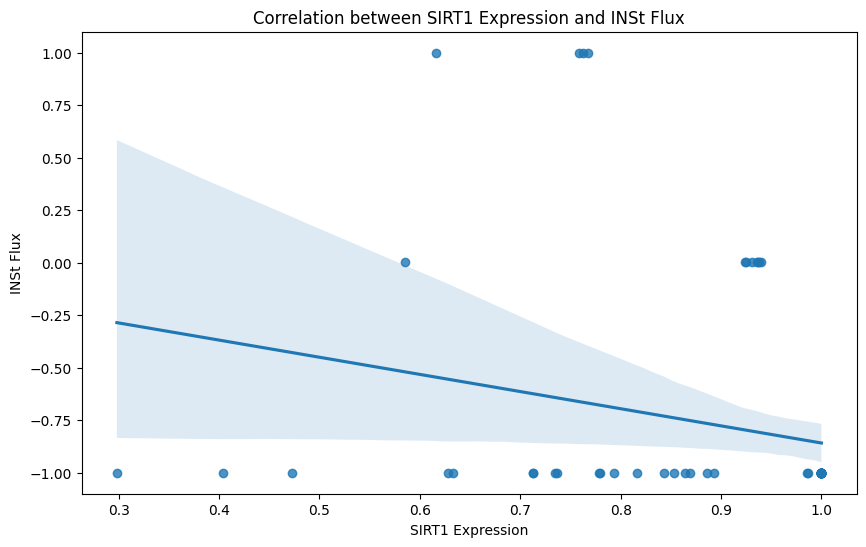

Linear regression results for SIRT1 and INSt:
Slope: -0.8168048227731686
Intercept: -0.04170151616591289
R-squared: 0.057377090124304836
P-value: 0.0442277176063968
Standard error: 0.39855979220343846



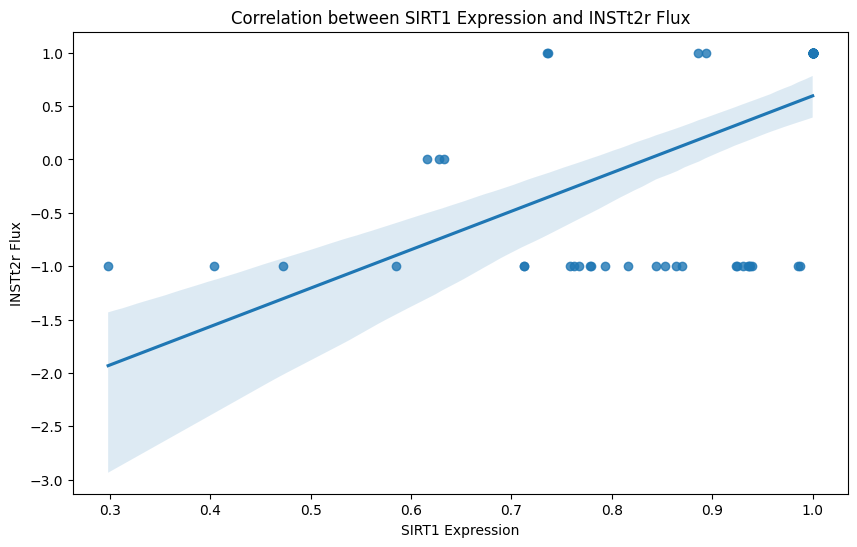

Linear regression results for SIRT1 and INSTt2r:
Slope: 3.6029082153451713
Intercept: -3.006955978392204
R-squared: 0.35386223587826804
P-value: 4.489477933702204e-08
Standard error: 0.5861032192406501



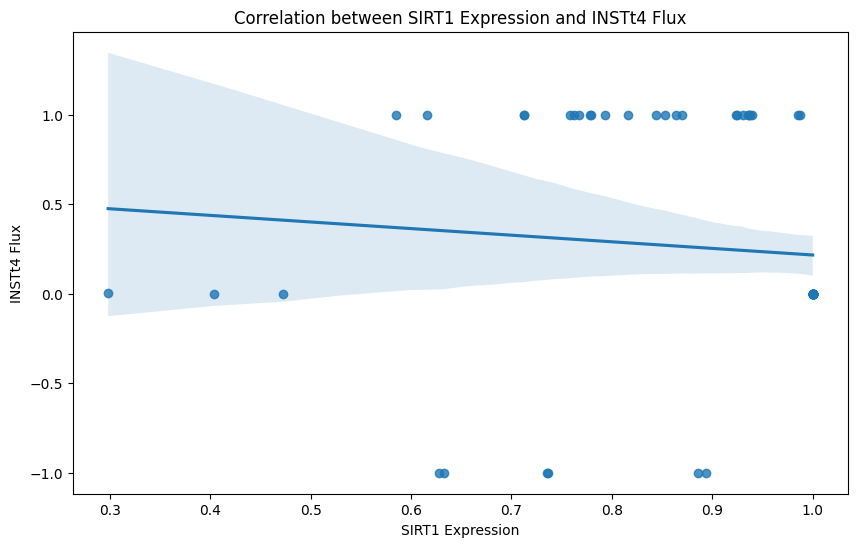

Linear regression results for SIRT1 and INSTt4:
Slope: -0.36871569239557933
Intercept: 0.5844113016634553
R-squared: 0.00938324883862938
P-value: 0.42161542783112693
Standard error: 0.45608237857280876



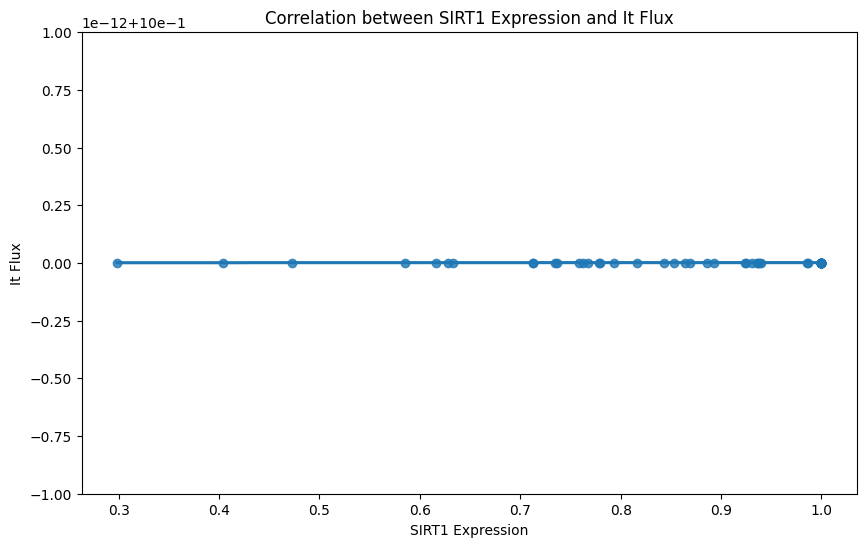

Linear regression results for SIRT1 and It:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



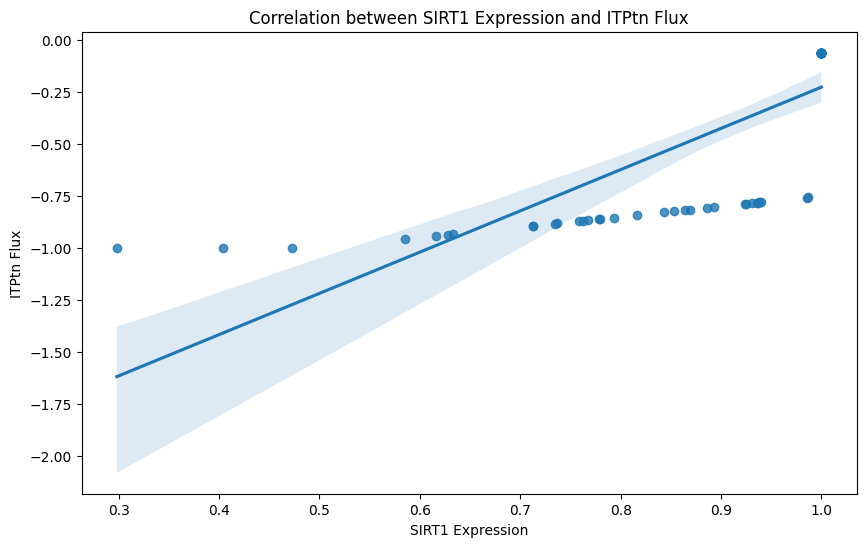

Linear regression results for SIRT1 and ITPtn:
Slope: 1.9811771360470487
Intercept: -2.2081737831905124
R-squared: 0.6098461109034041
P-value: 9.597109548782793e-16
Standard error: 0.19076847274713246



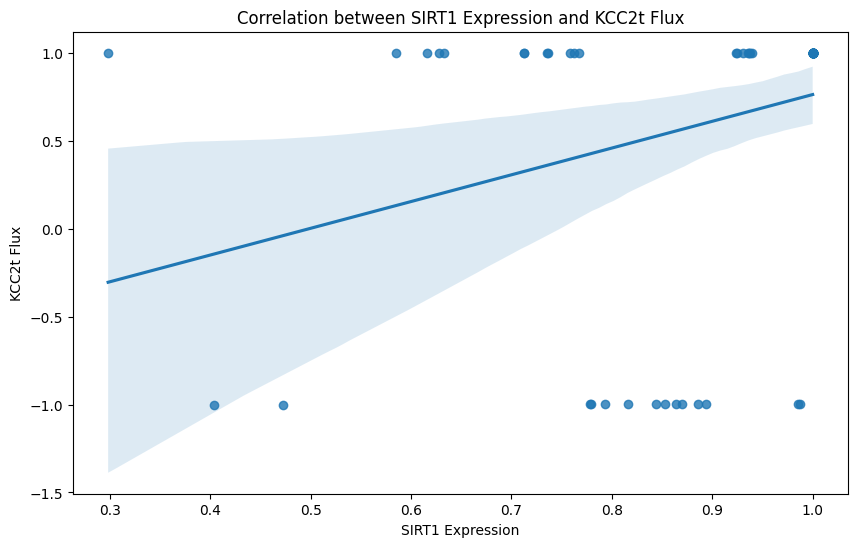

Linear regression results for SIRT1 and KCC2t:
Slope: 1.5204830011989139
Intercept: -0.7582534625191649
R-squared: 0.09036273117195695
P-value: 0.01085966695517644
Standard error: 0.5807596999097573



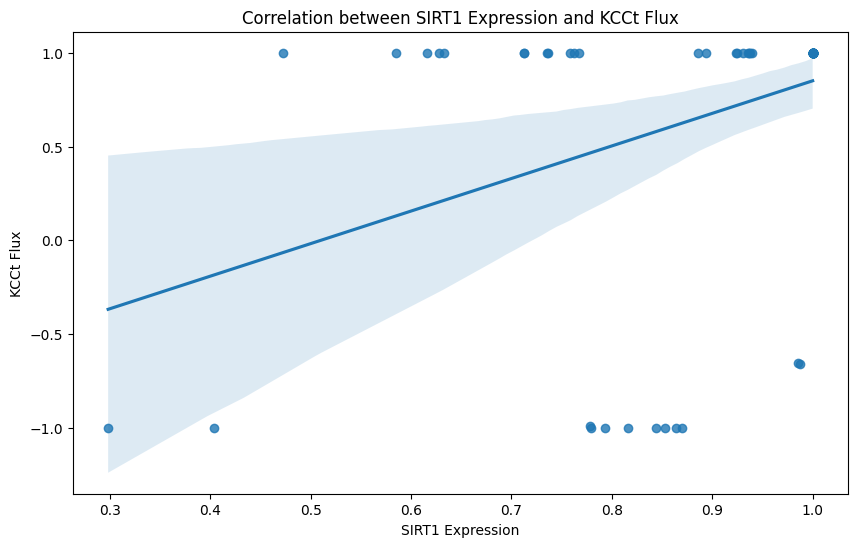

Linear regression results for SIRT1 and KCCt:
Slope: 1.7359048979981628
Intercept: -0.885517274068727
R-squared: 0.13997828212967892
P-value: 0.0013082420882405564
Standard error: 0.5179952326453467



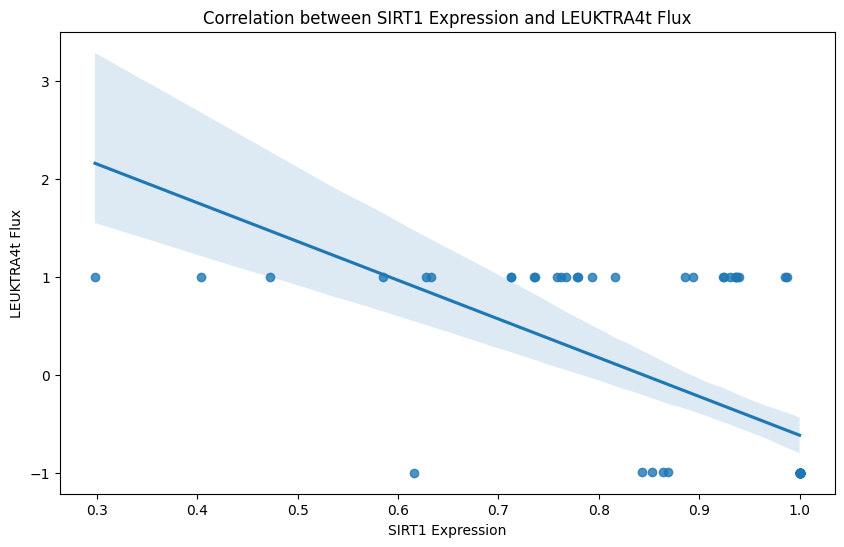

Linear regression results for SIRT1 and LEUKTRA4t:
Slope: -3.9525656014176116
Intercept: 3.33532022791815
R-squared: 0.40466469701863667
P-value: 2.5008313777511998e-09
Standard error: 0.5771486718951473



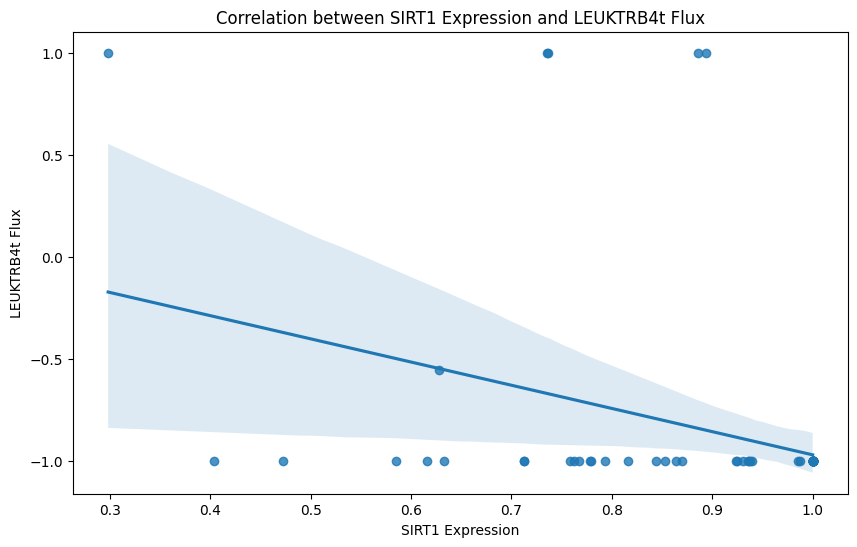

Linear regression results for SIRT1 and LEUKTRB4t:
Slope: -1.136345008449272
Intercept: 0.16661455368884104
R-squared: 0.12145395129196479
P-value: 0.002897695449929255
Standard error: 0.3679273766813851



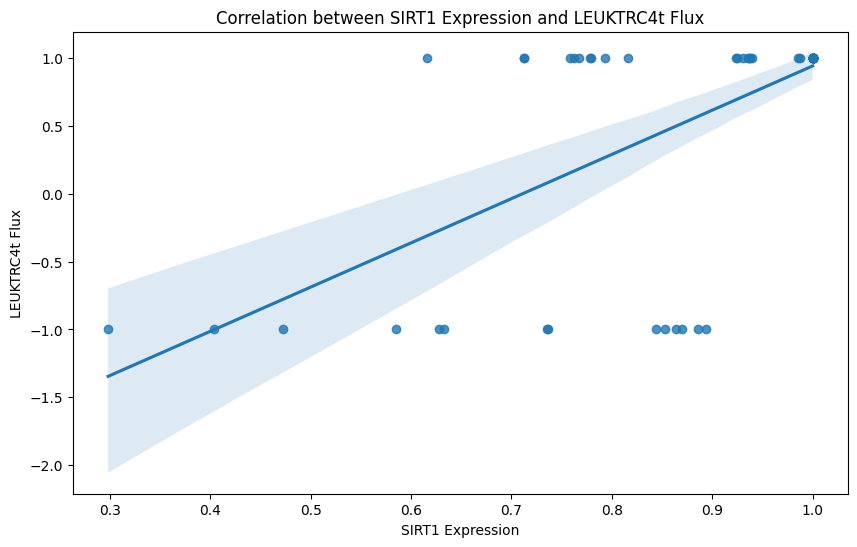

Linear regression results for SIRT1 and LEUKTRC4t:
Slope: 3.258257427407164
Intercept: -2.317502128647702
R-squared: 0.4145103969165786
P-value: 1.391002429631156e-09
Standard error: 0.4661790238991359



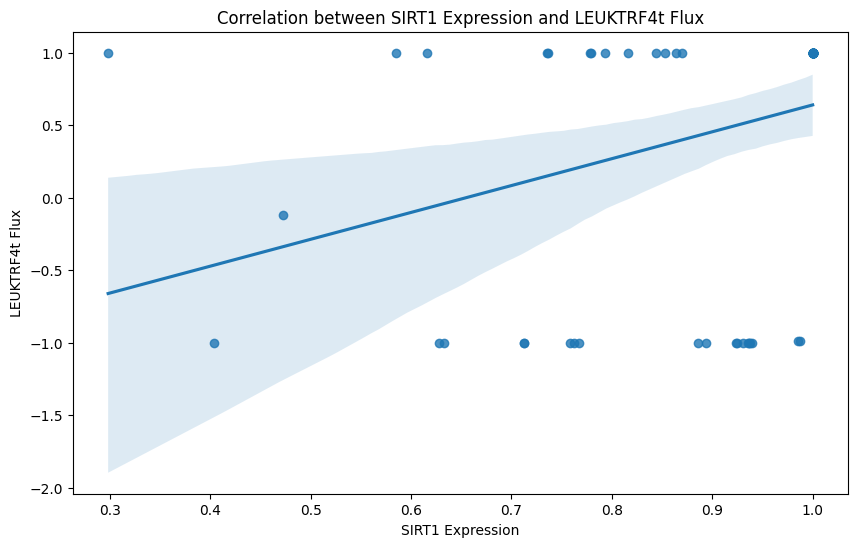

Linear regression results for SIRT1 and LEUKTRF4t:
Slope: 1.853998993064931
Intercept: -1.214095807233862
R-squared: 0.10841381314961064
P-value: 0.005050266959656923
Standard error: 0.6400653310464632



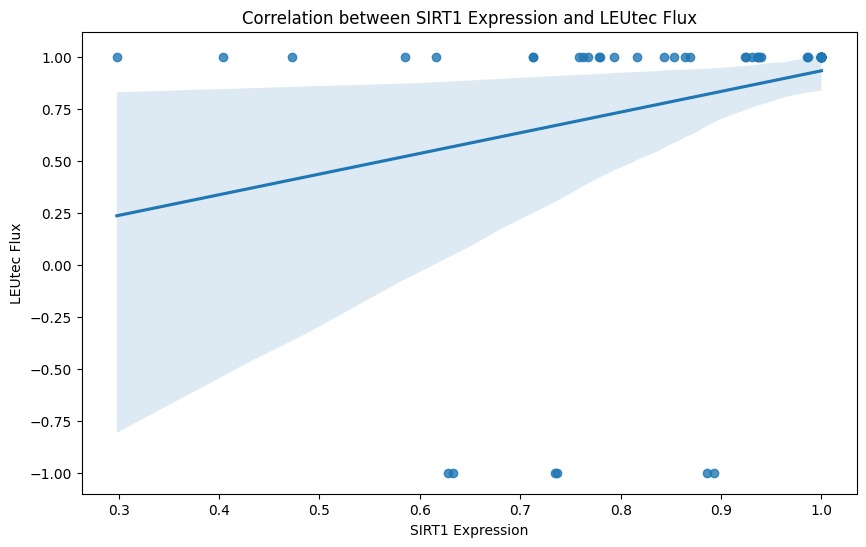

Linear regression results for SIRT1 and LEUtec:
Slope: 0.9936912854711644
Intercept: -0.06050125704008891
R-squared: 0.07888708107642498
P-value: 0.01766311220188653
Standard error: 0.4087713309200788



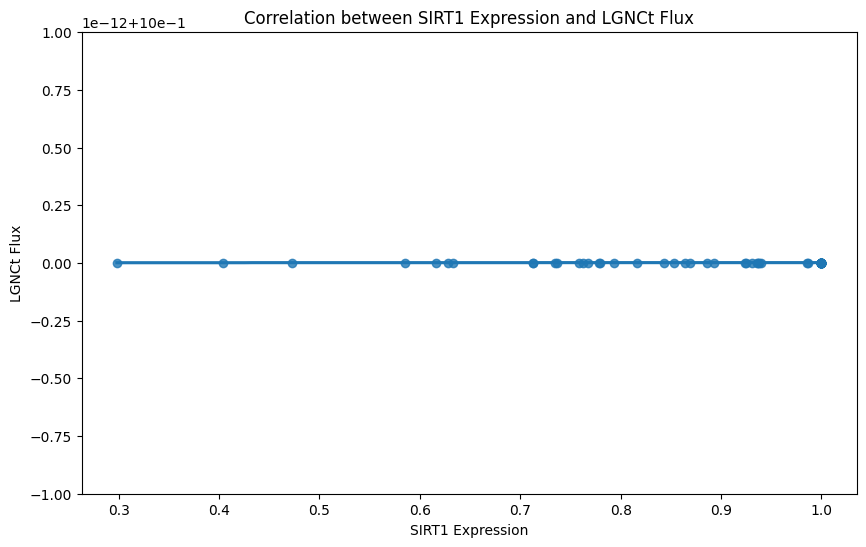

Linear regression results for SIRT1 and LGNCt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



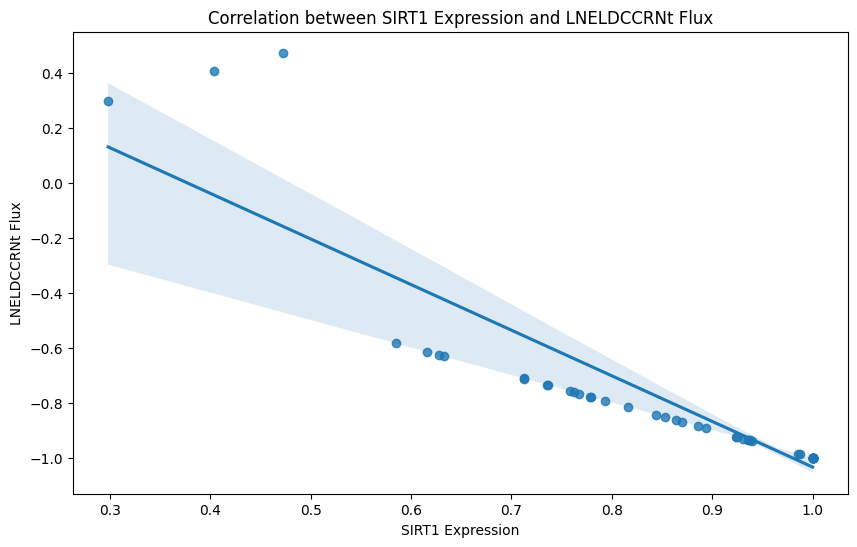

Linear regression results for SIRT1 and LNELDCCRNt:
Slope: -1.6591274860676999
Intercept: 0.6244160957538494
R-squared: 0.8200808805760015
P-value: 2.1030472605115374e-27
Standard error: 0.09355468219302412



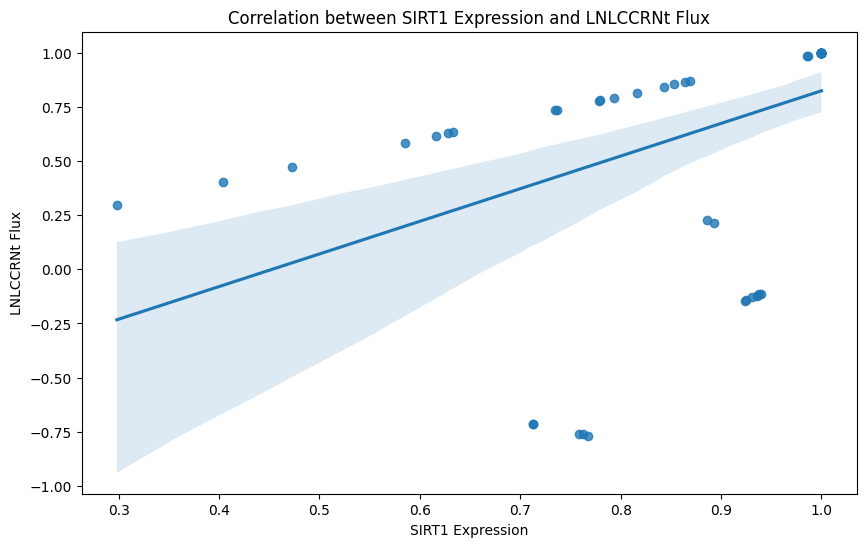

Linear regression results for SIRT1 and LNLCCRNt:
Slope: 1.5062725870794287
Intercept: -0.6820447518181526
R-squared: 0.20284337739322925
P-value: 8.112959130552392e-05
Standard error: 0.35947644630172454



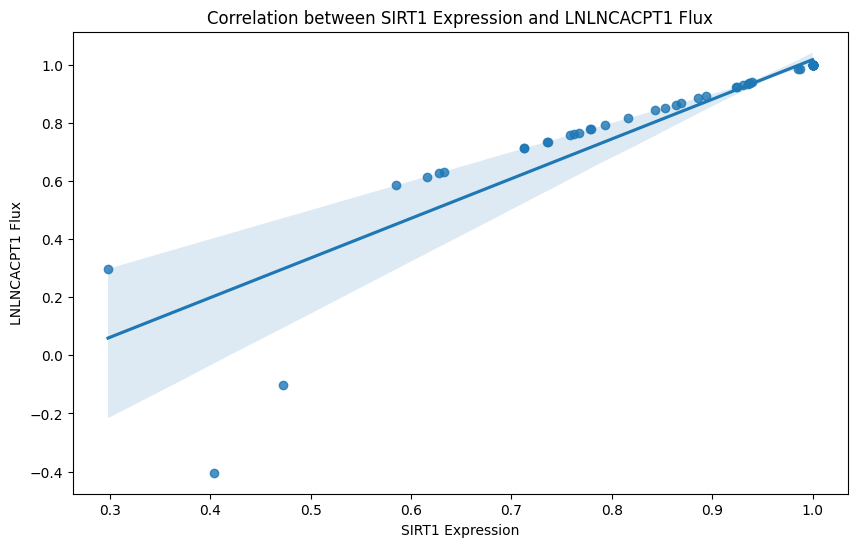

Linear regression results for SIRT1 and LNLNCACPT1:
Slope: 1.365956147931103
Intercept: -0.34778090068274914
R-squared: 0.8197211569474214
P-value: 2.253553879198373e-27
Standard error: 0.07711724761028513



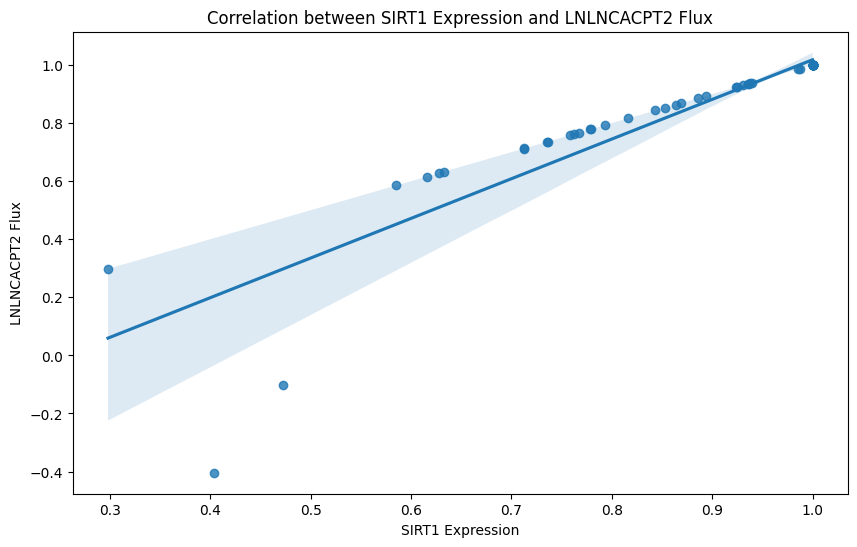

Linear regression results for SIRT1 and LNLNCACPT2:
Slope: 1.365956147931103
Intercept: -0.34778090068274914
R-squared: 0.8197211569474214
P-value: 2.253553879198373e-27
Standard error: 0.07711724761028513



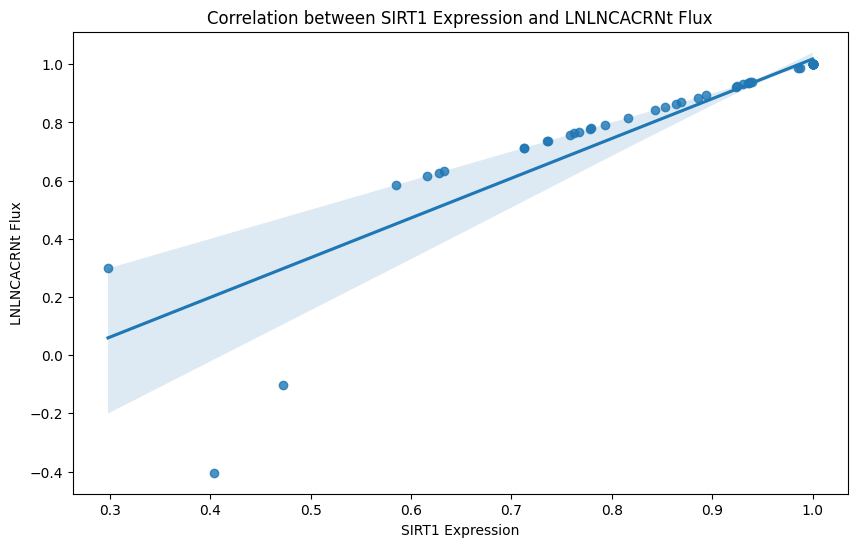

Linear regression results for SIRT1 and LNLNCACRNt:
Slope: 1.365956147931103
Intercept: -0.34778090068274914
R-squared: 0.8197211569474214
P-value: 2.253553879198373e-27
Standard error: 0.07711724761028513



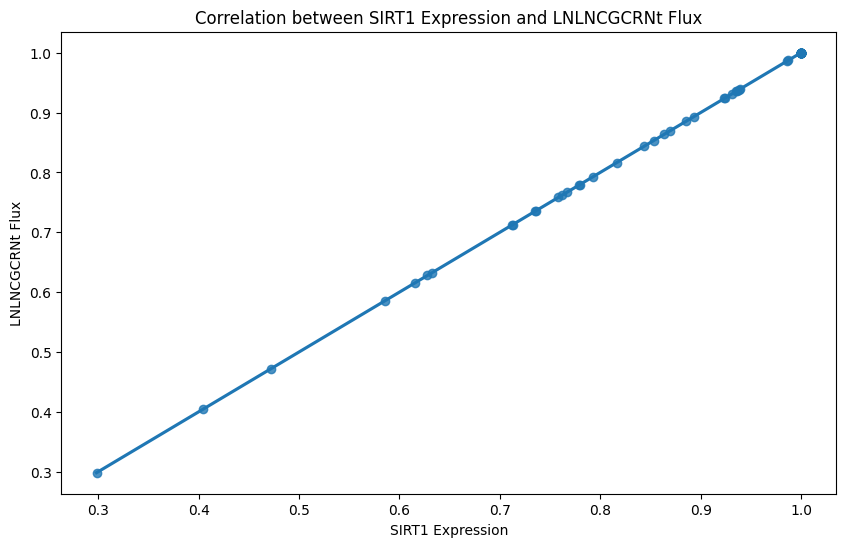

Linear regression results for SIRT1 and LNLNCGCRNt:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



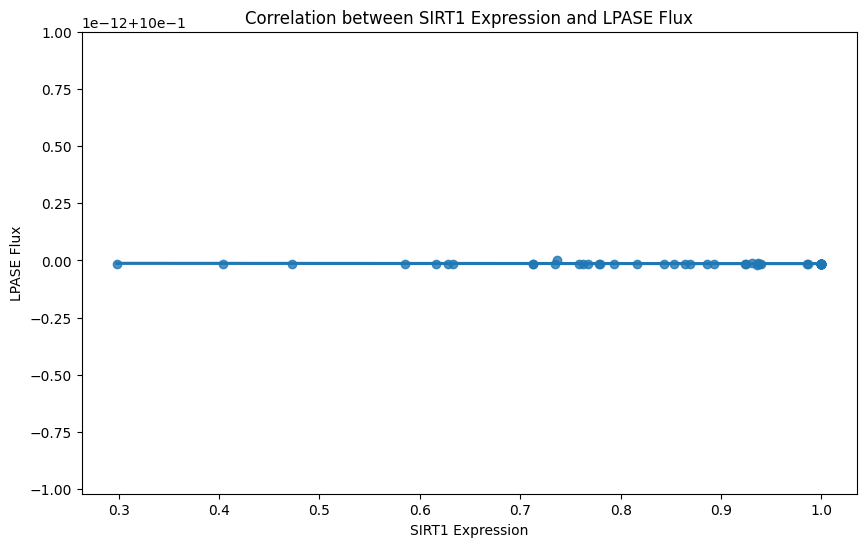

Linear regression results for SIRT1 and LPASE:
Slope: -1.3820751608547186e-15
Intercept: 0.9999999999999872
R-squared: 0.013547836862836107
P-value: 0.3337213629427722
Standard error: 1.4197443593778813e-15



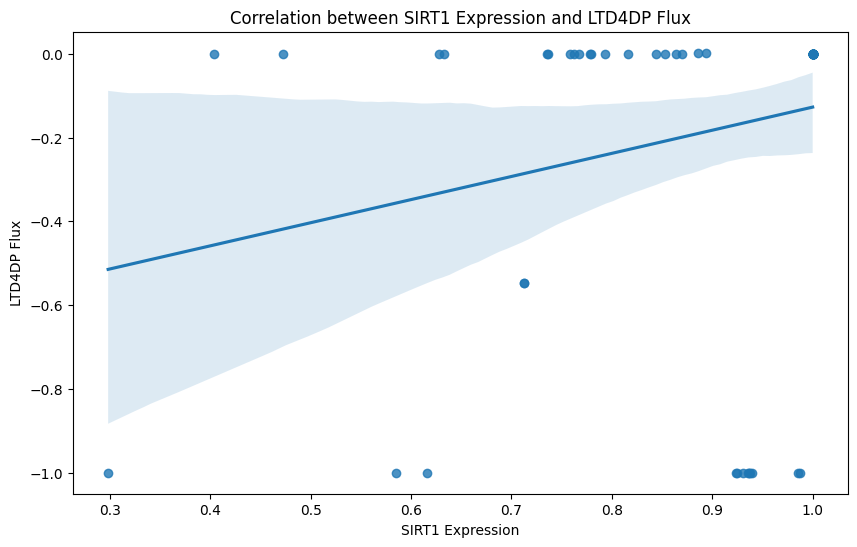

Linear regression results for SIRT1 and LTD4DP:
Slope: 0.5519388586208823
Intercept: -0.6792272055804405
R-squared: 0.05251515232961143
P-value: 0.05456248417818208
Standard error: 0.28223459578804866



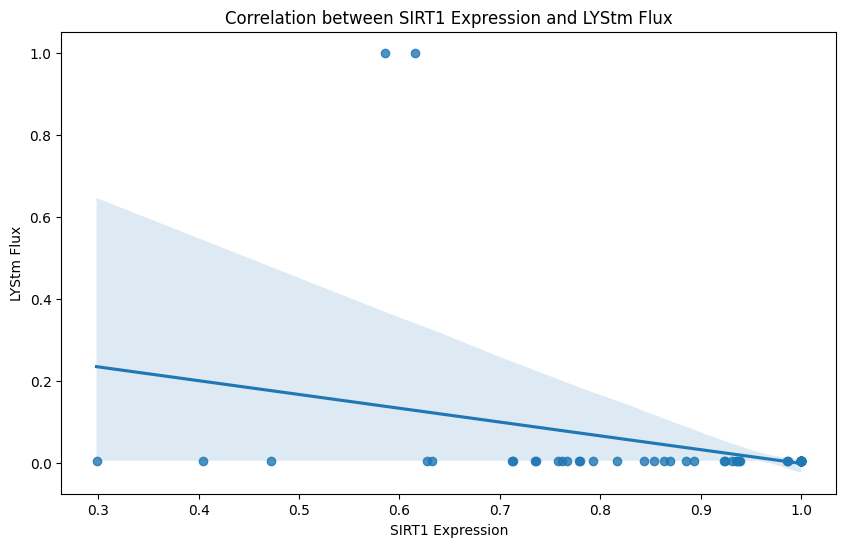

Linear regression results for SIRT1 and LYStm:
Slope: -0.33594729415107005
Intercept: 0.3356055978022284
R-squared: 0.10320675955939367
P-value: 0.006300115862973315
Standard error: 0.11921713861396678



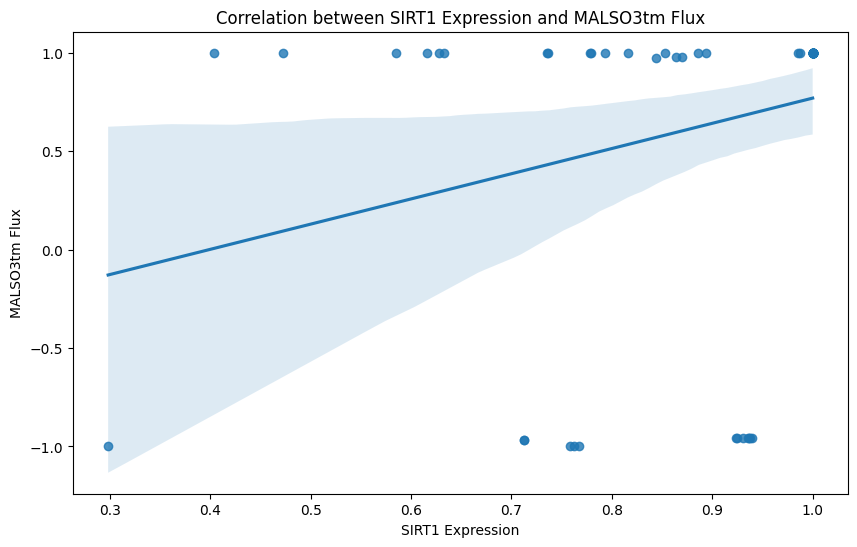

Linear regression results for SIRT1 and MALSO3tm:
Slope: 1.2802843776526087
Intercept: -0.5108140830067914
R-squared: 0.06970726488792839
P-value: 0.026092426485723658
Standard error: 0.5630574306418564



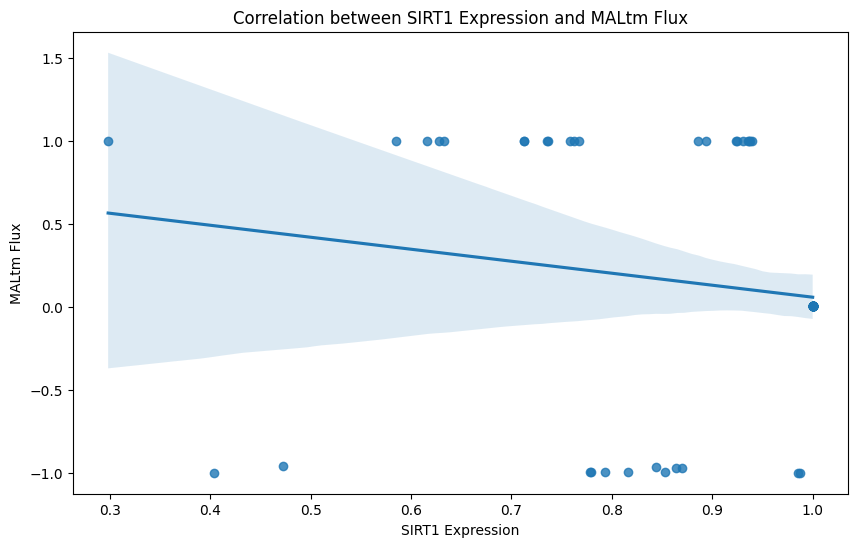

Linear regression results for SIRT1 and MALtm:
Slope: -0.7228085618180796
Intercept: 0.7807899188739025
R-squared: 0.029173366916205763
P-value: 0.1544038419759914
Standard error: 0.5019683173942059



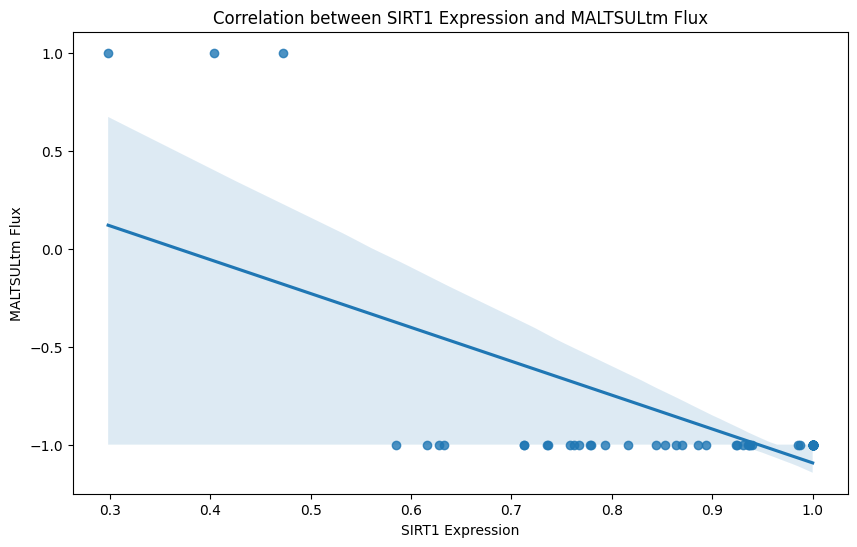

Linear regression results for SIRT1 and MALTSULtm:
Slope: -1.7284493326840358
Intercept: 0.6351802050261025
R-squared: 0.4563002122297234
P-value: 1.0332236442853775e-10
Standard error: 0.2271361992234



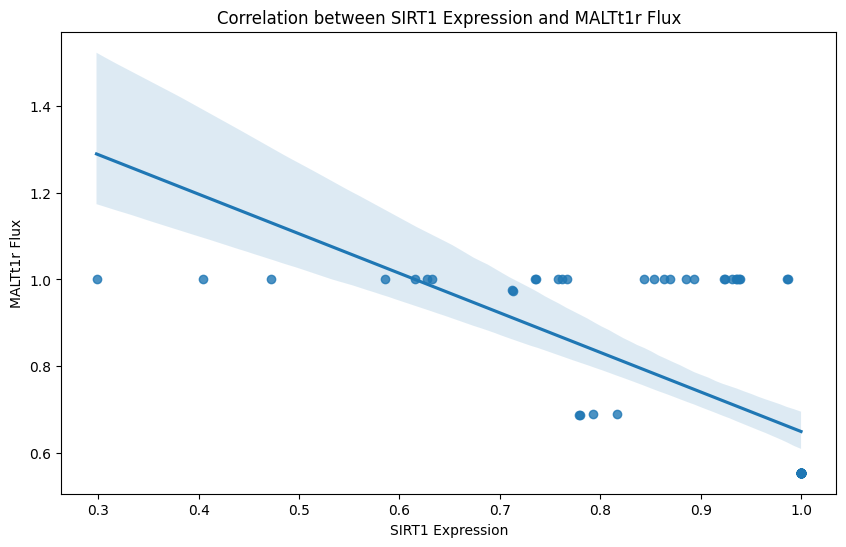

Linear regression results for SIRT1 and MALTt1r:
Slope: -0.9140322673321571
Intercept: 1.5626253725072594
R-squared: 0.44850537504066046
P-value: 1.7021712245047777e-10
Standard error: 0.12201797076243447



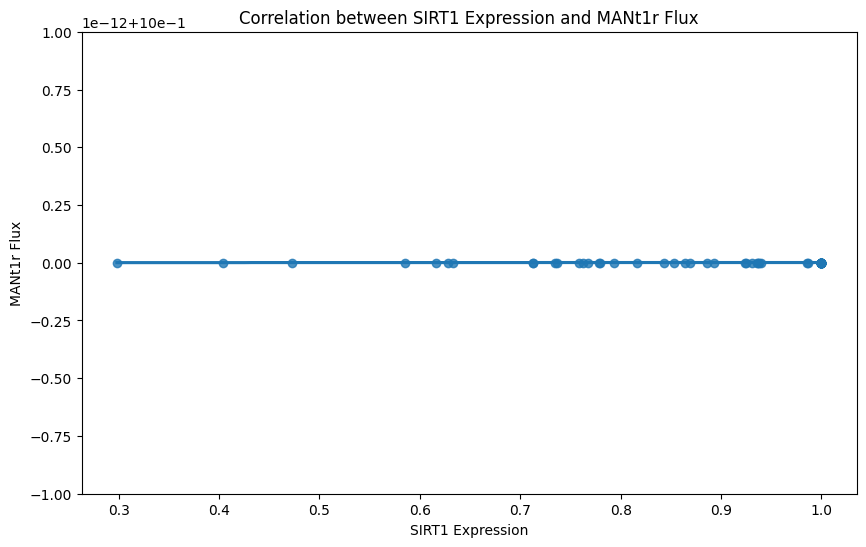

Linear regression results for SIRT1 and MANt1r:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



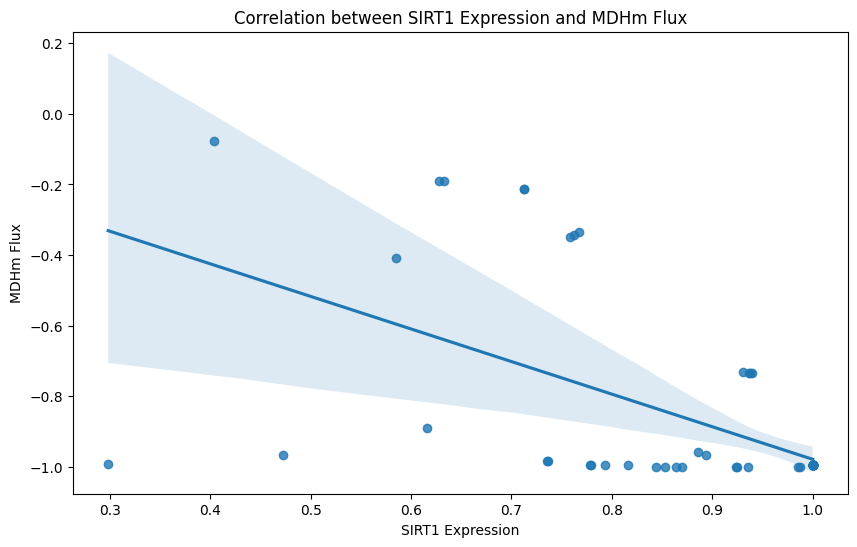

Linear regression results for SIRT1 and MDHm:
Slope: -0.9228945998876508
Intercept: -0.05564425435506204
R-squared: 0.3404606423354346
P-value: 9.280279444888638e-08
Standard error: 0.1546373721462121



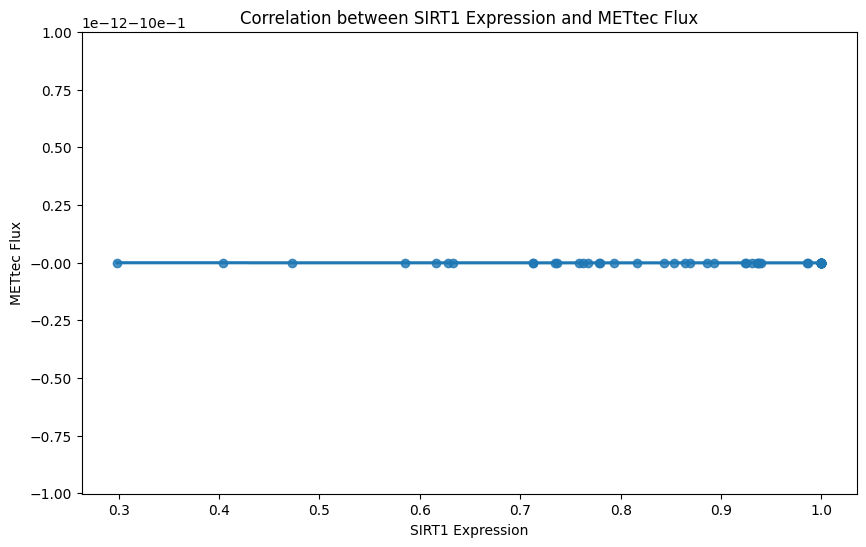

Linear regression results for SIRT1 and METtec:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



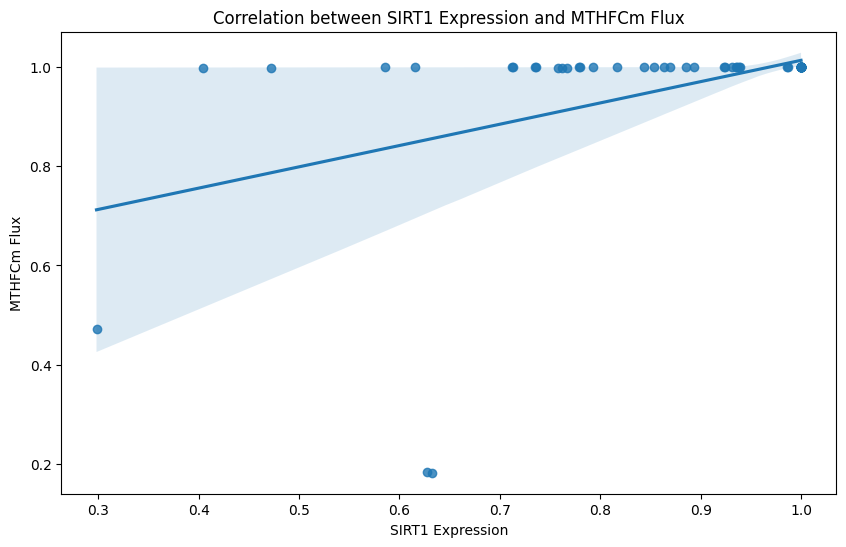

Linear regression results for SIRT1 and MTHFCm:
Slope: 0.4295614765058998
Intercept: 0.5840224074462554
R-squared: 0.20901636373556304
P-value: 6.122232029766571e-05
Standard error: 0.10059916745841428



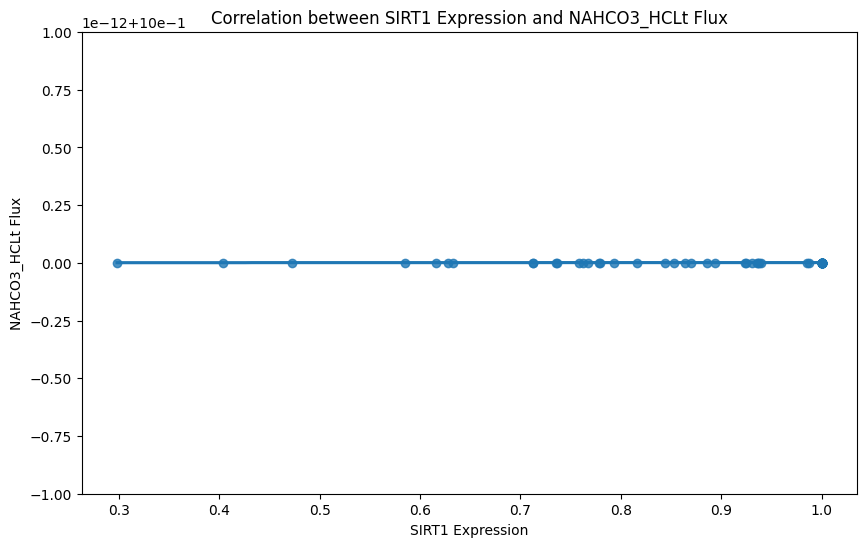

Linear regression results for SIRT1 and NAHCO3_HCLt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



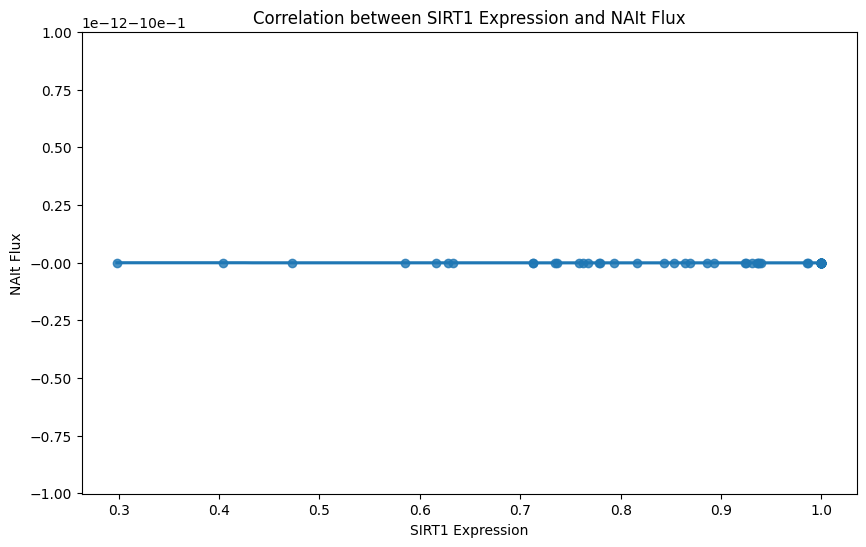

Linear regression results for SIRT1 and NAIt:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



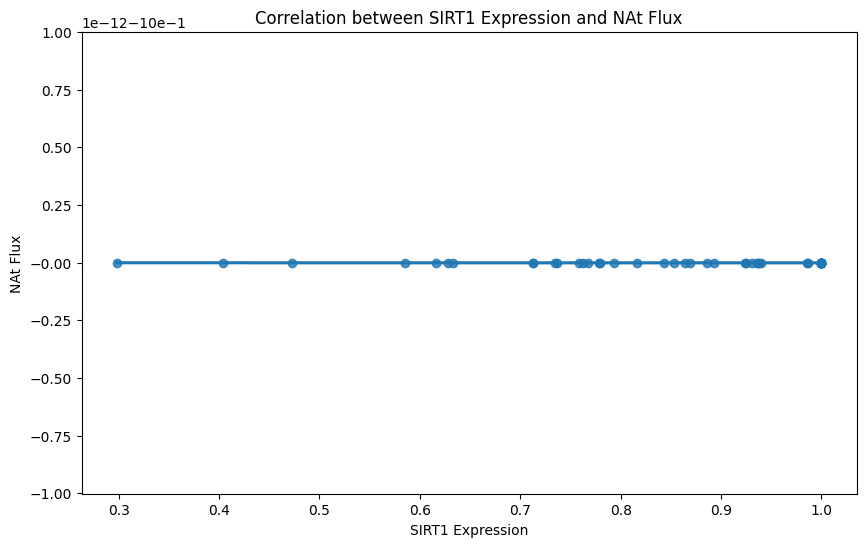

Linear regression results for SIRT1 and NAt:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



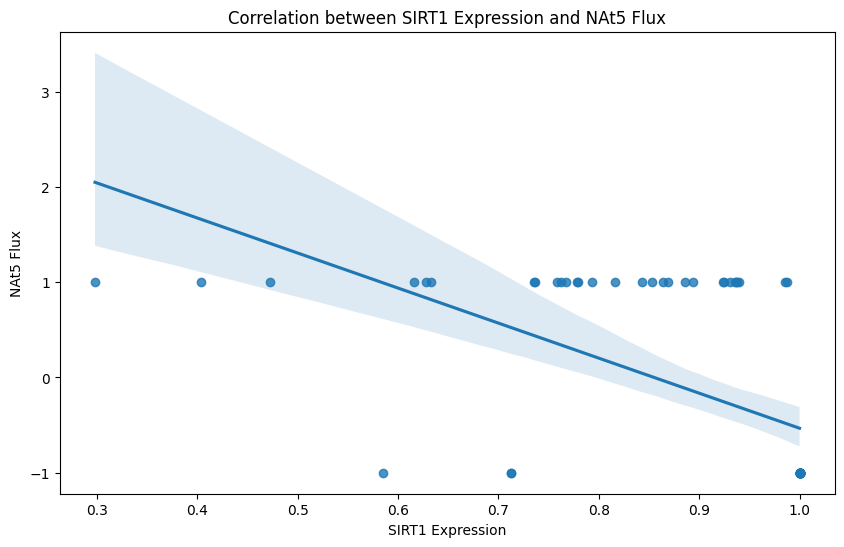

Linear regression results for SIRT1 and NAt5:
Slope: -3.6774191783512395
Intercept: 3.1442840093058217
R-squared: 0.3425860664789149
P-value: 8.278396257564693e-08
Standard error: 0.6132720834369539



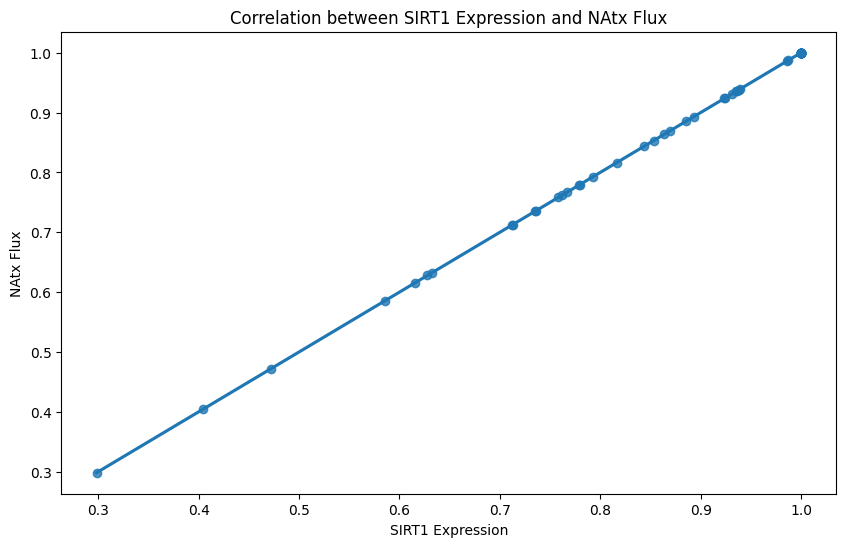

Linear regression results for SIRT1 and NAtx:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



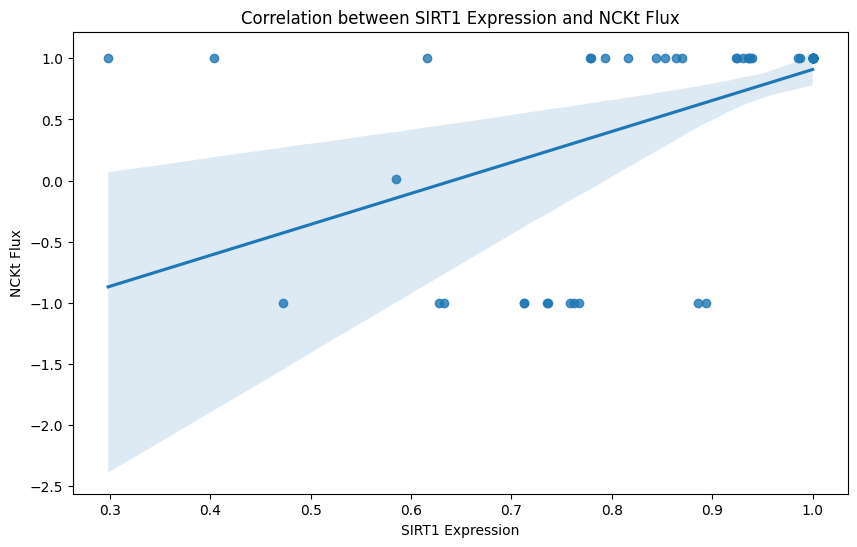

Linear regression results for SIRT1 and NCKt:
Slope: 2.5340081752652828
Intercept: -1.625310113295206
R-squared: 0.2805809597892352
P-value: 2.0337044056148255e-06
Standard error: 0.48847836343027057



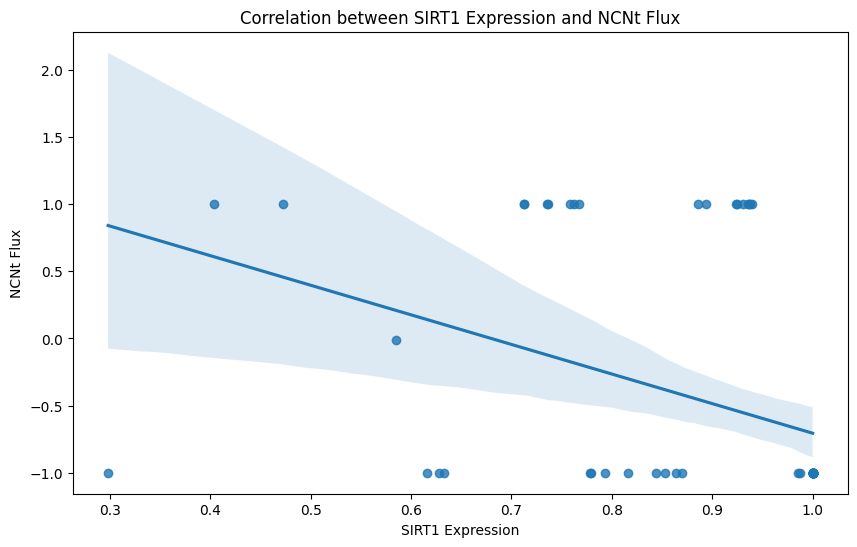

Linear regression results for SIRT1 and NCNt:
Slope: -2.204411484131433
Intercept: 1.498627509553803
R-squared: 0.15885399056802274
P-value: 0.0005761868419087961
Standard error: 0.6106674185516082



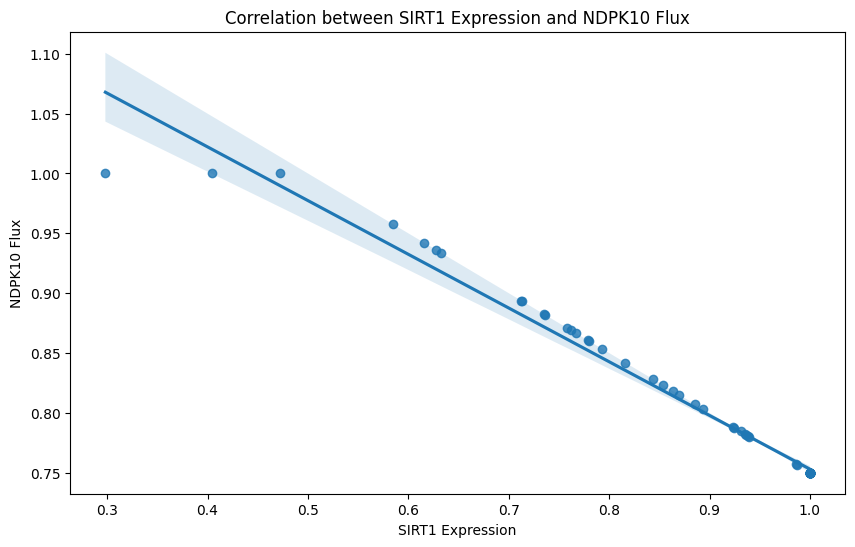

Linear regression results for SIRT1 and NDPK10:
Slope: -0.4487257049314206
Intercept: 1.2017064983101997
R-squared: 0.9787139549542303
P-value: 2.017241600918774e-59
Standard error: 0.007966654834260182



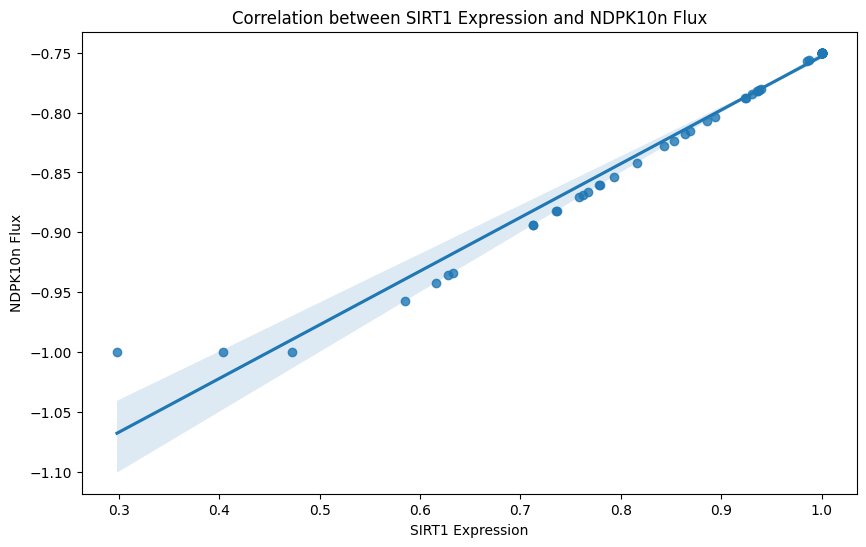

Linear regression results for SIRT1 and NDPK10n:
Slope: 0.4487257049314206
Intercept: -1.2017064983101997
R-squared: 0.9787139549542303
P-value: 2.017241600918774e-59
Standard error: 0.007966654834260182



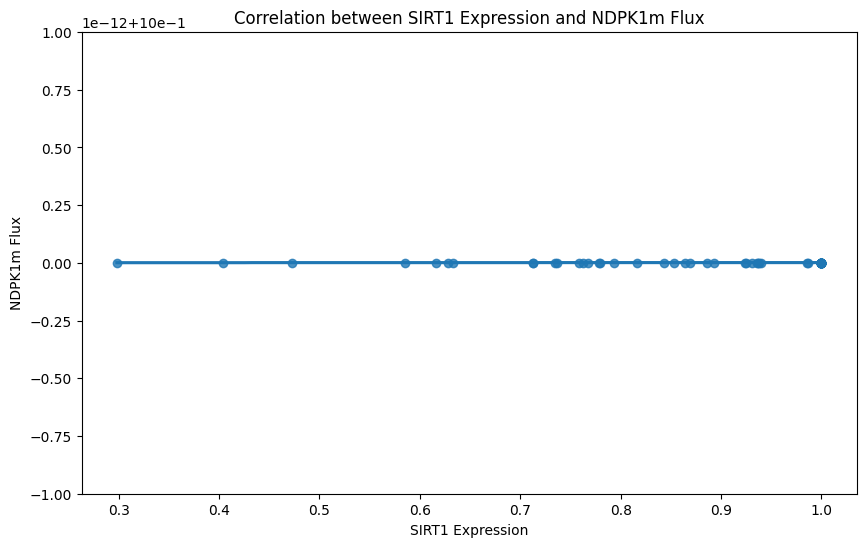

Linear regression results for SIRT1 and NDPK1m:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



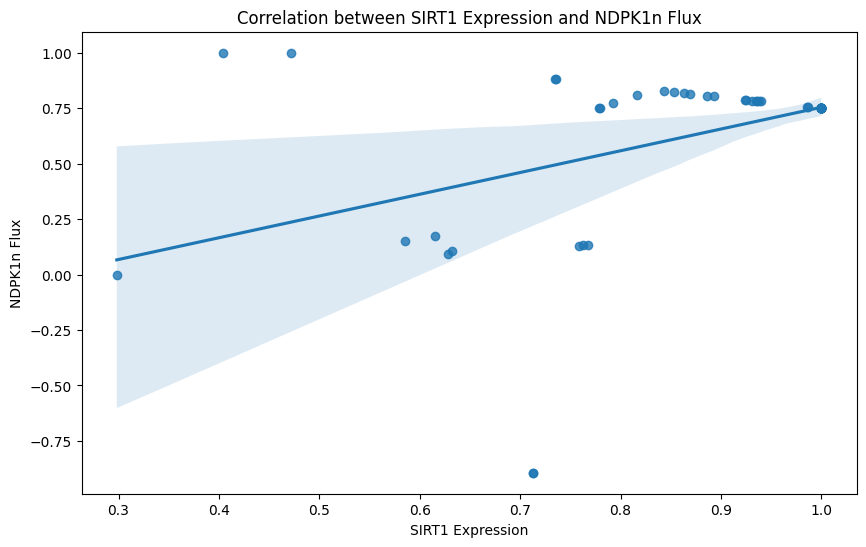

Linear regression results for SIRT1 and NDPK1n:
Slope: 0.9803119891766418
Intercept: -0.22639990080573058
R-squared: 0.20600111503320387
P-value: 7.026303462590794e-05
Standard error: 0.23169407579592421



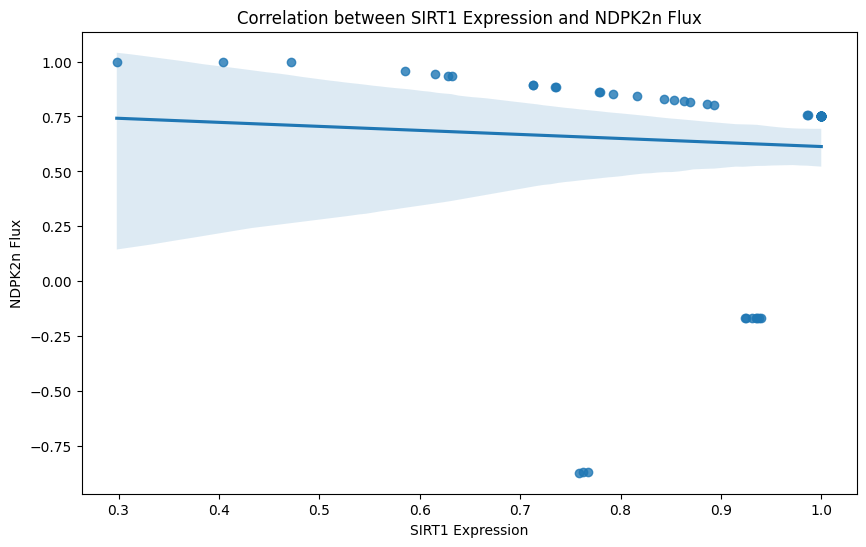

Linear regression results for SIRT1 and NDPK2n:
Slope: -0.18358803172889465
Intercept: 0.7967355353251316
R-squared: 0.004469872478921764
P-value: 0.5796000770985542
Standard error: 0.3298370651208348



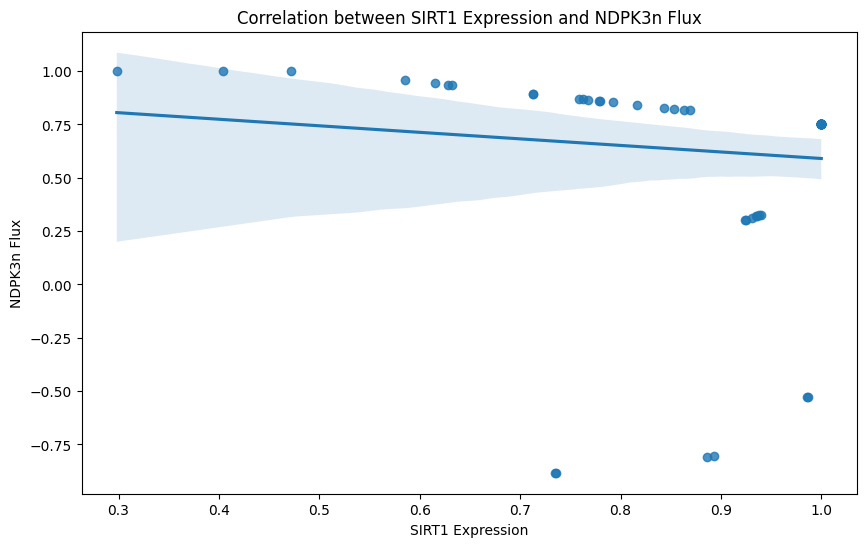

Linear regression results for SIRT1 and NDPK3n:
Slope: -0.30660066436406624
Intercept: 0.896813068234247
R-squared: 0.011731725879921684
P-value: 0.3685932118132986
Standard error: 0.33877005888858086



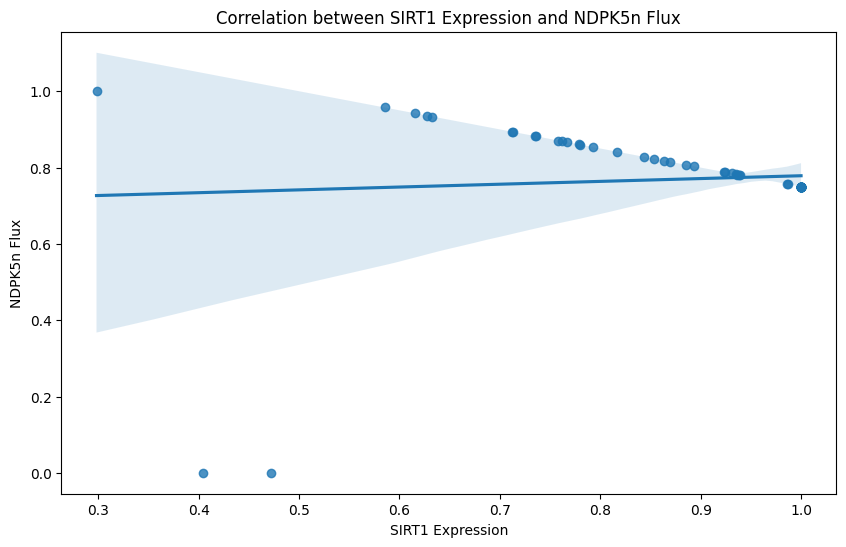

Linear regression results for SIRT1 and NDPK5n:
Slope: 0.07401479293178156
Intercept: 0.7045782344938409
R-squared: 0.006412534460052537
P-value: 0.50679129551348
Standard error: 0.11091293023215786



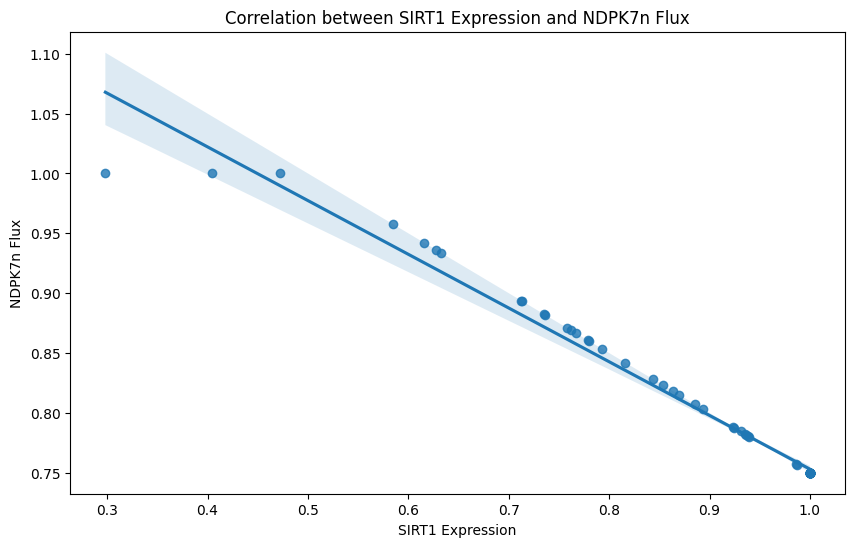

Linear regression results for SIRT1 and NDPK7n:
Slope: -0.4487257049314206
Intercept: 1.2017064983101997
R-squared: 0.9787139549542303
P-value: 2.017241600918774e-59
Standard error: 0.007966654834260182



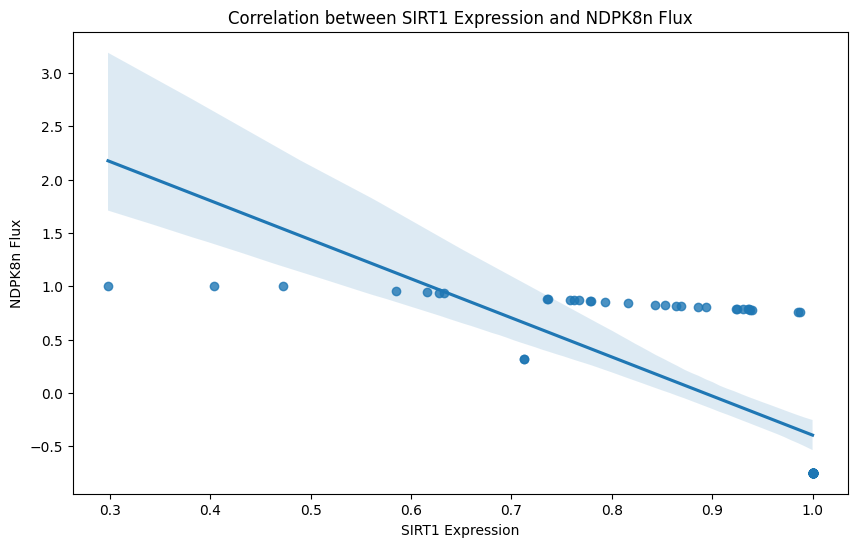

Linear regression results for SIRT1 and NDPK8n:
Slope: -3.667902807384547
Intercept: 3.270800721899859
R-squared: 0.5333065186895392
P-value: 4.941362372421612e-13
Standard error: 0.4130671850858953



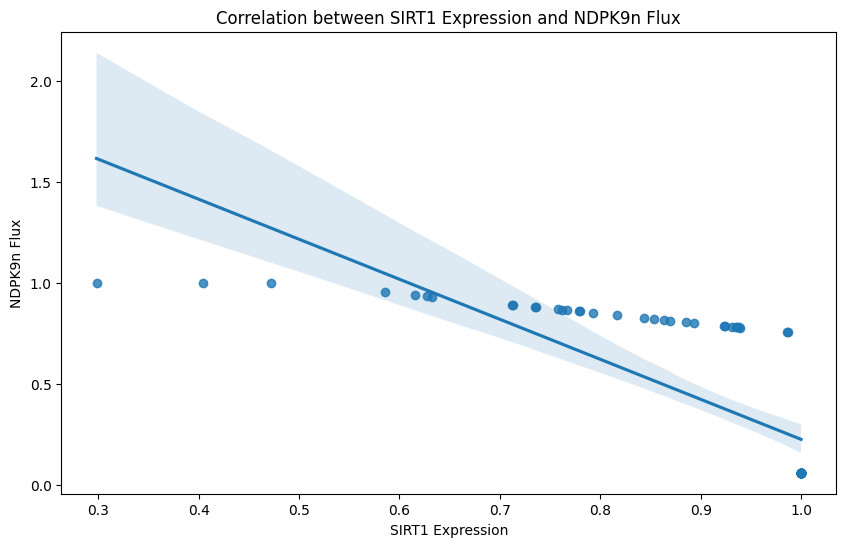

Linear regression results for SIRT1 and NDPK9n:
Slope: -1.9811771360470487
Intercept: 2.2081737831905124
R-squared: 0.6098461109034041
P-value: 9.597109548782793e-16
Standard error: 0.19076847274713246



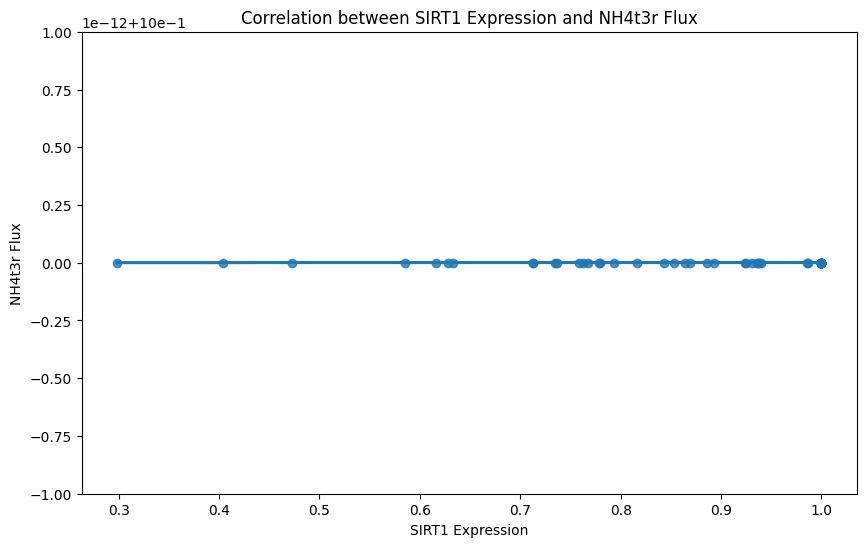

Linear regression results for SIRT1 and NH4t3r:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



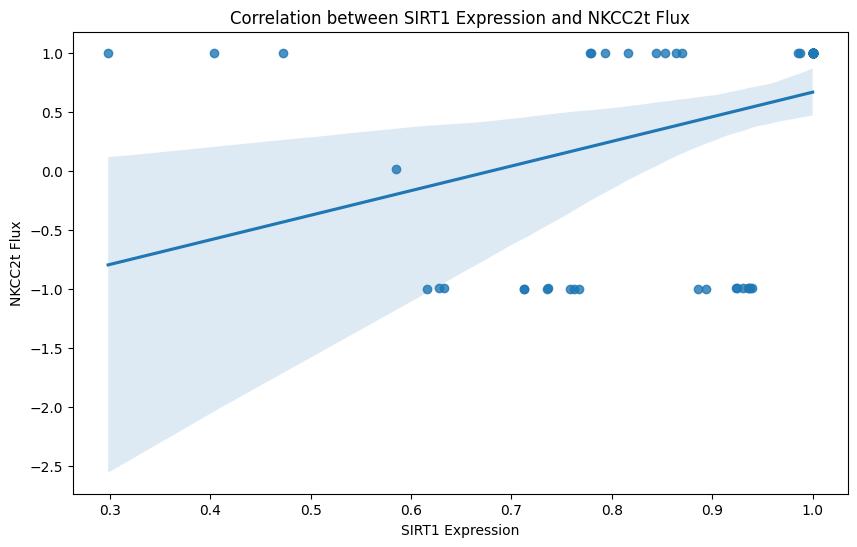

Linear regression results for SIRT1 and NKCC2t:
Slope: 2.086978366569591
Intercept: -1.4212667004317439
R-squared: 0.13768527884143789
P-value: 0.0014442421804335326
Standard error: 0.6287565868972833



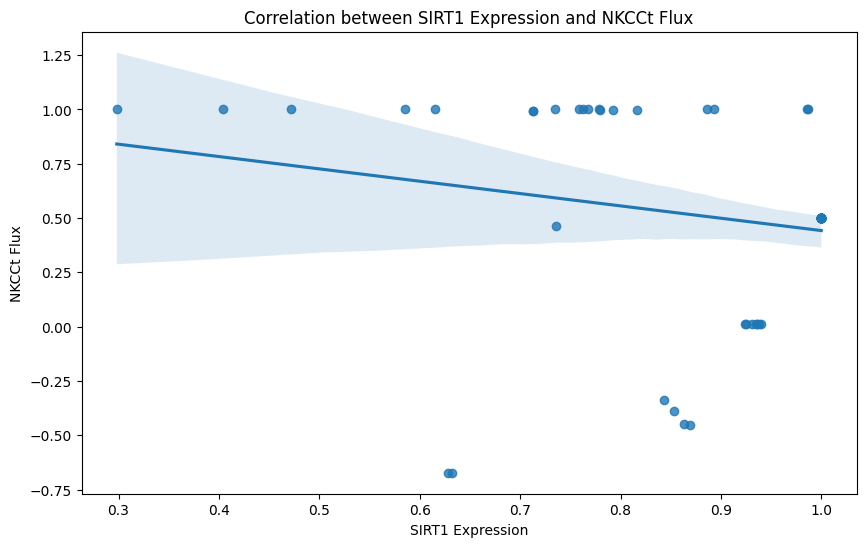

Linear regression results for SIRT1 and NKCCt:
Slope: -0.5680789418303593
Intercept: 1.0104670725343952
R-squared: 0.04548044819161202
P-value: 0.07415099217210706
Standard error: 0.31330273904562356



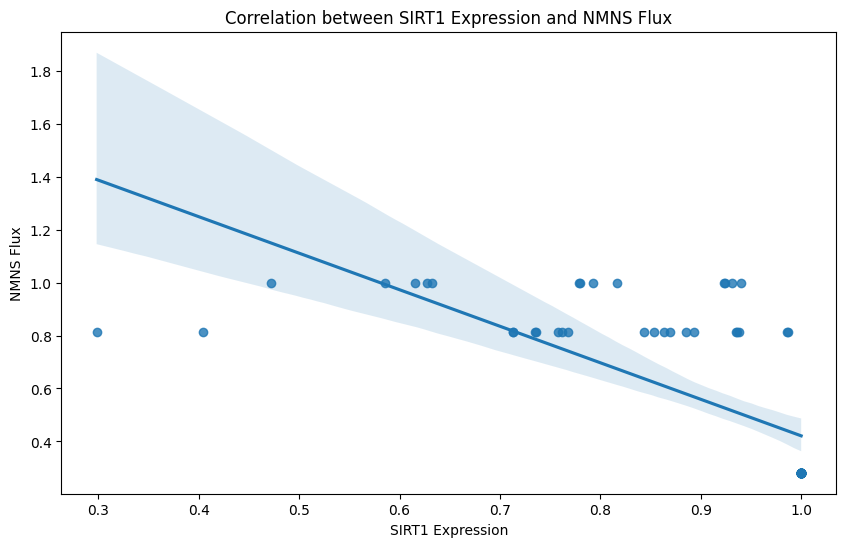

Linear regression results for SIRT1 and NMNS:
Slope: -1.3793281905997017
Intercept: 1.800439156744192
R-squared: 0.495572682903481
P-value: 7.480256993651933e-12
Standard error: 0.16752849472040598



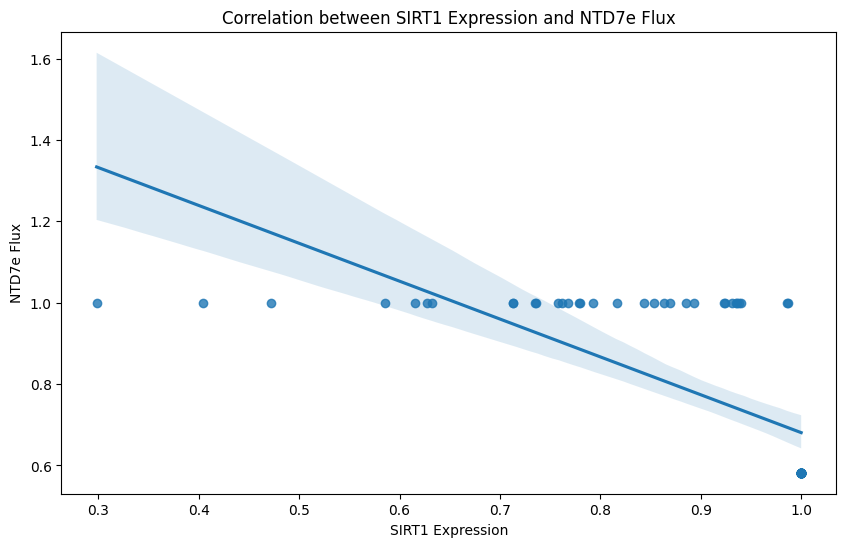

Linear regression results for SIRT1 and NTD7e:
Slope: -0.9306353430384663
Intercept: 1.611212863196387
R-squared: 0.49271140514695655
P-value: 9.117085759106804e-12
Standard error: 0.11368056882526818



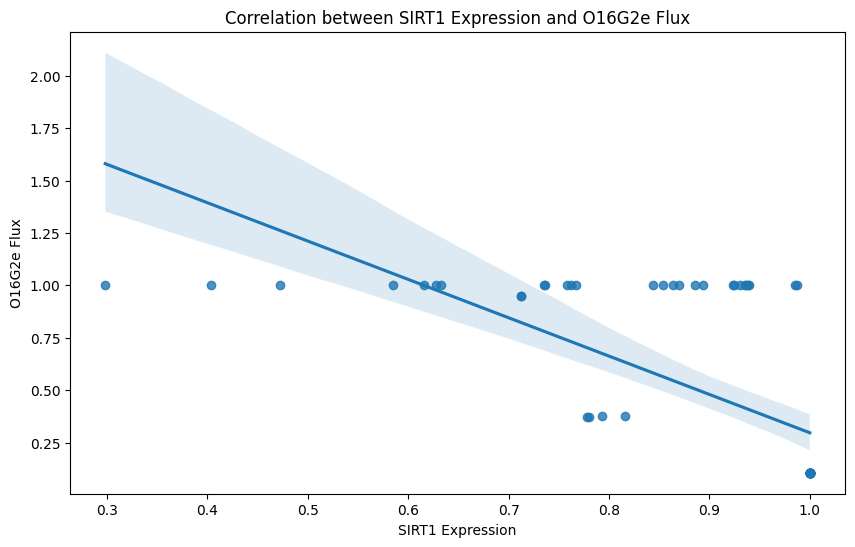

Linear regression results for SIRT1 and O16G2e:
Slope: -1.8280645346643143
Intercept: 2.125250745014519
R-squared: 0.44850537504066046
P-value: 1.7021712245047777e-10
Standard error: 0.24403594152486893



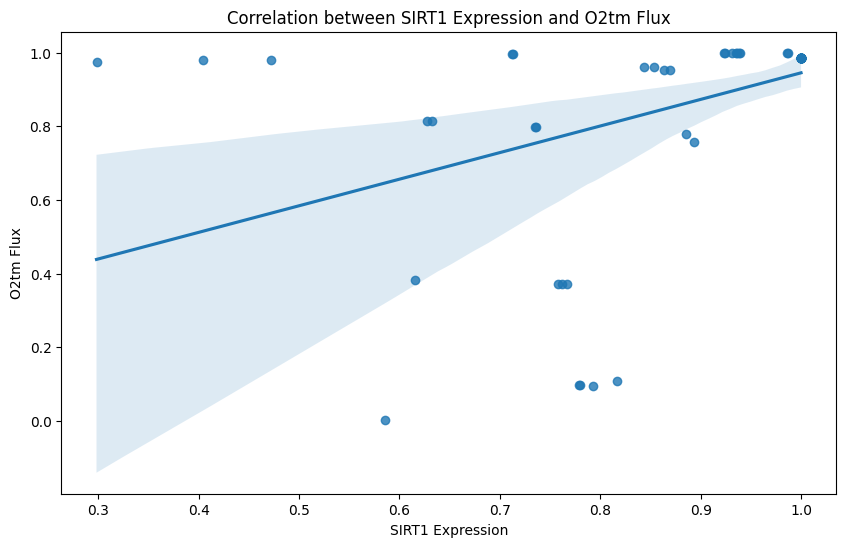

Linear regression results for SIRT1 and O2tm:
Slope: 0.7224697177038356
Intercept: 0.22292090009741627
R-squared: 0.18696659447858
P-value: 0.00016608256903684454
Standard error: 0.18137076684271344



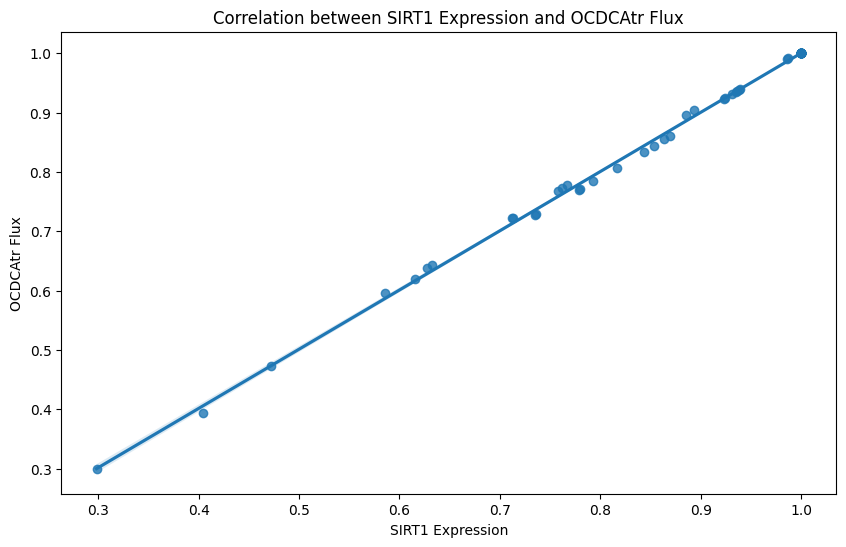

Linear regression results for SIRT1 and OCDCAtr:
Slope: 0.9974185002158998
Intercept: 0.0025739488127271004
R-squared: 0.9989027945260418
P-value: 7.432048279220767e-104
Standard error: 0.0039795617018202785



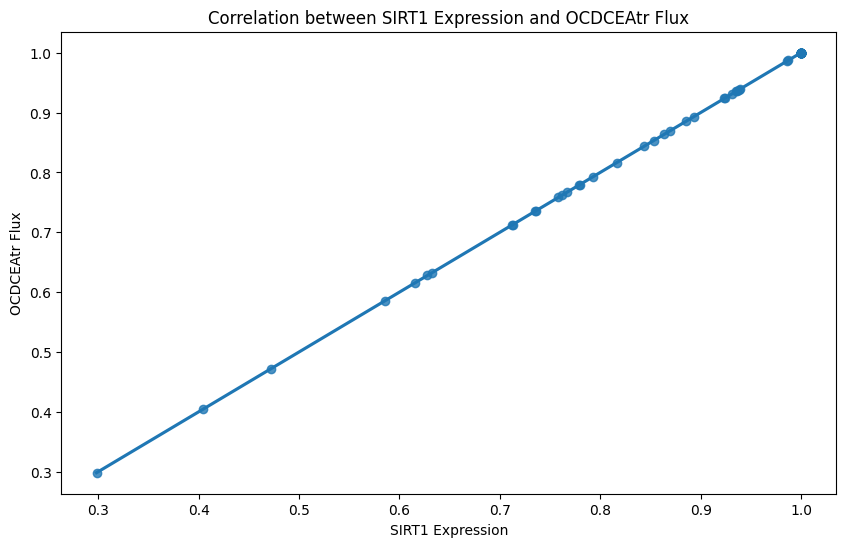

Linear regression results for SIRT1 and OCDCEAtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



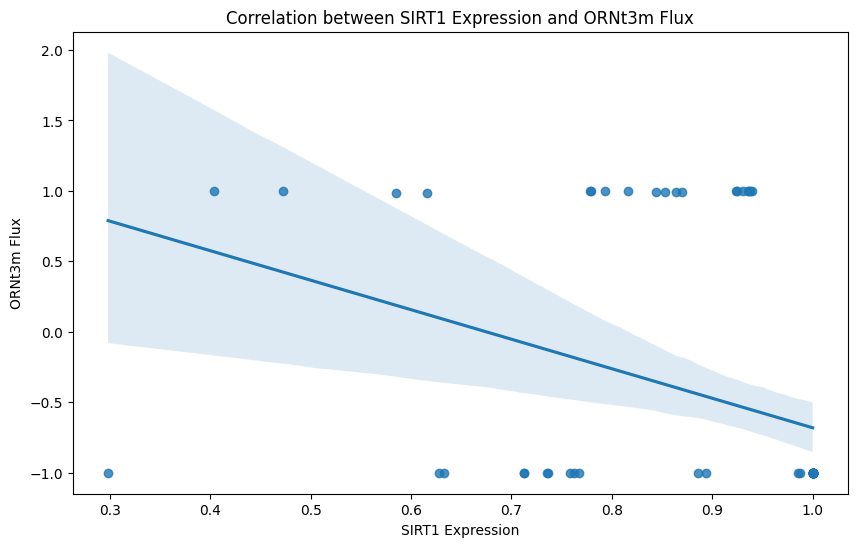

Linear regression results for SIRT1 and ORNt3m:
Slope: -2.0948948048296696
Intercept: 1.4138905489859268
R-squared: 0.13882784732994727
P-value: 0.0013748188918196957
Standard error: 0.6281225259643934



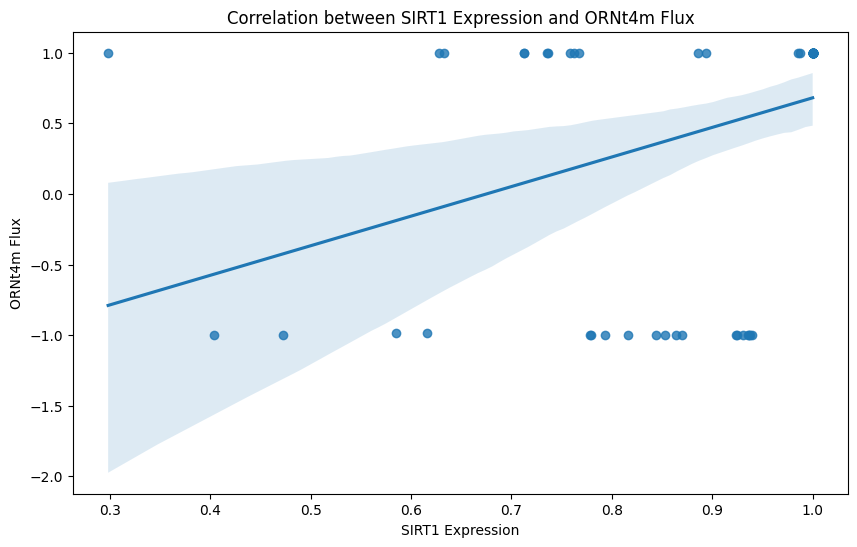

Linear regression results for SIRT1 and ORNt4m:
Slope: 2.095028161497485
Intercept: -1.4143162343842137
R-squared: 0.1386460351348893
P-value: 0.0013856416791184004
Standard error: 0.6286405929097522



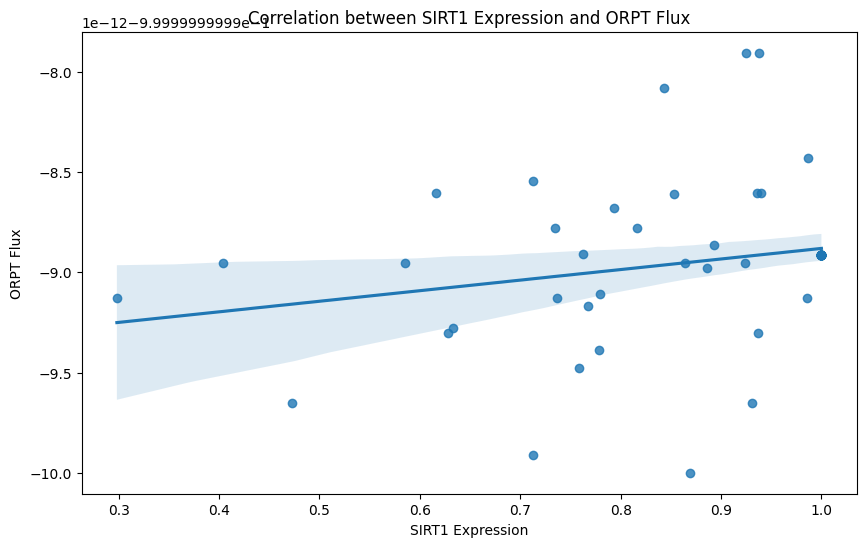

Linear regression results for SIRT1 and ORPT:
Slope: 5.277829540545984e-13
Intercept: -0.9999999999994079
R-squared: 0.06079076289091417
P-value: 0.03819330844196844
Standard error: 2.4974292565829327e-13



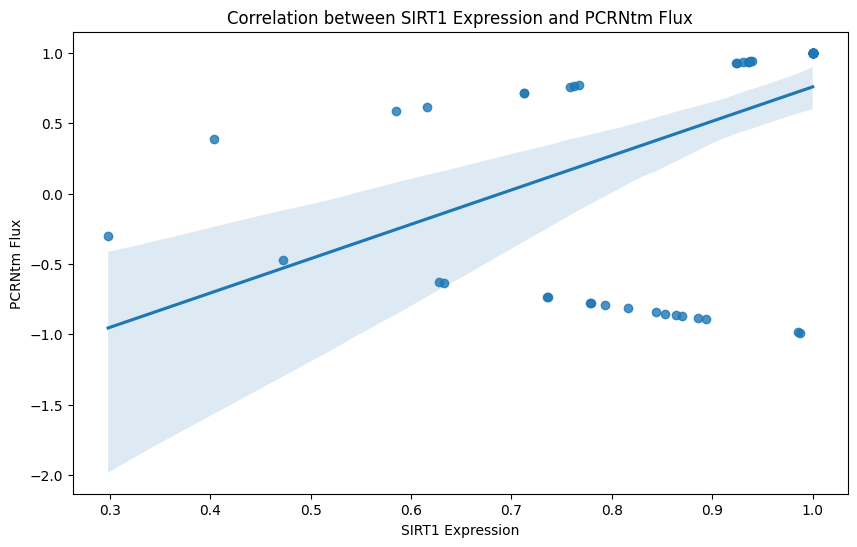

Linear regression results for SIRT1 and PCRNtm:
Slope: 2.4402429465361446
Intercept: -1.68256088001736
R-squared: 0.25709847202457065
P-value: 6.409476489421151e-06
Standard error: 0.4993722427879518



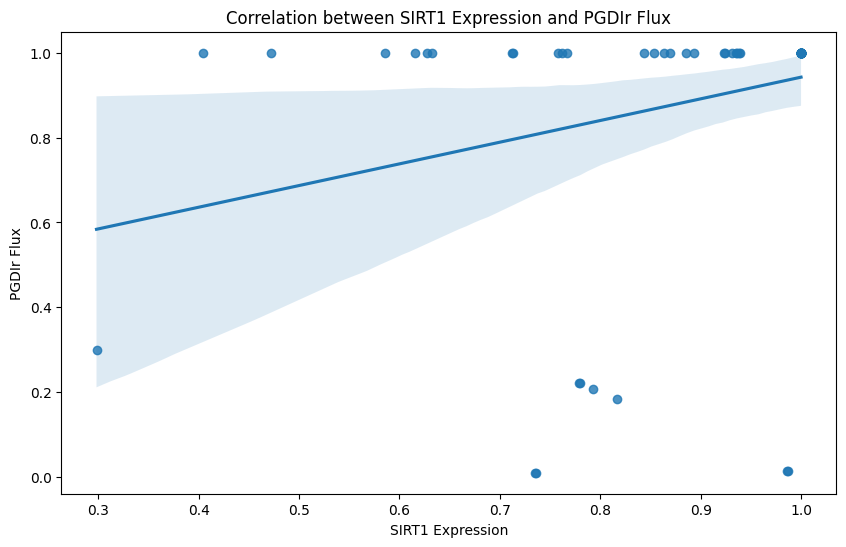

Linear regression results for SIRT1 and PGDIr:
Slope: 0.5109483053225474
Intercept: 0.4314396223038144
R-squared: 0.07580339280348261
P-value: 0.02013342158010153
Standard error: 0.2147782406349313



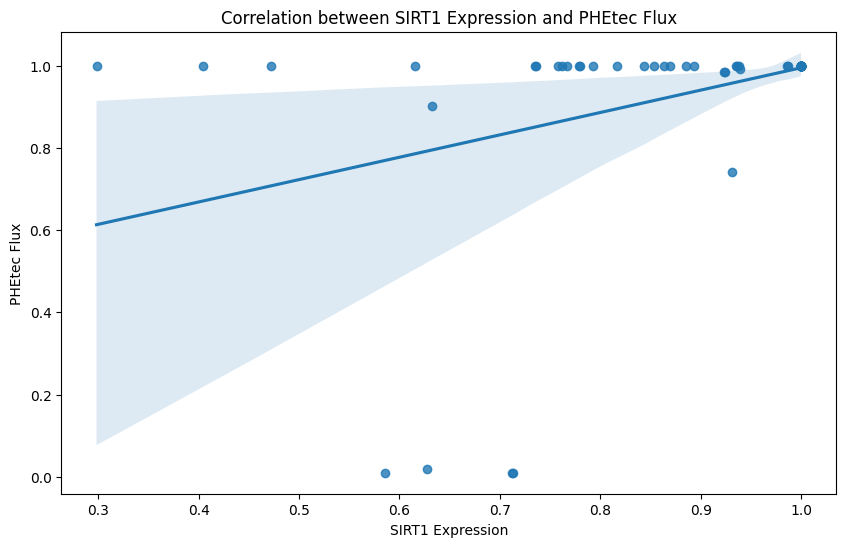

Linear regression results for SIRT1 and PHEtec:
Slope: 0.5438105609090955
Intercept: 0.45085379472463305
R-squared: 0.13976588330981368
P-value: 0.0013202899823804707
Standard error: 0.162416757725492



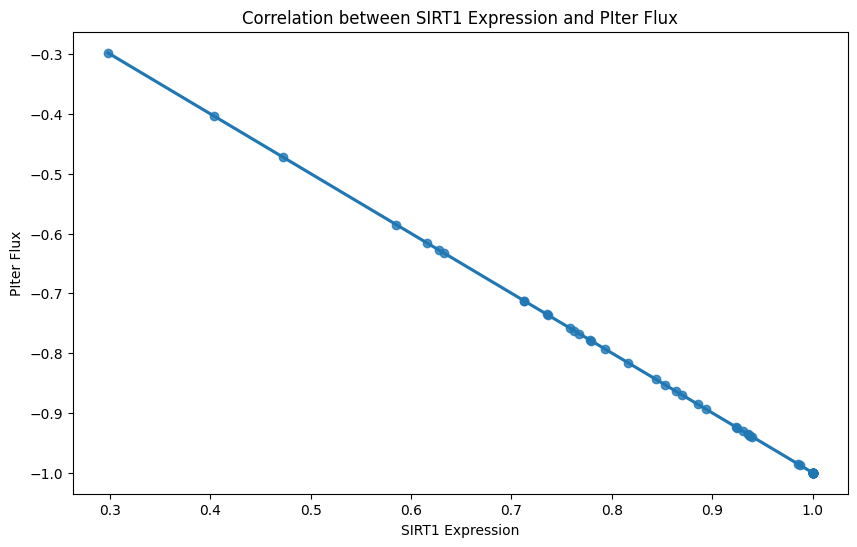

Linear regression results for SIRT1 and PIter:
Slope: -1.0004799910491815
Intercept: 0.00045844675897876996
R-squared: 0.9999996669184485
P-value: 3.2280264377480134e-225
Standard error: 6.95119103095569e-05



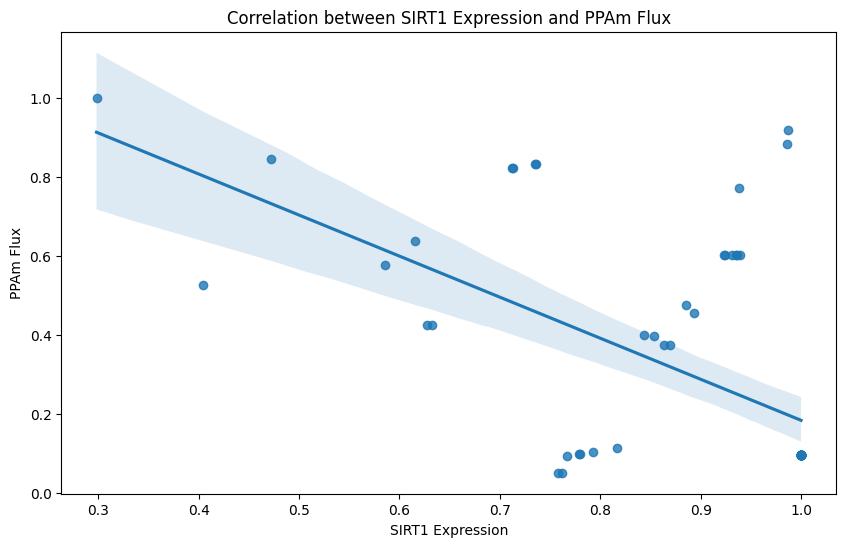

Linear regression results for SIRT1 and PPAm:
Slope: -1.0376504365003403
Intercept: 1.2219275708310304
R-squared: 0.3352484313409843
P-value: 1.2263285539558417e-07
Standard error: 0.17590283377098467



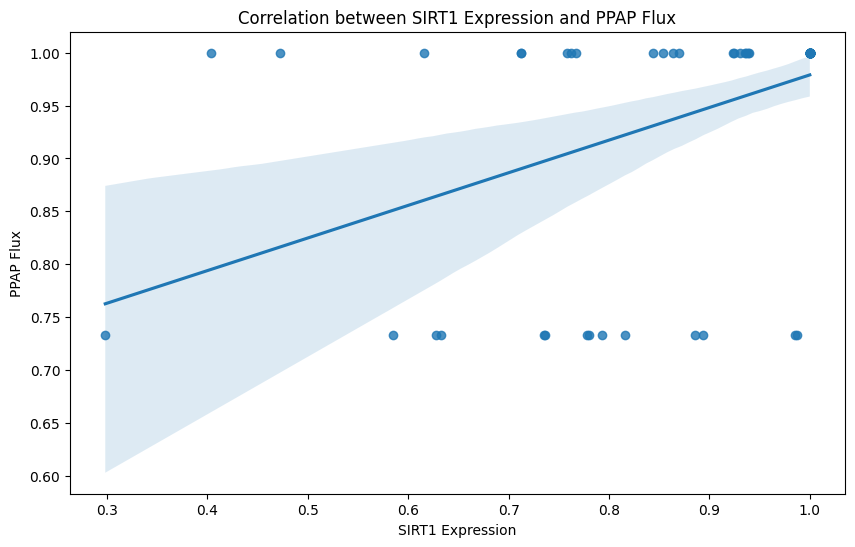

Linear regression results for SIRT1 and PPAP:
Slope: 0.3085439979918333
Intercept: 0.6704766220123843
R-squared: 0.2080393234453745
P-value: 6.401949369762229e-05
Standard error: 0.0724722341619919



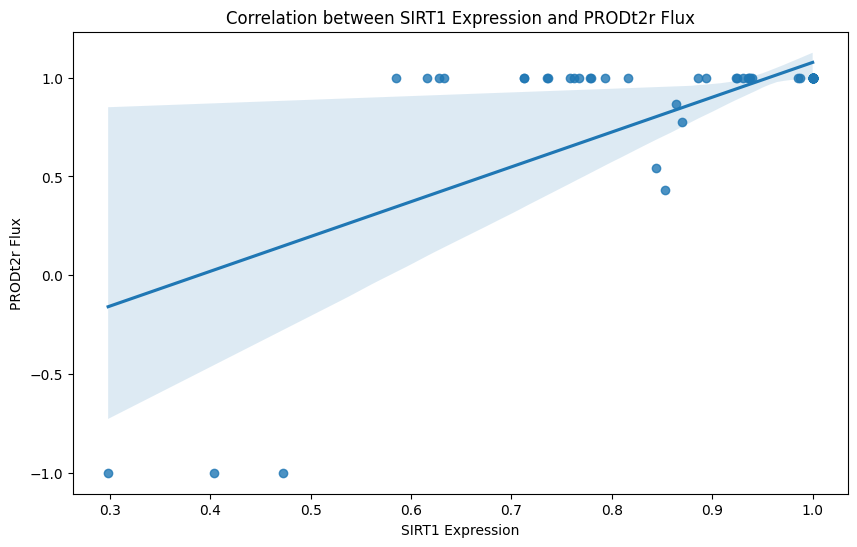

Linear regression results for SIRT1 and PRODt2r:
Slope: 1.7625851259699272
Intercept: -0.6852275360434833
R-squared: 0.46095238290703716
P-value: 7.644727705540704e-11
Standard error: 0.2294621659022288



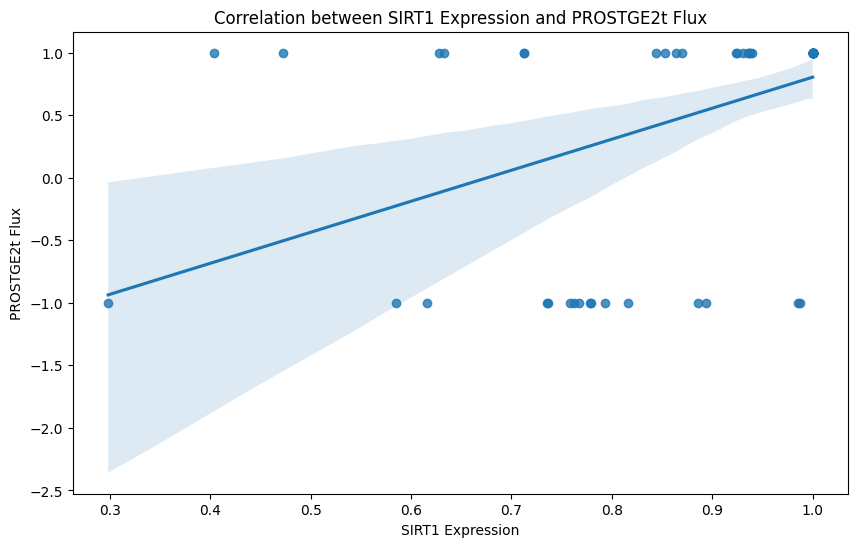

Linear regression results for SIRT1 and PROSTGE2t:
Slope: 2.4805614786117163
Intercept: -1.6761325562581342
R-squared: 0.2178636873247484
P-value: 4.076981826691042e-05
Standard error: 0.5658147303963742



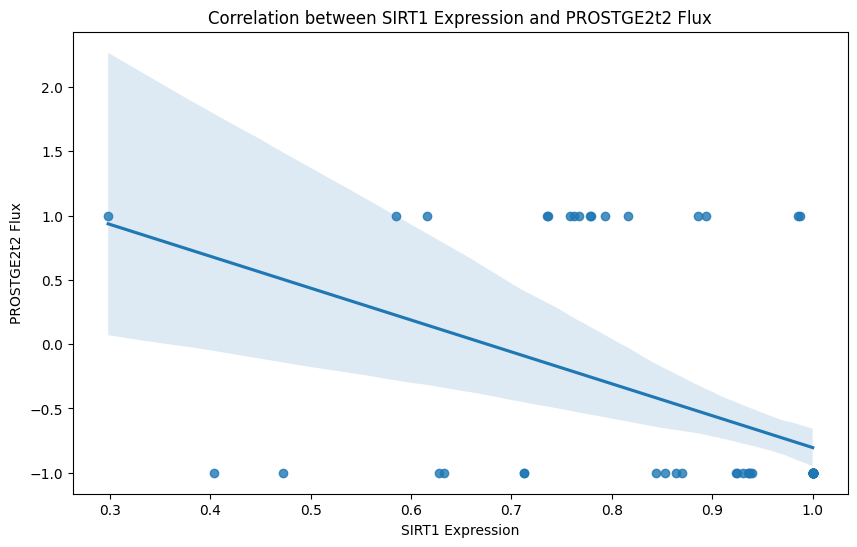

Linear regression results for SIRT1 and PROSTGE2t2:
Slope: -2.4805614786117163
Intercept: 1.6761325562581342
R-squared: 0.2178636873247484
P-value: 4.076981826691042e-05
Standard error: 0.5658147303963742



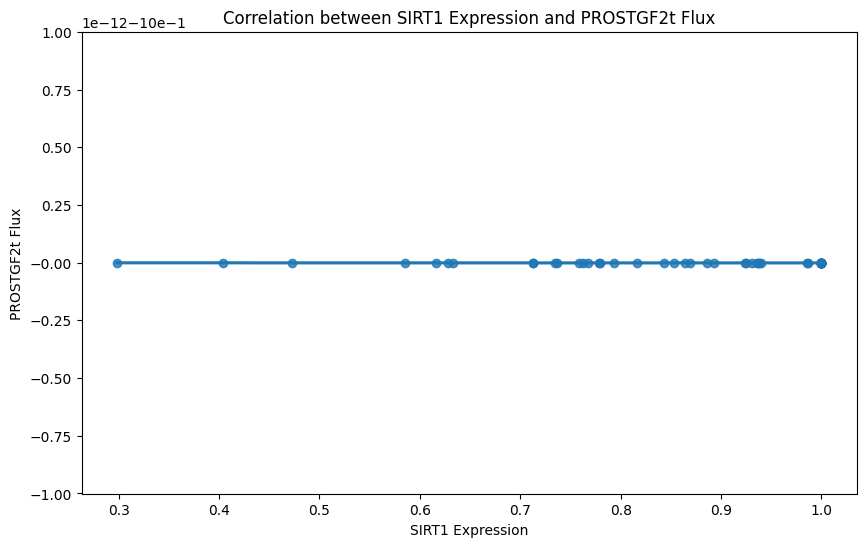

Linear regression results for SIRT1 and PROSTGF2t:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



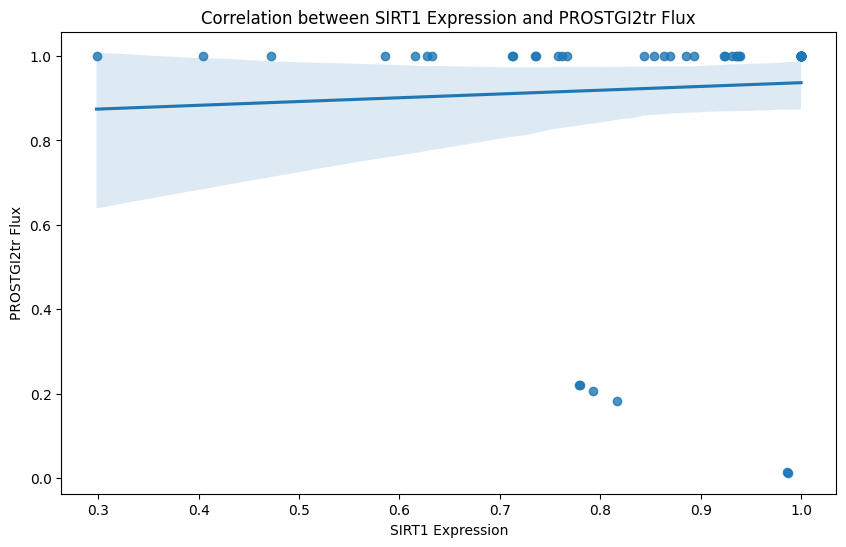

Linear regression results for SIRT1 and PROSTGI2tr:
Slope: 0.0892902533871303
Intercept: 0.8475002450678314
R-squared: 0.003428137828680439
P-value: 0.6276671087437637
Standard error: 0.18327561404538584



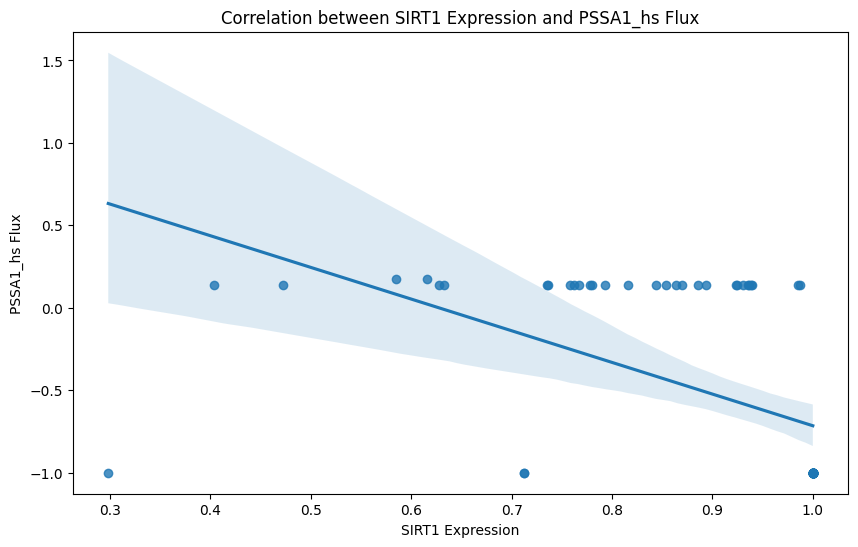

Linear regression results for SIRT1 and PSSA1_hs:
Slope: -1.9203796783846026
Intercept: 1.2052610692719923
R-squared: 0.28665991835236276
P-value: 1.5027561533864021e-06
Standard error: 0.3646929629845478



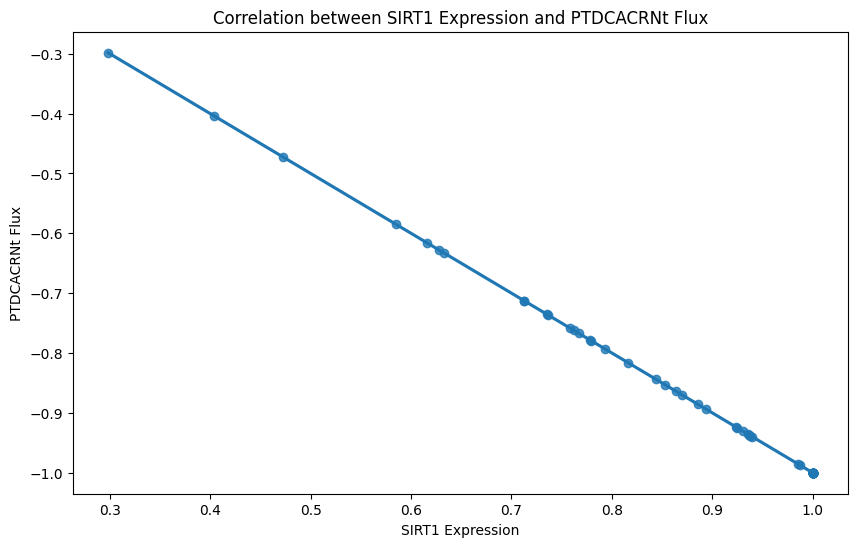

Linear regression results for SIRT1 and PTDCACRNt:
Slope: -1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



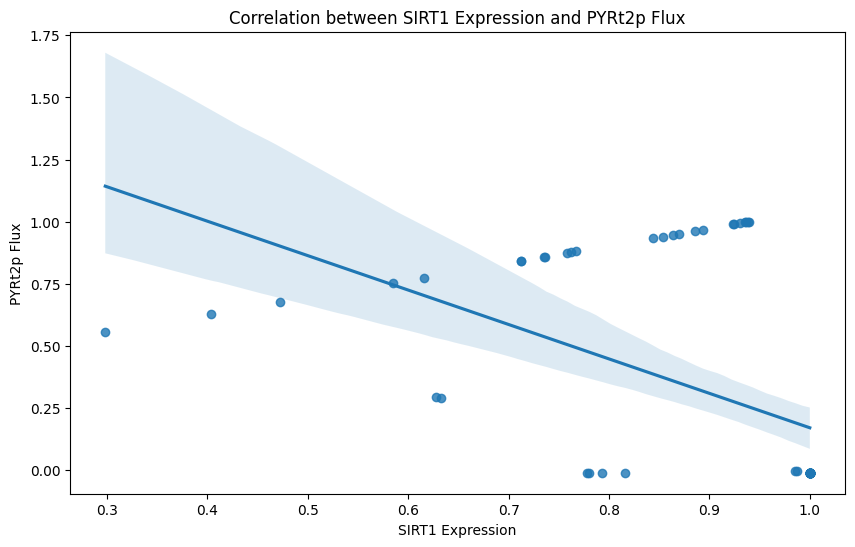

Linear regression results for SIRT1 and PYRt2p:
Slope: -1.3851179967630336
Intercept: 1.5561068875292727
R-squared: 0.2575320180264457
P-value: 6.276883069665291e-06
Standard error: 0.2831297309099621



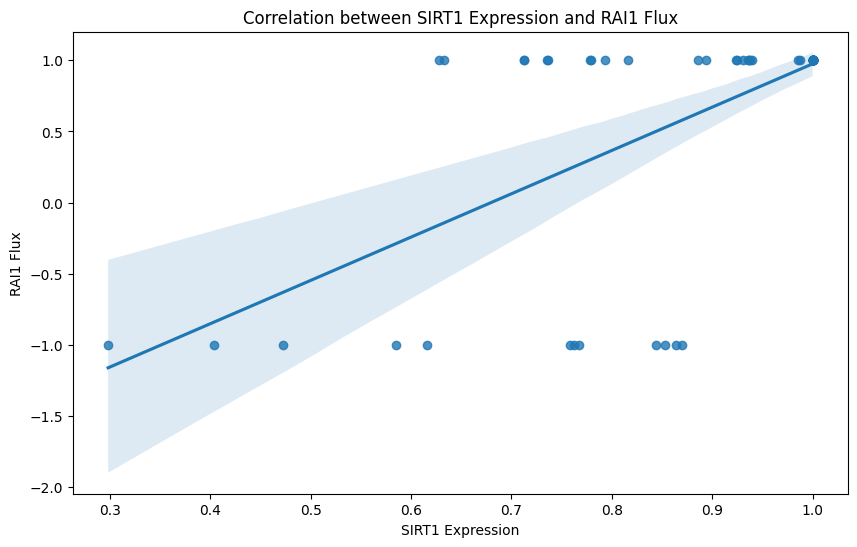

Linear regression results for SIRT1 and RAI1:
Slope: 3.045211989415785
Intercept: -2.070031021309191
R-squared: 0.4081025758676848
P-value: 2.0398097892245834e-09
Standard error: 0.44150084857395006



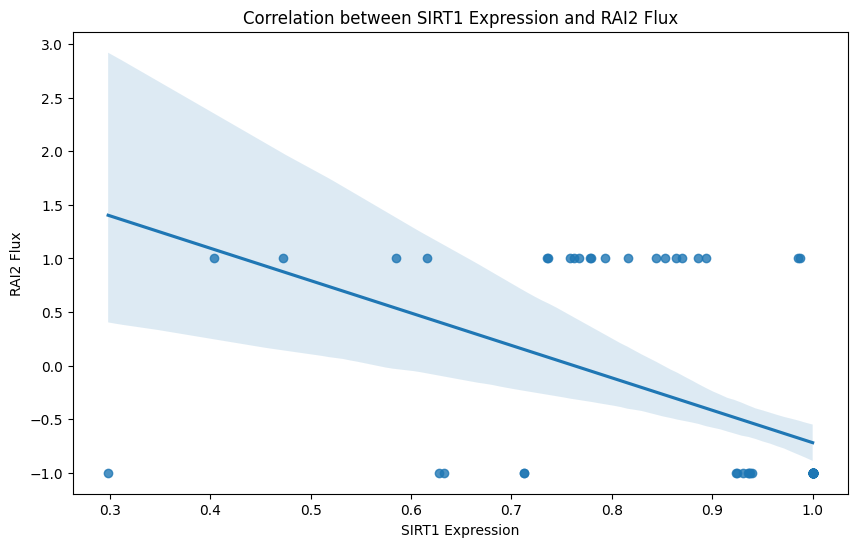

Linear regression results for SIRT1 and RAI2:
Slope: -3.0249695788489537
Intercept: 2.305391729813776
R-squared: 0.2715315229614761
P-value: 3.177454789903528e-06
Standard error: 0.5964742777860709



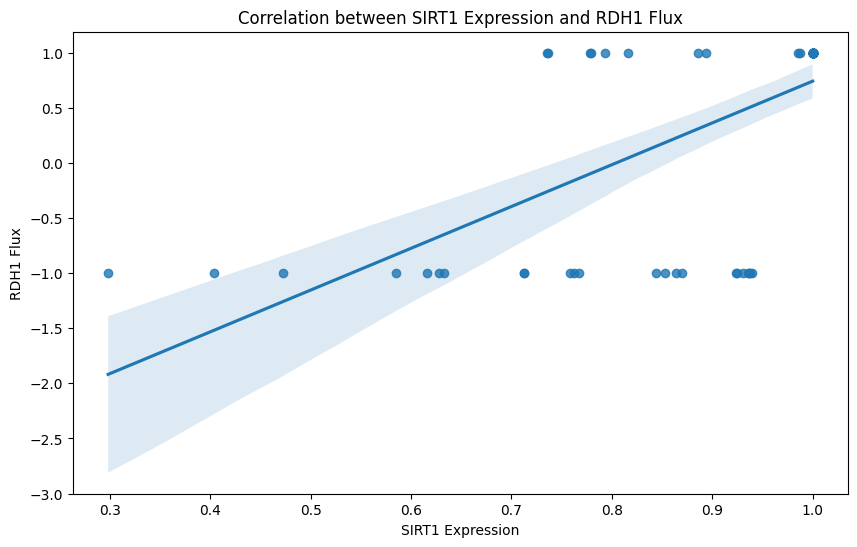

Linear regression results for SIRT1 and RDH1:
Slope: 3.790952858994557
Intercept: -3.0489293728016005
R-squared: 0.40559745956998317
P-value: 2.3665864007694817e-09
Standard error: 0.5524799910233594



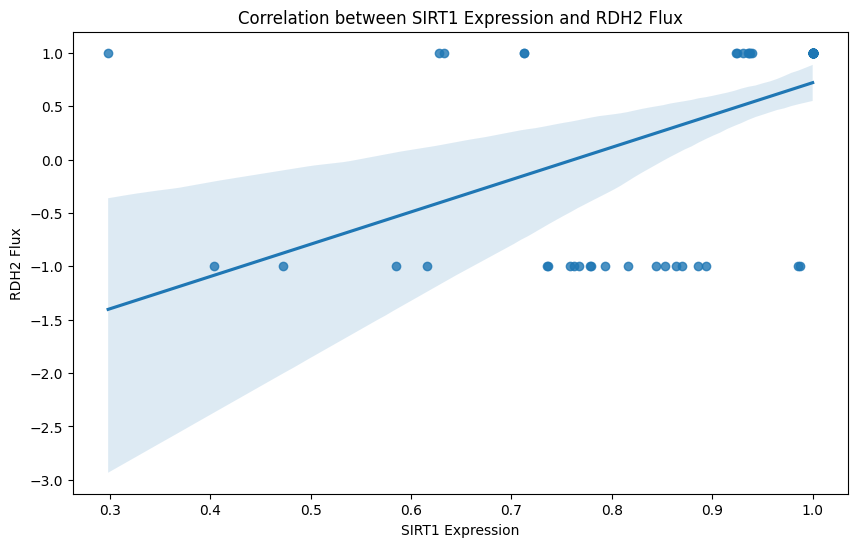

Linear regression results for SIRT1 and RDH2:
Slope: 3.0249695788489537
Intercept: -2.305391729813776
R-squared: 0.2715315229614761
P-value: 3.177454789903528e-06
Standard error: 0.5964742777860709



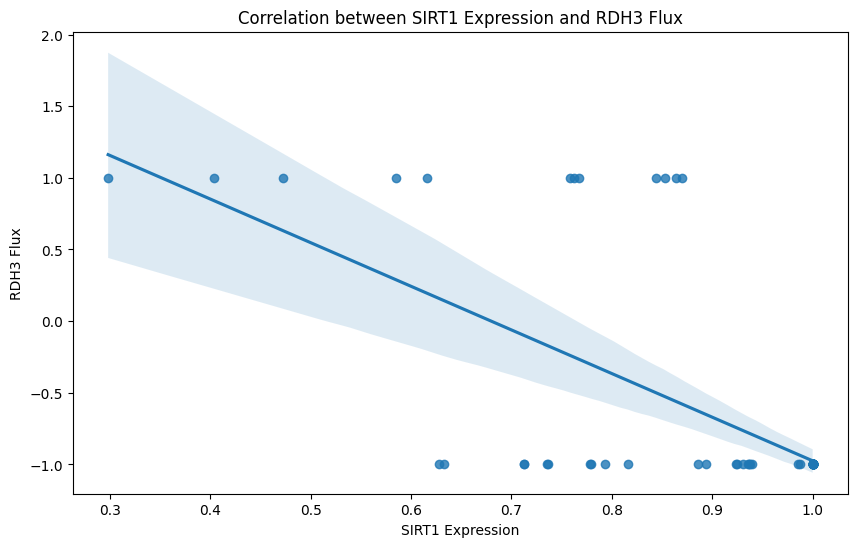

Linear regression results for SIRT1 and RDH3:
Slope: -3.045211989415785
Intercept: 2.070031021309191
R-squared: 0.4081025758676848
P-value: 2.0398097892245834e-09
Standard error: 0.44150084857395006



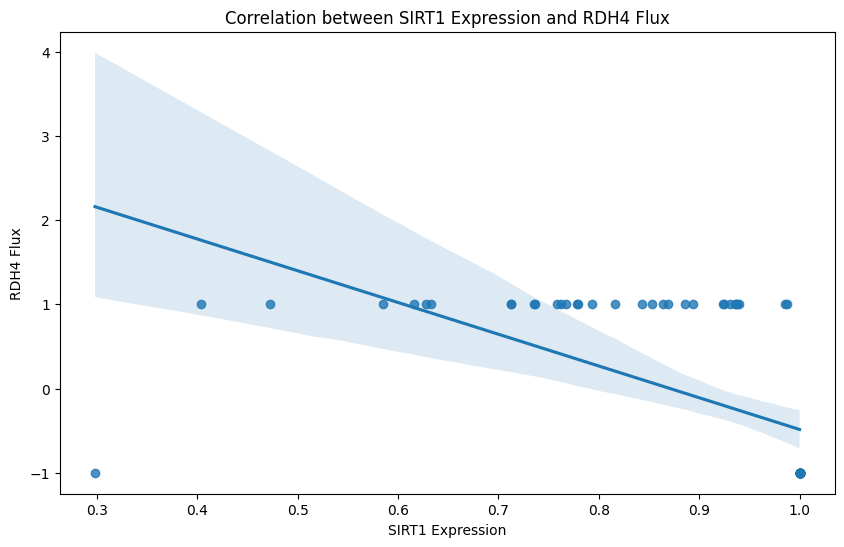

Linear regression results for SIRT1 and RDH4:
Slope: -3.770710448427725
Intercept: 3.2842900813061844
R-squared: 0.3549762645973474
P-value: 4.2238308106123656e-08
Standard error: 0.611908983920846



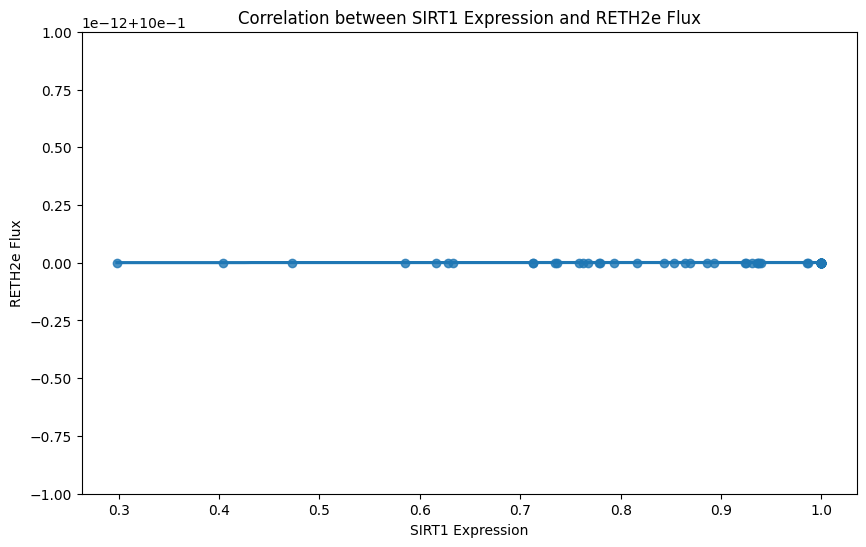

Linear regression results for SIRT1 and RETH2e:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



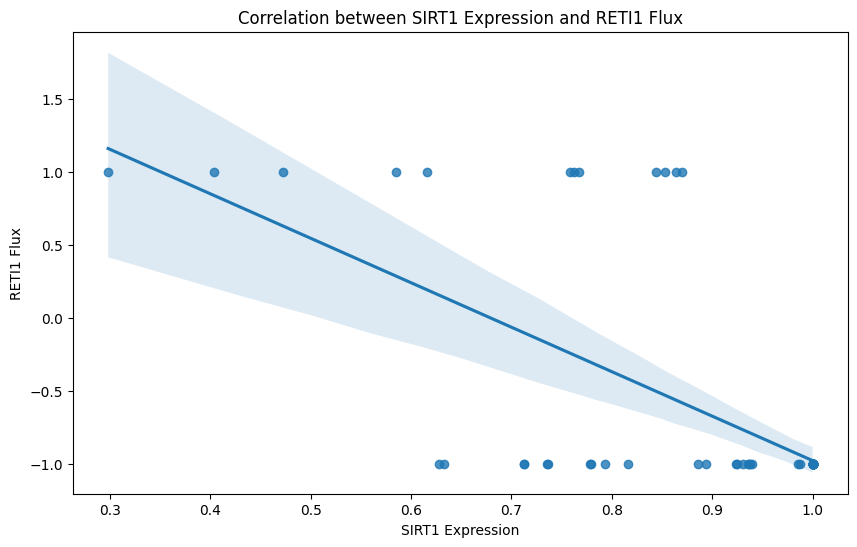

Linear regression results for SIRT1 and RETI1:
Slope: -3.045211989415785
Intercept: 2.070031021309191
R-squared: 0.4081025758676848
P-value: 2.0398097892245834e-09
Standard error: 0.44150084857395006



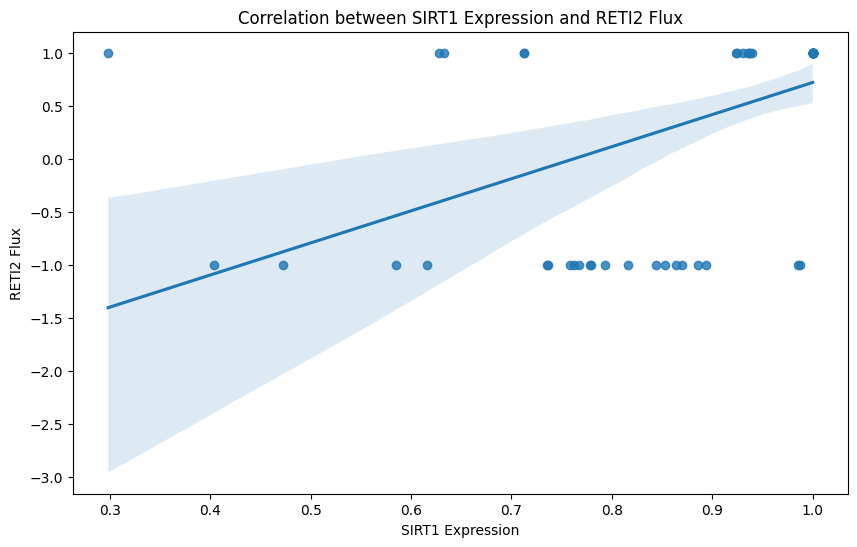

Linear regression results for SIRT1 and RETI2:
Slope: 3.0249695788489537
Intercept: -2.305391729813776
R-squared: 0.2715315229614761
P-value: 3.177454789903528e-06
Standard error: 0.5964742777860709



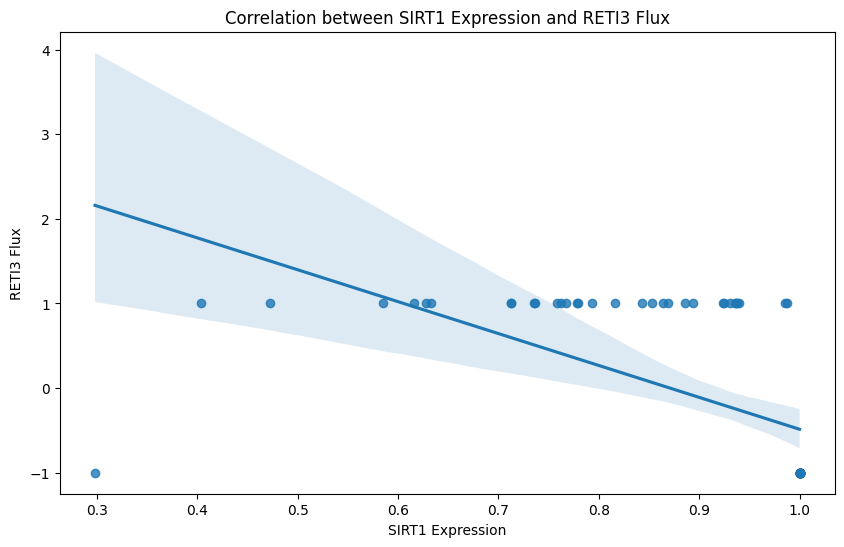

Linear regression results for SIRT1 and RETI3:
Slope: -3.770710448427725
Intercept: 3.2842900813061844
R-squared: 0.3549762645973474
P-value: 4.2238308106123656e-08
Standard error: 0.611908983920846



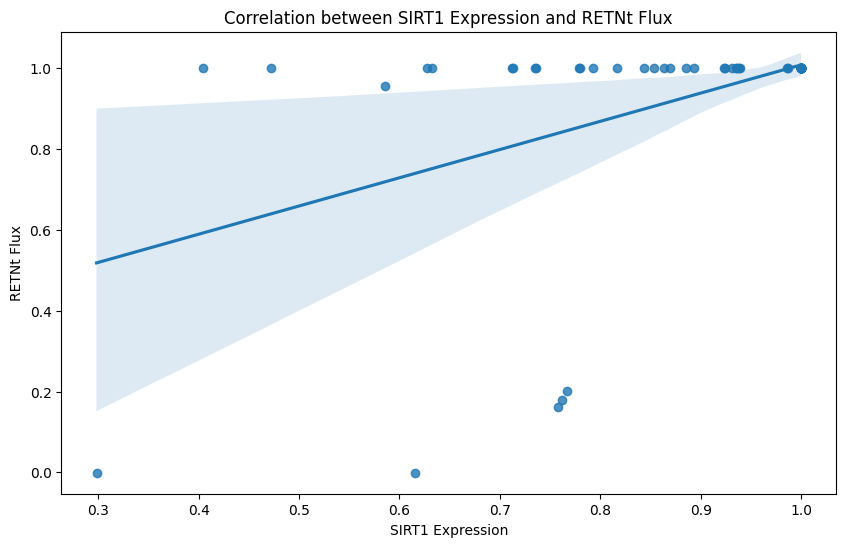

Linear regression results for SIRT1 and RETNt:
Slope: 0.6983785839658841
Intercept: 0.31001490959204225
R-squared: 0.22921375635055335
P-value: 2.40673753376015e-05
Standard error: 0.154174662389556



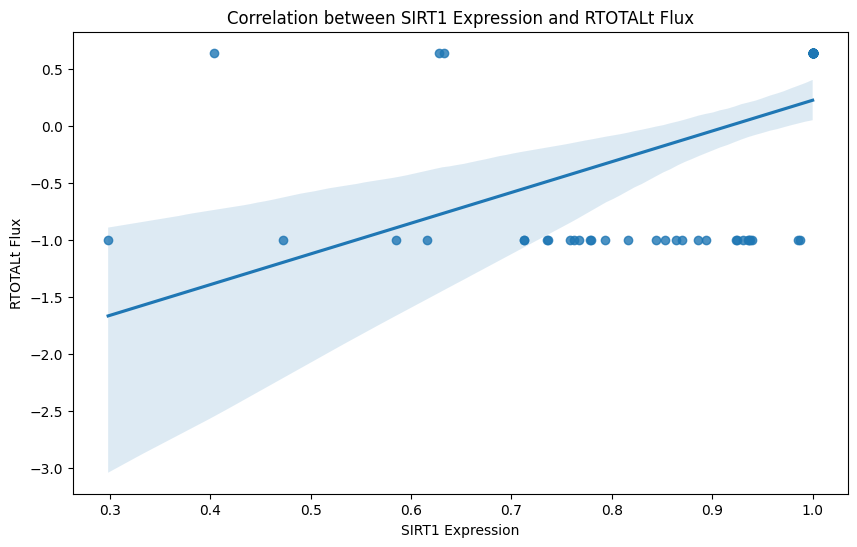

Linear regression results for SIRT1 and RTOTALt:
Slope: 2.6978300184216875
Intercept: -2.471228031485524
R-squared: 0.2729973310324135
P-value: 2.95688530063292e-06
Standard error: 0.5300036242301297



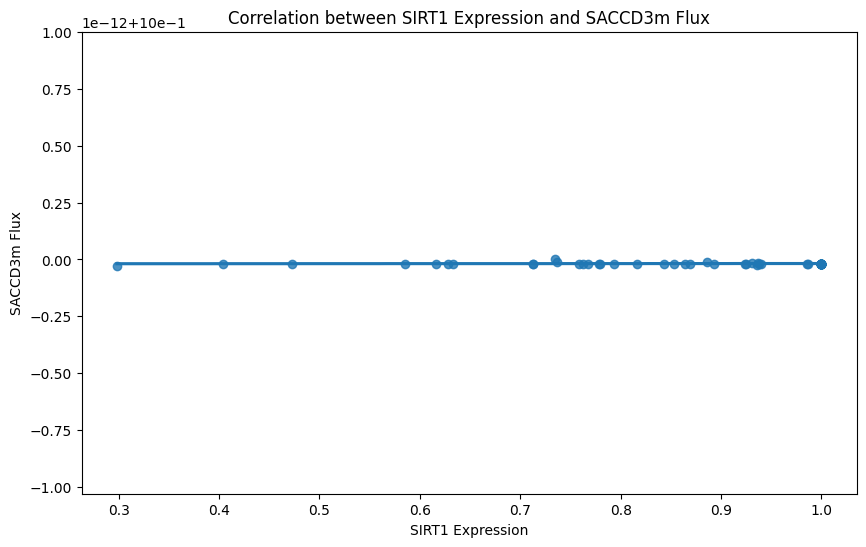

Linear regression results for SIRT1 and SACCD3m:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



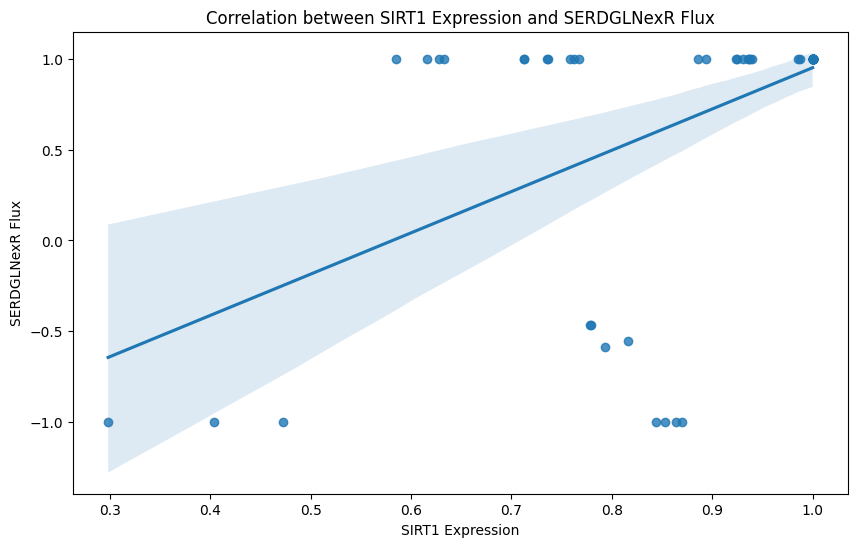

Linear regression results for SIRT1 and SERDGLNexR:
Slope: 2.2724404302276775
Intercept: -1.3214521962830925
R-squared: 0.28721882664406584
P-value: 1.4613603793978006e-06
Standard error: 0.43096263739560936



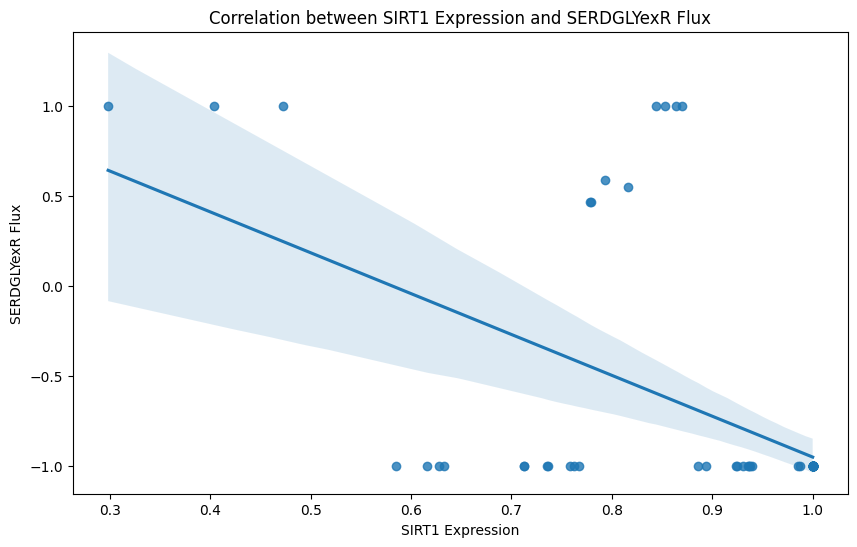

Linear regression results for SIRT1 and SERDGLYexR:
Slope: -2.2724404302276775
Intercept: 1.3214521962830925
R-squared: 0.28721882664406584
P-value: 1.4613603793978006e-06
Standard error: 0.43096263739560936



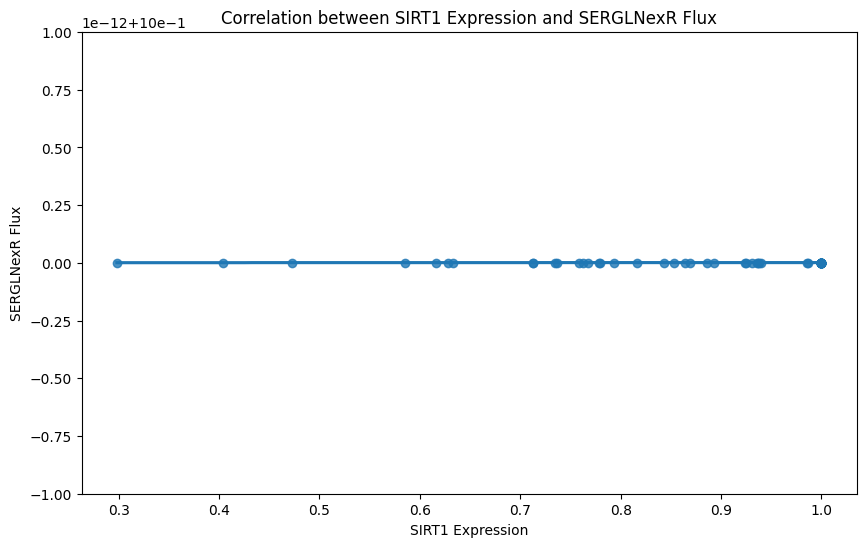

Linear regression results for SIRT1 and SERGLNexR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



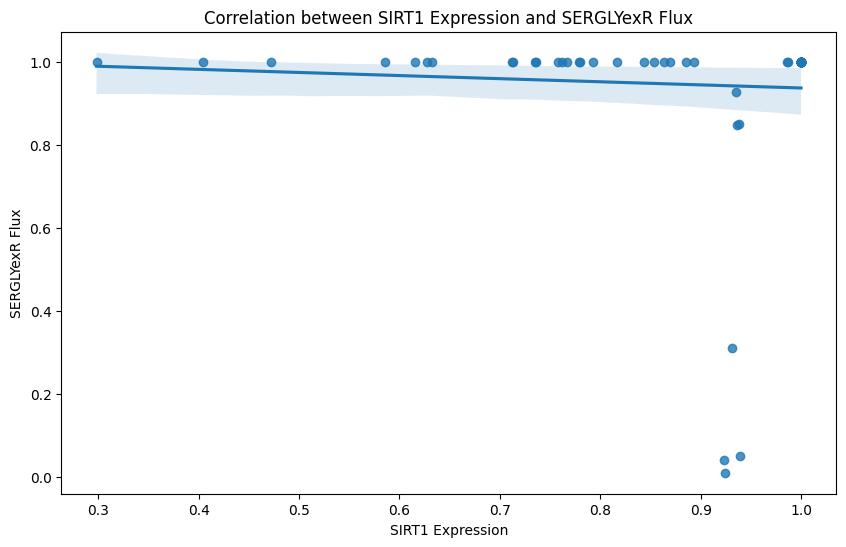

Linear regression results for SIRT1 and SERGLYexR:
Slope: -0.07472636934216122
Intercept: 1.0111733061172807
R-squared: 0.003153019302264549
P-value: 0.6418512205398225
Standard error: 0.15995590264899734



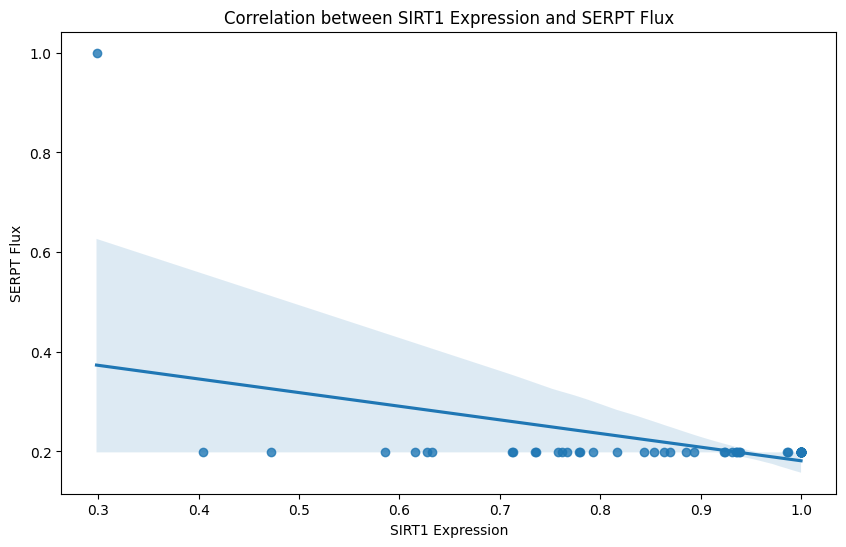

Linear regression results for SIRT1 and SERPT:
Slope: -0.27359581843282493
Intercept: 0.4548604256245904
R-squared: 0.20726185396935212
P-value: 6.633427550940555e-05
Standard error: 0.0644154580131101



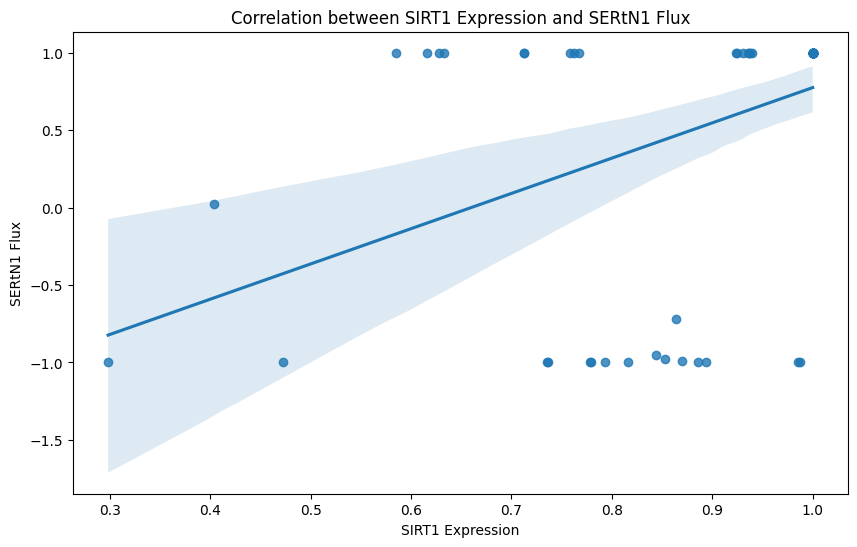

Linear regression results for SIRT1 and SERtN1:
Slope: 2.2772819511336095
Intercept: -1.5025181777364063
R-squared: 0.18723121471604645
P-value: 0.00016412546367910191
Standard error: 0.5711979489085648



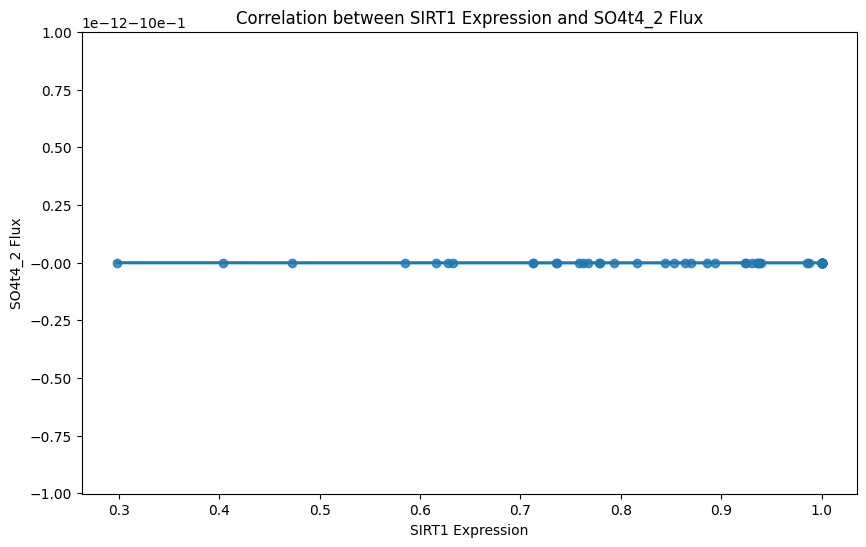

Linear regression results for SIRT1 and SO4t4_2:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



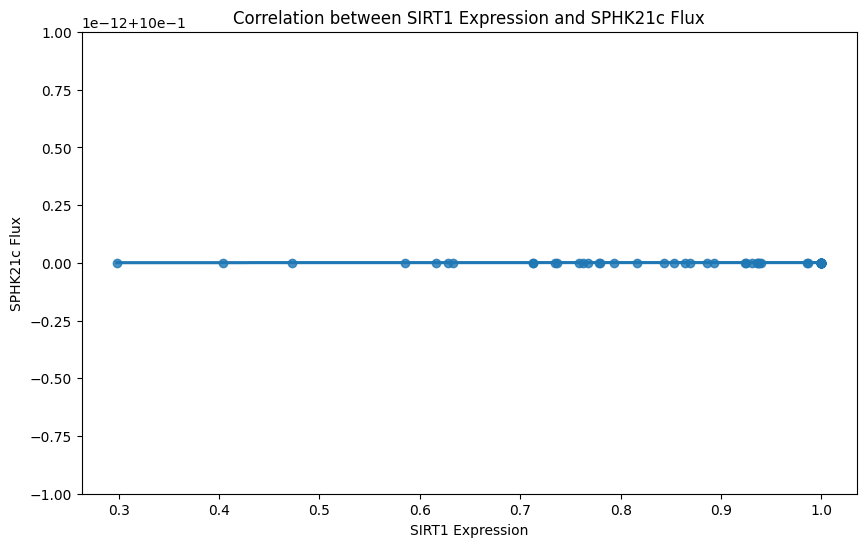

Linear regression results for SIRT1 and SPHK21c:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



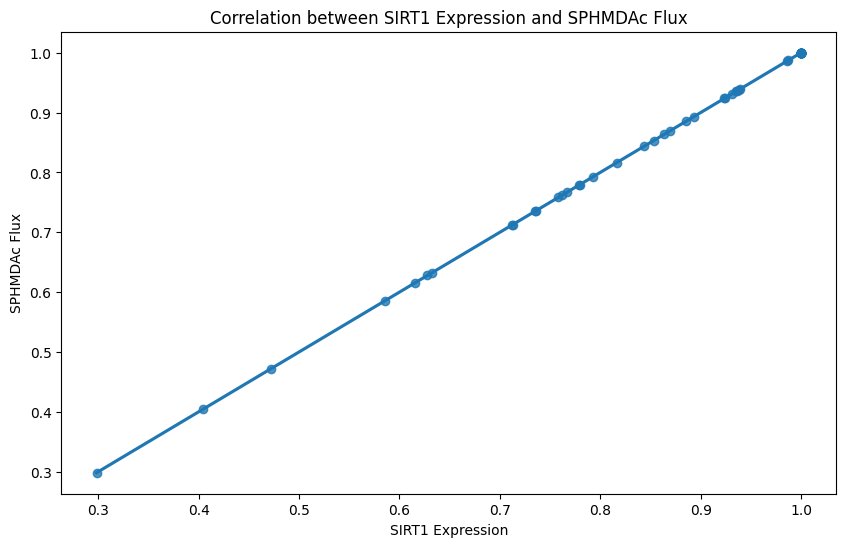

Linear regression results for SIRT1 and SPHMDAc:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



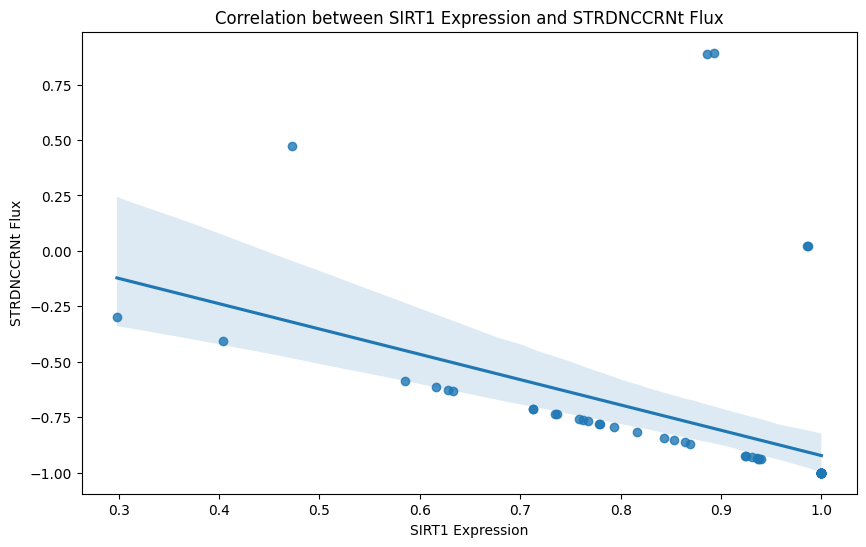

Linear regression results for SIRT1 and STRDNCCRNt:
Slope: -1.1413101394303484
Intercept: 0.218621784197073
R-squared: 0.20953567412514584
P-value: 5.978460637686471e-05
Standard error: 0.2668647923167419



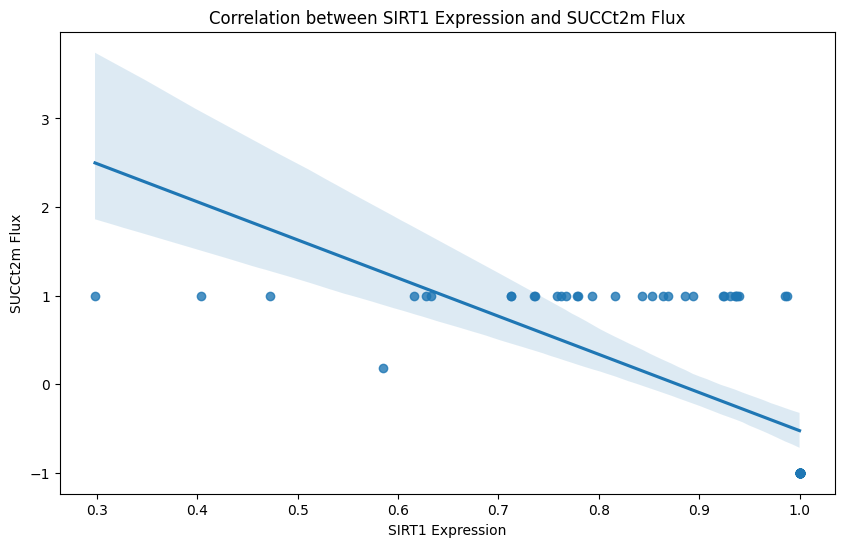

Linear regression results for SIRT1 and SUCCt2m:
Slope: -4.30855239316867
Intercept: 3.783526542198178
R-squared: 0.46846761989599284
P-value: 4.673988589194704e-11
Standard error: 0.5524995225953586



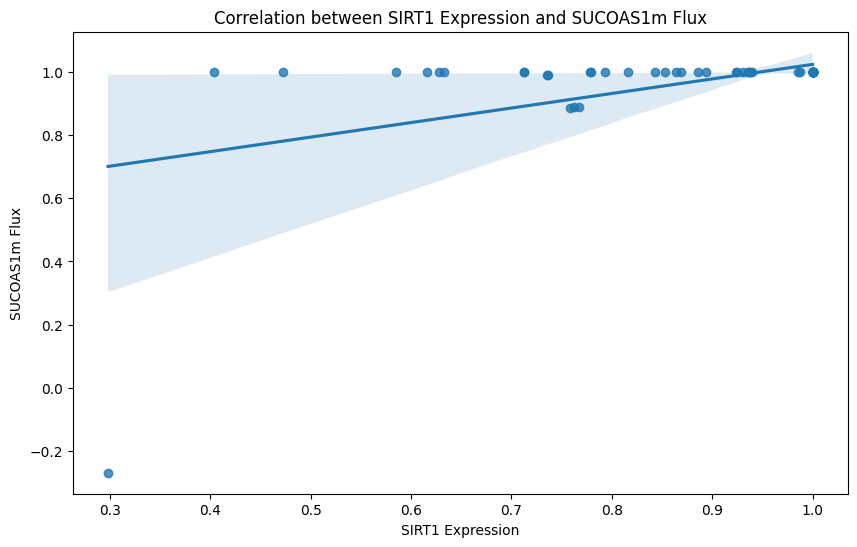

Linear regression results for SIRT1 and SUCOAS1m:
Slope: 0.4609715359607749
Intercept: 0.5635299556075799
R-squared: 0.2313135086754654
P-value: 2.1816058948484253e-05
Standard error: 0.10116346366334363



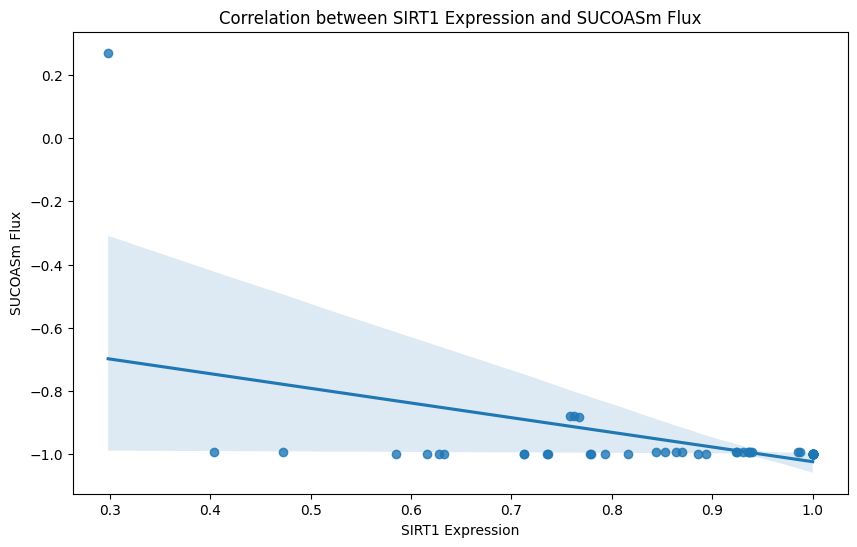

Linear regression results for SIRT1 and SUCOASm:
Slope: -0.4635960997221212
Intercept: -0.5594914267871773
R-squared: 0.23384478544217116
P-value: 1.9374436367655034e-05
Standard error: 0.10102055824445007



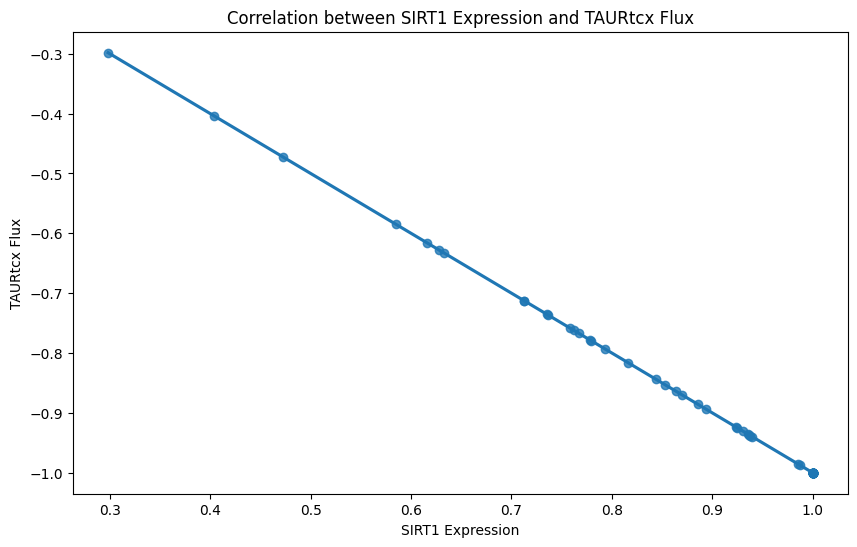

Linear regression results for SIRT1 and TAURtcx:
Slope: -1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



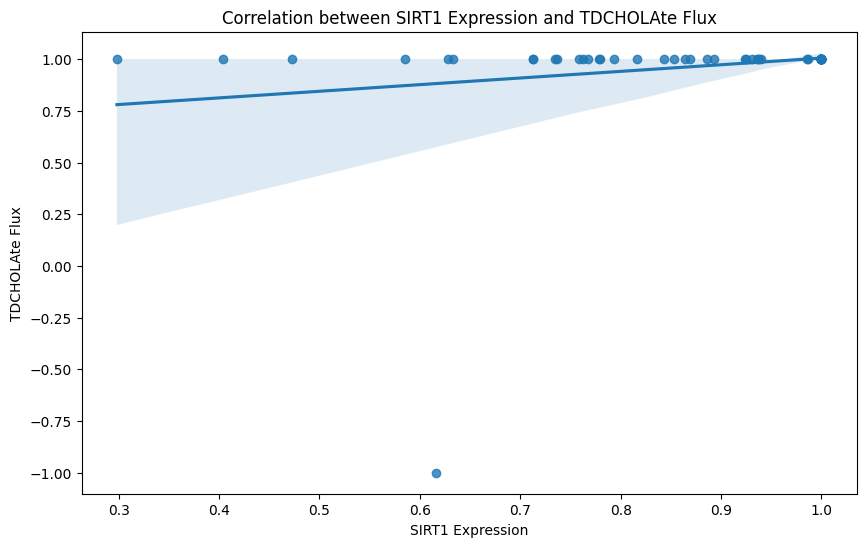

Linear regression results for SIRT1 and TDCHOLAte:
Slope: 0.3206960356967384
Intercept: 0.6841194941413824
R-squared: 0.04577798520446773
P-value: 0.07318891836043265
Standard error: 0.17626473190483746



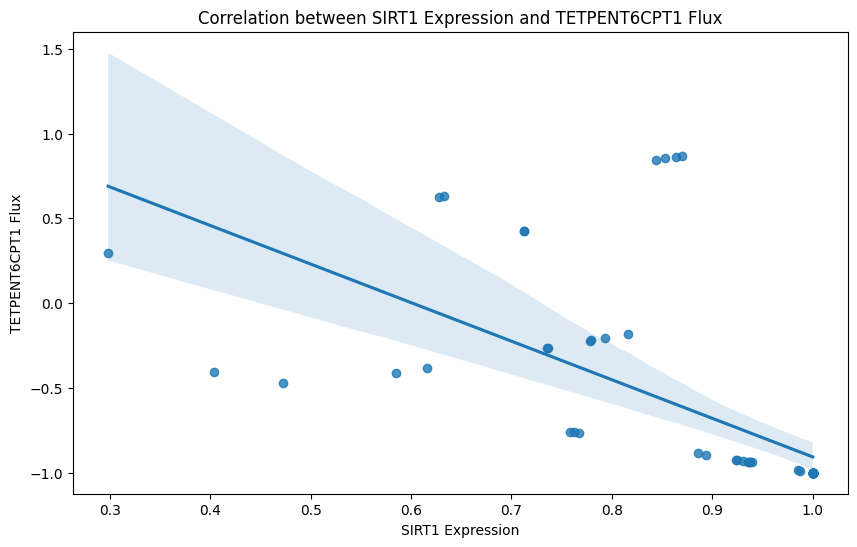

Linear regression results for SIRT1 and TETPENT6CPT1:
Slope: -2.2737654525519293
Intercept: 1.3671409712493254
R-squared: 0.4045391714397057
P-value: 2.5194534865423198e-09
Standard error: 0.33209889194559794



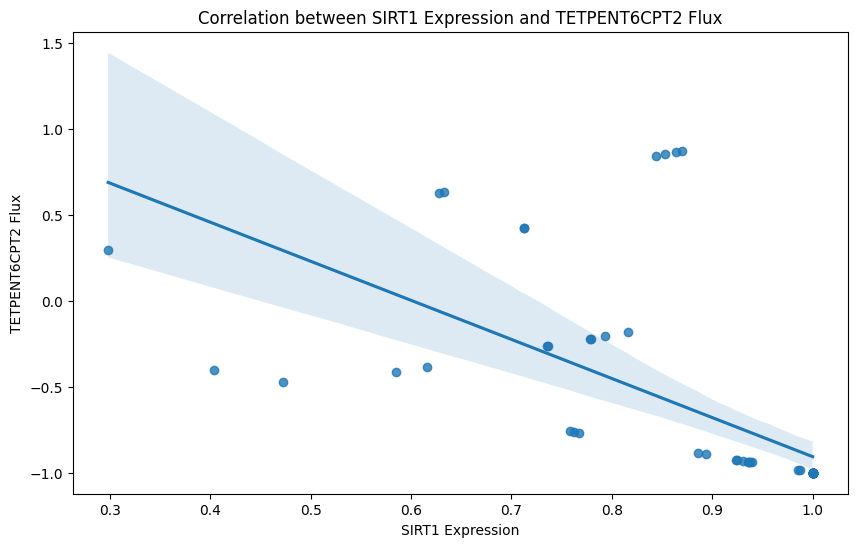

Linear regression results for SIRT1 and TETPENT6CPT2:
Slope: -2.2737654525519293
Intercept: 1.3671409712493254
R-squared: 0.4045391714397057
P-value: 2.5194534865423198e-09
Standard error: 0.33209889194559794



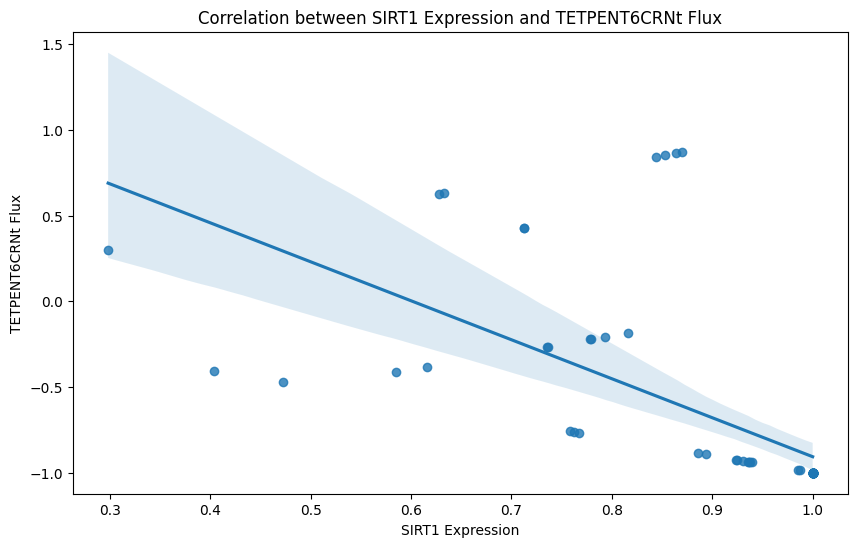

Linear regression results for SIRT1 and TETPENT6CRNt:
Slope: -2.2737654525519293
Intercept: 1.3671409712493254
R-squared: 0.4045391714397057
P-value: 2.5194534865423198e-09
Standard error: 0.33209889194559794



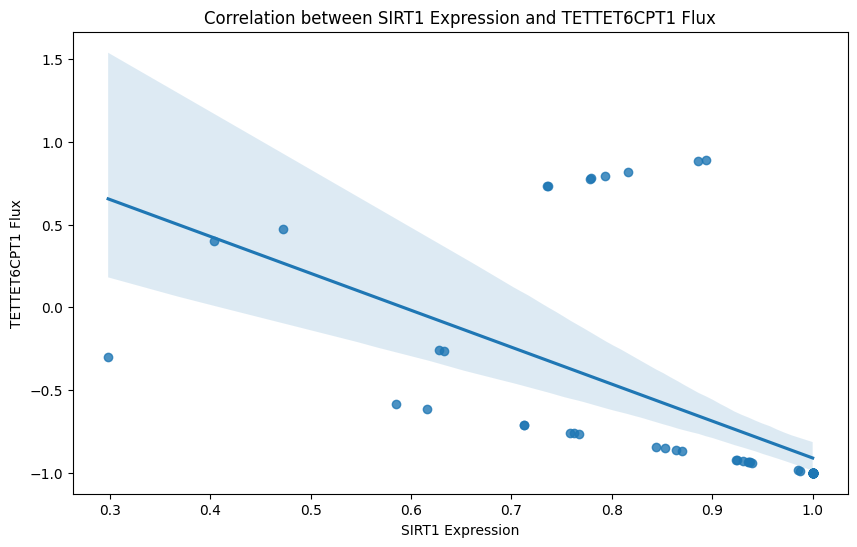

Linear regression results for SIRT1 and TETTET6CPT1:
Slope: -2.2332729205509496
Intercept: 1.322303489749343
R-squared: 0.3461885320374568
P-value: 6.815697552759637e-08
Standard error: 0.3694768079496322



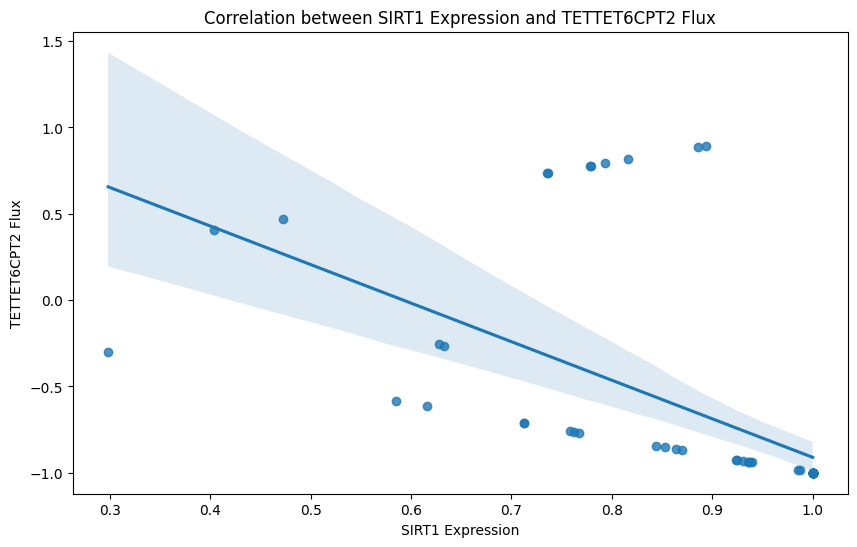

Linear regression results for SIRT1 and TETTET6CPT2:
Slope: -2.2332729205509496
Intercept: 1.322303489749343
R-squared: 0.3461885320374568
P-value: 6.815697552759637e-08
Standard error: 0.3694768079496322



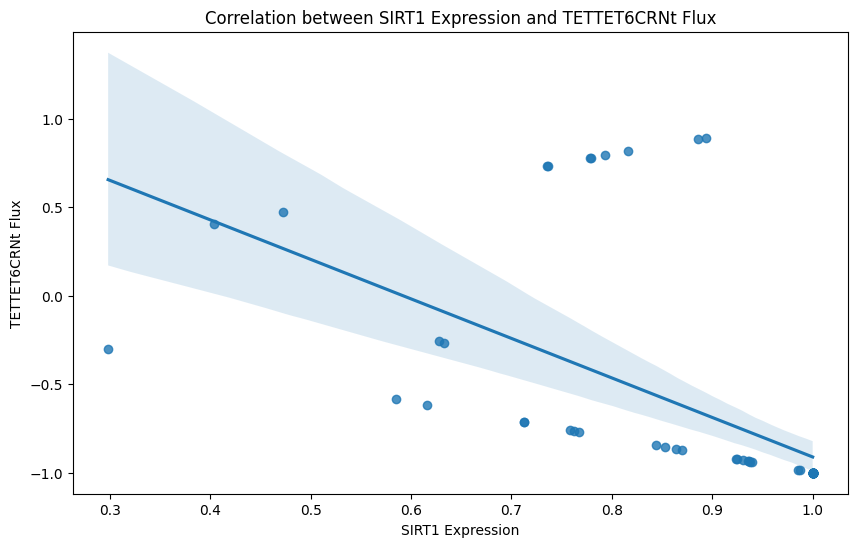

Linear regression results for SIRT1 and TETTET6CRNt:
Slope: -2.2332729205509496
Intercept: 1.322303489749343
R-squared: 0.3461885320374568
P-value: 6.815697552759637e-08
Standard error: 0.3694768079496322



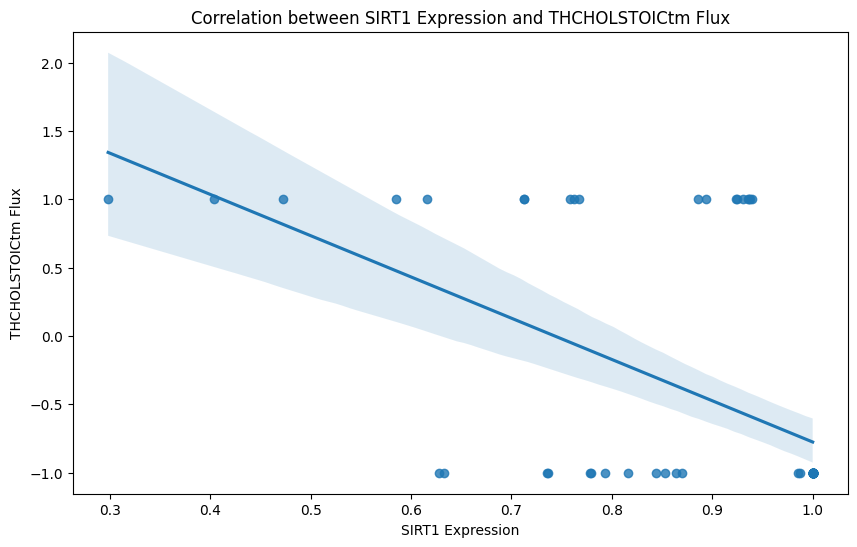

Linear regression results for SIRT1 and THCHOLSTOICtm:
Slope: -3.019053160259966
Intercept: 2.243745804356604
R-squared: 0.28744324535065524
P-value: 1.4450533866656335e-06
Standard error: 0.572242213251848



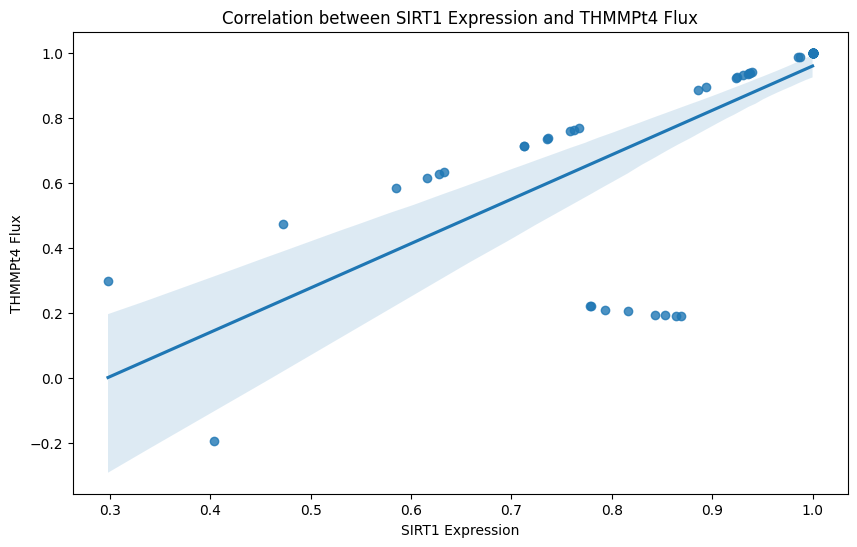

Linear regression results for SIRT1 and THMMPt4:
Slope: 1.365533297754923
Intercept: -0.40638165581787544
R-squared: 0.5394936152212938
P-value: 3.1009992664346997e-13
Standard error: 0.15188064142399077



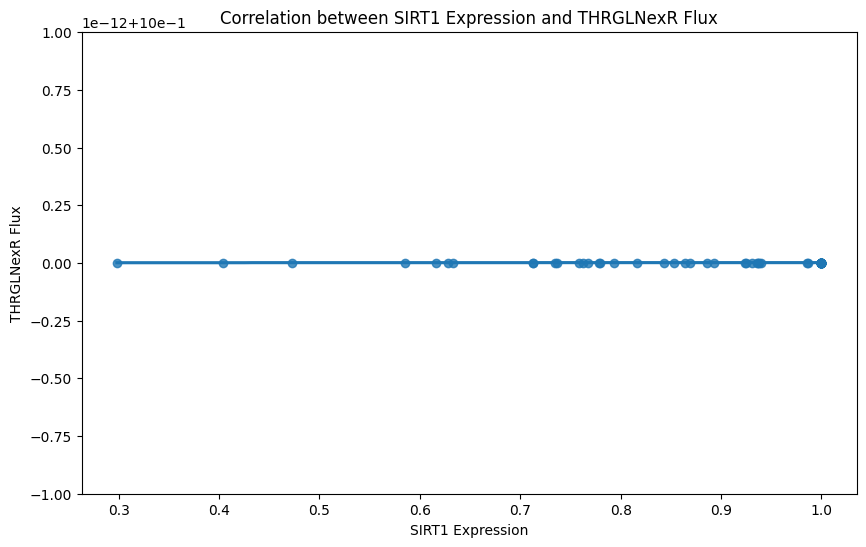

Linear regression results for SIRT1 and THRGLNexR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



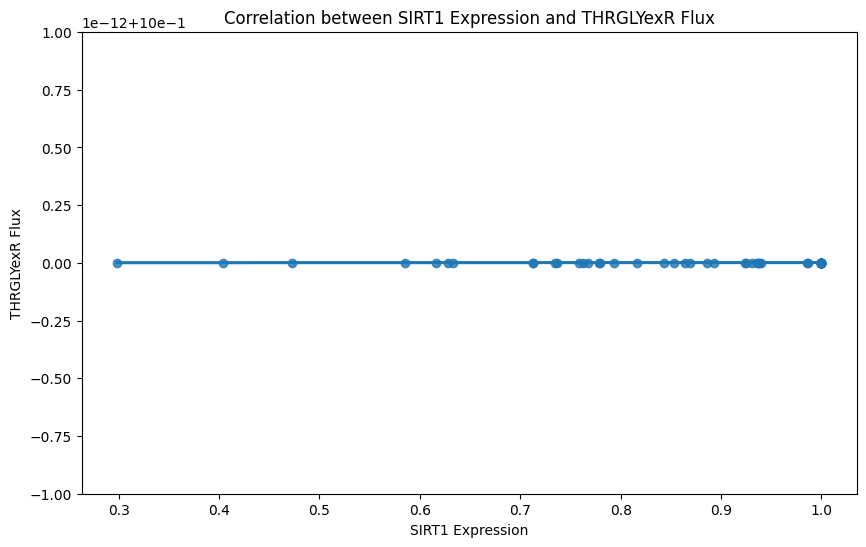

Linear regression results for SIRT1 and THRGLYexR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



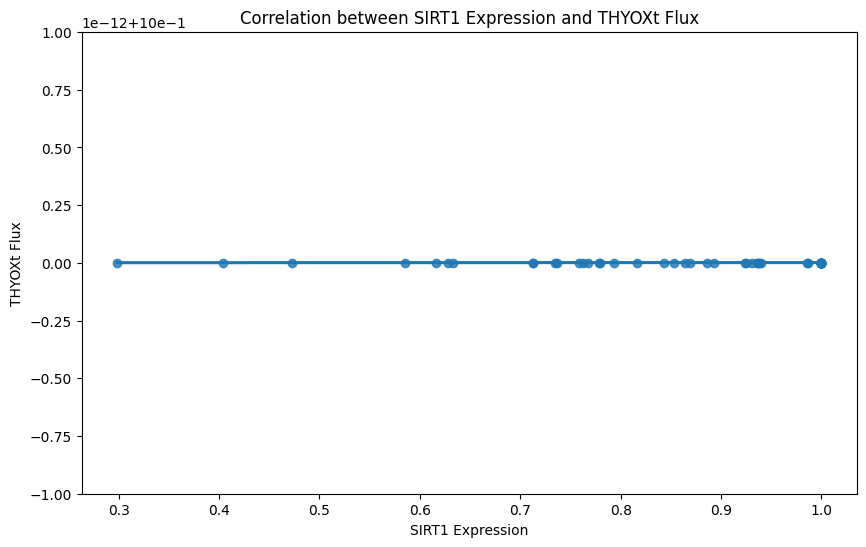

Linear regression results for SIRT1 and THYOXt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



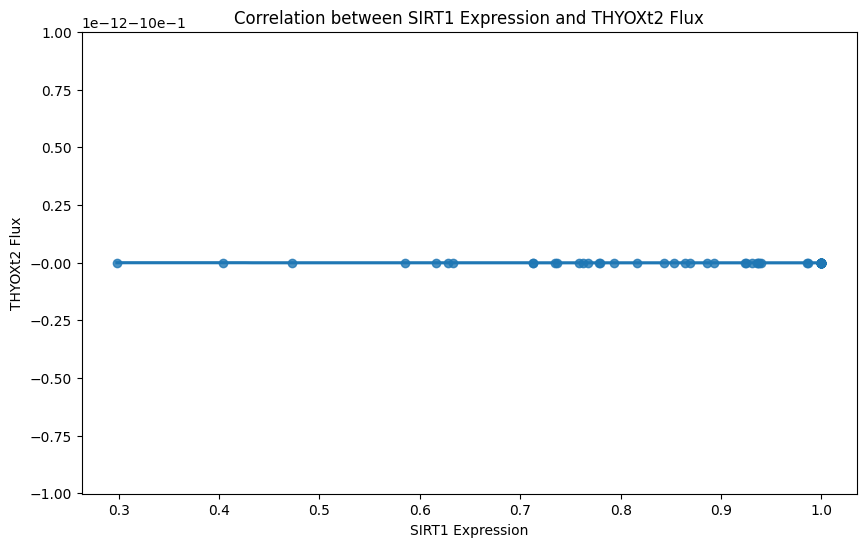

Linear regression results for SIRT1 and THYOXt2:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



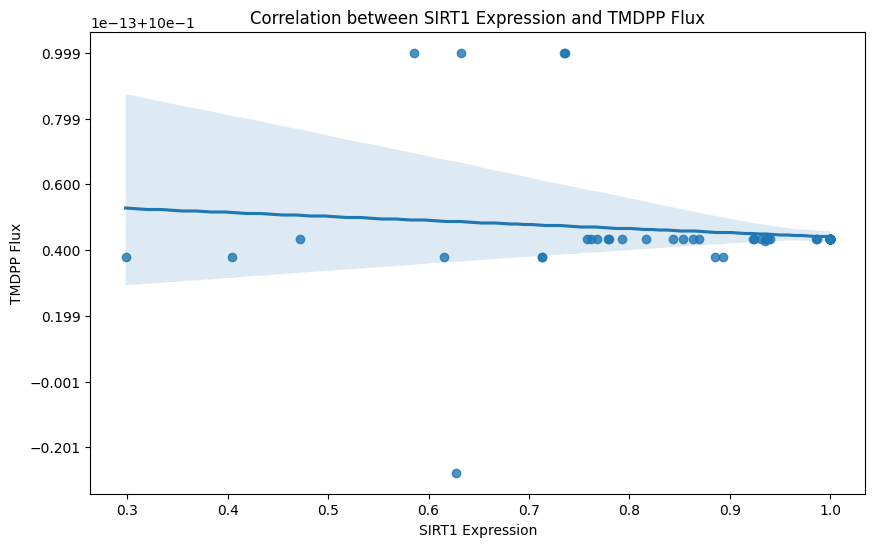

Linear regression results for SIRT1 and TMDPP:
Slope: -1.2628299406051327e-14
Intercept: 0.9999999999999563
R-squared: 0.015620028224800107
P-value: 0.2990433210875449
Standard error: 1.2068708619673273e-14



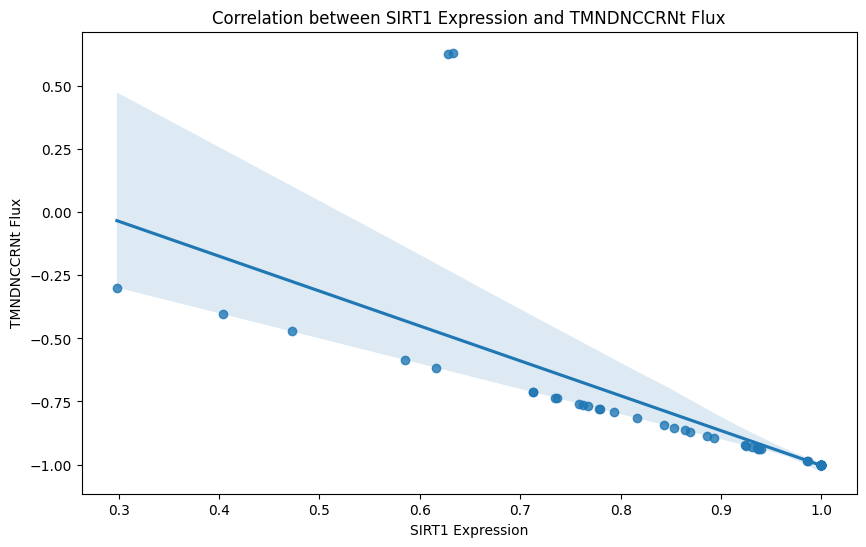

Linear regression results for SIRT1 and TMNDNCCRNt:
Slope: -1.3833640063241646
Intercept: 0.3794361911999088
R-squared: 0.5428039253622658
P-value: 2.410708287751202e-13
Standard error: 0.15284163783919663



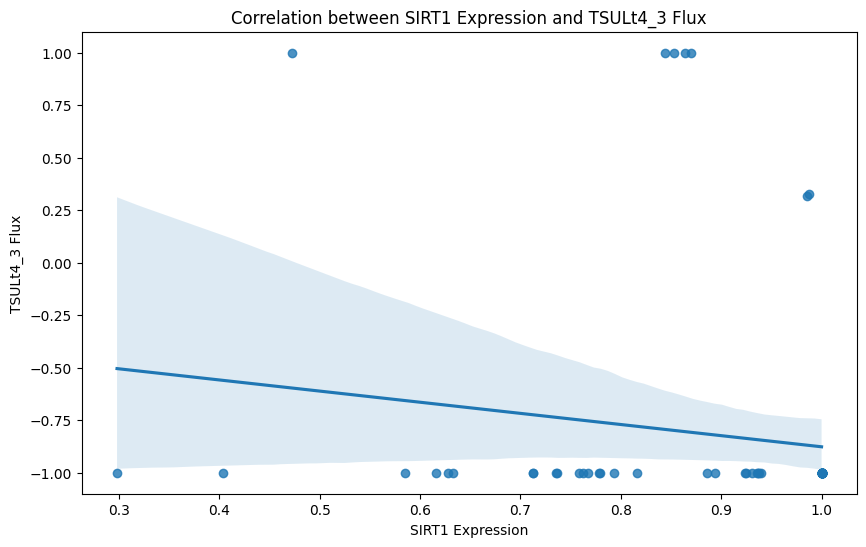

Linear regression results for SIRT1 and TSULt4_3:
Slope: -0.5306460655979359
Intercept: -0.34588239771982754
R-squared: 0.02327357235870189
P-value: 0.20404949427595148
Standard error: 0.41384274638193913



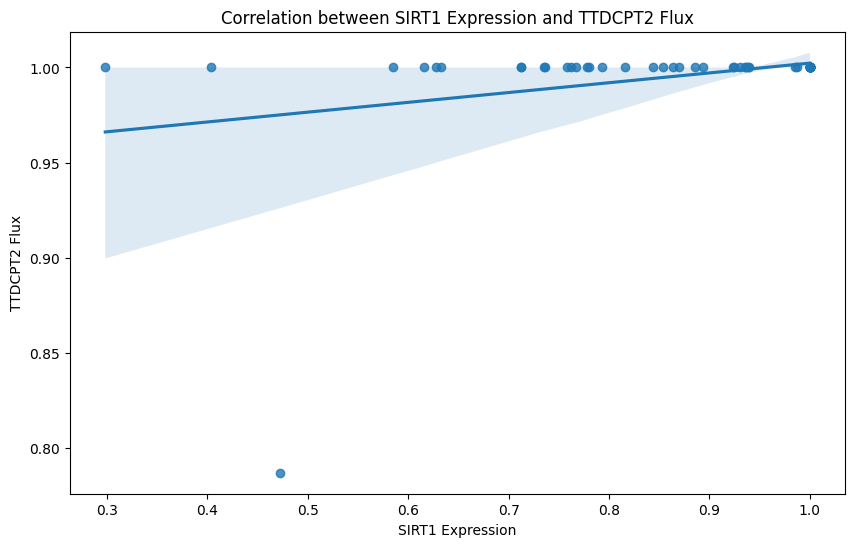

Linear regression results for SIRT1 and TTDCPT2:
Slope: 0.05161118593900522
Intercept: 0.9506945297124836
R-squared: 0.10434974471381847
P-value: 0.006001777378516031
Standard error: 0.01820299394933704



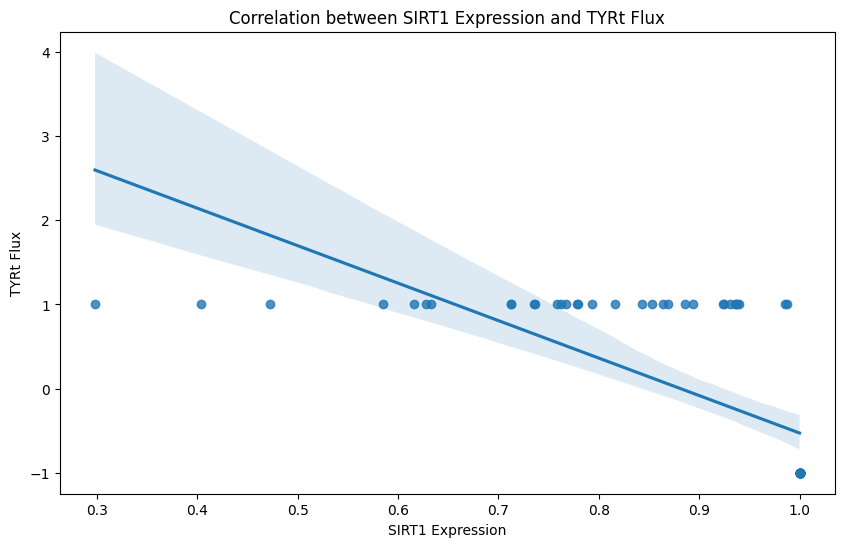

Linear regression results for SIRT1 and TYRt:
Slope: -4.453088333485641
Intercept: 3.924652379405372
R-squared: 0.49271140514695716
P-value: 9.117085759106376e-12
Standard error: 0.543961304034515



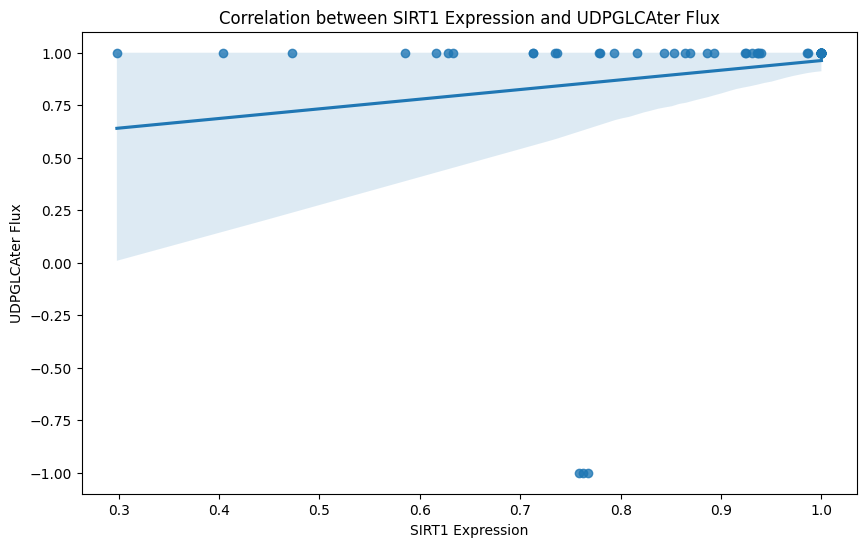

Linear regression results for SIRT1 and UDPGLCAter:
Slope: 0.45995008266419085
Intercept: 0.502850024821238
R-squared: 0.03231162551216465
P-value: 0.13361448303205317
Standard error: 0.30302224700012176



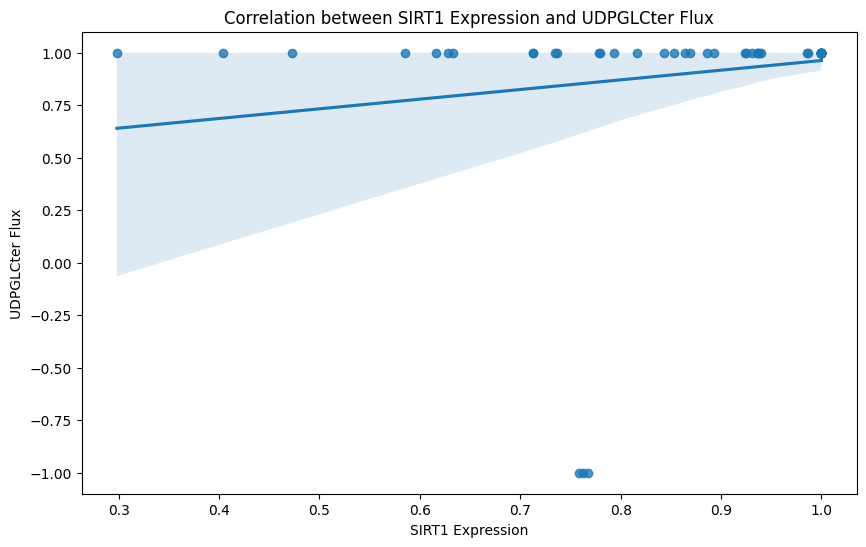

Linear regression results for SIRT1 and UDPGLCter:
Slope: 0.4599498117830473
Intercept: 0.5028503561570392
R-squared: 0.03231158447371463
P-value: 0.13361473388151202
Standard error: 0.3030222673966105



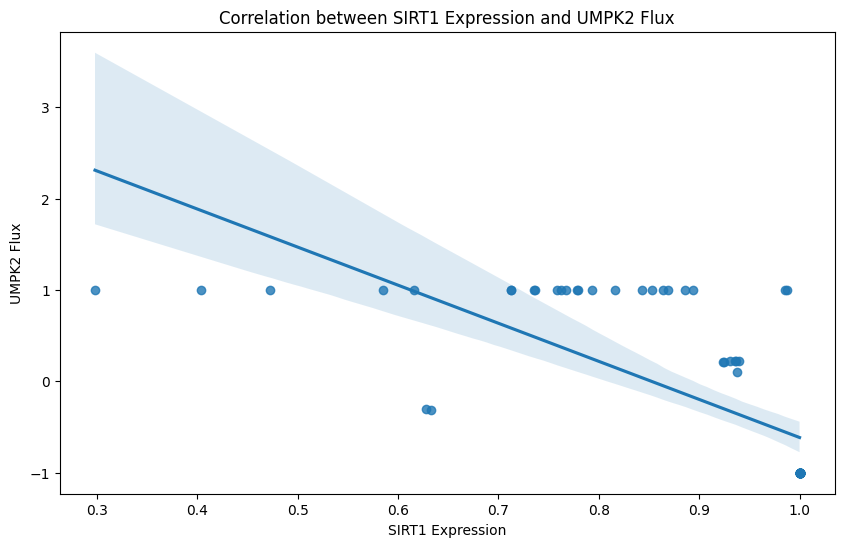

Linear regression results for SIRT1 and UMPK2:
Slope: -4.169139351073726
Intercept: 3.5546278786404693
R-squared: 0.5081943695126135
P-value: 3.0836630223846144e-12
Standard error: 0.4937461131155026



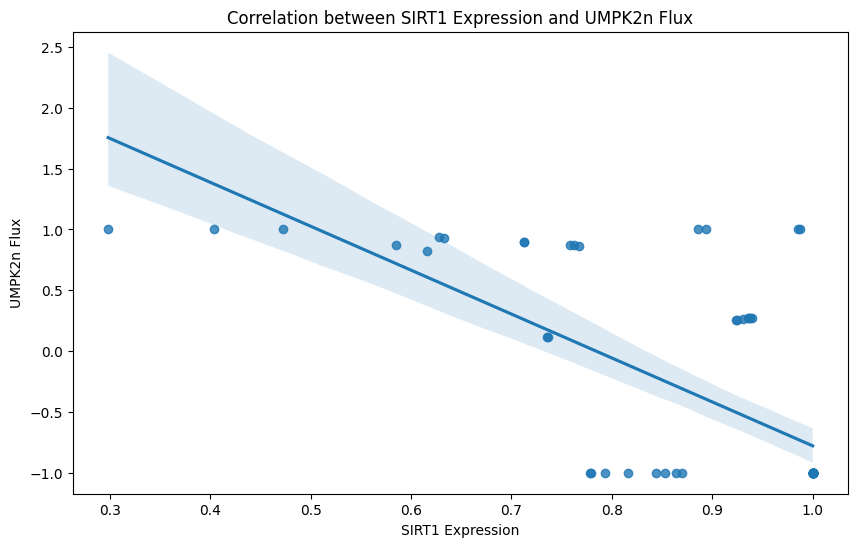

Linear regression results for SIRT1 and UMPK2n:
Slope: -3.6107854975170808
Intercept: 2.831789660554421
R-squared: 0.46917368171919505
P-value: 4.4613137240734034e-11
Standard error: 0.4623666979523937



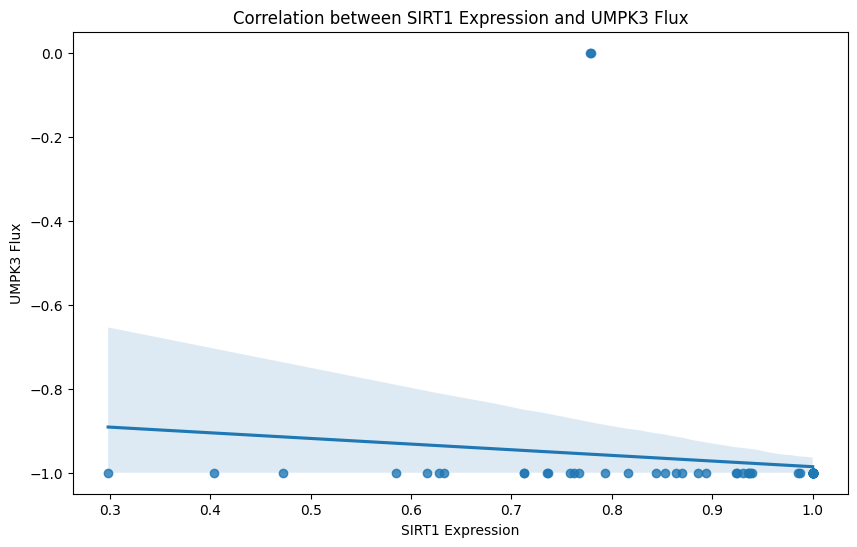

Linear regression results for SIRT1 and UMPK3:
Slope: -0.1346756299046429
Intercept: -0.8509884272156021
R-squared: 0.016358725249495804
P-value: 0.2878007488636839
Standard error: 0.12572108283708866



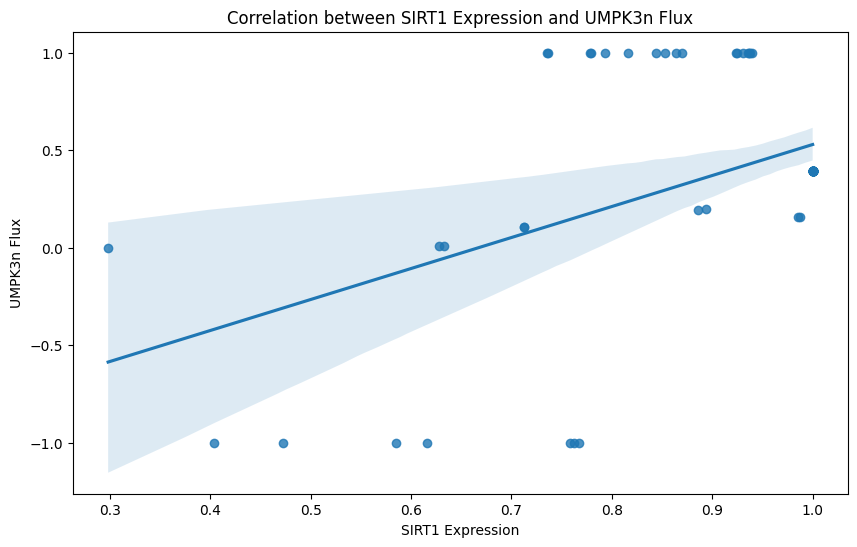

Linear regression results for SIRT1 and UMPK3n:
Slope: 1.5890194640005983
Intercept: -1.059541335164763
R-squared: 0.21519134273892898
P-value: 4.611483909454701e-05
Standard error: 0.3653206034900249



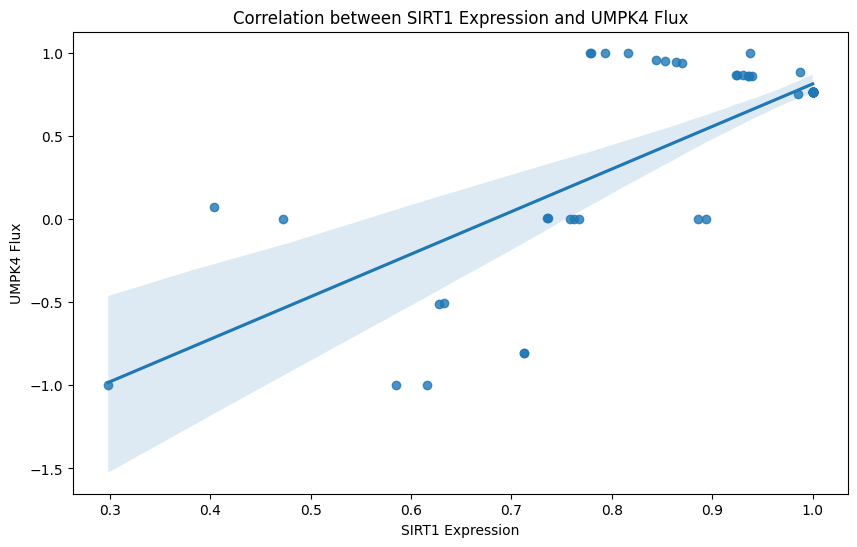

Linear regression results for SIRT1 and UMPK4:
Slope: 2.5587044977671742
Intercept: -1.7462351038471269
R-squared: 0.5796230295028024
P-value: 1.2899718598778489e-14
Standard error: 0.26232653872286



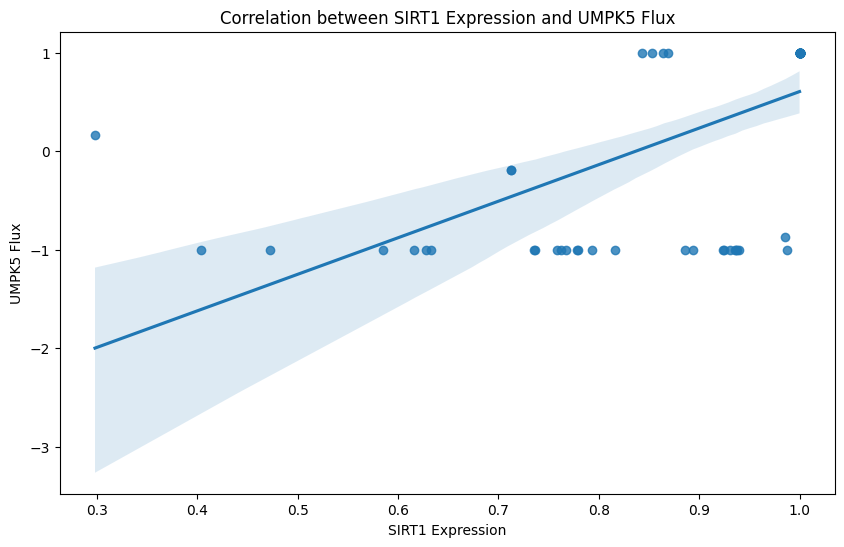

Linear regression results for SIRT1 and UMPK5:
Slope: 3.7107137688617726
Intercept: -3.1049831732900204
R-squared: 0.37597969167859147
P-value: 1.3124512421817005e-08
Standard error: 0.5755062951753116



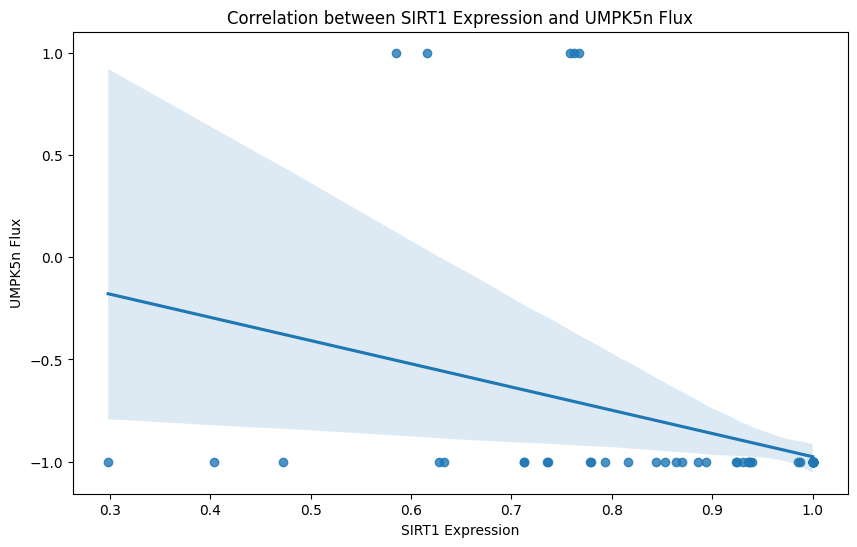

Linear regression results for SIRT1 and UMPK5n:
Slope: -1.1360481190627199
Intercept: 0.16004725155517785
R-squared: 0.12185603582873214
P-value: 0.0028483438988375228
Standard error: 0.36713984399668026



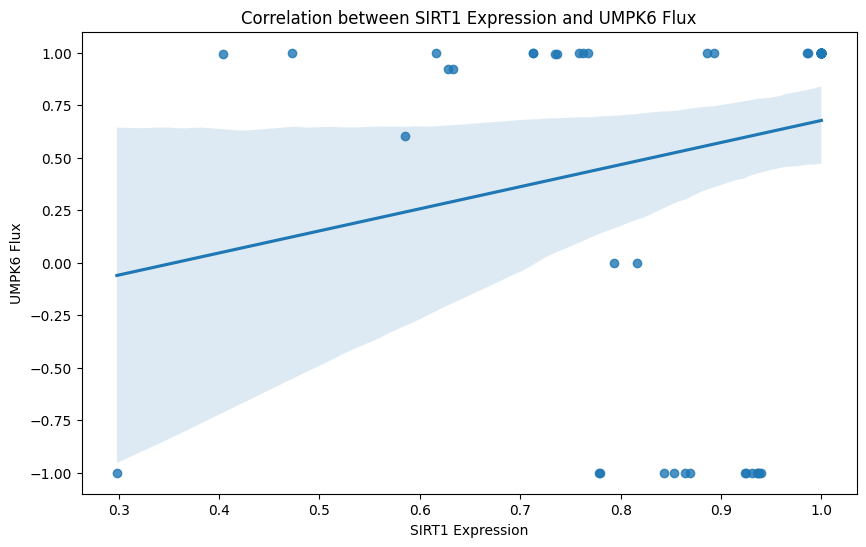

Linear regression results for SIRT1 and UMPK6:
Slope: 1.0518441634878228
Intercept: -0.3742428096945468
R-squared: 0.04315476727307196
P-value: 0.08214490972594995
Standard error: 0.596256759354243



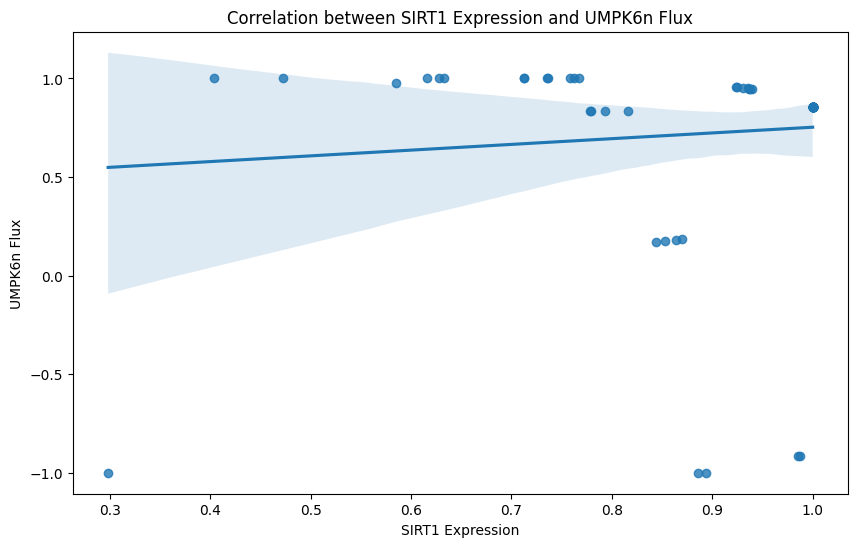

Linear regression results for SIRT1 and UMPK6n:
Slope: 0.2906043242249971
Intercept: 0.46181772843296764
R-squared: 0.008471019504177911
P-value: 0.44523444748339525
Standard error: 0.3784969570481143



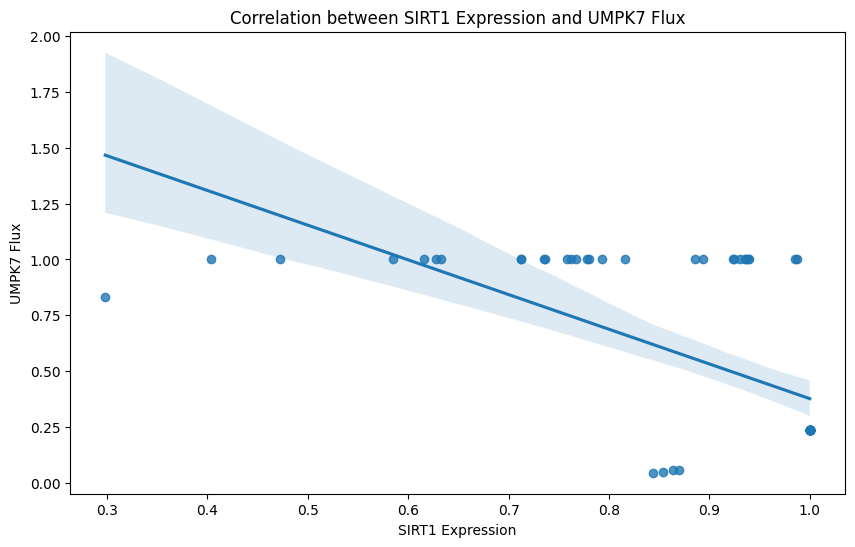

Linear regression results for SIRT1 and UMPK7:
Slope: -1.551253017902982
Intercept: 1.928853015570023
R-squared: 0.40637936088656207
P-value: 2.2594784383719822e-09
Standard error: 0.22570790444697494



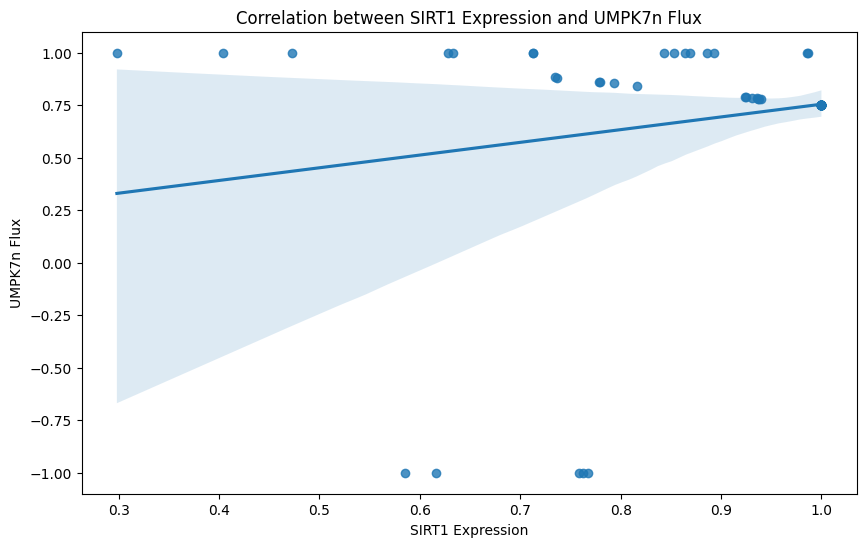

Linear regression results for SIRT1 and UMPK7n:
Slope: 0.6051625110812842
Intercept: 0.14956682022886458
R-squared: 0.039924730478819295
P-value: 0.09479035010427528
Standard error: 0.3572556582002358



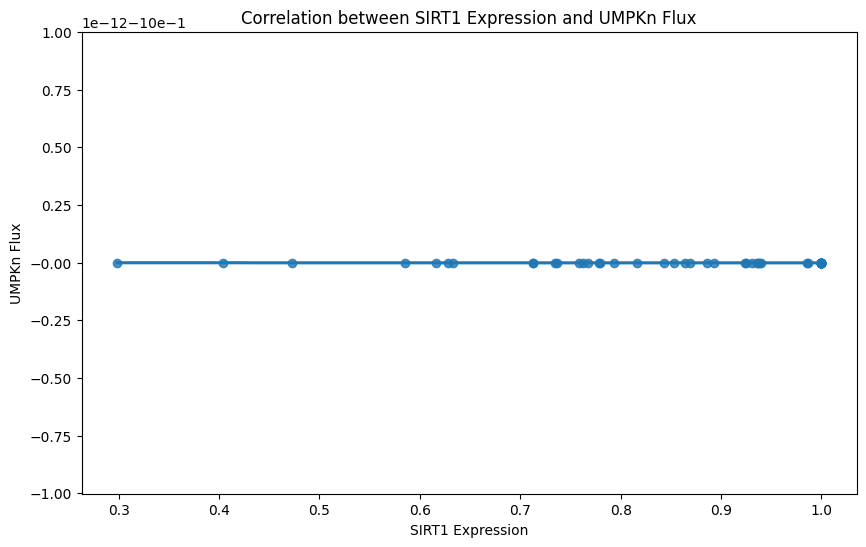

Linear regression results for SIRT1 and UMPKn:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



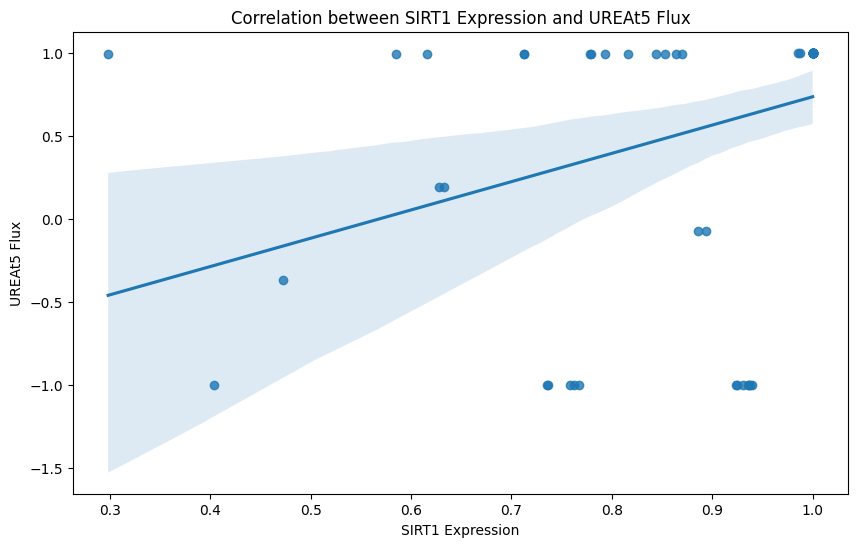

Linear regression results for SIRT1 and UREAt5:
Slope: 1.7022510726913764
Intercept: -0.9671671745946494
R-squared: 0.11631080629346845
P-value: 0.003608771067340622
Standard error: 0.5648573836214505



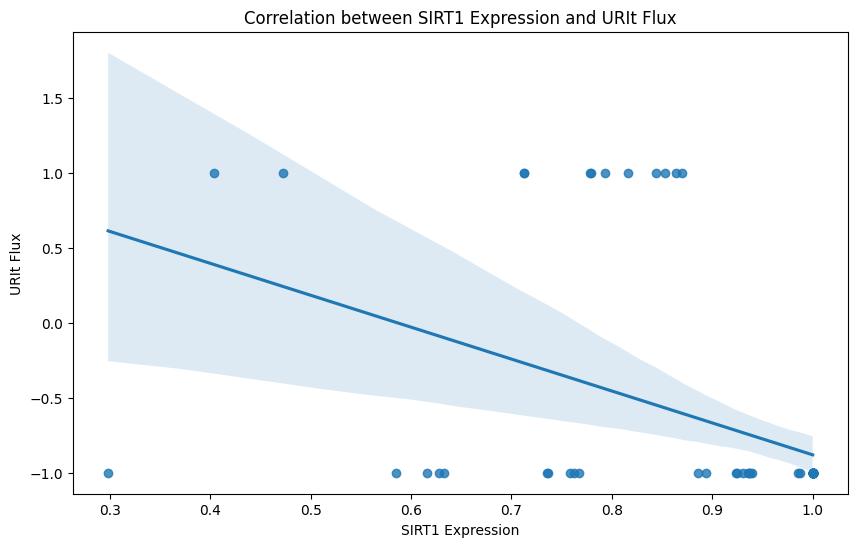

Linear regression results for SIRT1 and URIt:
Slope: -2.127368813406674
Intercept: 1.246590753921581
R-squared: 0.1991681322202743
P-value: 9.585704915490575e-05
Standard error: 0.5135455745597177



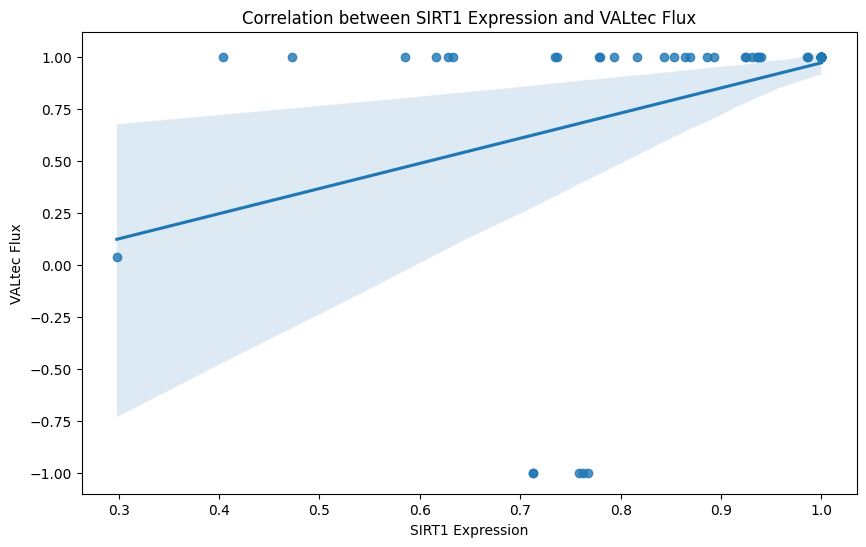

Linear regression results for SIRT1 and VALtec:
Slope: 1.208454642206245
Intercept: -0.23854782065975255
R-squared: 0.13329204500960234
P-value: 0.001744874011263209
Standard error: 0.3709711059710119



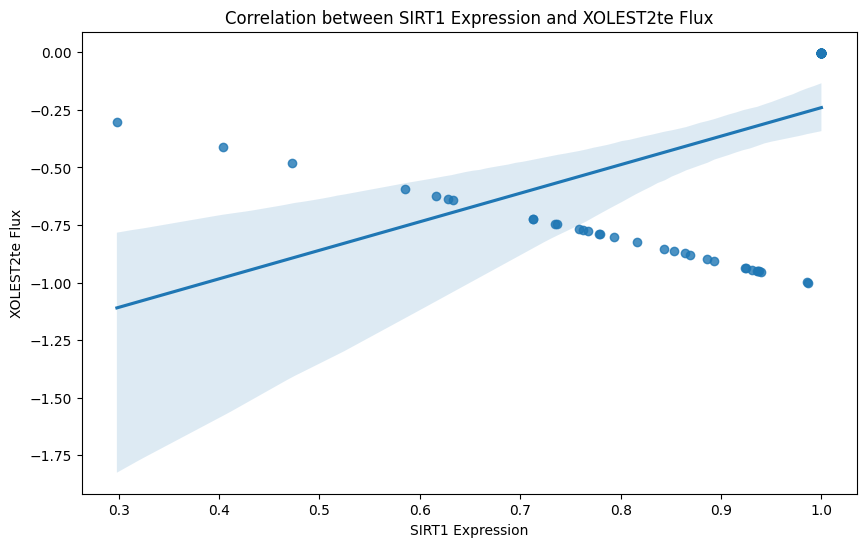

Linear regression results for SIRT1 and XOLEST2te:
Slope: 1.2391284908745666
Intercept: -1.4792459456876708
R-squared: 0.22751165996726552
P-value: 2.6057506687504895e-05
Standard error: 0.2748754378677103



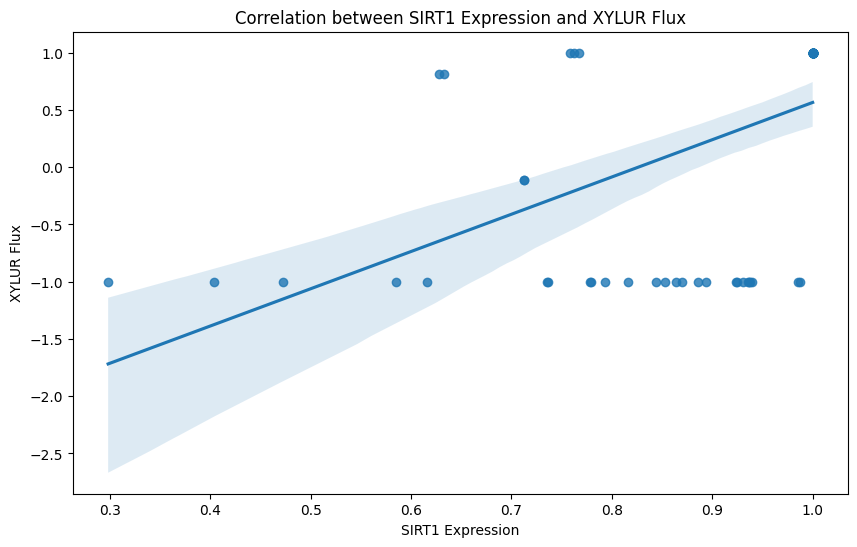

Linear regression results for SIRT1 and XYLUR:
Slope: 3.2540419961519924
Intercept: -2.6882738211689716
R-squared: 0.2878562924644882
P-value: 1.415502504619954e-06
Standard error: 0.6161615093001646



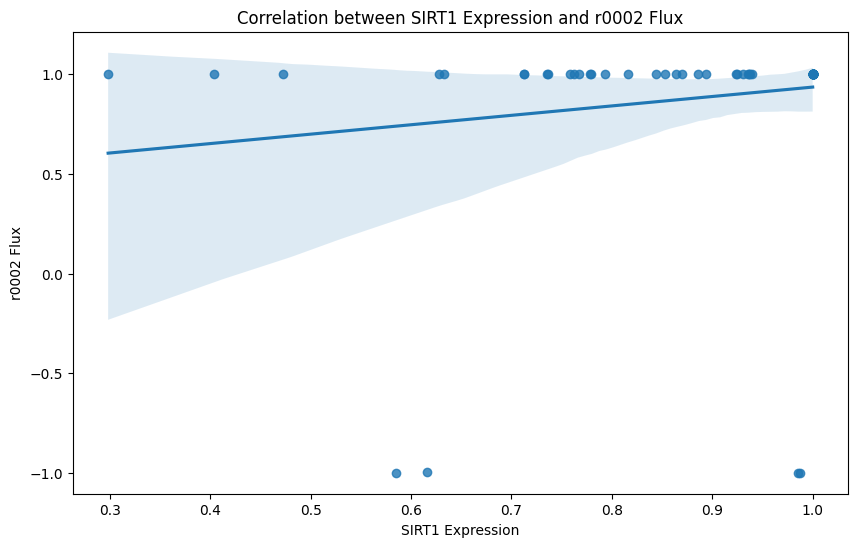

Linear regression results for SIRT1 and r0002:
Slope: 0.47267727414272637
Intercept: 0.4632817415634977
R-squared: 0.02598717716624146
P-value: 0.1792613133658341
Standard error: 0.3483717743954562



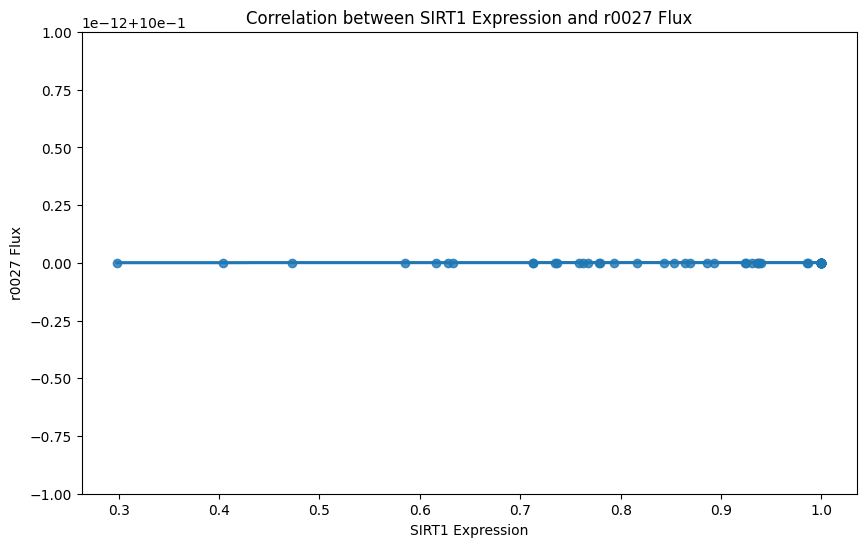

Linear regression results for SIRT1 and r0027:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



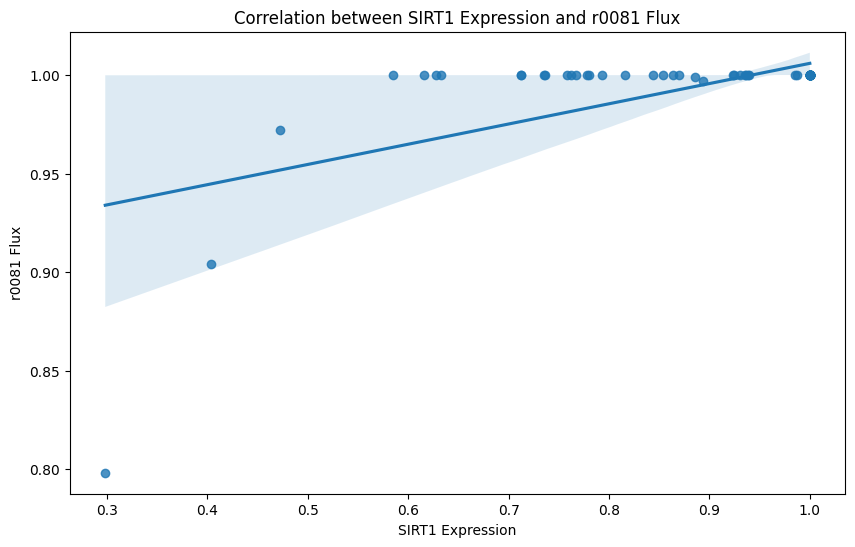

Linear regression results for SIRT1 and r0081:
Slope: 0.10256167710303232
Intercept: 0.9033436563063971
R-squared: 0.3754371318597195
P-value: 1.3533094828175186e-08
Standard error: 0.01592502186020951



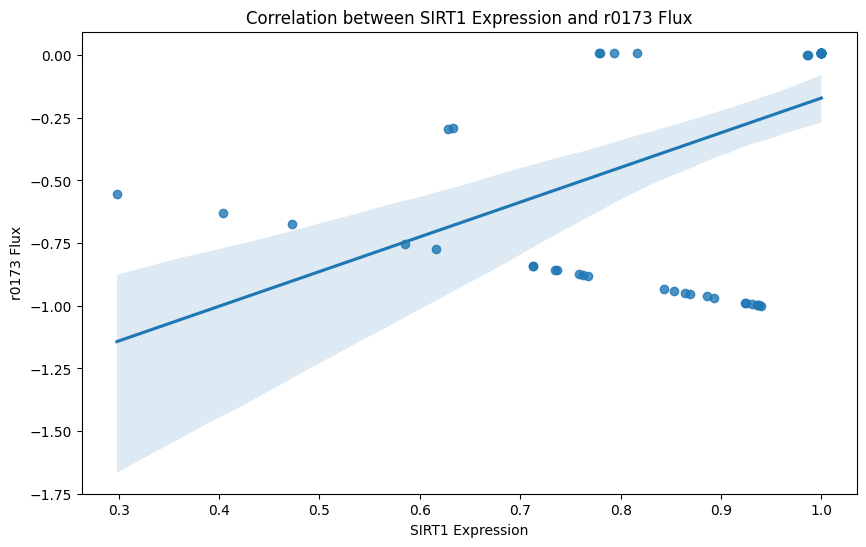

Linear regression results for SIRT1 and r0173:
Slope: 1.3851179967630336
Intercept: -1.5561068875292727
R-squared: 0.2575320180264457
P-value: 6.276883069665291e-06
Standard error: 0.2831297309099621



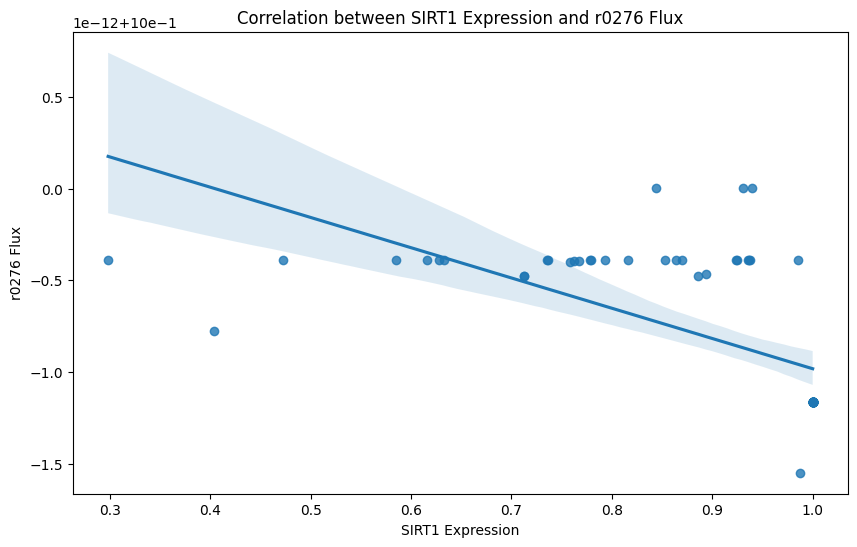

Linear regression results for SIRT1 and r0276:
Slope: -1.6460565211482254e-12
Intercept: 1.0000000000006652
R-squared: 0.399613196669897
P-value: 3.3669434401854725e-09
Standard error: 2.4289347949122674e-13



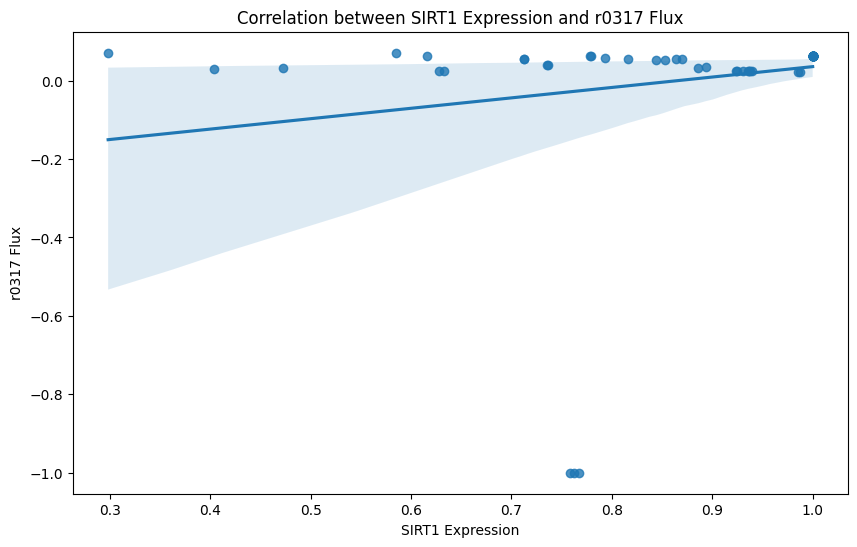

Linear regression results for SIRT1 and r0317:
Slope: 0.2655707992416667
Intercept: -0.2297480989574285
R-squared: 0.038667640842197426
P-value: 0.1002576630662464
Standard error: 0.1594111584415686



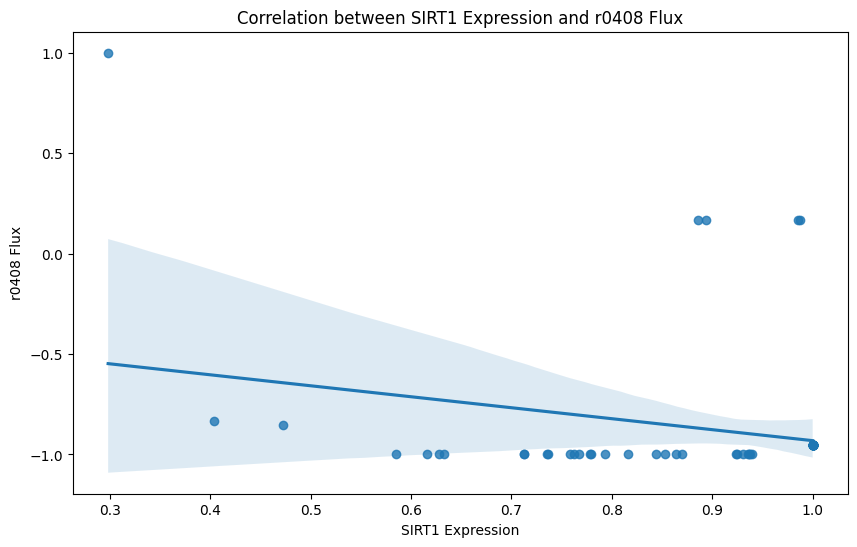

Linear regression results for SIRT1 and r0408:
Slope: -0.5463759094710025
Intercept: -0.3847607513660054
R-squared: 0.06166373432612882
P-value: 0.036790195745156226
Standard error: 0.25658504317758757



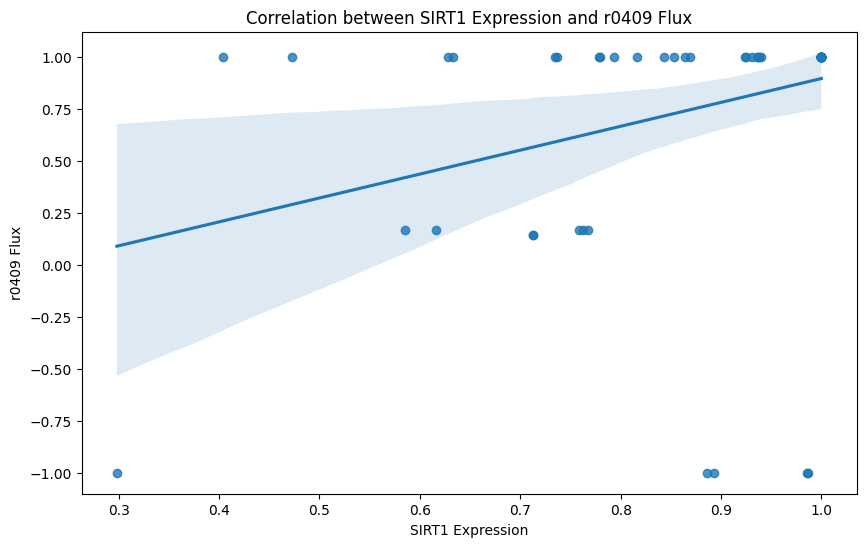

Linear regression results for SIRT1 and r0409:
Slope: 1.1485533447733238
Intercept: -0.2539369071845605
R-squared: 0.1083311289964259
P-value: 0.005068044446099757
Standard error: 0.39669049403784573



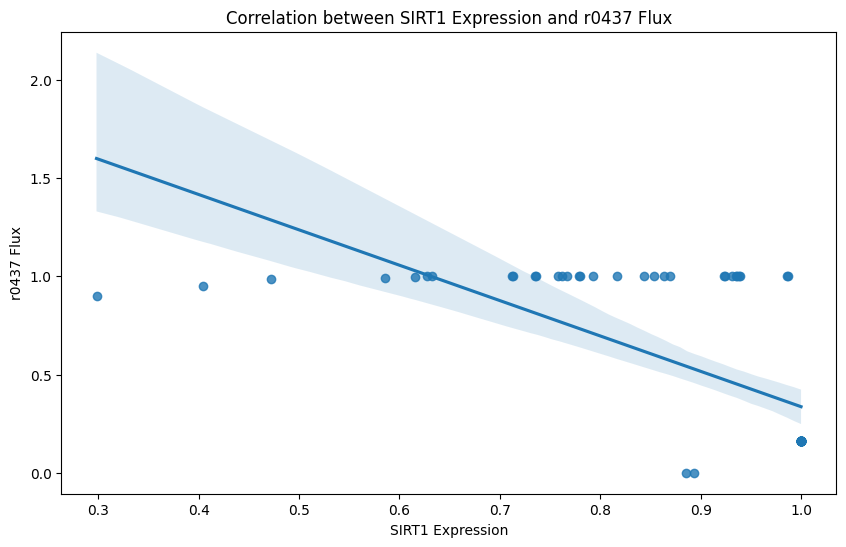

Linear regression results for SIRT1 and r0437:
Slope: -1.8006593135341646
Intercept: 2.1369843115081437
R-squared: 0.4604698987972818
P-value: 7.888264548482706e-11
Standard error: 0.23464657715152146



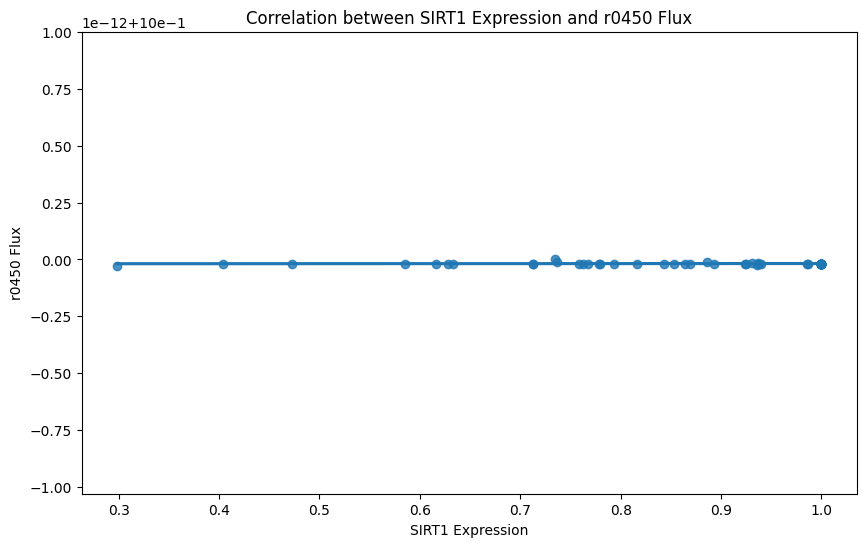

Linear regression results for SIRT1 and r0450:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



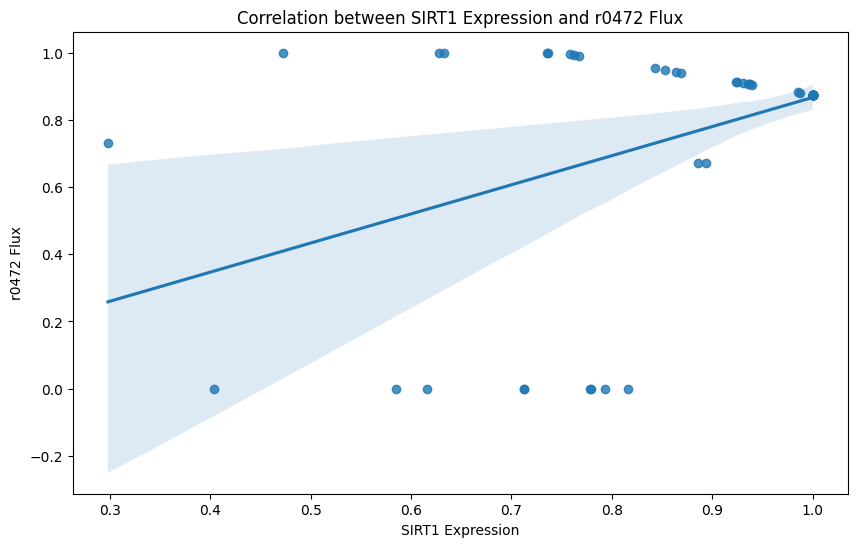

Linear regression results for SIRT1 and r0472:
Slope: 0.8668383332553378
Intercept: -3.243647929684901e-05
R-squared: 0.20385253396278954
P-value: 7.74892998945389e-05
Standard error: 0.20623020073439288



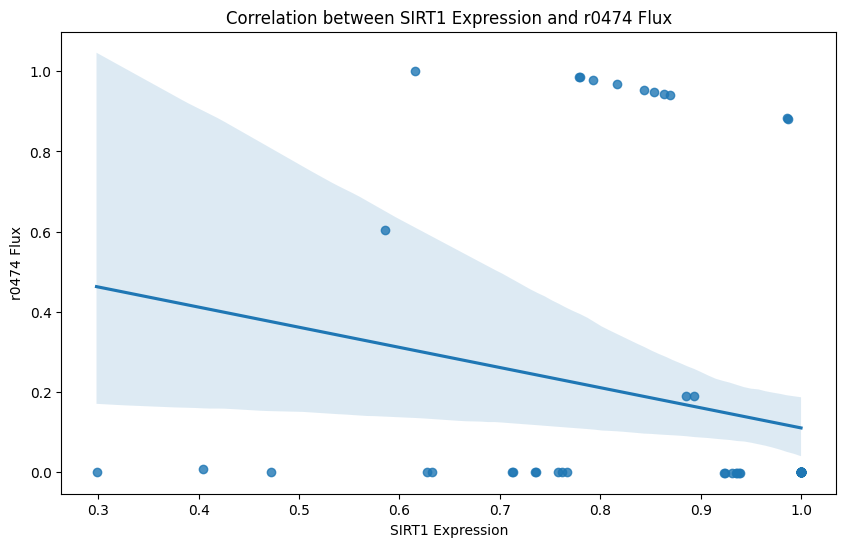

Linear regression results for SIRT1 and r0474:
Slope: -0.5026999317088783
Intercept: 0.6123128702792798
R-squared: 0.05176913642224784
P-value: 0.056356532967106236
Standard error: 0.2590036378829065



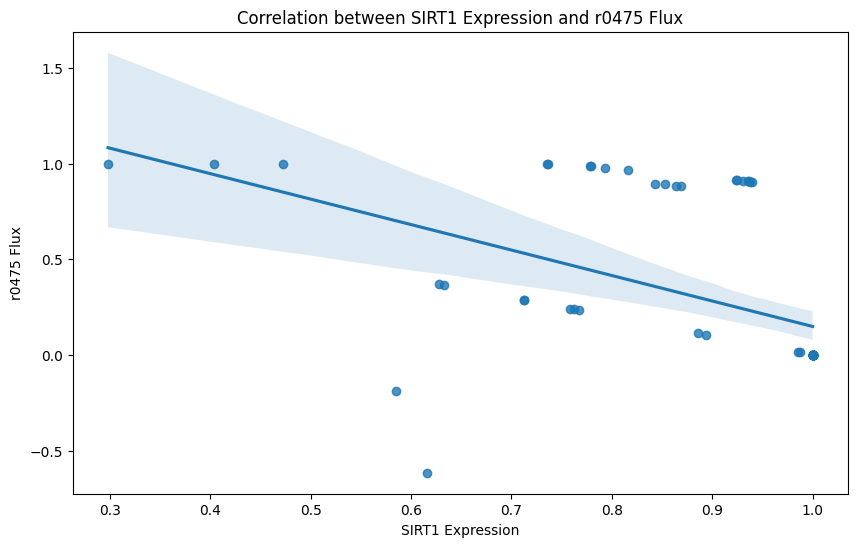

Linear regression results for SIRT1 and r0475:
Slope: -1.3302687240119453
Intercept: 1.47931384627659
R-squared: 0.23896327752784524
P-value: 1.5225026750485132e-05
Standard error: 0.2857933102025151



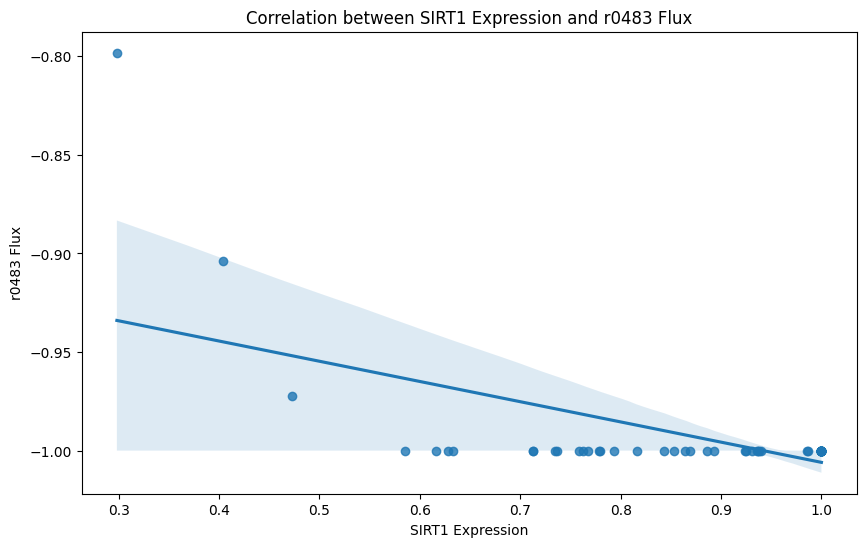

Linear regression results for SIRT1 and r0483:
Slope: -0.10254859013715918
Intercept: -0.9034129966203988
R-squared: 0.3751333362118147
P-value: 1.3767251311291382e-08
Standard error: 0.01593330966852077



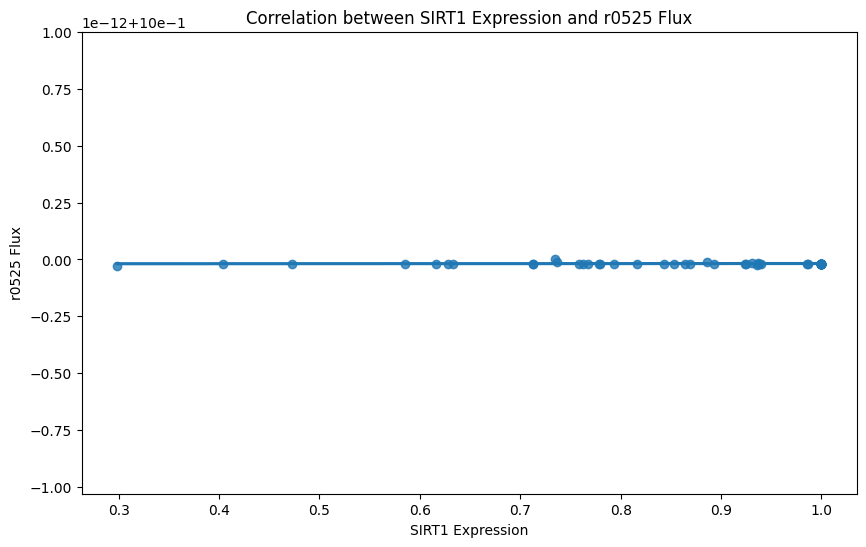

Linear regression results for SIRT1 and r0525:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



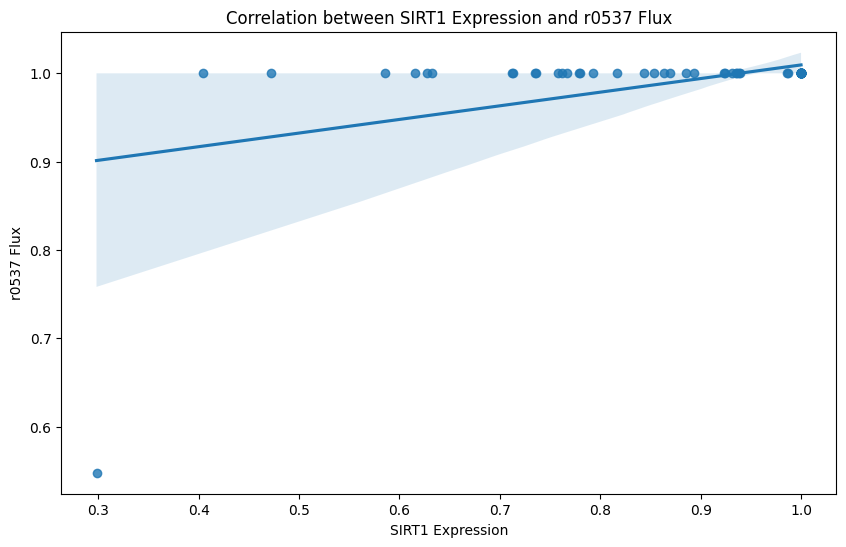

Linear regression results for SIRT1 and r0537:
Slope: 0.15425979875386742
Intercept: 0.8552383343637217
R-squared: 0.2072618539693404
P-value: 6.633427550944087e-05
Standard error: 0.03631896001429804



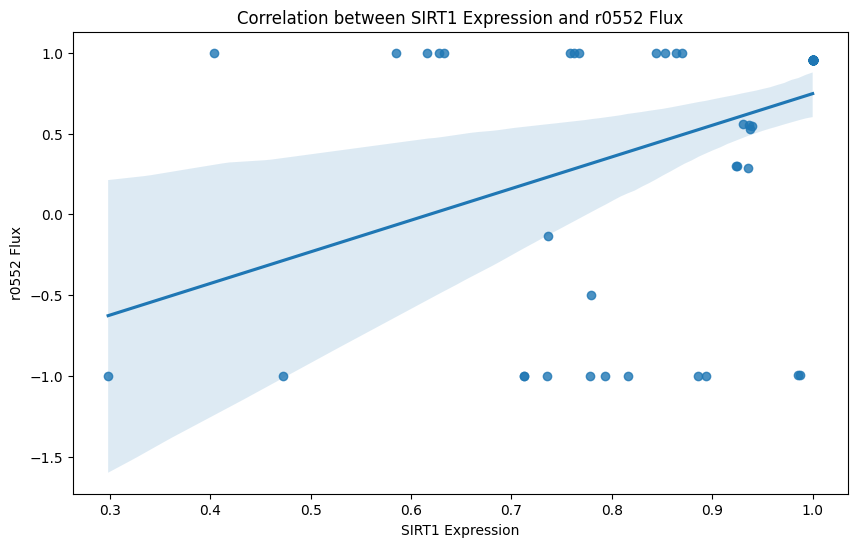

Linear regression results for SIRT1 and r0552:
Slope: 1.9581865725984446
Intercept: -1.2113174835912024
R-squared: 0.171602402012659
P-value: 0.0003289738886096822
Standard error: 0.5179493078640393



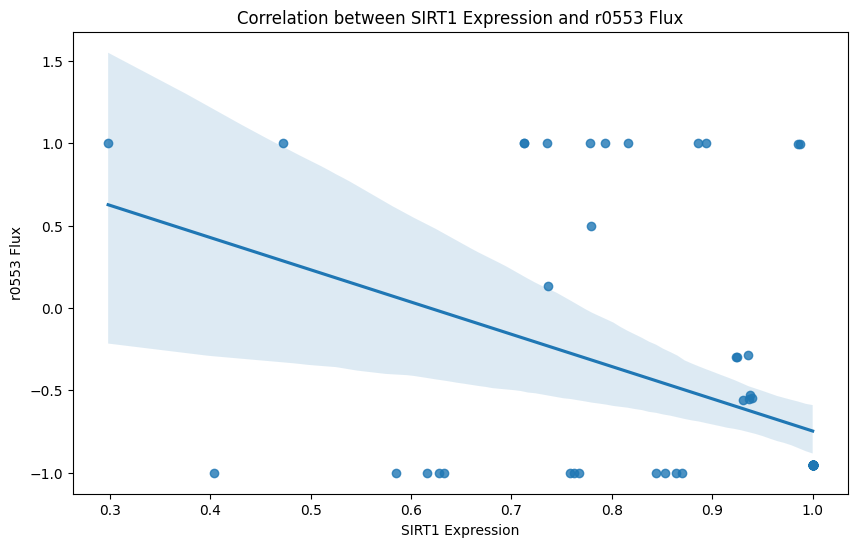

Linear regression results for SIRT1 and r0553:
Slope: -1.9581865725984446
Intercept: 1.2113174835912024
R-squared: 0.171602402012659
P-value: 0.0003289738886096822
Standard error: 0.5179493078640393



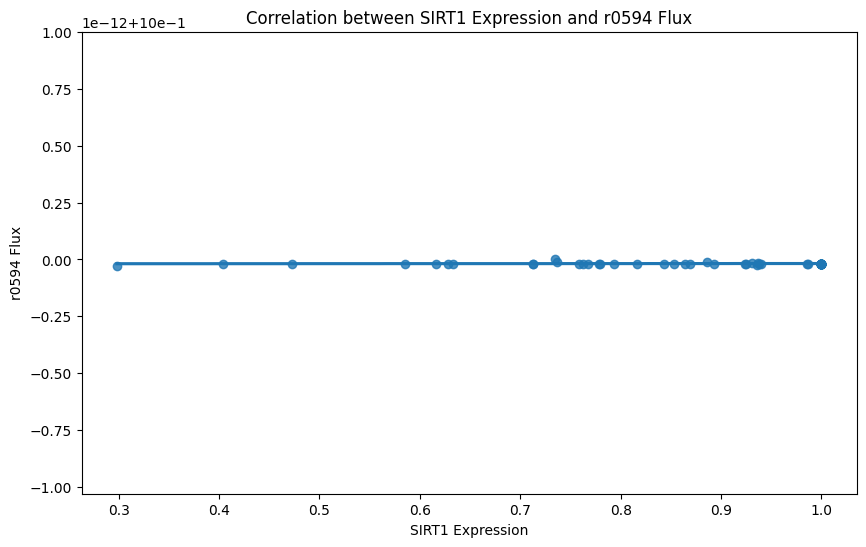

Linear regression results for SIRT1 and r0594:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



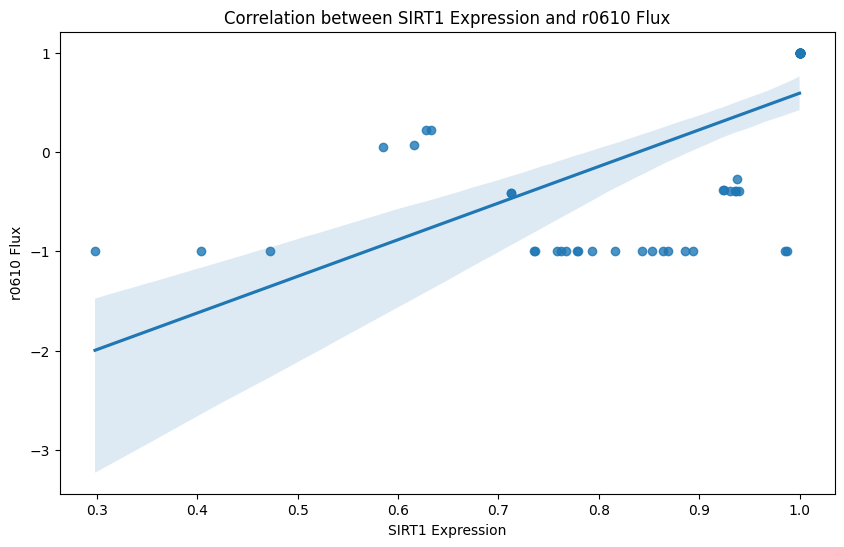

Linear regression results for SIRT1 and r0610:
Slope: 3.6882784108644517
Intercept: -3.0958057966384915
R-squared: 0.4247986934390562
P-value: 7.459418925598921e-10
Standard error: 0.5166750579896656



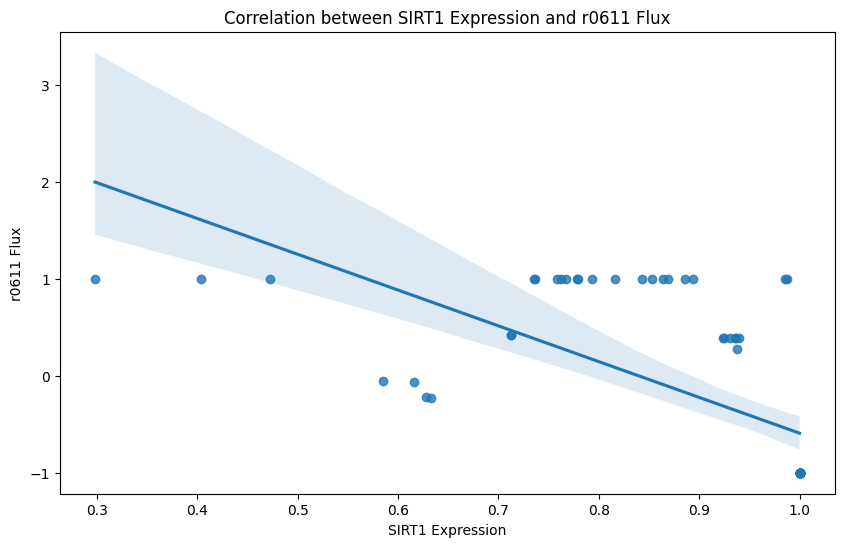

Linear regression results for SIRT1 and r0611:
Slope: -3.6882784108644517
Intercept: 3.0958057966384915
R-squared: 0.4247986934390562
P-value: 7.459418925598921e-10
Standard error: 0.5166750579896656



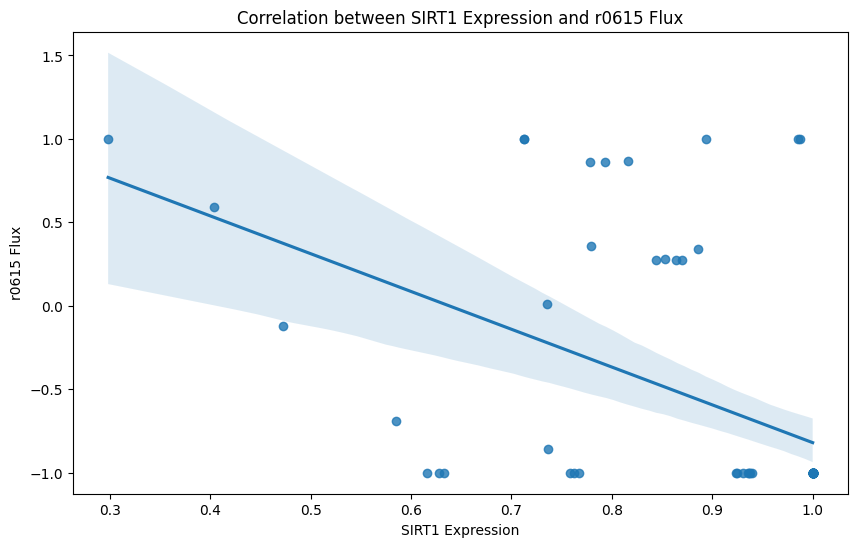

Linear regression results for SIRT1 and r0615:
Slope: -2.263730629164079
Intercept: 1.443943393667278
R-squared: 0.24382209246111444
P-value: 1.209612972966892e-05
Standard error: 0.4799275345475242



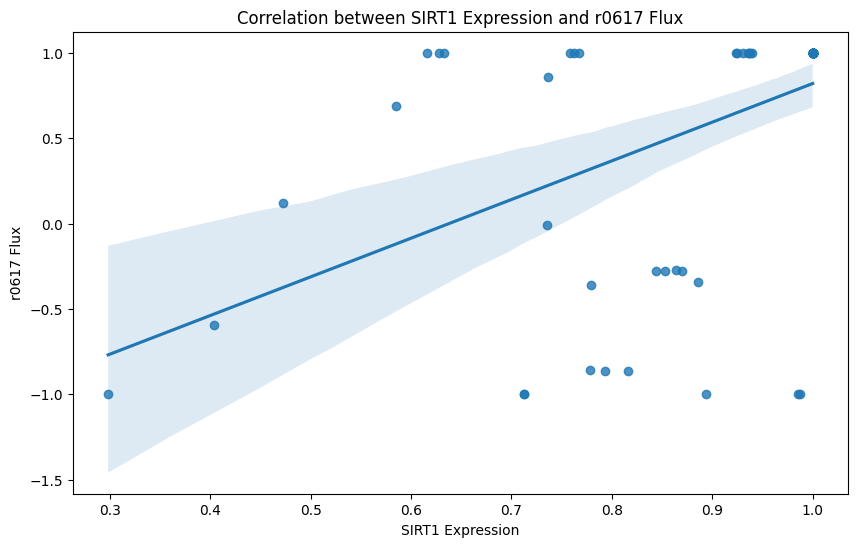

Linear regression results for SIRT1 and r0617:
Slope: 2.263730629164079
Intercept: -1.443943393667278
R-squared: 0.24382209246111444
P-value: 1.209612972966892e-05
Standard error: 0.4799275345475242



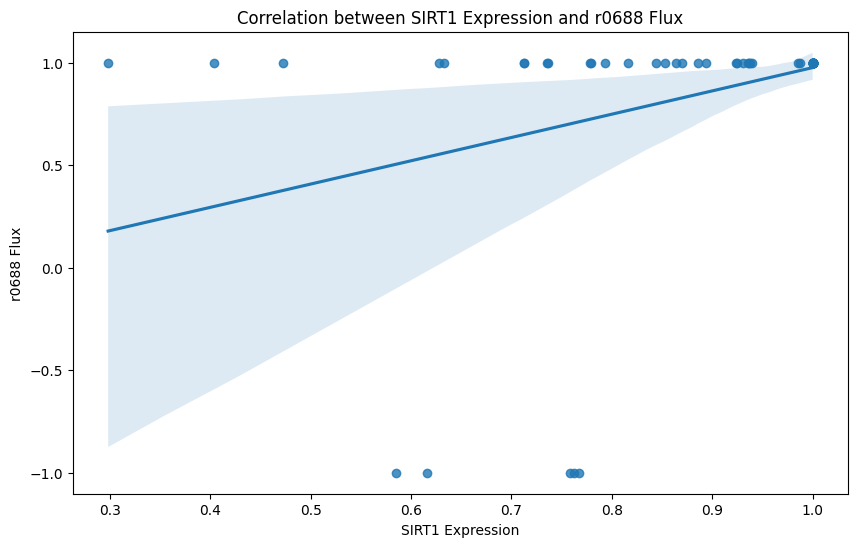

Linear regression results for SIRT1 and r0688:
Slope: 1.1360481190627199
Intercept: -0.16004725155517785
R-squared: 0.12185603582873214
P-value: 0.0028483438988375228
Standard error: 0.36713984399668026



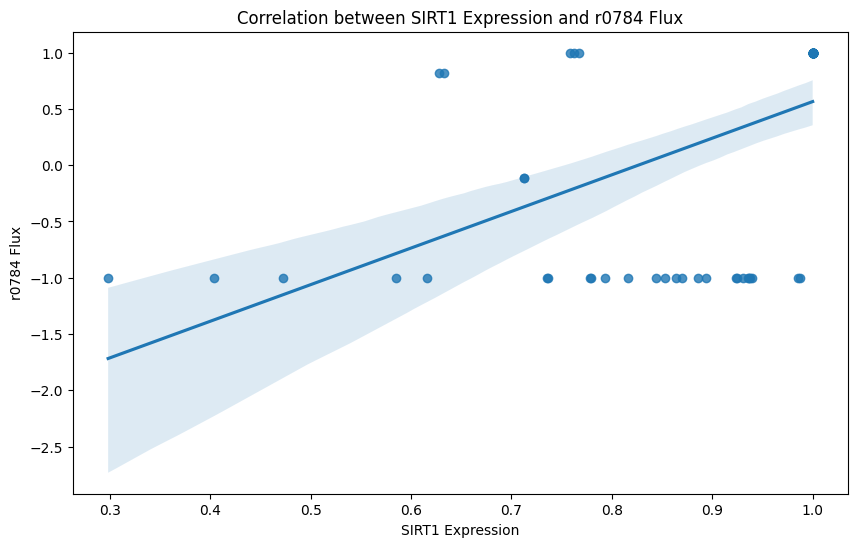

Linear regression results for SIRT1 and r0784:
Slope: 3.2540419961519924
Intercept: -2.6882738211689716
R-squared: 0.2878562924644882
P-value: 1.415502504619954e-06
Standard error: 0.6161615093001646



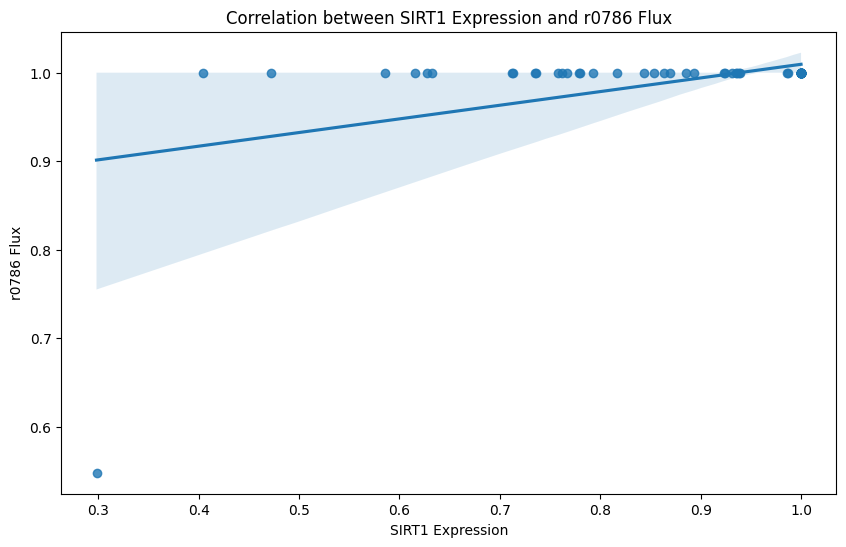

Linear regression results for SIRT1 and r0786:
Slope: 0.15425979875386742
Intercept: 0.8552383343637217
R-squared: 0.2072618539693404
P-value: 6.633427550944087e-05
Standard error: 0.03631896001429804



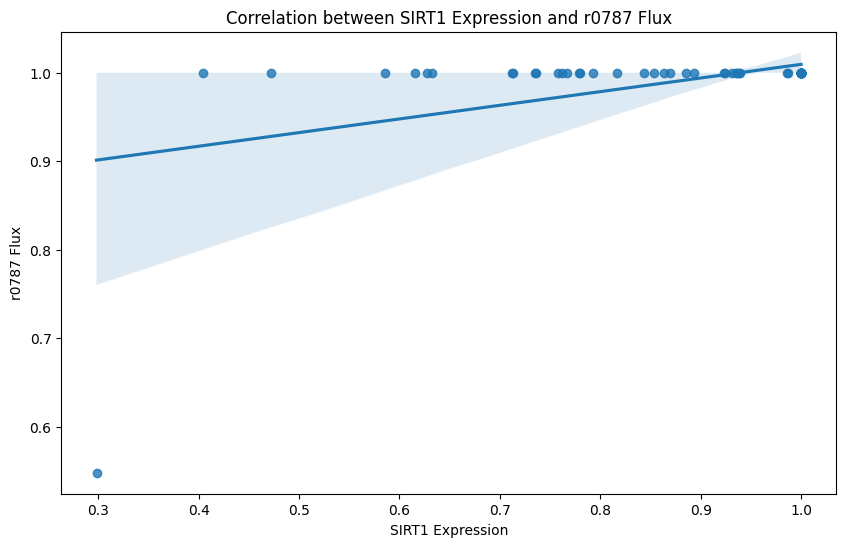

Linear regression results for SIRT1 and r0787:
Slope: 0.15425979875386742
Intercept: 0.8552383343637217
R-squared: 0.2072618539693404
P-value: 6.633427550944087e-05
Standard error: 0.03631896001429804



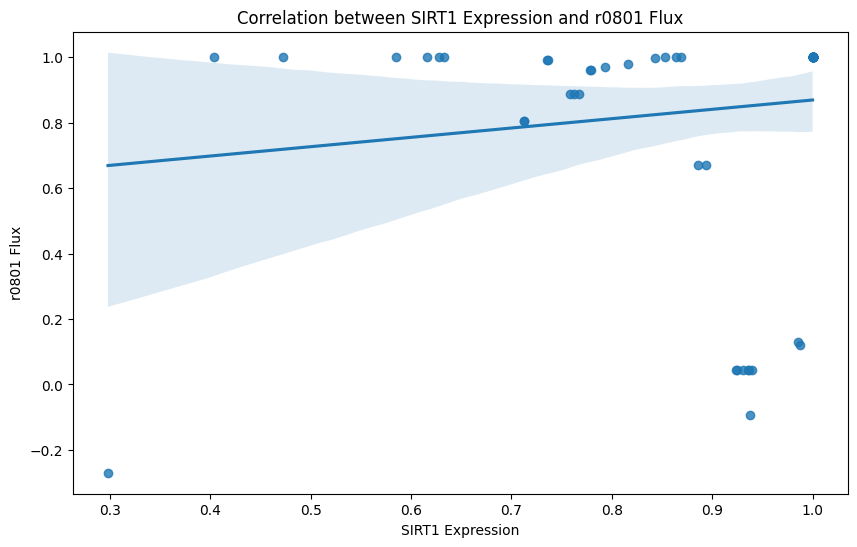

Linear regression results for SIRT1 and r0801:
Slope: 0.28539664512624263
Intercept: 0.5837379706883825
R-squared: 0.017186601271846572
P-value: 0.2758221833490909
Standard error: 0.25981537753018236



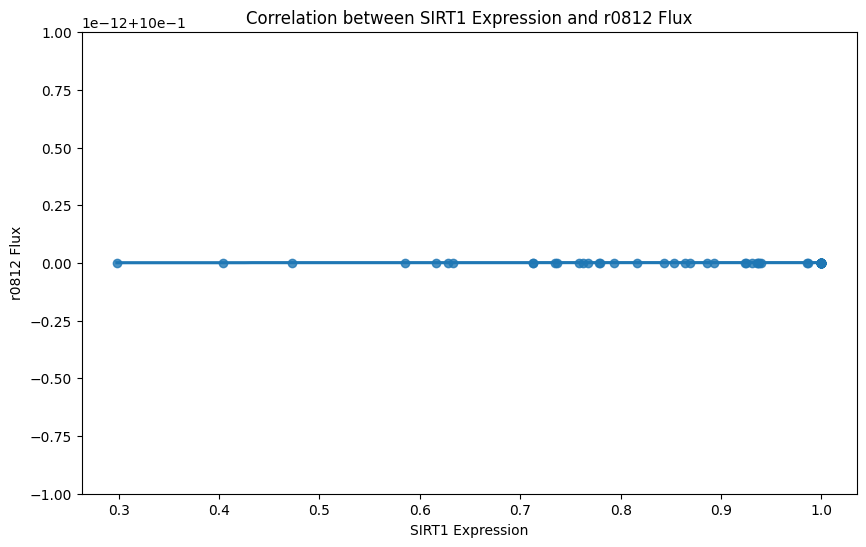

Linear regression results for SIRT1 and r0812:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



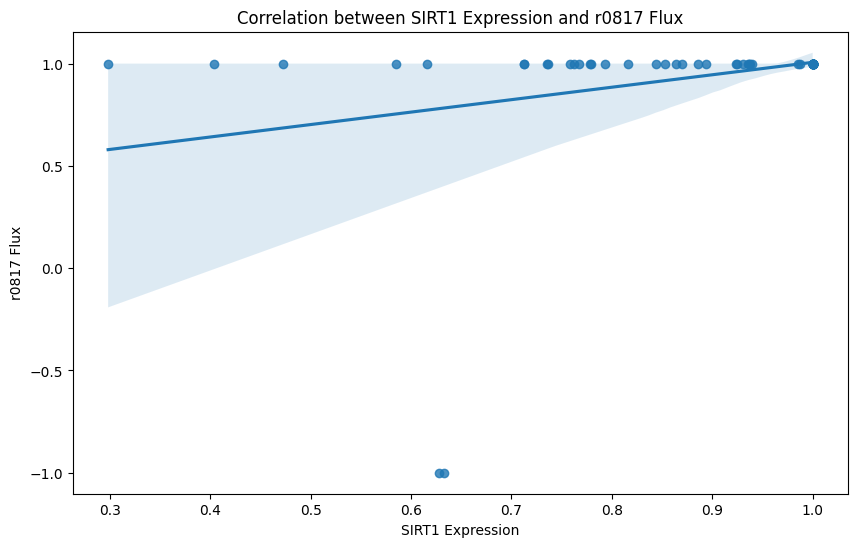

Linear regression results for SIRT1 and r0817:
Slope: 0.6083745076256553
Intercept: 0.39786059712413446
R-squared: 0.0835661628268614
P-value: 0.014484132539722527
Standard error: 0.24253911585052393



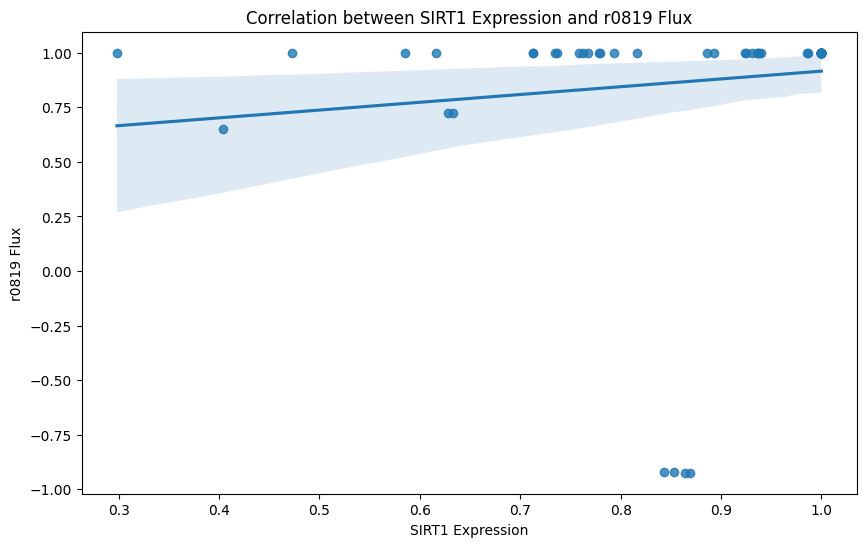

Linear regression results for SIRT1 and r0819:
Slope: 0.35667805198241026
Intercept: 0.5589425383427996
R-squared: 0.015927436993593575
P-value: 0.2942986972048245
Standard error: 0.3375145148838461



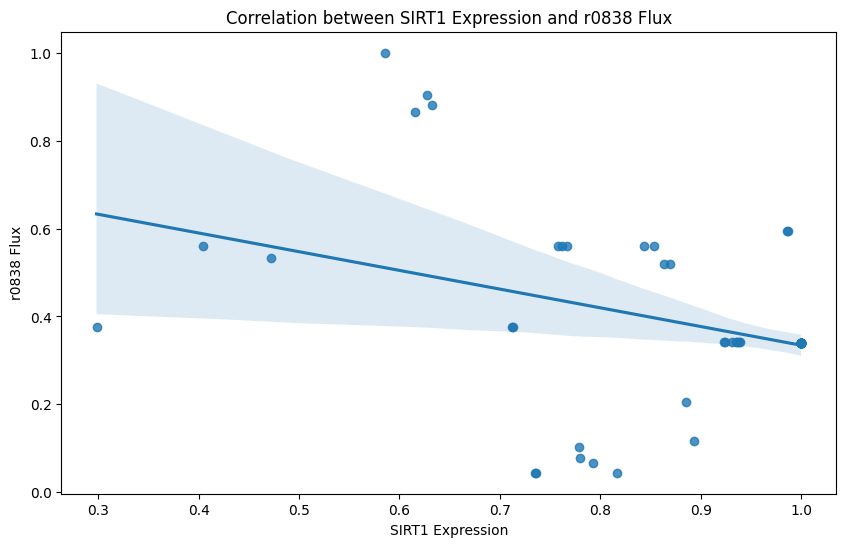

Linear regression results for SIRT1 and r0838:
Slope: -0.4255401172543919
Intercept: 0.760028020155997
R-squared: 0.13985727794219915
P-value: 0.0013150924663778622
Standard error: 0.12704532466207388



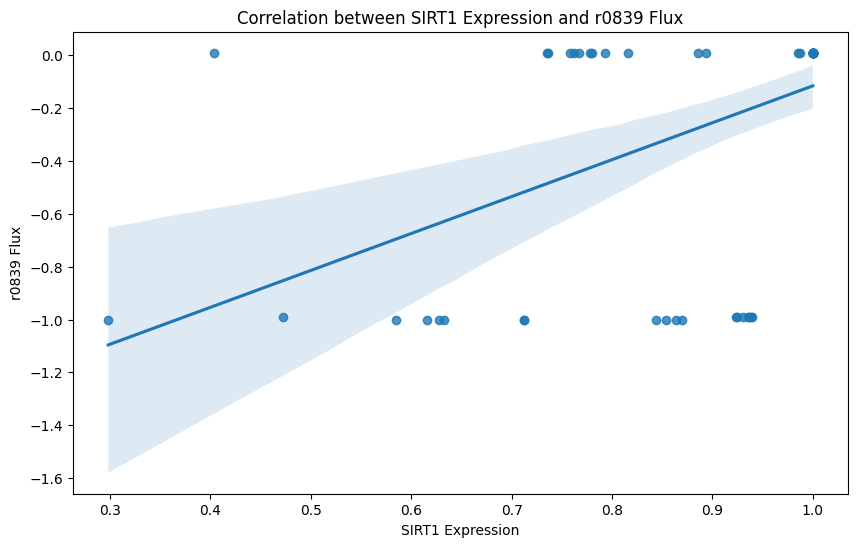

Linear regression results for SIRT1 and r0839:
Slope: 1.3973982905341125
Intercept: -1.5128266374259272
R-squared: 0.24349078663528625
P-value: 1.2287862229587092e-05
Standard error: 0.2965251311647633



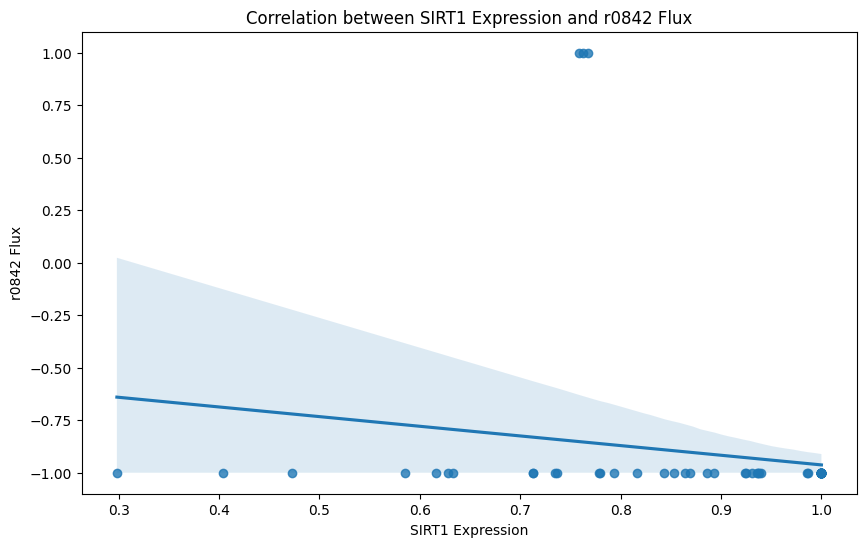

Linear regression results for SIRT1 and r0842:
Slope: -0.45995008266419085
Intercept: -0.502850024821238
R-squared: 0.03231162551216465
P-value: 0.13361448303205317
Standard error: 0.30302224700012176



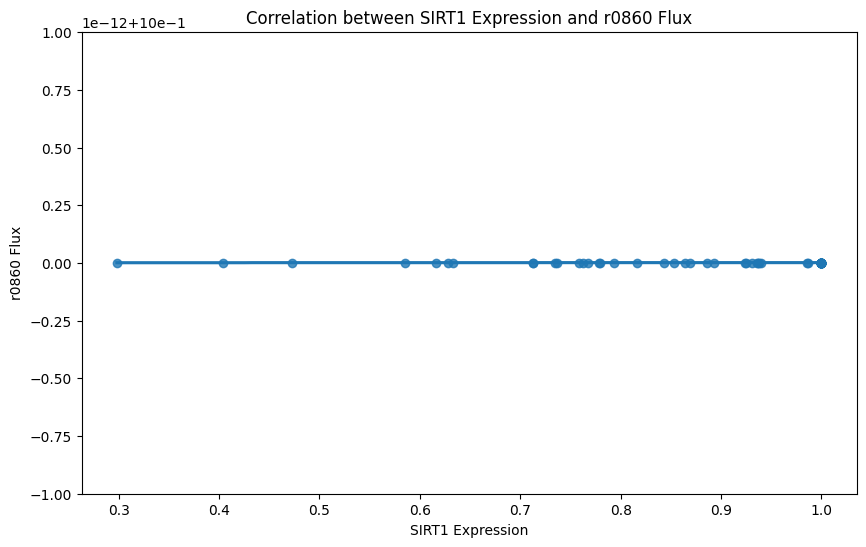

Linear regression results for SIRT1 and r0860:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



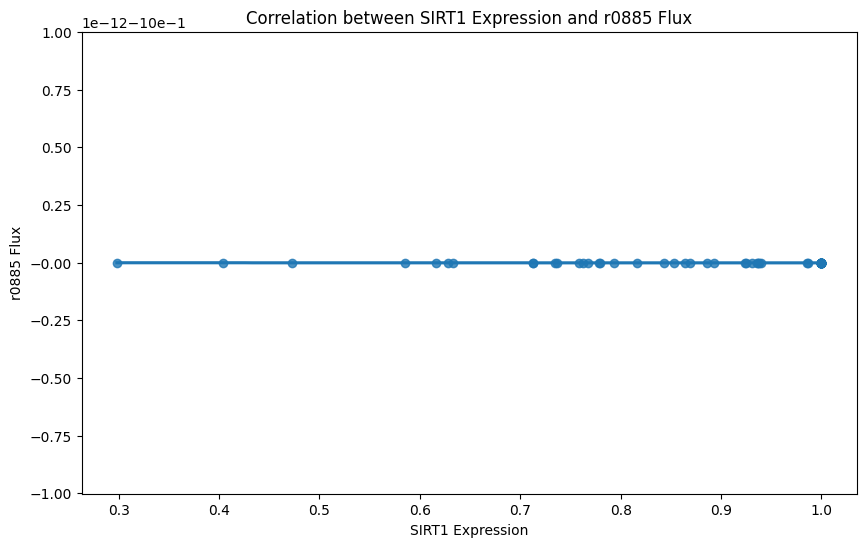

Linear regression results for SIRT1 and r0885:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



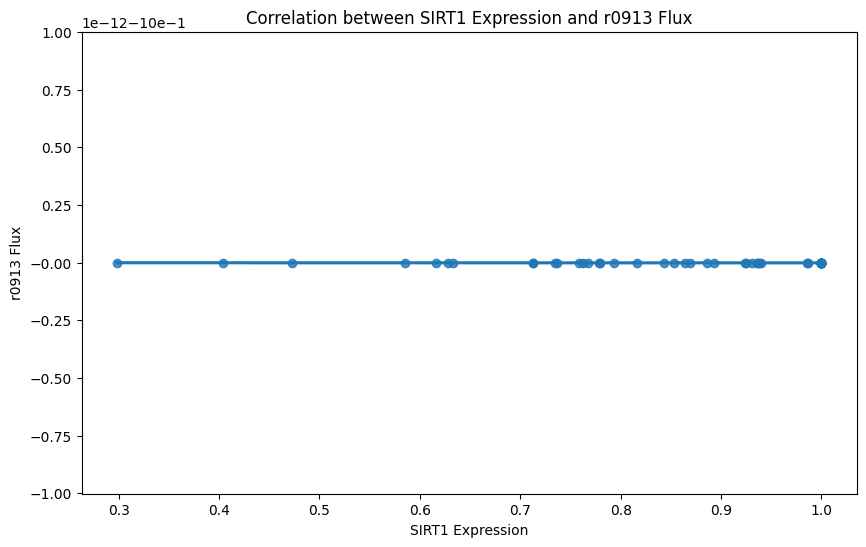

Linear regression results for SIRT1 and r0913:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



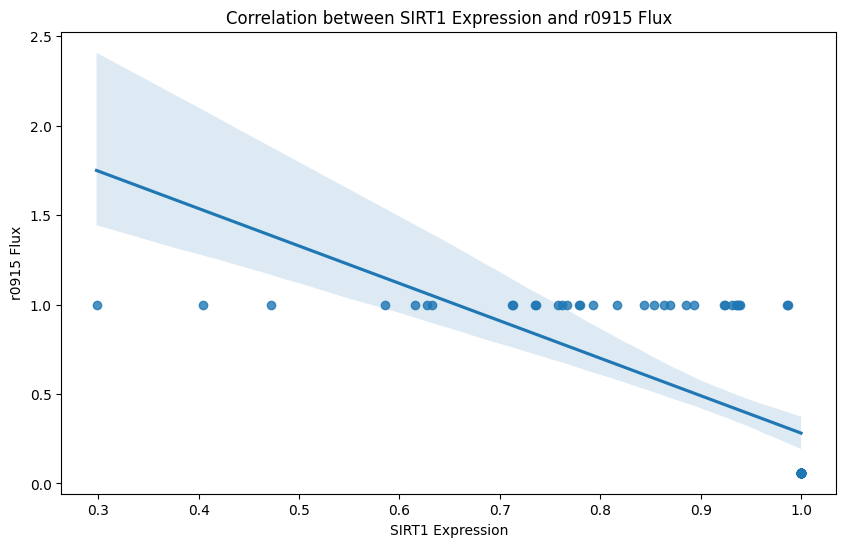

Linear regression results for SIRT1 and r0915:
Slope: -2.0926902088963035
Intercept: 2.374414999312664
R-squared: 0.4927114051469575
P-value: 9.117085759106247e-12
Standard error: 0.25562989317134444



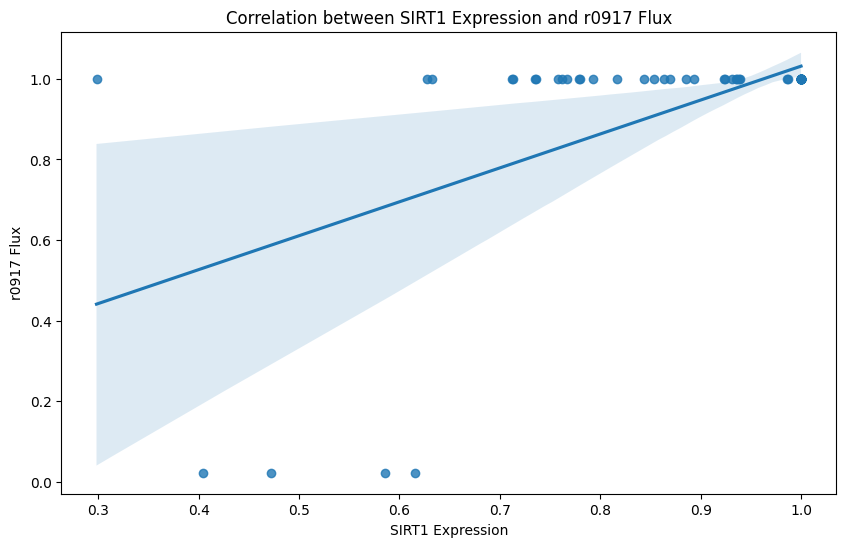

Linear regression results for SIRT1 and r0917:
Slope: 0.8415746867543331
Intercept: 0.18992332791077893
R-squared: 0.34482741719564325
P-value: 7.336068791016452e-08
Standard error: 0.1396513317716454



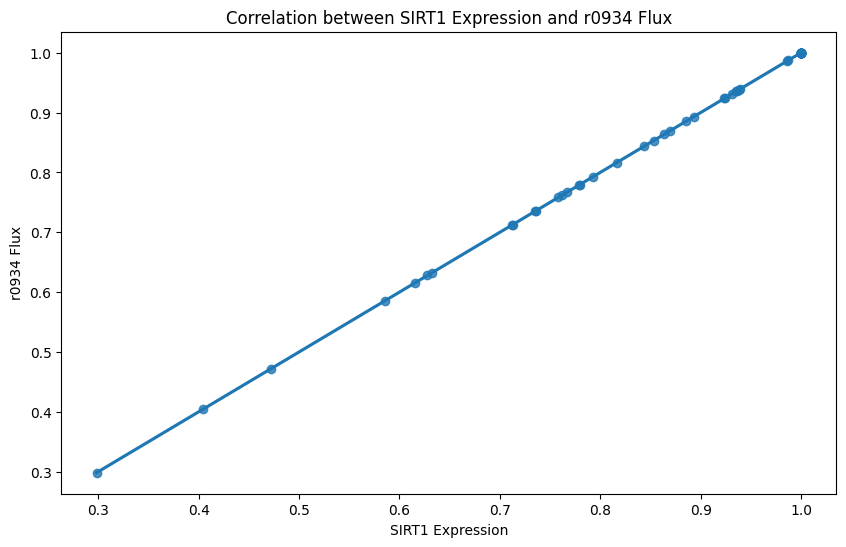

Linear regression results for SIRT1 and r0934:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



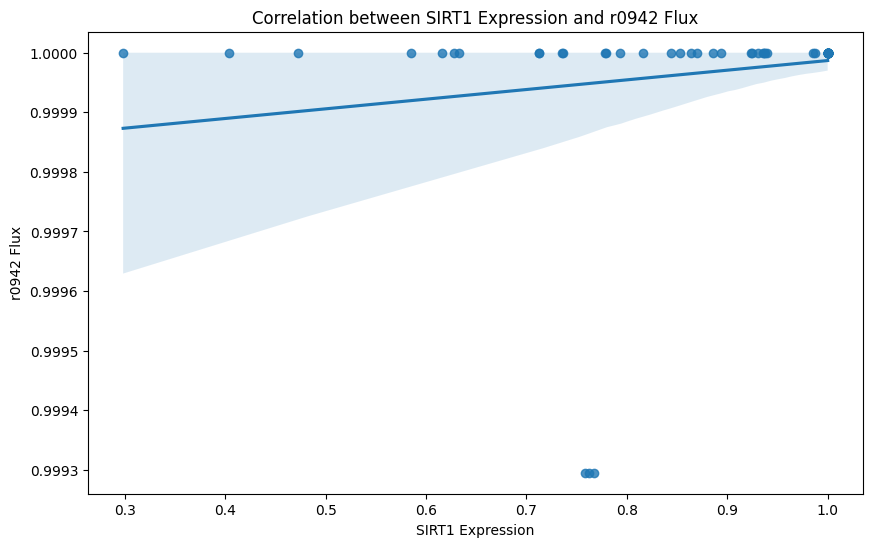

Linear regression results for SIRT1 and r0942:
Slope: 0.00016213499029999316
Intercept: 0.9998247518520126
R-squared: 0.03231158447372902
P-value: 0.13361473388142409
Standard error: 0.00010681711596871864



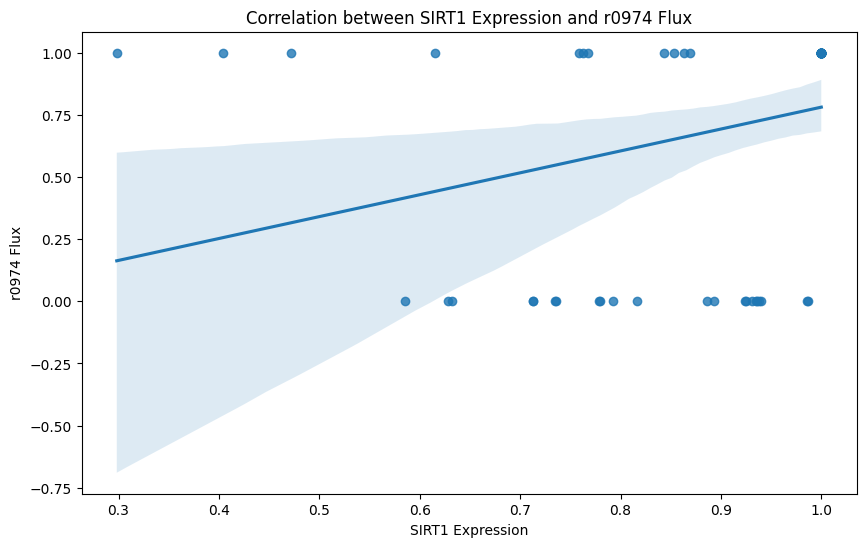

Linear regression results for SIRT1 and r0974:
Slope: 0.8807576685185688
Intercept: -0.09971841074491539
R-squared: 0.08986501517621602
P-value: 0.011091097670513245
Standard error: 0.3374344863291779



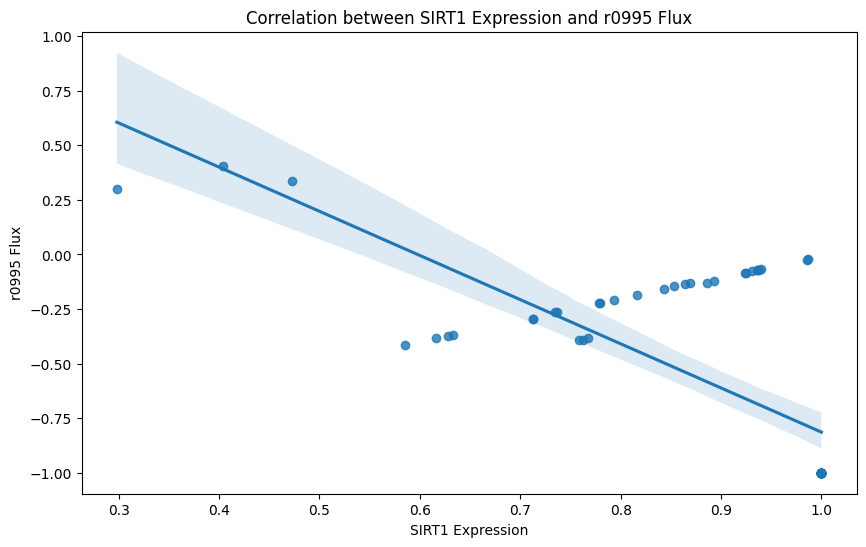

Linear regression results for SIRT1 and r0995:
Slope: -2.0232307633118647
Intercept: 1.209210460494204
R-squared: 0.5135800117108026
P-value: 2.0985270904832785e-12
Standard error: 0.23704048361474409



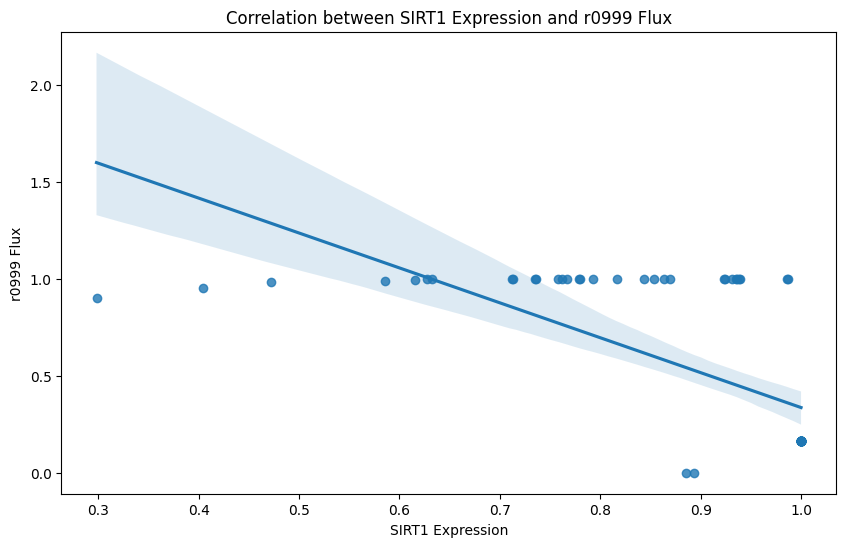

Linear regression results for SIRT1 and r0999:
Slope: -1.8006593135341646
Intercept: 2.1369843115081437
R-squared: 0.4604698987972818
P-value: 7.888264548482706e-11
Standard error: 0.23464657715152146



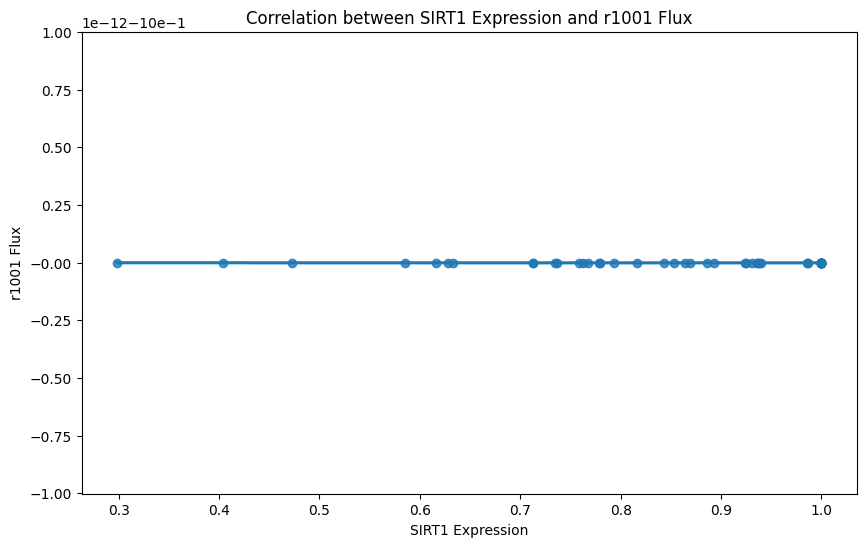

Linear regression results for SIRT1 and r1001:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



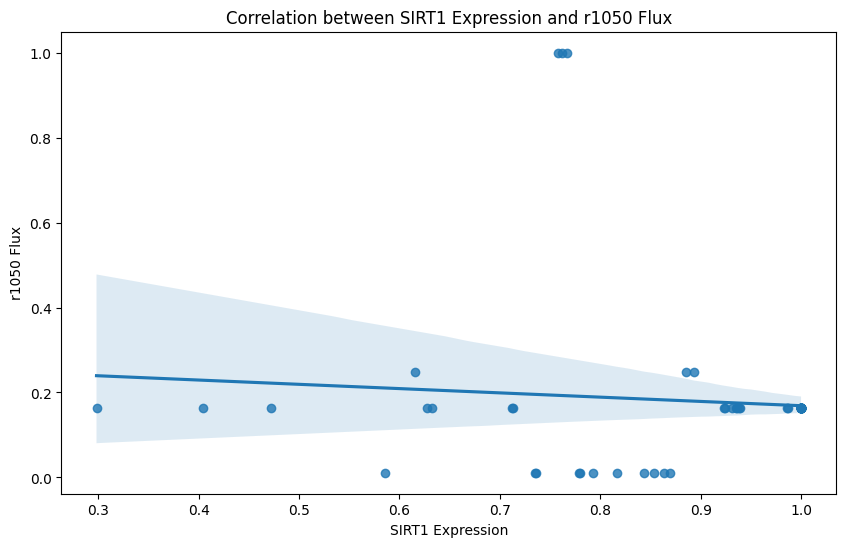

Linear regression results for SIRT1 and r1050:
Slope: -0.10069210485481771
Intercept: 0.26954107521149206
R-squared: 0.00754399688368092
P-value: 0.4713800490276303
Standard error: 0.13903551675411951



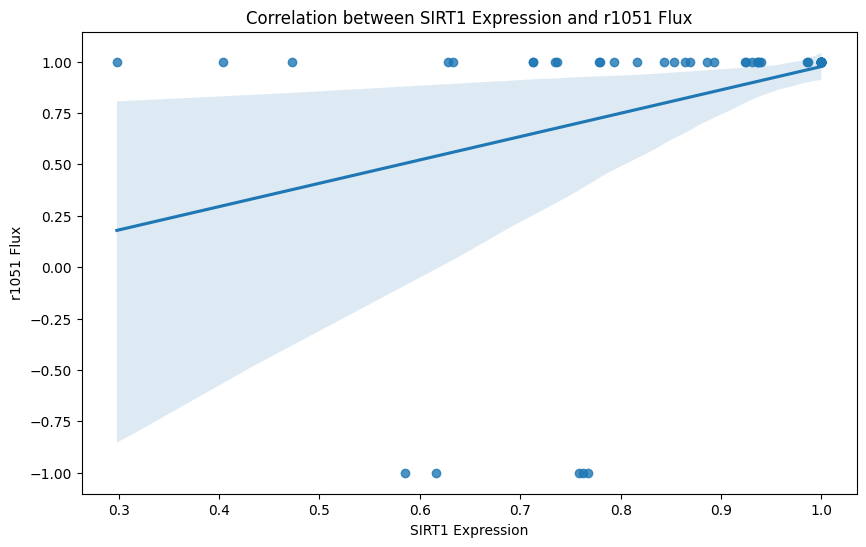

Linear regression results for SIRT1 and r1051:
Slope: 1.1358877710448712
Intercept: -0.15988931130224804
R-squared: 0.12184600214632908
P-value: 0.0028495652531319972
Standard error: 0.3671052351683552



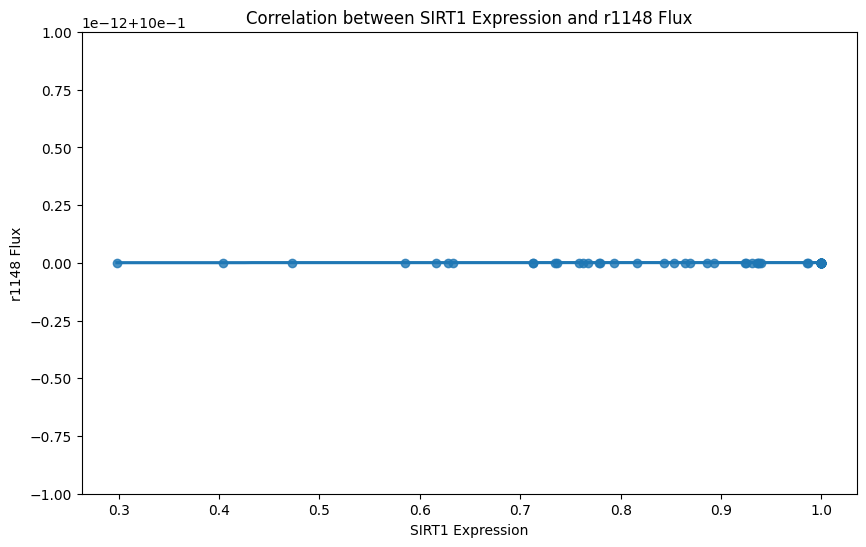

Linear regression results for SIRT1 and r1148:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



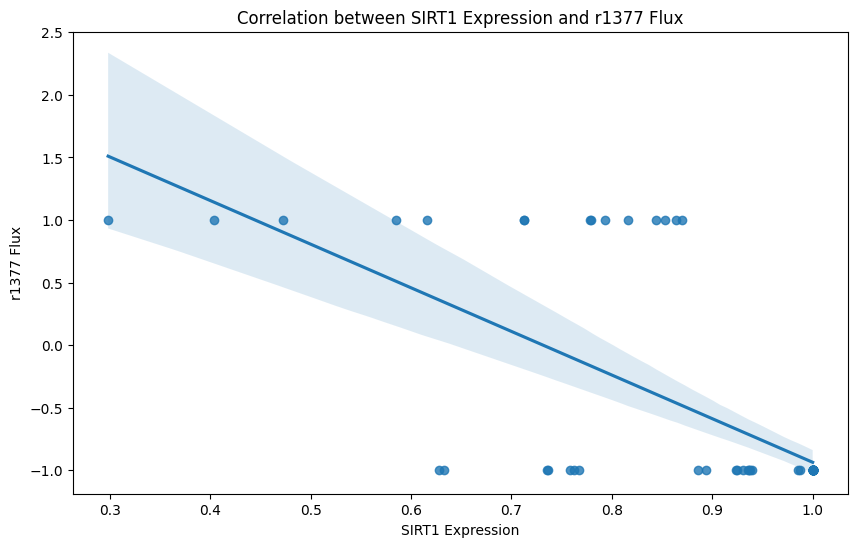

Linear regression results for SIRT1 and r1377:
Slope: -3.4858450057442614
Intercept: 2.5498506597329844
R-squared: 0.4507174692877088
P-value: 1.478349664207781e-10
Standard error: 0.46326471748885545



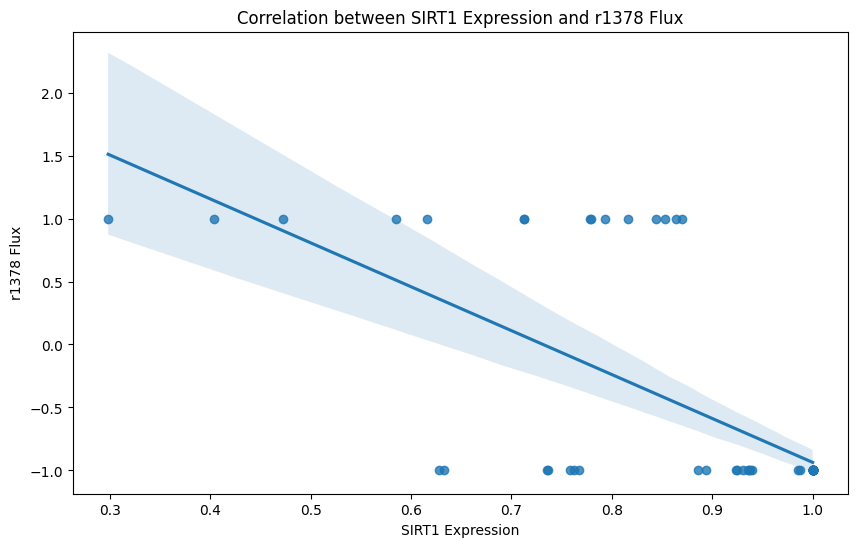

Linear regression results for SIRT1 and r1378:
Slope: -3.4858450057442614
Intercept: 2.5498506597329844
R-squared: 0.4507174692877088
P-value: 1.478349664207781e-10
Standard error: 0.46326471748885545



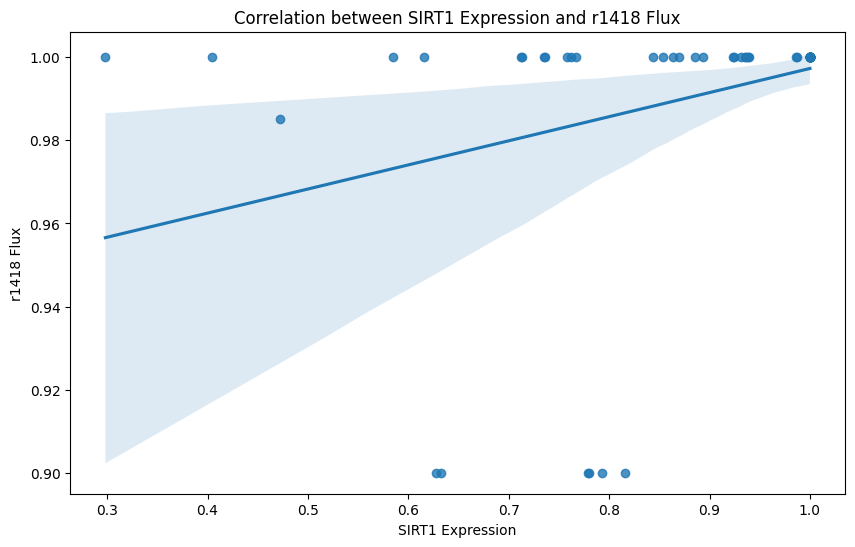

Linear regression results for SIRT1 and r1418:
Slope: 0.058032287001072
Intercept: 0.9392758843383373
R-squared: 0.10768679473625567
P-value: 0.00520872442302097
Standard error: 0.02011048643512702



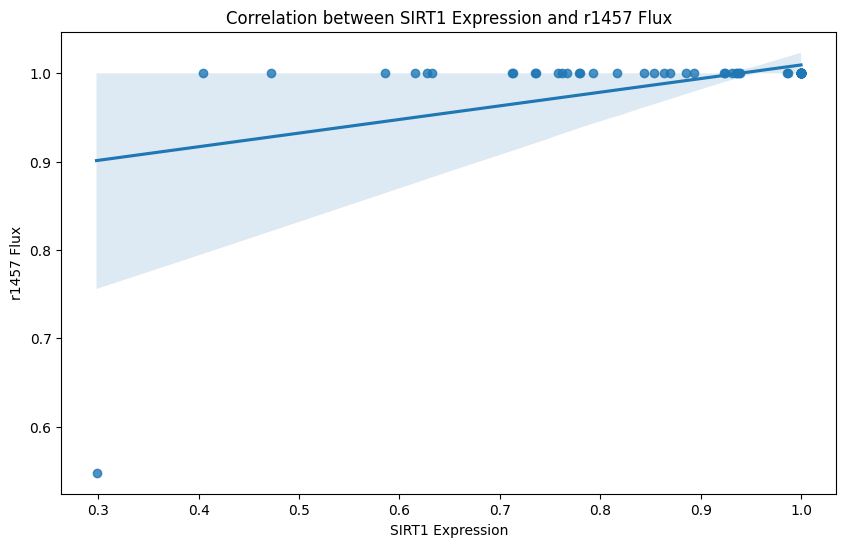

Linear regression results for SIRT1 and r1457:
Slope: 0.15425979875386742
Intercept: 0.8552383343637217
R-squared: 0.2072618539693404
P-value: 6.633427550944087e-05
Standard error: 0.03631896001429804



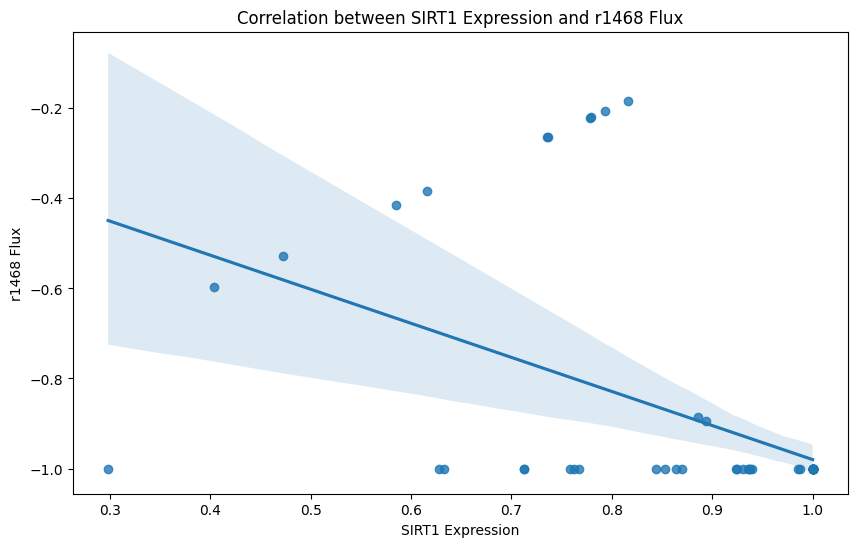

Linear regression results for SIRT1 and r1468:
Slope: -0.7564362208781098
Intercept: -0.22367177111115644
R-squared: 0.24828605364282175
P-value: 9.780746508040103e-06
Standard error: 0.15845206807842835



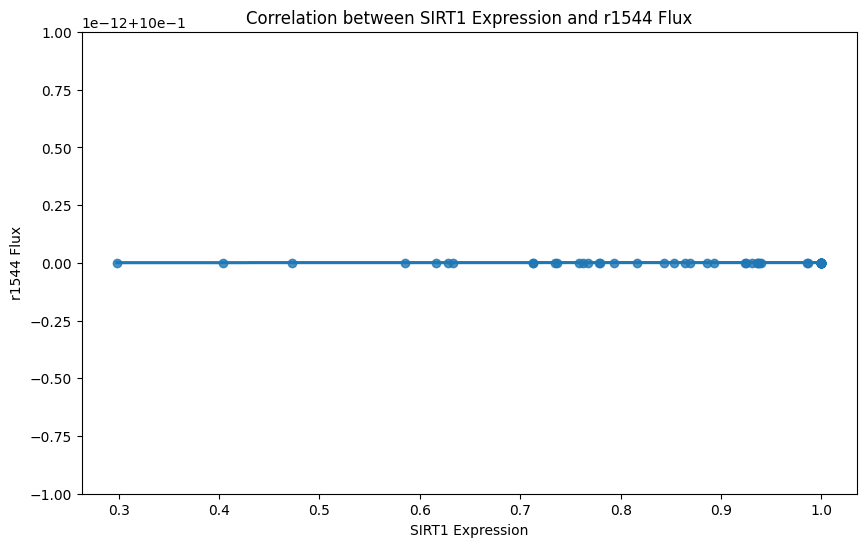

Linear regression results for SIRT1 and r1544:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



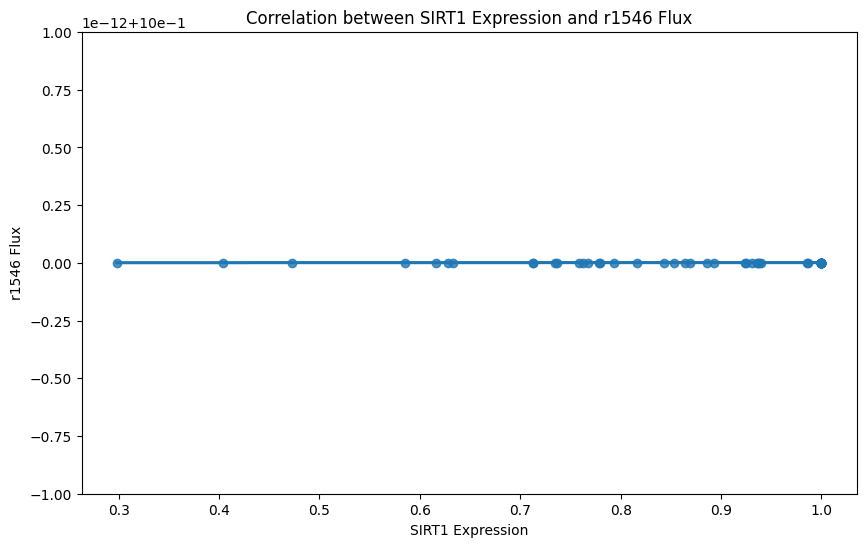

Linear regression results for SIRT1 and r1546:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



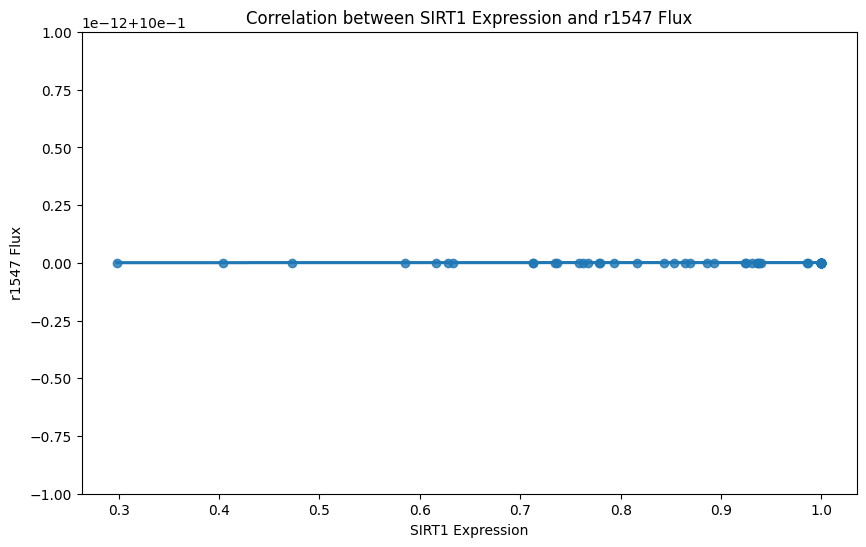

Linear regression results for SIRT1 and r1547:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



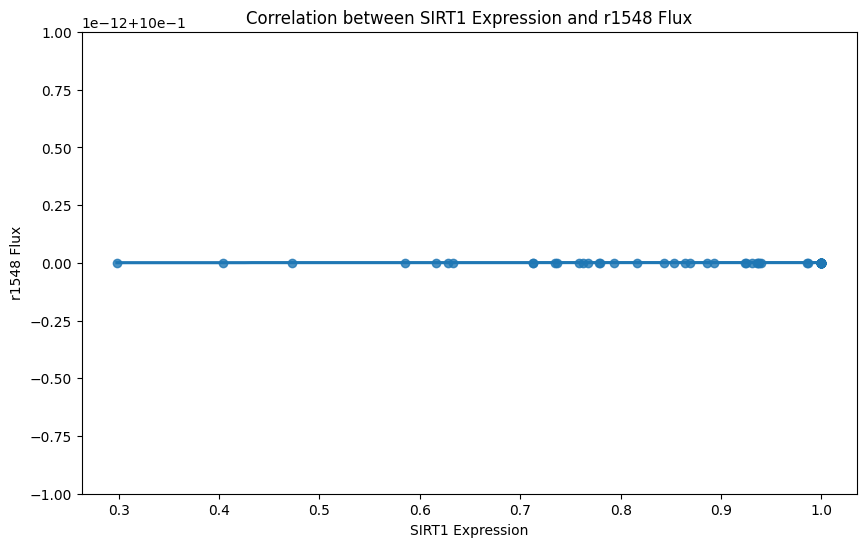

Linear regression results for SIRT1 and r1548:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



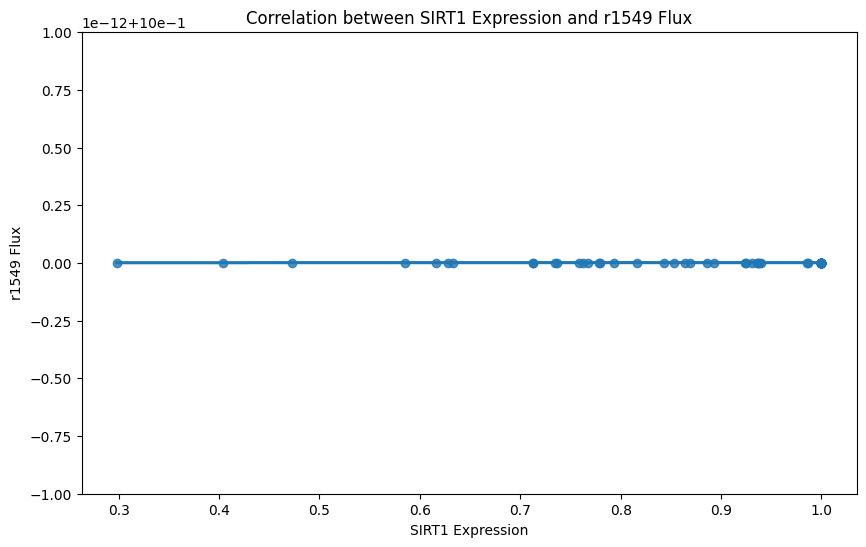

Linear regression results for SIRT1 and r1549:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



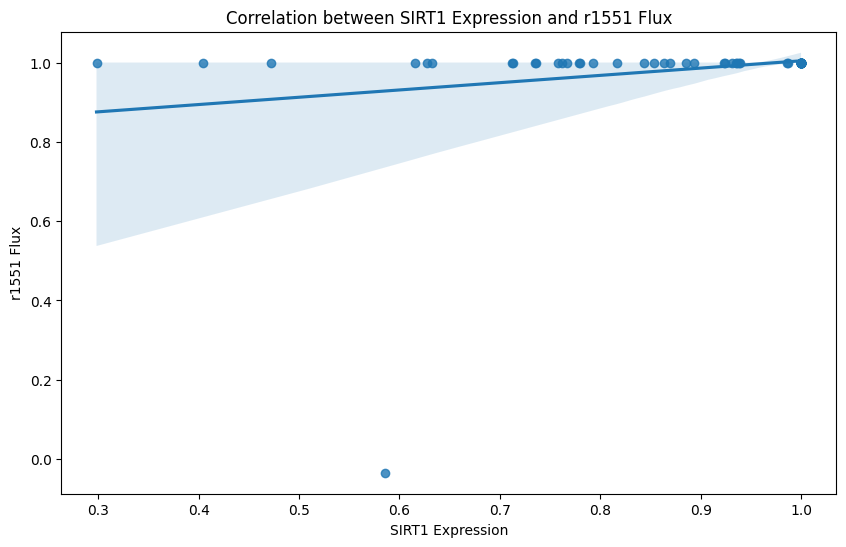

Linear regression results for SIRT1 and r1551:
Slope: 0.18385534611389245
Intercept: 0.8204824378736555
R-squared: 0.056222465970433316
P-value: 0.04648356195357118
Standard error: 0.09068419241474197



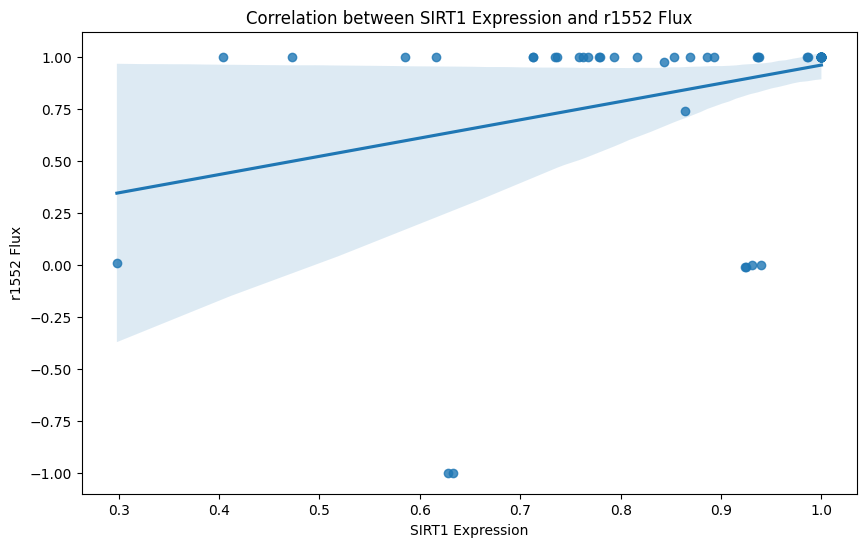

Linear regression results for SIRT1 and r1552:
Slope: 0.8771411305334238
Intercept: 0.08185460370807085
R-squared: 0.11360339391581777
P-value: 0.004049922800297263
Standard error: 0.294960132742886



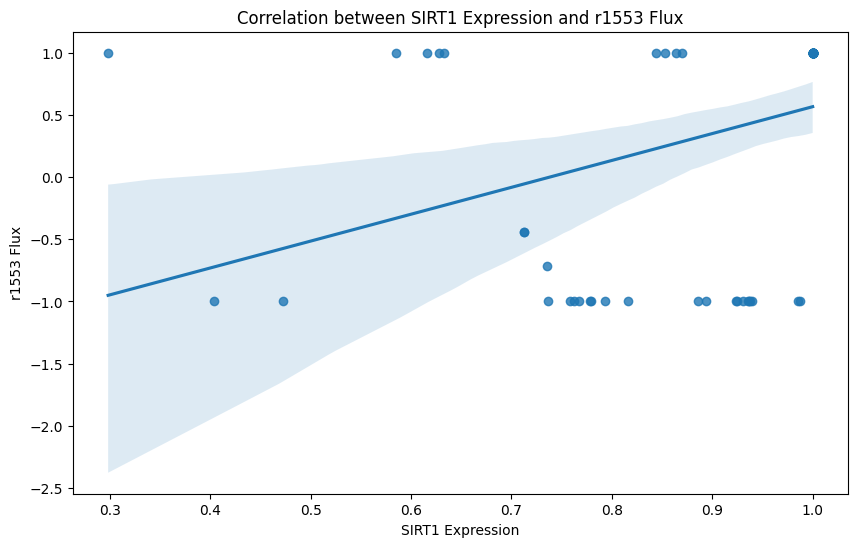

Linear regression results for SIRT1 and r1553:
Slope: 2.161808393228594
Intercept: -1.5957700312454637
R-squared: 0.13556598078708523
P-value: 0.0015822817933457368
Standard error: 0.6571783051707811



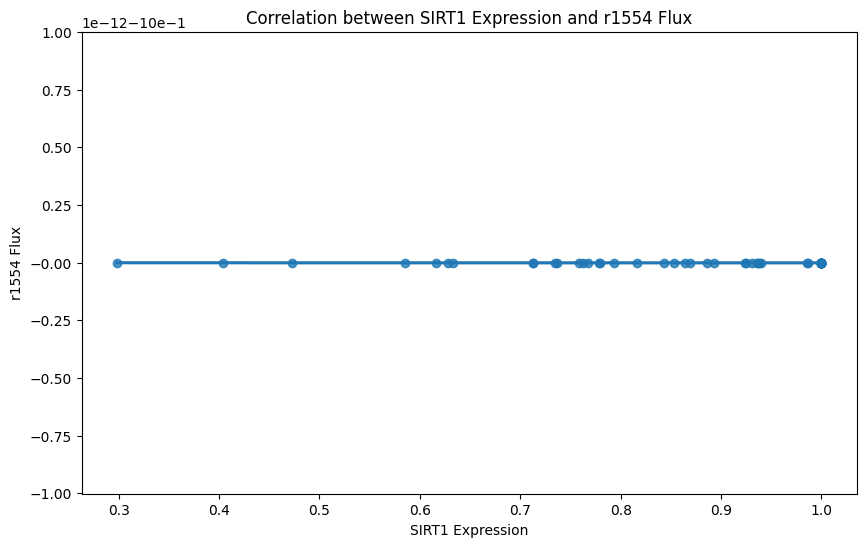

Linear regression results for SIRT1 and r1554:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



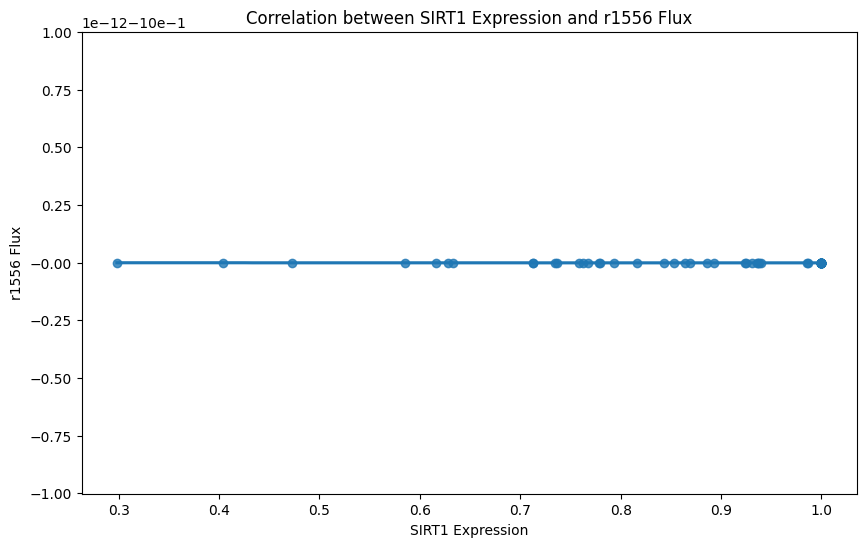

Linear regression results for SIRT1 and r1556:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



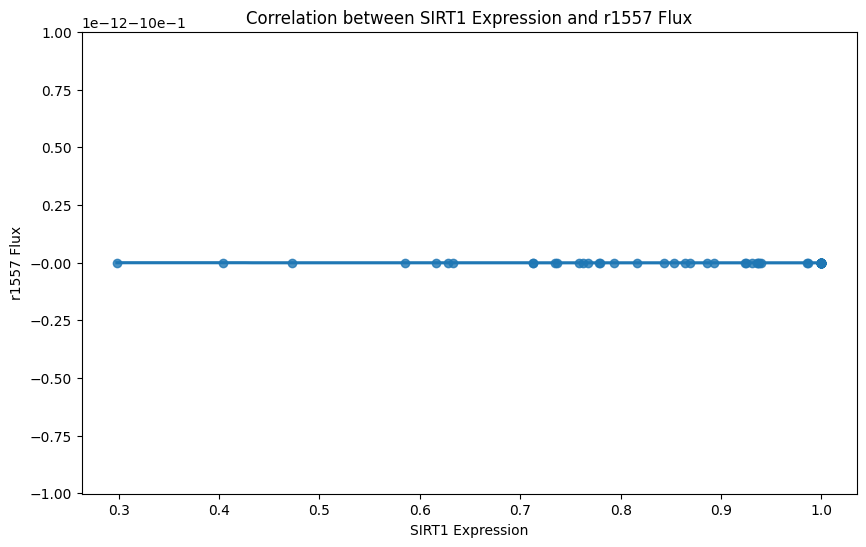

Linear regression results for SIRT1 and r1557:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



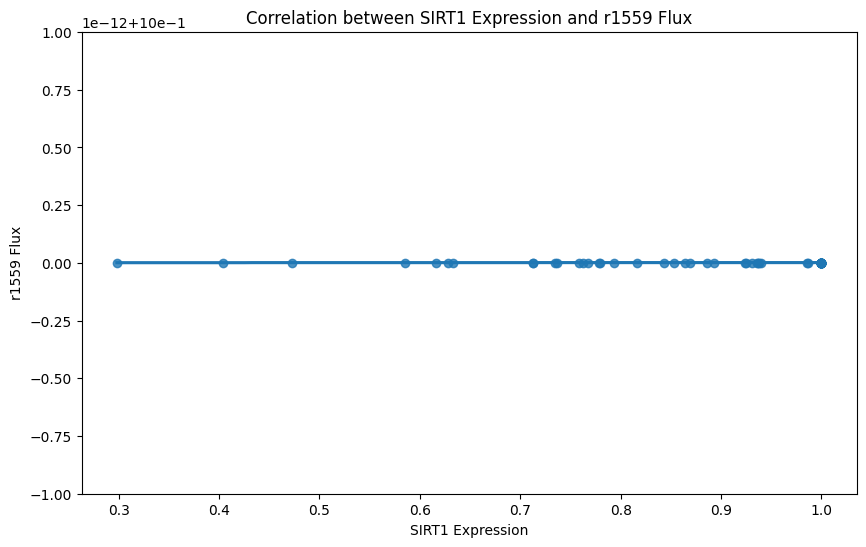

Linear regression results for SIRT1 and r1559:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



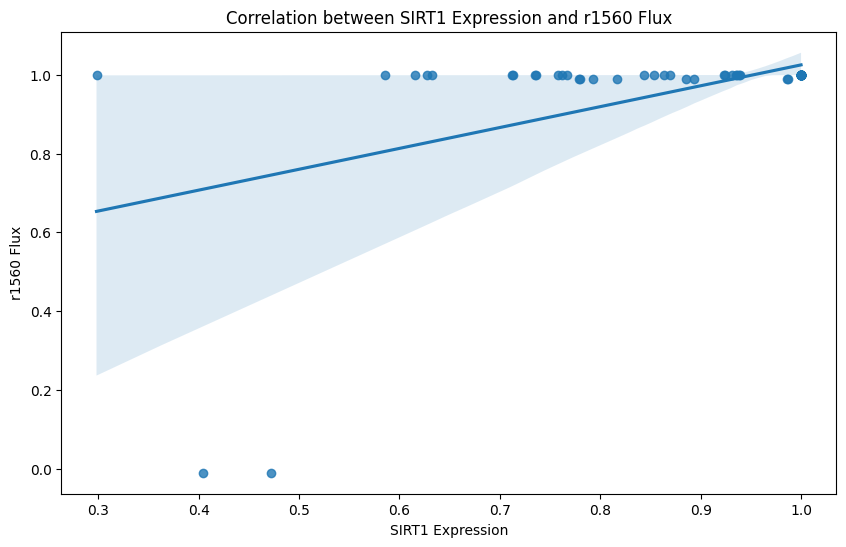

Linear regression results for SIRT1 and r1560:
Slope: 0.5297361212672201
Intercept: 0.4951713542439153
R-squared: 0.24892429299538865
P-value: 9.487258757047064e-06
Standard error: 0.11077538253200811



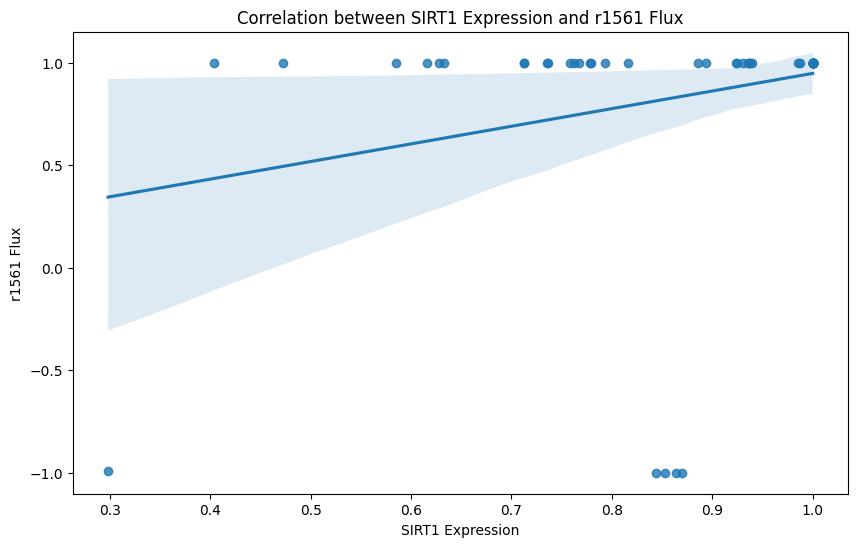

Linear regression results for SIRT1 and r1561:
Slope: 0.8596805333016534
Intercept: 0.08803594866339903
R-squared: 0.06991895489013605
P-value: 0.02585822117703736
Standard error: 0.37746394977326514



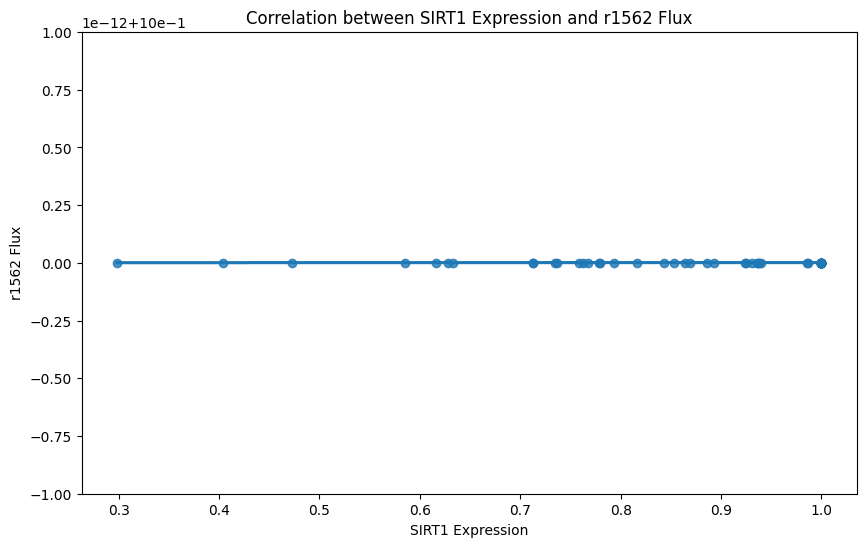

Linear regression results for SIRT1 and r1562:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



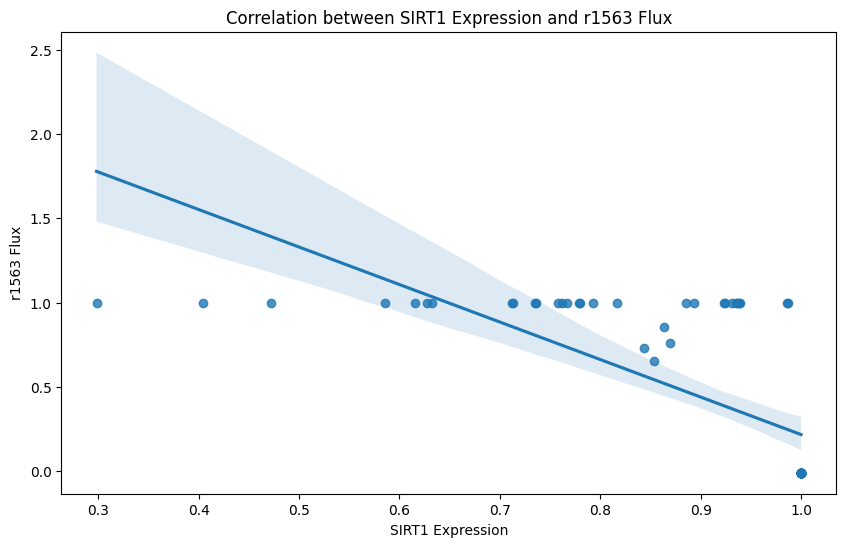

Linear regression results for SIRT1 and r1563:
Slope: -2.2253332276930777
Intercept: 2.4417711198082137
R-squared: 0.5056360752653668
P-value: 3.6969500943278735e-12
Standard error: 0.2648956747692628



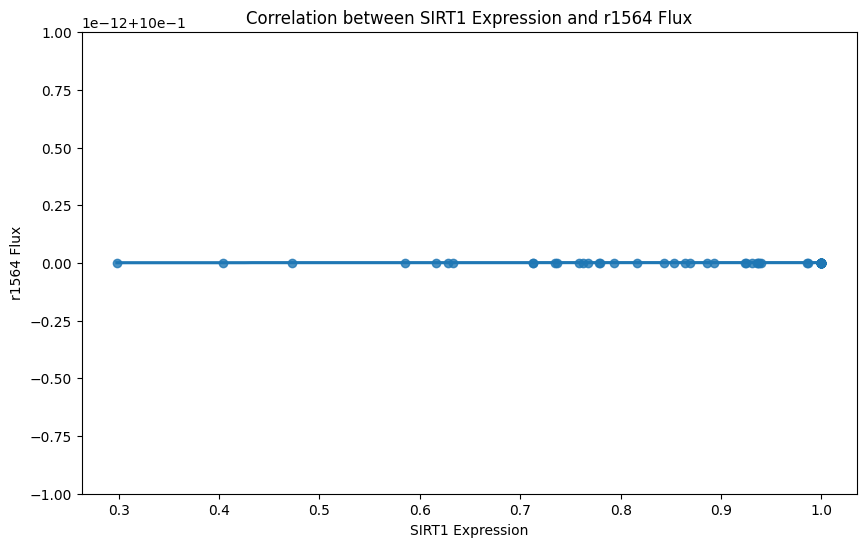

Linear regression results for SIRT1 and r1564:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



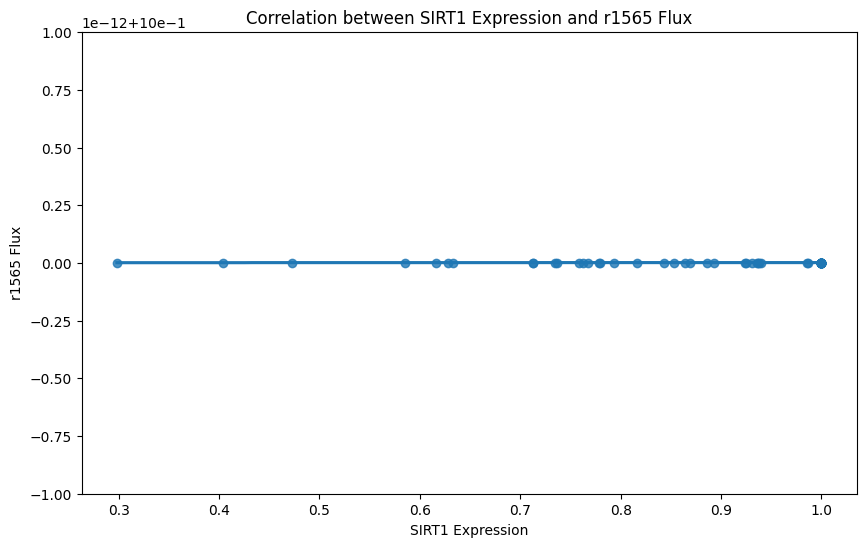

Linear regression results for SIRT1 and r1565:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



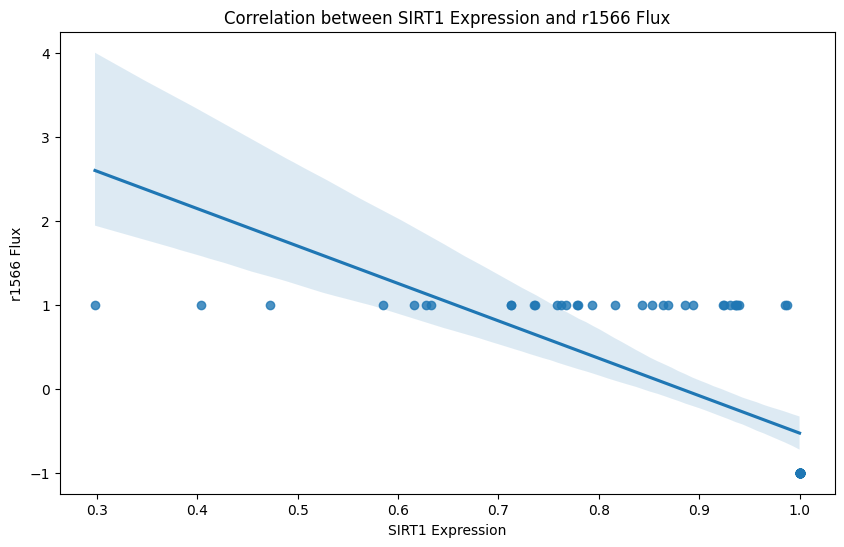

Linear regression results for SIRT1 and r1566:
Slope: -4.453088333485641
Intercept: 3.924652379405372
R-squared: 0.49271140514695716
P-value: 9.117085759106376e-12
Standard error: 0.543961304034515



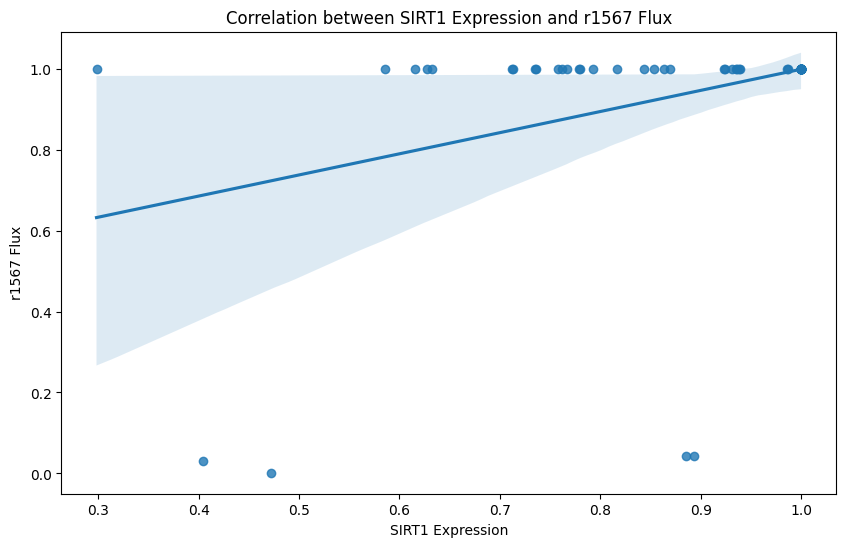

Linear regression results for SIRT1 and r1567:
Slope: 0.5224366630961462
Intercept: 0.476606209863391
R-squared: 0.13464494899165538
P-value: 0.0016462541425400173
Standard error: 0.15944512117955958



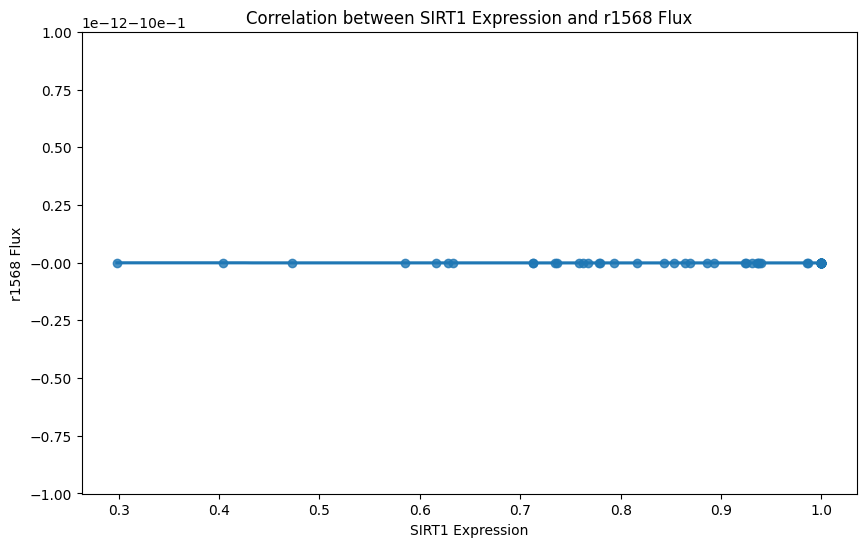

Linear regression results for SIRT1 and r1568:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



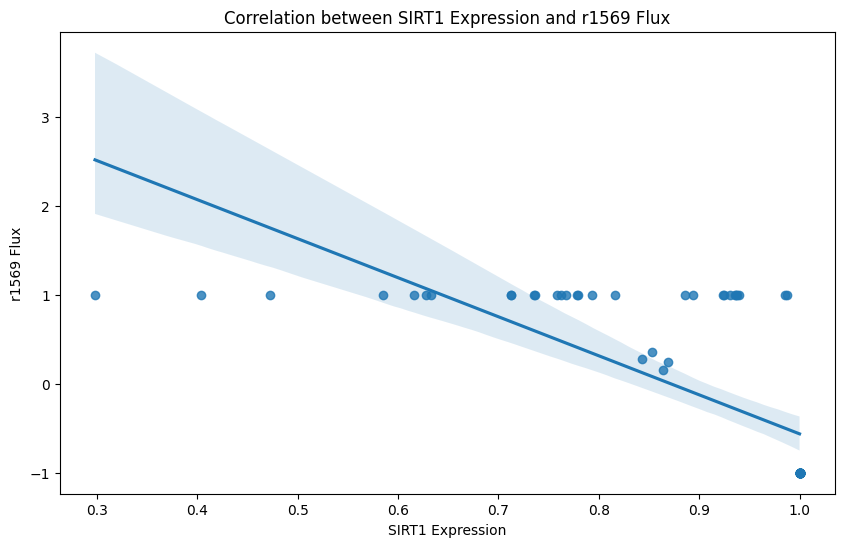

Linear regression results for SIRT1 and r1569:
Slope: -4.387111018056642
Intercept: 3.823802946656555
R-squared: 0.5088047946828421
P-value: 2.952645330815756e-12
Standard error: 0.5189261316230326



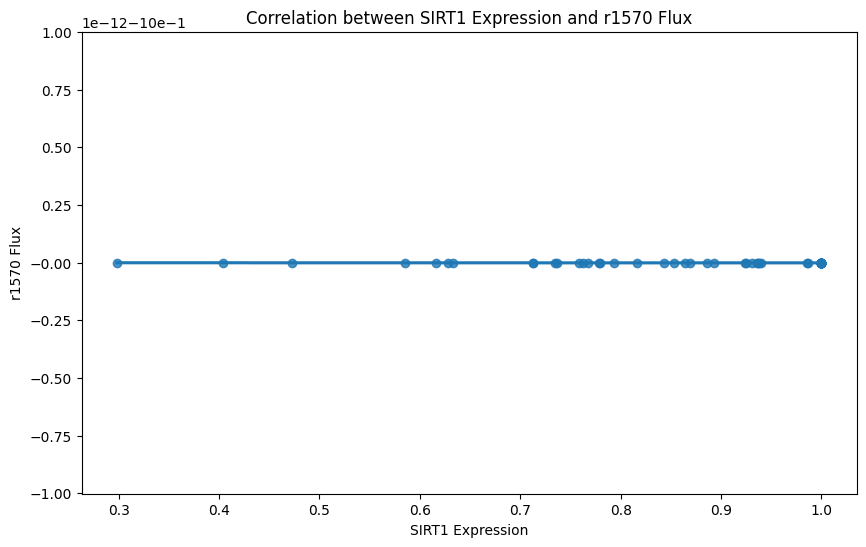

Linear regression results for SIRT1 and r1570:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



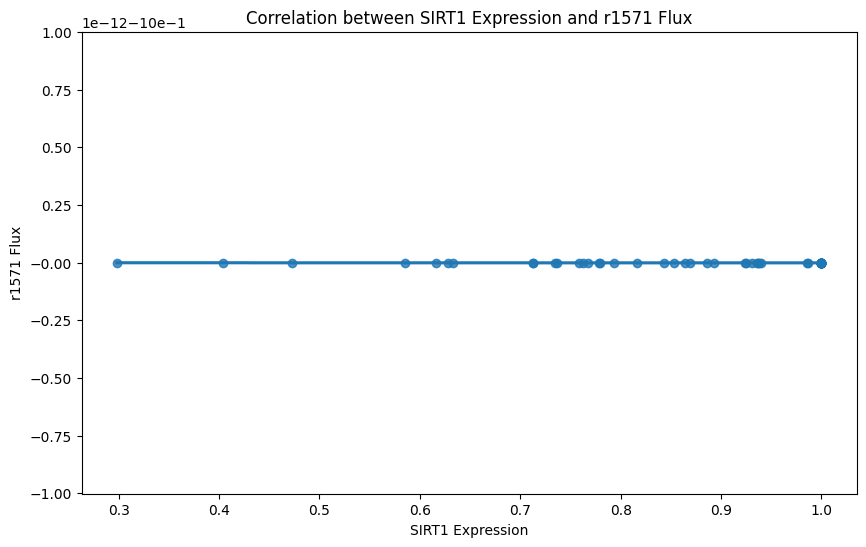

Linear regression results for SIRT1 and r1571:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



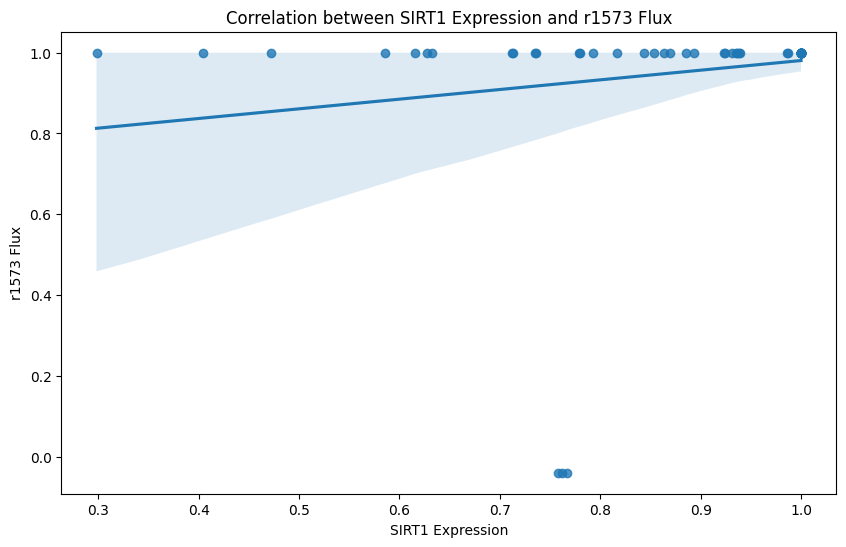

Linear regression results for SIRT1 and r1573:
Slope: 0.2391739021271844
Intercept: 0.7414821852016604
R-squared: 0.032311584473714586
P-value: 0.13361473388151224
Standard error: 0.1575715790462374



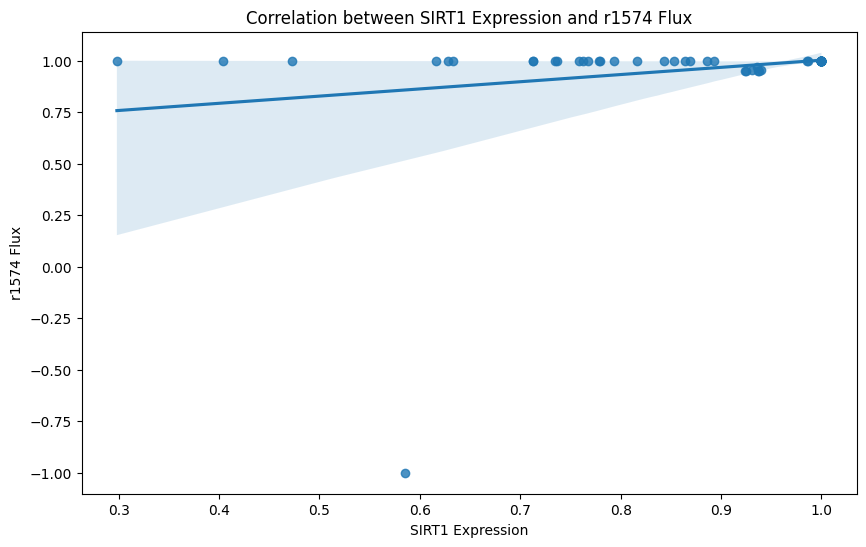

Linear regression results for SIRT1 and r1574:
Slope: 0.3490674392315114
Intercept: 0.6542273159782885
R-squared: 0.05430136007595179
P-value: 0.05050307010879594
Standard error: 0.17537021045615786



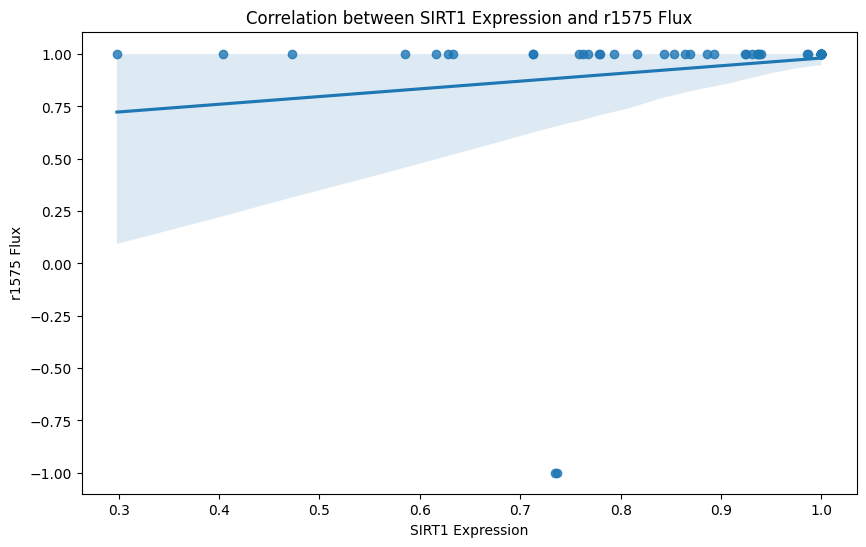

Linear regression results for SIRT1 and r1575:
Slope: 0.3681274312854154
Intercept: 0.6133975449945569
R-squared: 0.030597419869665427
P-value: 0.14455816851526557
Standard error: 0.24944989050910113



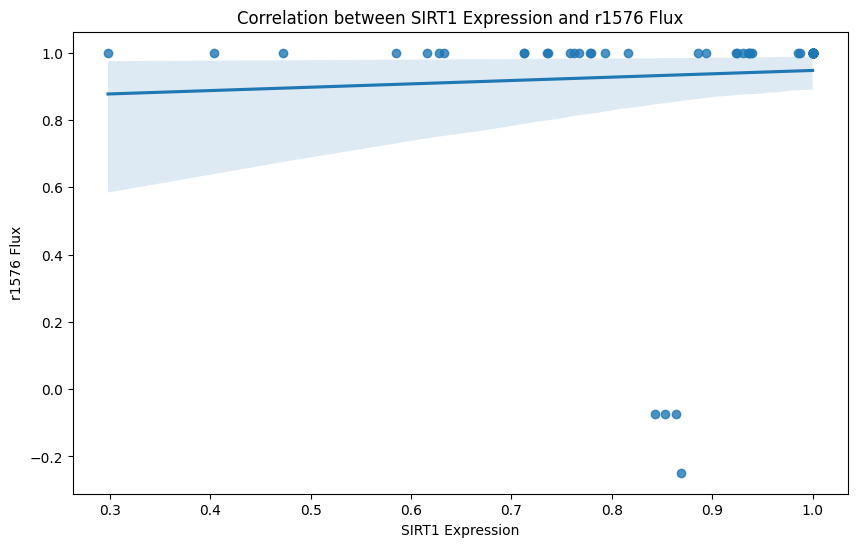

Linear regression results for SIRT1 and r1576:
Slope: 0.09973950793226045
Intercept: 0.8475832113290115
R-squared: 0.0036890897975249415
P-value: 0.6148467209520885
Standard error: 0.19732427037635258



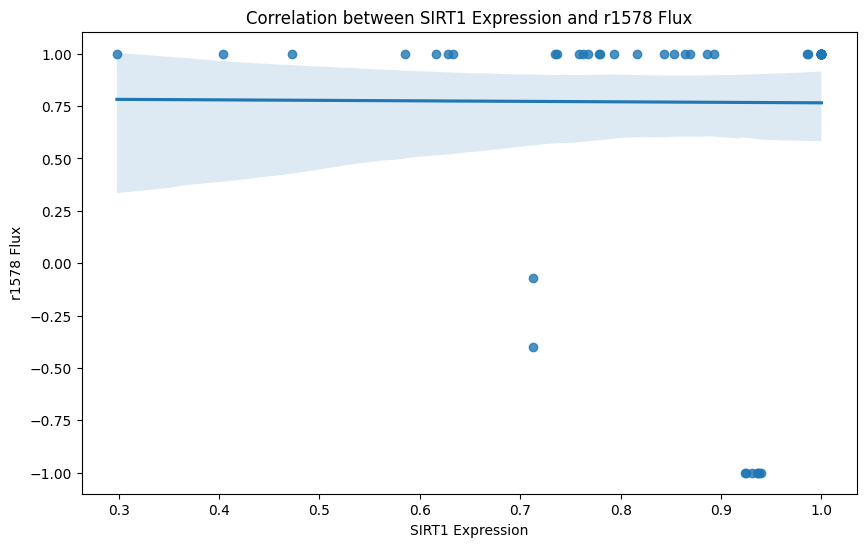

Linear regression results for SIRT1 and r1578:
Slope: -0.02354901587124086
Intercept: 0.7891624647153113
R-squared: 3.5681305502041355e-05
P-value: 0.9605689371001729
Standard error: 0.4745916586368121



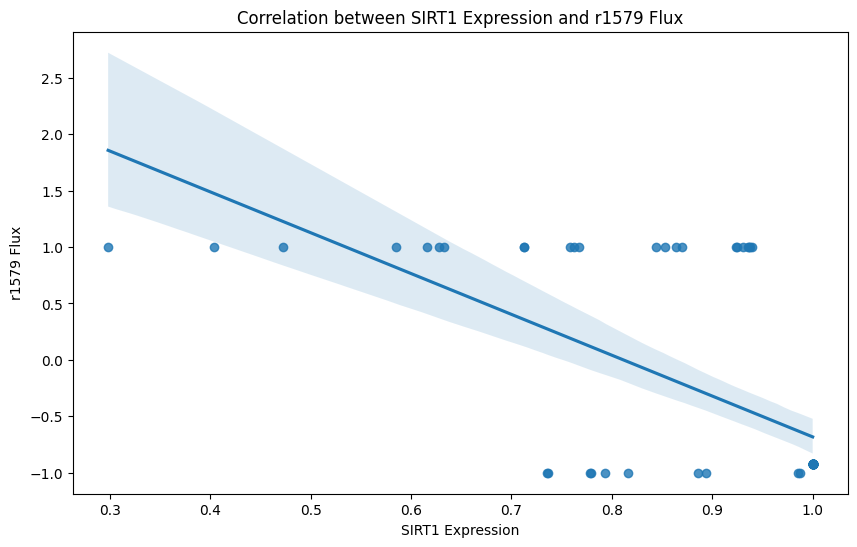

Linear regression results for SIRT1 and r1579:
Slope: -3.617655209413208
Intercept: 2.9351127706510822
R-squared: 0.39289586508425667
P-value: 4.981783604797486e-09
Standard error: 0.5413716306138366



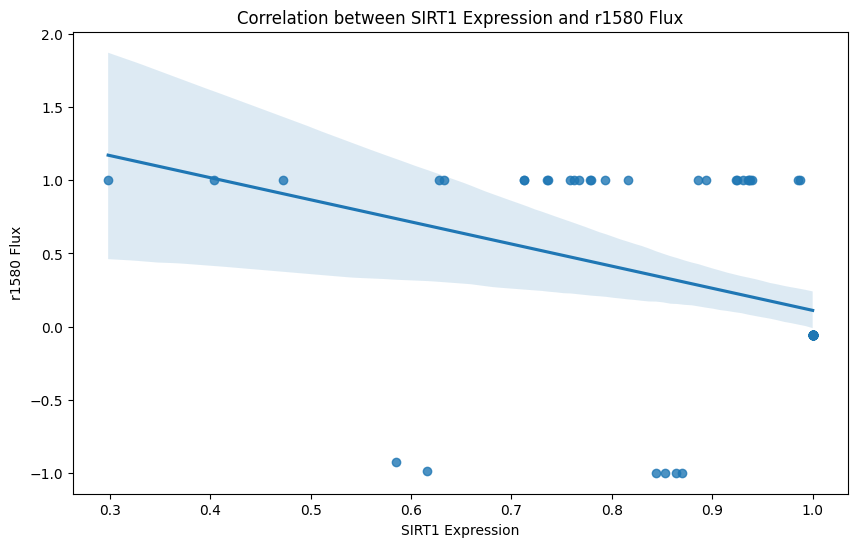

Linear regression results for SIRT1 and r1580:
Slope: -1.5128111340133248
Intercept: 1.6231842012942397
R-squared: 0.14374999053620013
P-value: 0.001111475377402383
Standard error: 0.44448442647267533



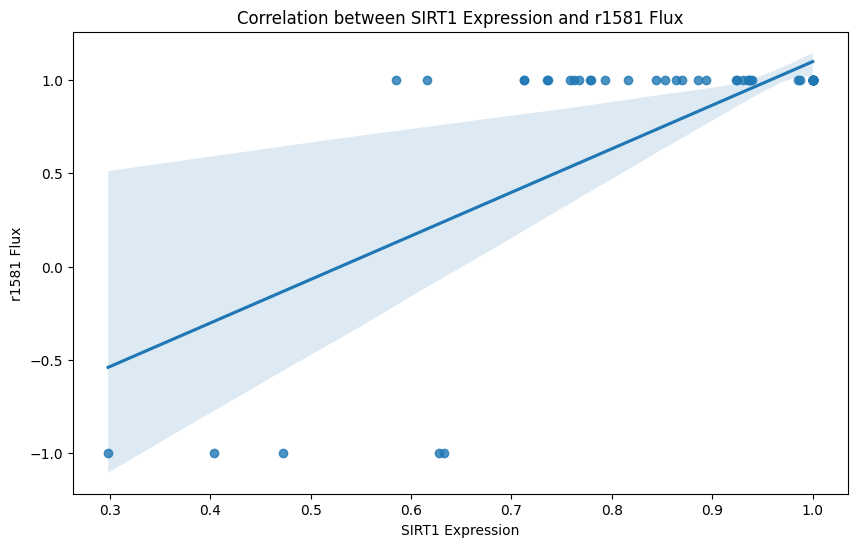

Linear regression results for SIRT1 and r1581:
Slope: 2.336823840309691
Intercept: -1.237319607901968
R-squared: 0.5155912531988707
P-value: 1.8156370208561723e-12
Standard error: 0.2726808549326636



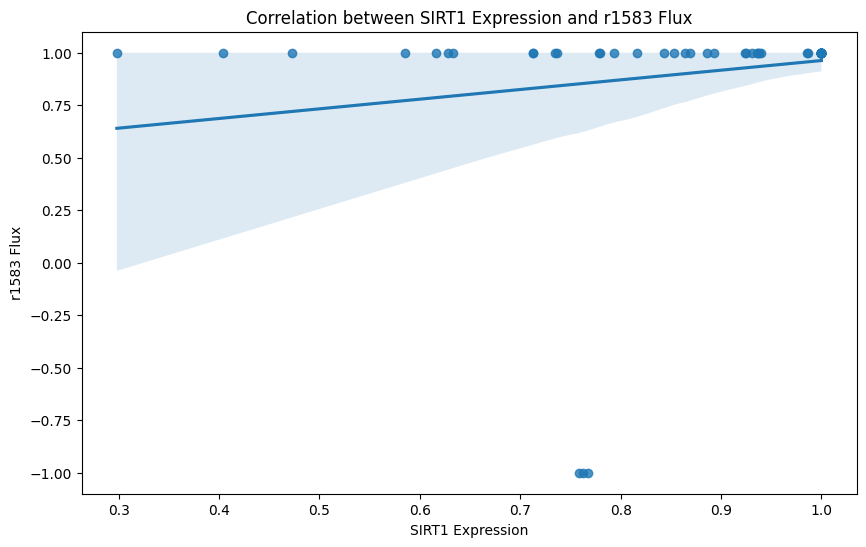

Linear regression results for SIRT1 and r1583:
Slope: 0.4599498117830473
Intercept: 0.5028503561570392
R-squared: 0.03231158447371463
P-value: 0.13361473388151202
Standard error: 0.3030222673966105



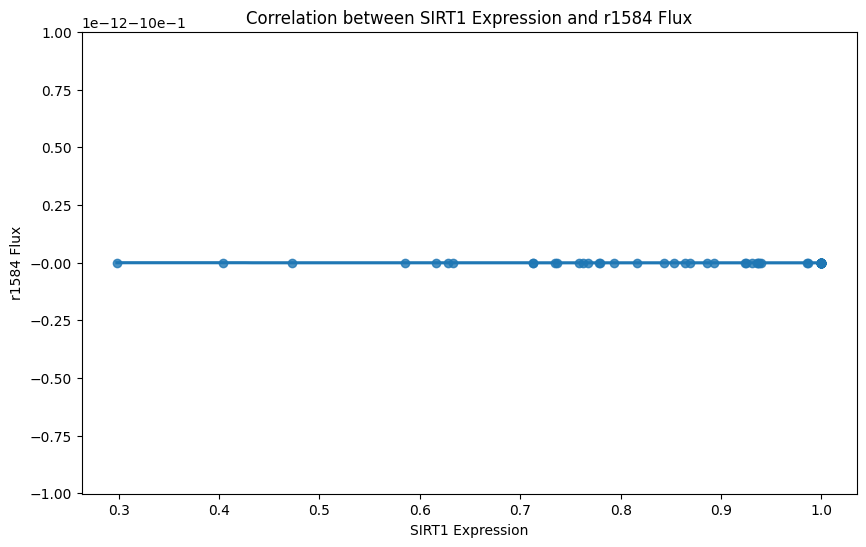

Linear regression results for SIRT1 and r1584:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



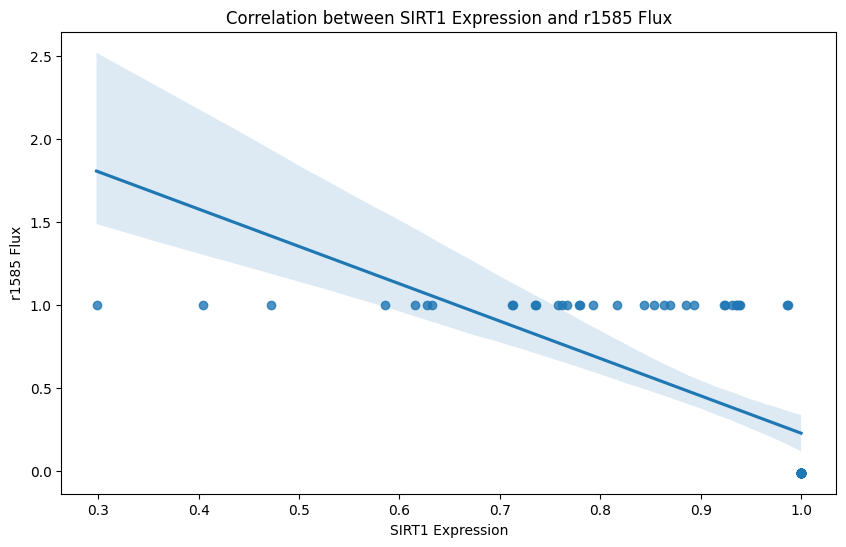

Linear regression results for SIRT1 and r1585:
Slope: -2.248809608410249
Intercept: 2.476949451599713
R-squared: 0.49271140514695716
P-value: 9.117085759106376e-12
Standard error: 0.2747004585374302



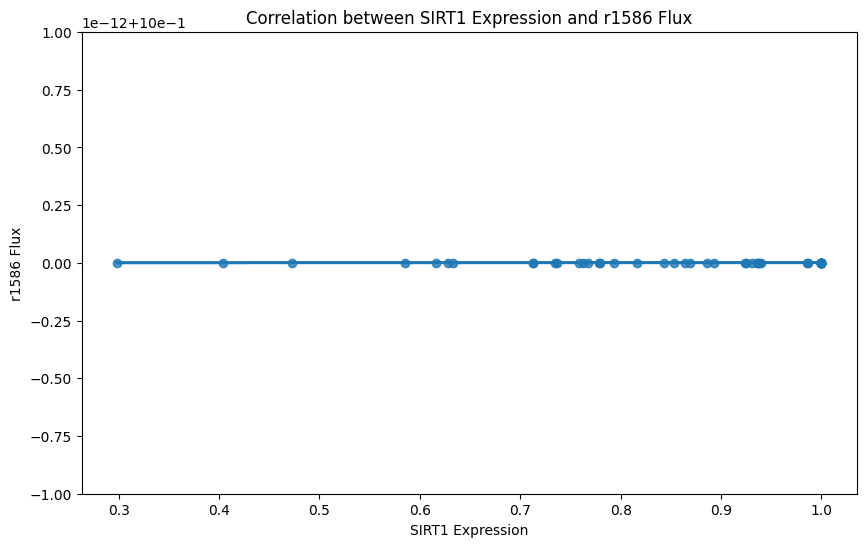

Linear regression results for SIRT1 and r1586:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



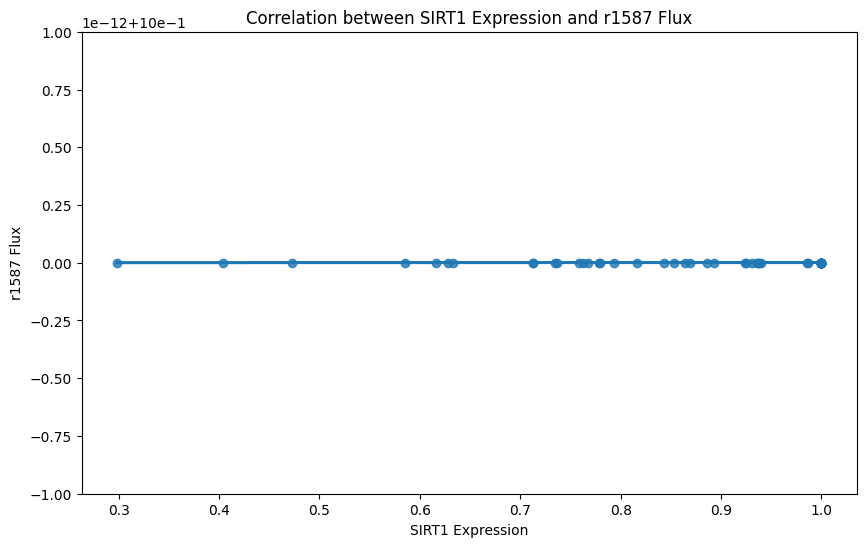

Linear regression results for SIRT1 and r1587:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



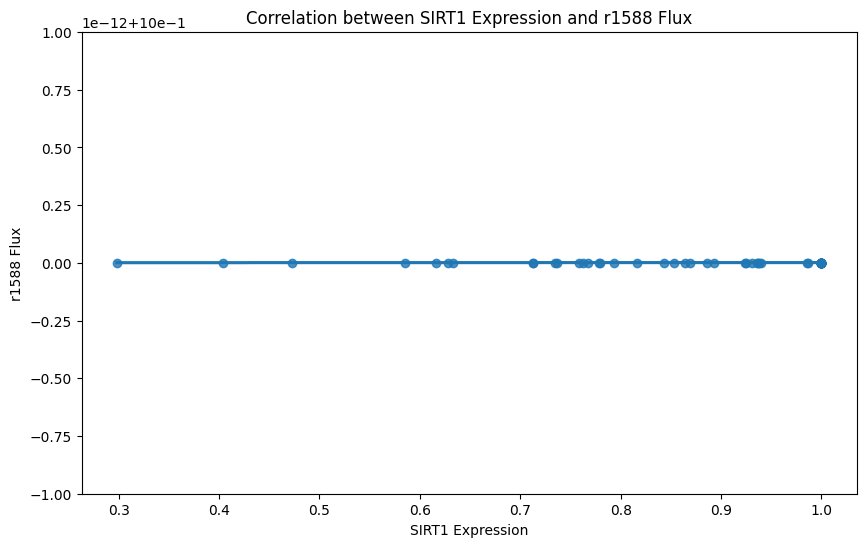

Linear regression results for SIRT1 and r1588:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



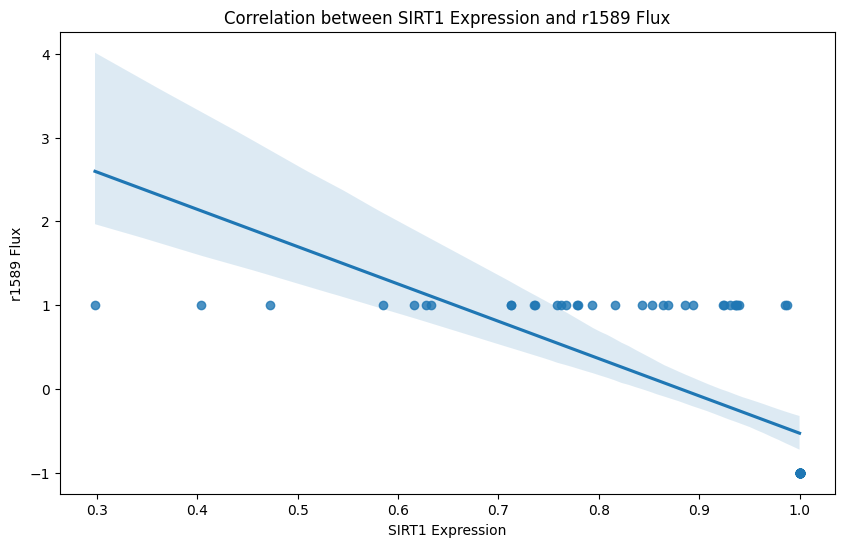

Linear regression results for SIRT1 and r1589:
Slope: -4.453088333485641
Intercept: 3.924652379405372
R-squared: 0.49271140514695716
P-value: 9.117085759106376e-12
Standard error: 0.543961304034515



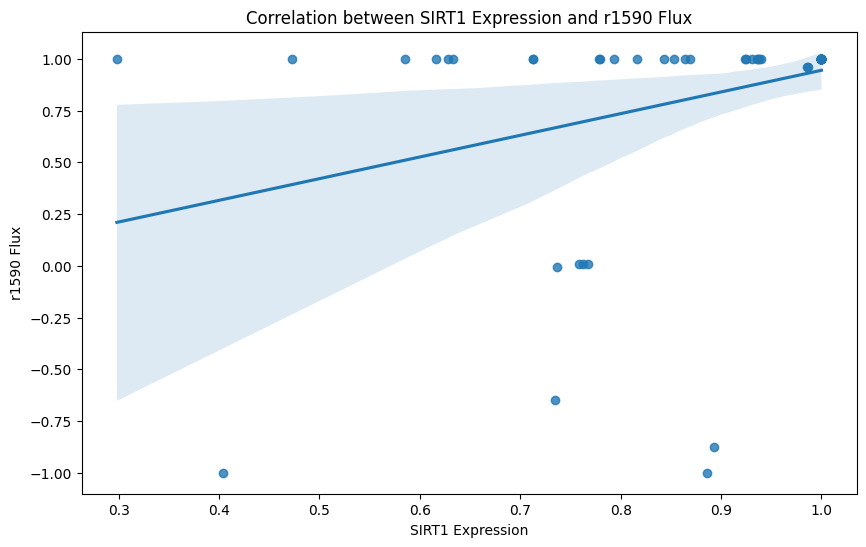

Linear regression results for SIRT1 and r1590:
Slope: 1.0473218488203486
Intercept: -0.10267024556531601
R-squared: 0.11809811930258296
P-value: 0.003343977991625683
Standard error: 0.34454365930398123



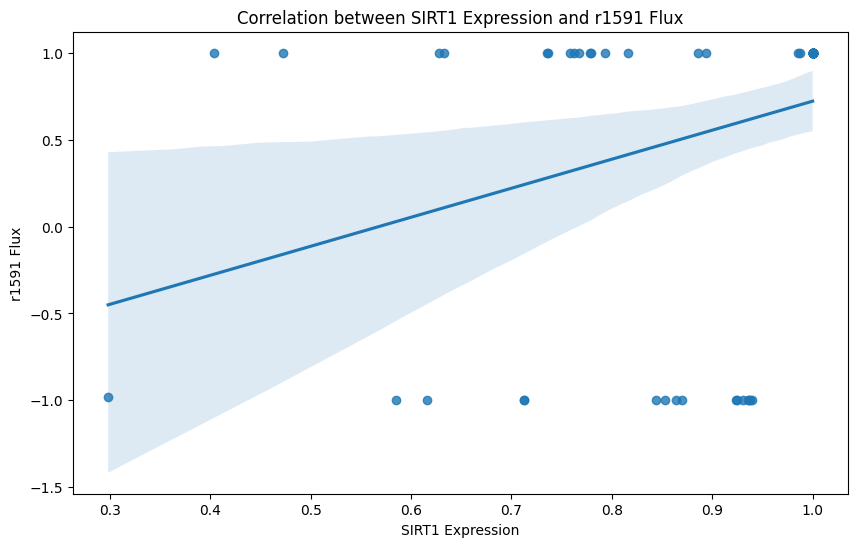

Linear regression results for SIRT1 and r1591:
Slope: 1.669723788864497
Intercept: -0.9484098583600133
R-squared: 0.0988358784492835
P-value: 0.0075834707840270665
Standard error: 0.6069665005455682



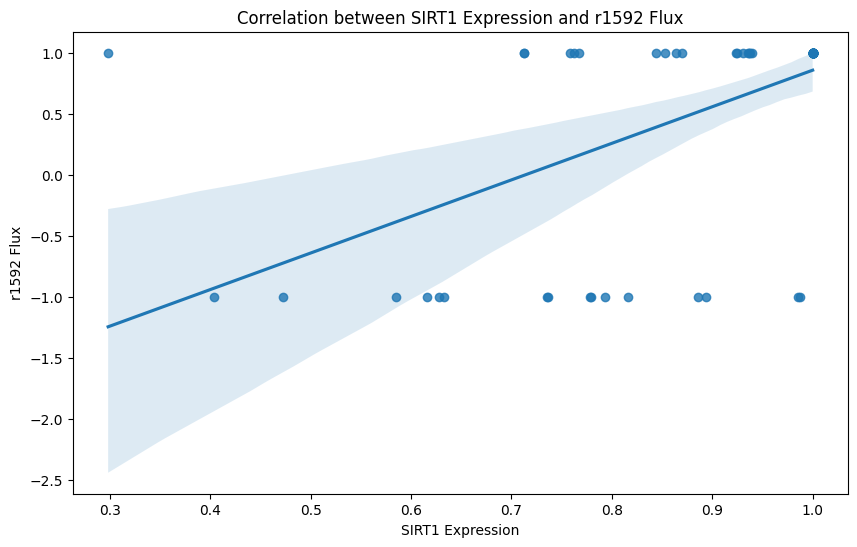

Linear regression results for SIRT1 and r1592:
Slope: 2.9926797370225335
Intercept: -2.1355779241187705
R-squared: 0.3171066471266198
P-value: 3.1856131988815823e-07
Standard error: 0.5287001913498183



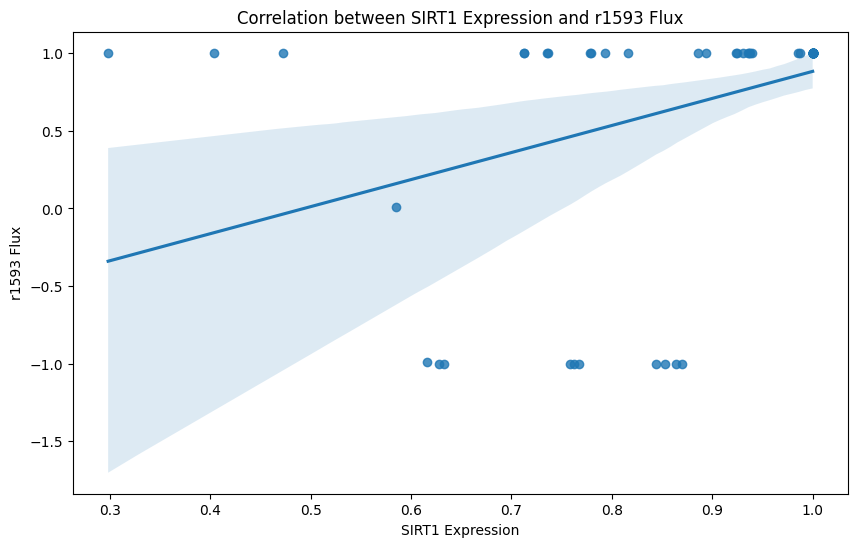

Linear regression results for SIRT1 and r1593:
Slope: 1.7440555370295383
Intercept: -0.8601671801935931
R-squared: 0.15369173315930149
P-value: 0.0007218336942034608
Standard error: 0.4926911967089937



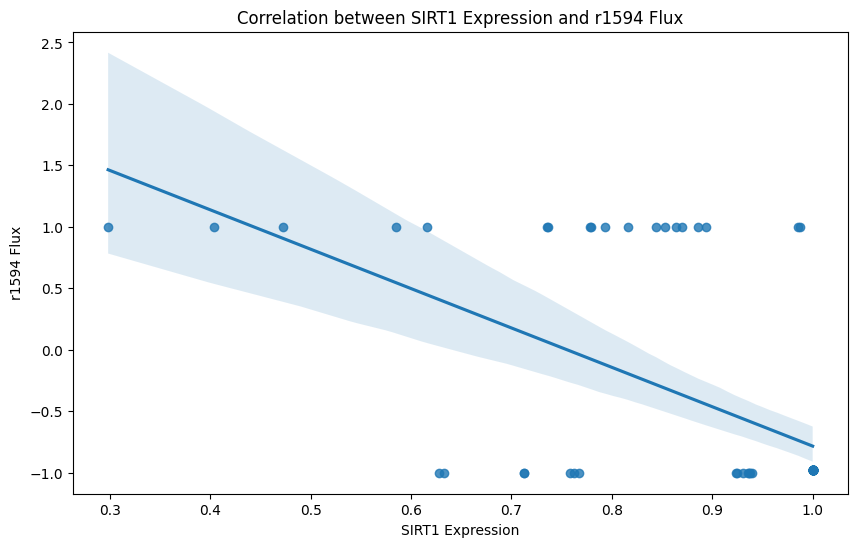

Linear regression results for SIRT1 and r1594:
Slope: -3.202866768788965
Intercept: 2.4193578602759485
R-squared: 0.3282665422657685
P-value: 1.7757471339144772e-07
Standard error: 0.5515685662770072



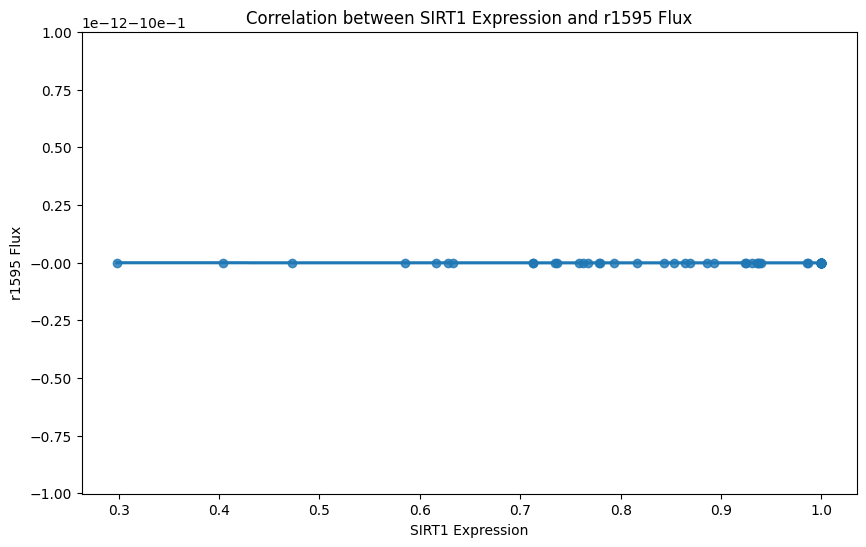

Linear regression results for SIRT1 and r1595:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



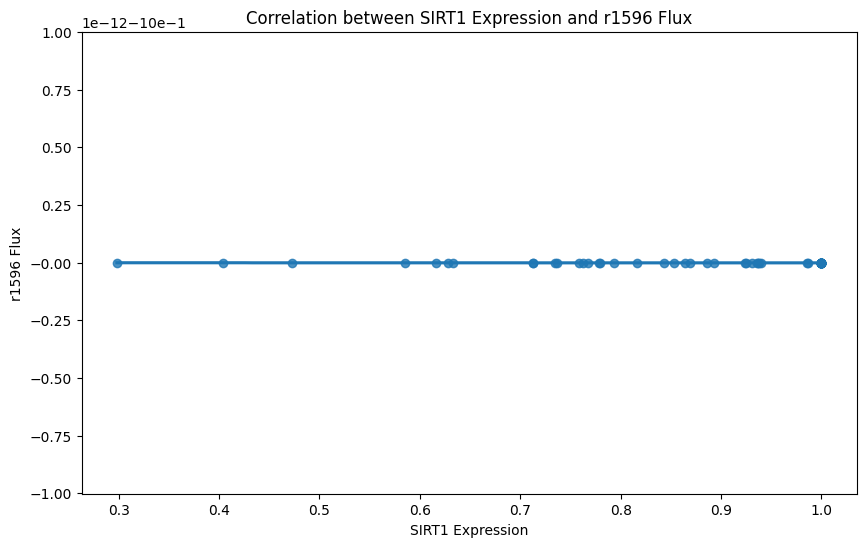

Linear regression results for SIRT1 and r1596:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



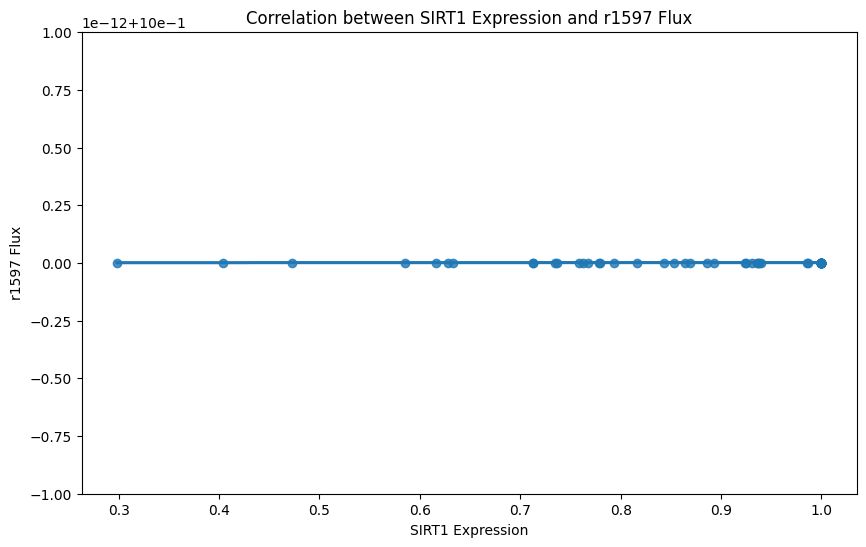

Linear regression results for SIRT1 and r1597:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



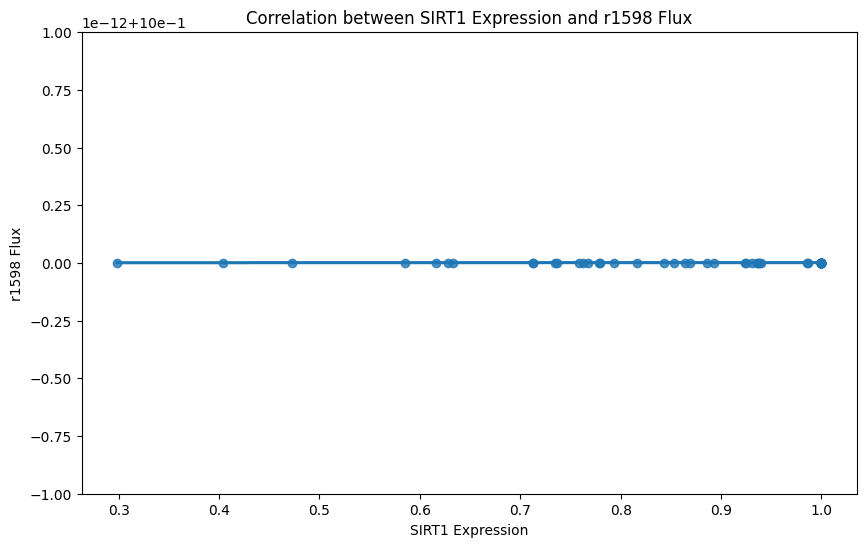

Linear regression results for SIRT1 and r1598:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



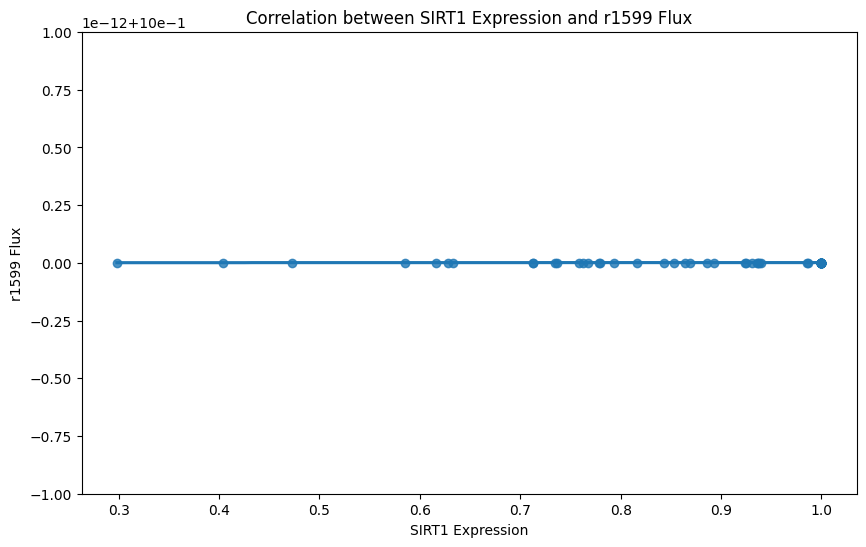

Linear regression results for SIRT1 and r1599:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



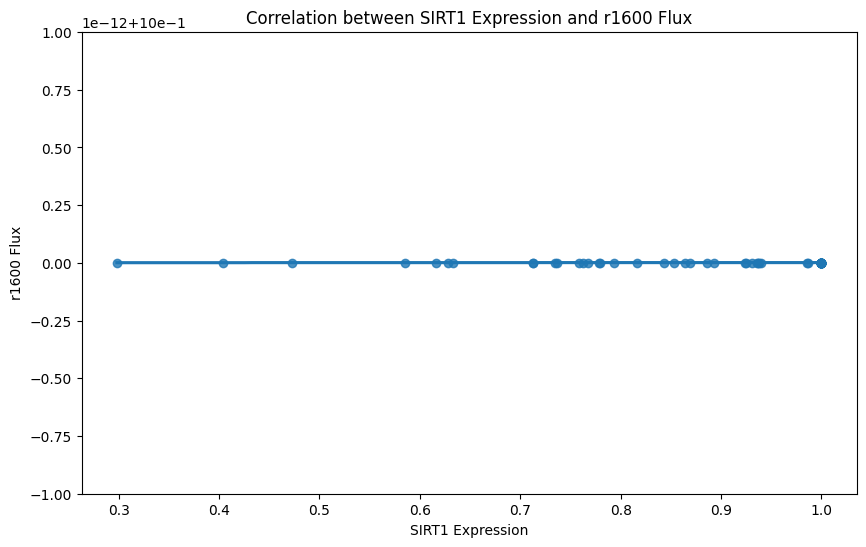

Linear regression results for SIRT1 and r1600:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



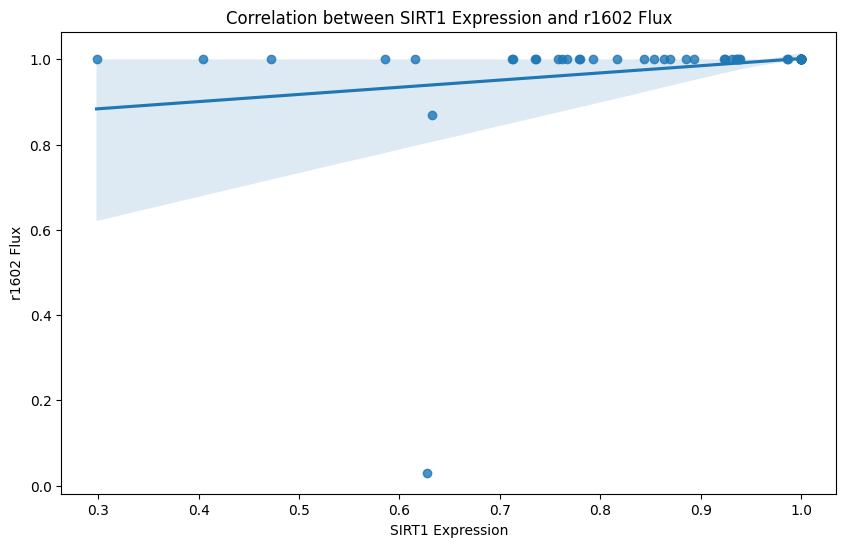

Linear regression results for SIRT1 and r1602:
Slope: 0.1683847122567671
Intercept: 0.8334469050615518
R-squared: 0.05291020463087801
P-value: 0.053636503228677634
Standard error: 0.08576379138830634



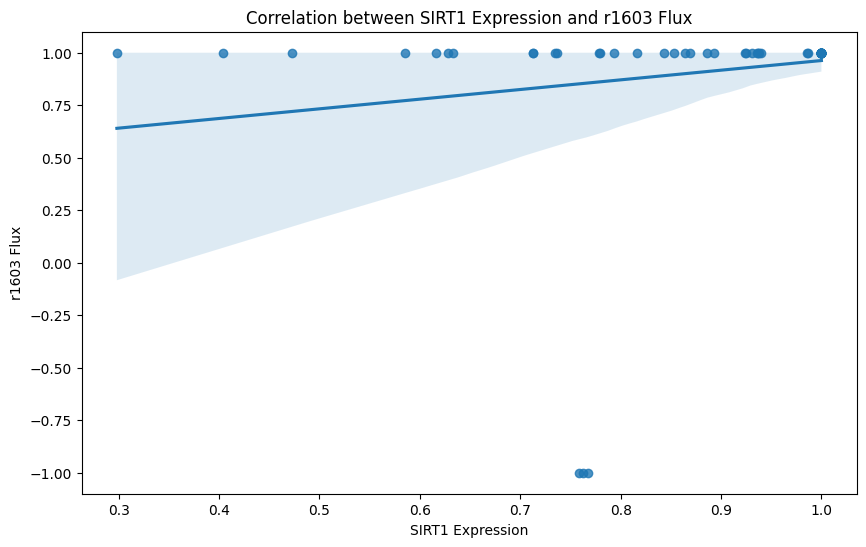

Linear regression results for SIRT1 and r1603:
Slope: 0.4599498117830473
Intercept: 0.5028503561570392
R-squared: 0.03231158447371463
P-value: 0.13361473388151202
Standard error: 0.3030222673966105



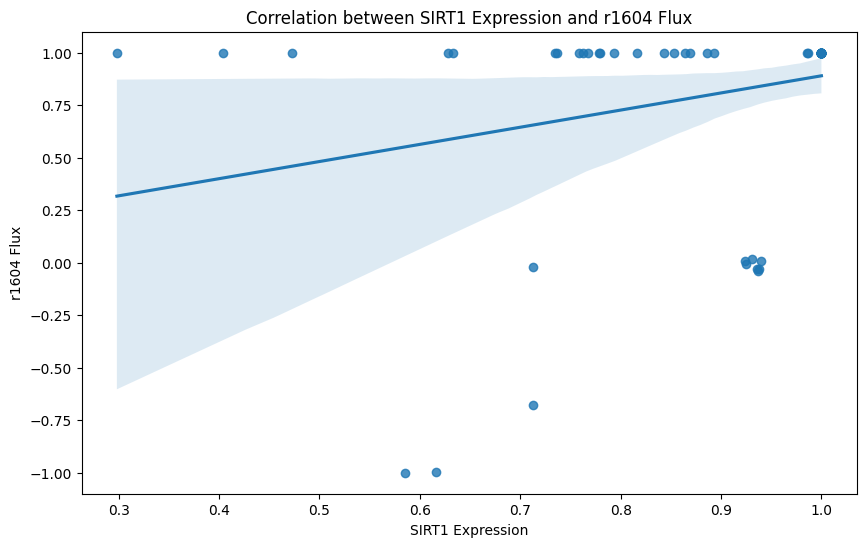

Linear regression results for SIRT1 and r1604:
Slope: 0.8165827913662529
Intercept: 0.07357192995426887
R-squared: 0.07172262957077102
P-value: 0.023947115770003205
Standard error: 0.35366041955660454



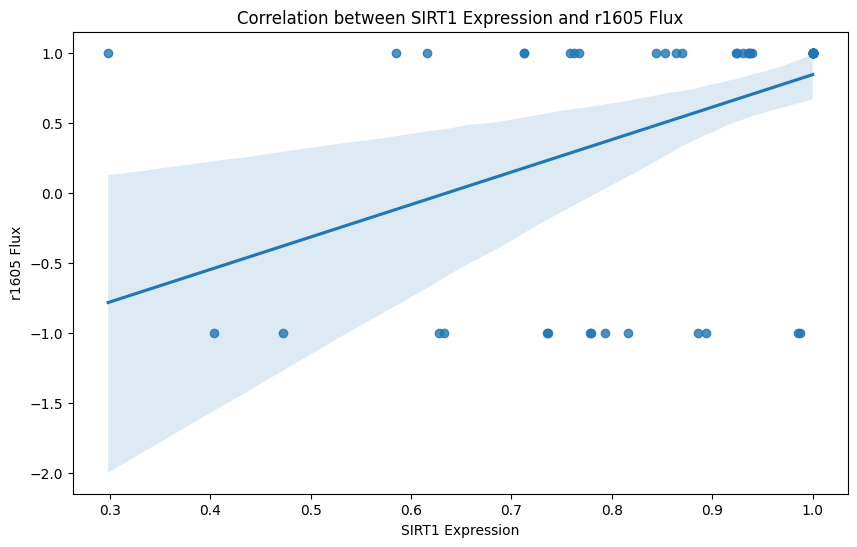

Linear regression results for SIRT1 and r1605:
Slope: 2.31658142974286
Intercept: -1.472680316406553
R-squared: 0.20953654639151145
P-value: 5.978221950557923e-05
Standard error: 0.5416690634009339



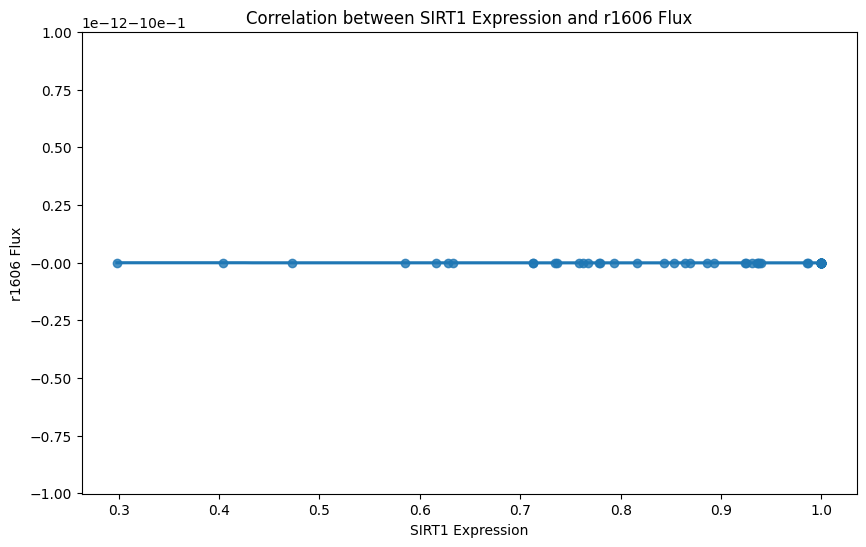

Linear regression results for SIRT1 and r1606:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



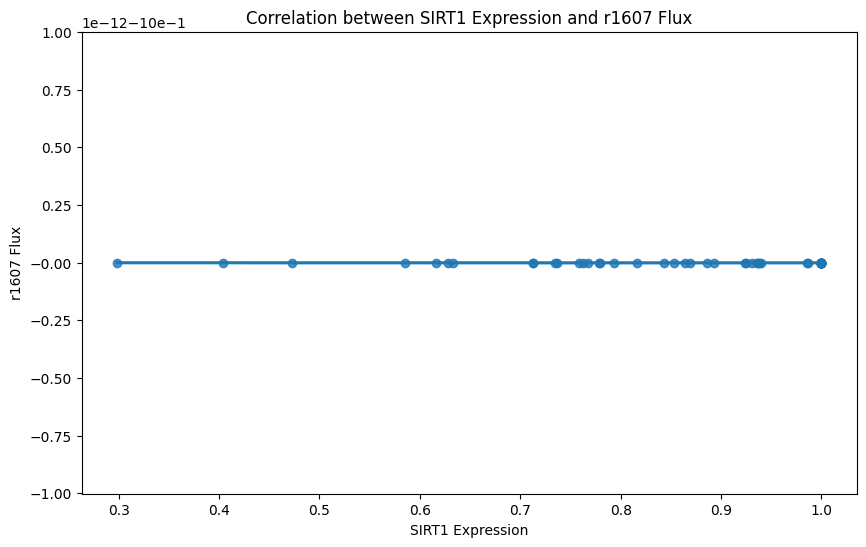

Linear regression results for SIRT1 and r1607:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



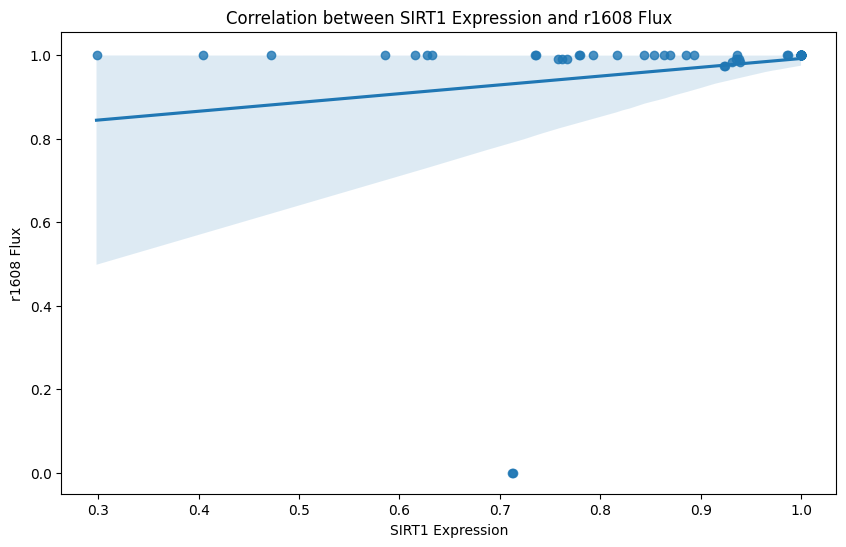

Linear regression results for SIRT1 and r1608:
Slope: 0.21047154492422762
Intercept: 0.781049452750209
R-squared: 0.04012832778005748
P-value: 0.09393519414169535
Standard error: 0.12392242399537899



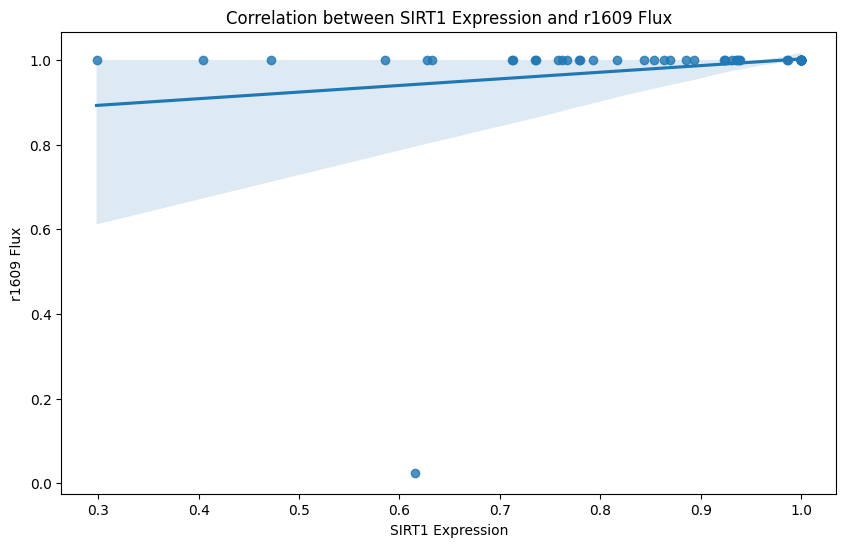

Linear regression results for SIRT1 and r1609:
Slope: 0.15635131245880307
Intercept: 0.8459964384534866
R-squared: 0.045777985204467665
P-value: 0.07318891836043281
Standard error: 0.08593564966790358



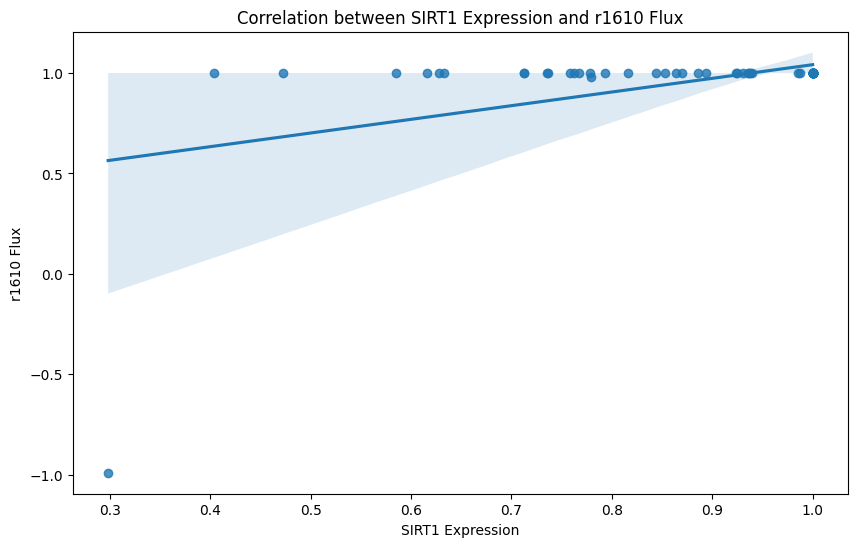

Linear regression results for SIRT1 and r1610:
Slope: 0.6802763768238687
Intercept: 0.36138341582643363
R-squared: 0.2081191580341423
P-value: 6.378632193696136e-05
Standard error: 0.15974774360231409



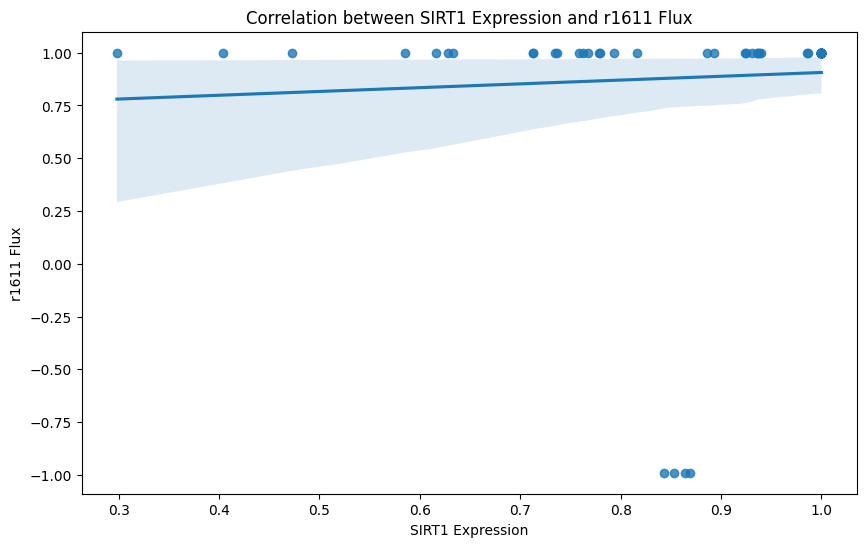

Linear regression results for SIRT1 and r1611:
Slope: 0.17980328480743074
Intercept: 0.7265821319513148
R-squared: 0.003796810480014604
P-value: 0.6097191848672443
Standard error: 0.35062072248009657



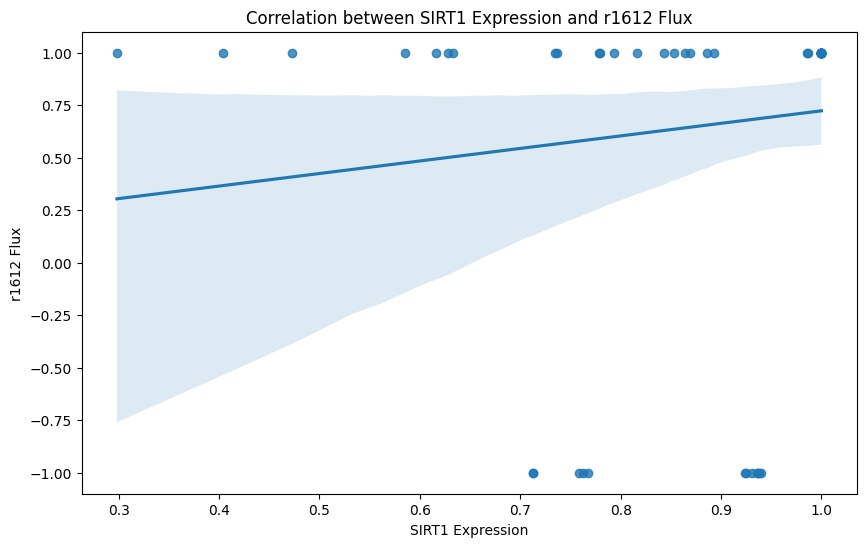

Linear regression results for SIRT1 and r1612:
Slope: 0.5973161737361646
Intercept: 0.1260914075404953
R-squared: 0.01570156071469649
P-value: 0.2977755643018029
Standard error: 0.5693400247399295



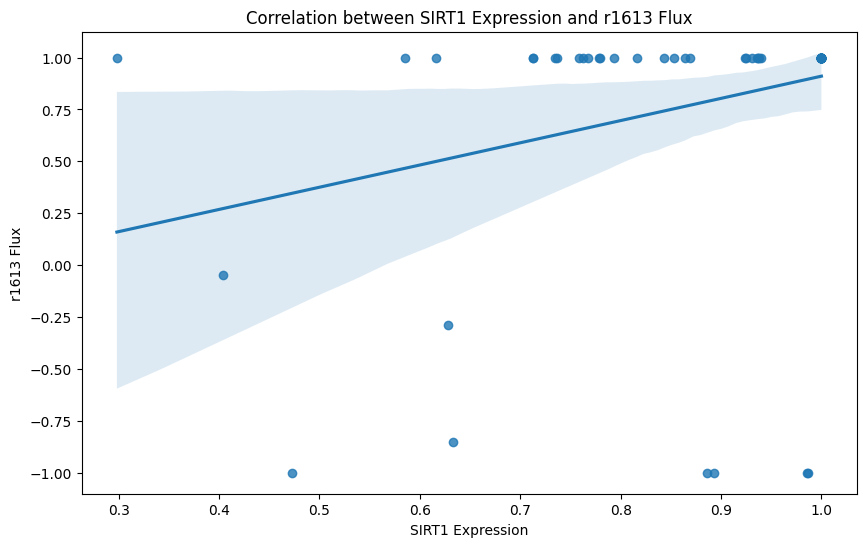

Linear regression results for SIRT1 and r1613:
Slope: 1.0700002987648767
Intercept: -0.15981795455104708
R-squared: 0.08603669269908822
P-value: 0.013044286376301211
Standard error: 0.41983813109343726



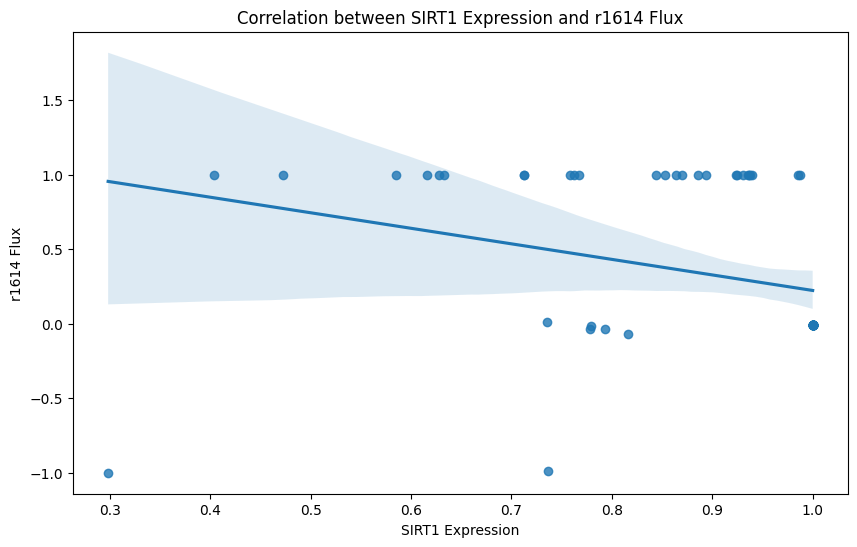

Linear regression results for SIRT1 and r1614:
Slope: -1.0430912604431322
Intercept: 1.2664455866222226
R-squared: 0.09440950264374134
P-value: 0.009148508149585684
Standard error: 0.3889160218411788



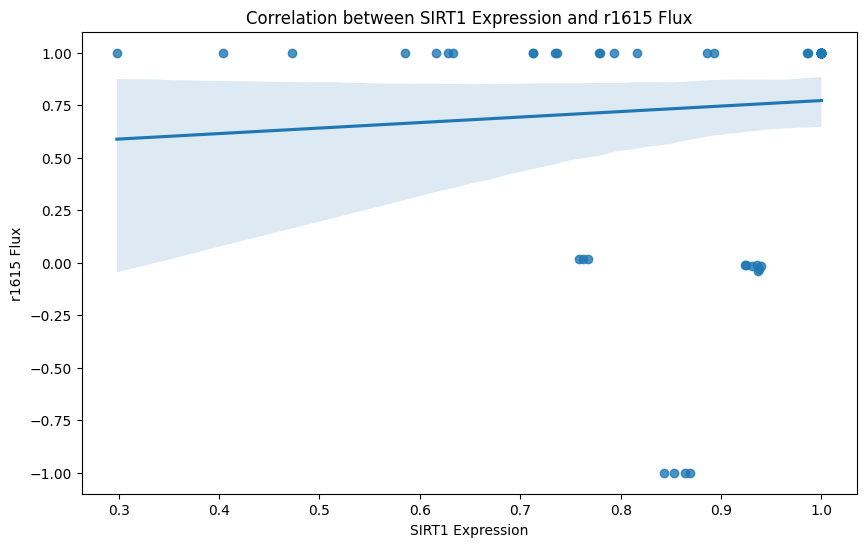

Linear regression results for SIRT1 and r1615:
Slope: 0.26216262877173296
Intercept: 0.5101184726110801
R-squared: 0.005594777712222262
P-value: 0.5352950004421135
Standard error: 0.42076200696227467



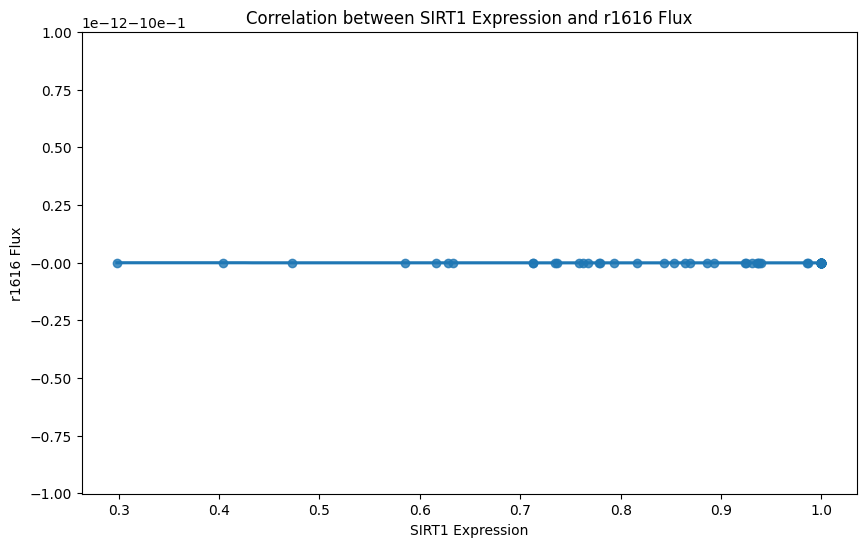

Linear regression results for SIRT1 and r1616:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



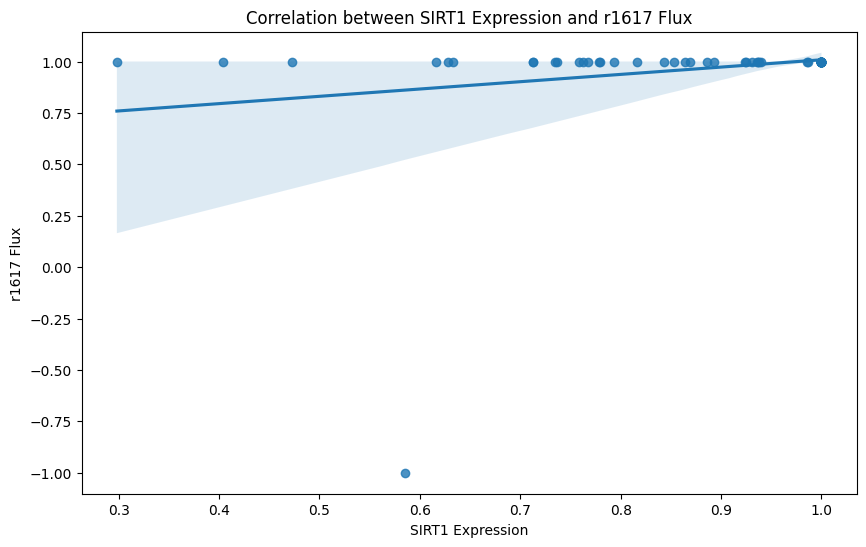

Linear regression results for SIRT1 and r1617:
Slope: 0.35538716736909726
Intercept: 0.6529976459995535
R-squared: 0.05622246597043323
P-value: 0.046483561953571326
Standard error: 0.17528997088540002



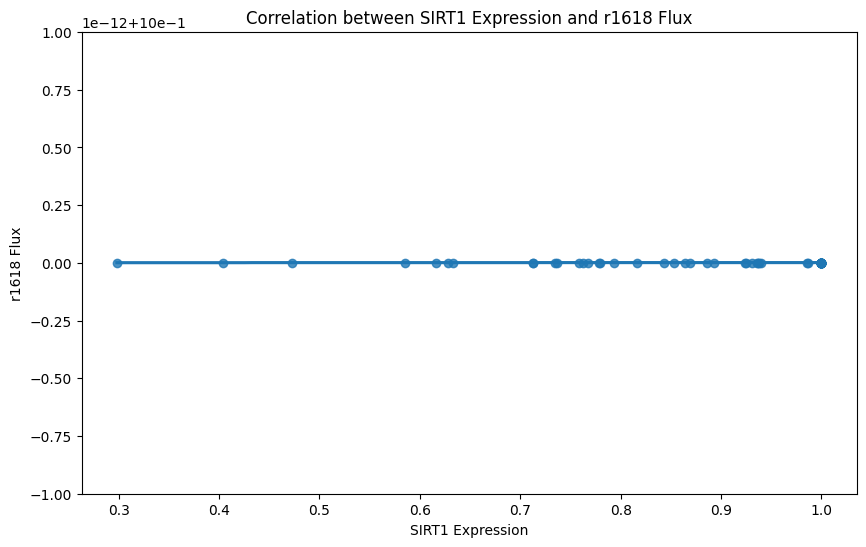

Linear regression results for SIRT1 and r1618:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



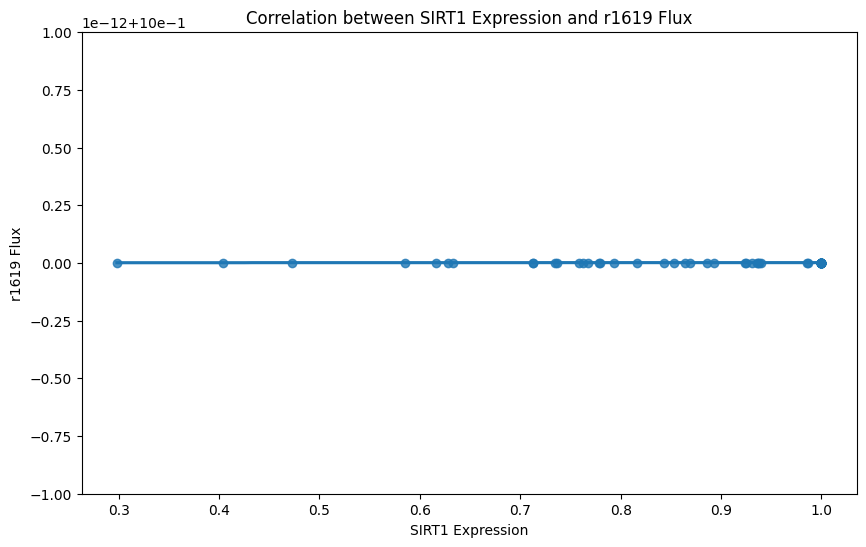

Linear regression results for SIRT1 and r1619:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



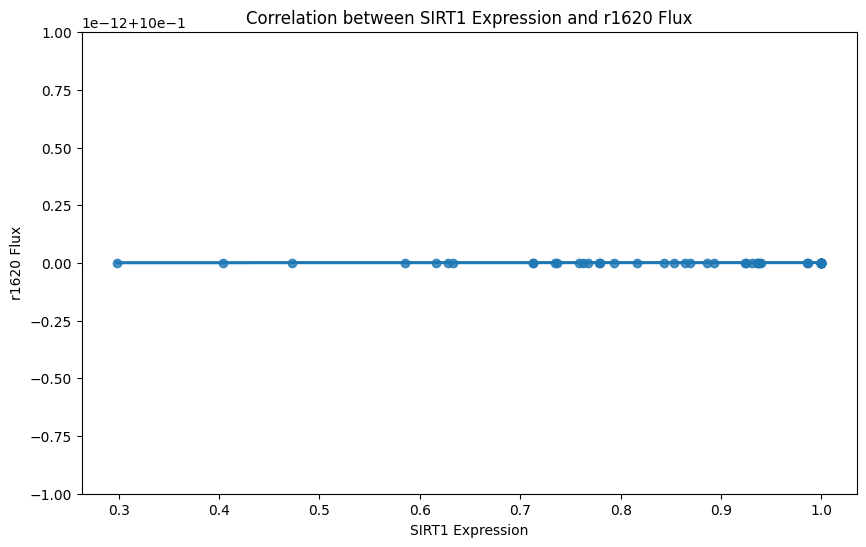

Linear regression results for SIRT1 and r1620:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



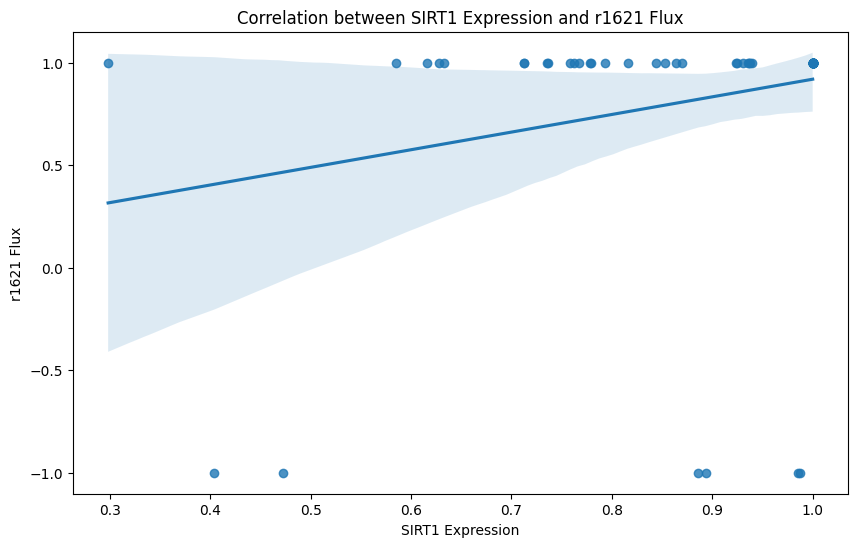

Linear regression results for SIRT1 and r1621:
Slope: 0.8599720808828119
Intercept: 0.059464528465733246
R-squared: 0.05908423661690927
P-value: 0.04109654532577273
Standard error: 0.4131420161255802



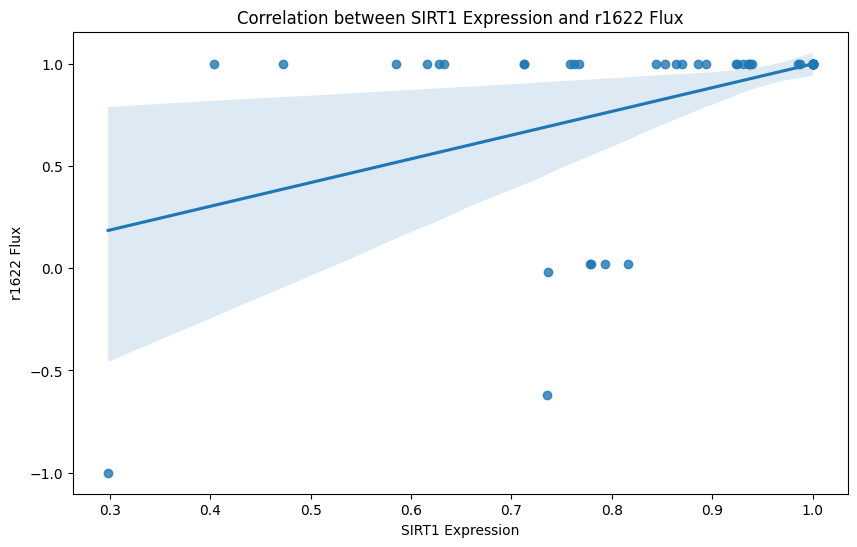

Linear regression results for SIRT1 and r1622:
Slope: 1.1601973889203279
Intercept: -0.16129021283112754
R-squared: 0.2259372032672052
P-value: 2.8041006988581197e-05
Standard error: 0.25852441343980453



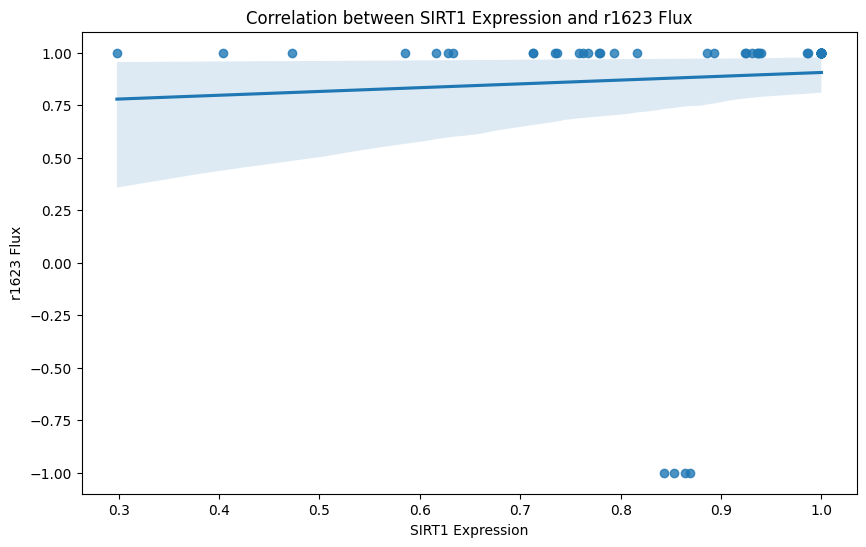

Linear regression results for SIRT1 and r1623:
Slope: 0.1807145376690292
Intercept: 0.7251964352720891
R-squared: 0.003796810480014604
P-value: 0.6097191848672443
Standard error: 0.3523976874395404



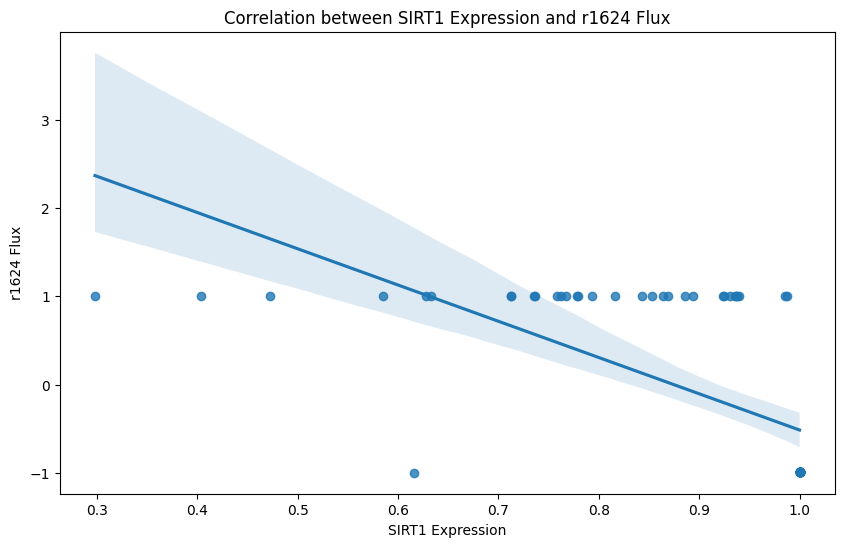

Linear regression results for SIRT1 and r1624:
Slope: -4.110126856121475
Intercept: 3.5941486116497283
R-squared: 0.4258971360529328
P-value: 6.974902523344457e-10
Standard error: 0.5744777036927143



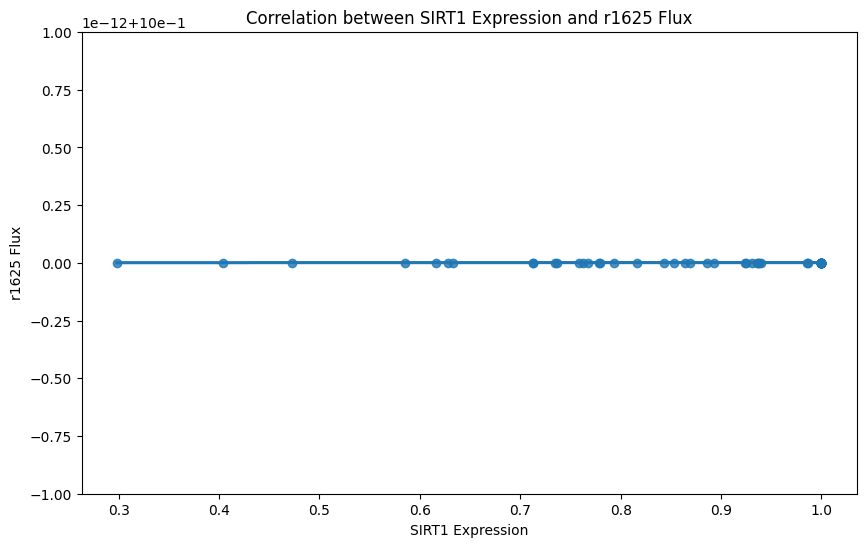

Linear regression results for SIRT1 and r1625:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



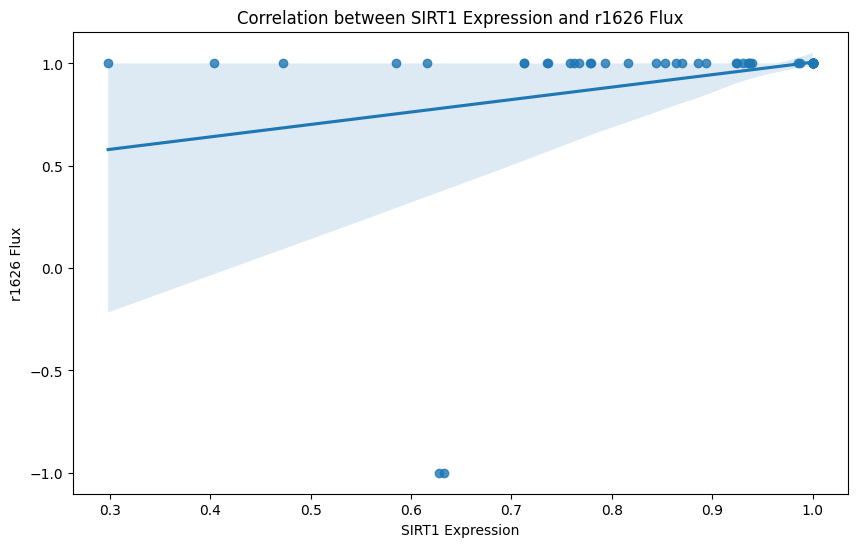

Linear regression results for SIRT1 and r1626:
Slope: 0.6083745076256553
Intercept: 0.39786059712413446
R-squared: 0.0835661628268614
P-value: 0.014484132539722527
Standard error: 0.24253911585052393



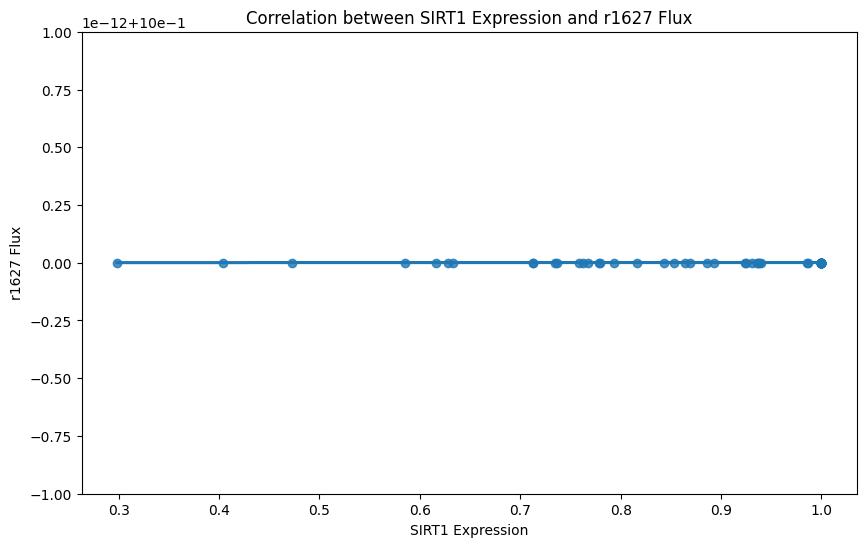

Linear regression results for SIRT1 and r1627:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



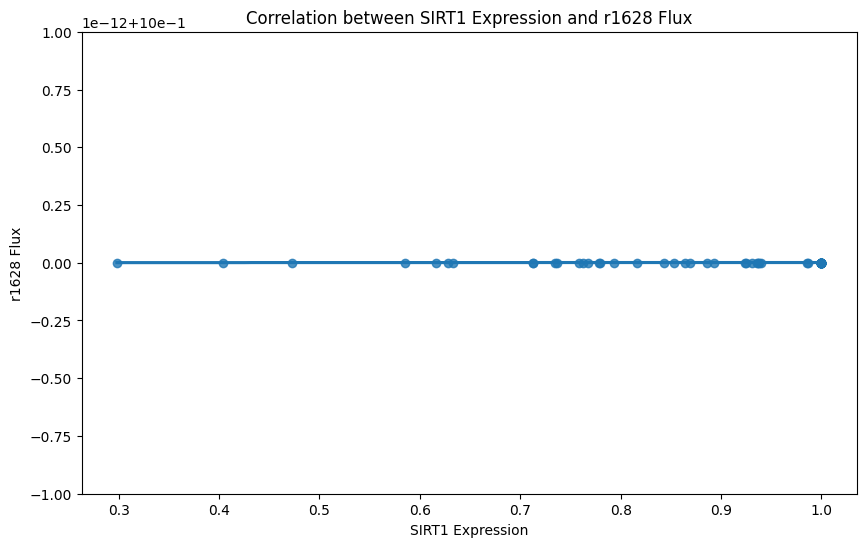

Linear regression results for SIRT1 and r1628:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



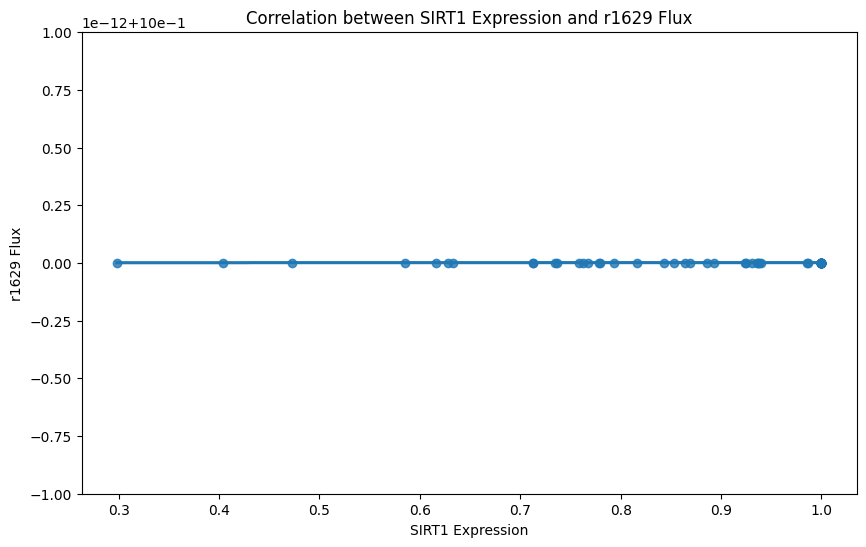

Linear regression results for SIRT1 and r1629:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



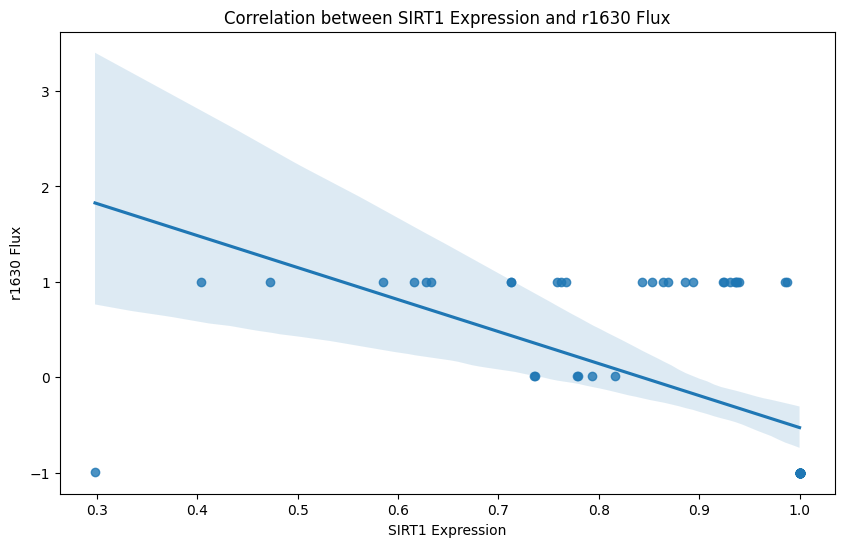

Linear regression results for SIRT1 and r1630:
Slope: -3.3542460914419907
Intercept: 2.8271391990084527
R-squared: 0.31535844289081516
P-value: 3.488248825471395e-07
Standard error: 0.5949764473680659



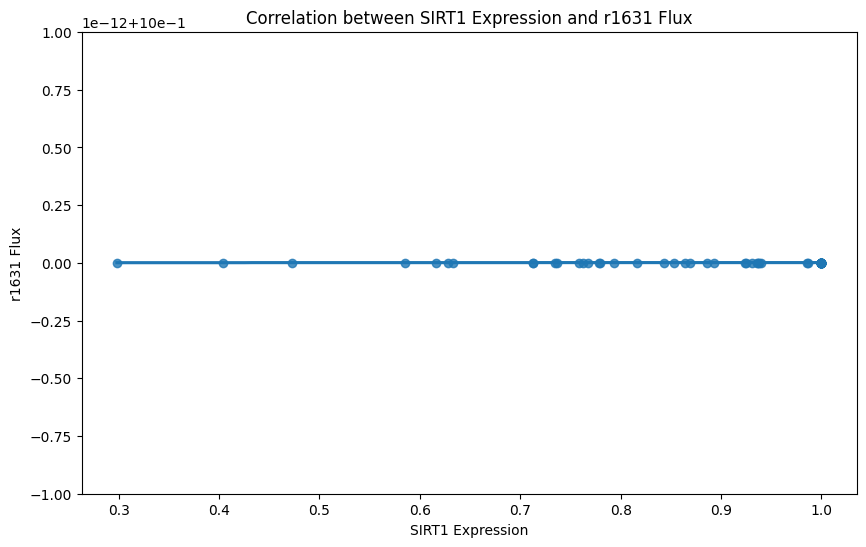

Linear regression results for SIRT1 and r1631:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



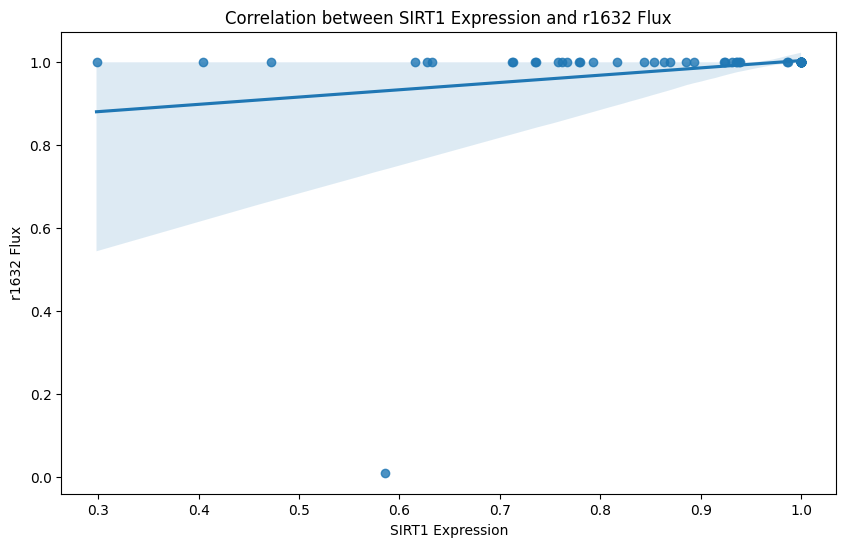

Linear regression results for SIRT1 and r1632:
Slope: 0.17592412443355238
Intercept: 0.8282265345824682
R-squared: 0.056222465970433275
P-value: 0.046483561953571235
Standard error: 0.08677222331432549



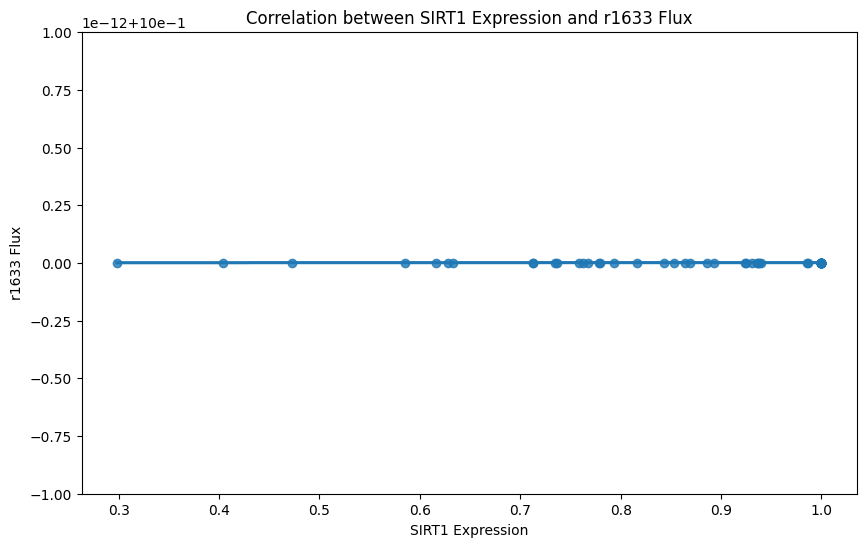

Linear regression results for SIRT1 and r1633:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



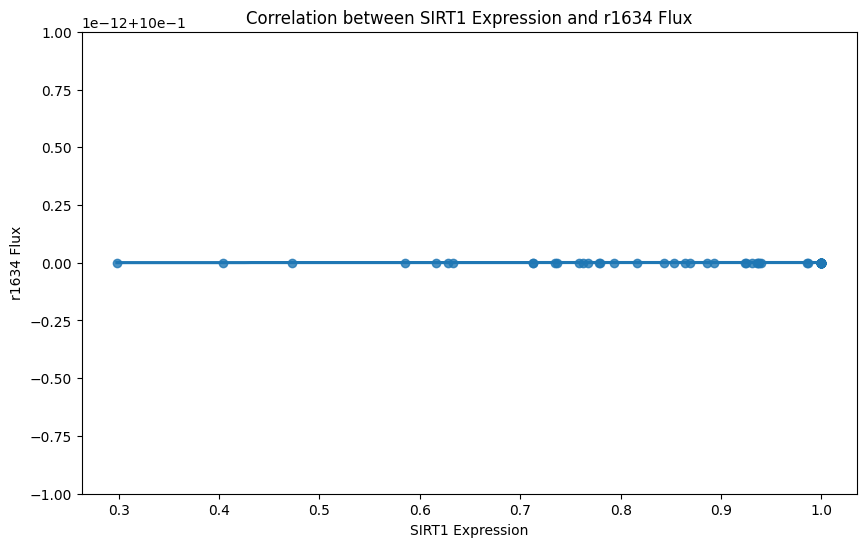

Linear regression results for SIRT1 and r1634:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



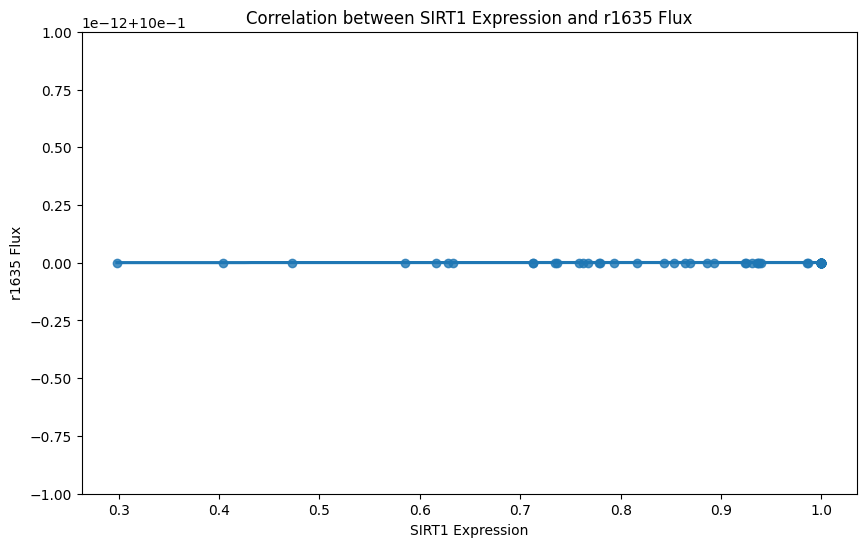

Linear regression results for SIRT1 and r1635:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



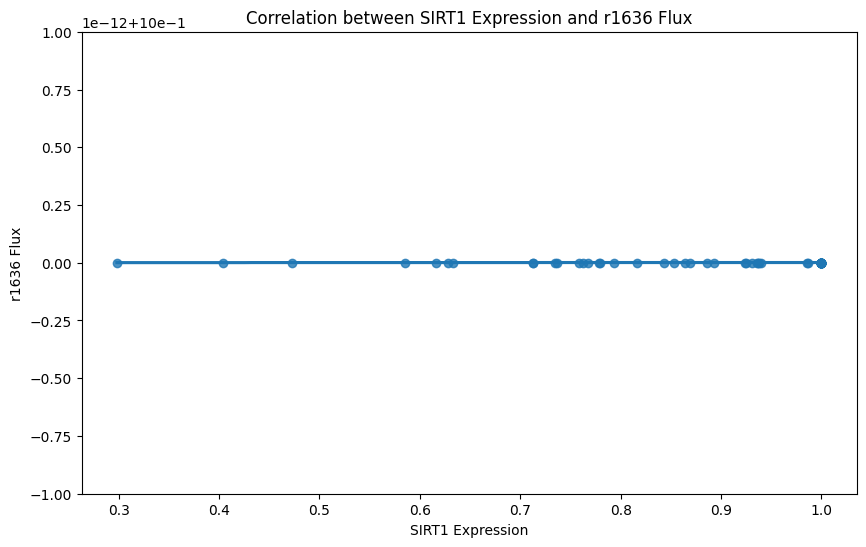

Linear regression results for SIRT1 and r1636:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



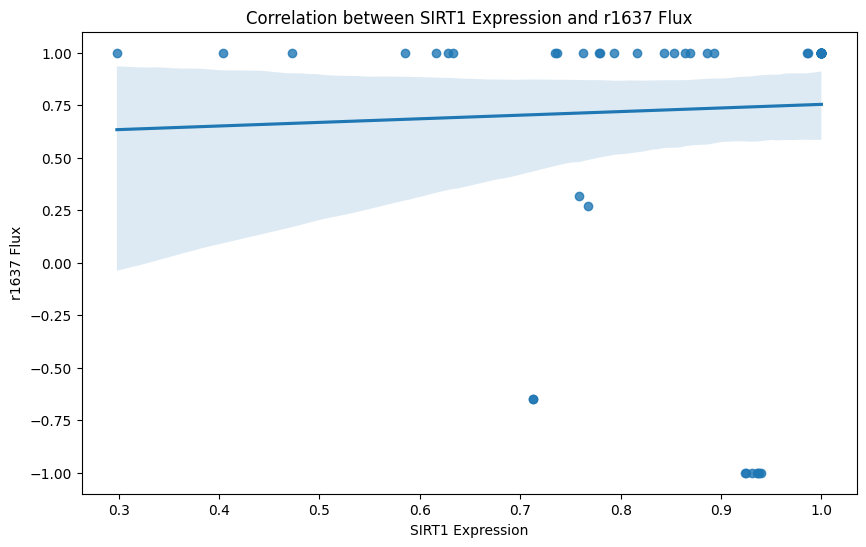

Linear regression results for SIRT1 and r1637:
Slope: 0.17171815824283965
Intercept: 0.5823968574171345
R-squared: 0.0017540160789676423
P-value: 0.7287538297158691
Standard error: 0.4931666239670587



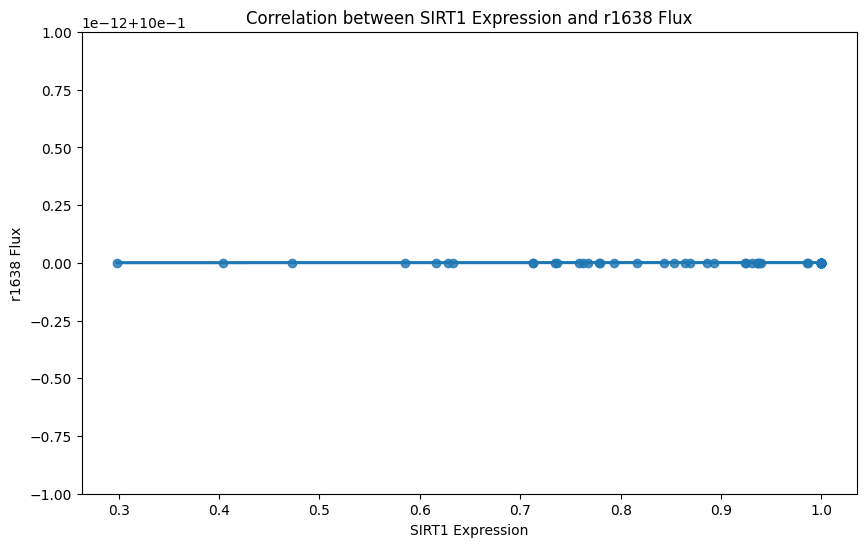

Linear regression results for SIRT1 and r1638:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



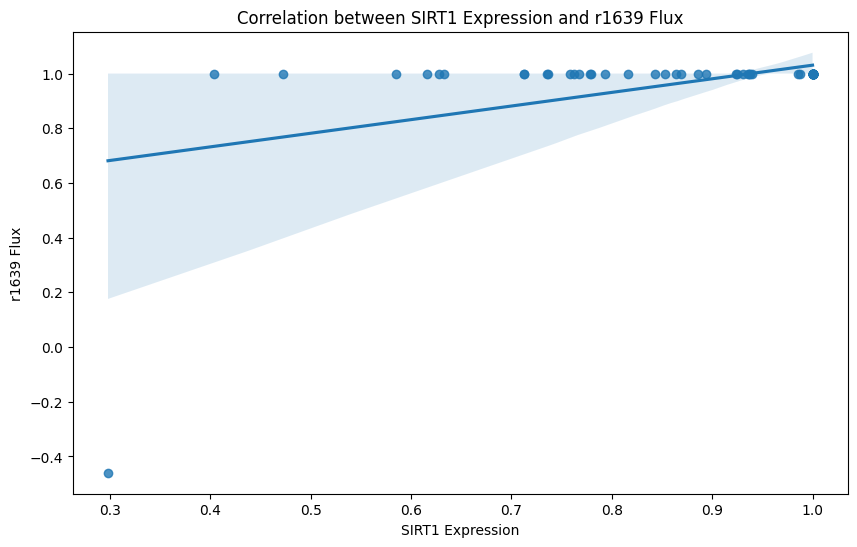

Linear regression results for SIRT1 and r1639:
Slope: 0.497942478027851
Intercept: 0.5327169937166766
R-squared: 0.2072618539693416
P-value: 6.633427550943736e-05
Standard error: 0.11723568353521228



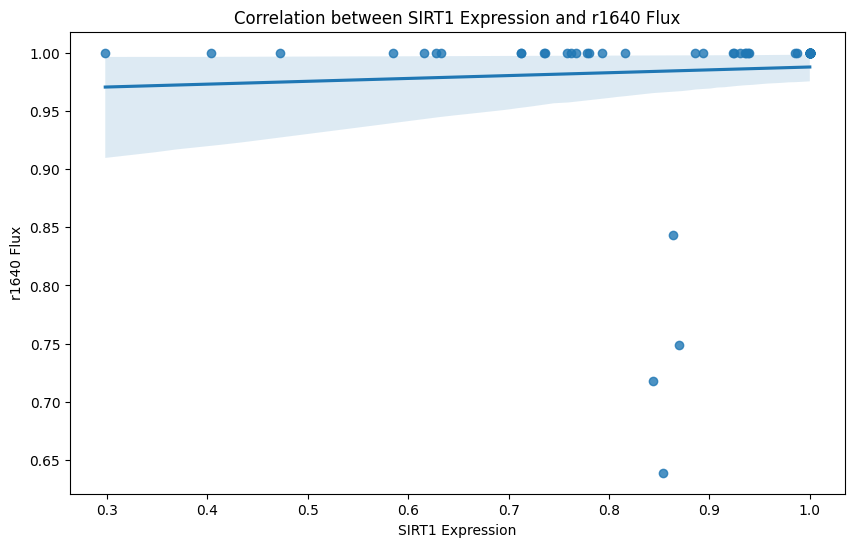

Linear regression results for SIRT1 and r1640:
Slope: 0.024560436899772786
Intercept: 0.9631731981563021
R-squared: 0.0037596026215759885
P-value: 0.6114798704448201
Standard error: 0.0481307517578935



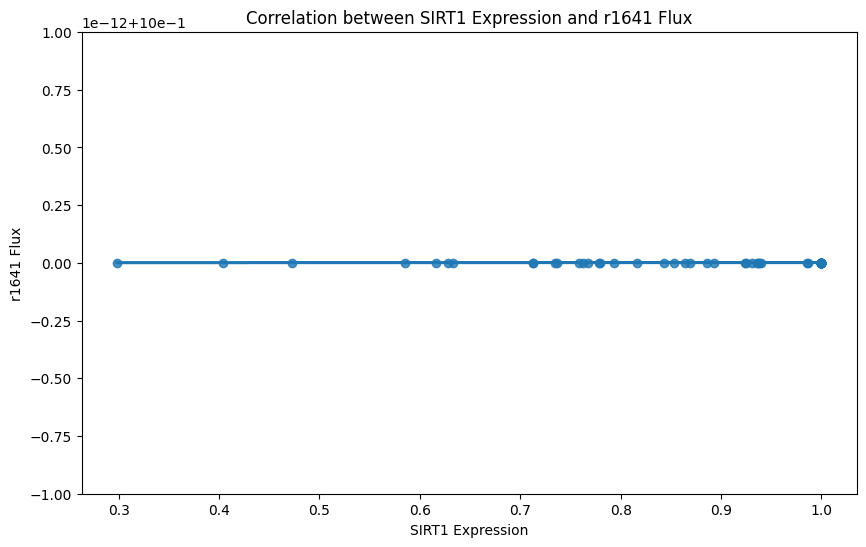

Linear regression results for SIRT1 and r1641:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



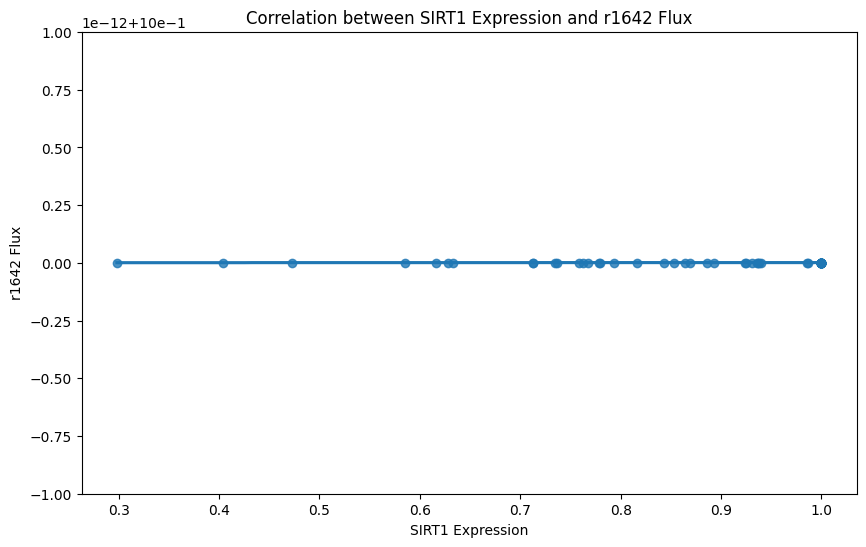

Linear regression results for SIRT1 and r1642:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



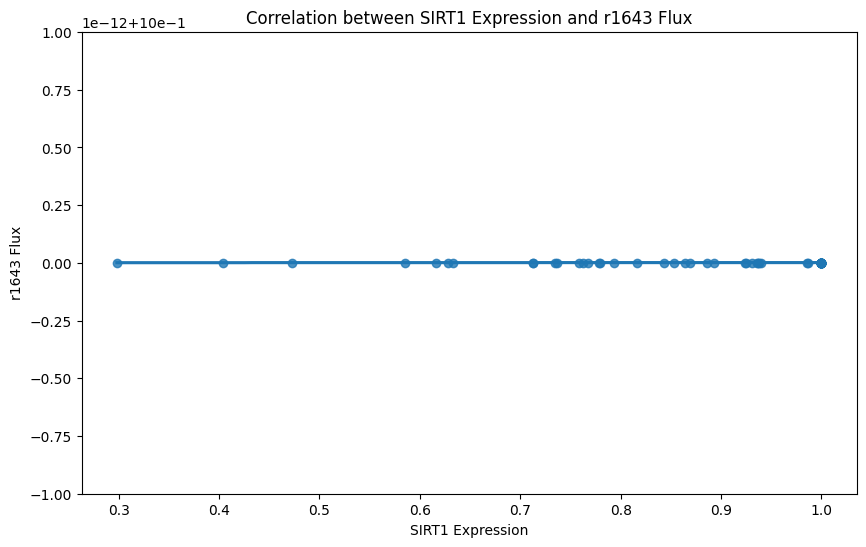

Linear regression results for SIRT1 and r1643:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



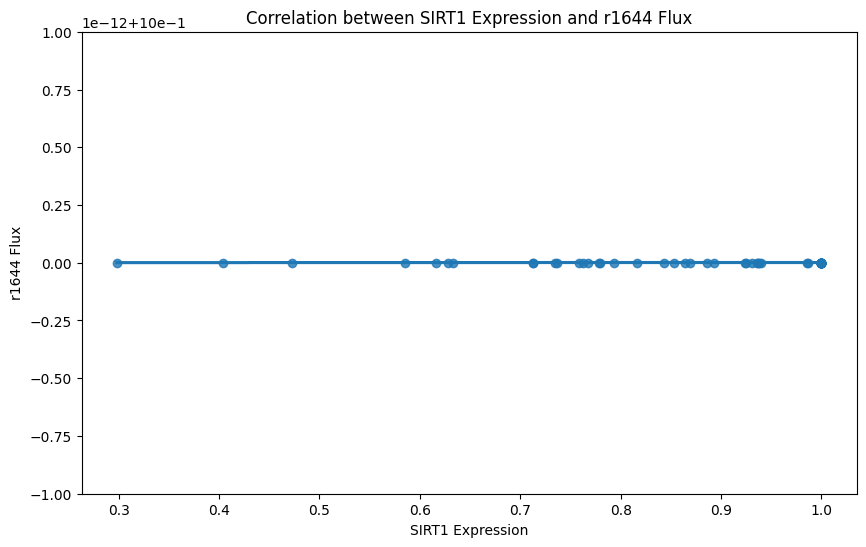

Linear regression results for SIRT1 and r1644:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



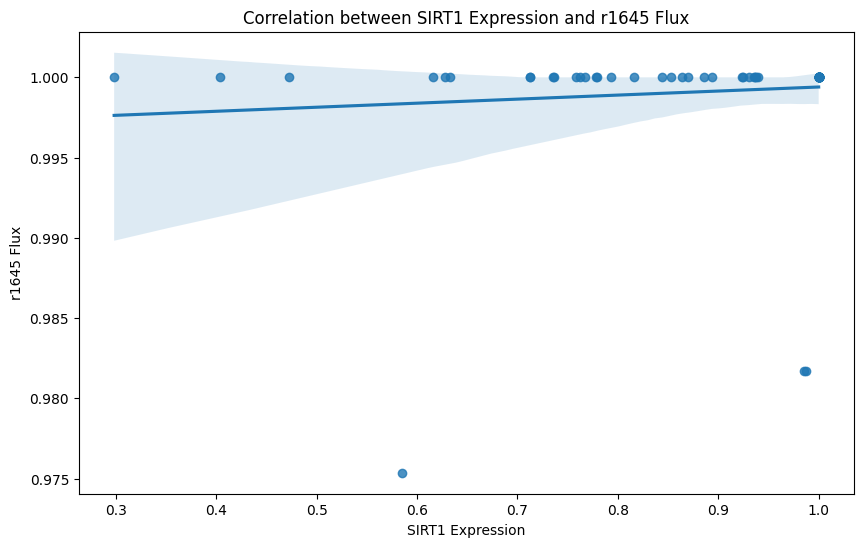

Linear regression results for SIRT1 and r1645:
Slope: 0.002520369552261082
Intercept: 0.9968773346995782
R-squared: 0.009128692971219432
P-value: 0.4280136326626276
Standard error: 0.003161142000563229



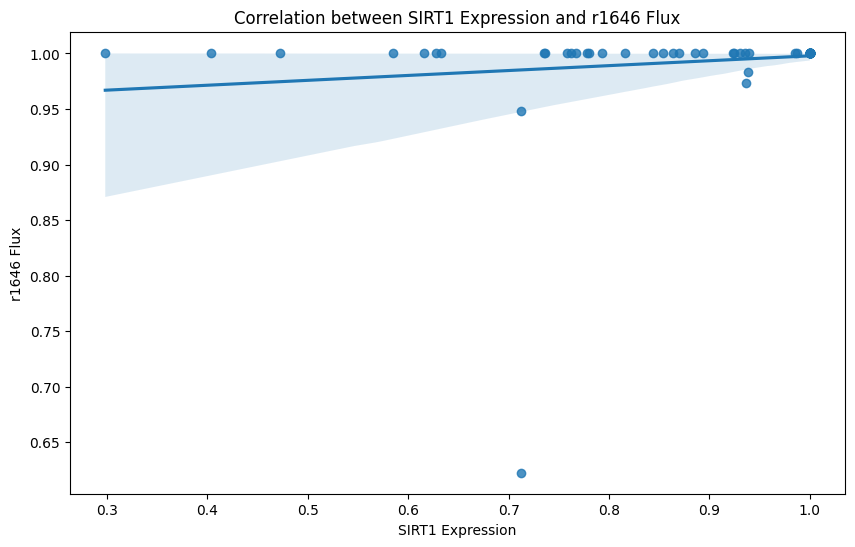

Linear regression results for SIRT1 and r1646:
Slope: 0.04413354132633312
Intercept: 0.953746600374434
R-squared: 0.023892897884486532
P-value: 0.19806281581977467
Standard error: 0.033959286318797334



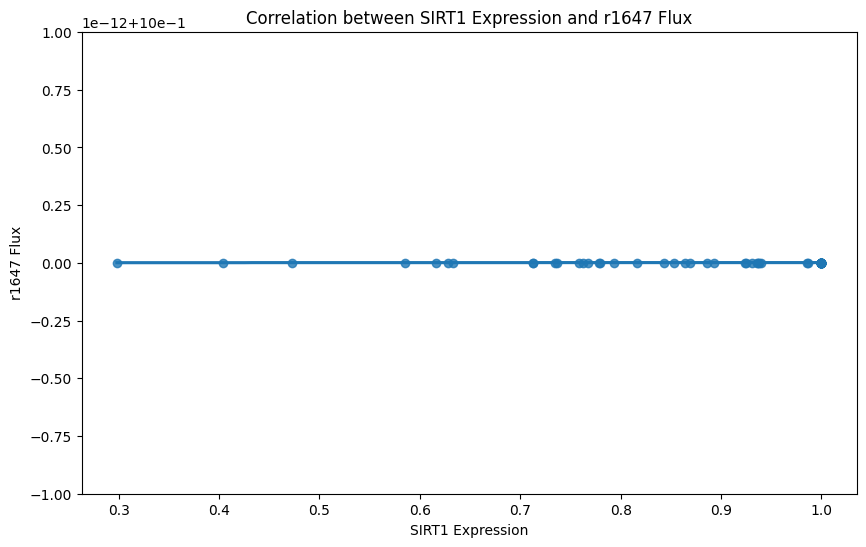

Linear regression results for SIRT1 and r1647:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



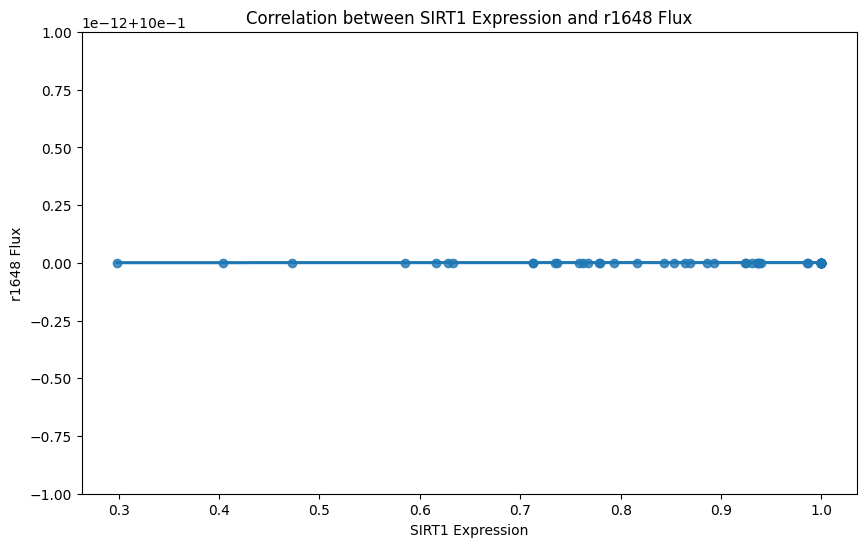

Linear regression results for SIRT1 and r1648:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



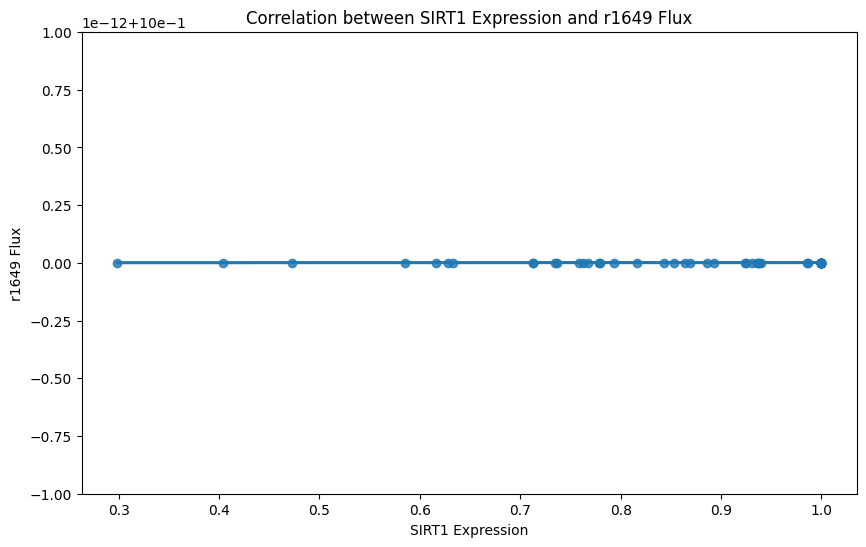

Linear regression results for SIRT1 and r1649:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



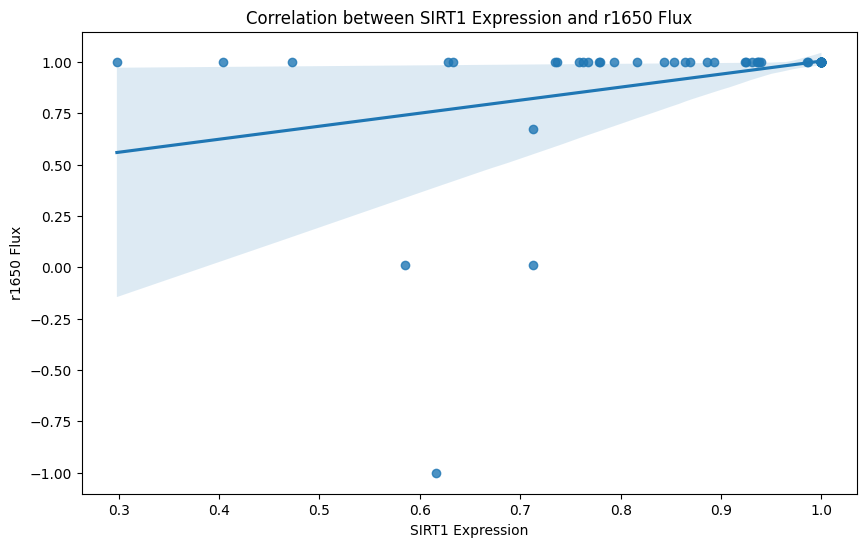

Linear regression results for SIRT1 and r1650:
Slope: 0.6344456511042037
Intercept: 0.37021167017180245
R-squared: 0.12189805962595555
P-value: 0.0028432341560681177
Standard error: 0.20499532247388286



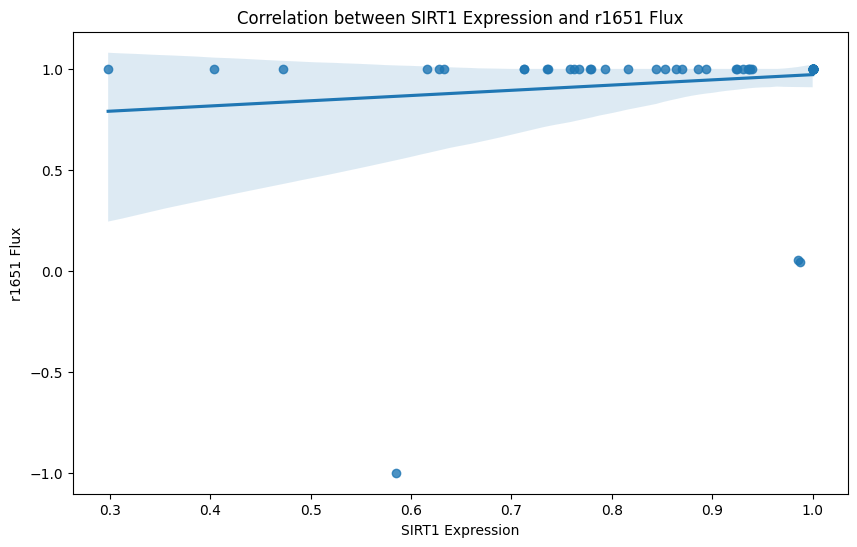

Linear regression results for SIRT1 and r1651:
Slope: 0.25860837294547406
Intercept: 0.7129974971024573
R-squared: 0.020967874582243643
P-value: 0.2282667916014489
Standard error: 0.2127351739672085



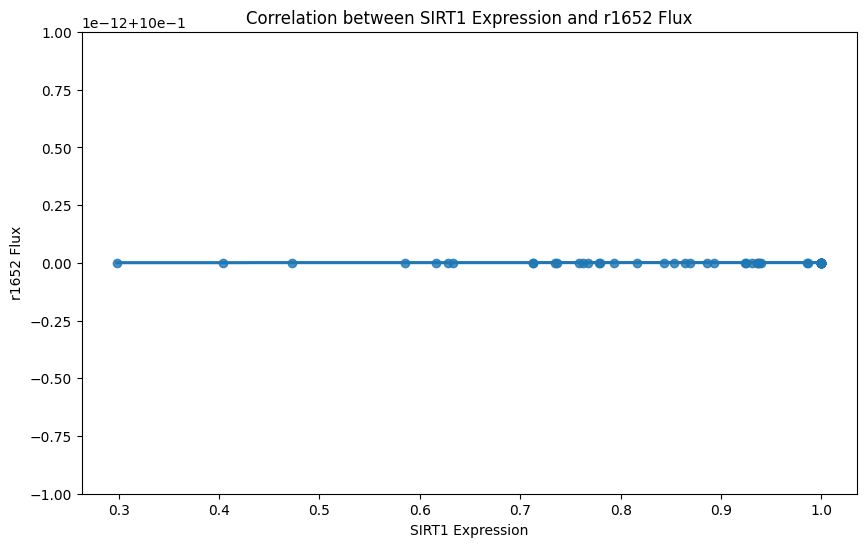

Linear regression results for SIRT1 and r1652:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



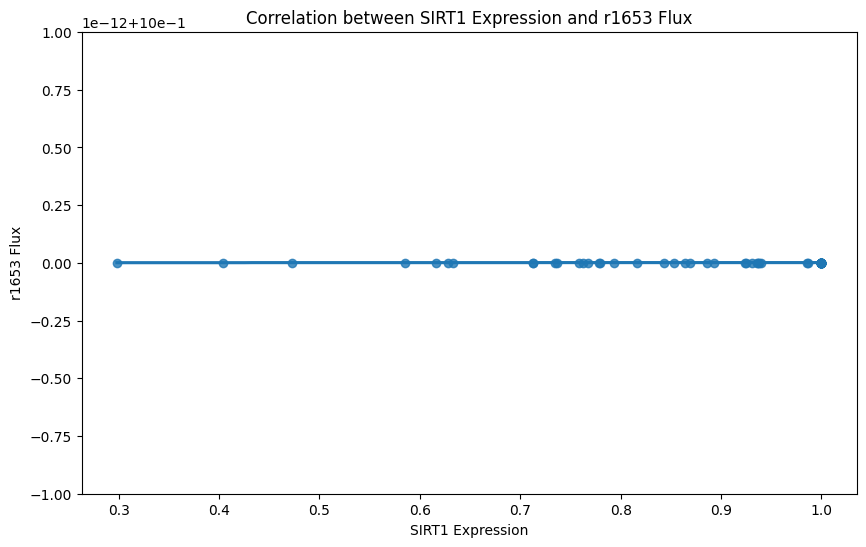

Linear regression results for SIRT1 and r1653:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



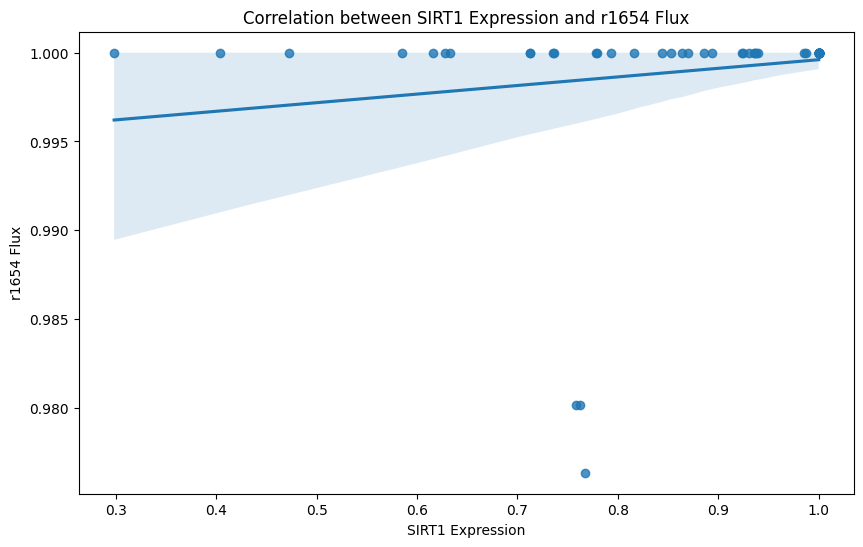

Linear regression results for SIRT1 and r1654:
Slope: 0.0048447730086101275
Intercept: 0.9947614924580828
R-squared: 0.03192851069338624
P-value: 0.13597892954043603
Standard error: 0.0032115395362631483



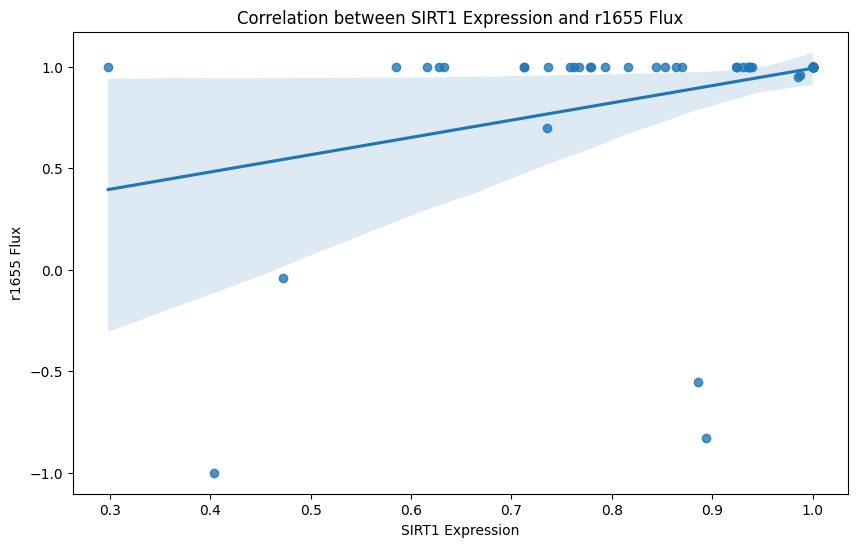

Linear regression results for SIRT1 and r1655:
Slope: 0.8508399317644145
Intercept: 0.14053699962138777
R-squared: 0.12345861880678916
P-value: 0.002659767465940841
Standard error: 0.2729284593245455



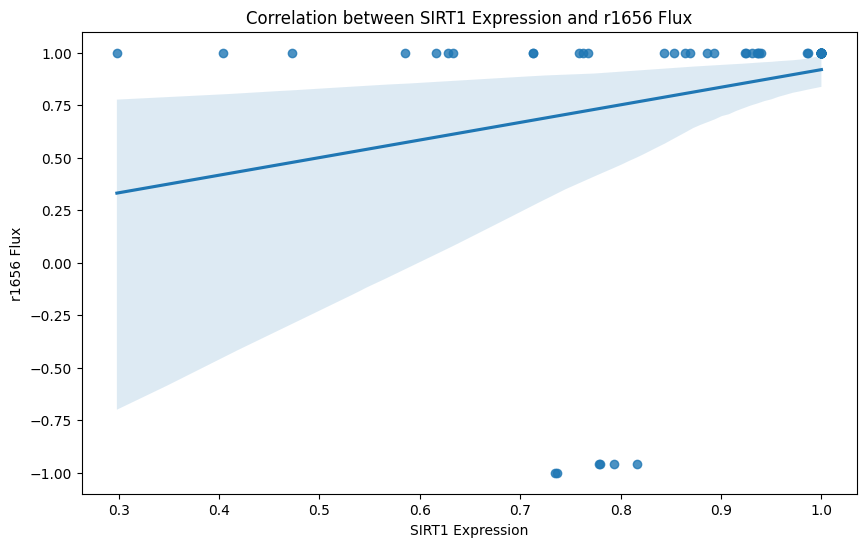

Linear regression results for SIRT1 and r1656:
Slope: 0.8380001706164147
Intercept: 0.08157852956792022
R-squared: 0.057726399833222135
P-value: 0.0435676721351152
Standard error: 0.4075874816407141



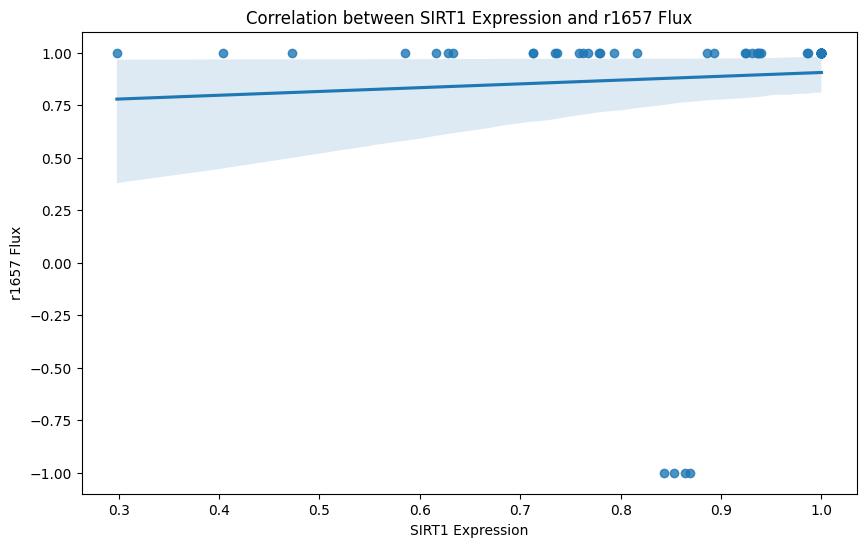

Linear regression results for SIRT1 and r1657:
Slope: 0.1807145376690292
Intercept: 0.7251964352720891
R-squared: 0.003796810480014604
P-value: 0.6097191848672443
Standard error: 0.3523976874395404



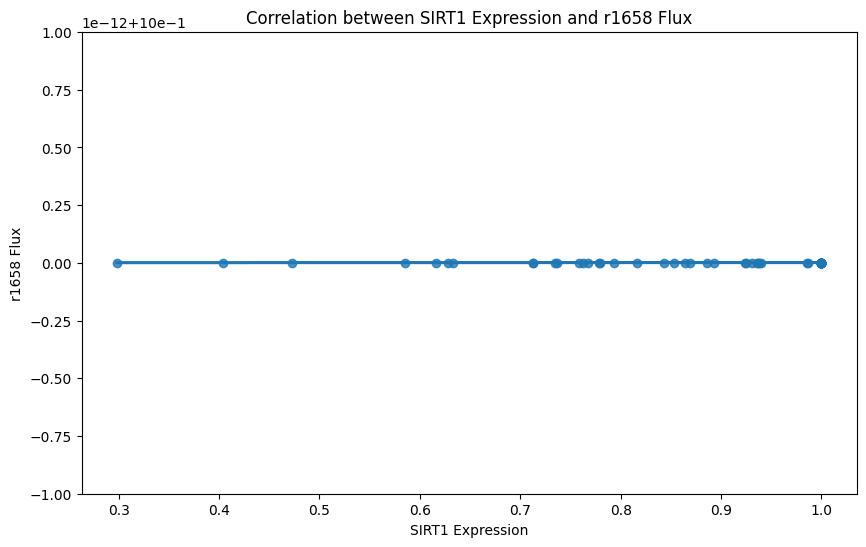

Linear regression results for SIRT1 and r1658:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



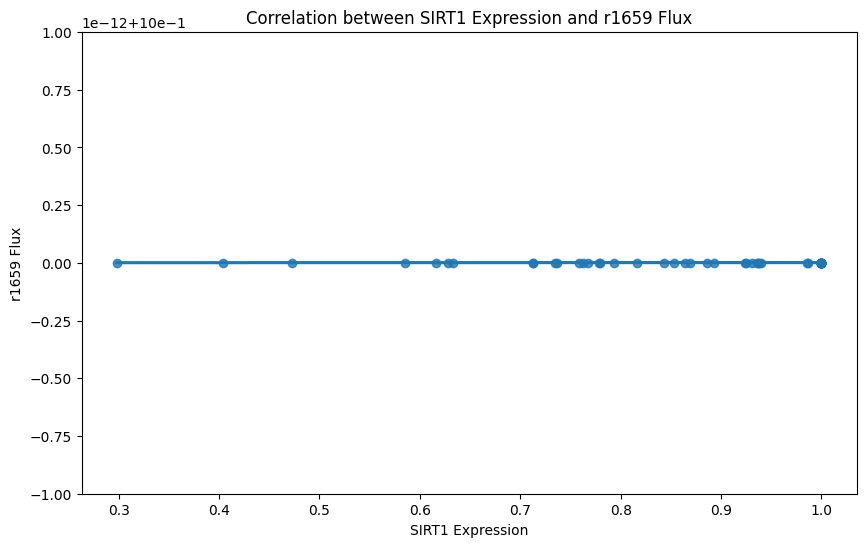

Linear regression results for SIRT1 and r1659:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



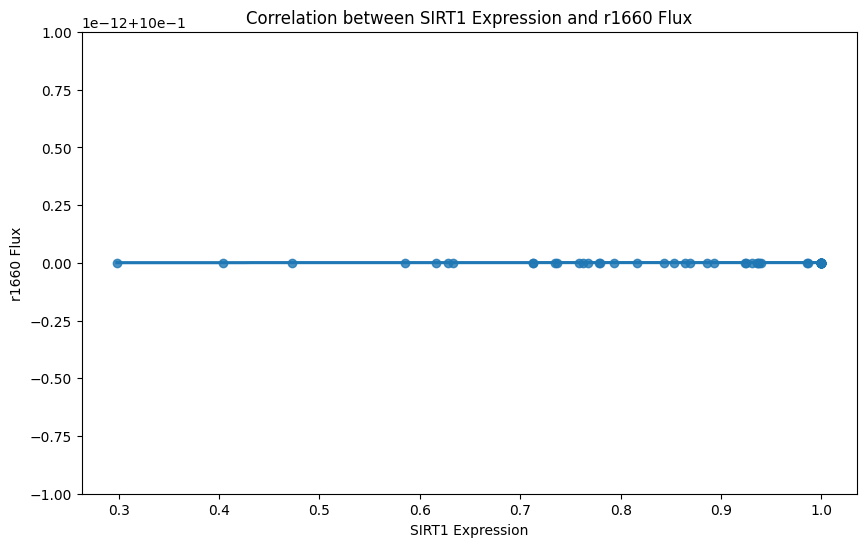

Linear regression results for SIRT1 and r1660:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



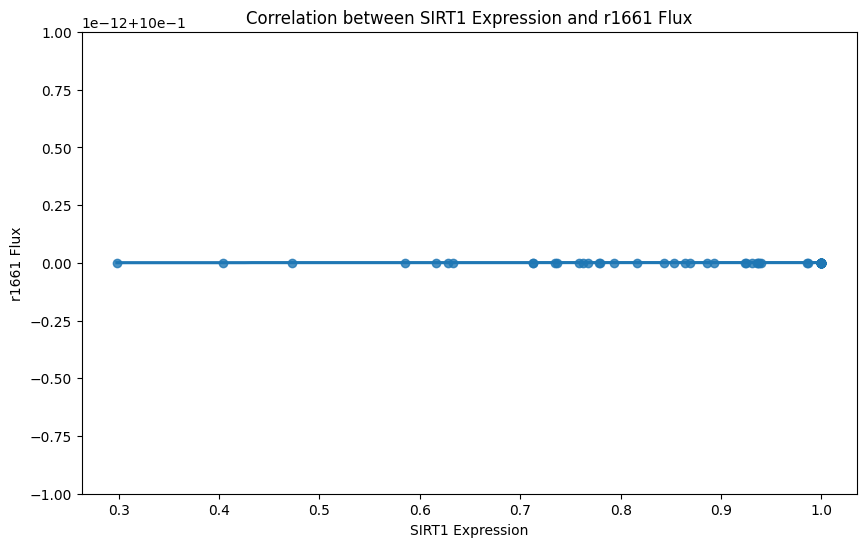

Linear regression results for SIRT1 and r1661:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



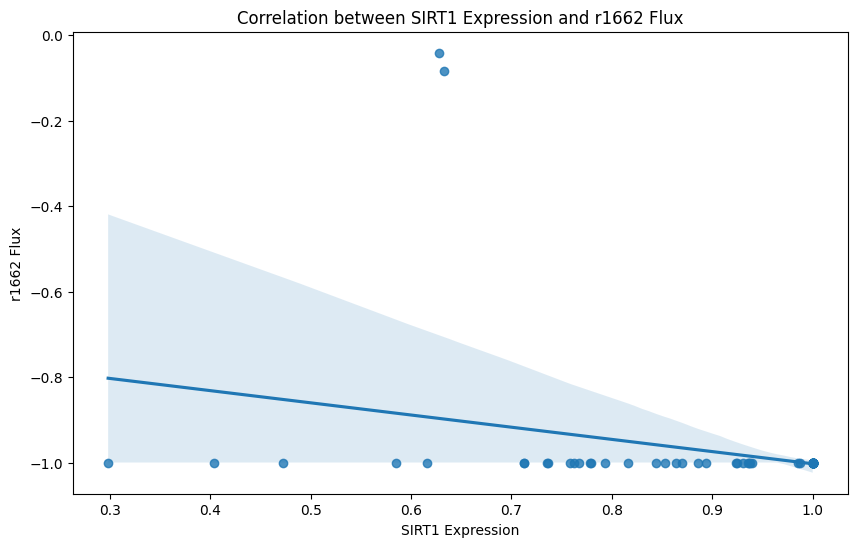

Linear regression results for SIRT1 and r1662:
Slope: -0.2853828490048484
Intercept: -0.7175473534060887
R-squared: 0.08355572196451481
P-value: 0.014490544135162998
Standard error: 0.11378061001198897



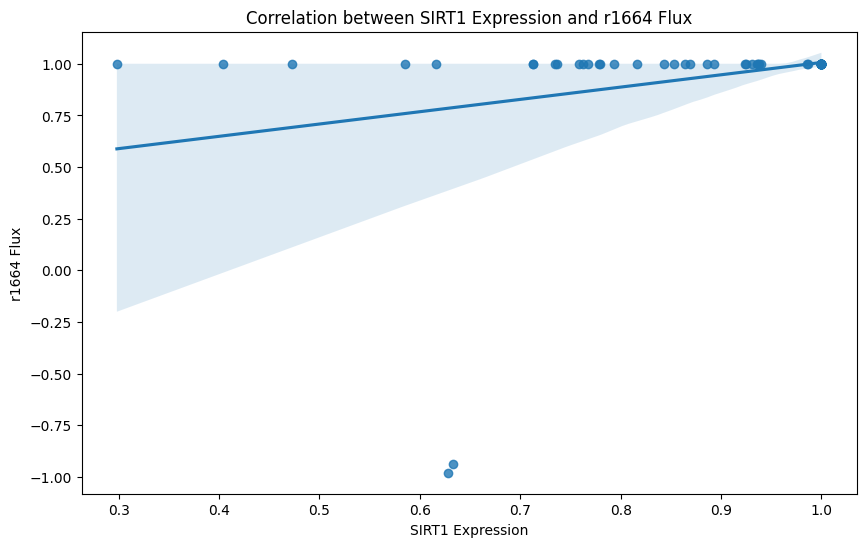

Linear regression results for SIRT1 and r1664:
Slope: 0.5956538478939326
Intercept: 0.4104562579393972
R-squared: 0.0835722456121196
P-value: 0.014480398494318628
Standard error: 0.23745837258780333



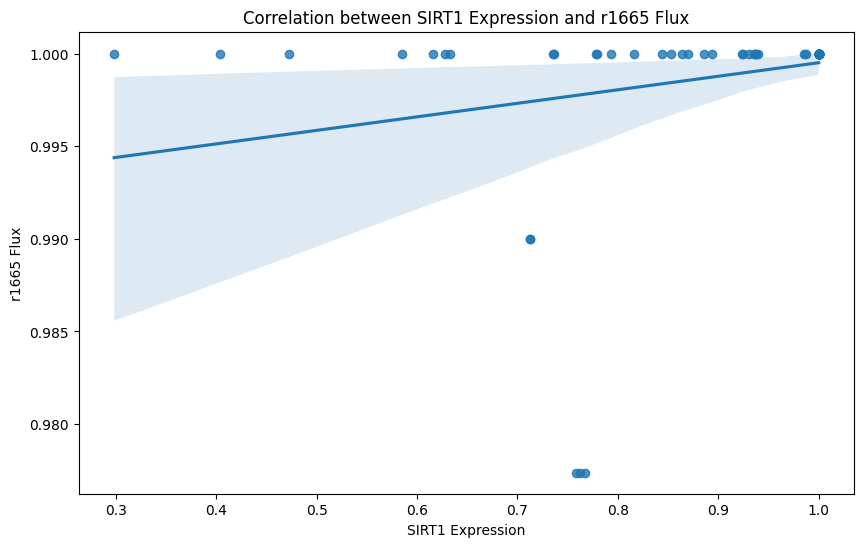

Linear regression results for SIRT1 and r1665:
Slope: 0.007307840793716171
Intercept: 0.9922056972007964
R-squared: 0.057576298043017976
P-value: 0.043850050979587545
Standard error: 0.003559309577062131



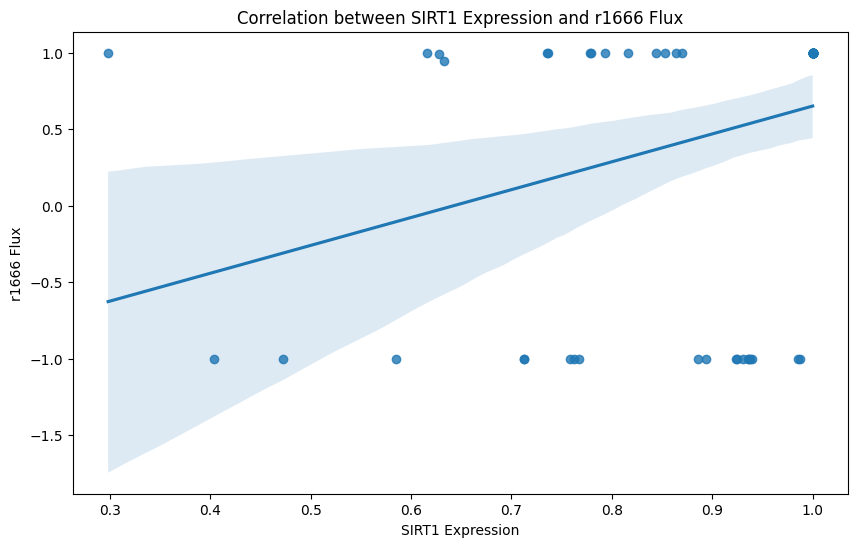

Linear regression results for SIRT1 and r1666:
Slope: 1.8223693133955052
Intercept: -1.1710461296482544
R-squared: 0.10485658630315743
P-value: 0.005874018720364029
Standard error: 0.6410033530559115



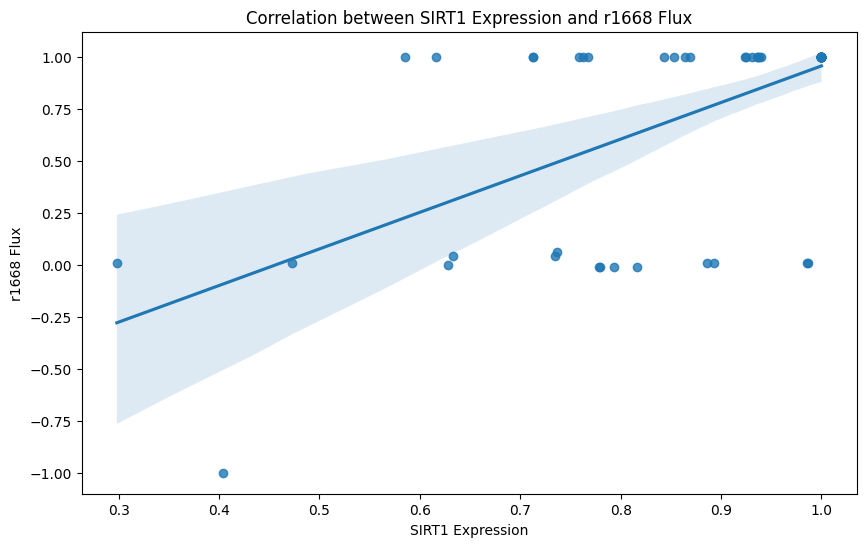

Linear regression results for SIRT1 and r1668:
Slope: 1.7617194583608151
Intercept: -0.8035071128486366
R-squared: 0.3852369815439626
P-value: 7.748464514288031e-09
Standard error: 0.2679181201341726



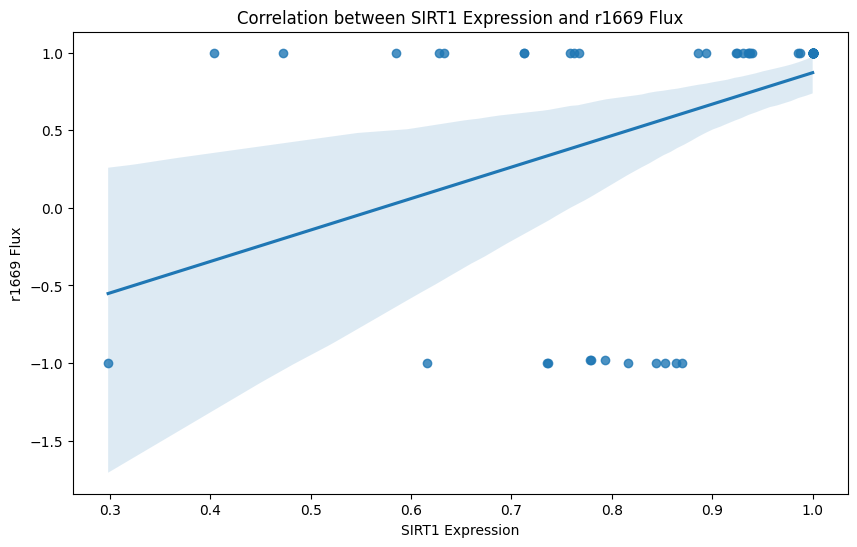

Linear regression results for SIRT1 and r1669:
Slope: 2.0281445441931956
Intercept: -1.1567269263647924
R-squared: 0.18192669256676317
P-value: 0.0002080359588382827
Standard error: 0.5177525629576105



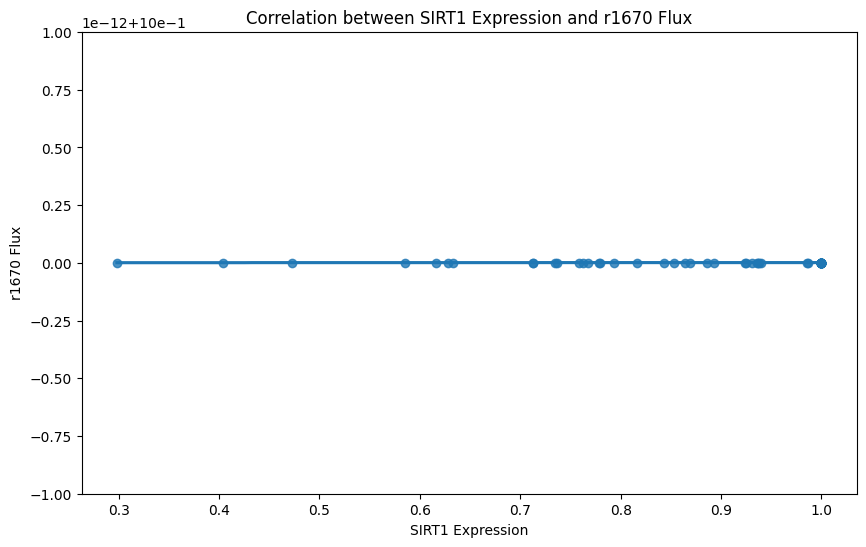

Linear regression results for SIRT1 and r1670:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



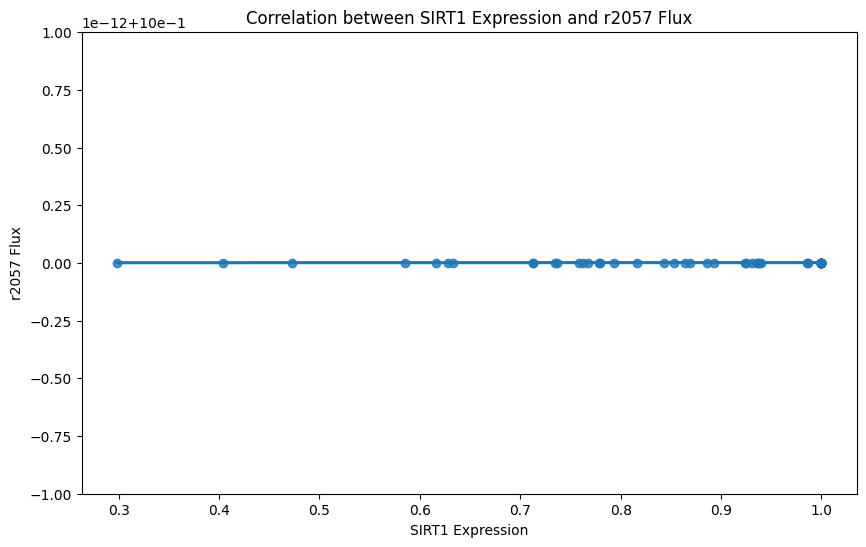

Linear regression results for SIRT1 and r2057:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



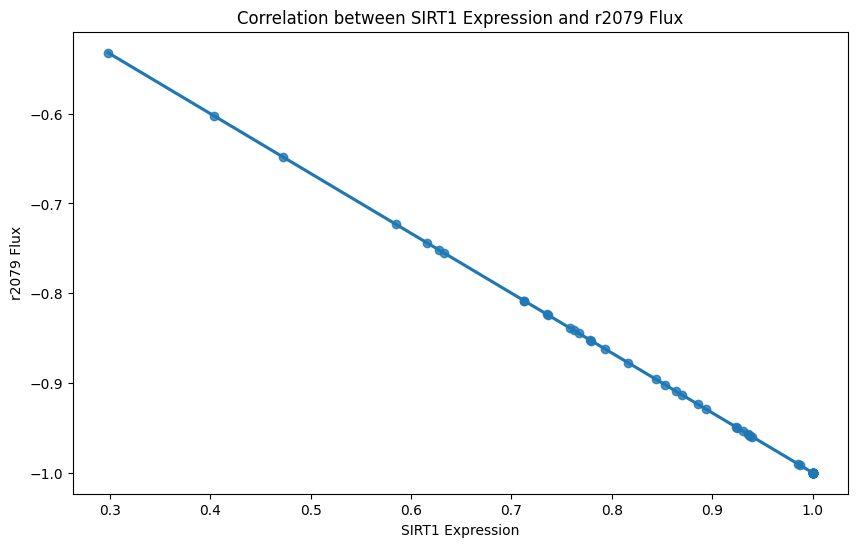

Linear regression results for SIRT1 and r2079:
Slope: -0.6666666666666666
Intercept: -0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



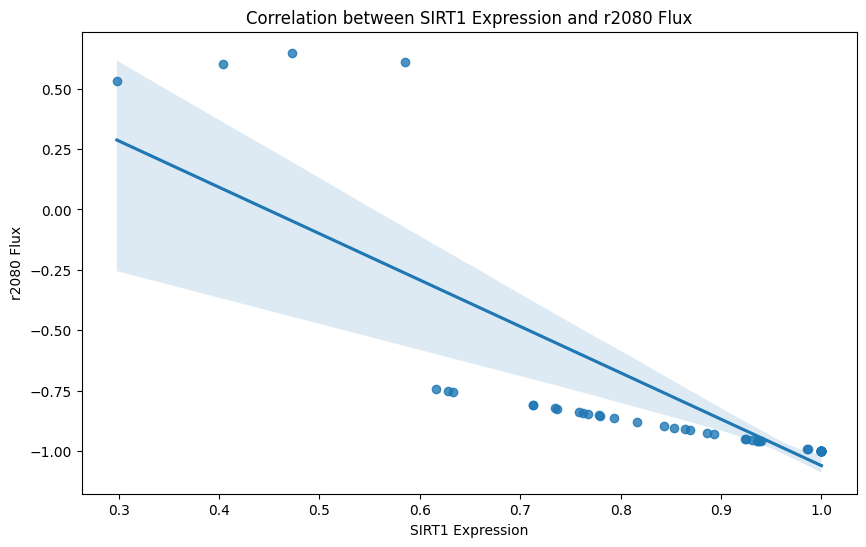

Linear regression results for SIRT1 and r2080:
Slope: -1.9191696159951015
Intercept: 0.8593488667470003
R-squared: 0.6865558448463325
P-value: 4.757510296069308e-19
Standard error: 0.15611008763252238



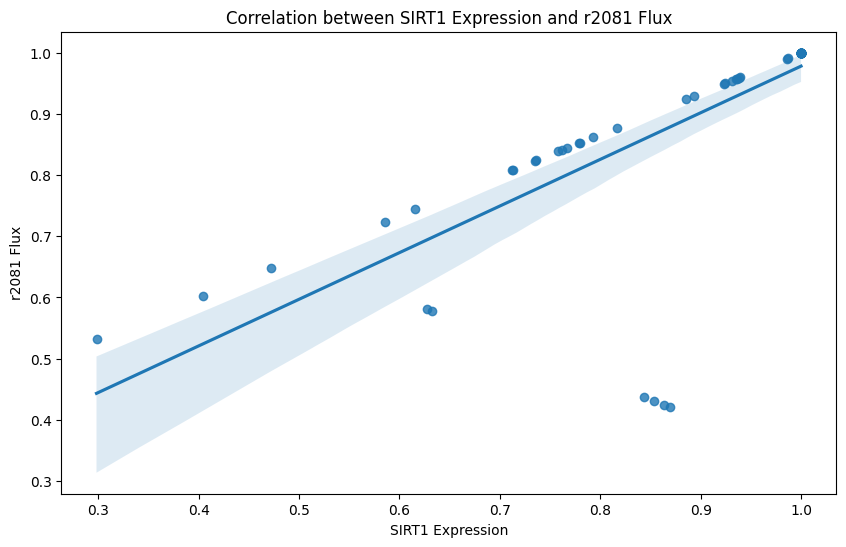

Linear regression results for SIRT1 and r2081:
Slope: 0.7622226956300956
Intercept: 0.21586262217552799
R-squared: 0.5361805645567578
P-value: 3.982735043900328e-13
Standard error: 0.08534464343521393



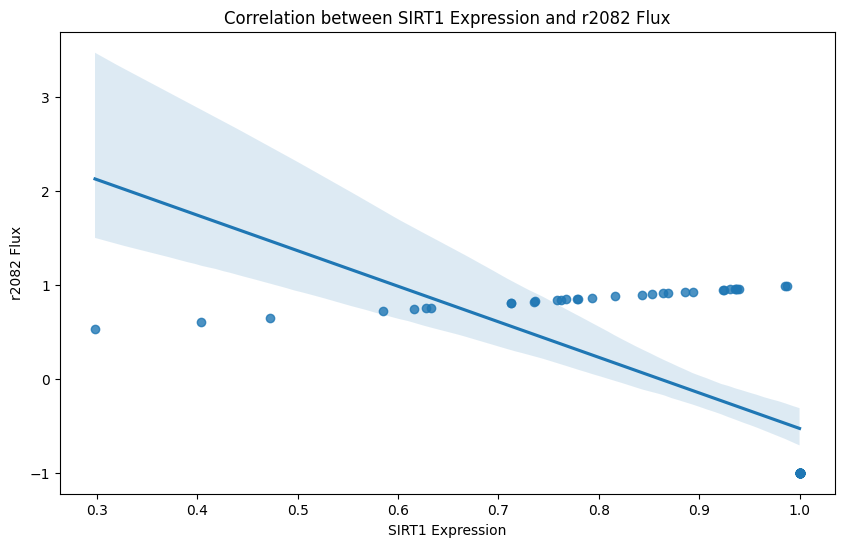

Linear regression results for SIRT1 and r2082:
Slope: -3.7864216668189767
Intercept: 3.2579857127387077
R-squared: 0.41253167790706236
P-value: 1.5662239621220459e-09
Standard error: 0.5439613040345154



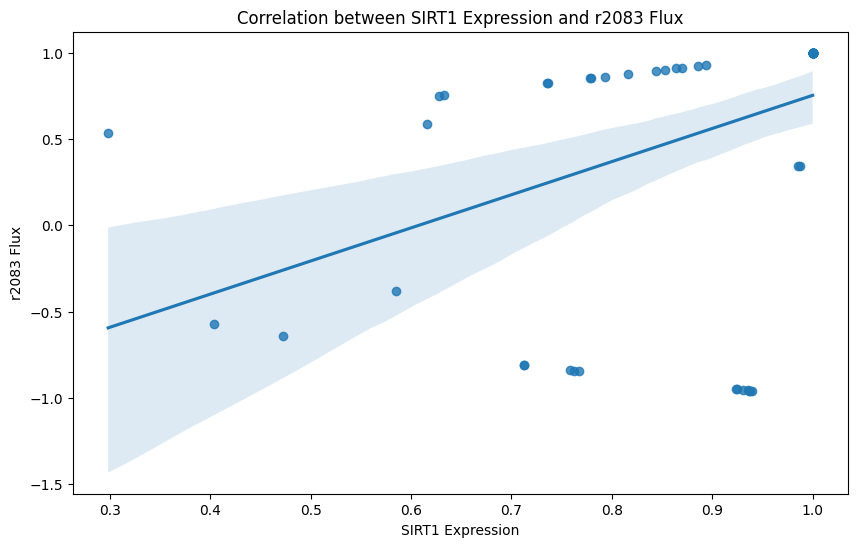

Linear regression results for SIRT1 and r2083:
Slope: 1.9197005889799905
Intercept: -1.1665347310220975
R-squared: 0.16985921142858842
P-value: 0.00035529788717097484
Standard error: 0.5109051466540153



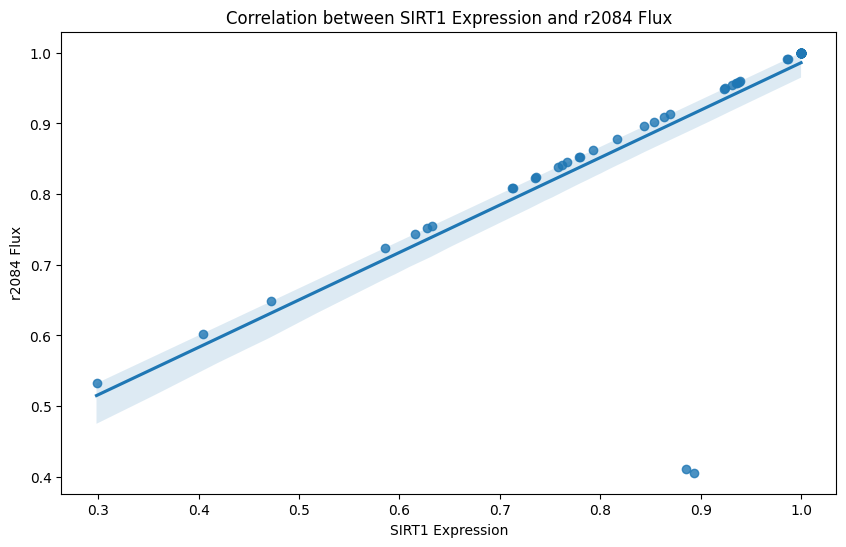

Linear regression results for SIRT1 and r2084:
Slope: 0.6710975929300124
Intercept: 0.31476270096337844
R-squared: 0.6023864092131408
P-value: 1.8555220932293806e-15
Standard error: 0.06563782226049876



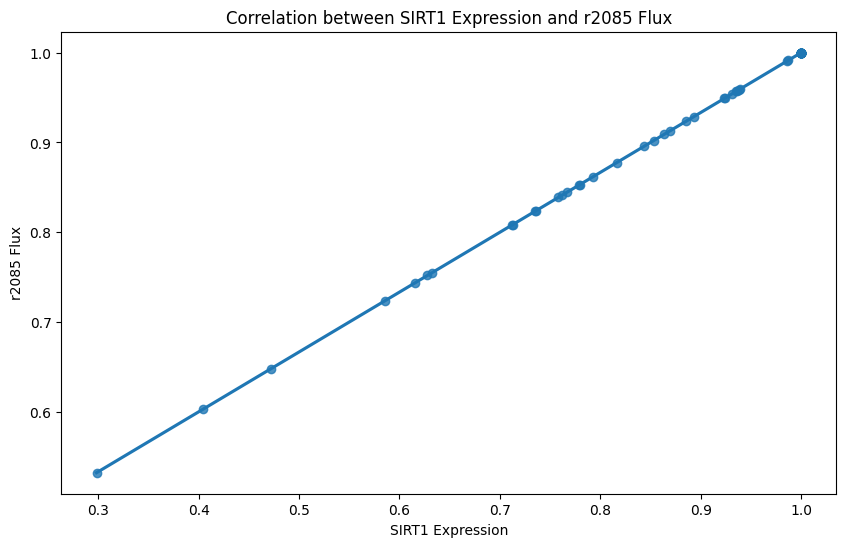

Linear regression results for SIRT1 and r2085:
Slope: 0.6666666666666666
Intercept: 0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



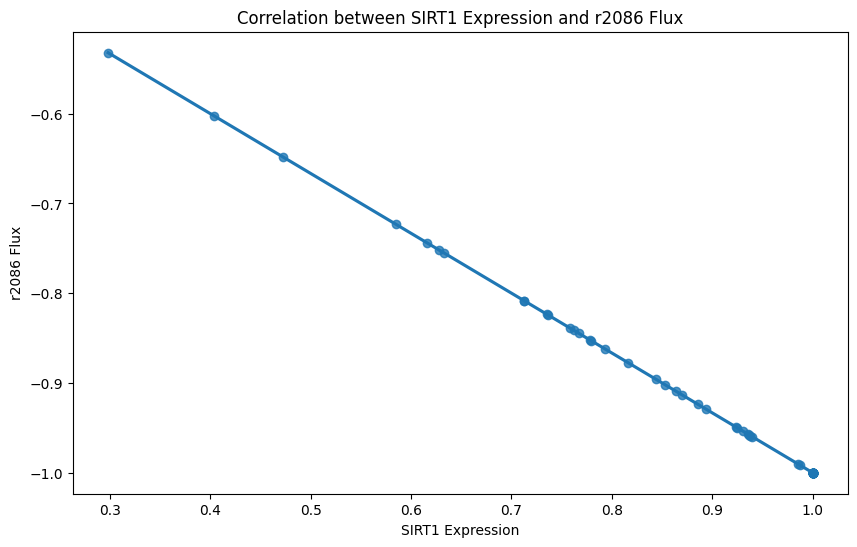

Linear regression results for SIRT1 and r2086:
Slope: -0.6666666666666666
Intercept: -0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



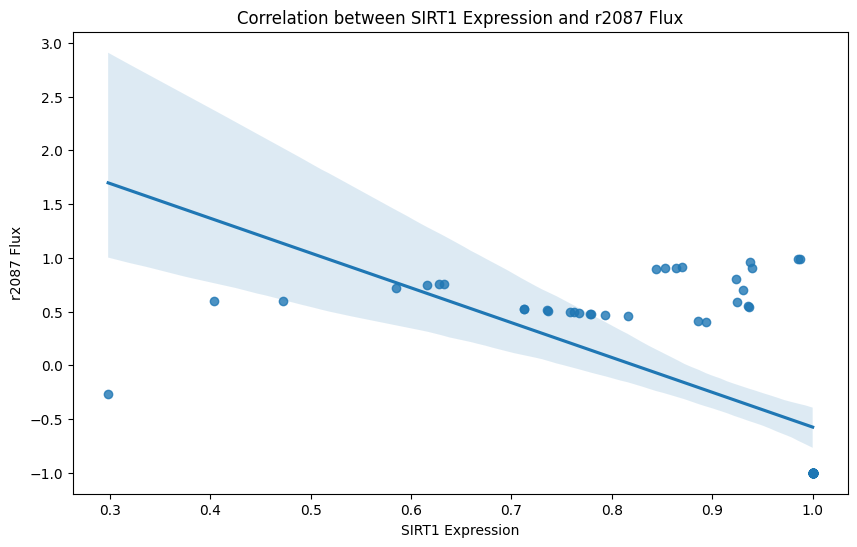

Linear regression results for SIRT1 and r2087:
Slope: -3.2393012883779164
Intercept: 2.6638824369525183
R-squared: 0.3766571631123094
P-value: 1.2631160953645908e-08
Standard error: 0.5016688893876474



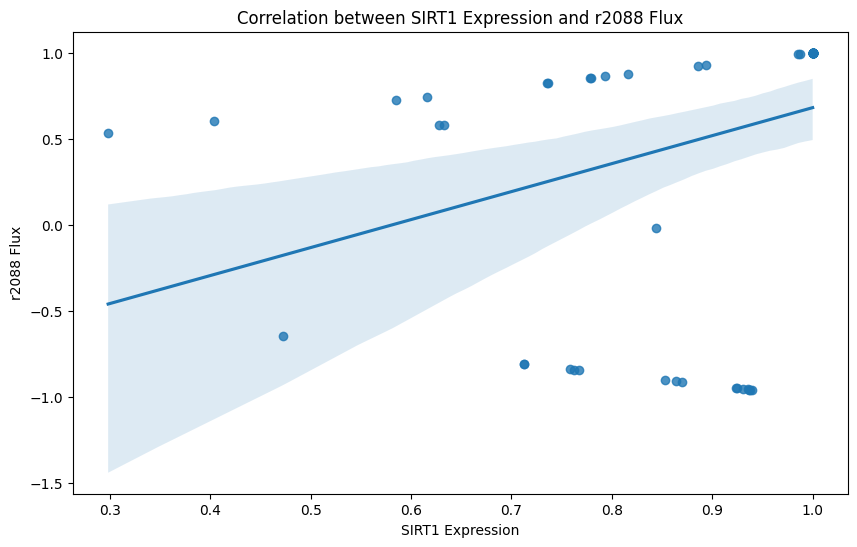

Linear regression results for SIRT1 and r2088:
Slope: 1.6262441925628734
Intercept: -0.9453434497233311
R-squared: 0.10953882364794129
P-value: 0.004814446126521613
Standard error: 0.5581933671258479



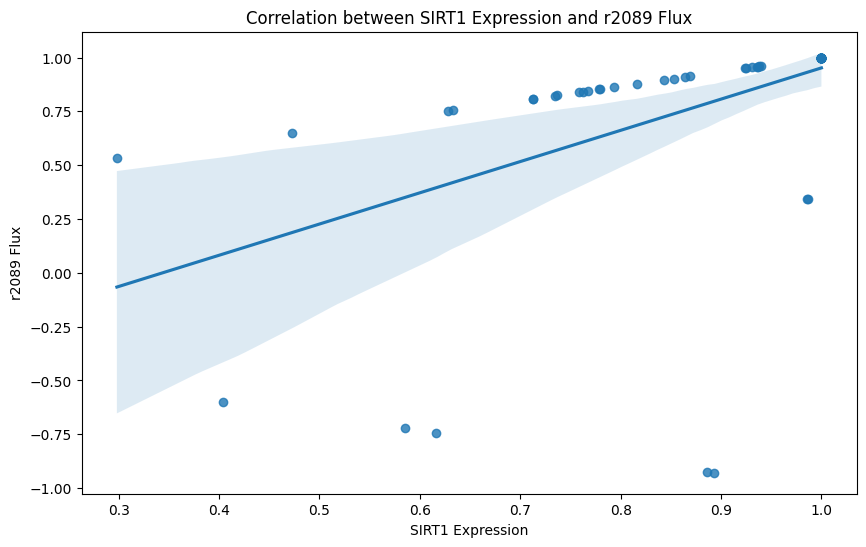

Linear regression results for SIRT1 and r2089:
Slope: 1.4509333439592242
Intercept: -0.4990354424339877
R-squared: 0.24793670654826327
P-value: 9.94512396101198e-06
Standard error: 0.3042143513656196



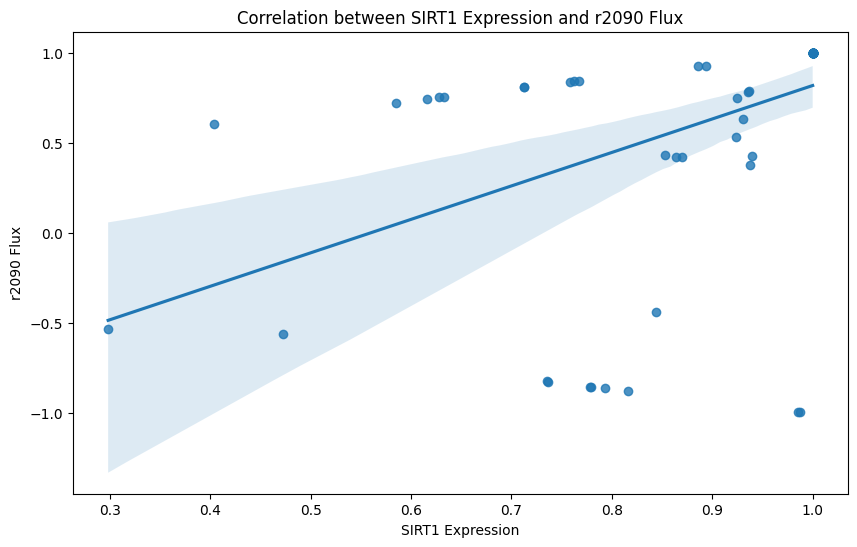

Linear regression results for SIRT1 and r2090:
Slope: 1.8561054595887287
Intercept: -1.0379435228051208
R-squared: 0.21436857455738262
P-value: 4.789425346772845e-05
Standard error: 0.42776669297770076



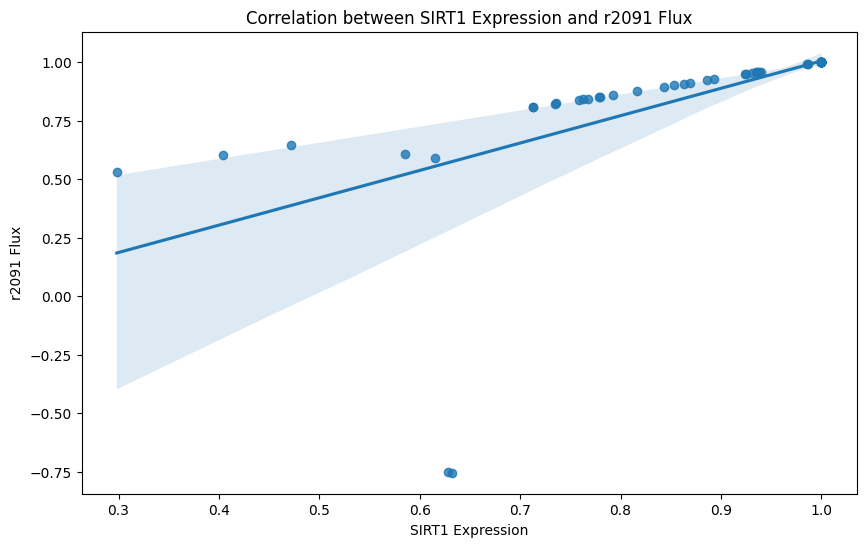

Linear regression results for SIRT1 and r2091:
Slope: 1.1699560238908855
Intercept: -0.16441138570415748
R-squared: 0.3763363205068356
P-value: 1.2862514102684166e-08
Standard error: 0.181314339229689



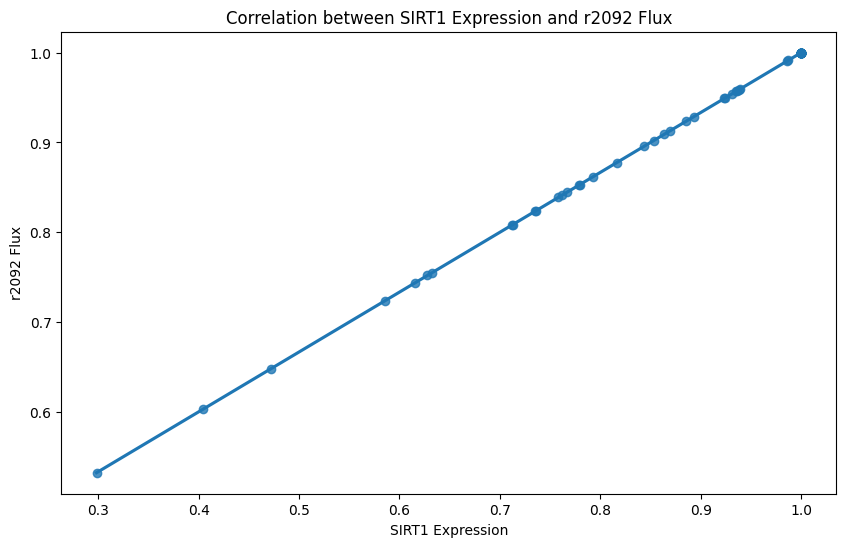

Linear regression results for SIRT1 and r2092:
Slope: 0.6666666666666666
Intercept: 0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



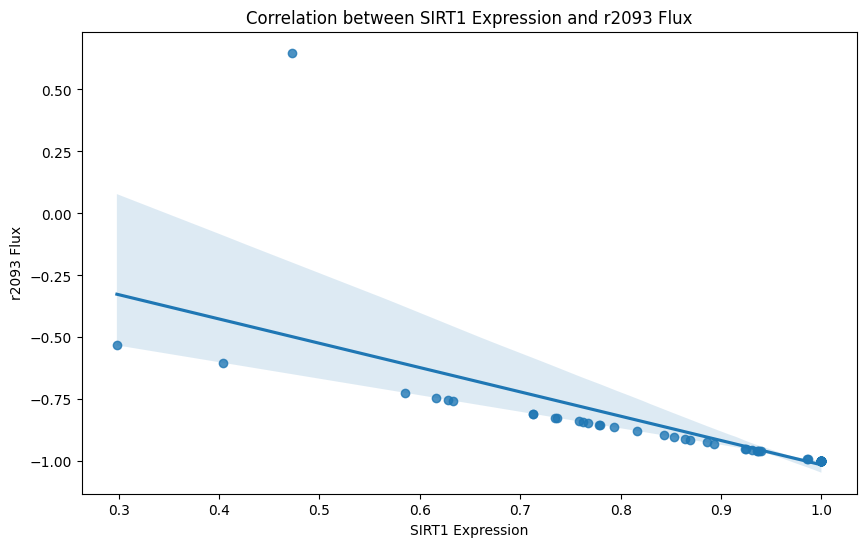

Linear regression results for SIRT1 and r2093:
Slope: -0.9804779830080547
Intercept: -0.033541451936875855
R-squared: 0.5321293593437402
P-value: 5.39569751821137e-13
Standard error: 0.11067960149853277



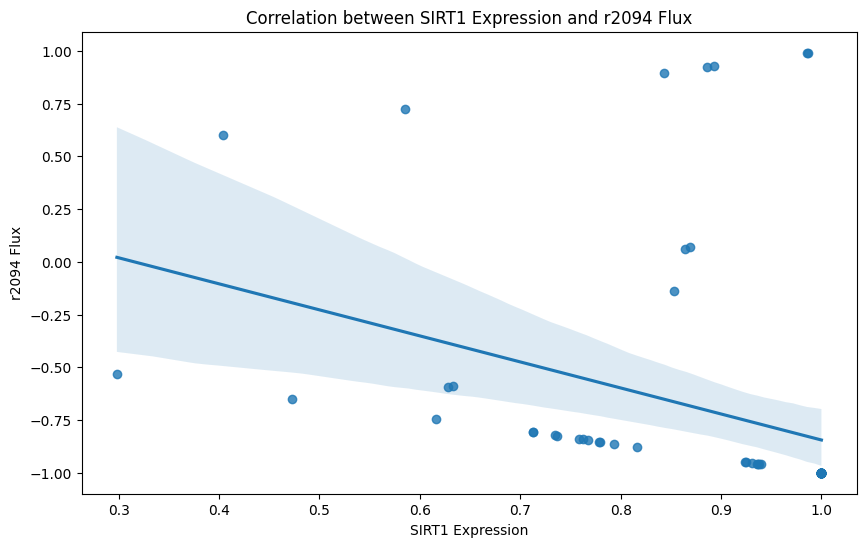

Linear regression results for SIRT1 and r2094:
Slope: -1.2341410218914708
Intercept: 0.3892718437471959
R-squared: 0.11675926166894203
P-value: 0.003540442674673873
Standard error: 0.4086336424287731



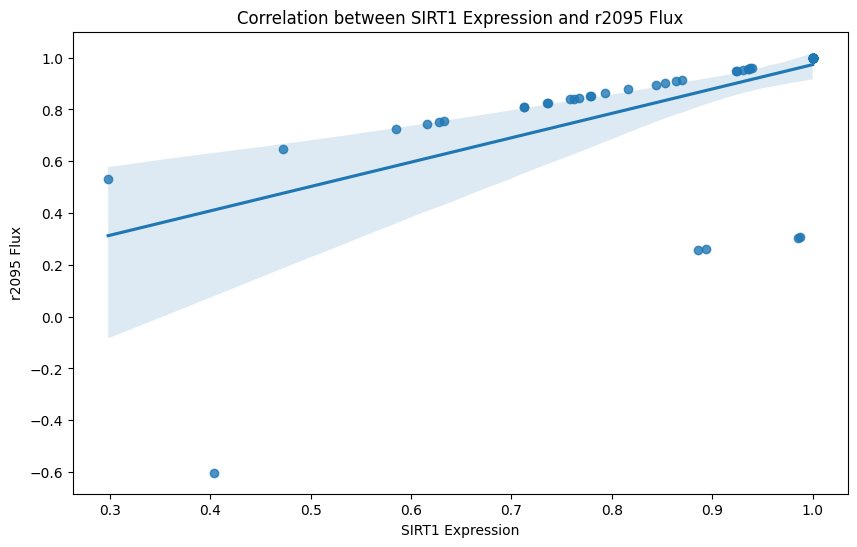

Linear regression results for SIRT1 and r2095:
Slope: 0.9414110311577092
Intercept: 0.031799939791584686
R-squared: 0.3466533849185537
P-value: 6.646352670719855e-08
Standard error: 0.15558898141376676



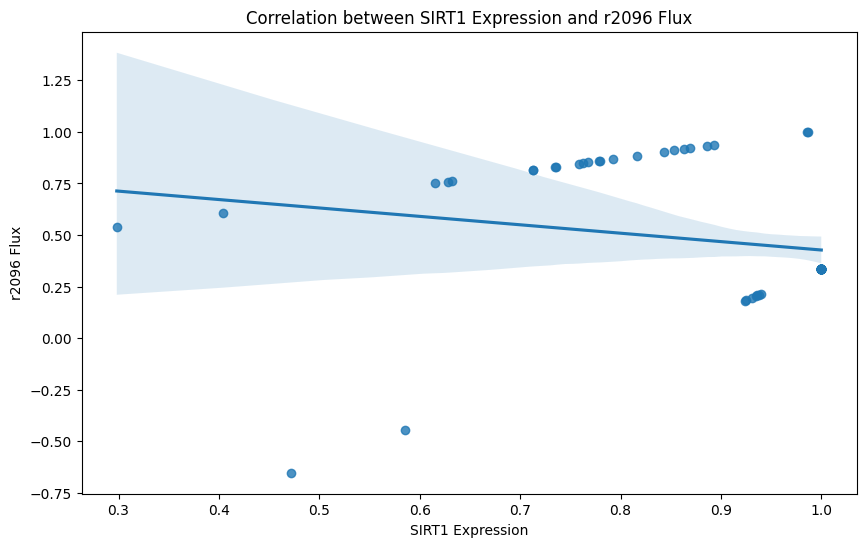

Linear regression results for SIRT1 and r2096:
Slope: -0.4078125818833445
Intercept: 0.8353006447612517
R-squared: 0.04234786756401828
P-value: 0.08512661327108362
Standard error: 0.23346629542286892



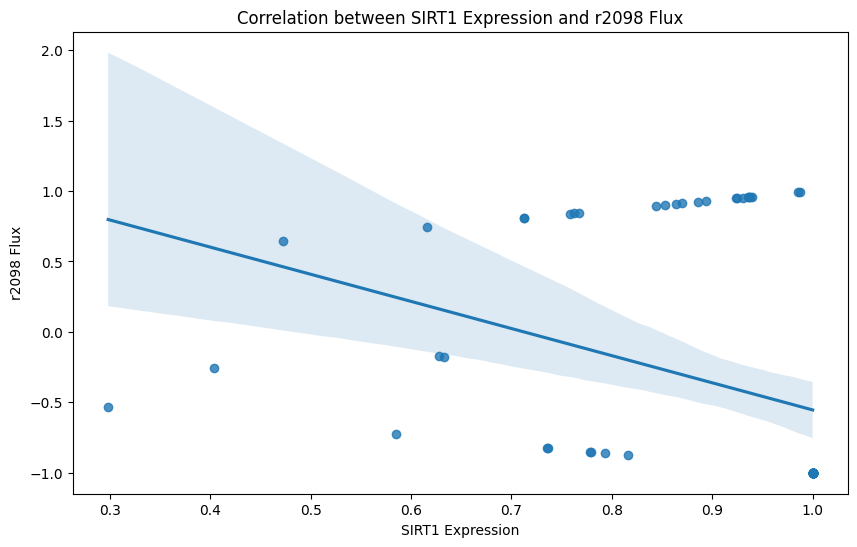

Linear regression results for SIRT1 and r2098:
Slope: -1.9269477491519522
Intercept: 1.3727432888247908
R-squared: 0.12533106761470078
P-value: 0.0024550235597648605
Standard error: 0.6128269757884163



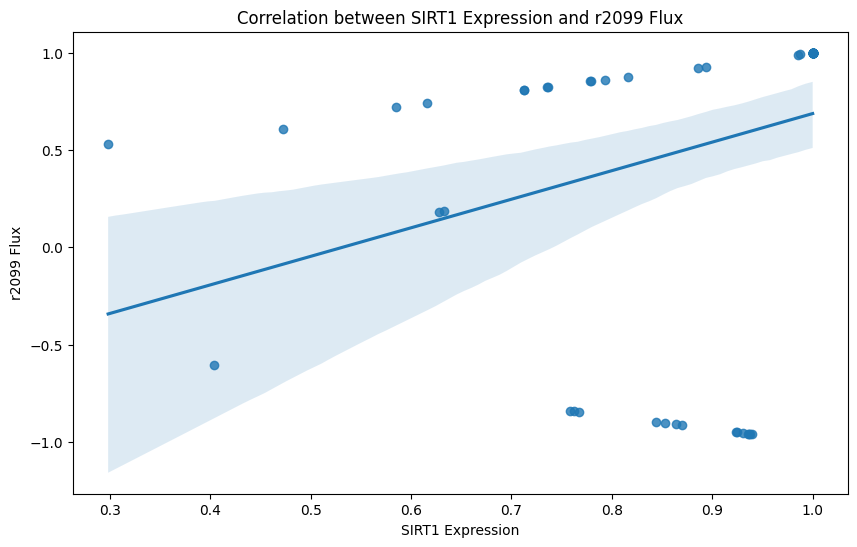

Linear regression results for SIRT1 and r2099:
Slope: 1.4674007442201564
Intercept: -0.7800145890061371
R-squared: 0.09257648367862306
P-value: 0.009887402592259252
Standard error: 0.5530684238431749



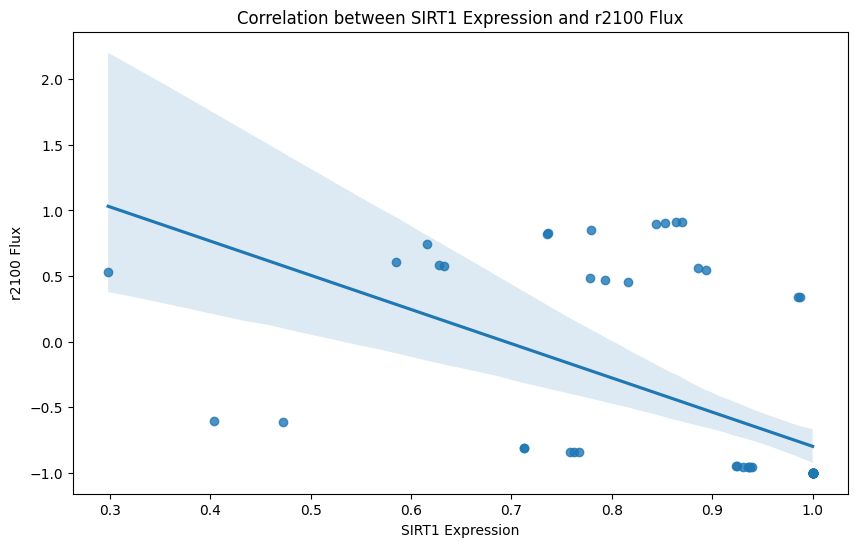

Linear regression results for SIRT1 and r2100:
Slope: -2.608477155306398
Intercept: 1.8095501533803748
R-squared: 0.320101700187225
P-value: 2.725537877177512e-07
Standard error: 0.4576573898508773



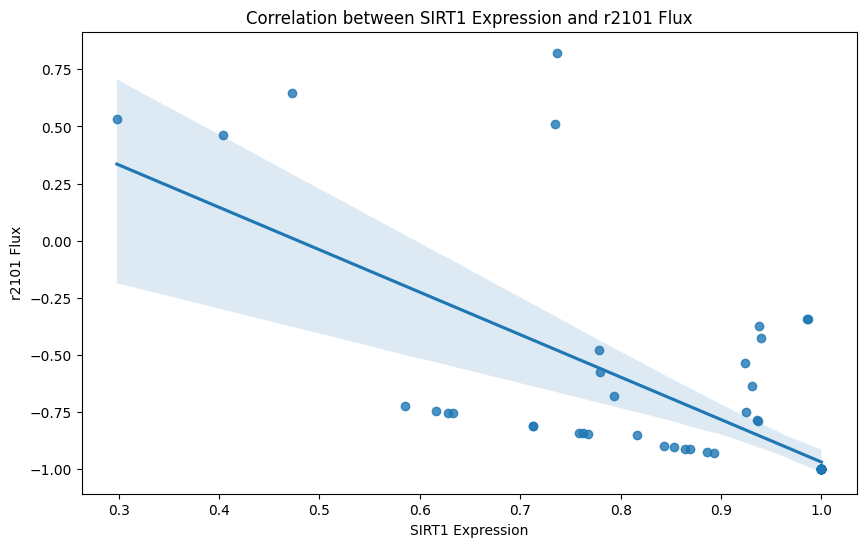

Linear regression results for SIRT1 and r2101:
Slope: -1.857633388363231
Intercept: 0.8895500982452781
R-squared: 0.4882614644508785
P-value: 1.237597924627126e-11
Standard error: 0.22894612600162126



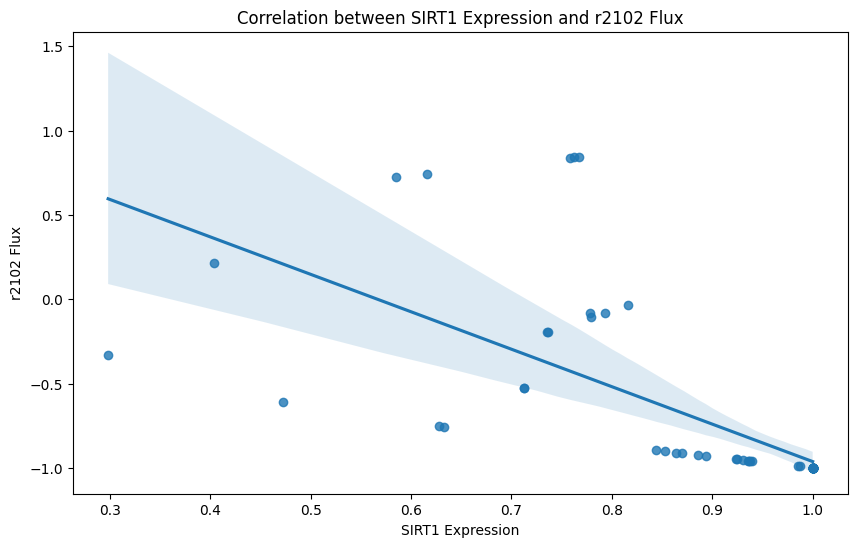

Linear regression results for SIRT1 and r2102:
Slope: -2.2202910690582467
Intercept: 1.2578196758373905
R-squared: 0.4652528749756644
P-value: 5.773581082559517e-11
Standard error: 0.28655966650504816



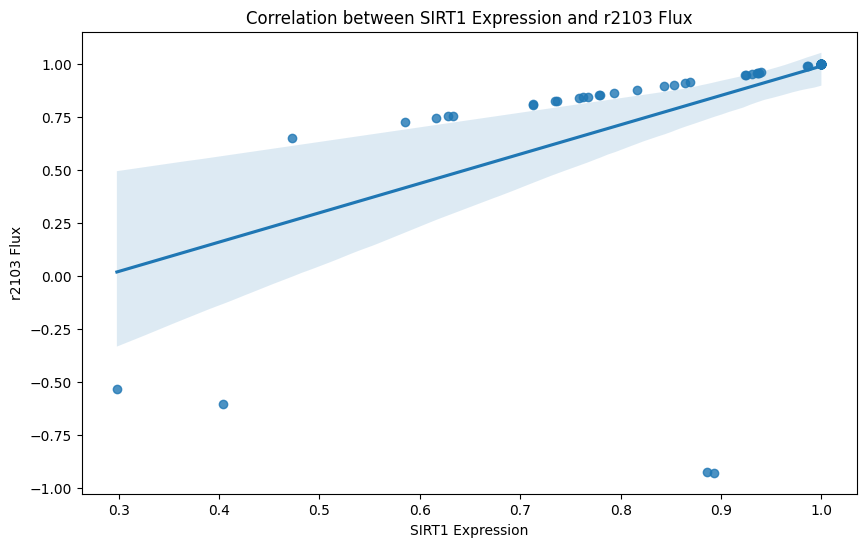

Linear regression results for SIRT1 and r2103:
Slope: 1.384325402132871
Intercept: -0.39467032219005627
R-squared: 0.2948647788266581
P-value: 9.95264250103096e-07
Standard error: 0.2577142285992683



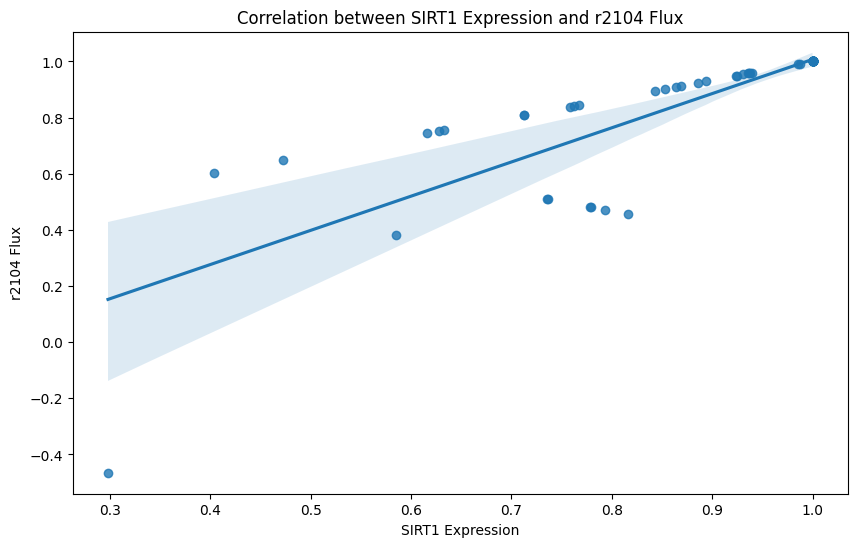

Linear regression results for SIRT1 and r2104:
Slope: 1.217937555578152
Intercept: -0.21084965035153747
R-squared: 0.6833482271654218
P-value: 6.774954352280721e-19
Standard error: 0.09980916052698383



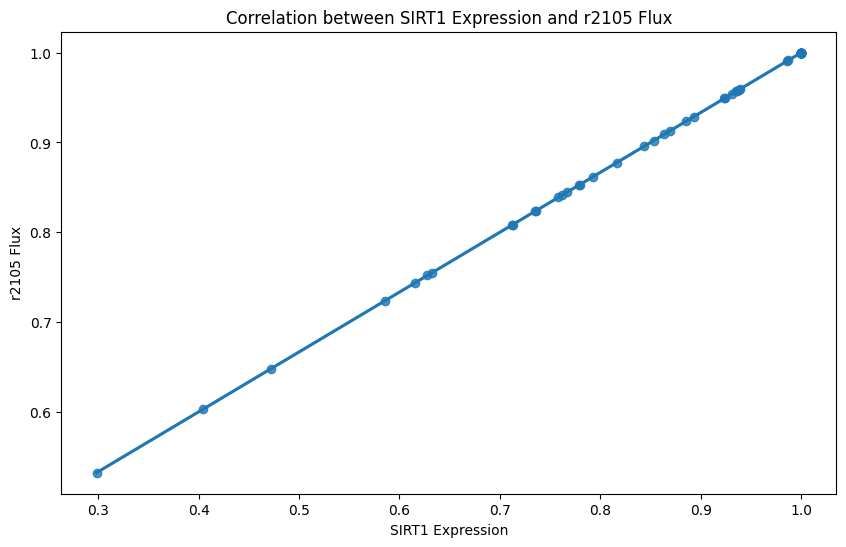

Linear regression results for SIRT1 and r2105:
Slope: 0.6666666666666666
Intercept: 0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



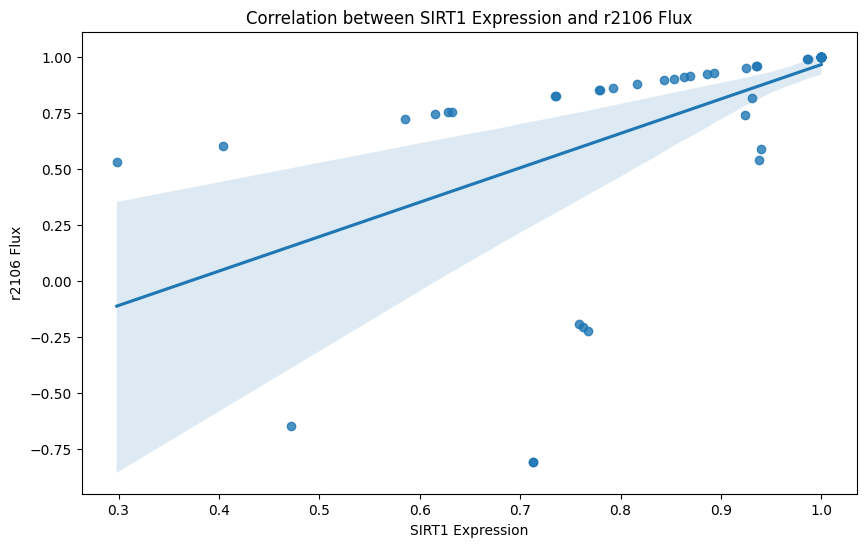

Linear regression results for SIRT1 and r2106:
Slope: 1.5372496218193024
Intercept: -0.5719322383523334
R-squared: 0.3367367808782673
P-value: 1.1327450847750142e-07
Standard error: 0.2597272569243546



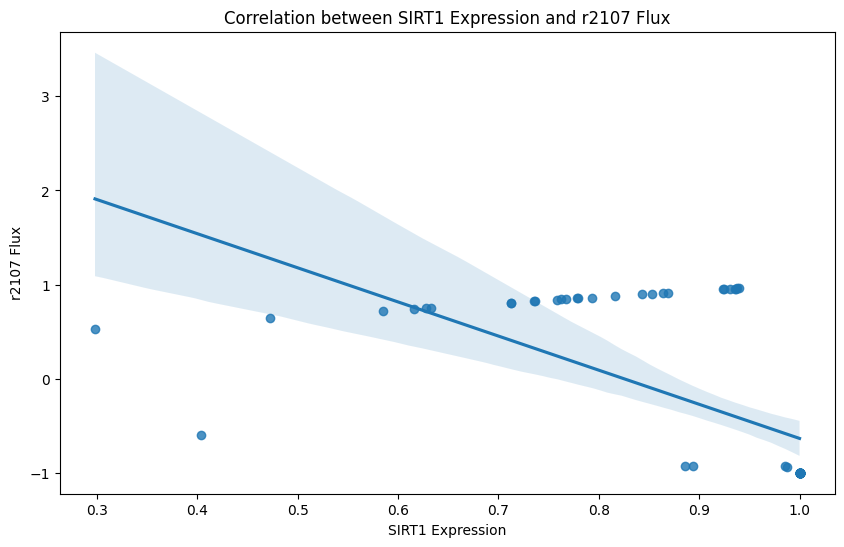

Linear regression results for SIRT1 and r2107:
Slope: -3.627770769633531
Intercept: 2.9922014477152246
R-squared: 0.40334447745936924
P-value: 2.7035777413707675e-09
Standard error: 0.5311767613821756



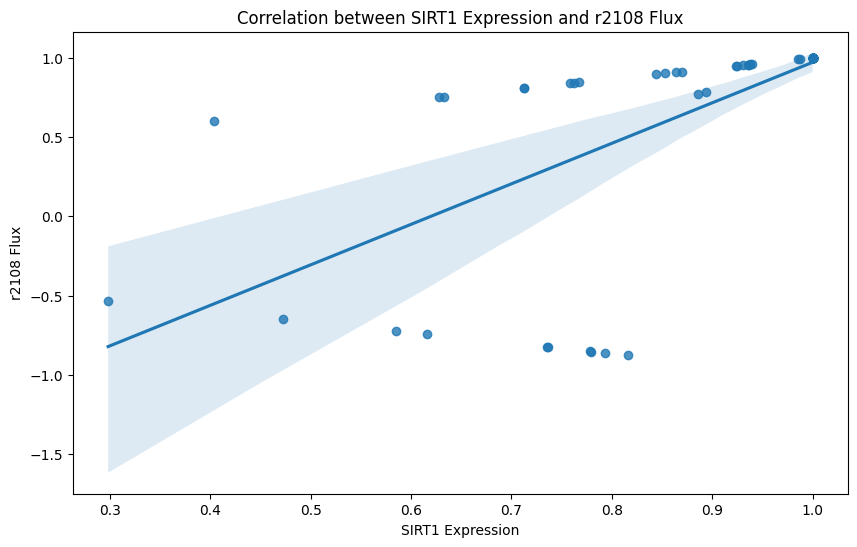

Linear regression results for SIRT1 and r2108:
Slope: 2.5565555488705827
Intercept: -1.5843438827170122
R-squared: 0.4385988371351077
P-value: 3.17924225535499e-10
Standard error: 0.3482038784287863



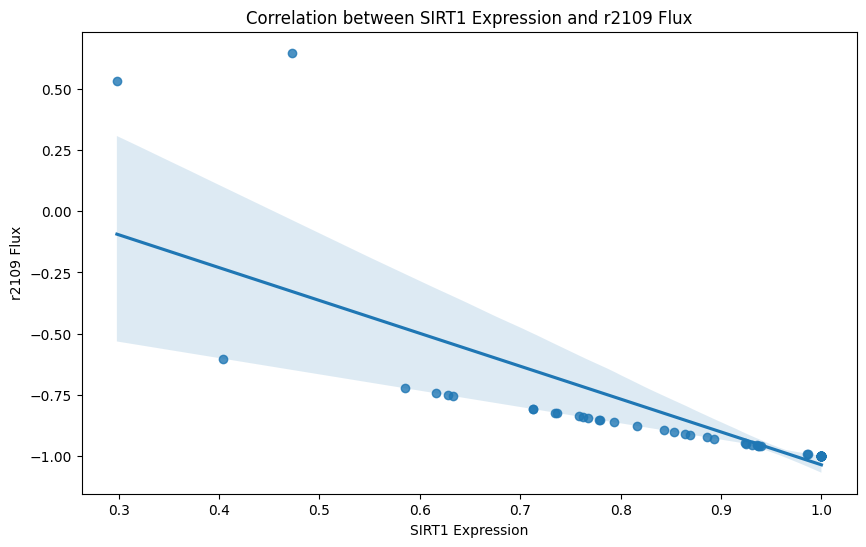

Linear regression results for SIRT1 and r2109:
Slope: -1.3436092368004526
Intercept: 0.30723096944721306
R-squared: 0.621474672330741
P-value: 3.3485334457070914e-16
Standard error: 0.12623628070080506



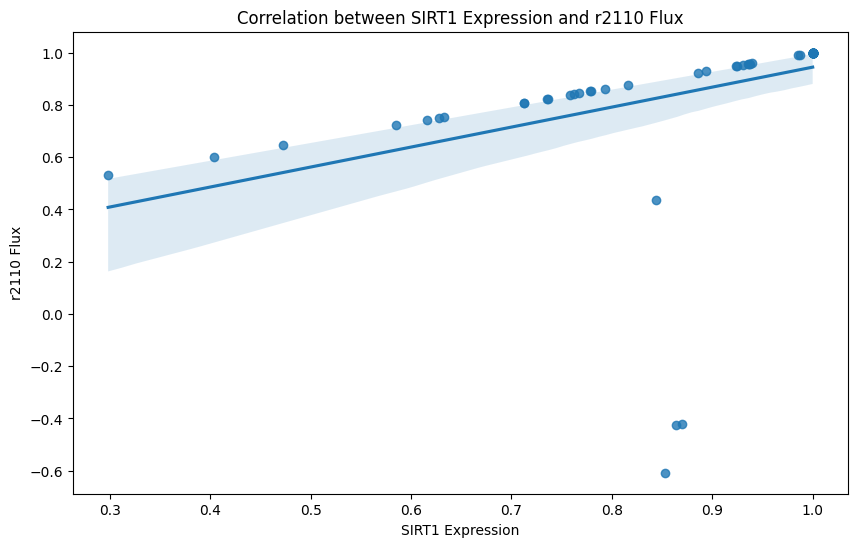

Linear regression results for SIRT1 and r2110:
Slope: 0.7648364071988143
Intercept: 0.17998256474211072
R-squared: 0.1520612763174163
P-value: 0.000774946885894938
Standard error: 0.2174287285299194



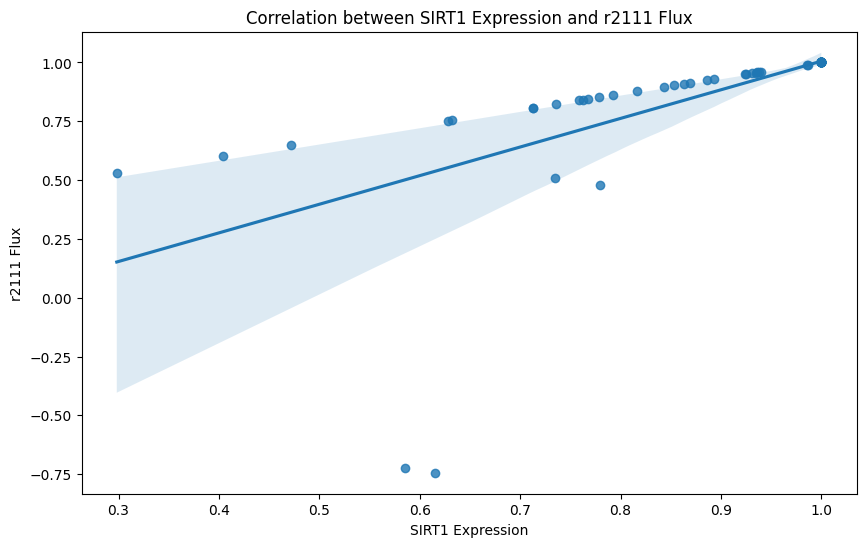

Linear regression results for SIRT1 and r2111:
Slope: 1.2163484495469923
Intercept: -0.21082684880877522
R-squared: 0.4041738551938391
P-value: 2.5744202243369485e-09
Standard error: 0.17779073696262698



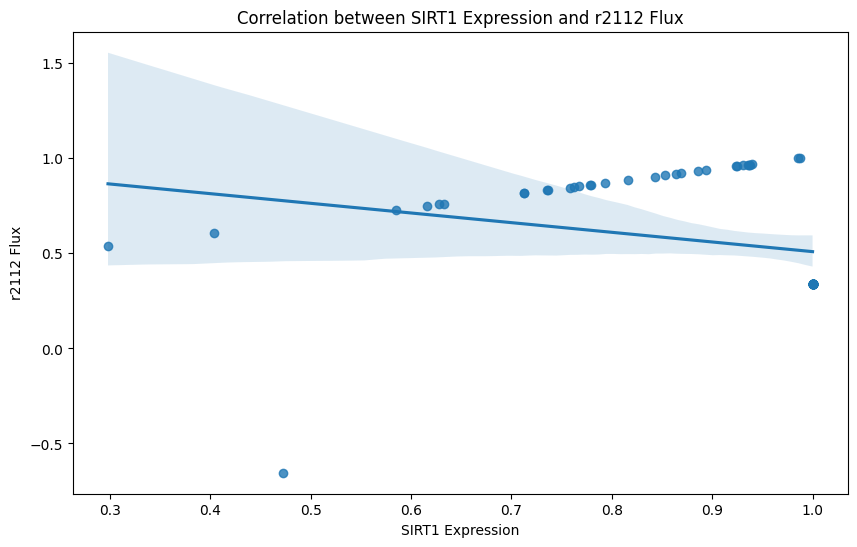

Linear regression results for SIRT1 and r2112:
Slope: -0.5082798505909195
Intercept: 1.0172214117048786
R-squared: 0.06730599788223075
P-value: 0.02890471490009967
Standard error: 0.22778286779903212



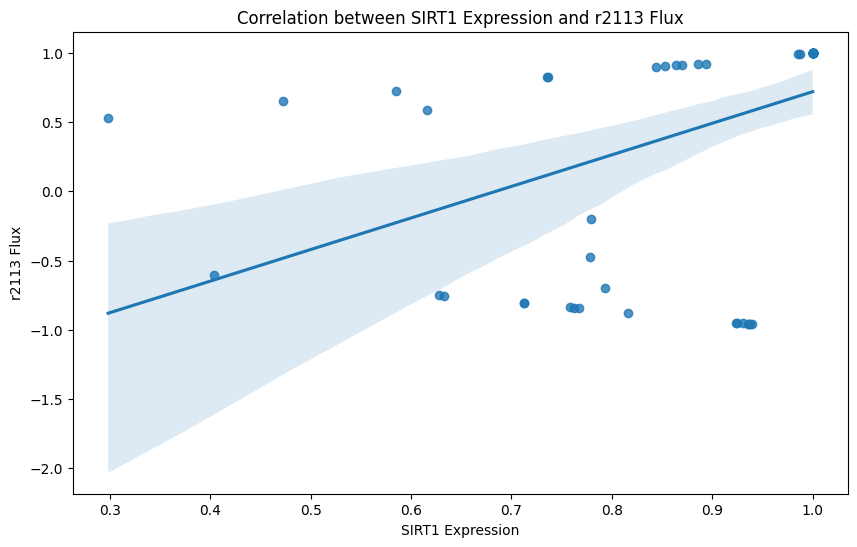

Linear regression results for SIRT1 and r2113:
Slope: 2.2789992505893153
Intercept: -1.5602820302965674
R-squared: 0.206996816747973
P-value: 6.714193518122997e-05
Standard error: 0.5370012157446737



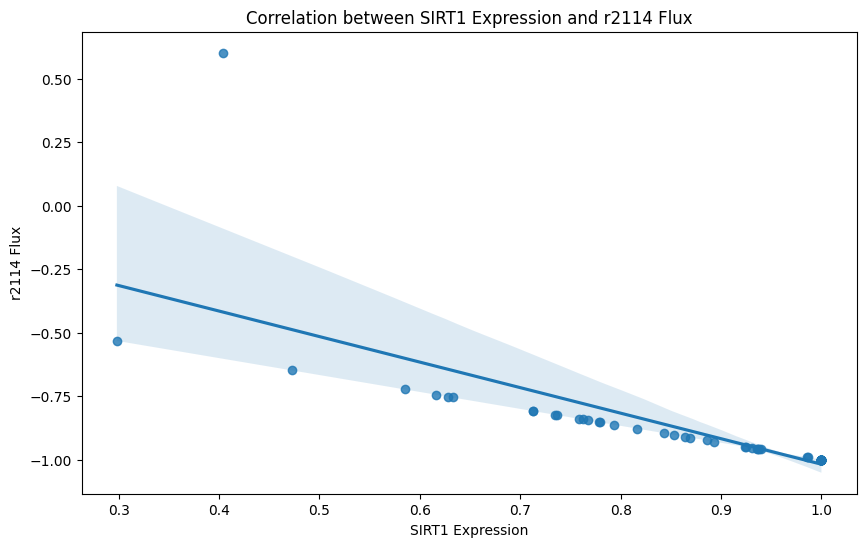

Linear regression results for SIRT1 and r2114:
Slope: -1.0052921981393592
Intercept: -0.012560170602612275
R-squared: 0.590341572688221
P-value: 5.2456224321805375e-15
Standard error: 0.10081543525679984



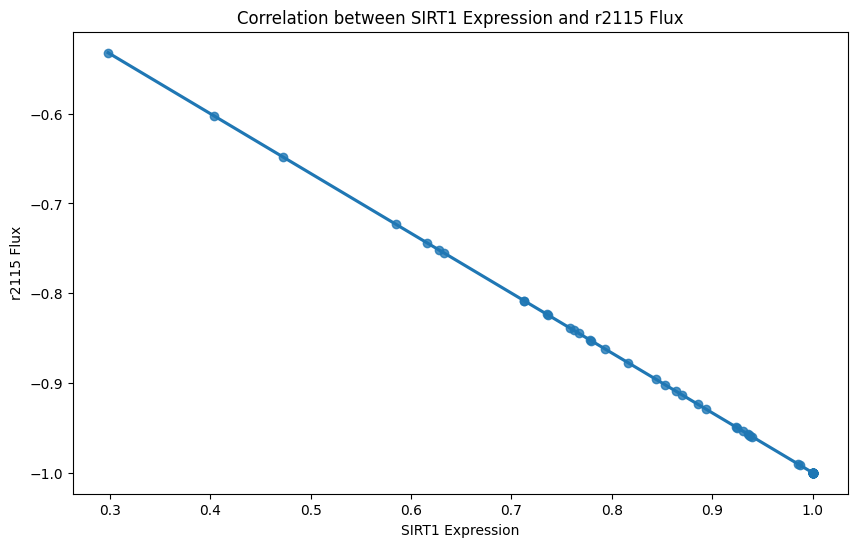

Linear regression results for SIRT1 and r2115:
Slope: -0.6666666666666666
Intercept: -0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



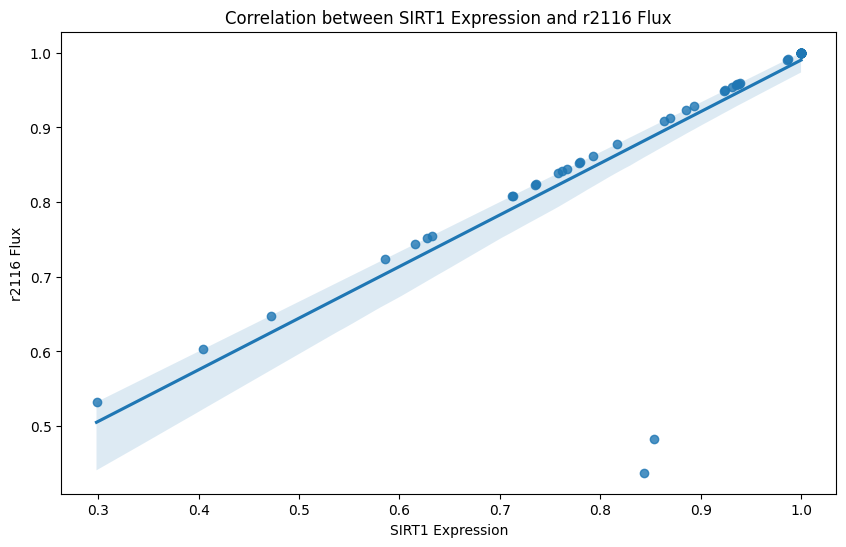

Linear regression results for SIRT1 and r2116:
Slope: 0.691108988942324
Intercept: 0.29905317582467883
R-squared: 0.6918504168659889
P-value: 2.6334576713395345e-19
Standard error: 0.05552603789004418



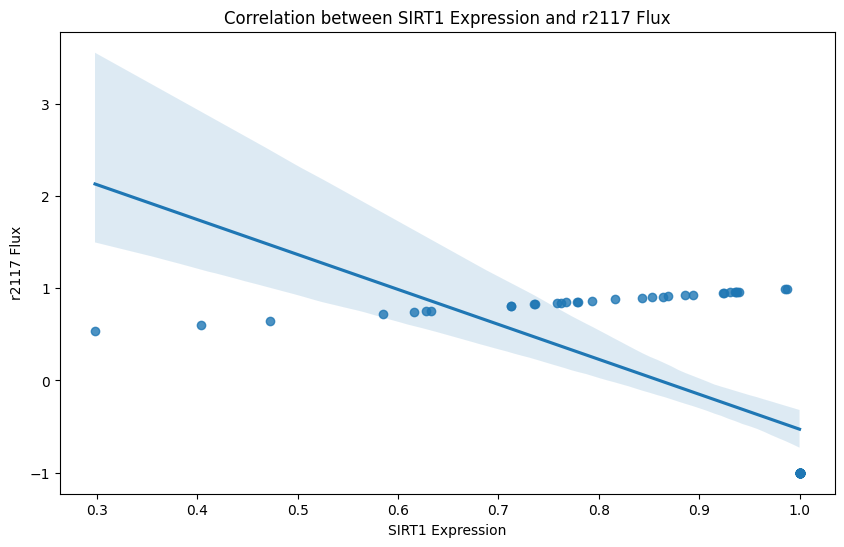

Linear regression results for SIRT1 and r2117:
Slope: -3.7864216668189767
Intercept: 3.2579857127387077
R-squared: 0.41253167790706236
P-value: 1.5662239621220459e-09
Standard error: 0.5439613040345154



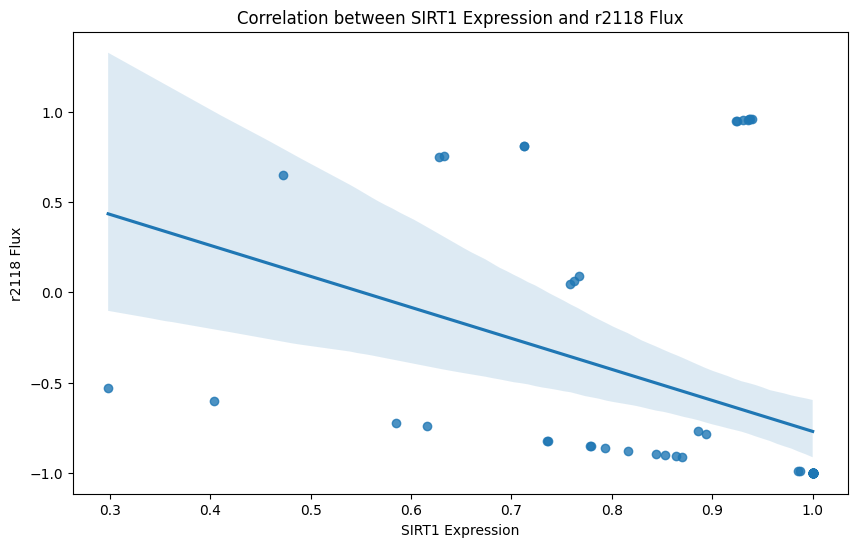

Linear regression results for SIRT1 and r2118:
Slope: -1.718333651859791
Intercept: 0.9472922282775511
R-squared: 0.14942190987975132
P-value: 0.0008691807114421068
Standard error: 0.4935519865179085



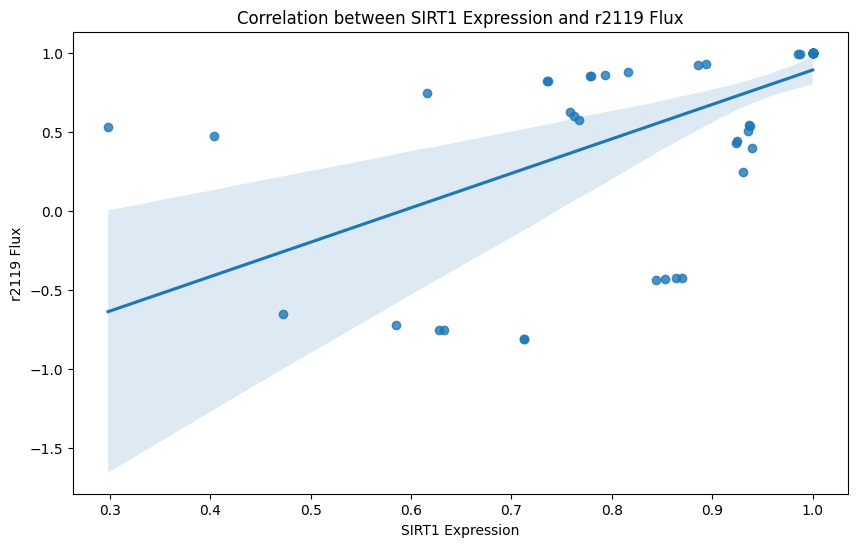

Linear regression results for SIRT1 and r2119:
Slope: 2.1763953131883262
Intercept: -1.2855421867651184
R-squared: 0.37596837666999006
P-value: 1.3132909462402822e-08
Standard error: 0.3375521490110286



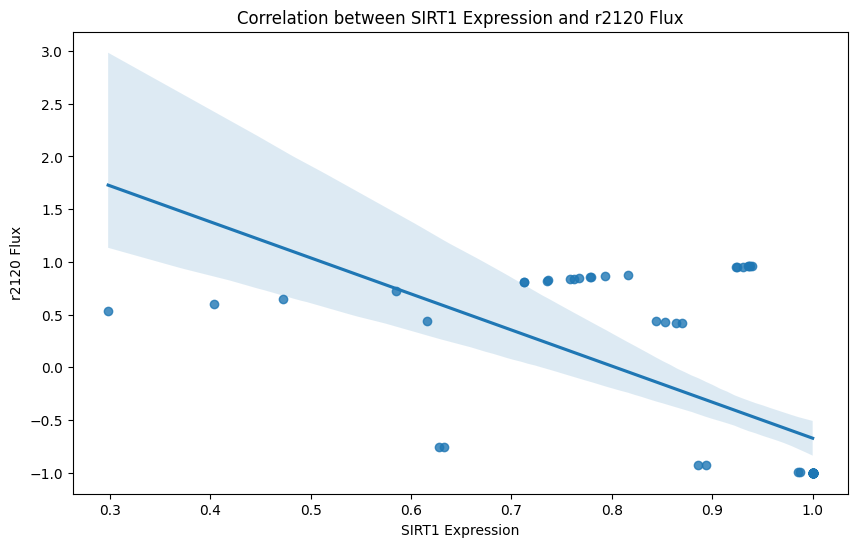

Linear regression results for SIRT1 and r2120:
Slope: -3.4213586521711323
Intercept: 2.748806898548146
R-squared: 0.39385464557447397
P-value: 4.7120391623623776e-09
Standard error: 0.5109688926696349



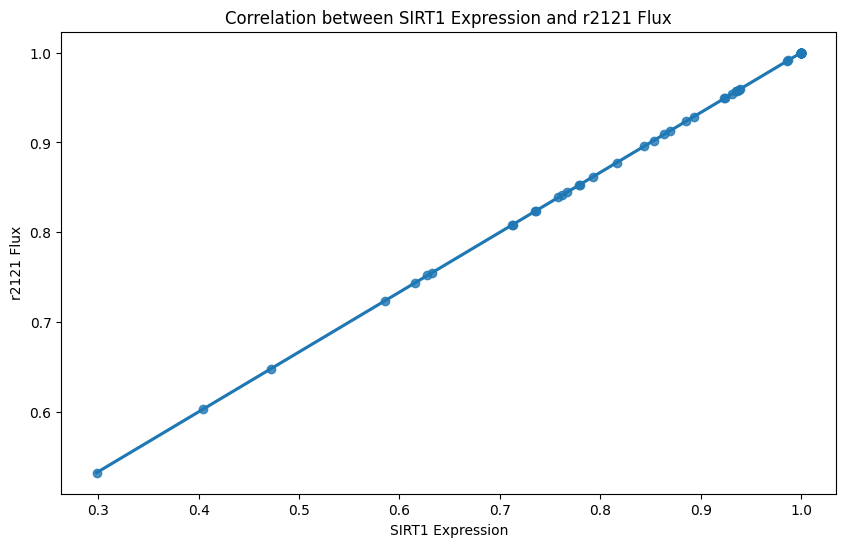

Linear regression results for SIRT1 and r2121:
Slope: 0.6666666666666666
Intercept: 0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



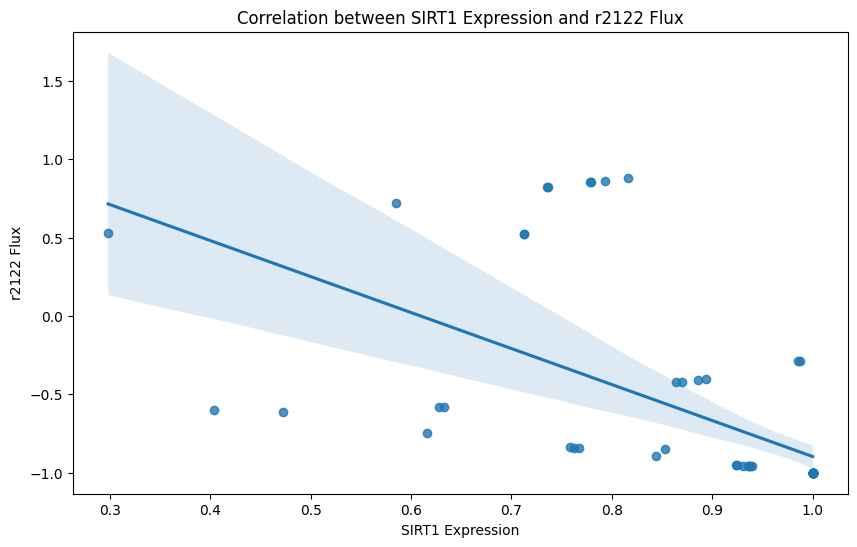

Linear regression results for SIRT1 and r2122:
Slope: -2.2964878879129205
Intercept: 1.3996409771737057
R-squared: 0.3624440929446805
P-value: 2.7991273113676315e-08
Standard error: 0.3666724140020626



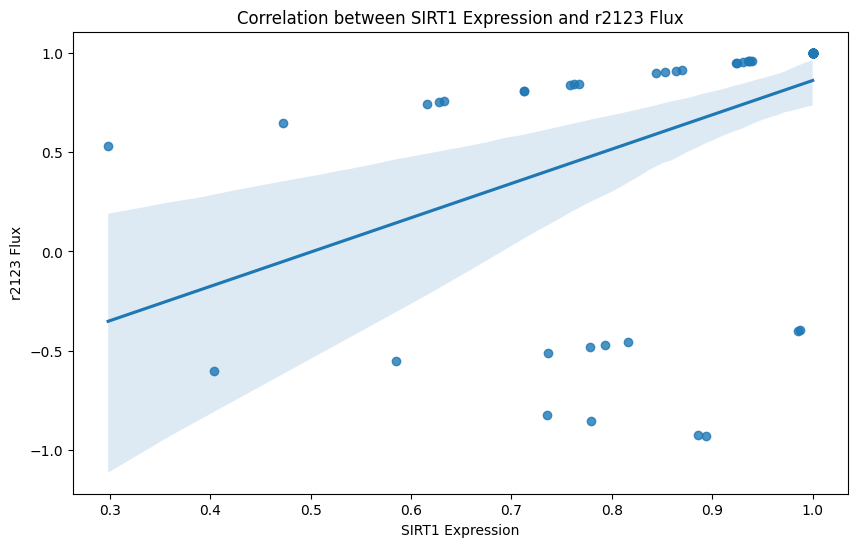

Linear regression results for SIRT1 and r2123:
Slope: 1.7264904059400064
Intercept: -0.8661809793823069
R-squared: 0.2057919814806925
P-value: 7.093638974570824e-05
Standard error: 0.4083123662732376



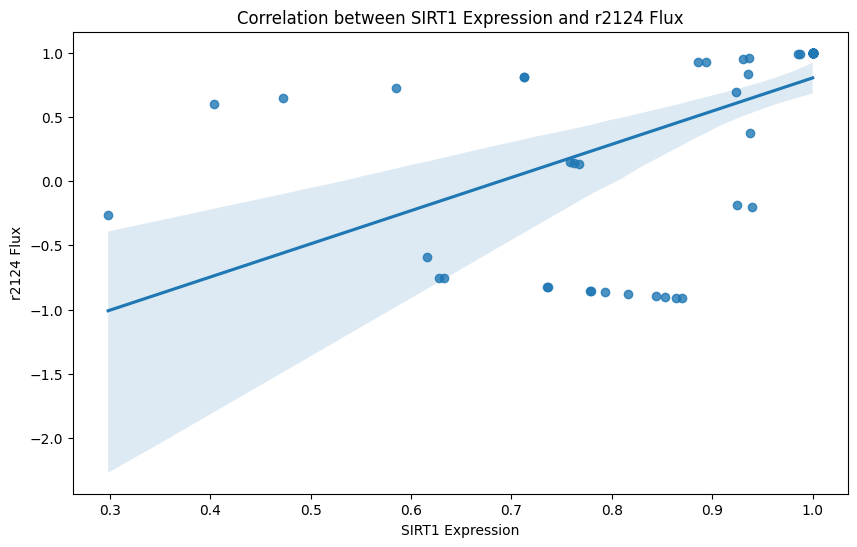

Linear regression results for SIRT1 and r2124:
Slope: 2.5844056626240133
Intercept: -1.7804879526624788
R-squared: 0.32424406495685154
P-value: 2.1943663299906633e-07
Standard error: 0.44915377612565666



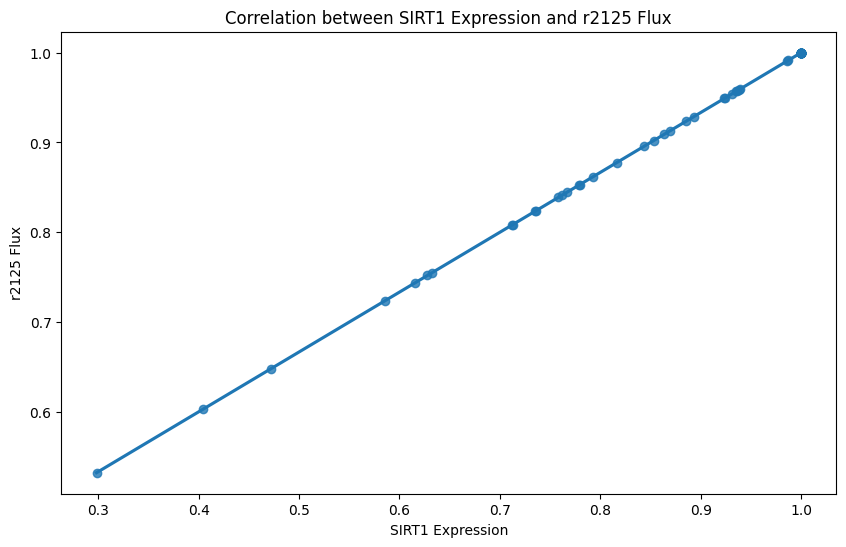

Linear regression results for SIRT1 and r2125:
Slope: 0.6666666666666666
Intercept: 0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



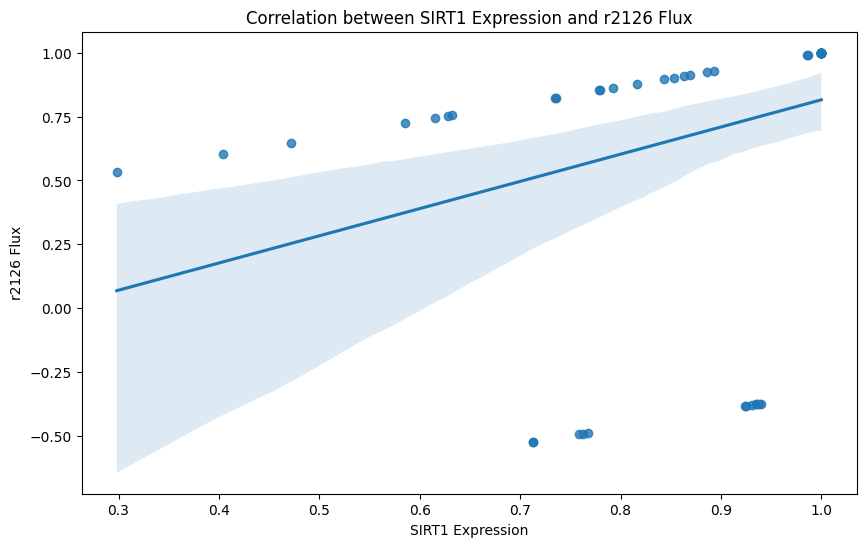

Linear regression results for SIRT1 and r2126:
Slope: 1.0648774491574429
Intercept: -0.24927239497300324
R-squared: 0.10239410450119446
P-value: 0.0065211577753398345
Standard error: 0.3795600164932863



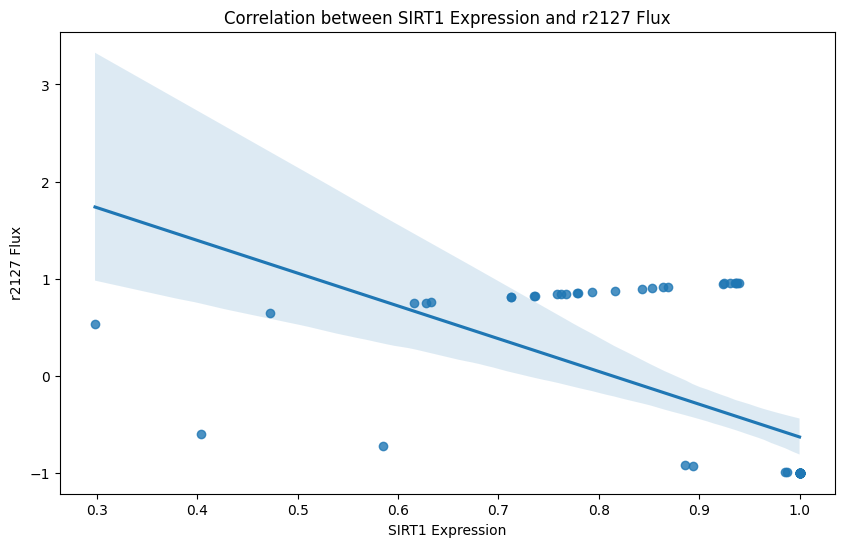

Linear regression results for SIRT1 and r2127:
Slope: -3.376209505011039
Intercept: 2.744591817344886
R-squared: 0.35329358970501756
P-value: 4.631275605816114e-08
Standard error: 0.5499086447363285



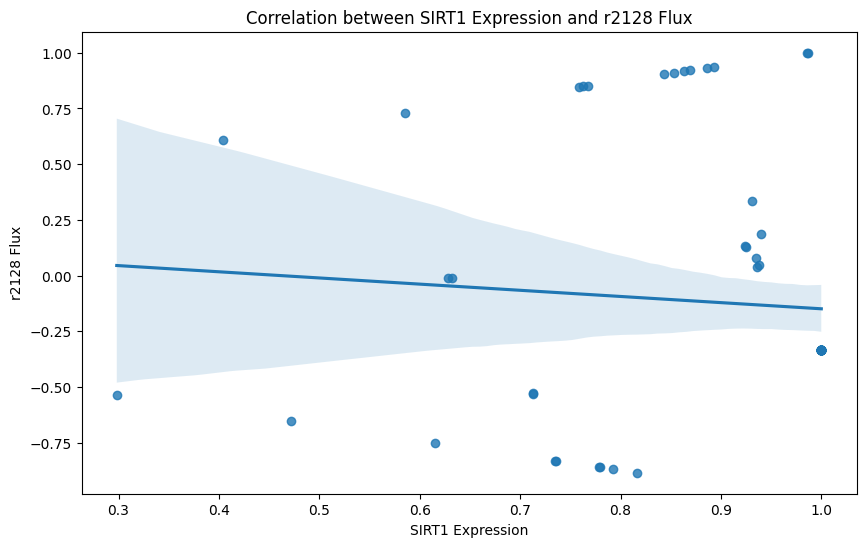

Linear regression results for SIRT1 and r2128:
Slope: -0.27686008644477106
Intercept: 0.12751370050501787
R-squared: 0.006784301552777827
P-value: 0.49468383139102157
Standard error: 0.40327845507503157



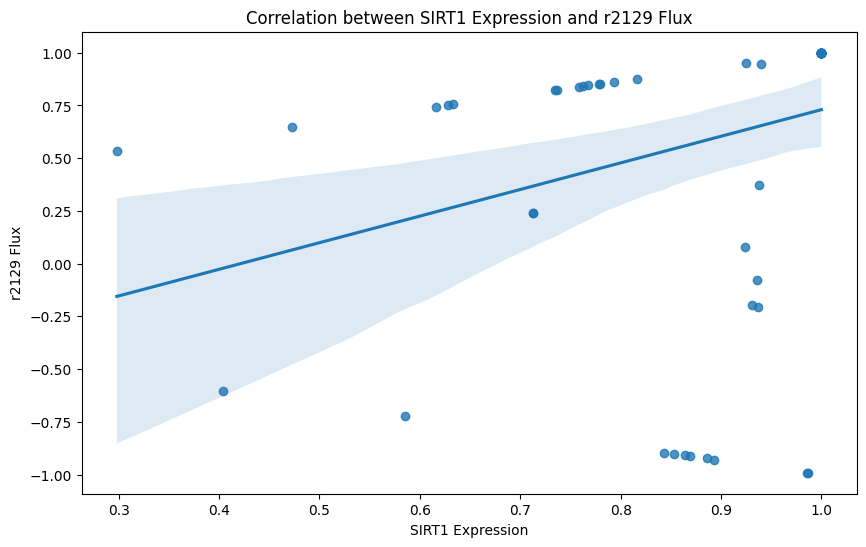

Linear regression results for SIRT1 and r2129:
Slope: 1.2616302982530427
Intercept: -0.5316028636522984
R-squared: 0.08940722727626893
P-value: 0.011308314713829148
Standard error: 0.4847115304245147



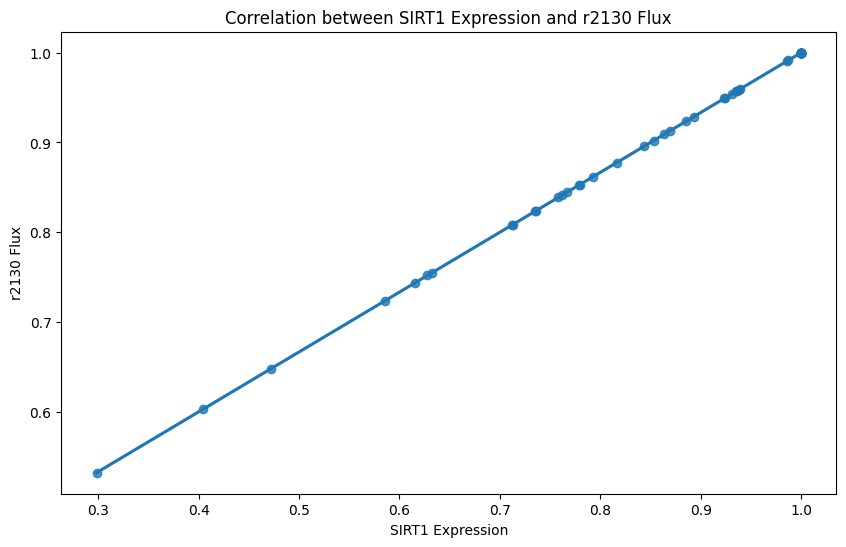

Linear regression results for SIRT1 and r2130:
Slope: 0.6666666666666666
Intercept: 0.33333333333333315
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



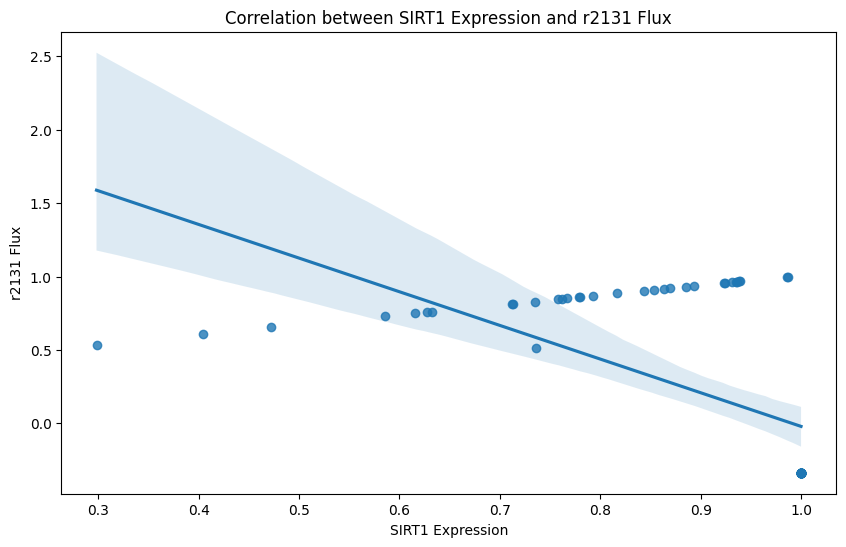

Linear regression results for SIRT1 and r2131:
Slope: -2.2928829406719995
Intercept: 2.272277132453392
R-squared: 0.3635811883258408
P-value: 2.6281077722507838e-08
Standard error: 0.36519778898723887



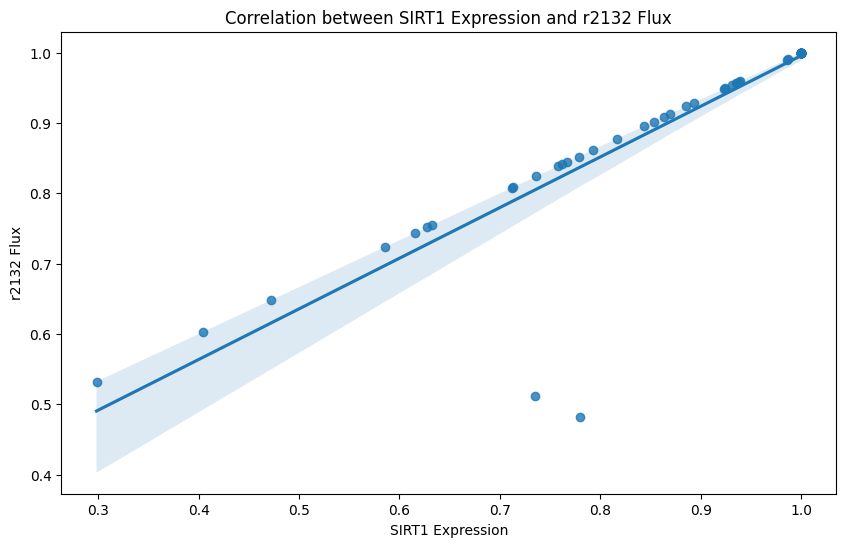

Linear regression results for SIRT1 and r2132:
Slope: 0.7203596838390258
Intercept: 0.27553563606650155
R-squared: 0.8028173008922783
P-value: 5.013228712511126e-26
Standard error: 0.04297846451349834



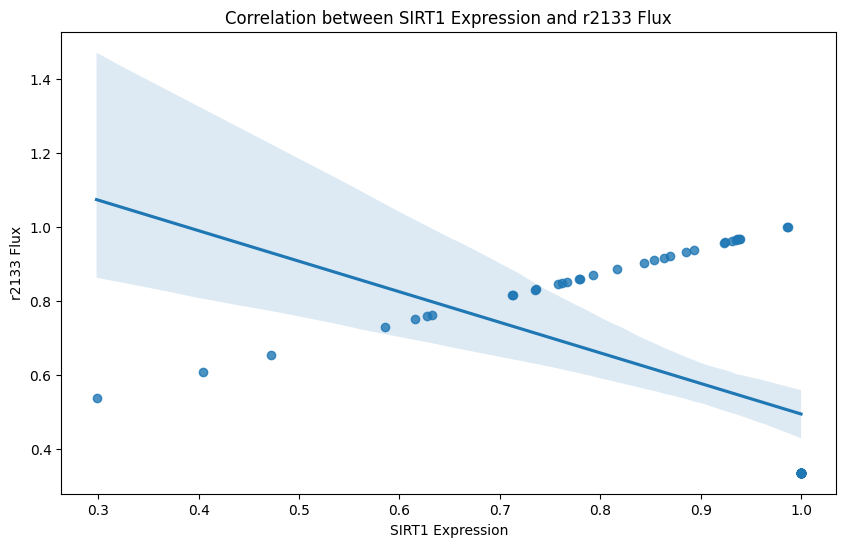

Linear regression results for SIRT1 and r2133:
Slope: -0.8248283367197045
Intercept: 1.3196281805752235
R-squared: 0.22764504751056336
P-value: 2.5895908982062595e-05
Standard error: 0.18290197361508803



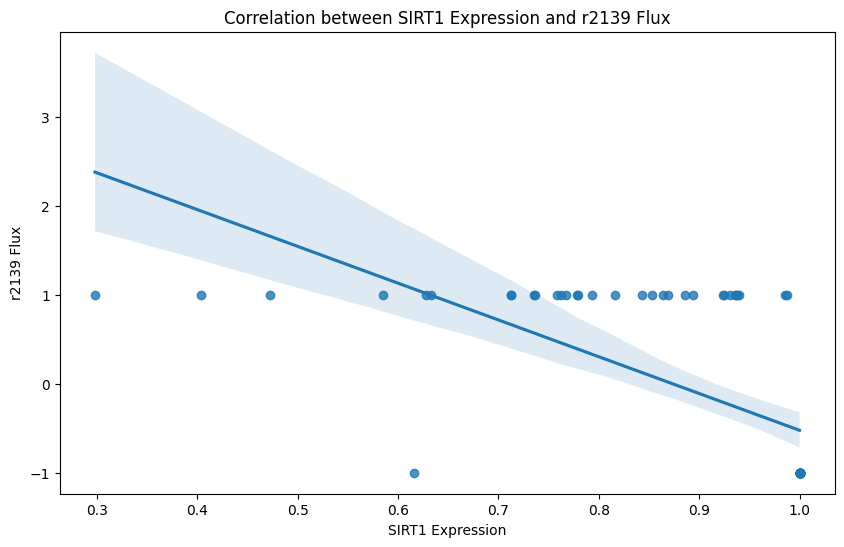

Linear regression results for SIRT1 and r2139:
Slope: -4.132392297788901
Intercept: 3.6087718735467536
R-squared: 0.4263399531372972
P-value: 6.788360829155282e-10
Standard error: 0.5770670583777396



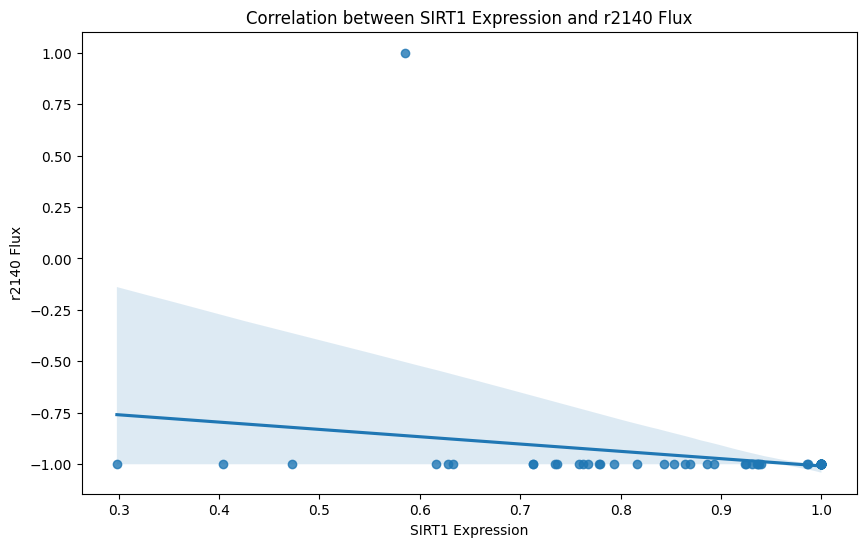

Linear regression results for SIRT1 and r2140:
Slope: -0.35540227158293386
Intercept: -0.652982898146401
R-squared: 0.056222465970433275
P-value: 0.046483561953571235
Standard error: 0.1752974208370211



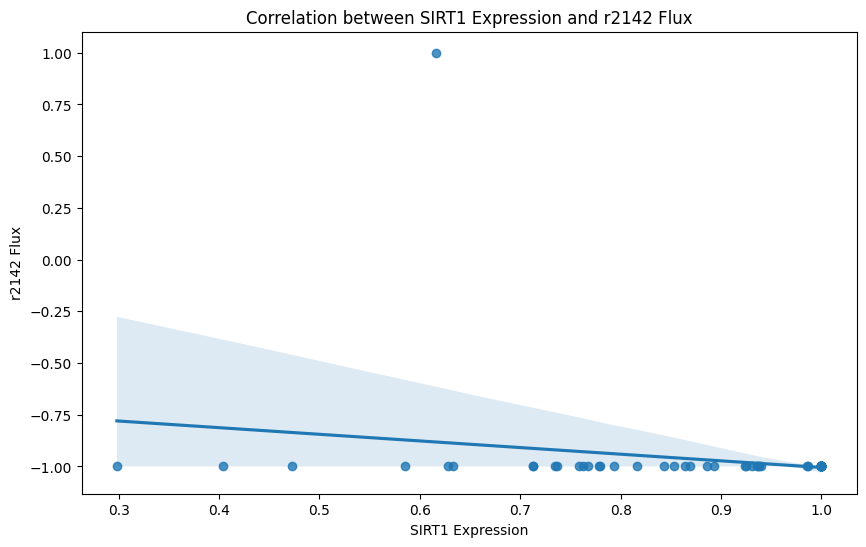

Linear regression results for SIRT1 and r2142:
Slope: -0.3206960356967384
Intercept: -0.6841194941413824
R-squared: 0.04577798520446773
P-value: 0.07318891836043265
Standard error: 0.17626473190483746



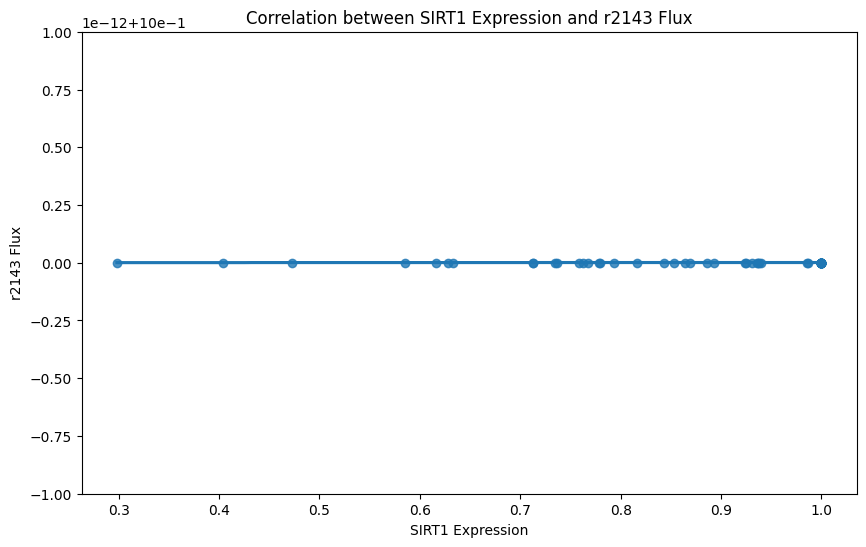

Linear regression results for SIRT1 and r2143:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



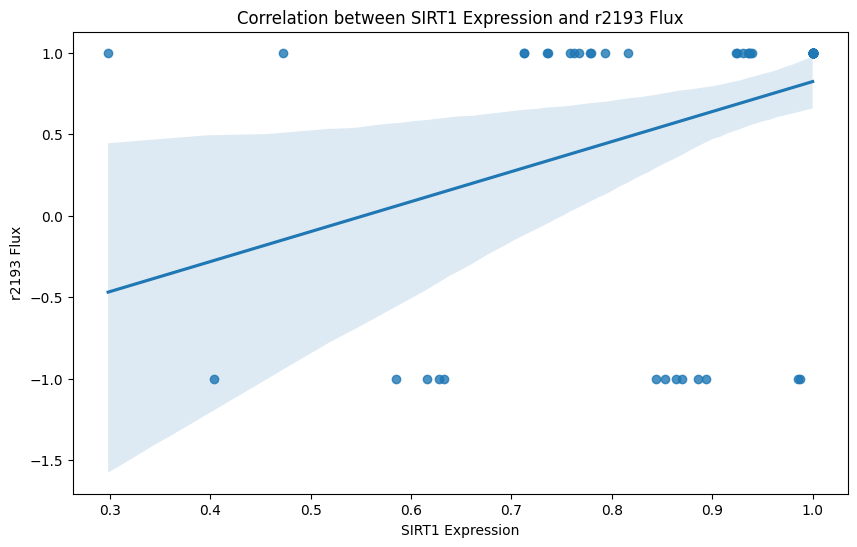

Linear regression results for SIRT1 and r2193:
Slope: 1.8409748585322785
Intercept: -1.017822285717037
R-squared: 0.14005283387235426
P-value: 0.0013040390254072363
Standard error: 0.5491781459713138



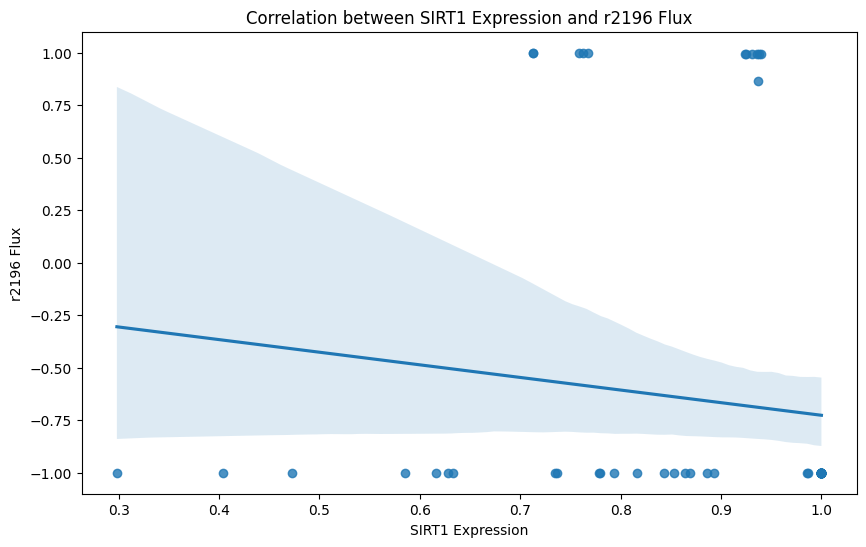

Linear regression results for SIRT1 and r2196:
Slope: -0.600549065713996
Intercept: -0.12589506888393565
R-squared: 0.016122787926120544
P-value: 0.29133287688807896
Standard error: 0.5647735256210124



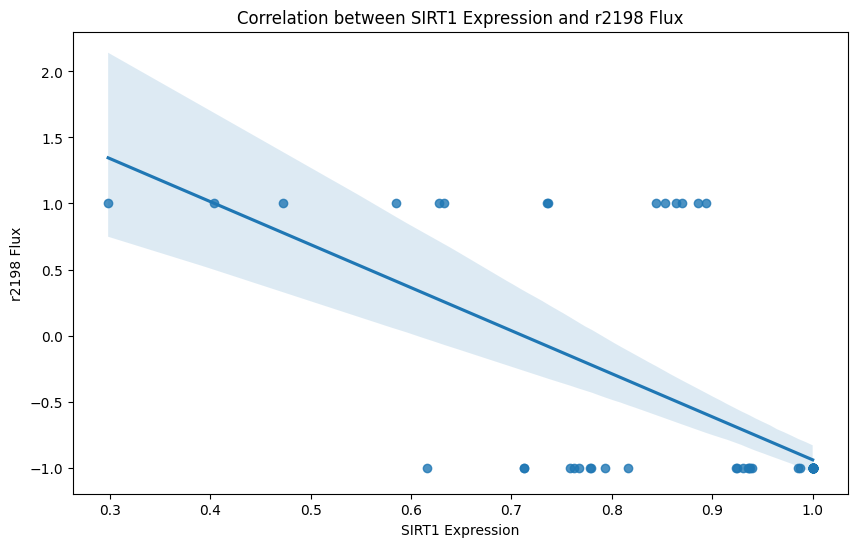

Linear regression results for SIRT1 and r2198:
Slope: -3.258257427407164
Intercept: 2.317502128647702
R-squared: 0.4145103969165786
P-value: 1.391002429631156e-09
Standard error: 0.4661790238991359



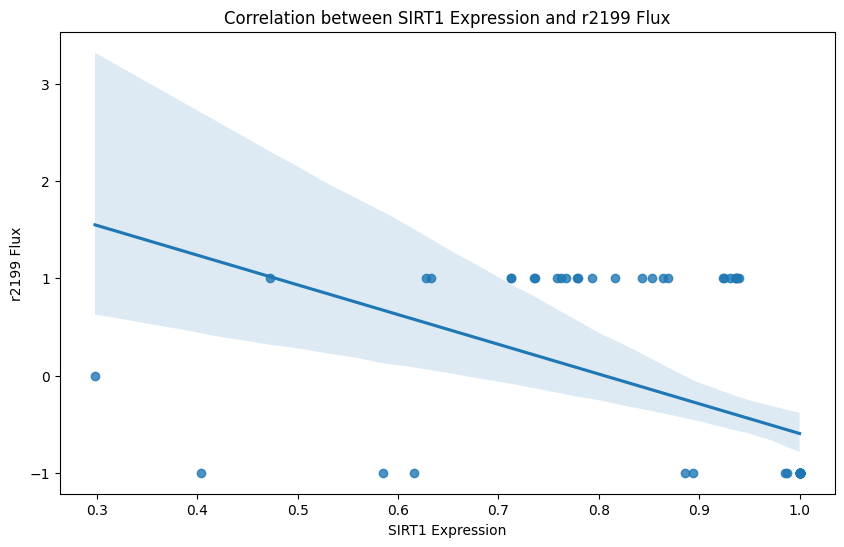

Linear regression results for SIRT1 and r2199:
Slope: -3.0598429832478238
Intercept: 2.4634318216679922
R-squared: 0.25533567868937423
P-value: 6.977318492856518e-06
Standard error: 0.6290702062472137



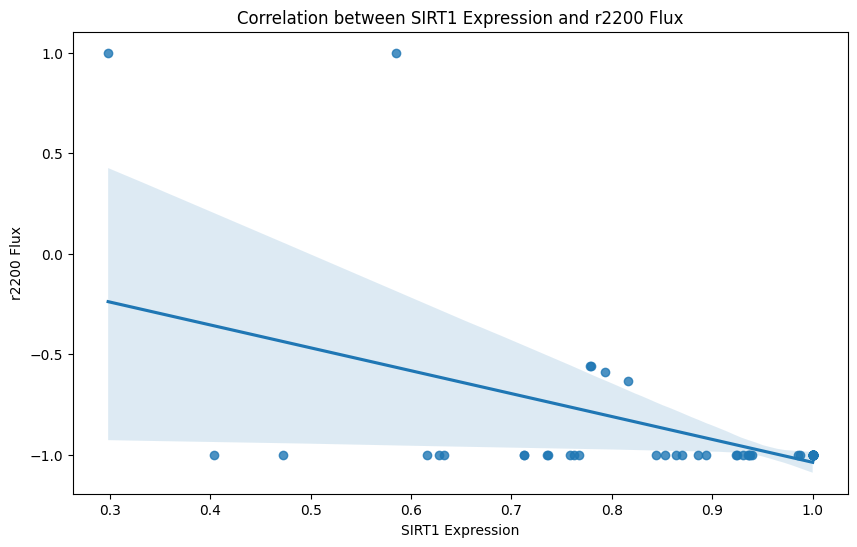

Linear regression results for SIRT1 and r2200:
Slope: -1.138790413612981
Intercept: 0.10145947861512916
R-squared: 0.2760949391052931
P-value: 2.538767895984086e-06
Standard error: 0.221988686062991



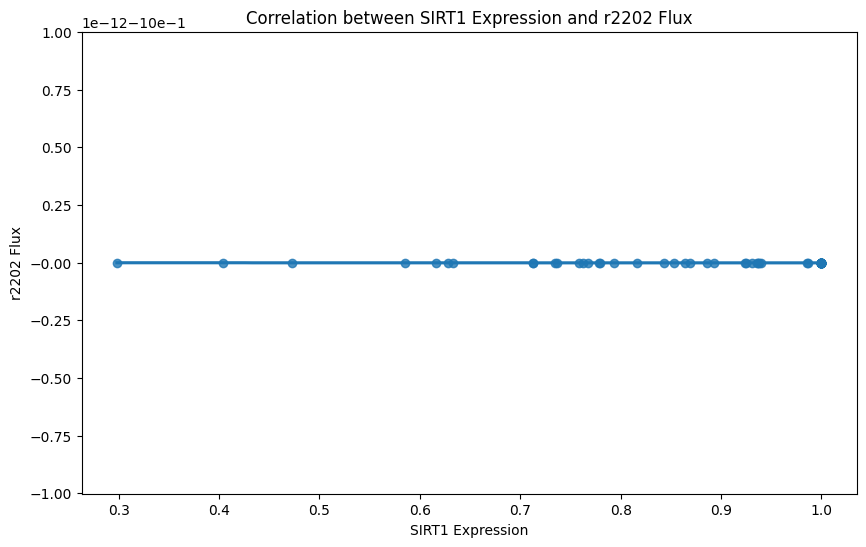

Linear regression results for SIRT1 and r2202:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



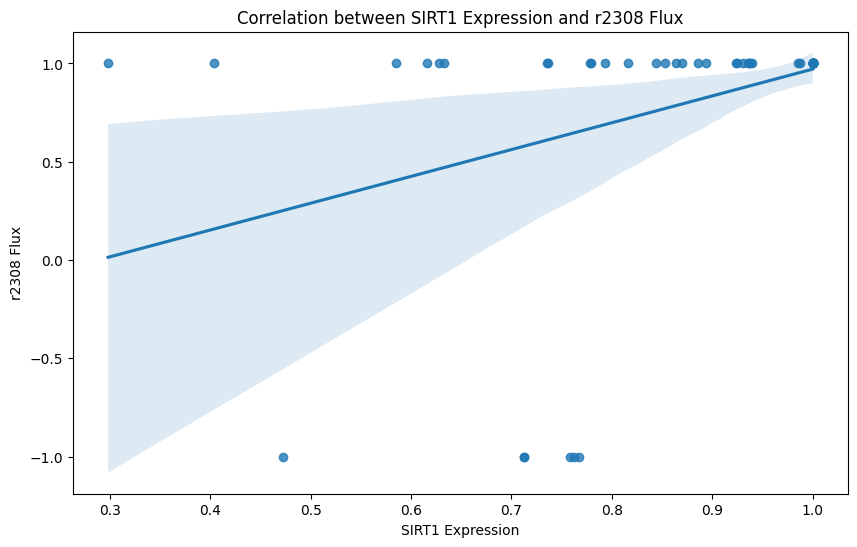

Linear regression results for SIRT1 and r2308:
Slope: 1.3646098048704804
Intercept: -0.39326970025195807
R-squared: 0.14877155398911215
P-value: 0.0008940795082140351
Standard error: 0.3929588339807566



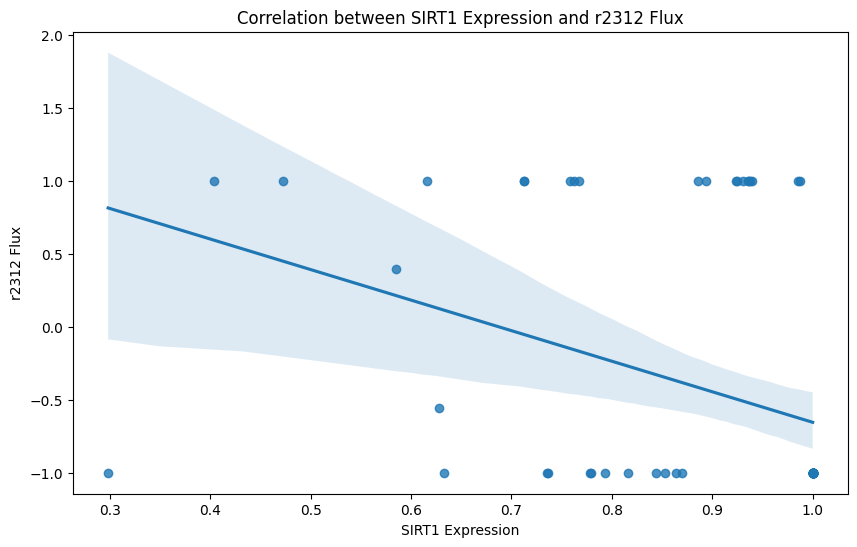

Linear regression results for SIRT1 and r2312:
Slope: -2.0946557064787044
Intercept: 1.4403811260273338
R-squared: 0.13804500739665607
P-value: 0.0014220202215602623
Standard error: 0.6301153311639458



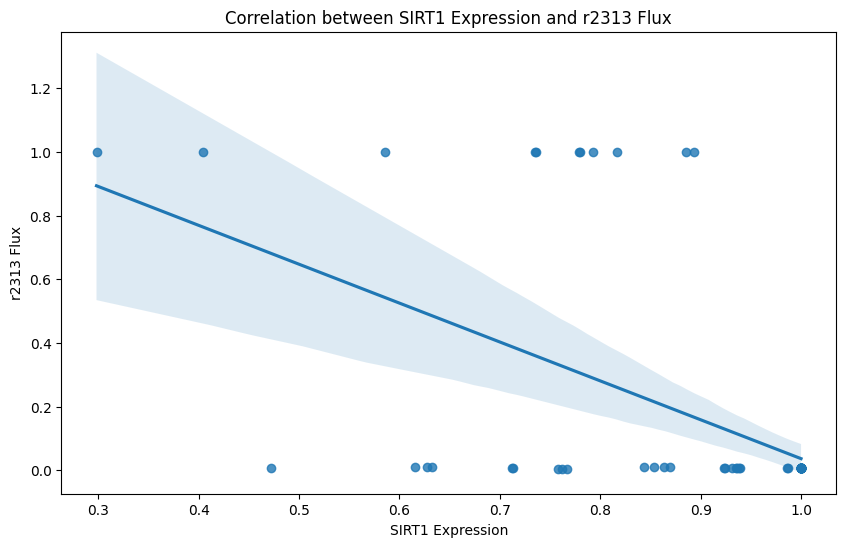

Linear regression results for SIRT1 and r2313:
Slope: -1.2222339288700805
Intercept: 1.2583476320610474
R-squared: 0.2867497913390999
P-value: 1.496023386046952e-06
Standard error: 0.23205941254117518



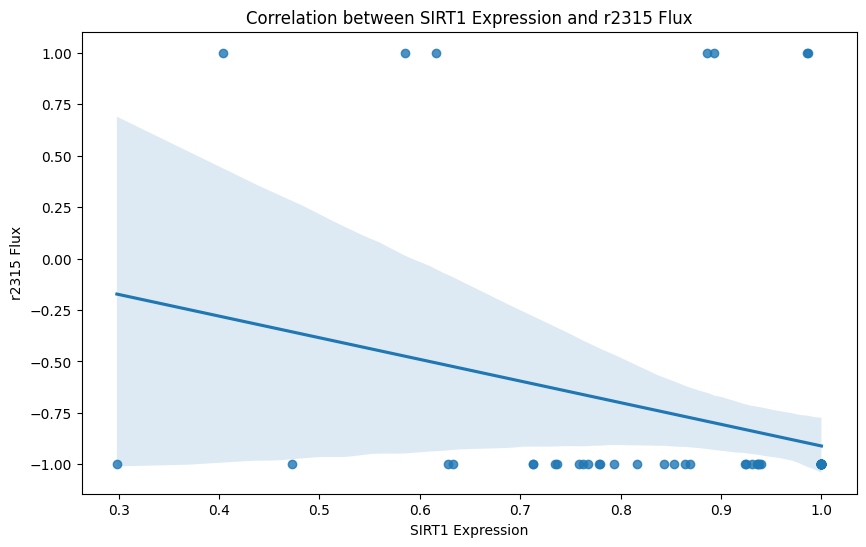

Linear regression results for SIRT1 and r2315:
Slope: -1.051885813237594
Intercept: 0.14087931811326015
R-squared: 0.07695320517277869
P-value: 0.019174017878881358
Standard error: 0.4385736700757864



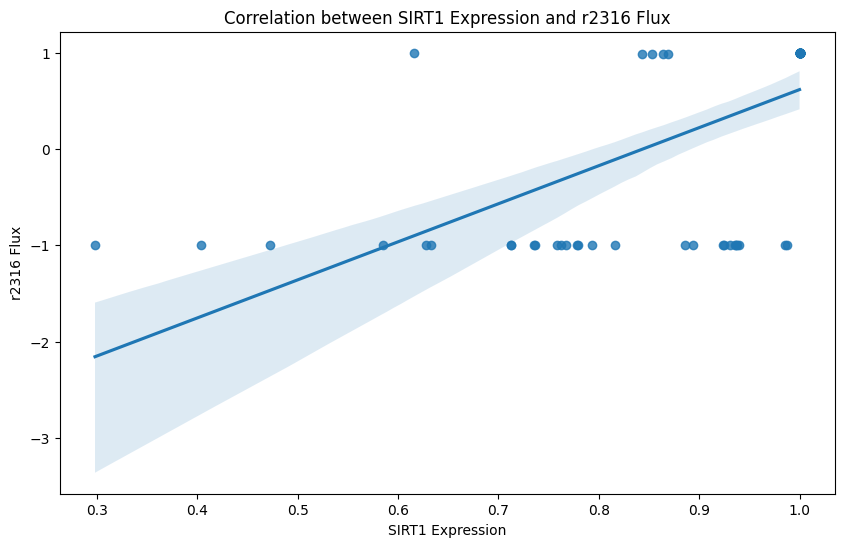

Linear regression results for SIRT1 and r2316:
Slope: 3.9525656014176116
Intercept: -3.33532022791815
R-squared: 0.40466469701863667
P-value: 2.5008313777511998e-09
Standard error: 0.5771486718951473



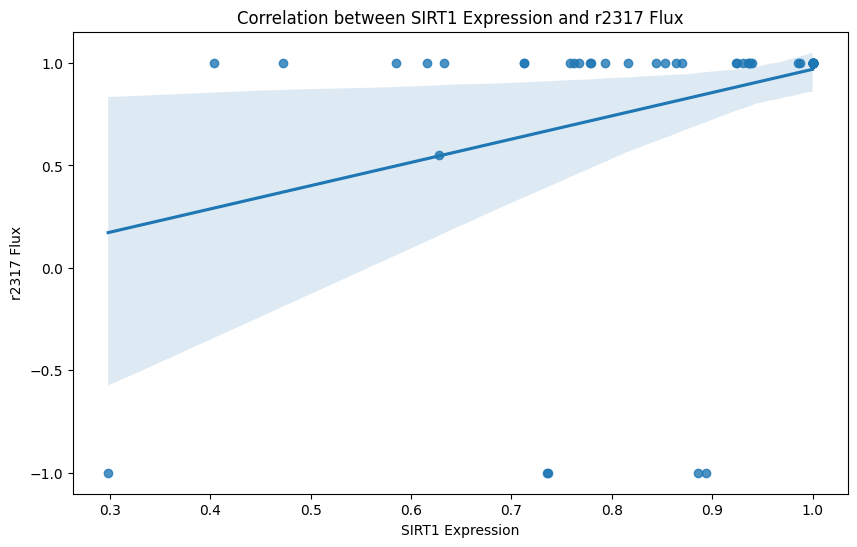

Linear regression results for SIRT1 and r2317:
Slope: 1.136345008449272
Intercept: -0.16661455368884104
R-squared: 0.12145395129196479
P-value: 0.002897695449929255
Standard error: 0.3679273766813851



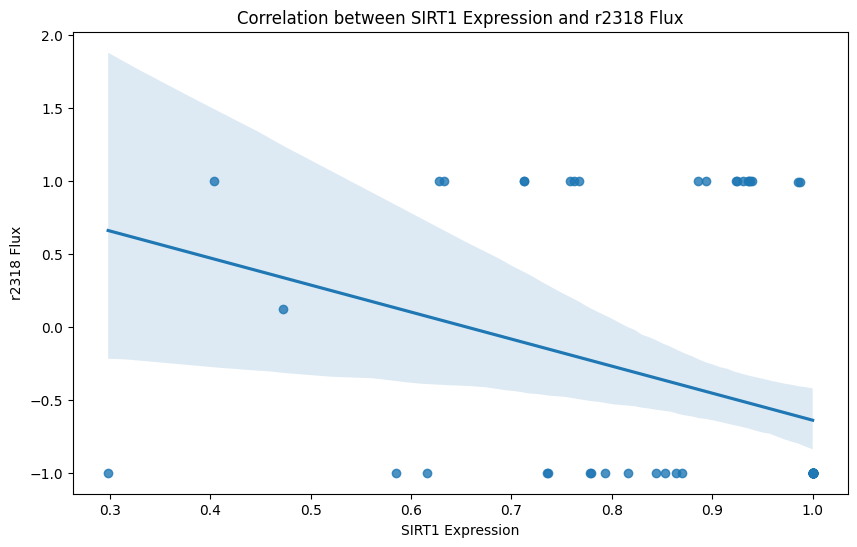

Linear regression results for SIRT1 and r2318:
Slope: -1.853998993064931
Intercept: 1.214095807233862
R-squared: 0.10841381314961064
P-value: 0.005050266959656923
Standard error: 0.6400653310464632



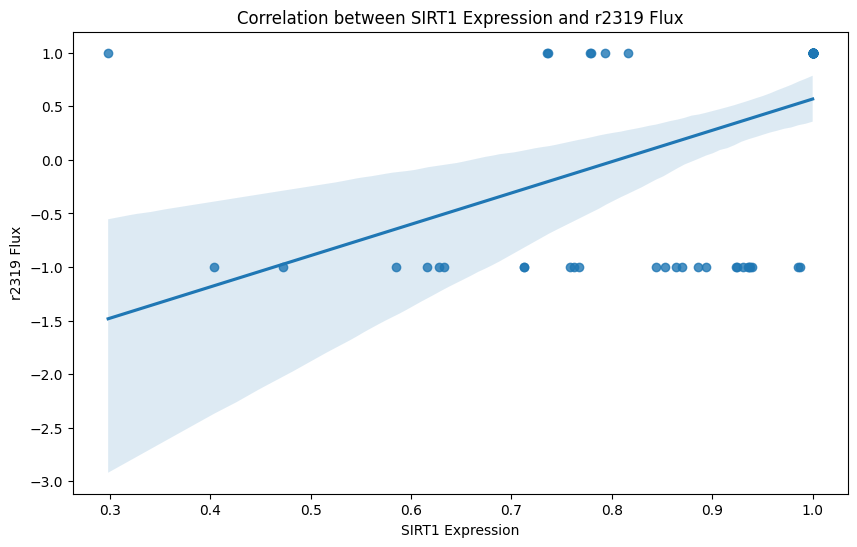

Linear regression results for SIRT1 and r2319:
Slope: 2.922475607193333
Intercept: -2.354284639309764
R-squared: 0.2274487004663085
P-value: 2.613412337973008e-05
Standard error: 0.6484078788908523



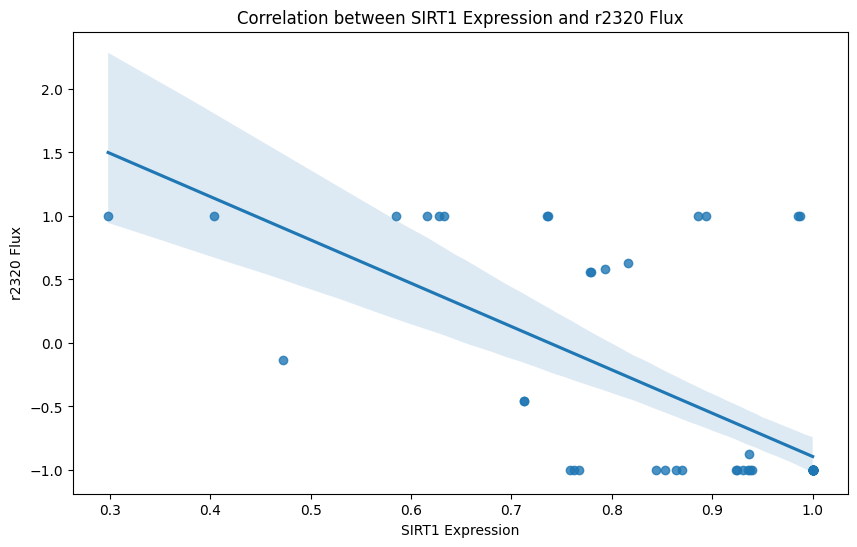

Linear regression results for SIRT1 and r2320:
Slope: -3.411014425923834
Intercept: 2.516633903209354
R-squared: 0.4579724785377126
P-value: 9.27449795326258e-11
Standard error: 0.44673501102758373



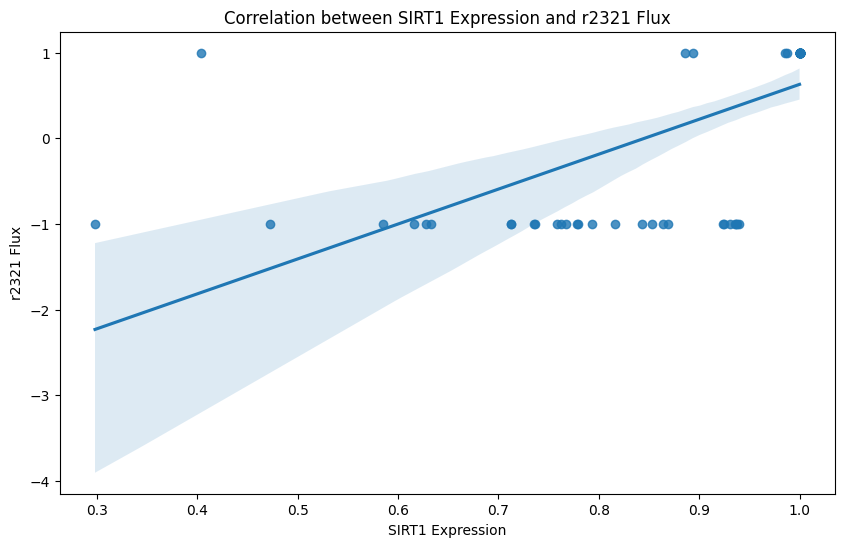

Linear regression results for SIRT1 and r2321:
Slope: 4.077300827527717
Intercept: -3.4466706690043263
R-squared: 0.43021599739741223
P-value: 5.349809747638494e-10
Standard error: 0.5648850201893018



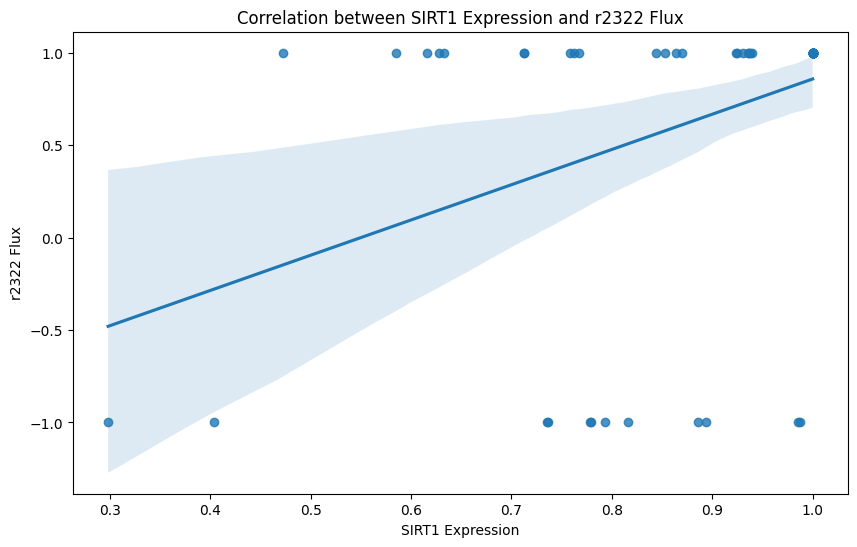

Linear regression results for SIRT1 and r2322:
Slope: 1.9066868118825253
Intercept: -1.0486317268865717
R-squared: 0.15999489322246152
P-value: 0.0005481262691703684
Standard error: 0.525947893476753



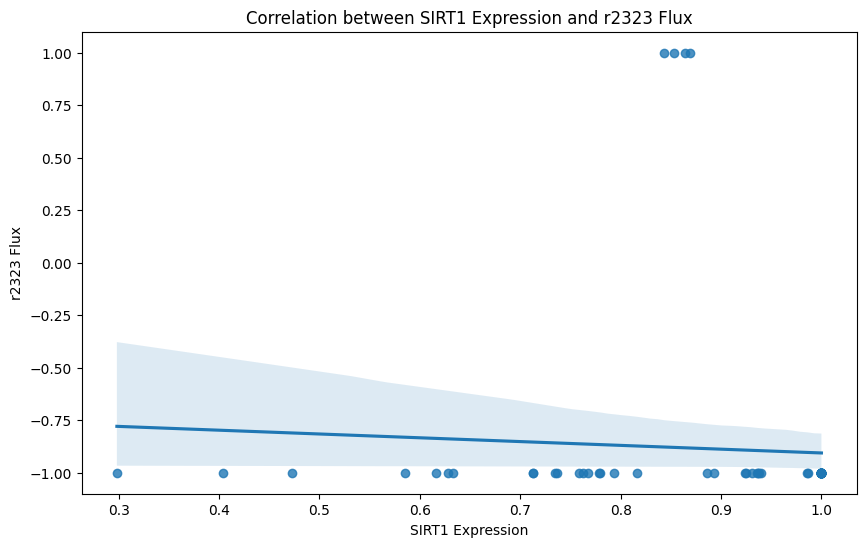

Linear regression results for SIRT1 and r2323:
Slope: -0.1807145376690292
Intercept: -0.7251964352720891
R-squared: 0.003796810480014604
P-value: 0.6097191848672443
Standard error: 0.3523976874395404



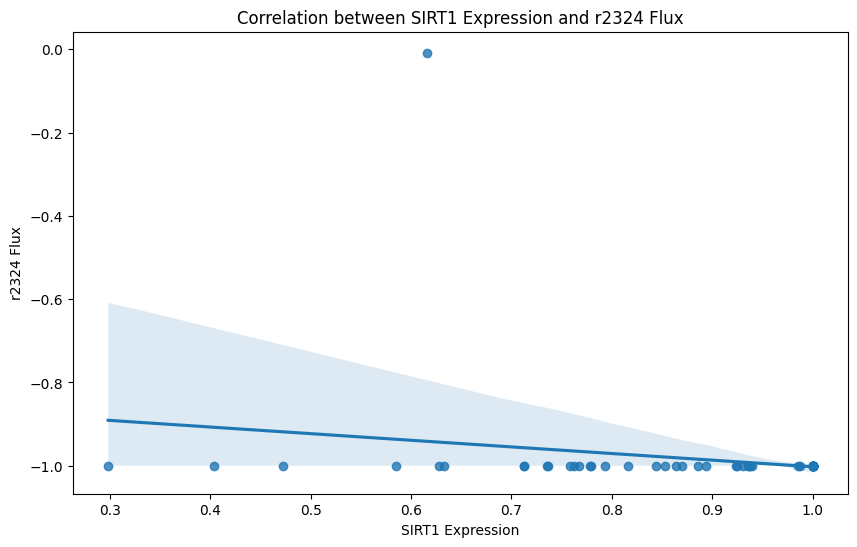

Linear regression results for SIRT1 and r2324:
Slope: -0.1590311173021812
Intercept: -0.8433568732100636
R-squared: 0.045777985204467665
P-value: 0.07318891836043281
Standard error: 0.08740855556538092



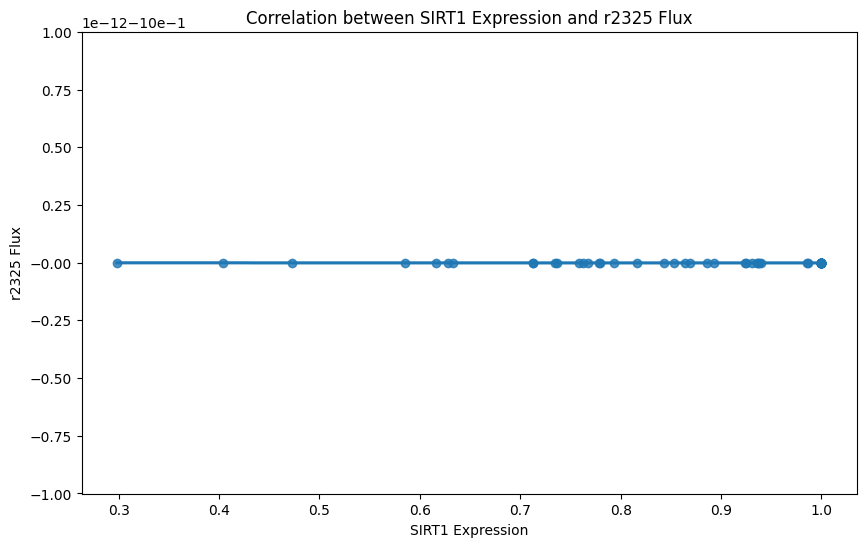

Linear regression results for SIRT1 and r2325:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



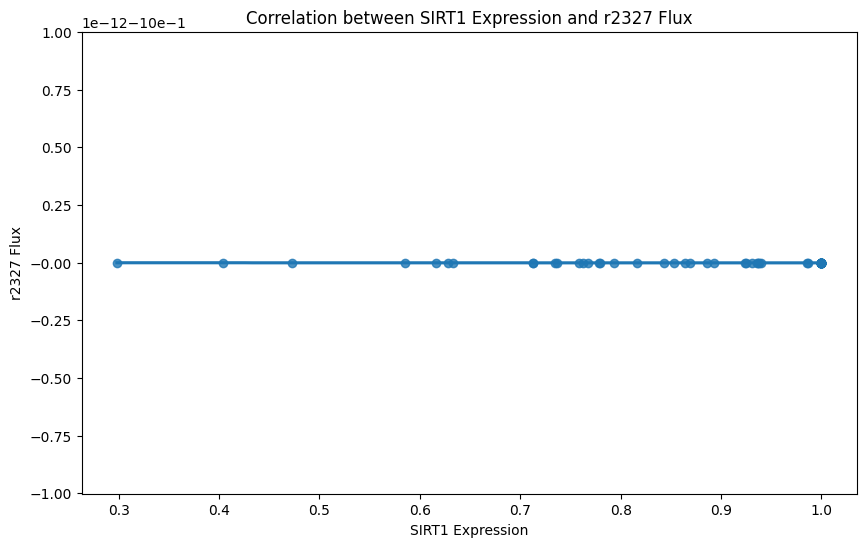

Linear regression results for SIRT1 and r2327:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



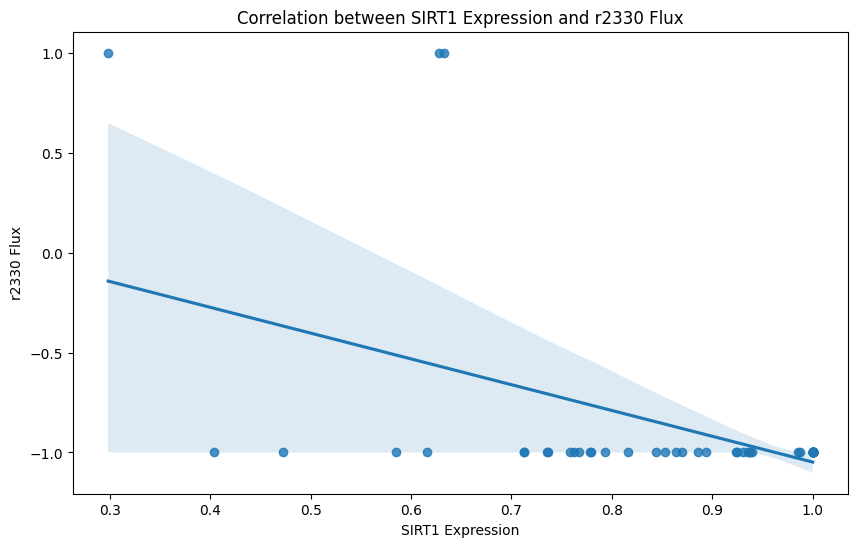

Linear regression results for SIRT1 and r2330:
Slope: -1.290498243038392
Intercept: 0.24224994363767616
R-squared: 0.254504958780943
P-value: 7.261654256490221e-06
Standard error: 0.26589313676605175



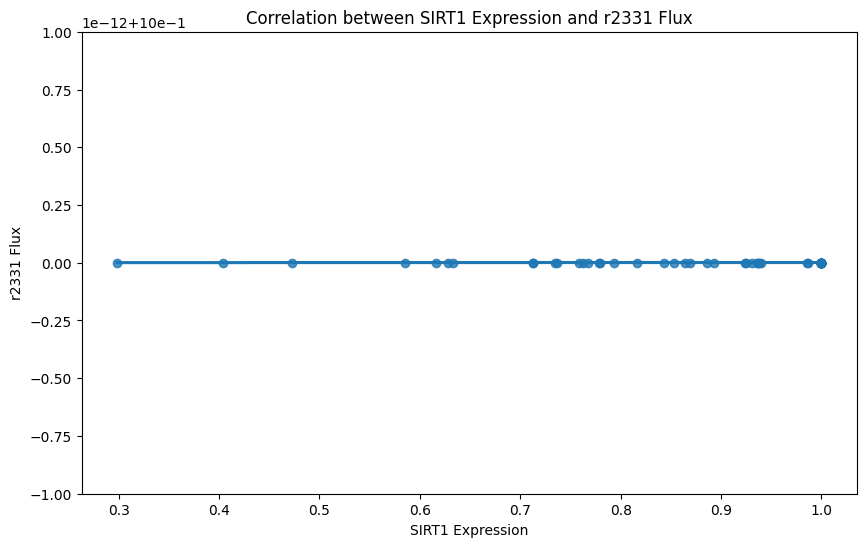

Linear regression results for SIRT1 and r2331:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



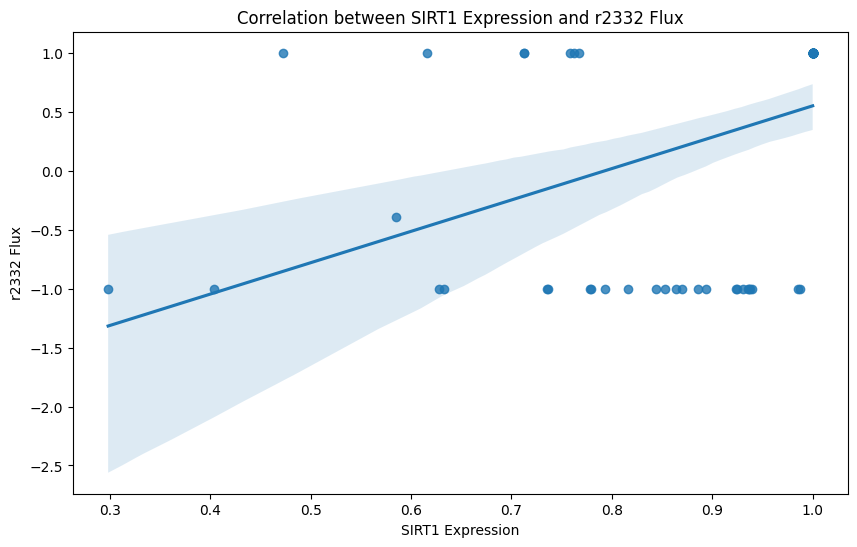

Linear regression results for SIRT1 and r2332:
Slope: 2.660660029283351
Intercept: -2.1109070993564876
R-squared: 0.19192805063205925
P-value: 0.00013292046697204601
Standard error: 0.6572349189451785



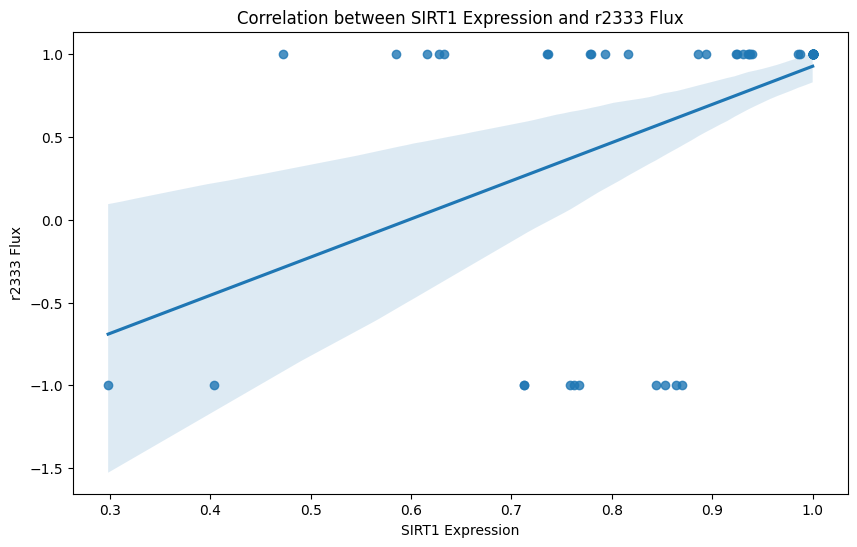

Linear regression results for SIRT1 and r2333:
Slope: 2.3054045253737656
Intercept: -1.378145947739525
R-squared: 0.25090994703087705
P-value: 8.628090233876594e-06
Standard error: 0.4795464404363228



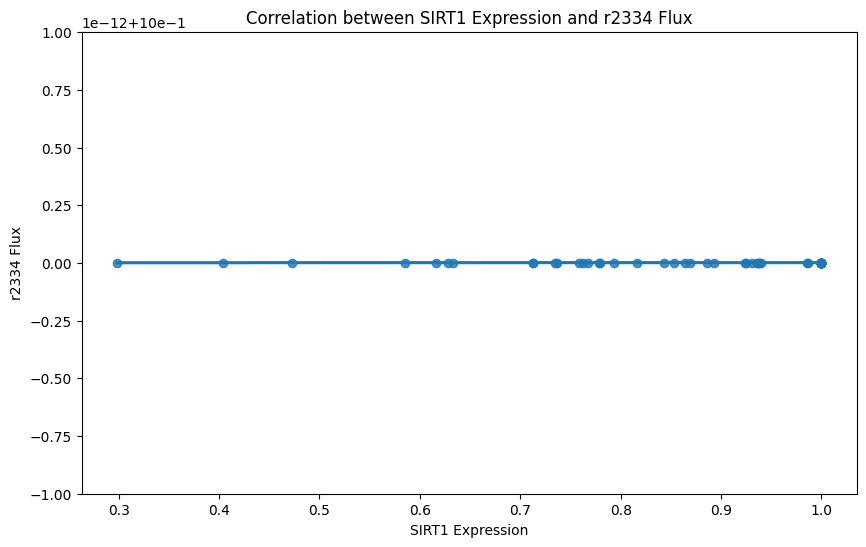

Linear regression results for SIRT1 and r2334:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



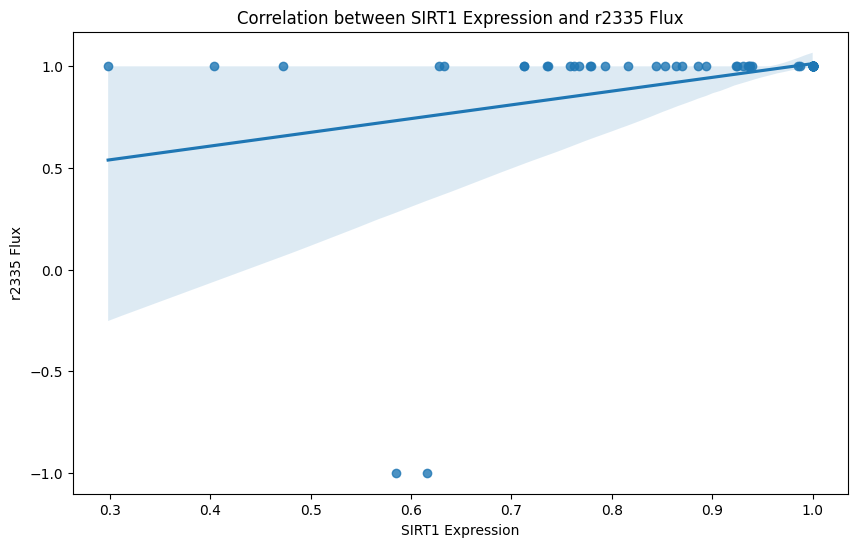

Linear regression results for SIRT1 and r2335:
Slope: 0.6760983072796725
Intercept: 0.33710239228778305
R-squared: 0.1032067595593936
P-value: 0.006300115862973335
Standard error: 0.23992604500449824



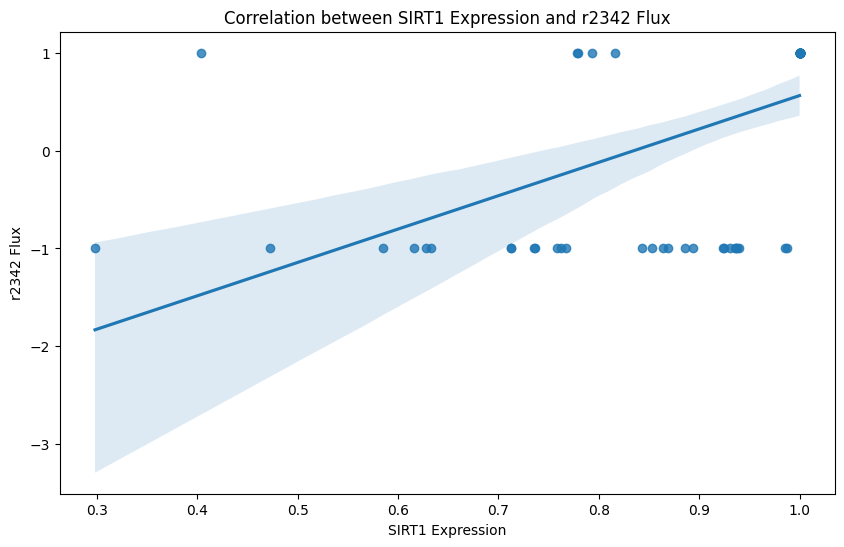

Linear regression results for SIRT1 and r2342:
Slope: 3.4110940508354277
Intercept: -2.8489852466206975
R-squared: 0.30111225595763597
P-value: 7.251327630163091e-07
Standard error: 0.6256171486455506



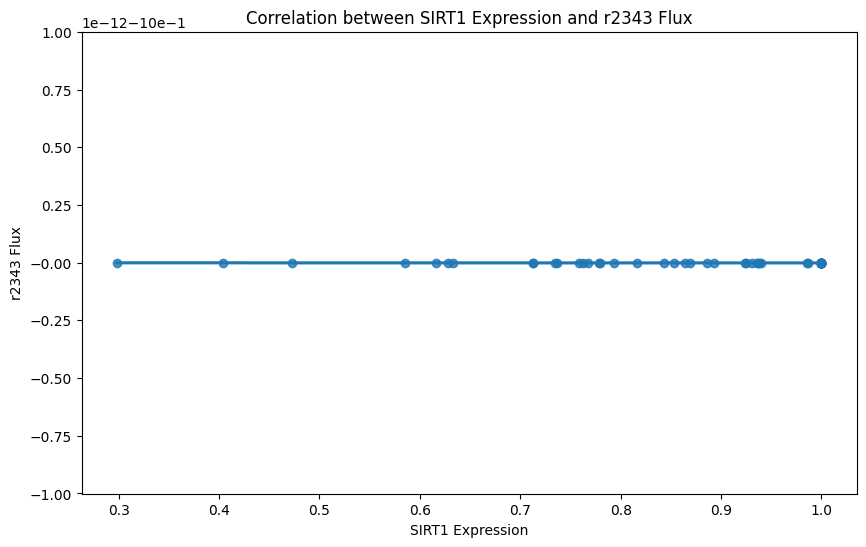

Linear regression results for SIRT1 and r2343:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



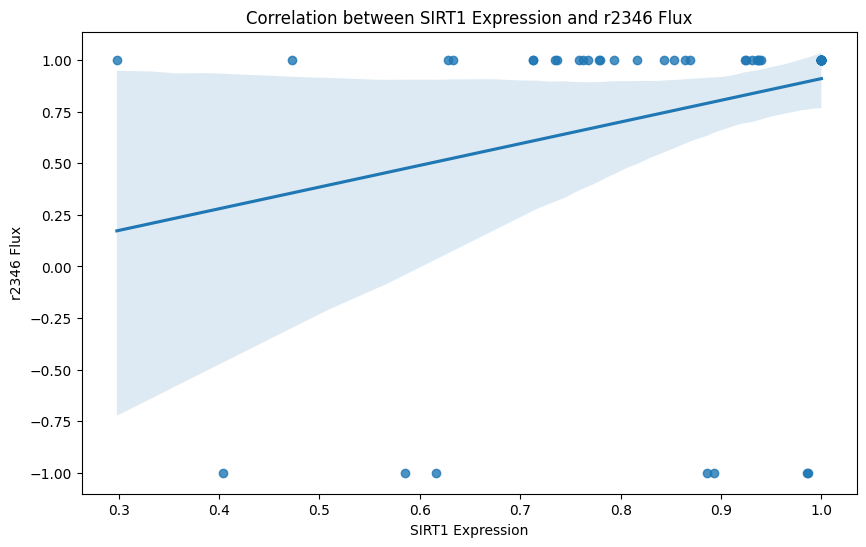

Linear regression results for SIRT1 and r2346:
Slope: 1.051885813237594
Intercept: -0.14087931811326015
R-squared: 0.07695320517277869
P-value: 0.019174017878881358
Standard error: 0.4385736700757864



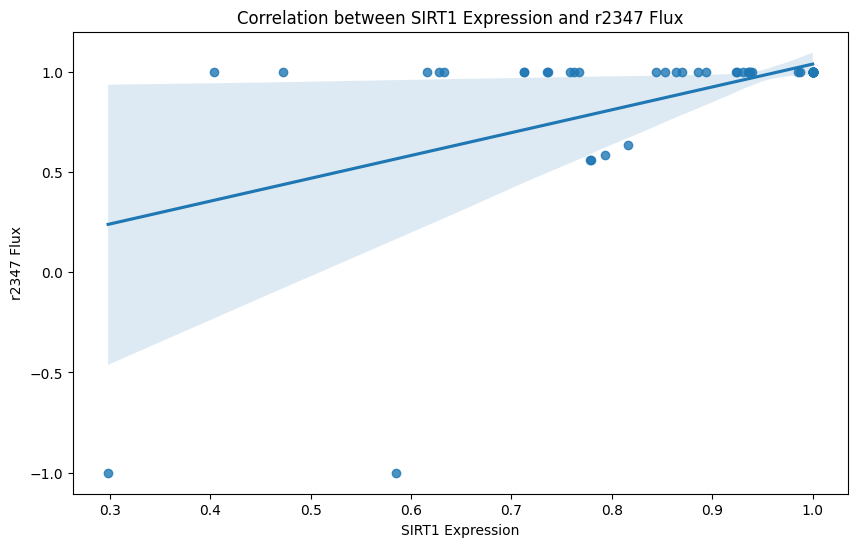

Linear regression results for SIRT1 and r2347:
Slope: 1.138790413612981
Intercept: -0.10145947861512916
R-squared: 0.2760949391052931
P-value: 2.538767895984086e-06
Standard error: 0.221988686062991



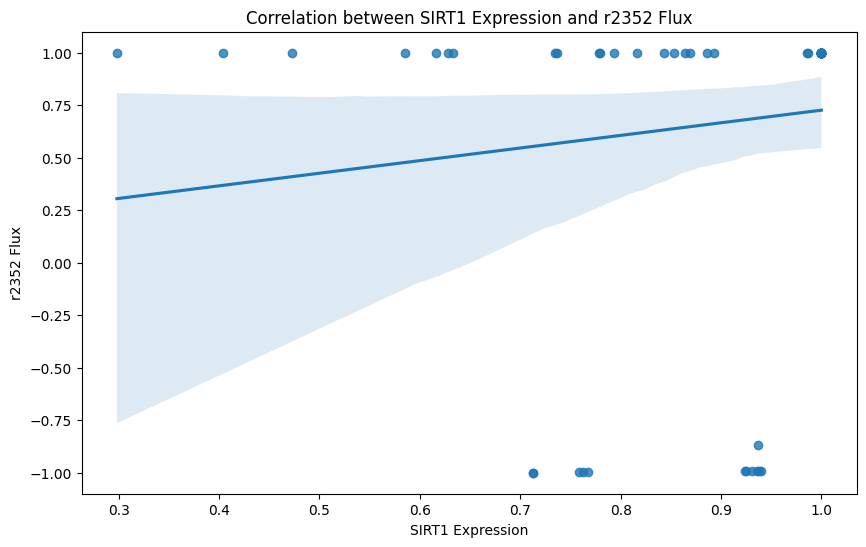

Linear regression results for SIRT1 and r2352:
Slope: 0.600549065713996
Intercept: 0.12589506888393565
R-squared: 0.016122787926120544
P-value: 0.29133287688807896
Standard error: 0.5647735256210124



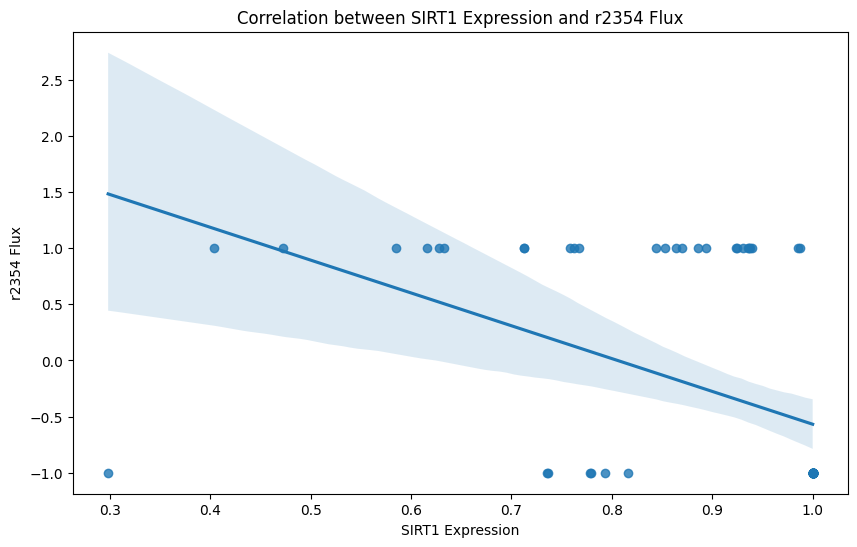

Linear regression results for SIRT1 and r2354:
Slope: -2.922475607193333
Intercept: 2.354284639309764
R-squared: 0.2274487004663085
P-value: 2.613412337973008e-05
Standard error: 0.6484078788908523



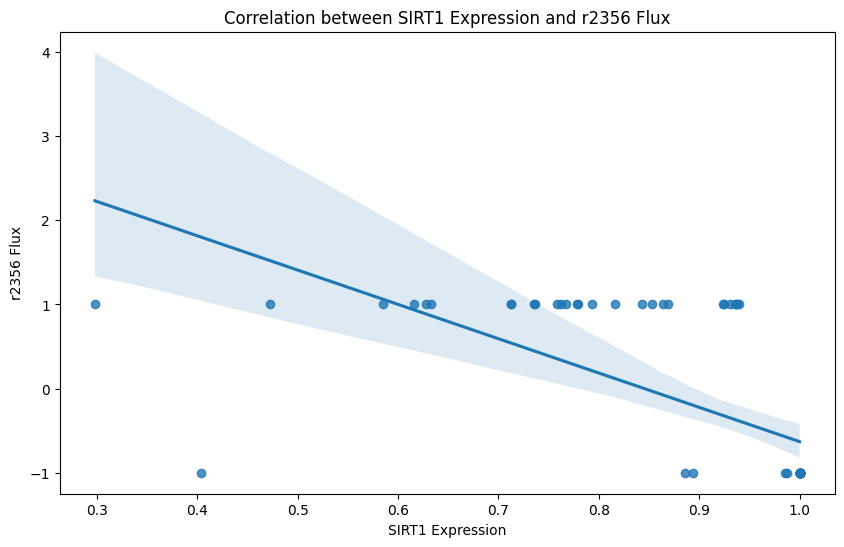

Linear regression results for SIRT1 and r2356:
Slope: -4.077300827527717
Intercept: 3.4466706690043263
R-squared: 0.43021599739741223
P-value: 5.349809747638494e-10
Standard error: 0.5648850201893018



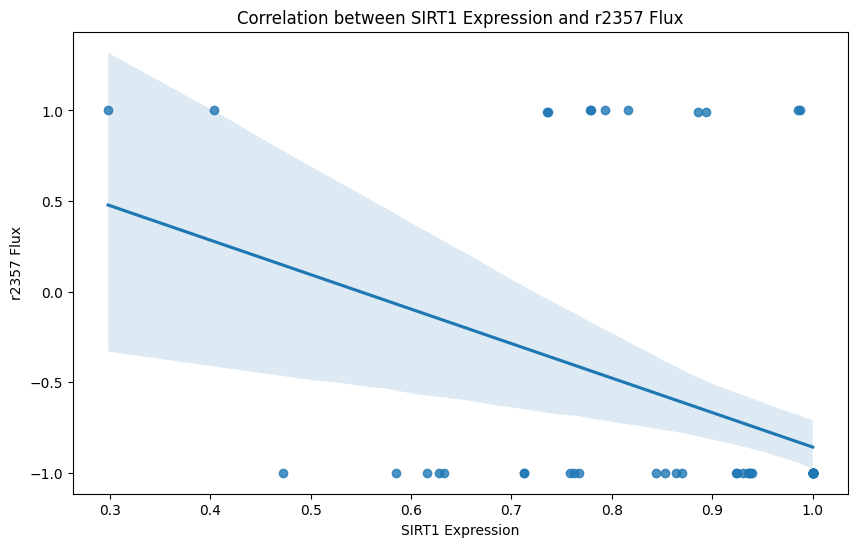

Linear regression results for SIRT1 and r2357:
Slope: -1.904473627617494
Intercept: 1.0460576171165545
R-squared: 0.16015118526090405
P-value: 0.0005443883433058694
Standard error: 0.5250321475927106



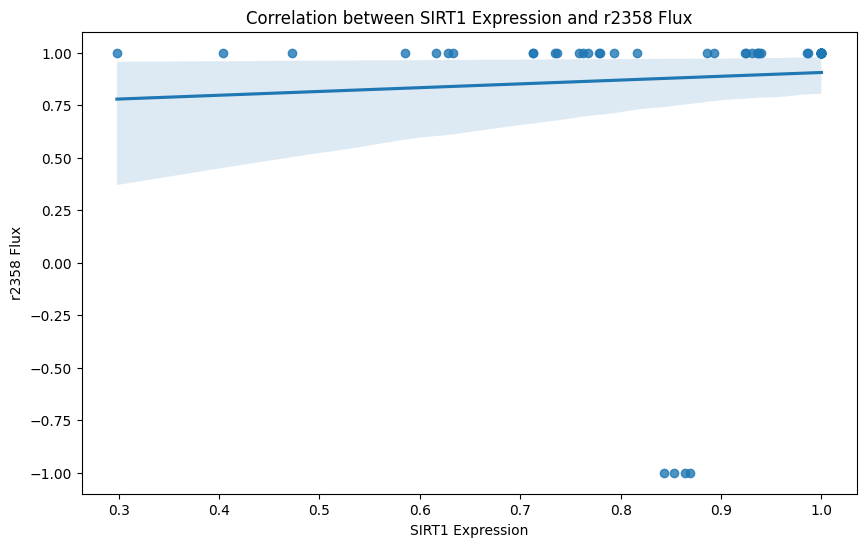

Linear regression results for SIRT1 and r2358:
Slope: 0.1807145376690292
Intercept: 0.7251964352720891
R-squared: 0.003796810480014604
P-value: 0.6097191848672443
Standard error: 0.3523976874395404



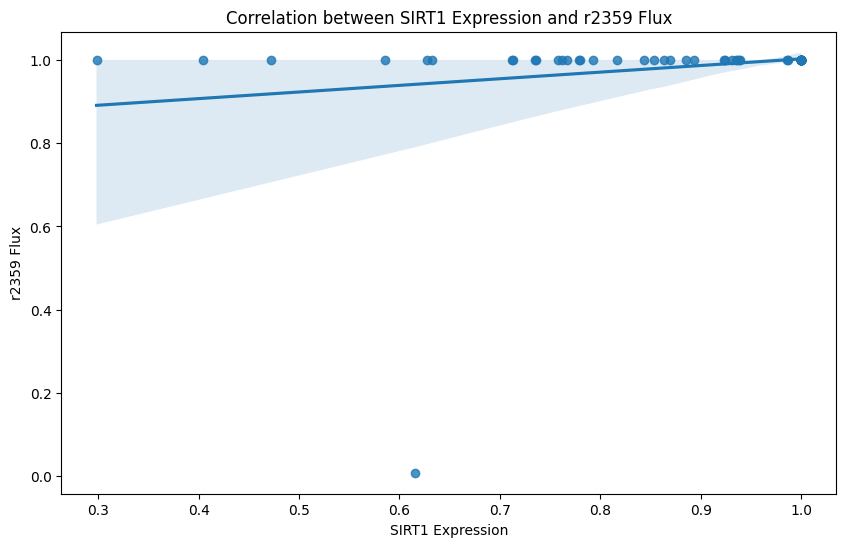

Linear regression results for SIRT1 and r2359:
Slope: 0.1590311173021812
Intercept: 0.8433568732100636
R-squared: 0.045777985204467665
P-value: 0.07318891836043281
Standard error: 0.08740855556538092



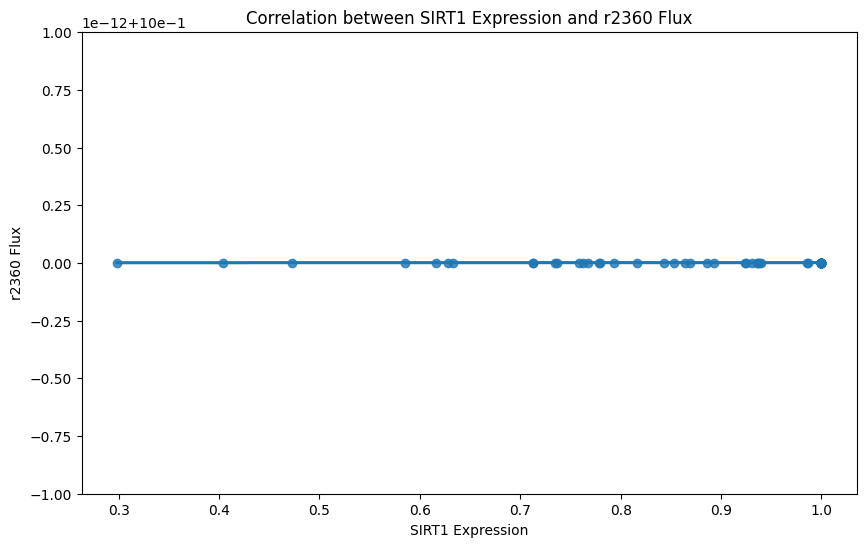

Linear regression results for SIRT1 and r2360:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



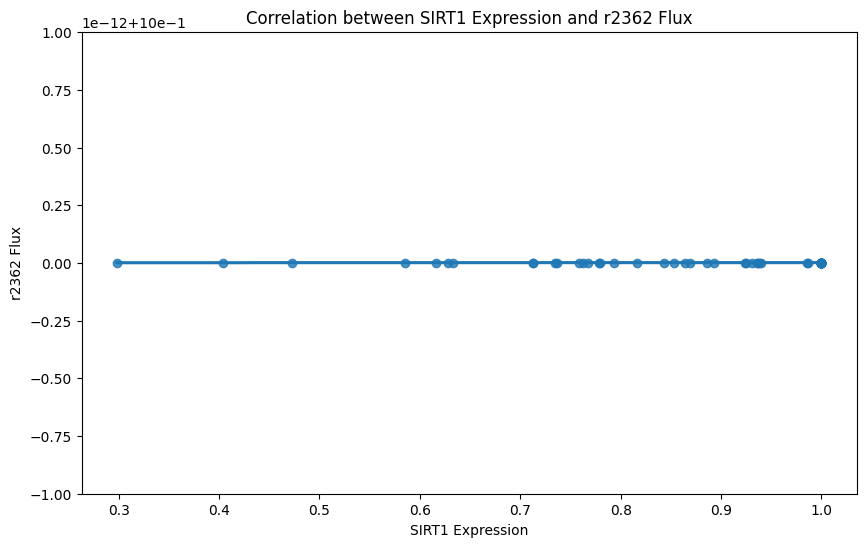

Linear regression results for SIRT1 and r2362:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



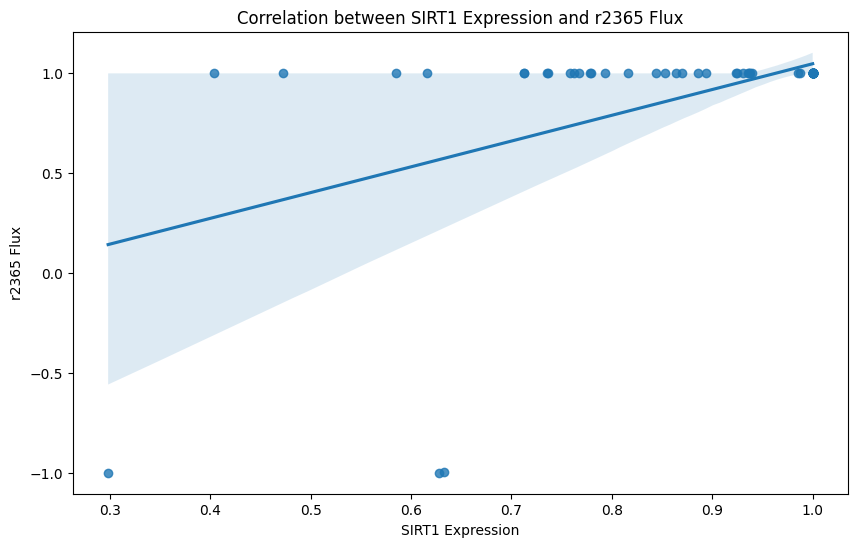

Linear regression results for SIRT1 and r2365:
Slope: 1.290498243038392
Intercept: -0.24224994363767616
R-squared: 0.254504958780943
P-value: 7.261654256490221e-06
Standard error: 0.26589313676605175



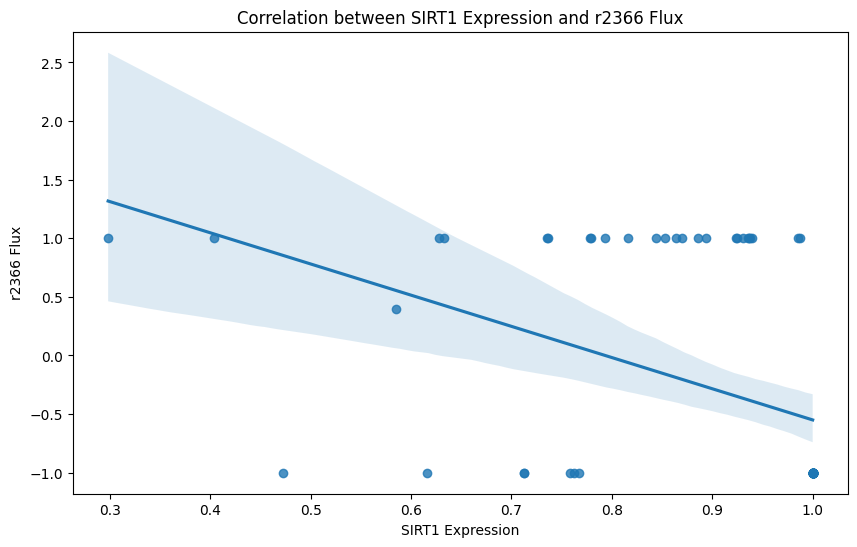

Linear regression results for SIRT1 and r2366:
Slope: -2.660660029283351
Intercept: 2.1109070993564876
R-squared: 0.19192805063205925
P-value: 0.00013292046697204601
Standard error: 0.6572349189451785



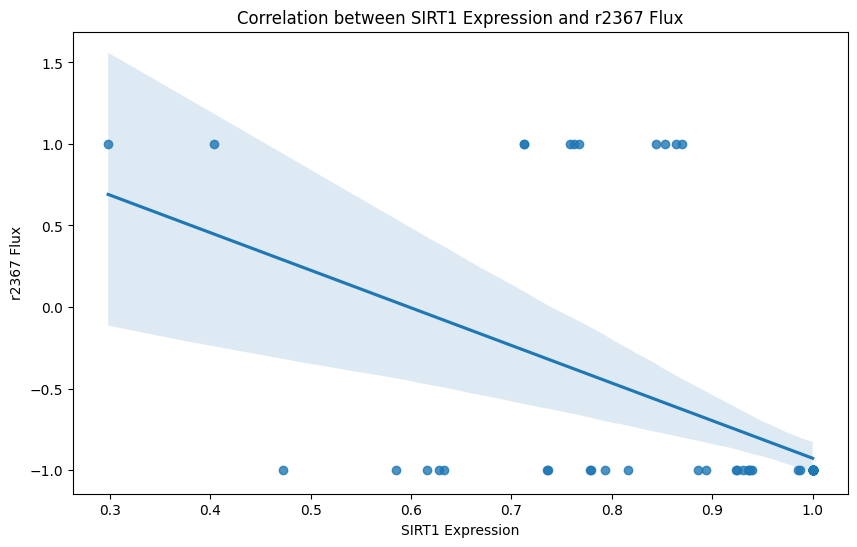

Linear regression results for SIRT1 and r2367:
Slope: -2.3054045253737656
Intercept: 1.378145947739525
R-squared: 0.25090994703087705
P-value: 8.628090233876594e-06
Standard error: 0.4795464404363228



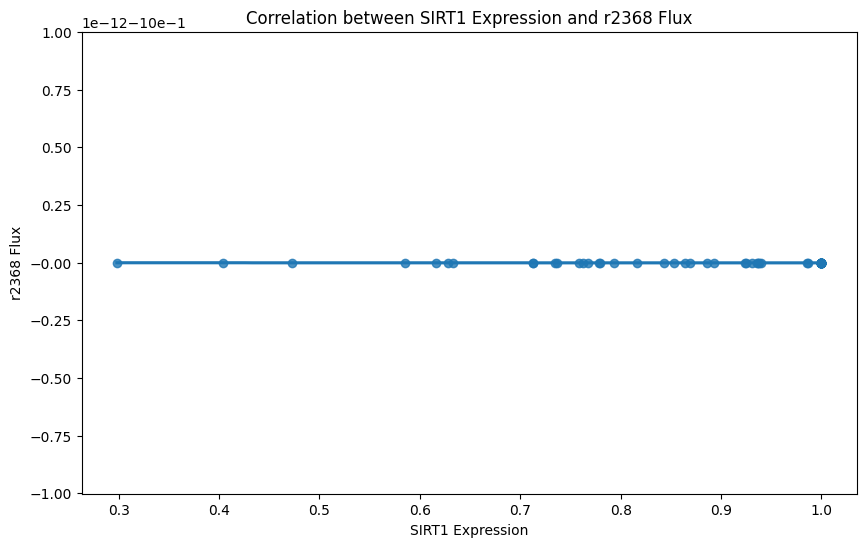

Linear regression results for SIRT1 and r2368:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



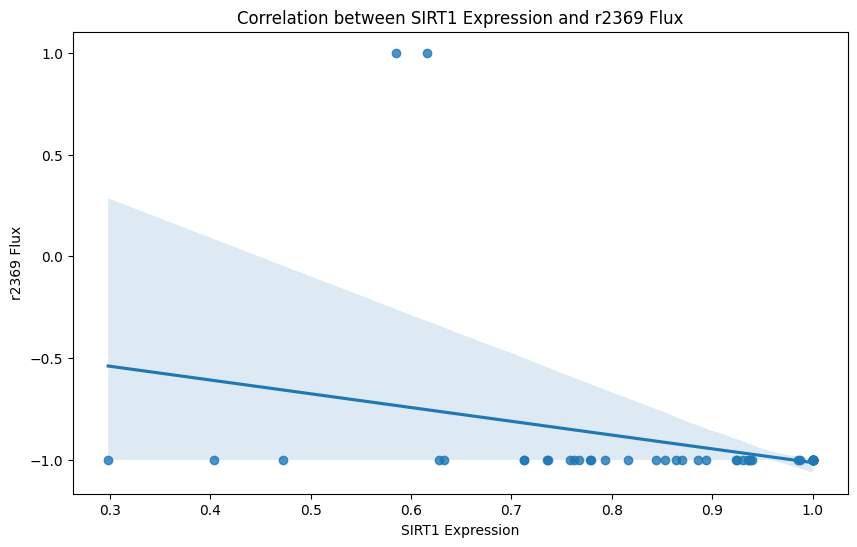

Linear regression results for SIRT1 and r2369:
Slope: -0.6760983072796725
Intercept: -0.33710239228778305
R-squared: 0.1032067595593936
P-value: 0.006300115862973335
Standard error: 0.23992604500449824



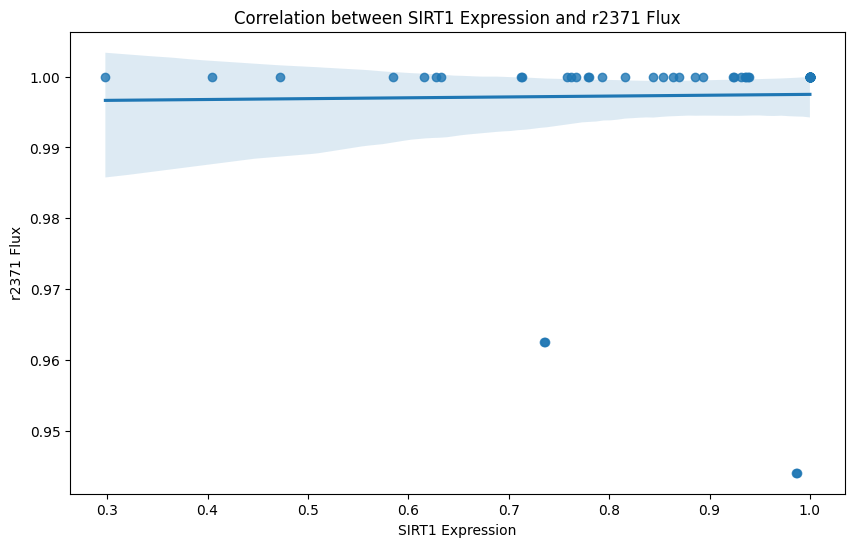

Linear regression results for SIRT1 and r2371:
Slope: 0.001210354009092544
Intercept: 0.996282780630073
R-squared: 0.0002998639004584974
P-value: 0.8860273060365621
Standard error: 0.00841318909865844



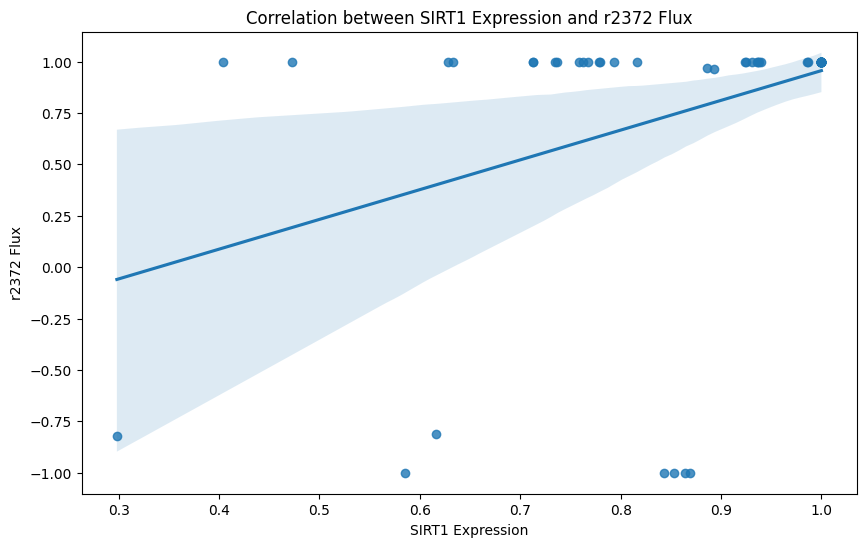

Linear regression results for SIRT1 and r2372:
Slope: 1.447561829064304
Intercept: -0.49156783647868696
R-squared: 0.1535747049277305
P-value: 0.0007255236662504714
Standard error: 0.40911655084525045



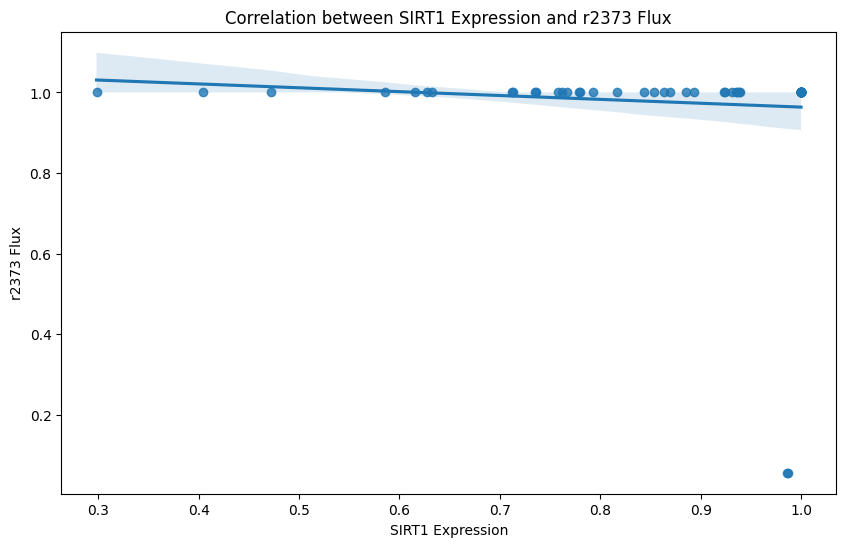

Linear regression results for SIRT1 and r2373:
Slope: -0.09595798256975992
Intercept: 1.059495285977902
R-squared: 0.009330716080545162
P-value: 0.4229241568070826
Standard error: 0.11903191616416962



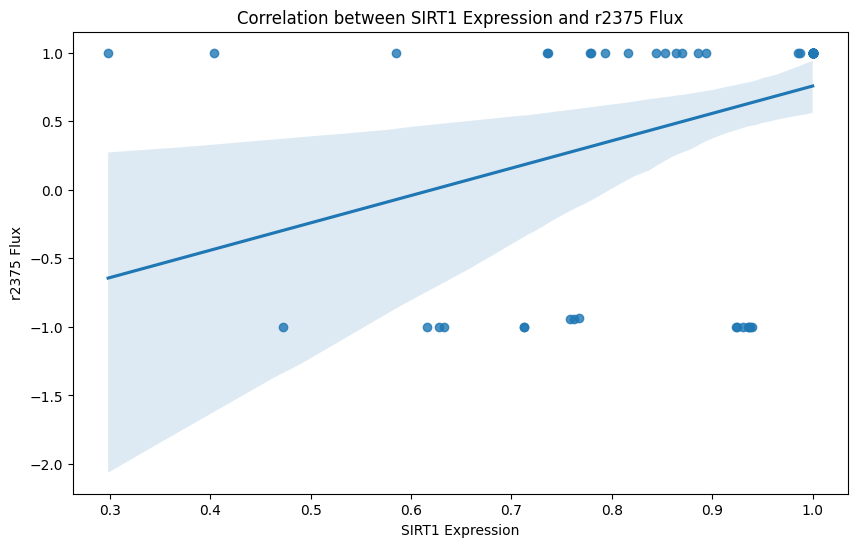

Linear regression results for SIRT1 and r2375:
Slope: 1.9964792355832182
Intercept: -1.2392498851688605
R-squared: 0.14273766493574735
P-value: 0.0011612255102040785
Standard error: 0.5890170005475779



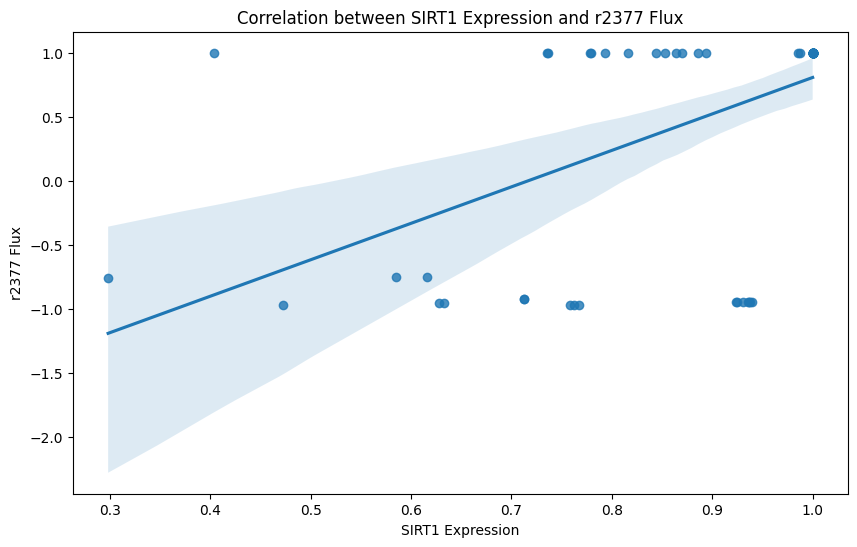

Linear regression results for SIRT1 and r2377:
Slope: 2.843654608984653
Intercept: -2.0366021028234256
R-squared: 0.2875793719960456
P-value: 1.4352485633727529e-06
Standard error: 0.5388174817623311



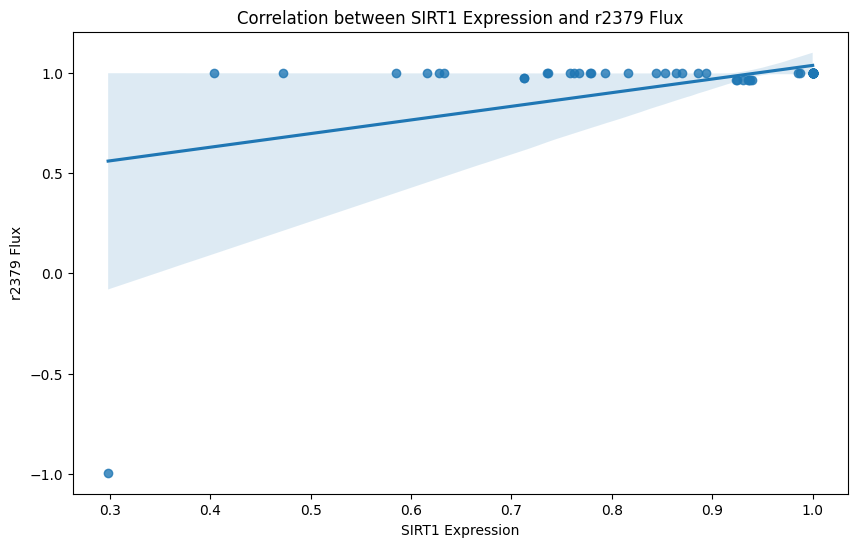

Linear regression results for SIRT1 and r2379:
Slope: 0.680407213551971
Intercept: 0.35730595017711275
R-squared: 0.20752102502341294
P-value: 6.555368546948463e-05
Standard error: 0.16006898328043165



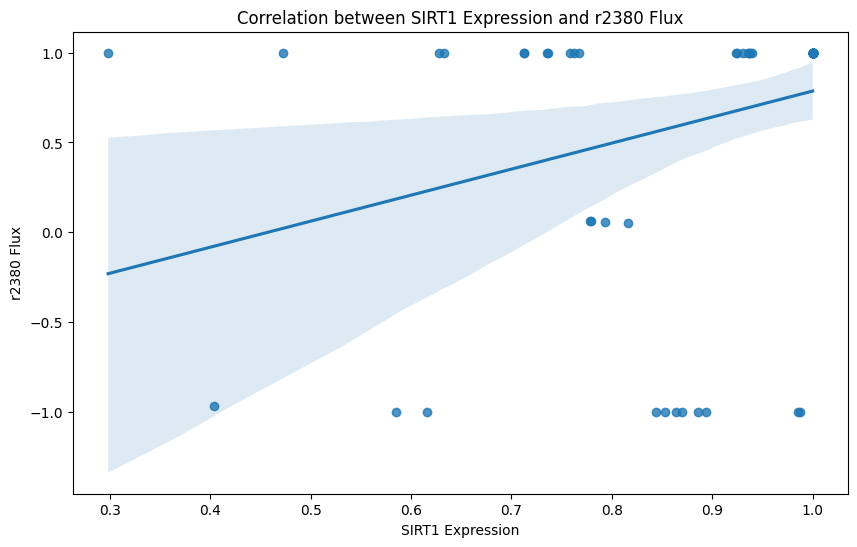

Linear regression results for SIRT1 and r2380:
Slope: 1.4505057626982831
Intercept: -0.6638655275883957
R-squared: 0.09692361609189909
P-value: 0.008223853348264226
Standard error: 0.5330185843153845



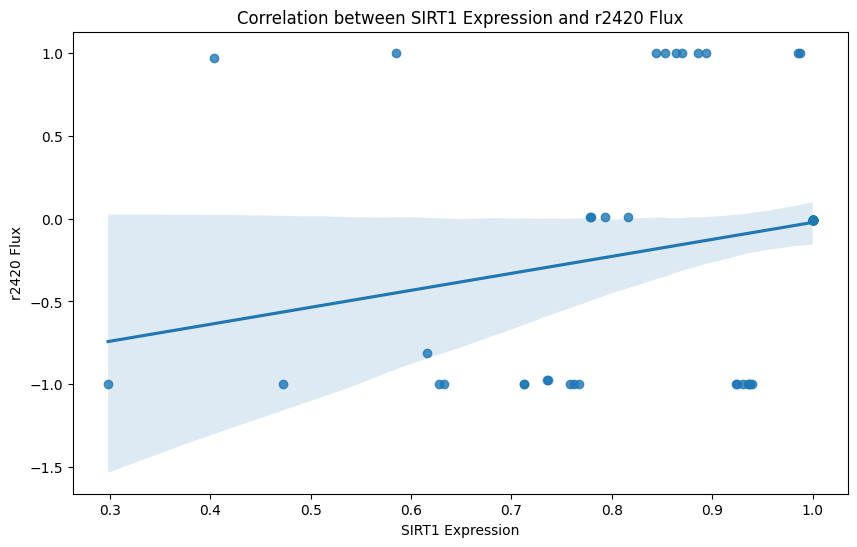

Linear regression results for SIRT1 and r2420:
Slope: 1.0238220220759806
Intercept: -1.0470505893140218
R-squared: 0.06730733172049314
P-value: 0.02890307019692455
Standard error: 0.4588154311058123



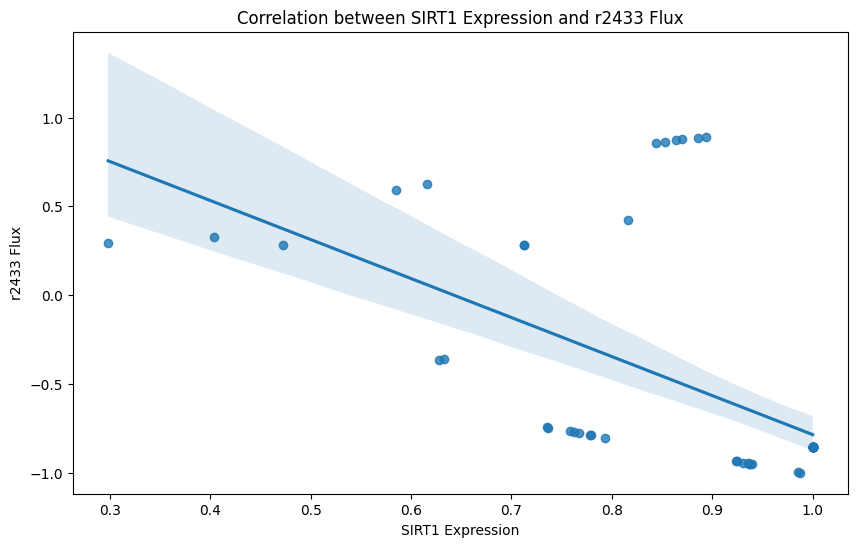

Linear regression results for SIRT1 and r2433:
Slope: -2.196634775174884
Intercept: 1.411234722440124
R-squared: 0.33990691366755066
P-value: 9.560104247768623e-08
Standard error: 0.3685156213242103



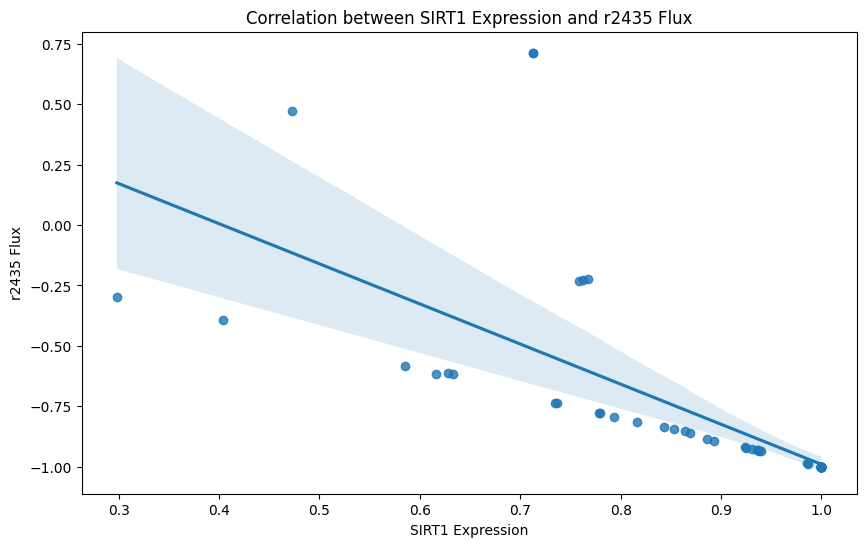

Linear regression results for SIRT1 and r2435:
Slope: -1.6594597101095032
Intercept: 0.669309734635148
R-squared: 0.5111572769356041
P-value: 2.4964930026496398e-12
Standard error: 0.19536621862861825



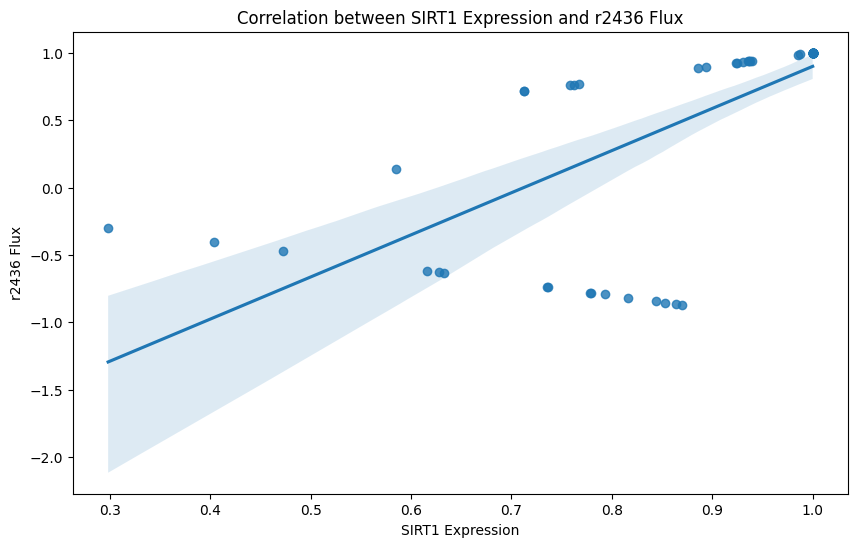

Linear regression results for SIRT1 and r2436:
Slope: 3.1242033169752386
Intercept: -2.2252578664650304
R-squared: 0.49108525424709965
P-value: 1.0197371145099408e-11
Standard error: 0.3828765907692125



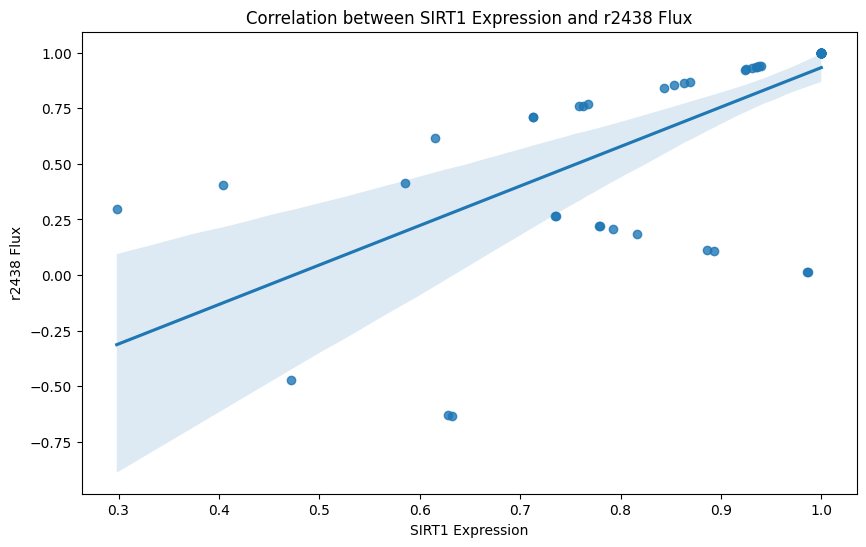

Linear regression results for SIRT1 and r2438:
Slope: 1.7758381833903647
Intercept: -0.8427467079140462
R-squared: 0.4626320821687718
P-value: 6.852605857530607e-11
Standard error: 0.2304076202532



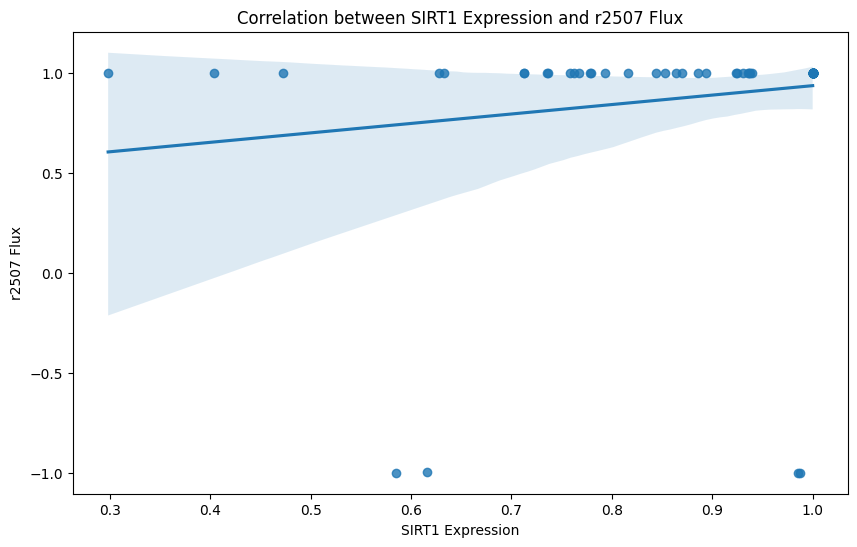

Linear regression results for SIRT1 and r2507:
Slope: 0.4725230143439726
Intercept: 0.46342650322913403
R-squared: 0.025970042988279846
P-value: 0.17940664529226596
Standard error: 0.3483760119233376



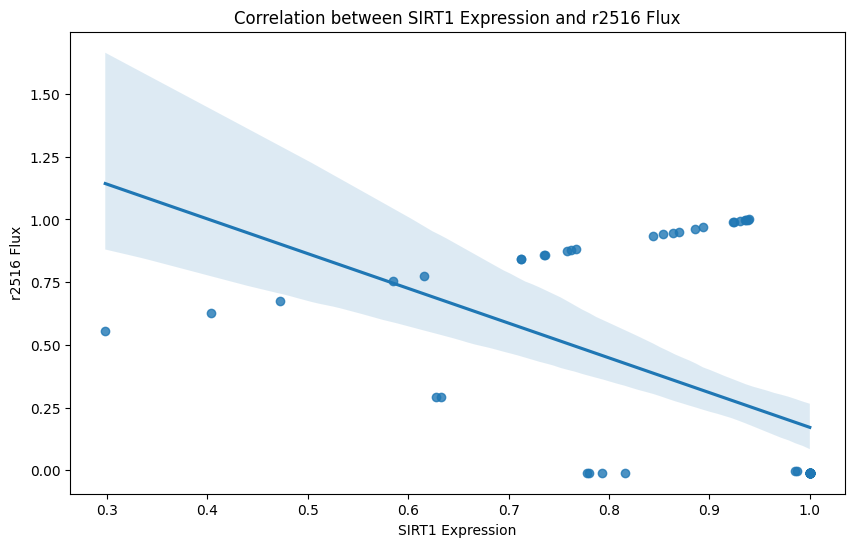

Linear regression results for SIRT1 and r2516:
Slope: -1.3851179967630336
Intercept: 1.5561068875292727
R-squared: 0.2575320180264457
P-value: 6.276883069665291e-06
Standard error: 0.2831297309099621



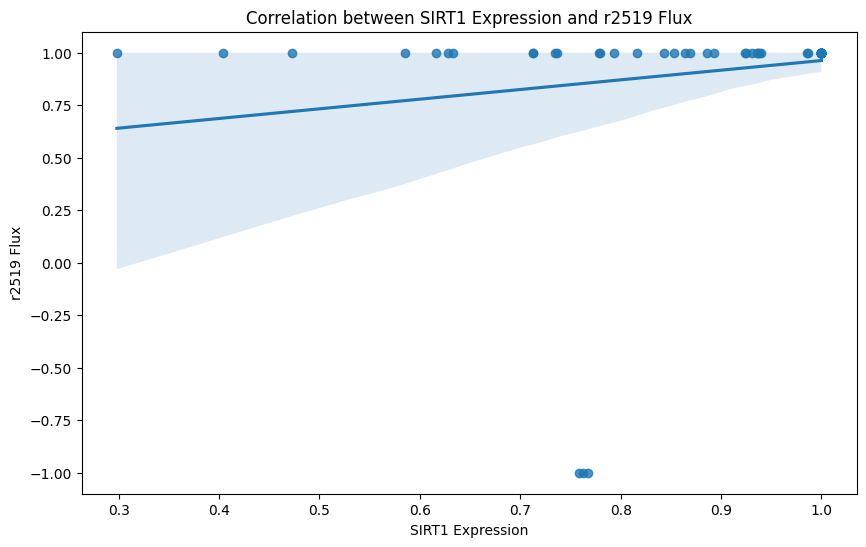

Linear regression results for SIRT1 and r2519:
Slope: 0.45995008266419085
Intercept: 0.502850024821238
R-squared: 0.03231162551216465
P-value: 0.13361448303205317
Standard error: 0.30302224700012176



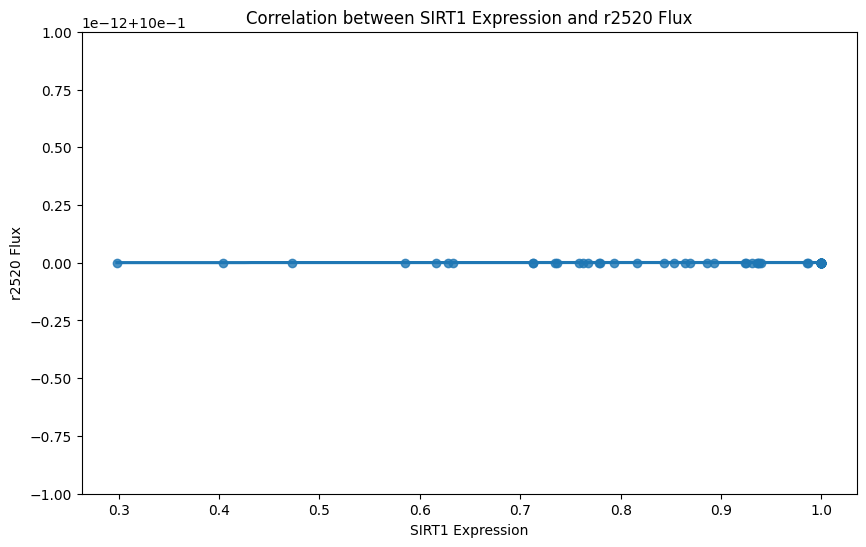

Linear regression results for SIRT1 and r2520:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



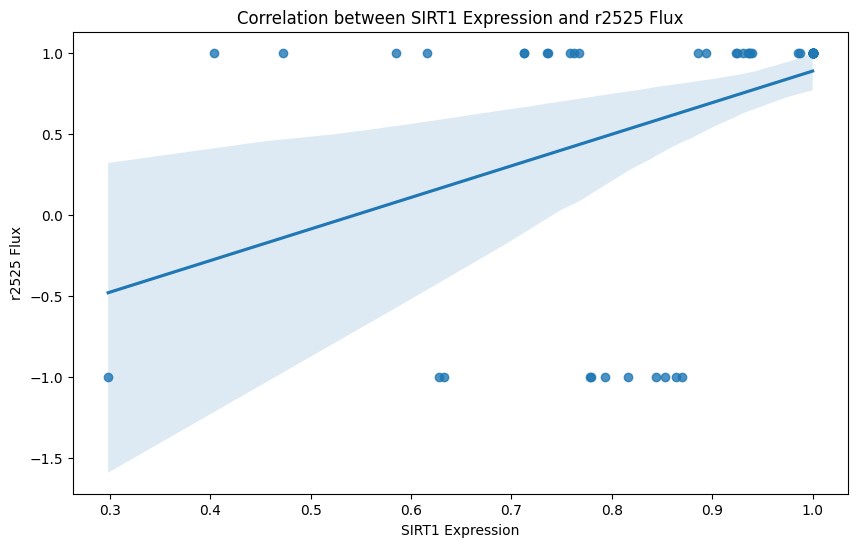

Linear regression results for SIRT1 and r2525:
Slope: 1.9515743403015762
Intercept: -1.0607082526939402
R-squared: 0.1798017004442675
P-value: 0.00022869061794710875
Standard error: 0.501791255589146



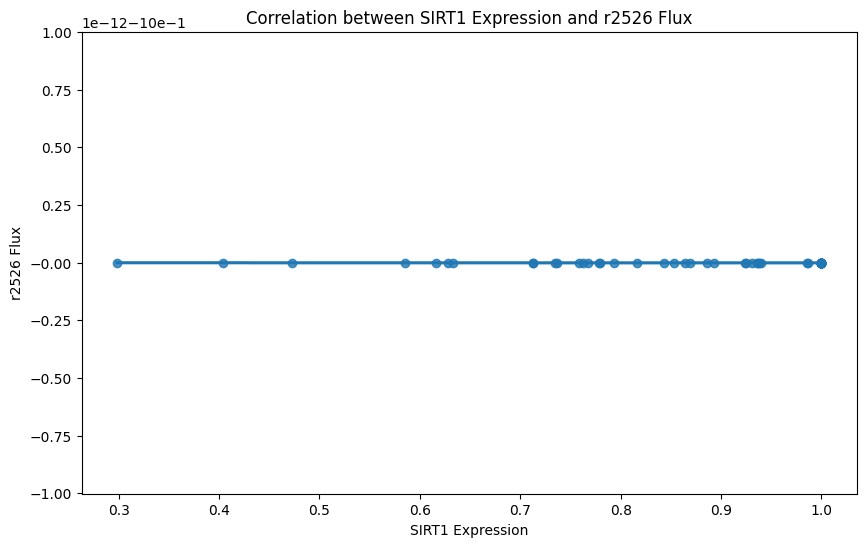

Linear regression results for SIRT1 and r2526:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



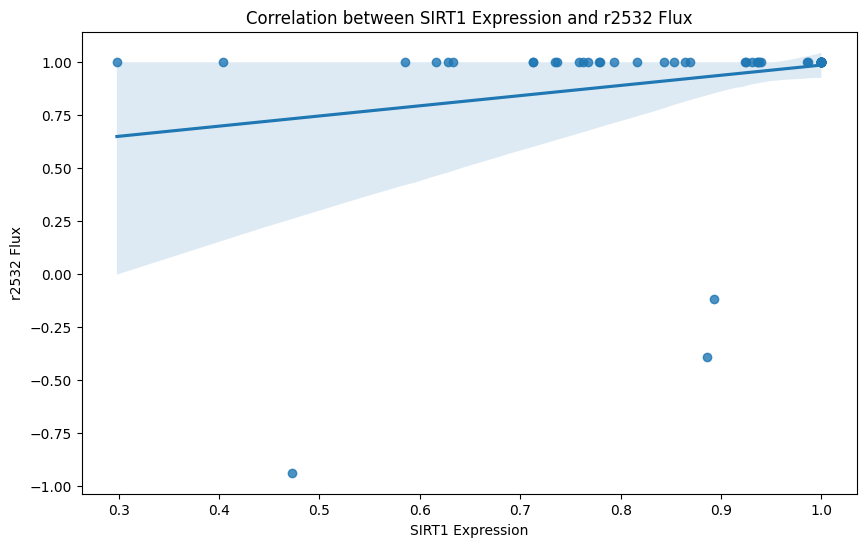

Linear regression results for SIRT1 and r2532:
Slope: 0.48064478598001215
Intercept: 0.5061551136048386
R-squared: 0.06085384661276679
P-value: 0.03809010422492556
Standard error: 0.22731194831431767



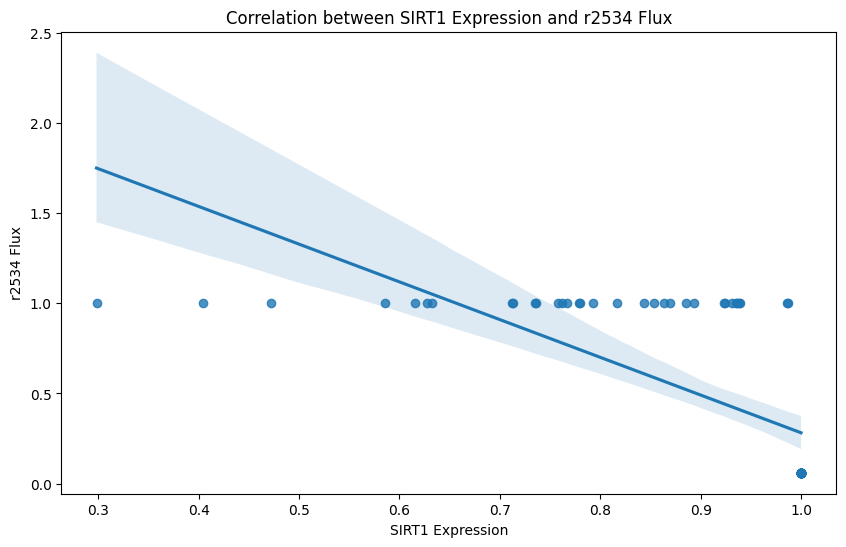

Linear regression results for SIRT1 and r2534:
Slope: -2.09295151673825
Intercept: 2.374586618320524
R-squared: 0.4927114051469564
P-value: 9.117085759106935e-12
Standard error: 0.2556618128962224



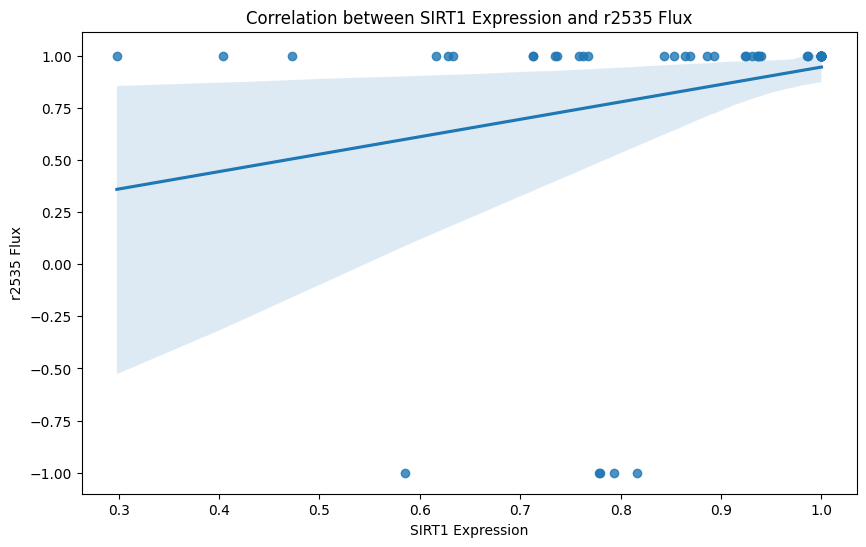

Linear regression results for SIRT1 and r2535:
Slope: 0.8355096815319135
Intercept: 0.10957991115542154
R-squared: 0.06591079729296341
P-value: 0.030678261229705107
Standard error: 0.3786542491840791



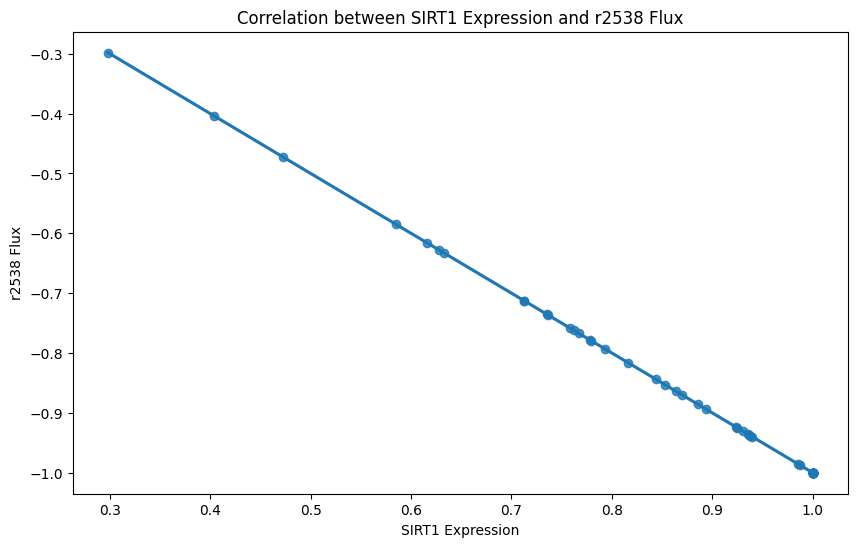

Linear regression results for SIRT1 and r2538:
Slope: -1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



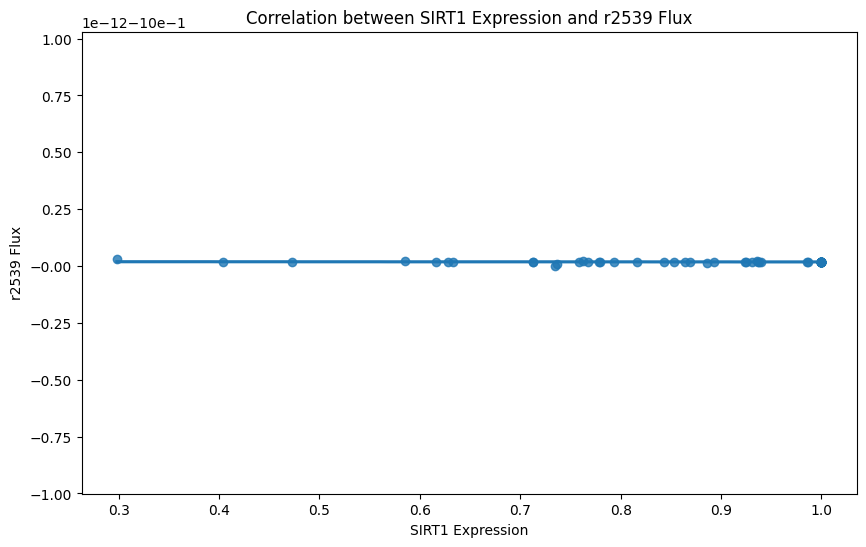

Linear regression results for SIRT1 and r2539:
Slope: -1.6204385598653227e-15
Intercept: -0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



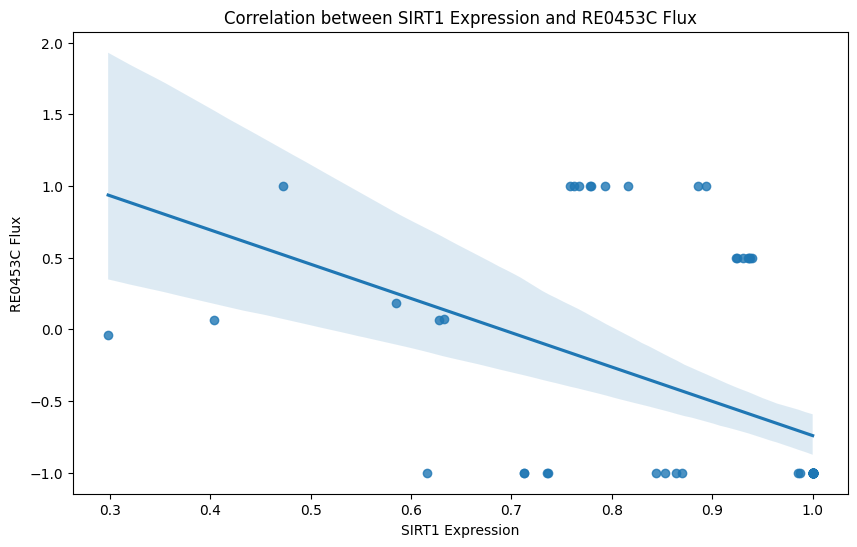

Linear regression results for SIRT1 and RE0453C:
Slope: -2.391329269932871
Intercept: 1.6502627709979967
R-squared: 0.23131775057849324
P-value: 2.181172604434874e-05
Standard error: 0.5247878604652678



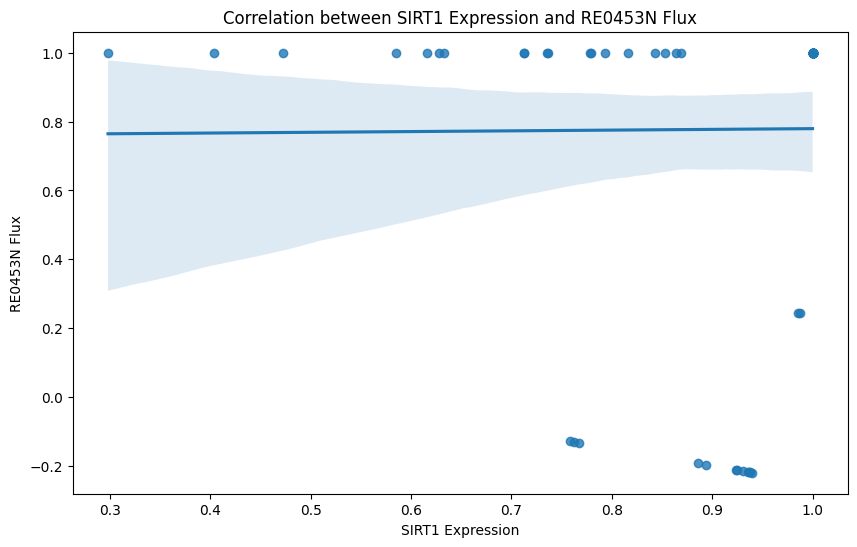

Linear regression results for SIRT1 and RE0453N:
Slope: 0.021244047369345744
Intercept: 0.758245550770645
R-squared: 5.398349120463461e-05
P-value: 0.9515091413528265
Standard error: 0.3480731385179148



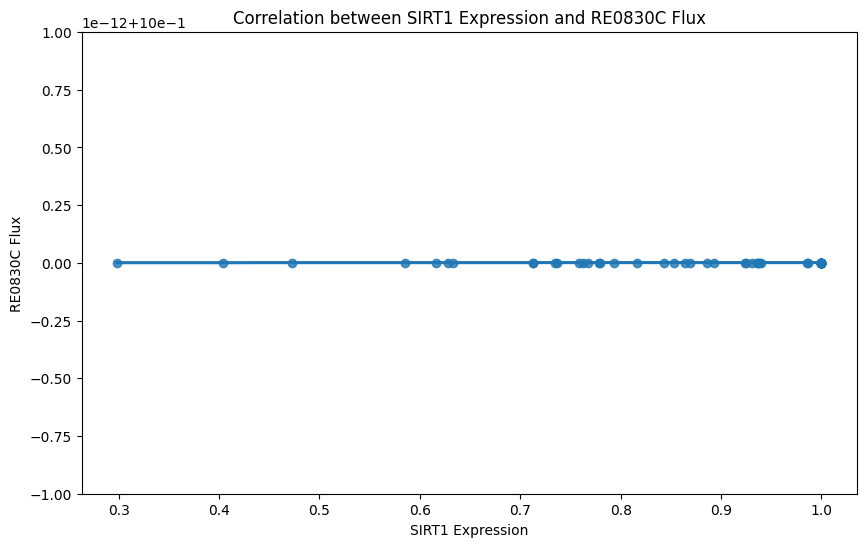

Linear regression results for SIRT1 and RE0830C:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



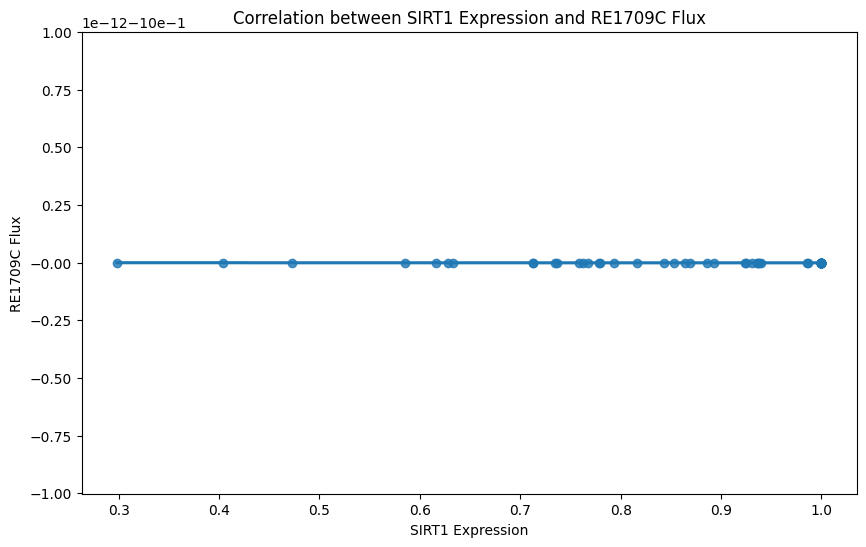

Linear regression results for SIRT1 and RE1709C:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



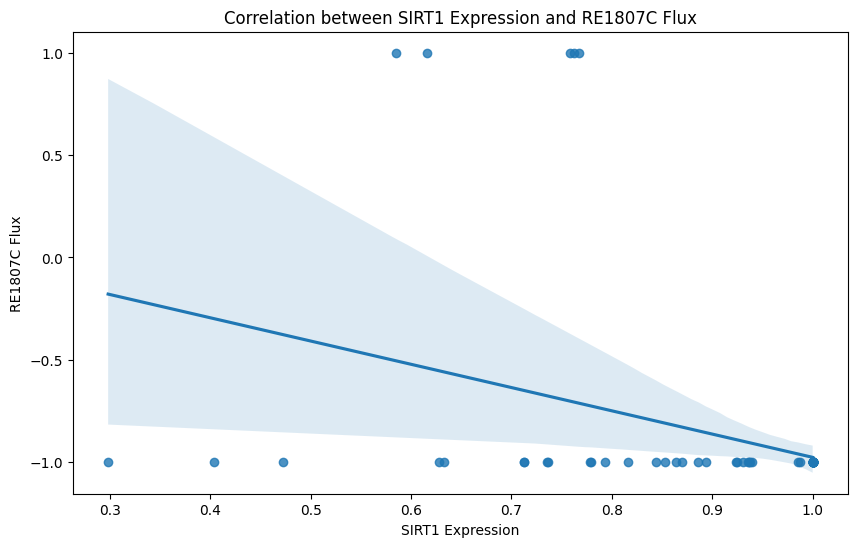

Linear regression results for SIRT1 and RE1807C:
Slope: -1.1360481190627199
Intercept: 0.16004725155517785
R-squared: 0.12185603582873214
P-value: 0.0028483438988375228
Standard error: 0.36713984399668026



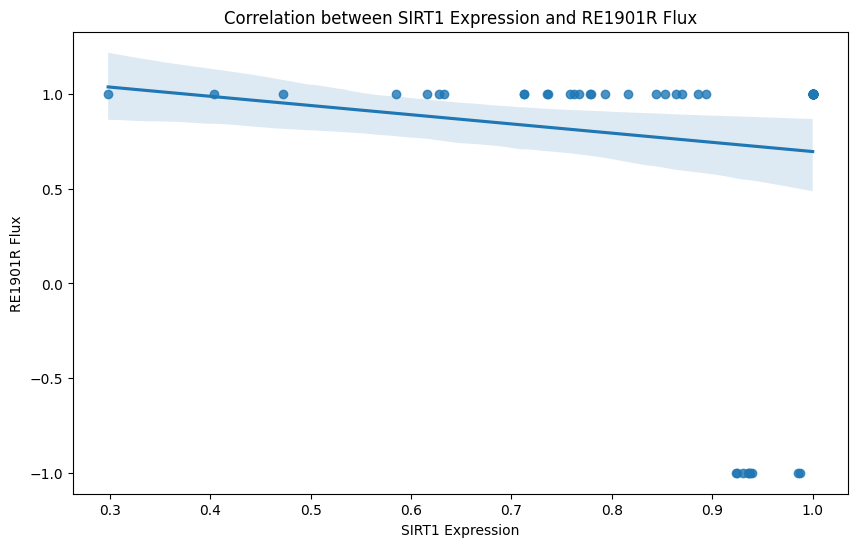

Linear regression results for SIRT1 and RE1901R:
Slope: -0.4863977695128302
Intercept: 1.1828491812106607
R-squared: 0.013210415642584539
P-value: 0.3398557454193144
Standard error: 0.5060822048723691



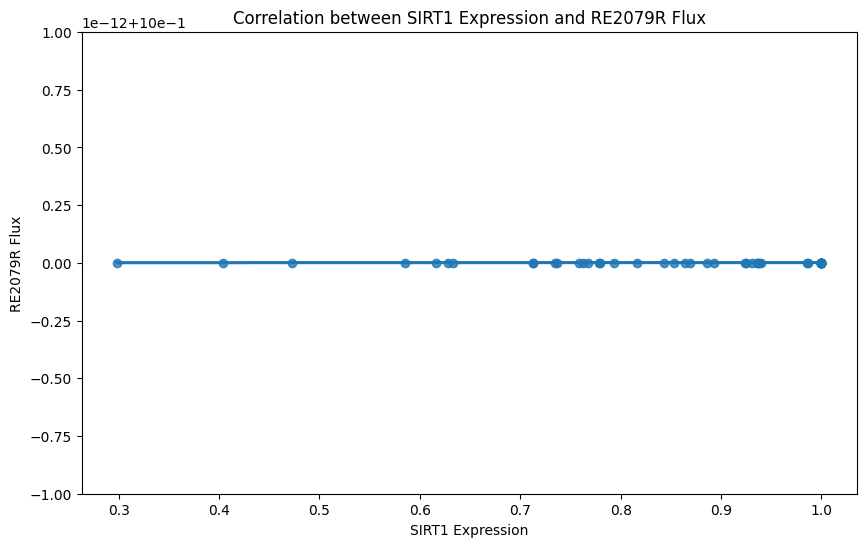

Linear regression results for SIRT1 and RE2079R:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



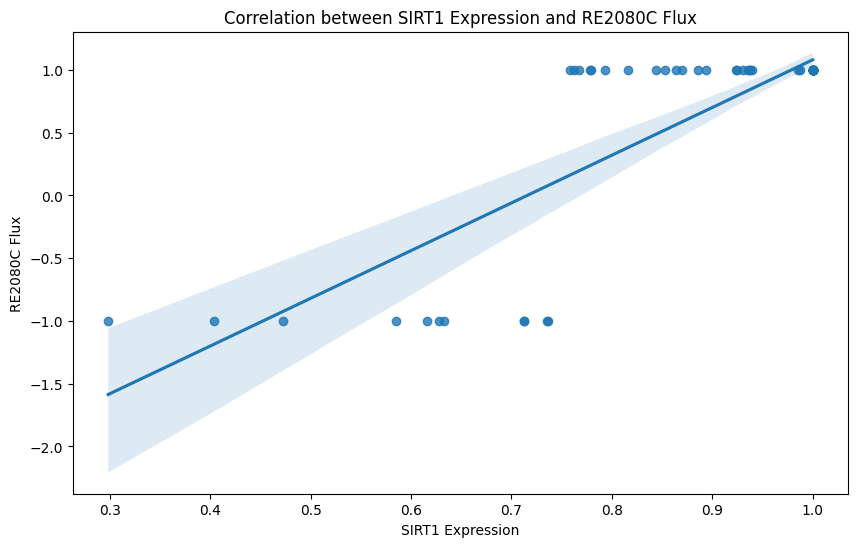

Linear regression results for SIRT1 and RE2080C:
Slope: 3.801524997037321
Intercept: -2.720385965895401
R-squared: 0.682243328047746
P-value: 7.645990058587114e-19
Standard error: 0.31232805429407384



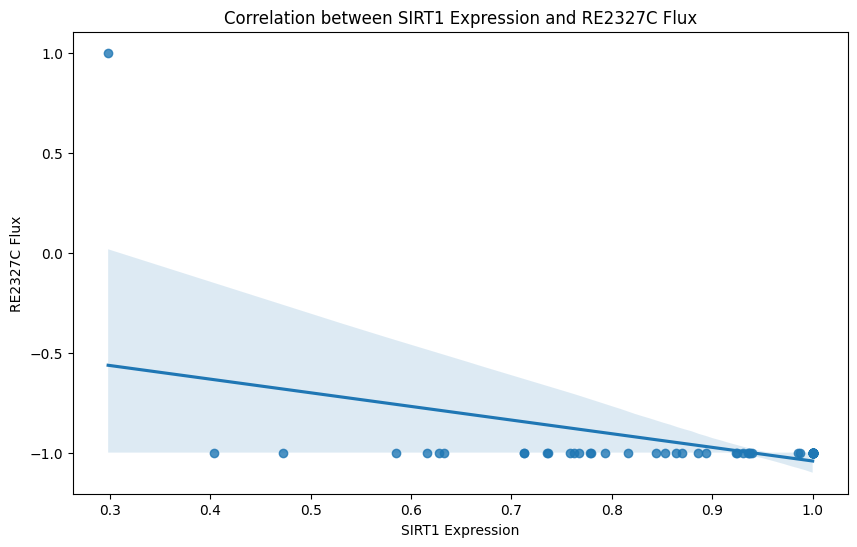

Linear regression results for SIRT1 and RE2327C:
Slope: -0.6823778850579137
Intercept: -0.3596377019008141
R-squared: 0.207261853969341
P-value: 6.63342755094393e-05
Standard error: 0.16065919521652594



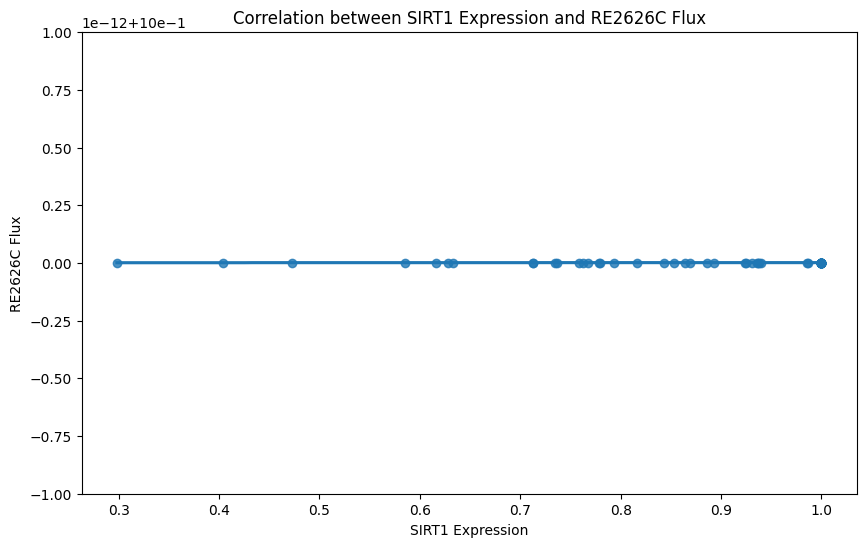

Linear regression results for SIRT1 and RE2626C:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



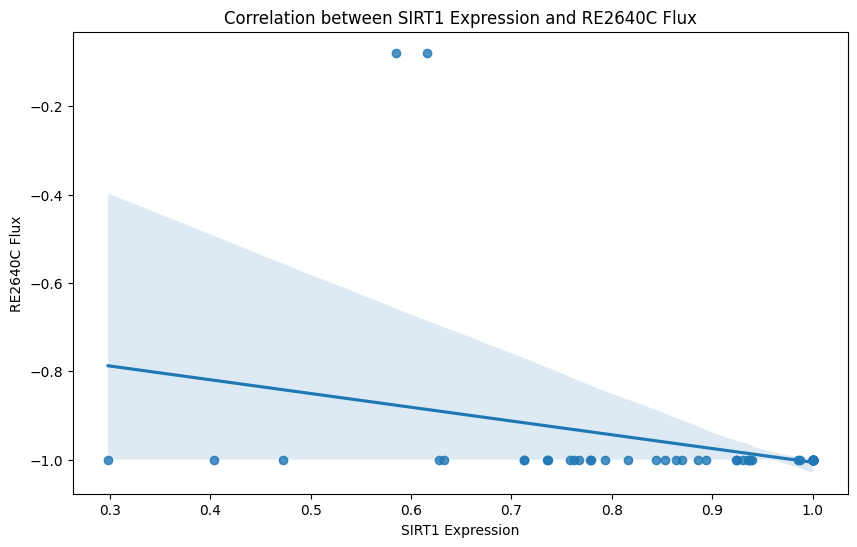

Linear regression results for SIRT1 and RE2640C:
Slope: -0.3114991030699578
Intercept: -0.6945828616841048
R-squared: 0.10320675955939364
P-value: 0.006300115862973329
Standard error: 0.1105412438062919



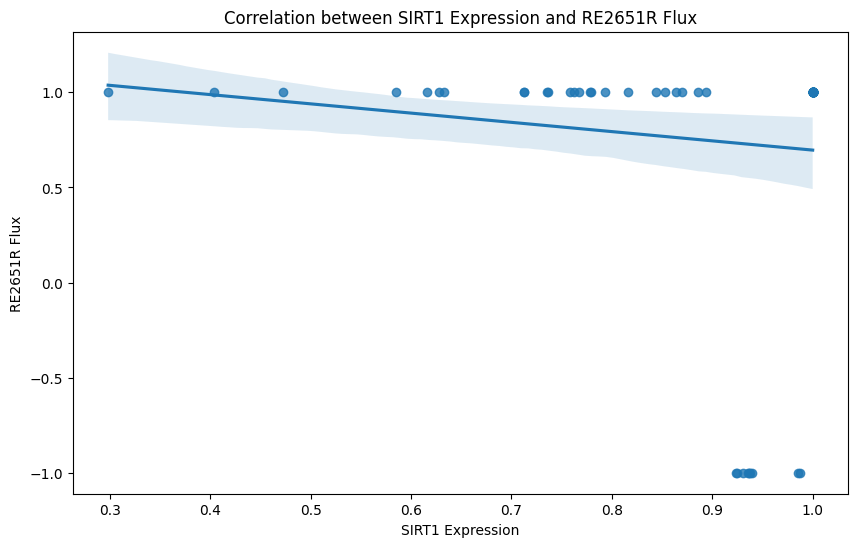

Linear regression results for SIRT1 and RE2651R:
Slope: -0.4863977695128302
Intercept: 1.1828491812106607
R-squared: 0.013210415642584539
P-value: 0.3398557454193144
Standard error: 0.5060822048723691



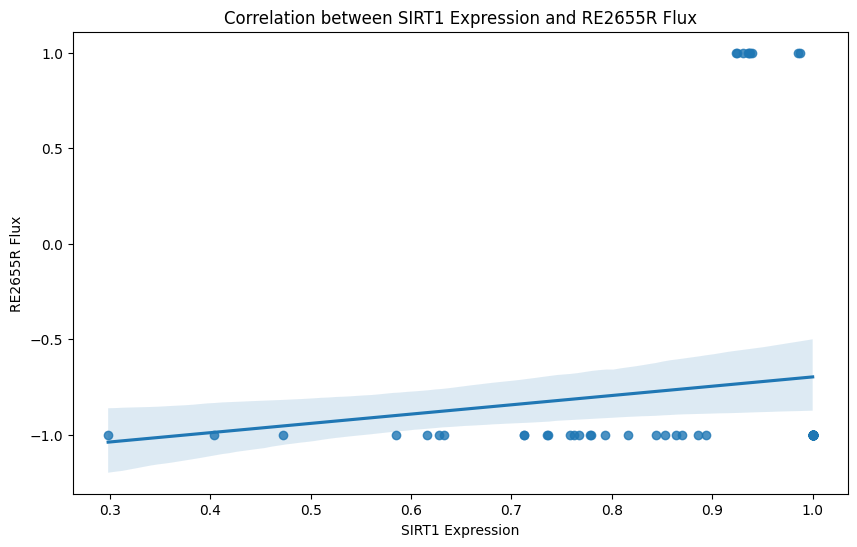

Linear regression results for SIRT1 and RE2655R:
Slope: 0.4863977695128302
Intercept: -1.1828491812106607
R-squared: 0.013210415642584539
P-value: 0.3398557454193144
Standard error: 0.5060822048723691



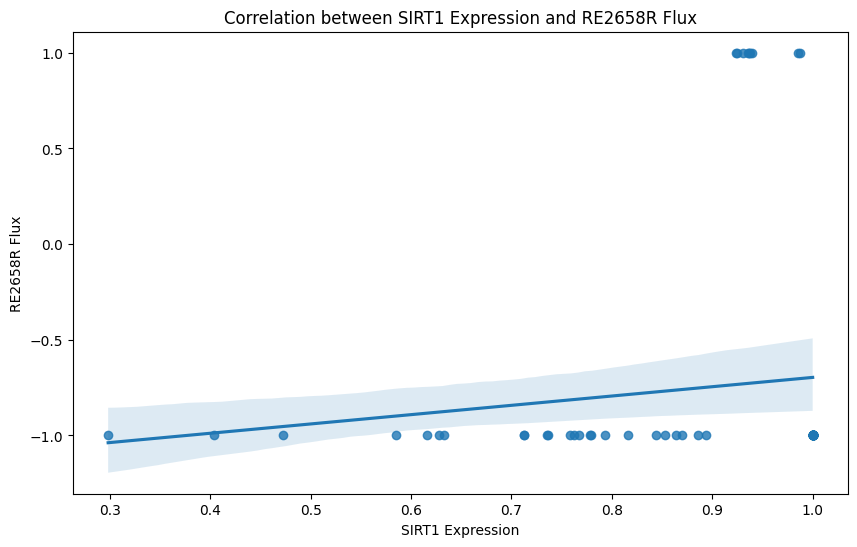

Linear regression results for SIRT1 and RE2658R:
Slope: 0.4863977695128302
Intercept: -1.1828491812106607
R-squared: 0.013210415642584539
P-value: 0.3398557454193144
Standard error: 0.5060822048723691



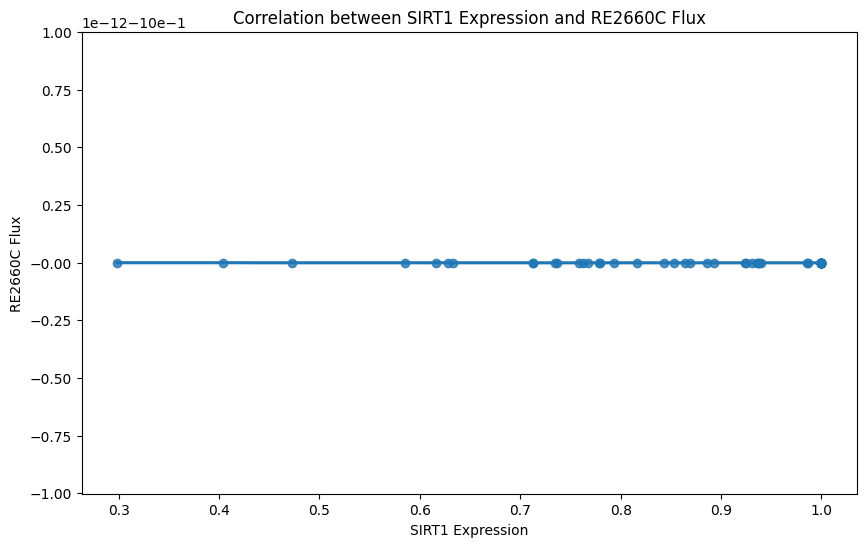

Linear regression results for SIRT1 and RE2660C:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



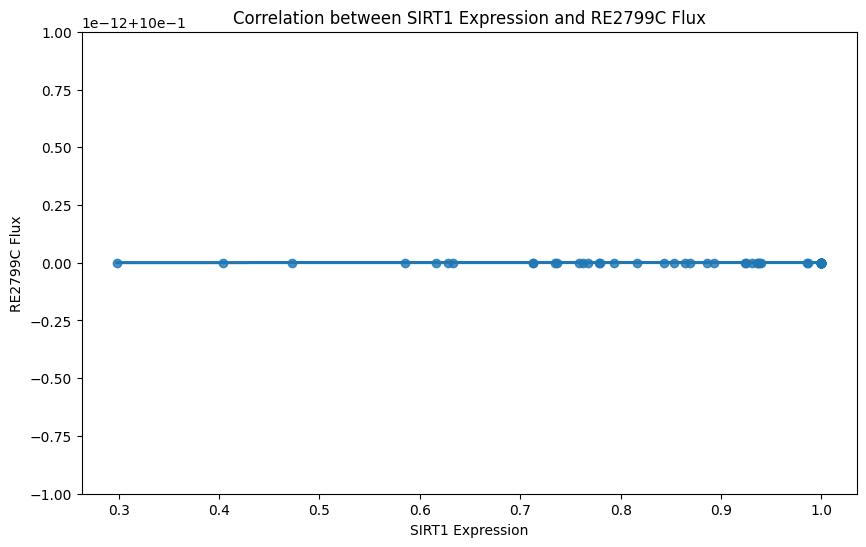

Linear regression results for SIRT1 and RE2799C:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



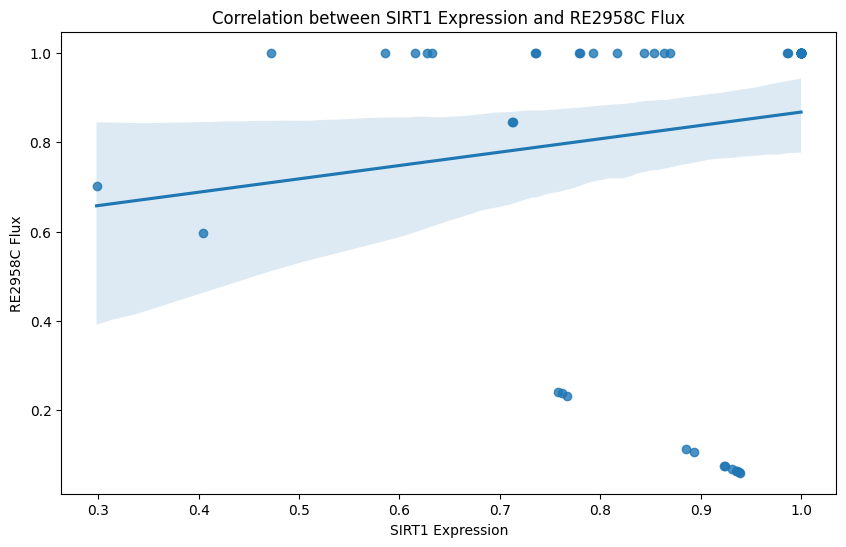

Linear regression results for SIRT1 and RE2958C:
Slope: 0.2988283087648997
Intercept: 0.5684001410179964
R-squared: 0.020048298828276342
P-value: 0.23885896032543352
Standard error: 0.2515131888983019



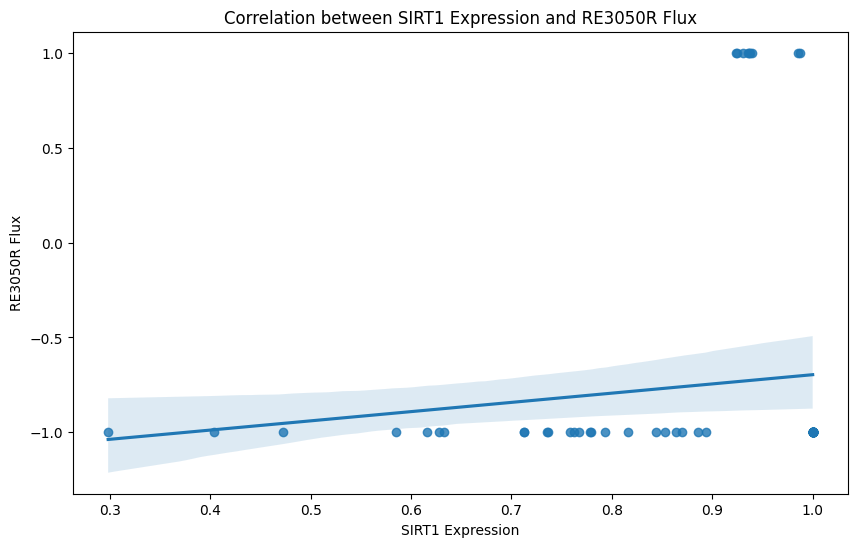

Linear regression results for SIRT1 and RE3050R:
Slope: 0.4863977695128302
Intercept: -1.1828491812106607
R-squared: 0.013210415642584539
P-value: 0.3398557454193144
Standard error: 0.5060822048723691



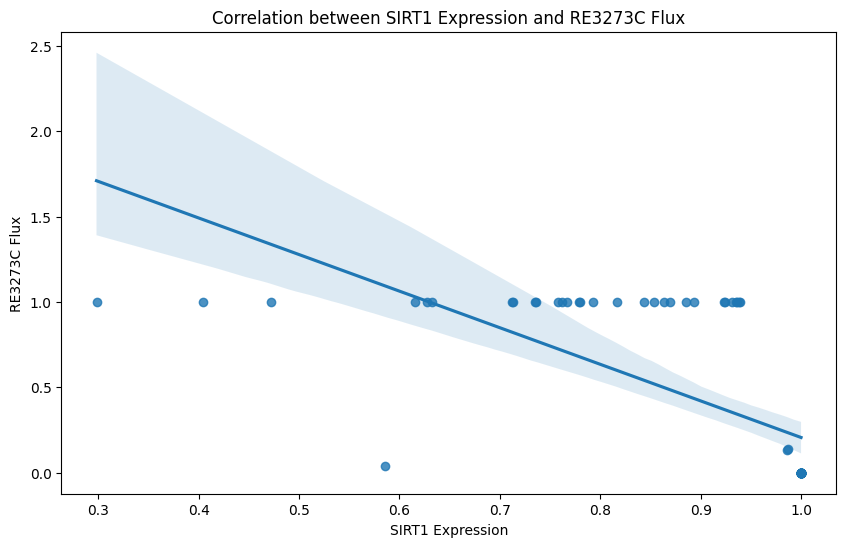

Linear regression results for SIRT1 and RE3273C:
Slope: -2.1433500605374802
Intercept: 2.3495329910315954
R-squared: 0.47149097883354996
P-value: 3.827375511932713e-11
Standard error: 0.27318576818410134



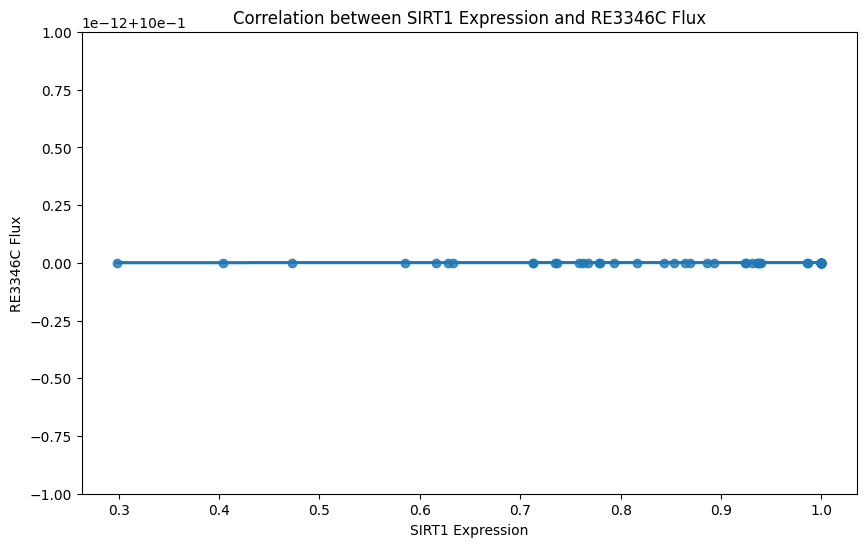

Linear regression results for SIRT1 and RE3346C:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



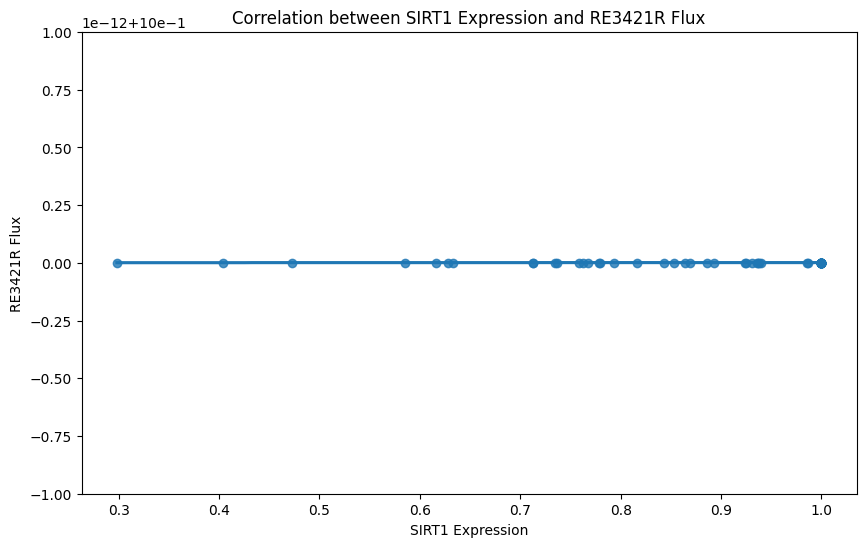

Linear regression results for SIRT1 and RE3421R:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



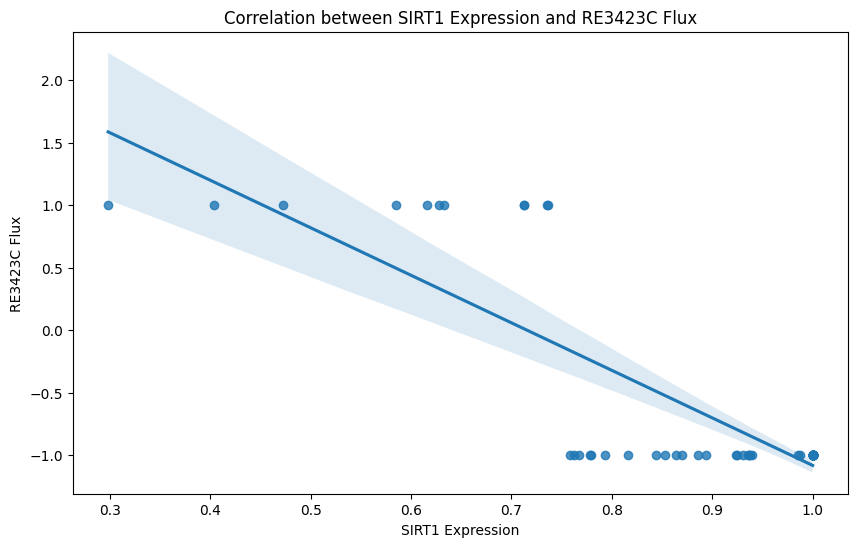

Linear regression results for SIRT1 and RE3423C:
Slope: -3.801524997037321
Intercept: 2.720385965895401
R-squared: 0.682243328047746
P-value: 7.645990058587114e-19
Standard error: 0.31232805429407384



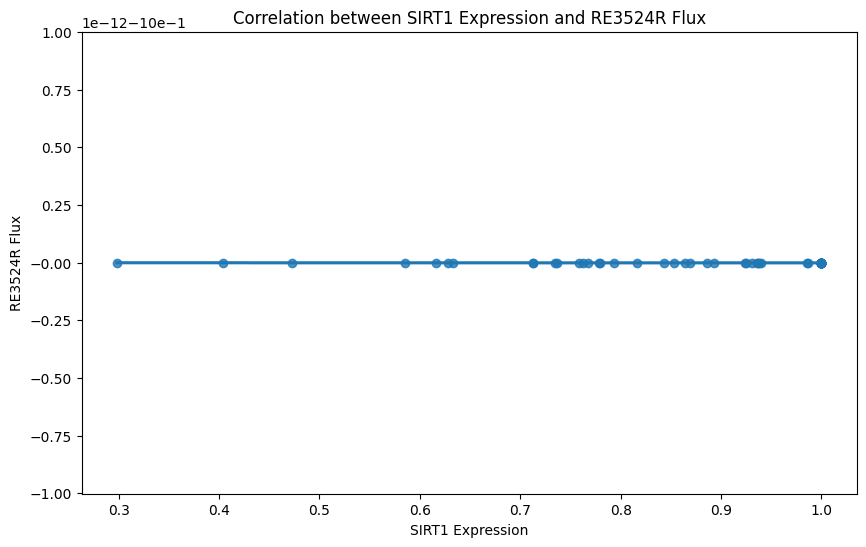

Linear regression results for SIRT1 and RE3524R:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



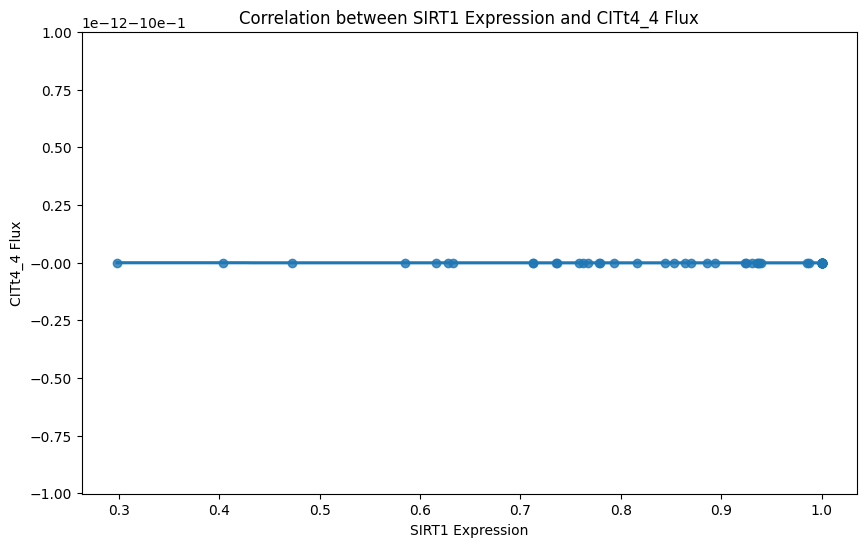

Linear regression results for SIRT1 and CITt4_4:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



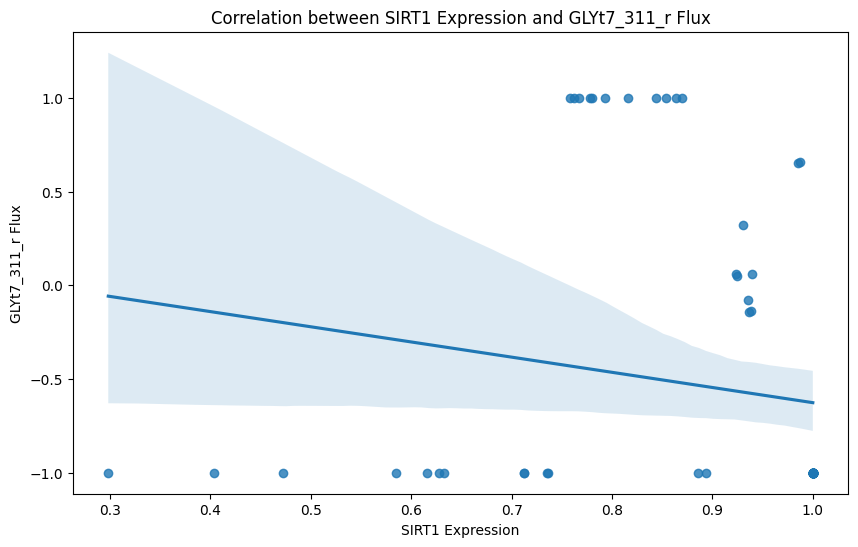

Linear regression results for SIRT1 and GLYt7_311_r:
Slope: -0.8097314234234798
Intercept: 0.18346970136671237
R-squared: 0.027349805839893014
P-value: 0.16811854587800312
Standard error: 0.5813232101516613



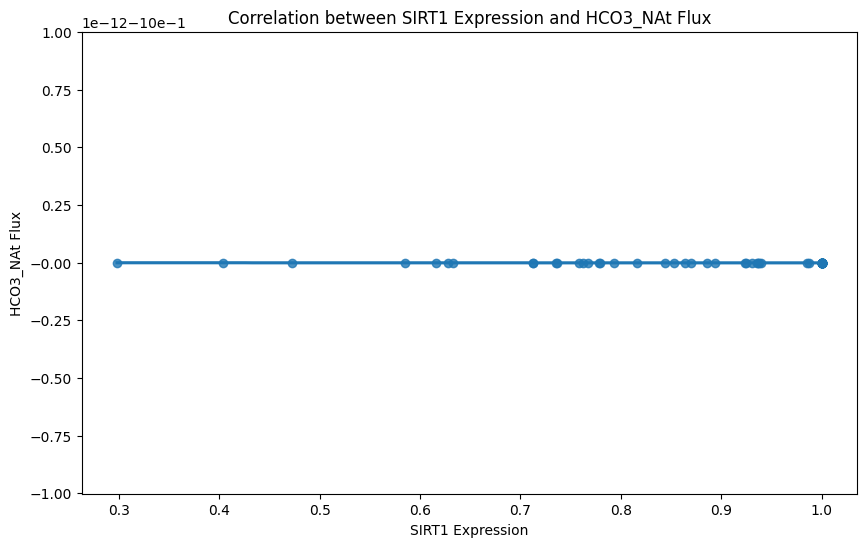

Linear regression results for SIRT1 and HCO3_NAt:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



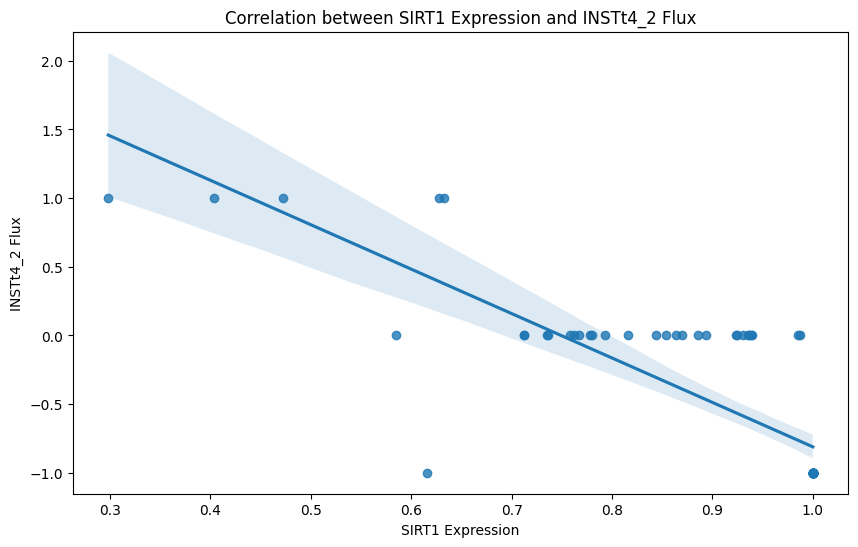

Linear regression results for SIRT1 and INSTt4_2:
Slope: -3.2351747757979683
Intercept: 2.423742652314583
R-squared: 0.6625169692560127
P-value: 6.194010494680774e-18
Standard error: 0.277971755284408



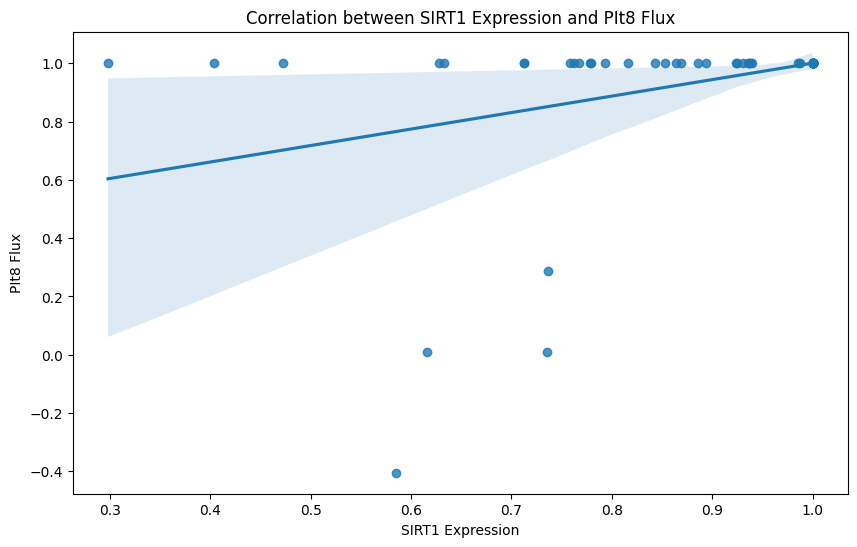

Linear regression results for SIRT1 and PIt8:
Slope: 0.5655939888743796
Intercept: 0.43482686535742776
R-squared: 0.13334860501451476
P-value: 0.0017406367427071415
Standard error: 0.17358341233859736



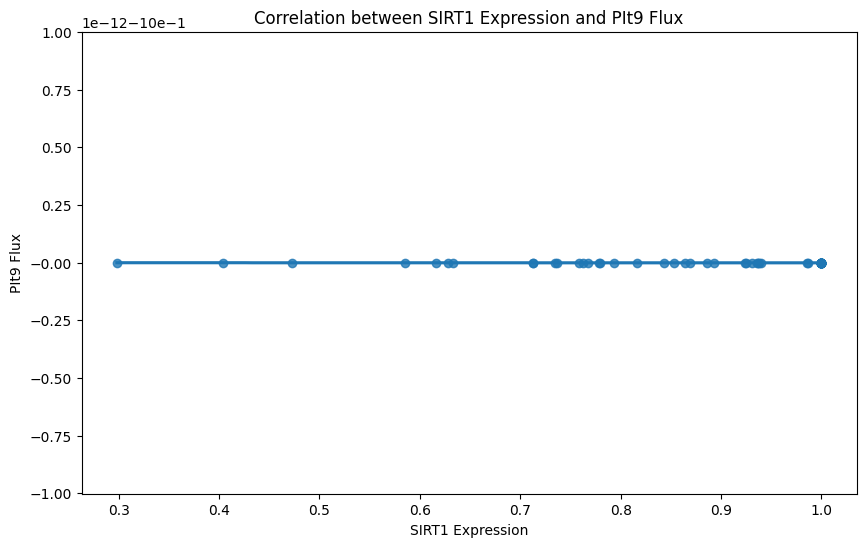

Linear regression results for SIRT1 and PIt9:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



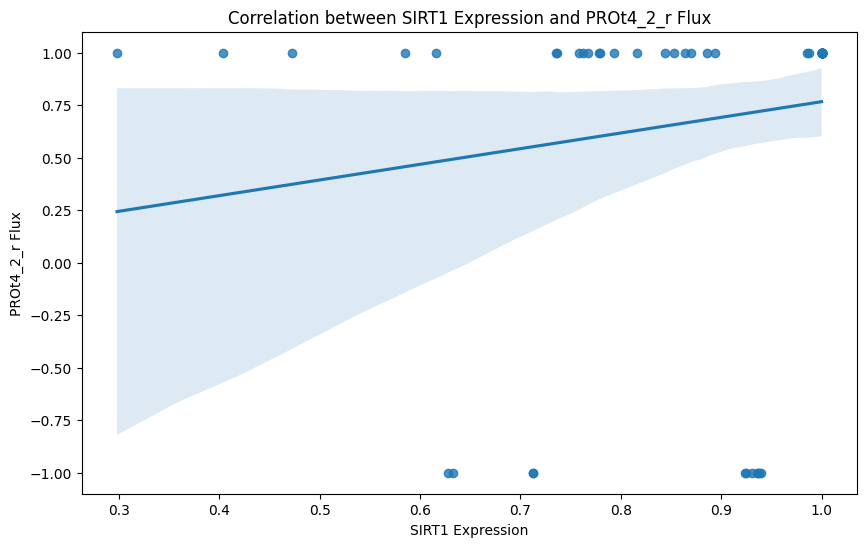

Linear regression results for SIRT1 and PROt4_2_r:
Slope: 0.7457408695787718
Intercept: 0.02110164850759122
R-squared: 0.02625424210179602
P-value: 0.17701323215246612
Standard error: 0.5467470468032728



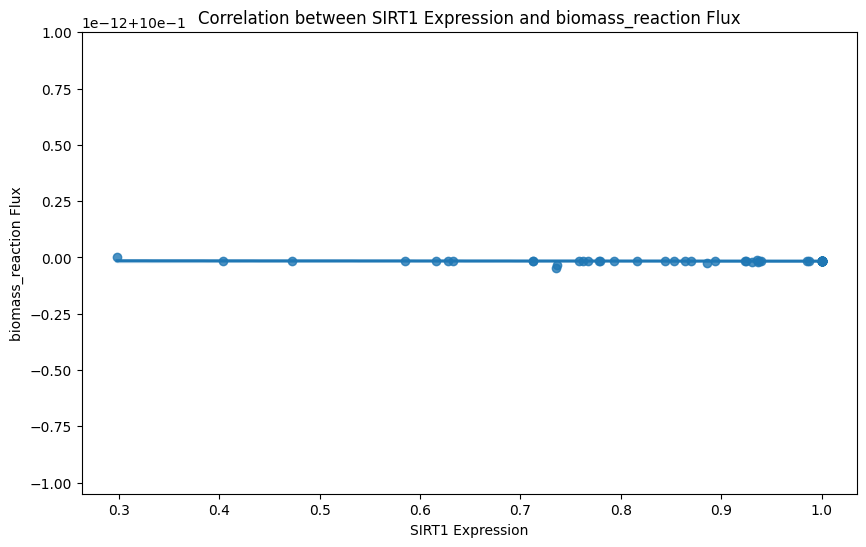

Linear regression results for SIRT1 and biomass_reaction:
Slope: -2.6930857421576684e-15
Intercept: 0.9999999999999855
R-squared: 0.008281110874039405
P-value: 0.45040361575875965
Standard error: 3.5479347834852462e-15



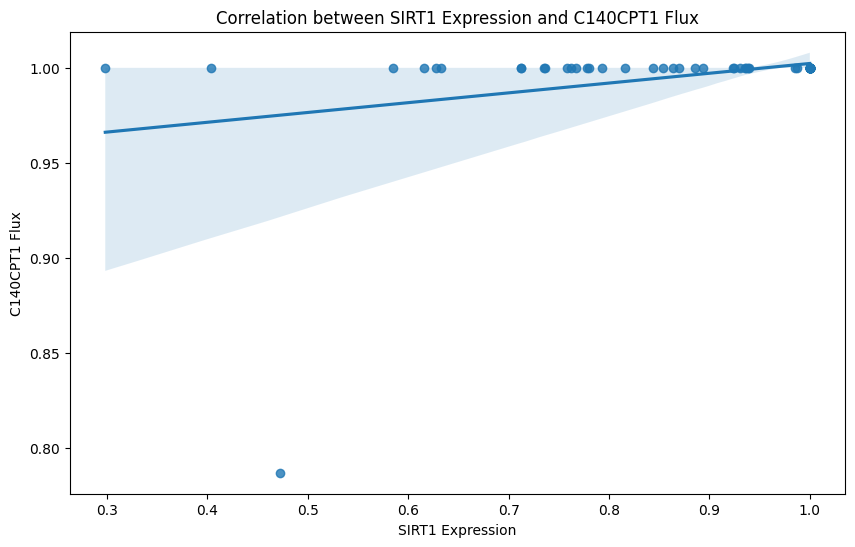

Linear regression results for SIRT1 and C140CPT1:
Slope: 0.05161118593900522
Intercept: 0.9506945297124836
R-squared: 0.10434974471381847
P-value: 0.006001777378516031
Standard error: 0.01820299394933704



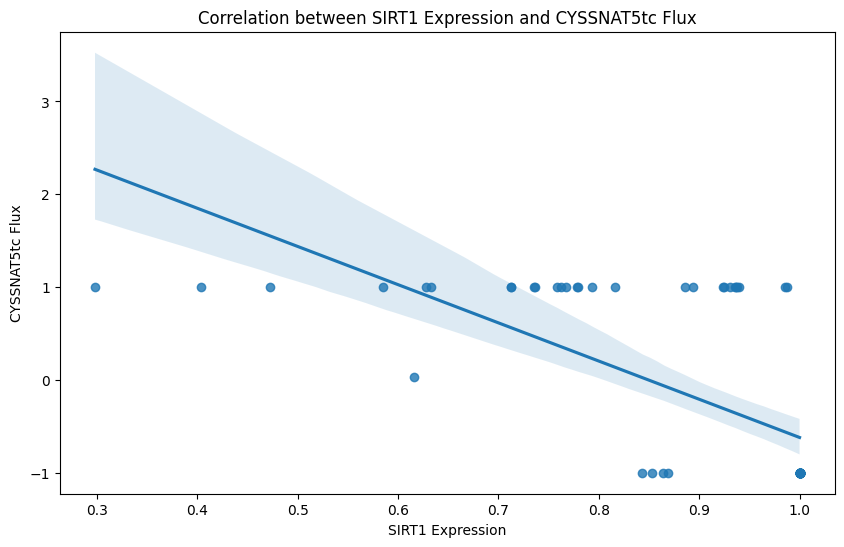

Linear regression results for SIRT1 and CYSSNAT5tc:
Slope: -4.116603148505684
Intercept: 3.4964171990867086
R-squared: 0.442328799547829
P-value: 2.516011628219988e-10
Standard error: 0.5564561628219424



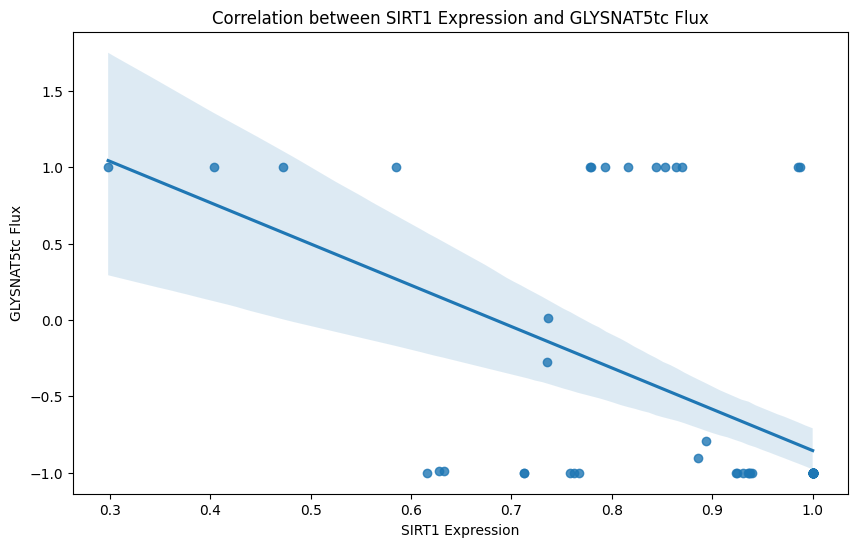

Linear regression results for SIRT1 and GLYSNAT5tc:
Slope: -2.704935941395444
Intercept: 1.8500327238045524
R-squared: 0.2862200098622518
P-value: 1.5361400589669186e-06
Standard error: 0.514238546412718



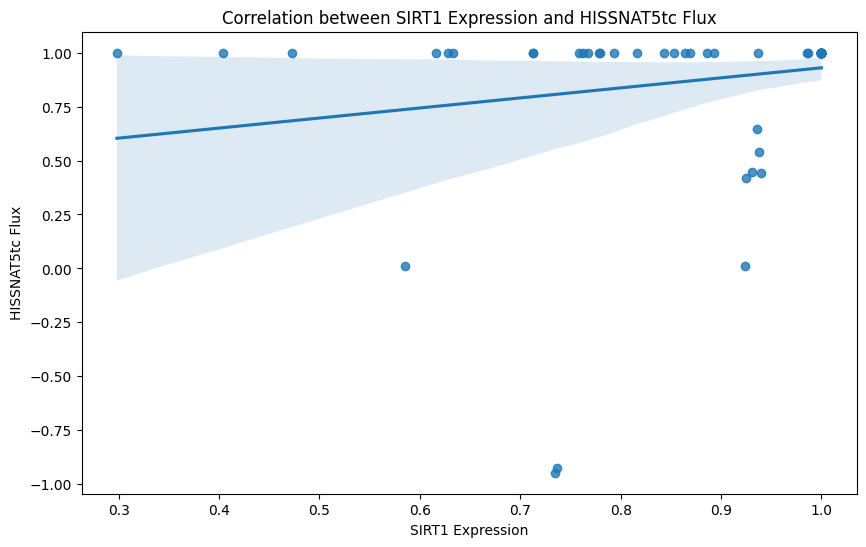

Linear regression results for SIRT1 and HISSNAT5tc:
Slope: 0.4658372441433004
Intercept: 0.464301892081244
R-squared: 0.03897963586890556
P-value: 0.09887004975488316
Standard error: 0.2784563132763676



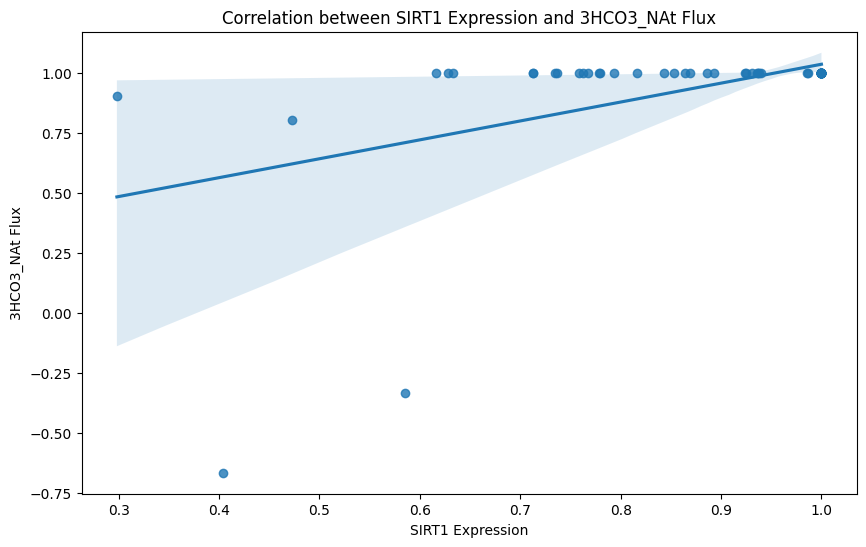

Linear regression results for SIRT1 and 3HCO3_NAt:
Slope: 0.7861880352718593
Intercept: 0.2482682432039871
R-squared: 0.24404104457941875
P-value: 1.1971024597880794e-05
Standard error: 0.16657873329502534



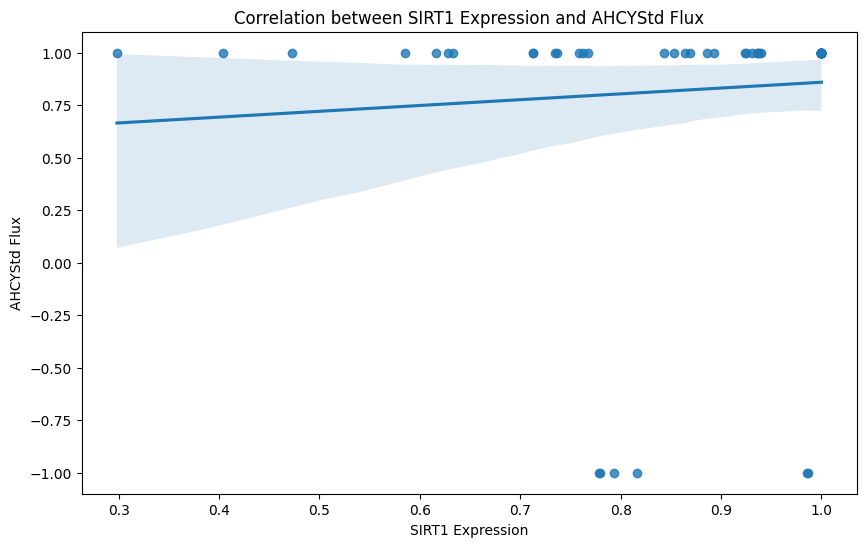

Linear regression results for SIRT1 and AHCYStd:
Slope: 0.27681869664557485
Intercept: 0.5826388475604516
R-squared: 0.006122006179760728
P-value: 0.516608341068919
Standard error: 0.4246103046763848



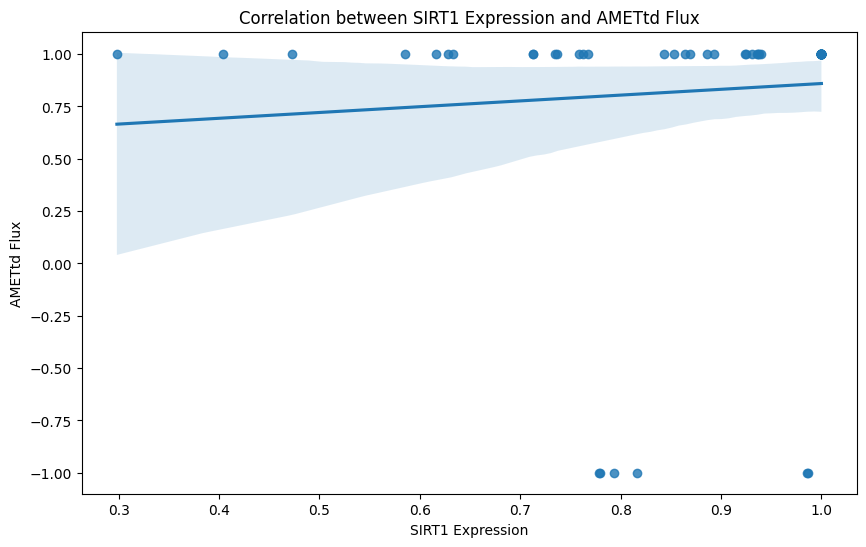

Linear regression results for SIRT1 and AMETtd:
Slope: 0.27681869664557485
Intercept: 0.5826388475604516
R-squared: 0.006122006179760728
P-value: 0.516608341068919
Standard error: 0.4246103046763848



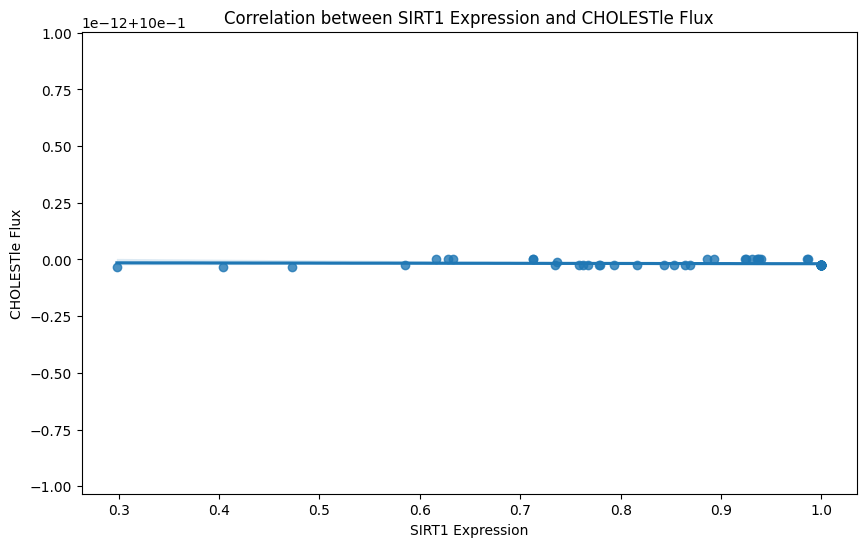

Linear regression results for SIRT1 and CHOLESTle:
Slope: -5.438309089808941e-15
Intercept: 0.9999999999999861
R-squared: 0.006780577990846935
P-value: 0.4948026853883286
Standard error: 7.92371024598182e-15



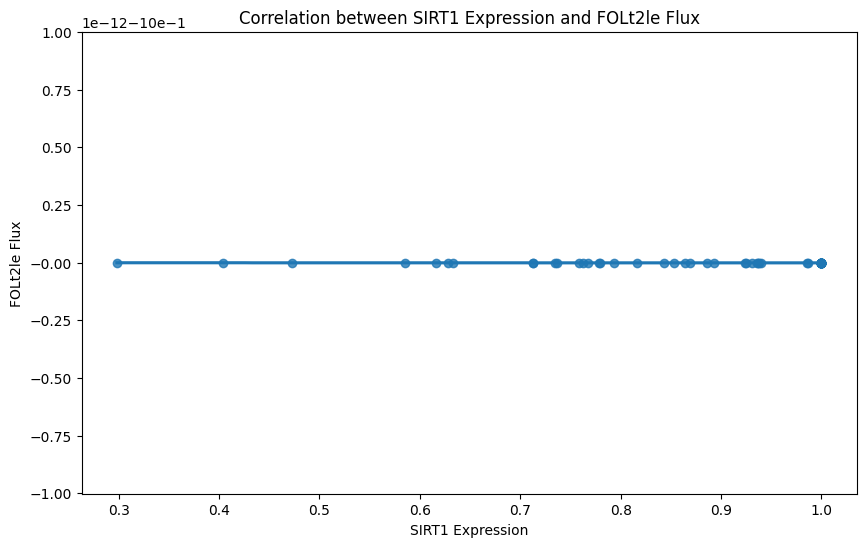

Linear regression results for SIRT1 and FOLt2le:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



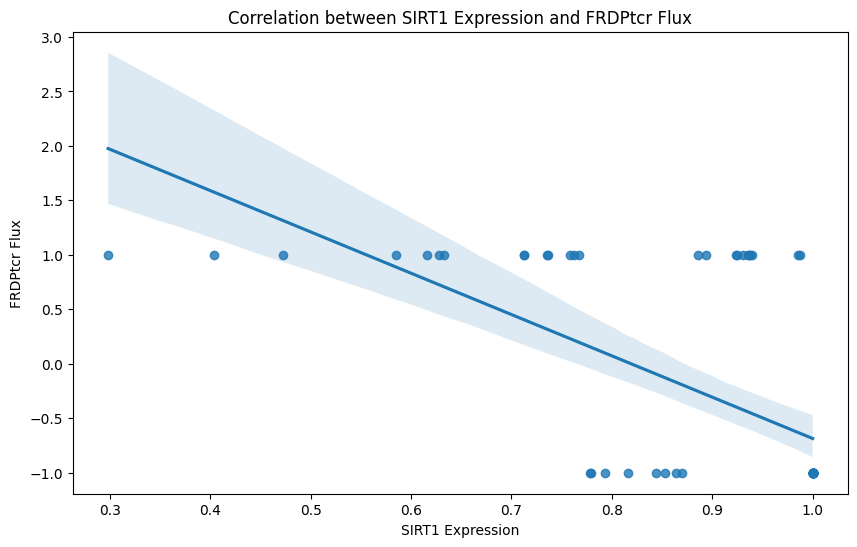

Linear regression results for SIRT1 and FRDPtcr:
Slope: -3.7922663858676304
Intercept: 3.10644582768648
R-squared: 0.3896434359452706
P-value: 6.013492062588685e-09
Standard error: 0.5713897148961938



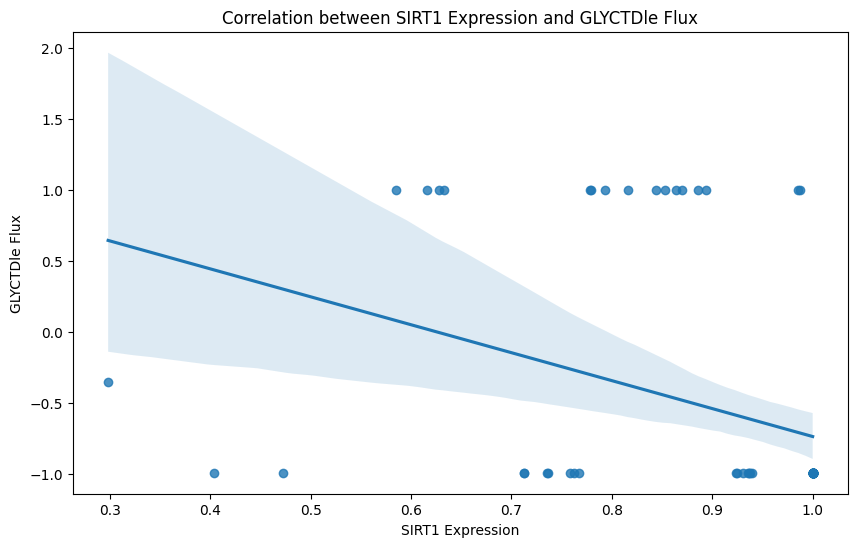

Linear regression results for SIRT1 and GLYCTDle:
Slope: -1.9688558504398712
Intercept: 1.233821884417047
R-squared: 0.1391150393042493
P-value: 0.0013578926155730796
Standard error: 0.5896236490384658



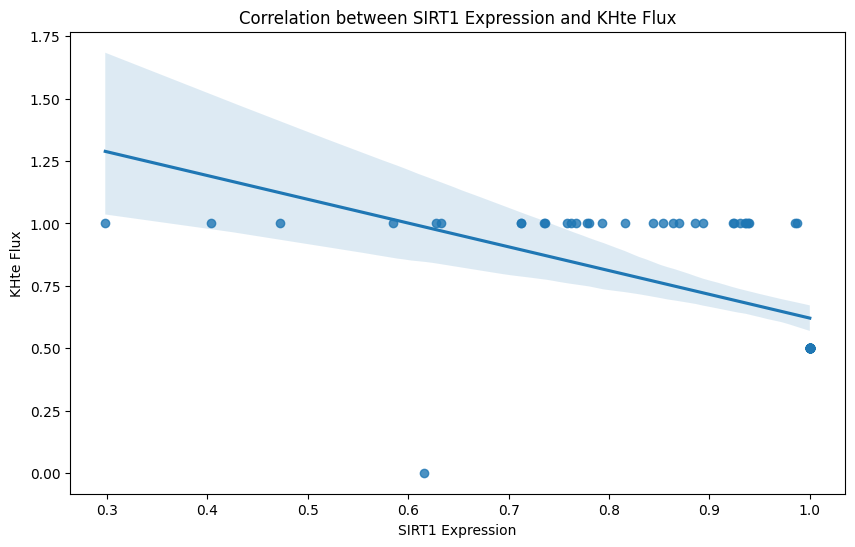

Linear regression results for SIRT1 and KHte:
Slope: -0.9510485059059157
Intercept: 1.572106229943737
R-squared: 0.3276030894594128
P-value: 1.8389853623763836e-07
Standard error: 0.1640276196705782



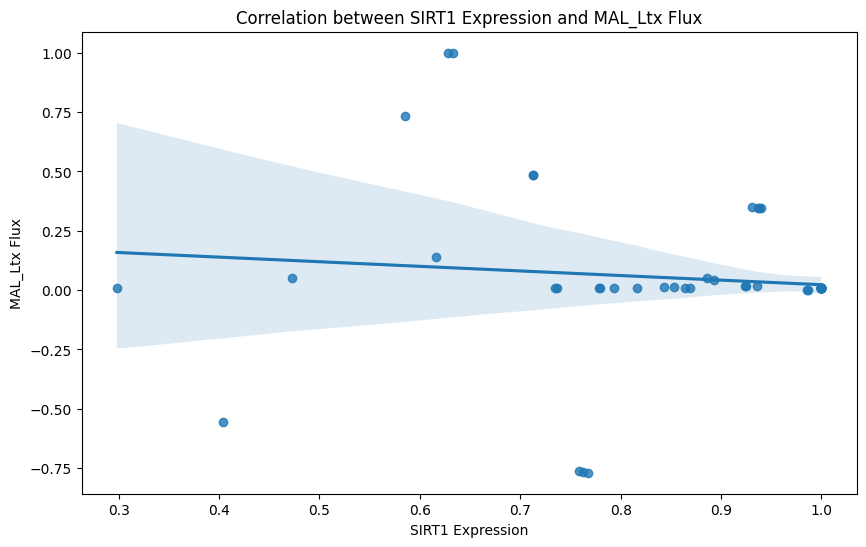

Linear regression results for SIRT1 and MAL_Ltx:
Slope: -0.19395049104294396
Intercept: 0.21636409426371142
R-squared: 0.012074831639930146
P-value: 0.36164044903167114
Standard error: 0.2111970369779424



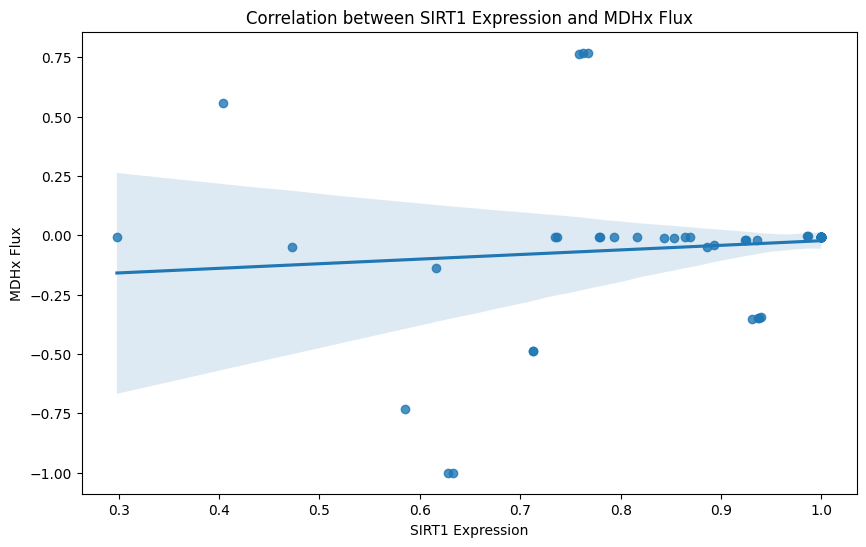

Linear regression results for SIRT1 and MDHx:
Slope: 0.19395049104294396
Intercept: -0.21636409426371142
R-squared: 0.012074831639930146
P-value: 0.36164044903167114
Standard error: 0.2111970369779424



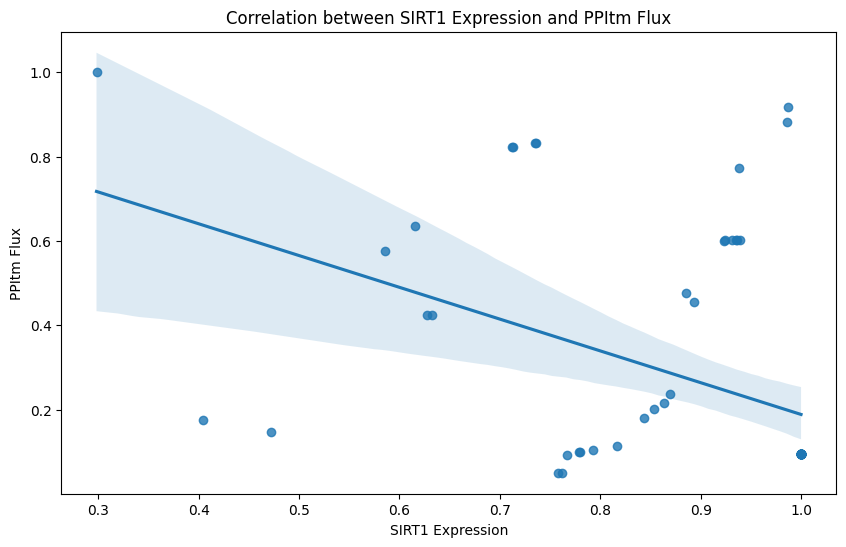

Linear regression results for SIRT1 and PPItm:
Slope: -0.753140867515496
Intercept: 0.941840869401336
R-squared: 0.18927836674874382
P-value: 0.00014972943073141001
Standard error: 0.18764502732349128



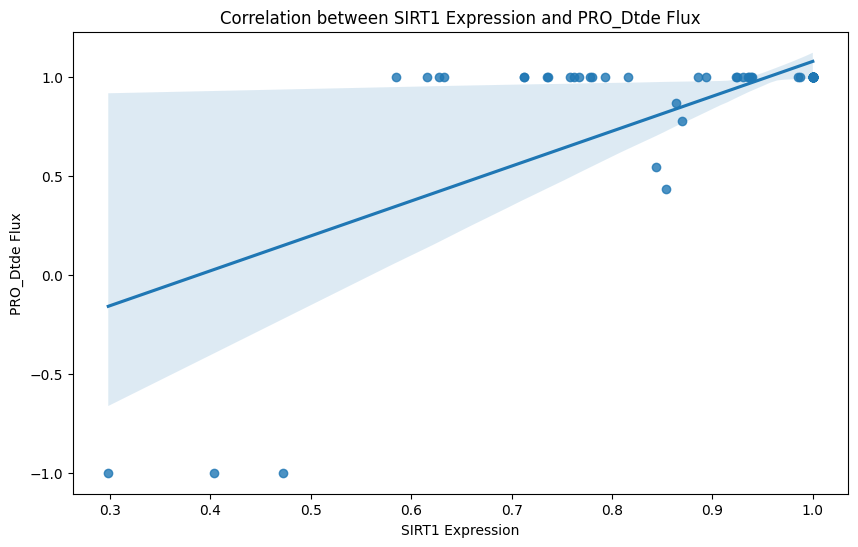

Linear regression results for SIRT1 and PRO_Dtde:
Slope: 1.7625851259699272
Intercept: -0.6852275360434833
R-squared: 0.46095238290703716
P-value: 7.644727705540704e-11
Standard error: 0.2294621659022288



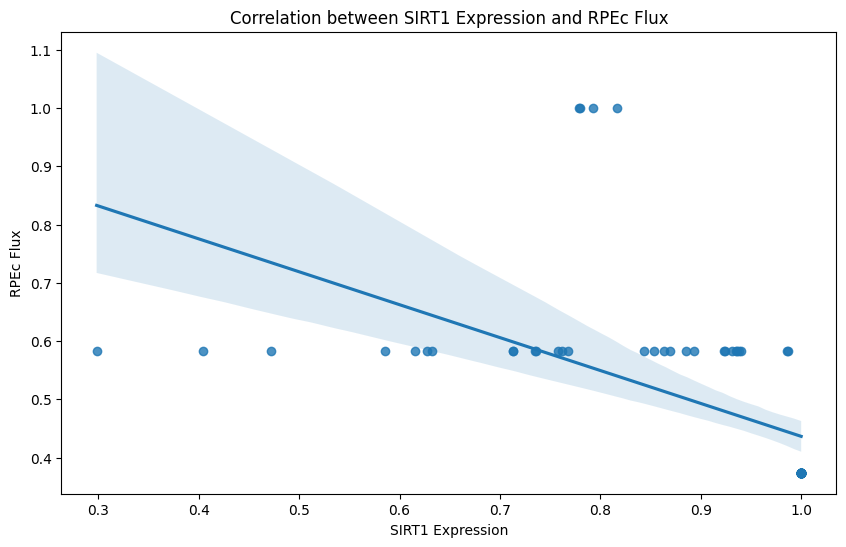

Linear regression results for SIRT1 and RPEc:
Slope: -0.5650514111912842
Intercept: 1.00137986092674
R-squared: 0.31130429325823333
P-value: 4.301876135143785e-07
Standard error: 0.10117764142768167



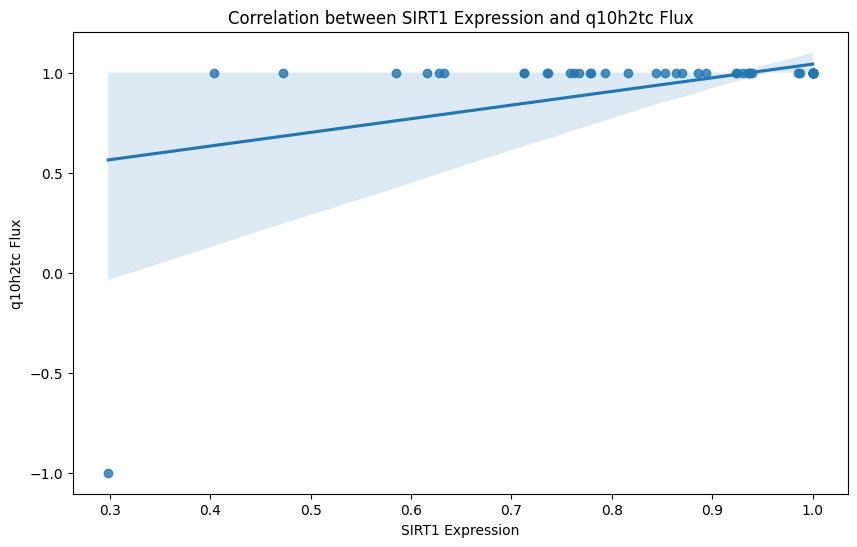

Linear regression results for SIRT1 and q10h2tc:
Slope: 0.6823778850579137
Intercept: 0.3596377019008141
R-squared: 0.207261853969341
P-value: 6.63342755094393e-05
Standard error: 0.16065919521652594



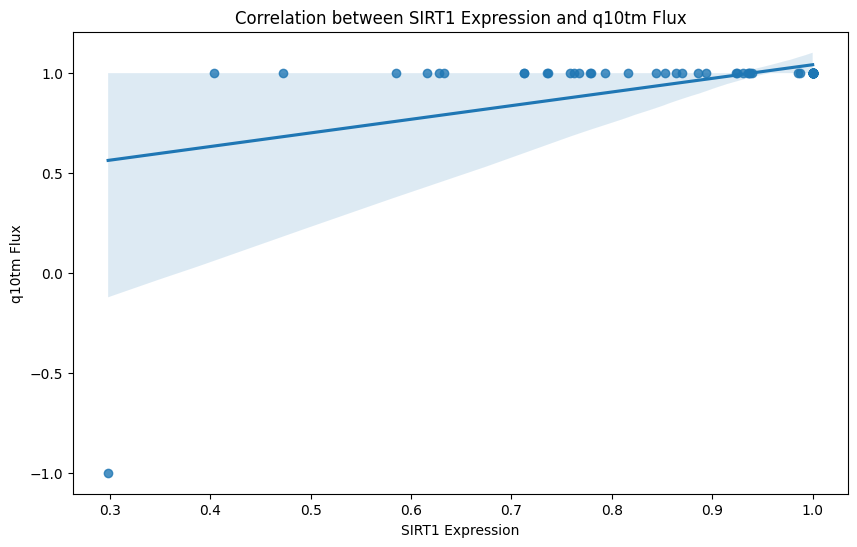

Linear regression results for SIRT1 and q10tm:
Slope: 0.6823778850579137
Intercept: 0.3596377019008141
R-squared: 0.207261853969341
P-value: 6.63342755094393e-05
Standard error: 0.16065919521652594



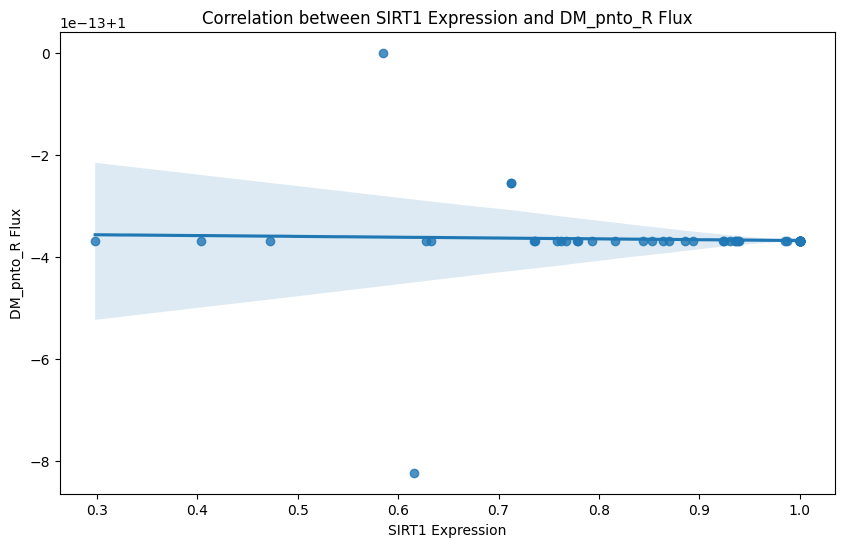

Linear regression results for SIRT1 and DM_pnto_R:
Slope: -1.6780764238167177e-14
Intercept: 0.9999999999996476
R-squared: 0.0013389318764737282
P-value: 0.7619253164854224
Standard error: 5.5171781770187957e-14



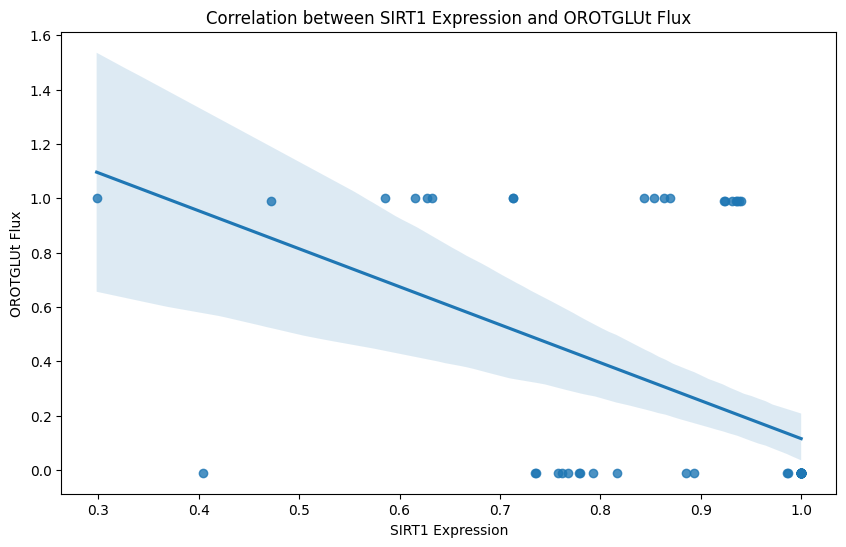

Linear regression results for SIRT1 and OROTGLUt:
Slope: -1.3973982905341125
Intercept: 1.5128266374259272
R-squared: 0.24349078663528625
P-value: 1.2287862229587092e-05
Standard error: 0.2965251311647633



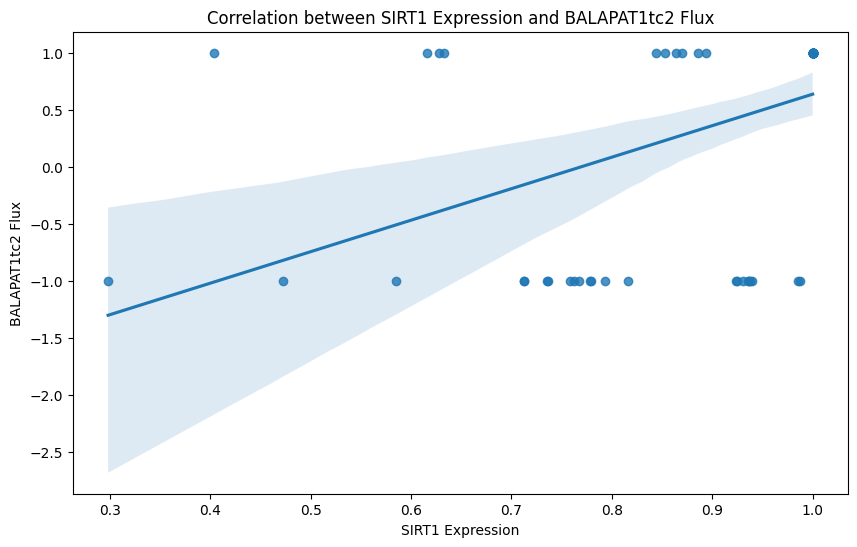

Linear regression results for SIRT1 and BALAPAT1tc2:
Slope: 2.764227033232892
Intercept: -2.127805360990504
R-squared: 0.2156482201691344
P-value: 4.515482655854994e-05
Standard error: 0.6346461775982444



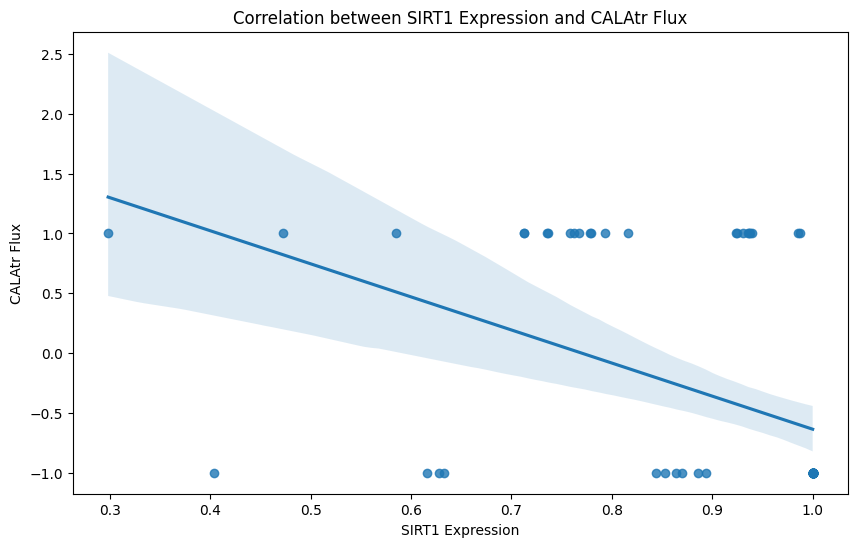

Linear regression results for SIRT1 and CALAtr:
Slope: -2.764227033232892
Intercept: 2.127805360990504
R-squared: 0.2156482201691344
P-value: 4.515482655854994e-05
Standard error: 0.6346461775982444



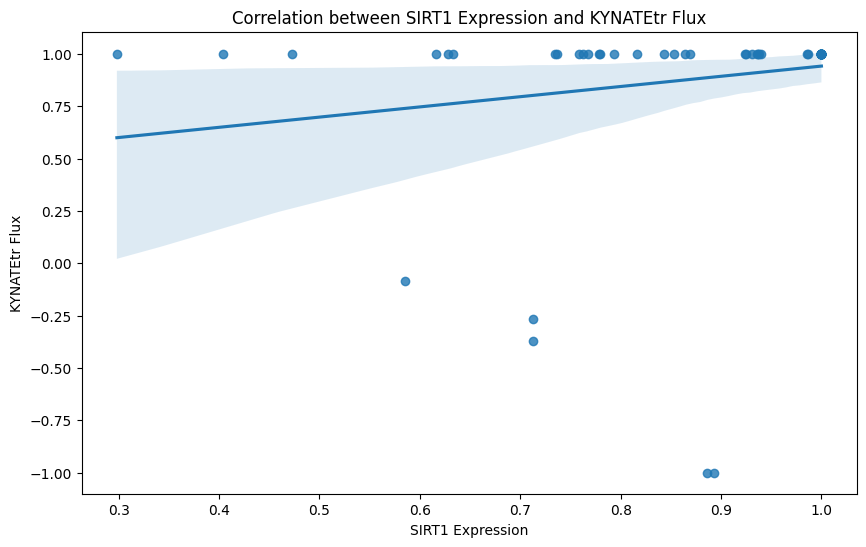

Linear regression results for SIRT1 and KYNATEtr:
Slope: 0.4872377389006807
Intercept: 0.4541104319841063
R-squared: 0.035252908218091766
P-value: 0.11688770232550125
Standard error: 0.3068496538056292



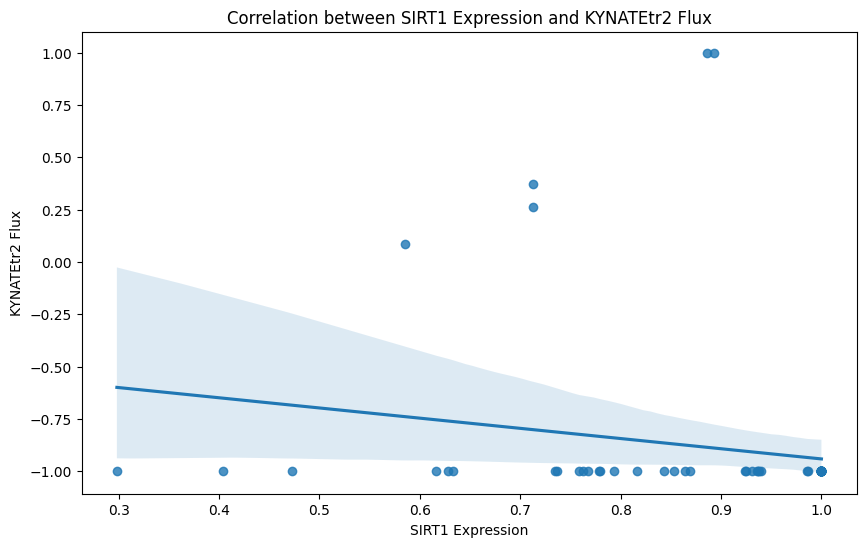

Linear regression results for SIRT1 and KYNATEtr2:
Slope: -0.4872377389006807
Intercept: -0.4541104319841063
R-squared: 0.035252908218091766
P-value: 0.11688770232550125
Standard error: 0.3068496538056292



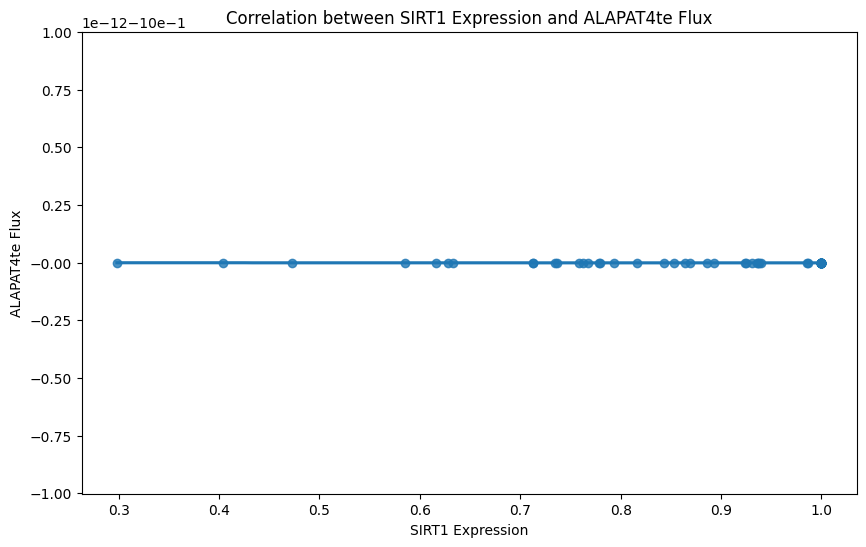

Linear regression results for SIRT1 and ALAPAT4te:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



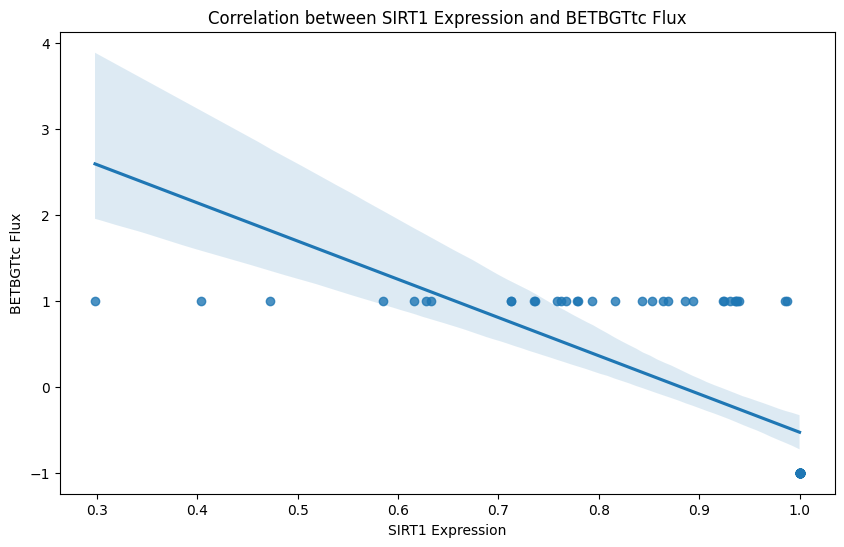

Linear regression results for SIRT1 and BETBGTtc:
Slope: -4.452798415411912
Intercept: 3.92434756215458
R-squared: 0.4926946317463968
P-value: 9.127638760268333e-12
Standard error: 0.5439441406303789



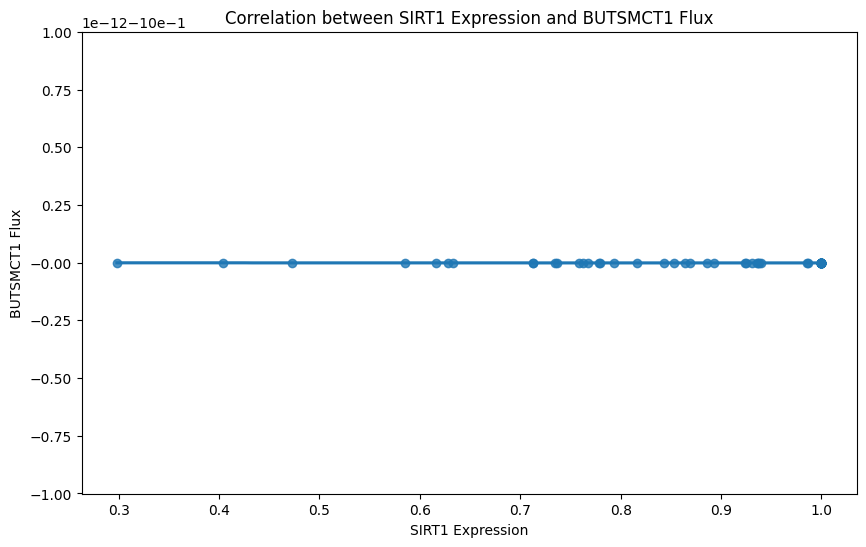

Linear regression results for SIRT1 and BUTSMCT1:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



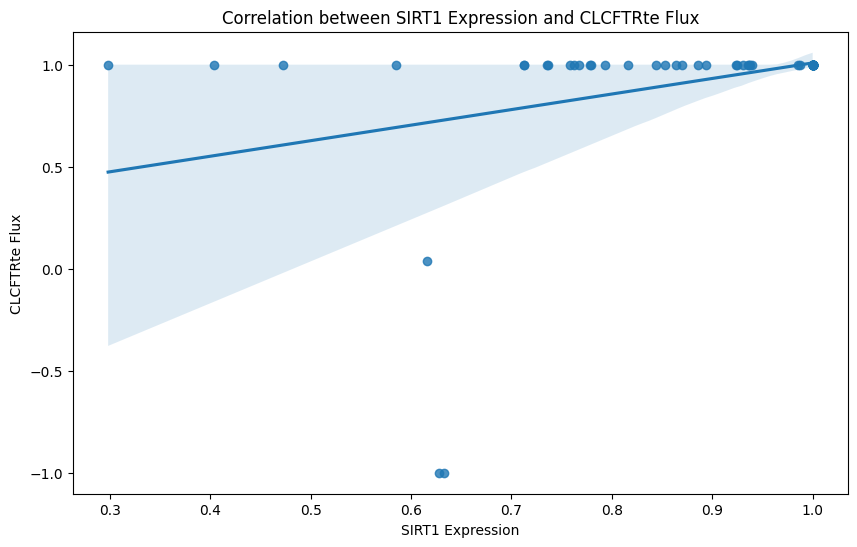

Linear regression results for SIRT1 and CLCFTRte:
Slope: 0.7624286794448335
Intercept: 0.24611968265305684
R-squared: 0.11897643724001683
P-value: 0.0032209957165930912
Standard error: 0.24976866978261733



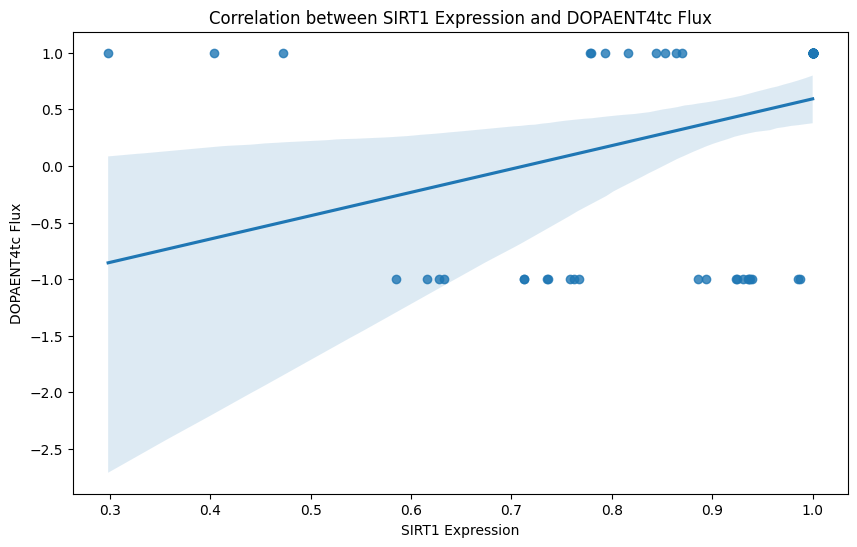

Linear regression results for SIRT1 and DOPAENT4tc:
Slope: 2.0638170531835964
Intercept: -1.4712656226603795
R-squared: 0.12310938567737896
P-value: 0.0026997804856814245
Standard error: 0.6630919874186214



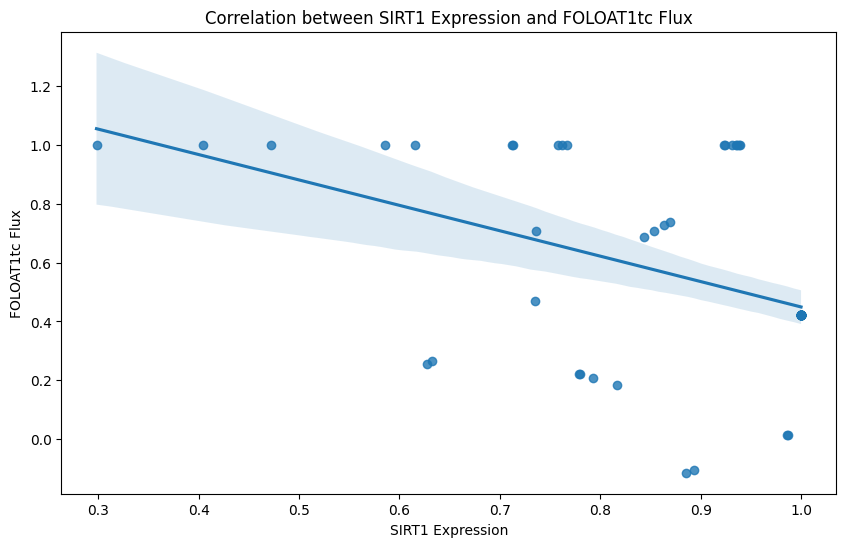

Linear regression results for SIRT1 and FOLOAT1tc:
Slope: -0.8632579803234547
Intercept: 1.31245394047261
R-squared: 0.20799155487463808
P-value: 6.415940913839387e-05
Standard error: 0.20279540571190907



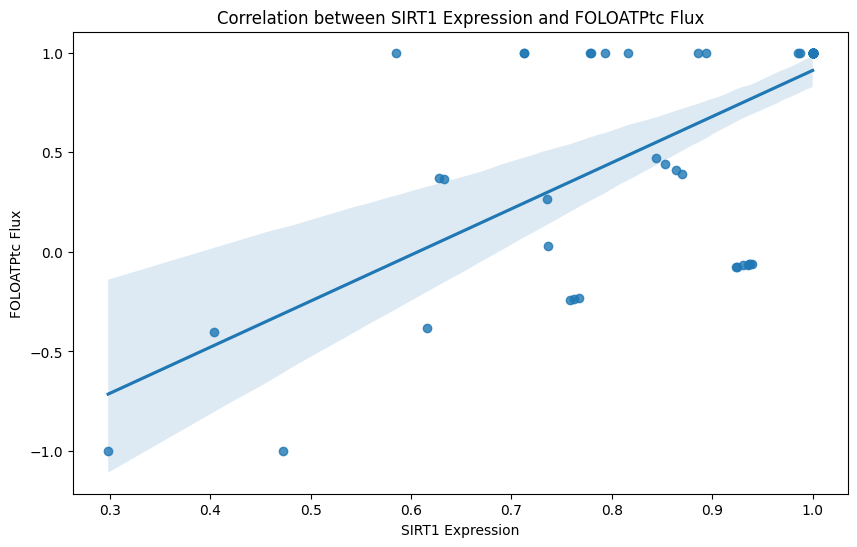

Linear regression results for SIRT1 and FOLOATPtc:
Slope: 2.316149881458702
Intercept: -1.4049450745992231
R-squared: 0.4609153570104376
P-value: 7.663154764824461e-11
Standard error: 0.30155046695028



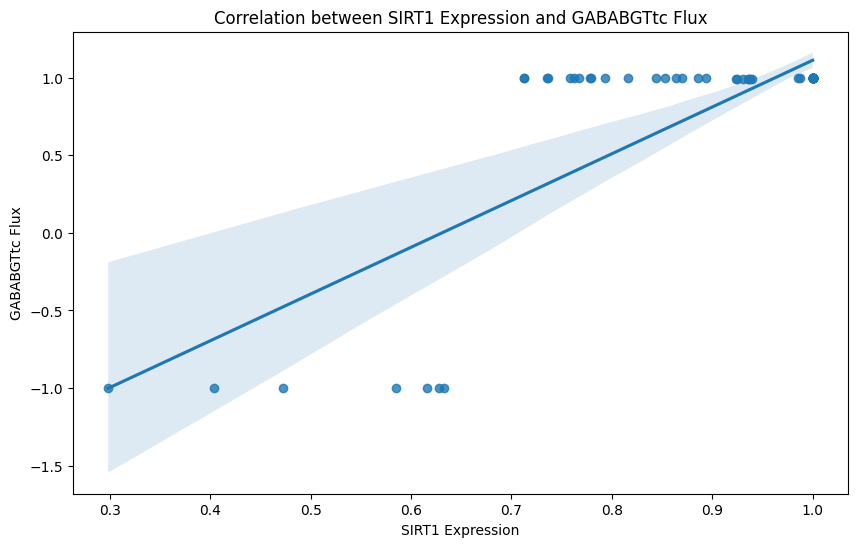

Linear regression results for SIRT1 and GABABGTtc:
Slope: 3.012019328941358
Intercept: -1.9000361595424278
R-squared: 0.6313987460445433
P-value: 1.3289161383318721e-16
Standard error: 0.27705102151820565



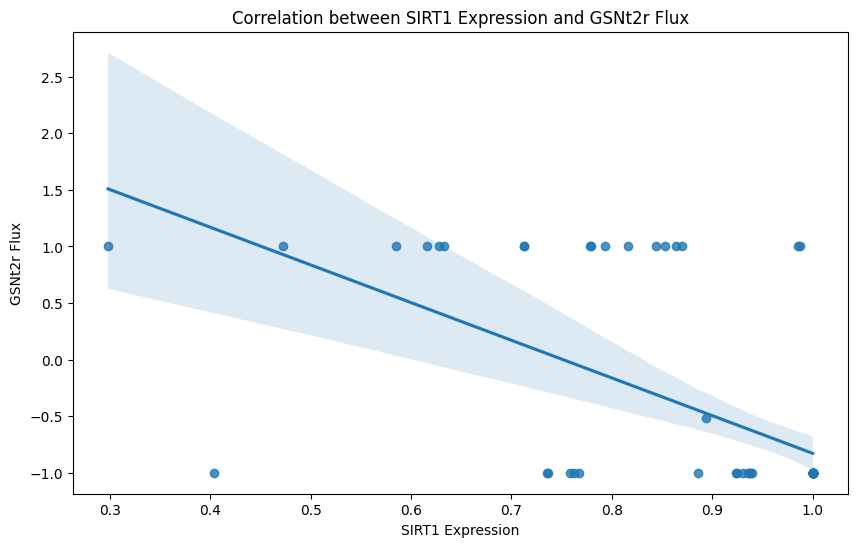

Linear regression results for SIRT1 and GSNt2r:
Slope: -3.330062894328778
Intercept: 2.501385144175777
R-squared: 0.3639383604885014
P-value: 2.5765201401319308e-08
Standard error: 0.5299849970807949



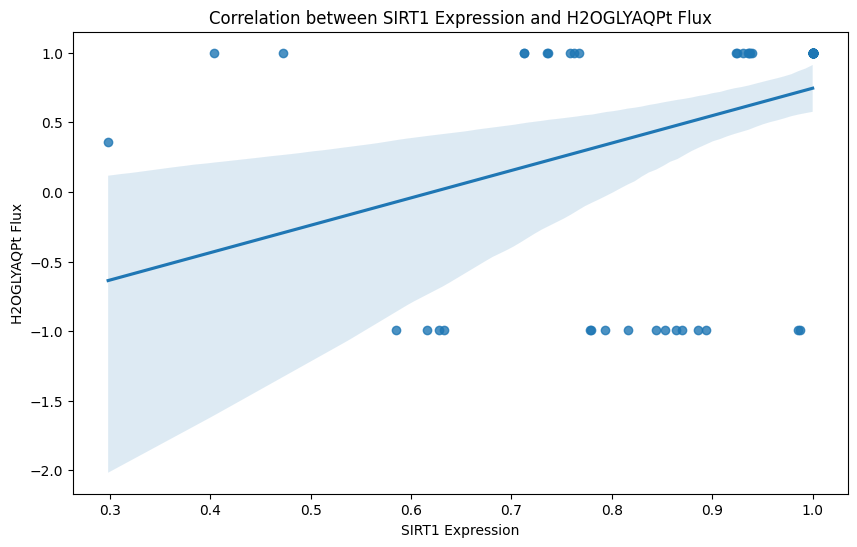

Linear regression results for SIRT1 and H2OGLYAQPt:
Slope: 1.9688558504398705
Intercept: -1.2238218844170468
R-squared: 0.13911503930424926
P-value: 0.0013578926155730817
Standard error: 0.5896236490384655



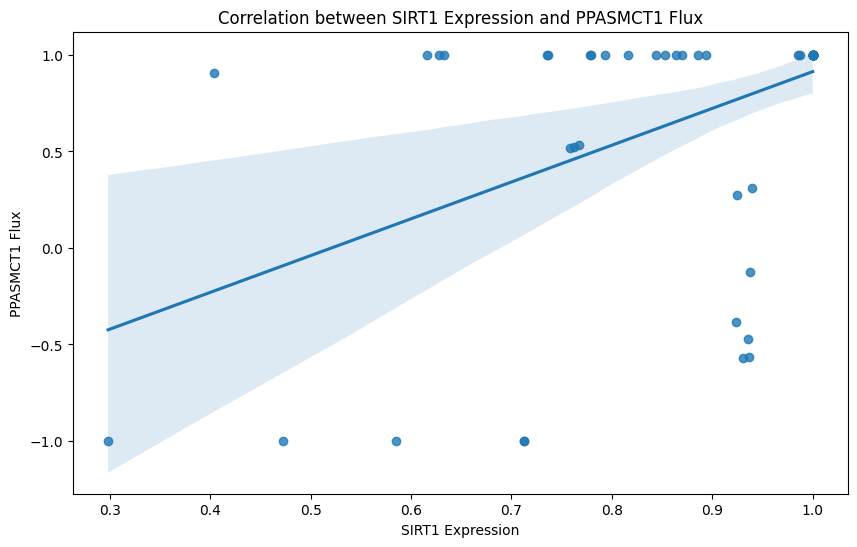

Linear regression results for SIRT1 and PPASMCT1:
Slope: 1.9064325431283689
Intercept: -0.9927163334693874
R-squared: 0.24280128319976807
P-value: 1.2696451569687224e-05
Standard error: 0.4052997569875226



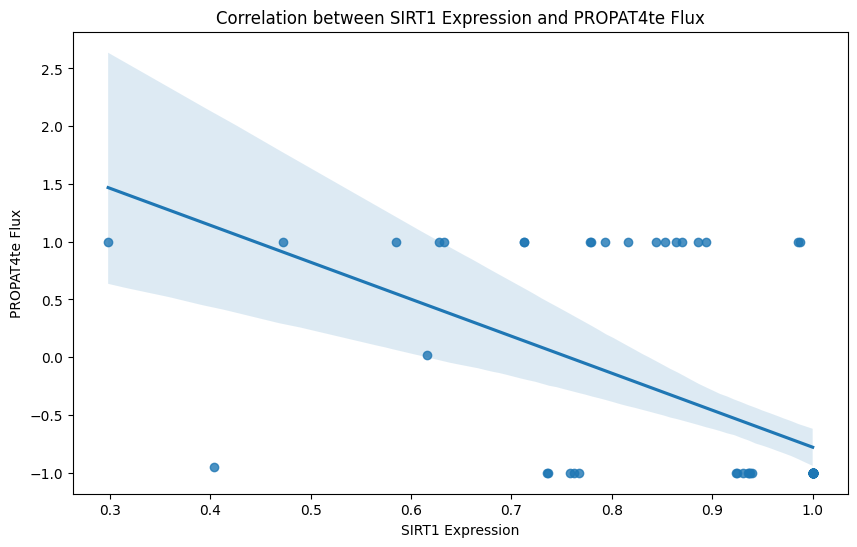

Linear regression results for SIRT1 and PROPAT4te:
Slope: -3.2022441096625616
Intercept: 2.423128427619147
R-squared: 0.3240449011765187
P-value: 2.2174183200559746e-07
Standard error: 0.5567833223683722



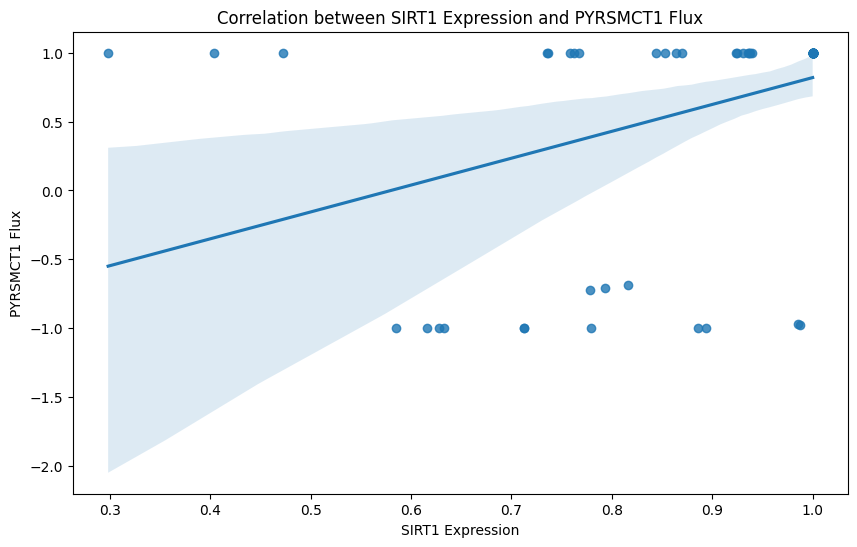

Linear regression results for SIRT1 and PYRSMCT1:
Slope: 1.950690541615392
Intercept: -1.131095950486234
R-squared: 0.15838283438297654
P-value: 0.000588182447215112
Standard error: 0.5413361997869004



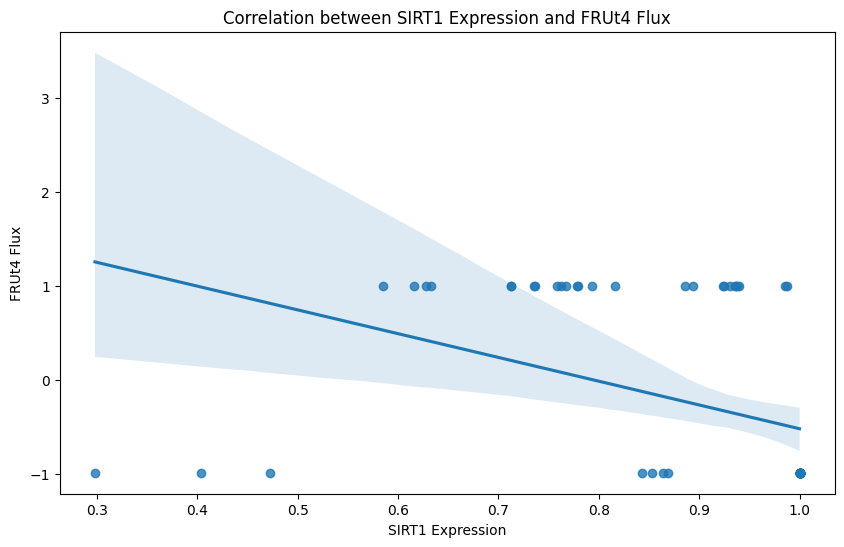

Linear regression results for SIRT1 and FRUt4:
Slope: -2.531204840816912
Intercept: 2.009595266603101
R-squared: 0.17234158913585346
P-value: 0.00031839808731023495
Standard error: 0.6677797832421012



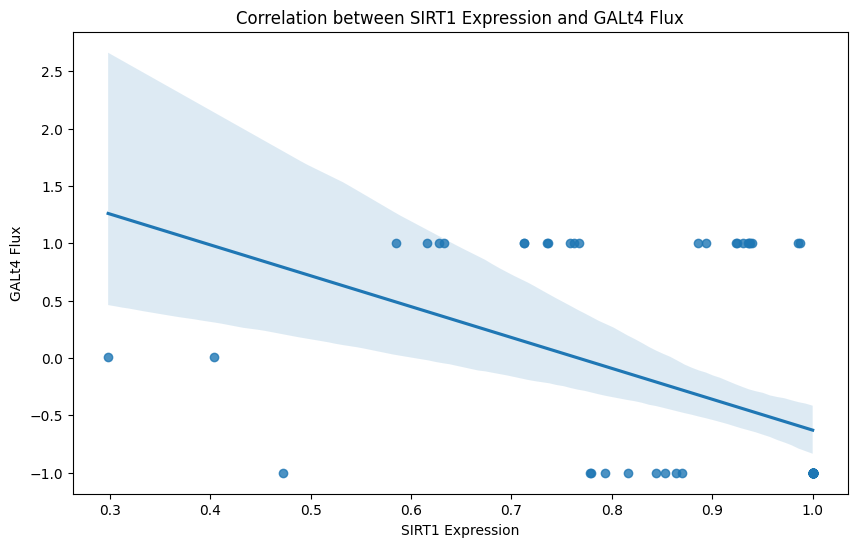

Linear regression results for SIRT1 and GALt4:
Slope: -2.6921707558519654
Intercept: 2.063441976826284
R-squared: 0.21129791258977293
P-value: 5.5147727253903365e-05
Standard error: 0.6261623471607284



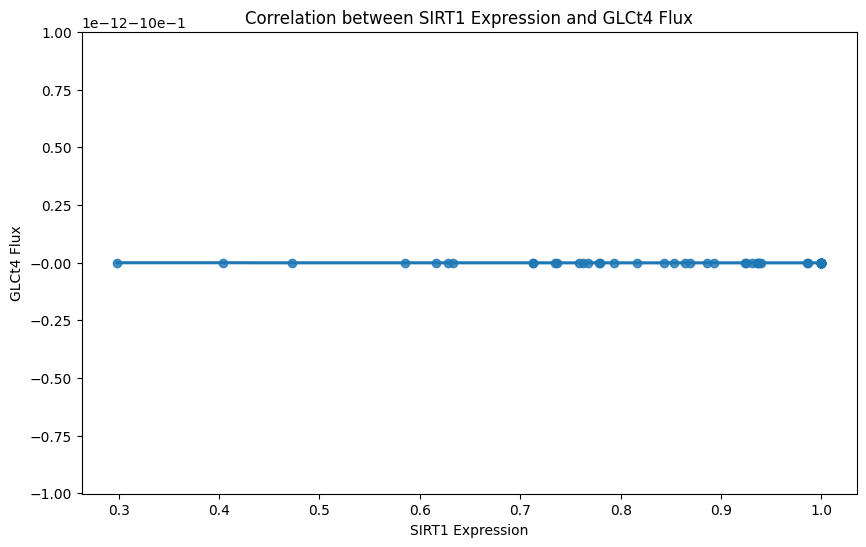

Linear regression results for SIRT1 and GLCt4:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



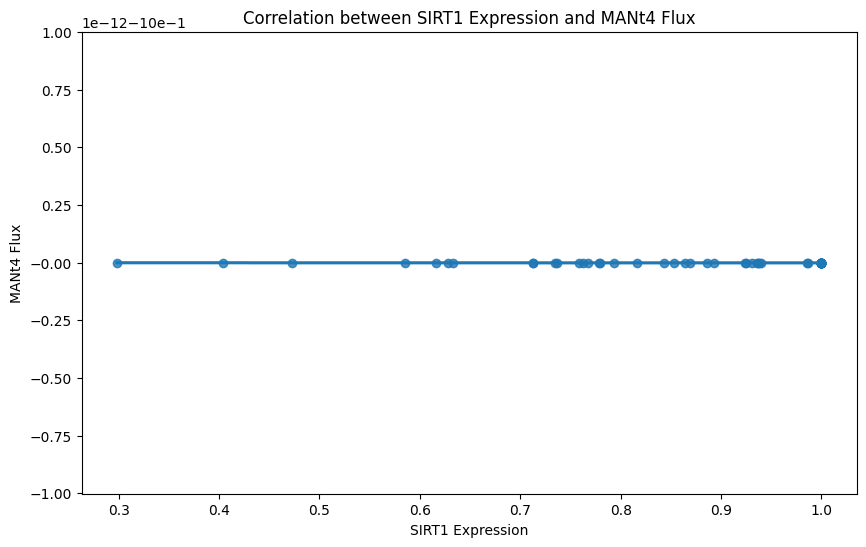

Linear regression results for SIRT1 and MANt4:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



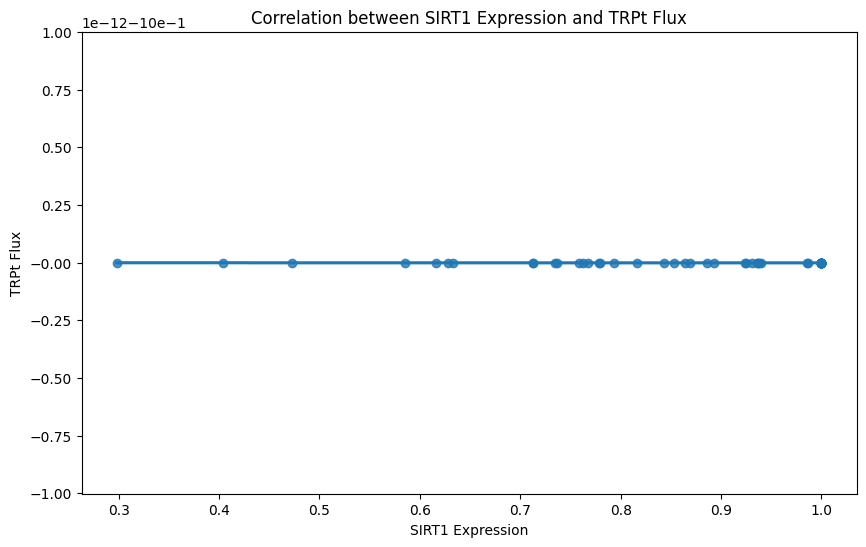

Linear regression results for SIRT1 and TRPt:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



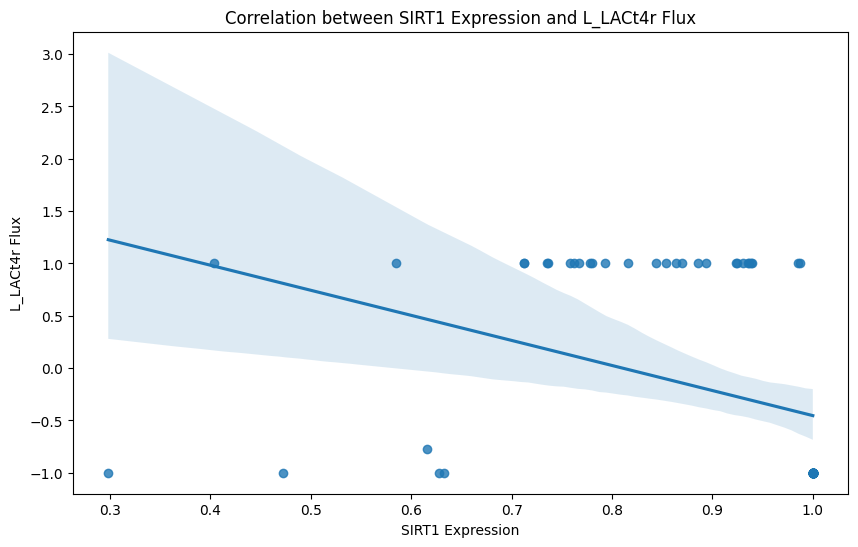

Linear regression results for SIRT1 and L_LACt4r:
Slope: -2.394552354407234
Intercept: 1.9402563915886837
R-squared: 0.14907097836939412
P-value: 0.0008825301166220279
Standard error: 0.6887314399118301



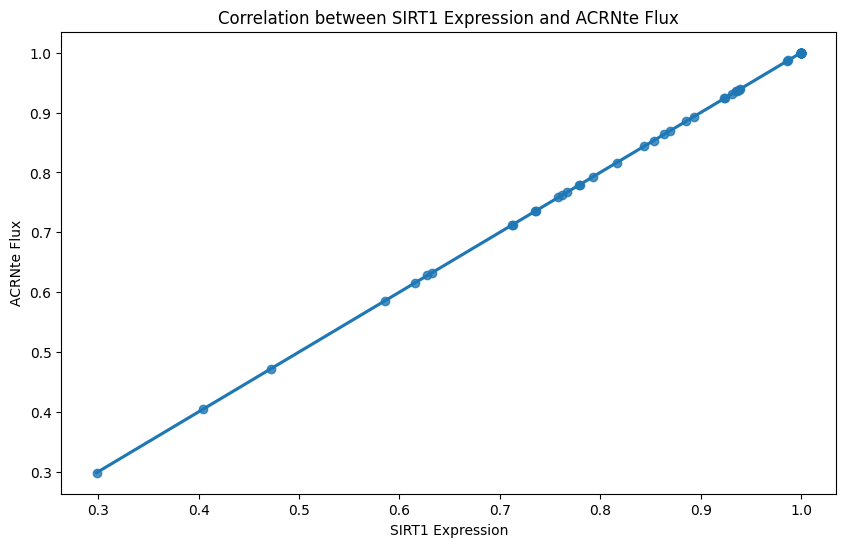

Linear regression results for SIRT1 and ACRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



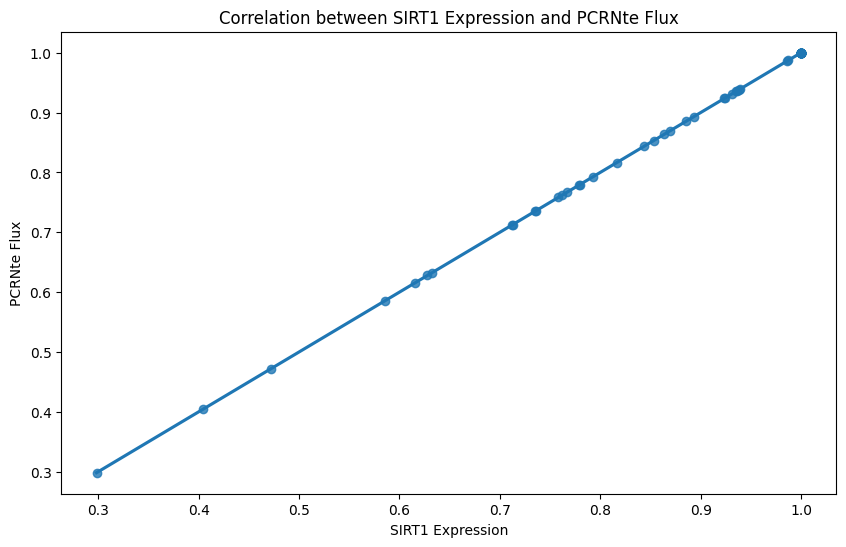

Linear regression results for SIRT1 and PCRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



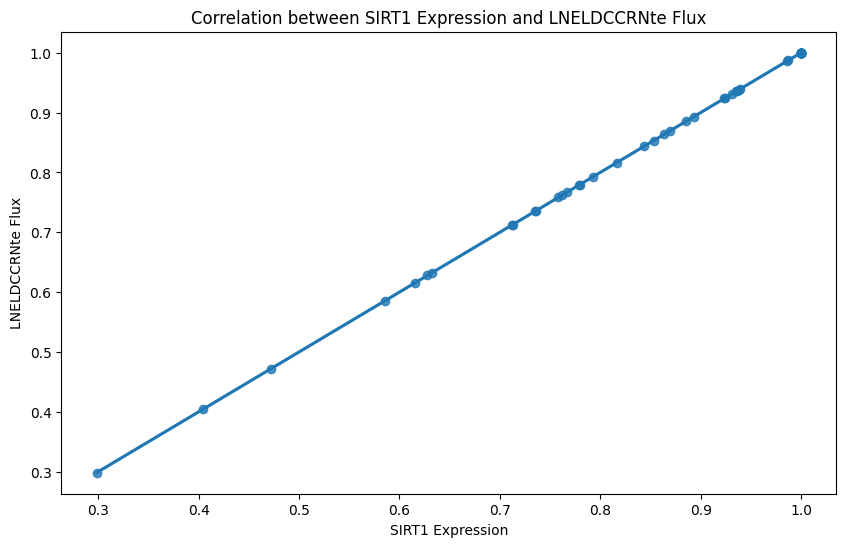

Linear regression results for SIRT1 and LNELDCCRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



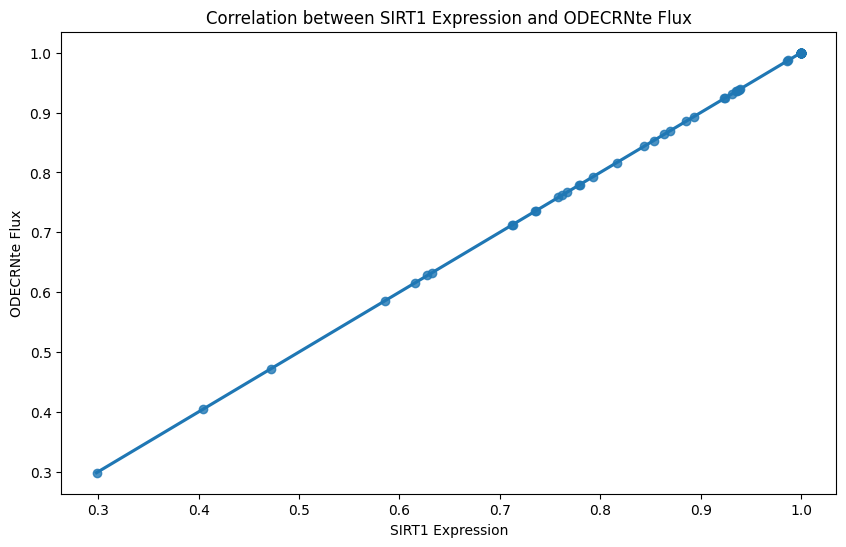

Linear regression results for SIRT1 and ODECRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



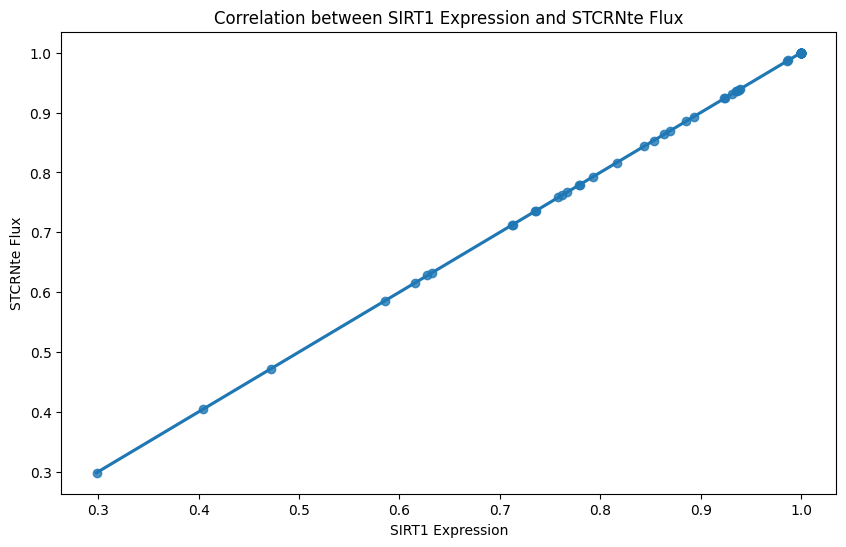

Linear regression results for SIRT1 and STCRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



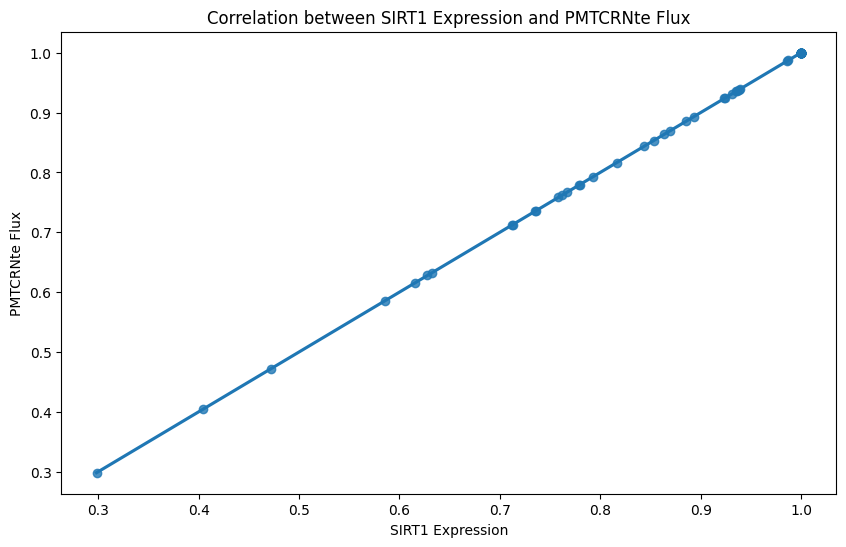

Linear regression results for SIRT1 and PMTCRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



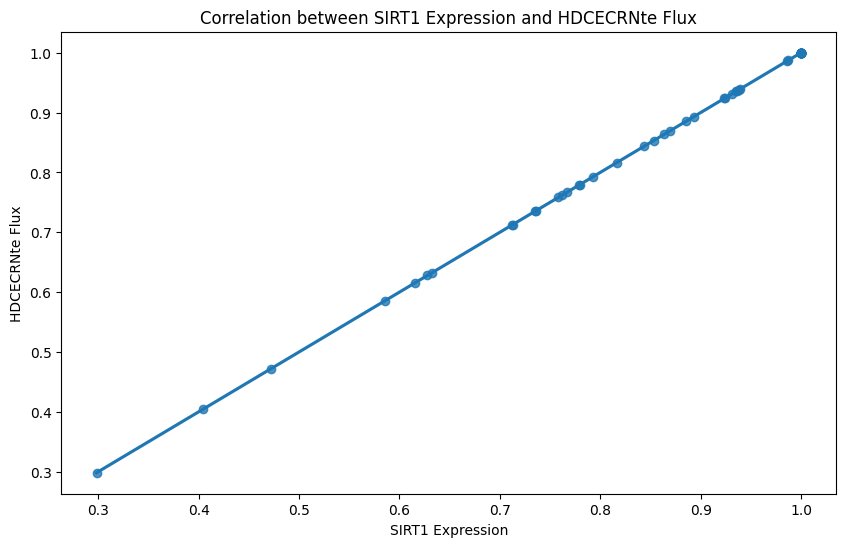

Linear regression results for SIRT1 and HDCECRNte:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



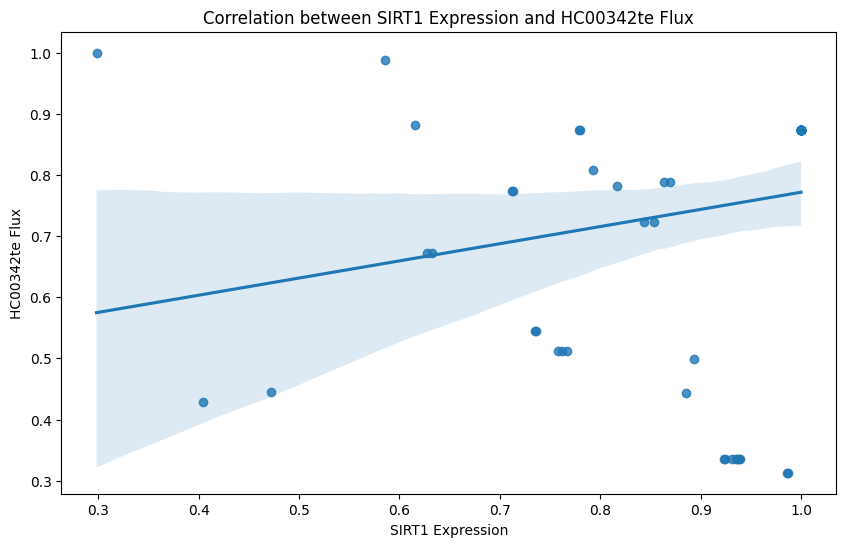

Linear regression results for SIRT1 and HC00342te:
Slope: 0.2807774833569001
Intercept: 0.4910145437030513
R-squared: 0.046729836273422865
P-value: 0.07019808971977733
Standard error: 0.15266820597603534



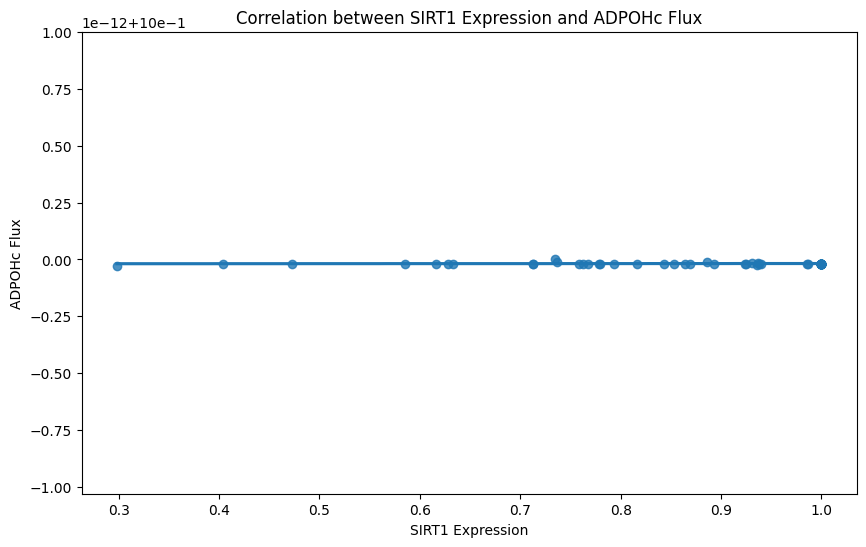

Linear regression results for SIRT1 and ADPOHc:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



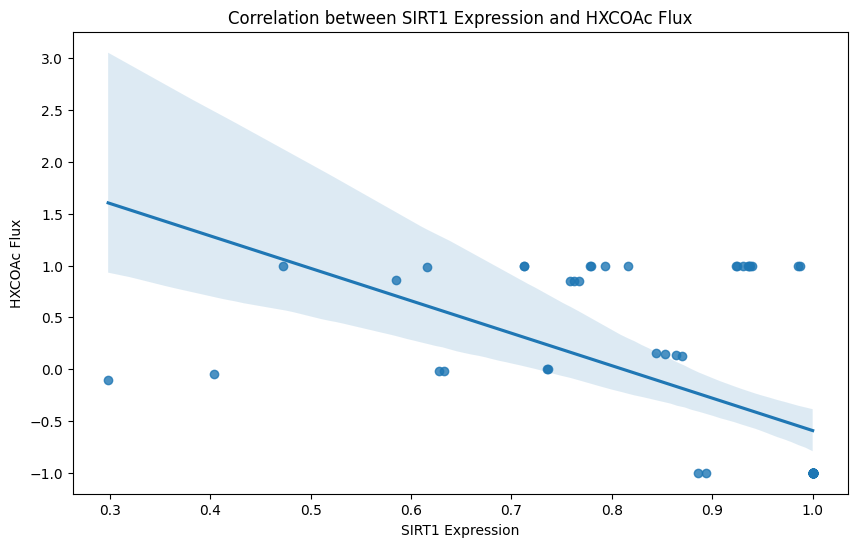

Linear regression results for SIRT1 and HXCOAc:
Slope: -3.1318203511800835
Intercept: 2.5386489990057726
R-squared: 0.3146393564590331
P-value: 3.620703857086909e-07
Standard error: 0.5564489853311089



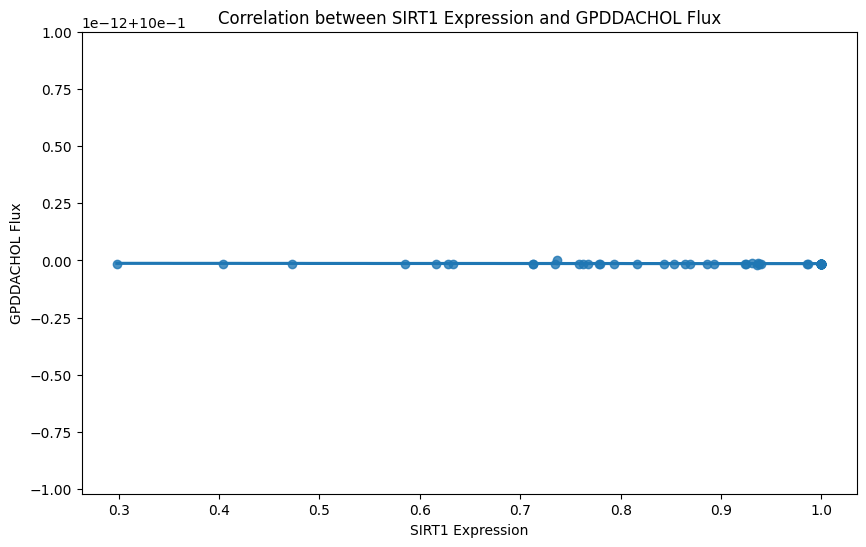

Linear regression results for SIRT1 and GPDDACHOL:
Slope: -1.3820751608547186e-15
Intercept: 0.9999999999999872
R-squared: 0.013547836862836107
P-value: 0.3337213629427722
Standard error: 1.4197443593778813e-15



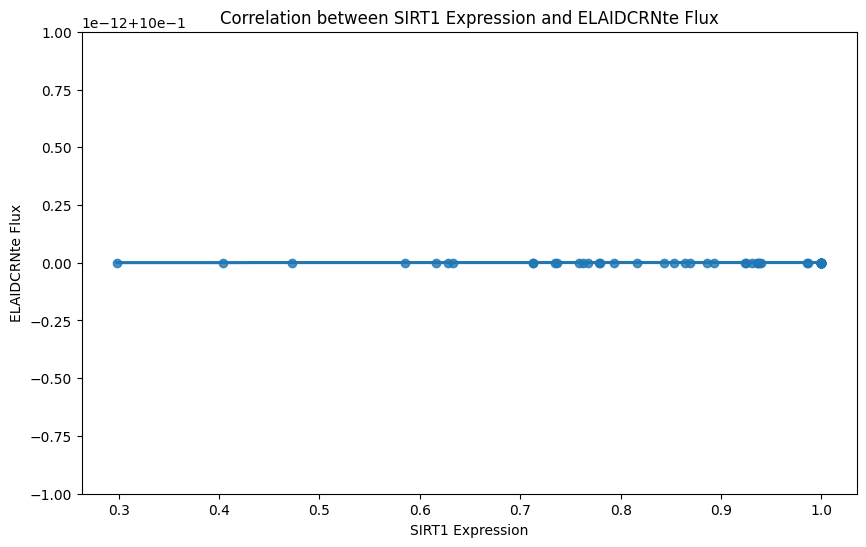

Linear regression results for SIRT1 and ELAIDCRNte:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



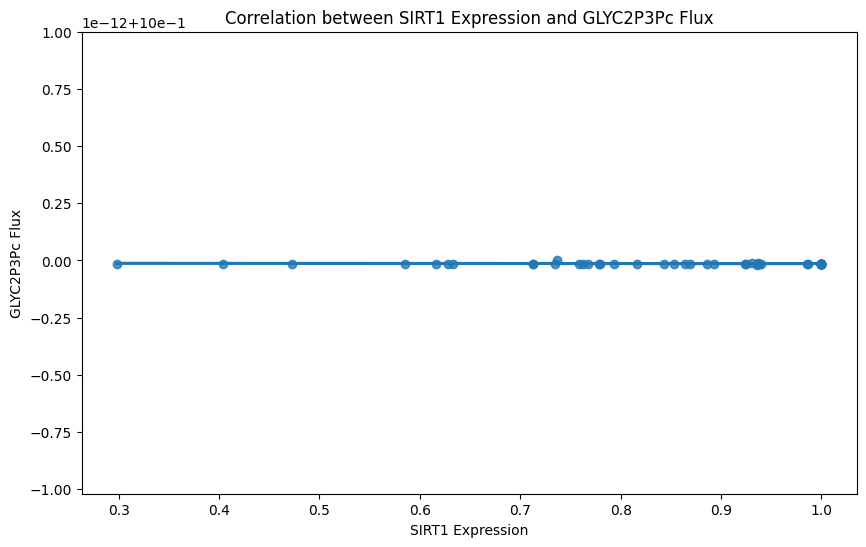

Linear regression results for SIRT1 and GLYC2P3Pc:
Slope: -1.3820751608547186e-15
Intercept: 0.9999999999999872
R-squared: 0.013547836862836107
P-value: 0.3337213629427722
Standard error: 1.4197443593778813e-15



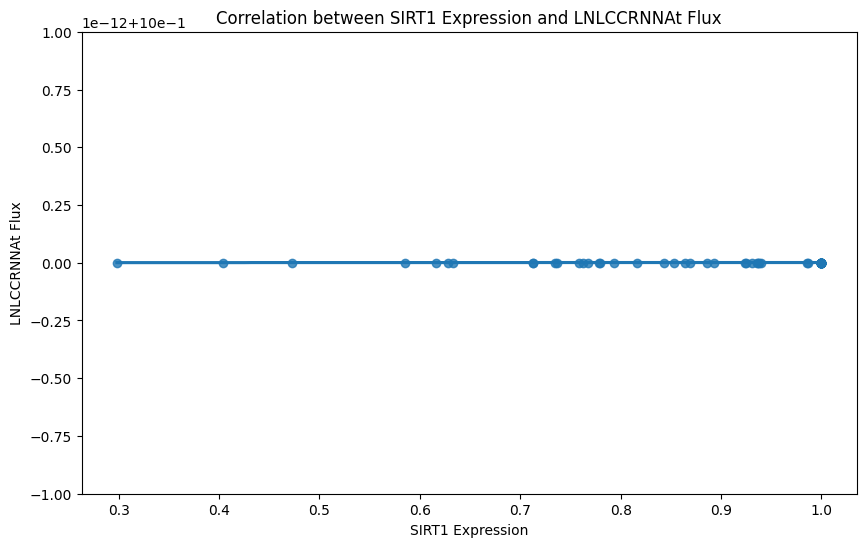

Linear regression results for SIRT1 and LNLCCRNNAt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



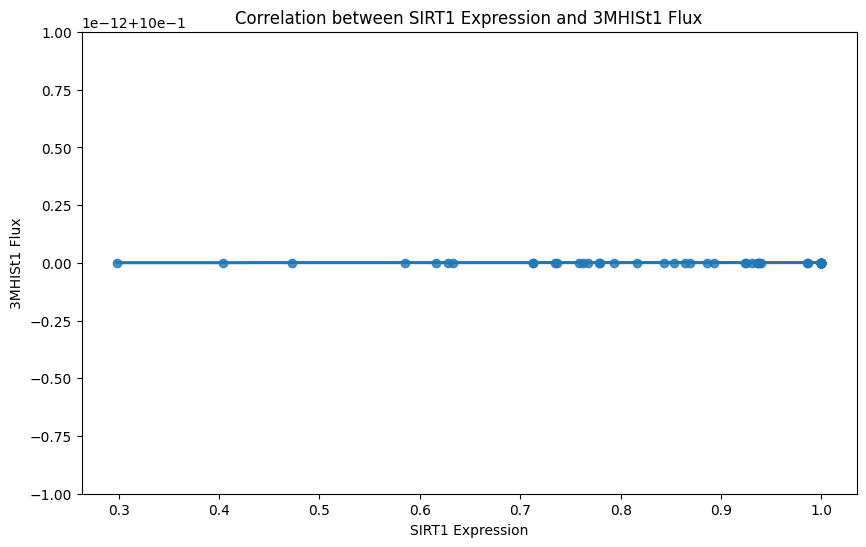

Linear regression results for SIRT1 and 3MHISt1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



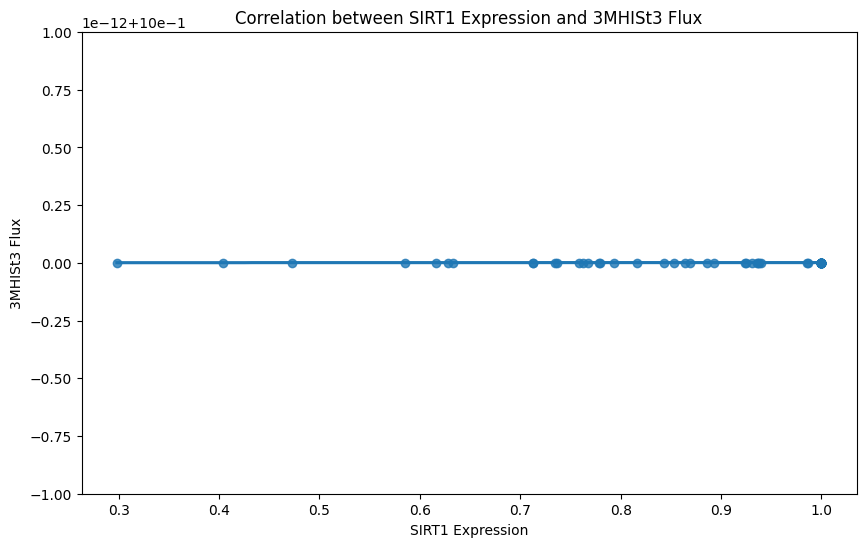

Linear regression results for SIRT1 and 3MHISt3:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



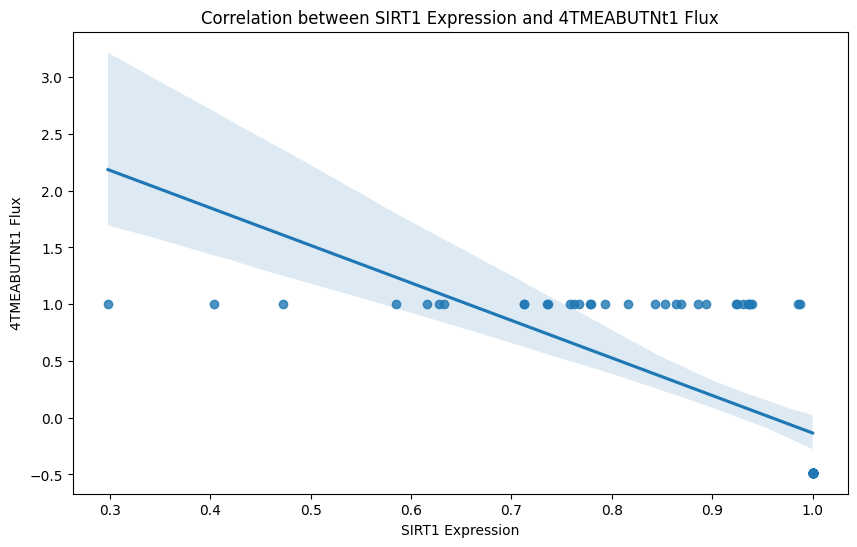

Linear regression results for SIRT1 and 4TMEABUTNt1:
Slope: -3.3067989538485034
Intercept: 3.1718045330167723
R-squared: 0.4927114051469575
P-value: 9.117085759106247e-12
Standard error: 0.4039377924729868



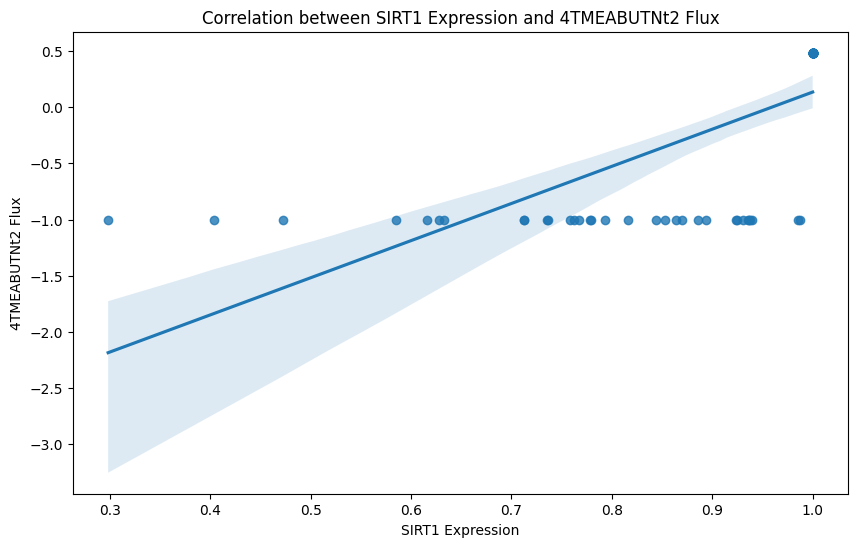

Linear regression results for SIRT1 and 4TMEABUTNt2:
Slope: 3.3067989538485034
Intercept: -3.1718045330167723
R-squared: 0.4927114051469575
P-value: 9.117085759106247e-12
Standard error: 0.4039377924729868



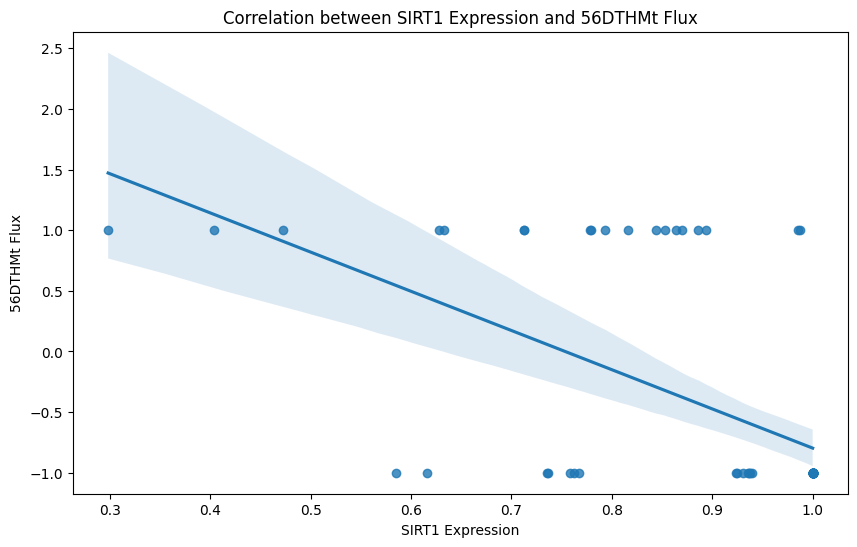

Linear regression results for SIRT1 and 56DTHMt:
Slope: -3.2325813170927473
Intercept: 2.435492647066968
R-squared: 0.3296223045207385
P-value: 1.6530375424502891e-07
Standard error: 0.5549788026482696



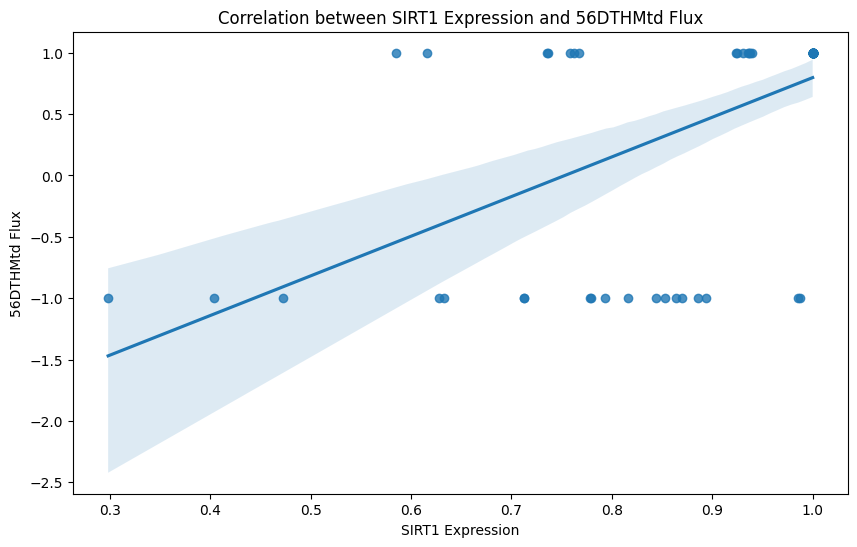

Linear regression results for SIRT1 and 56DTHMtd:
Slope: 3.2307336231346855
Intercept: -2.4334348863056388
R-squared: 0.3294344675927691
P-value: 1.6695320972751055e-07
Standard error: 0.5548974147837841



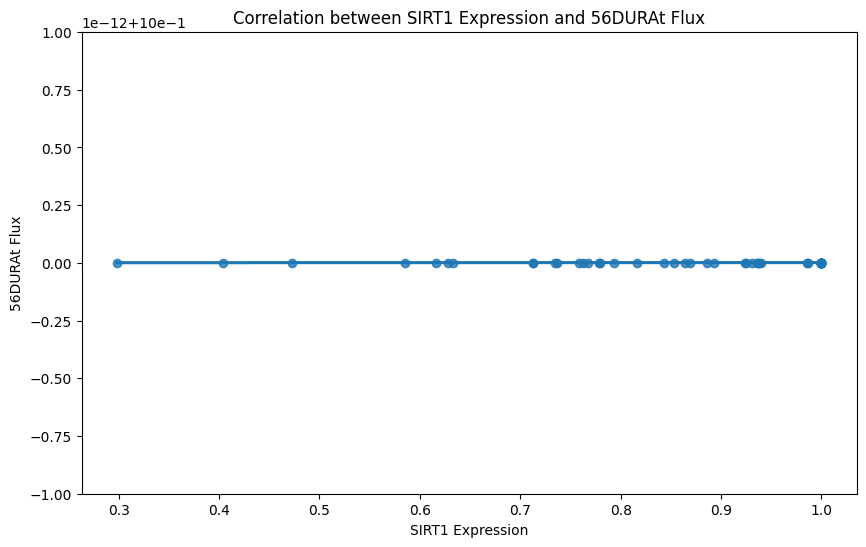

Linear regression results for SIRT1 and 56DURAt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



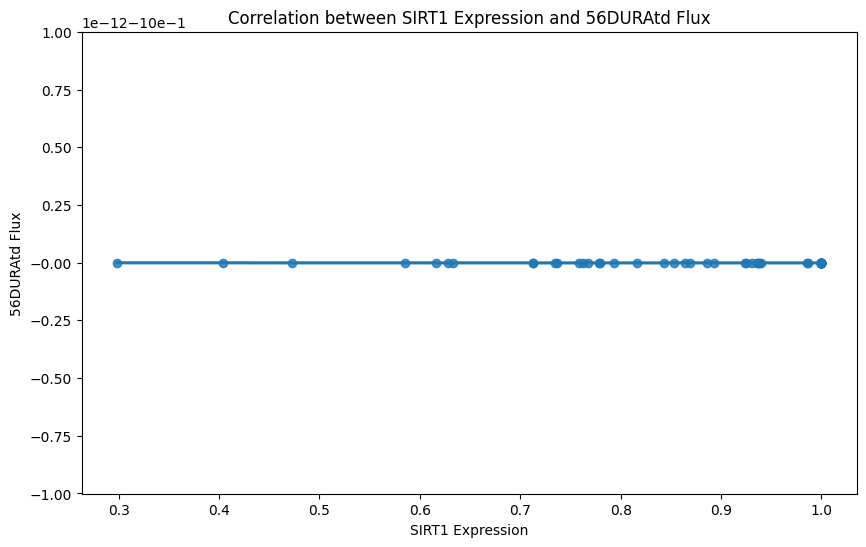

Linear regression results for SIRT1 and 56DURAtd:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



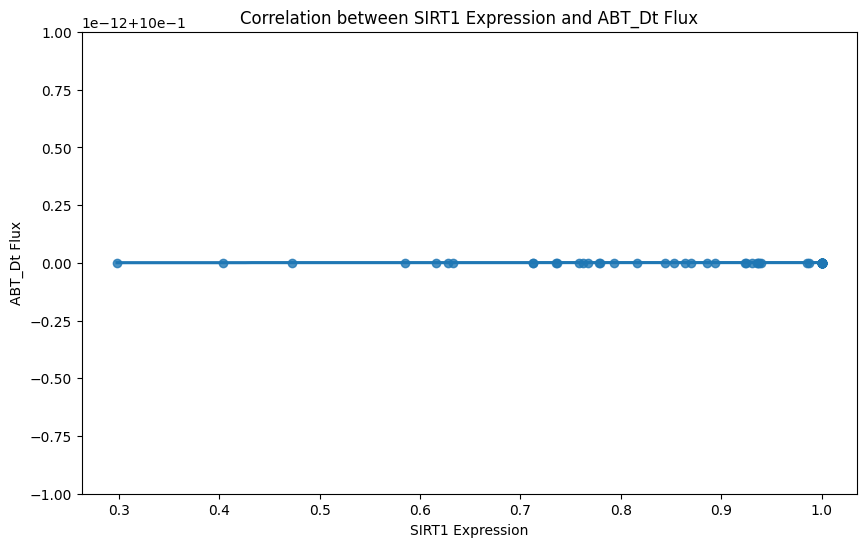

Linear regression results for SIRT1 and ABT_Dt:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



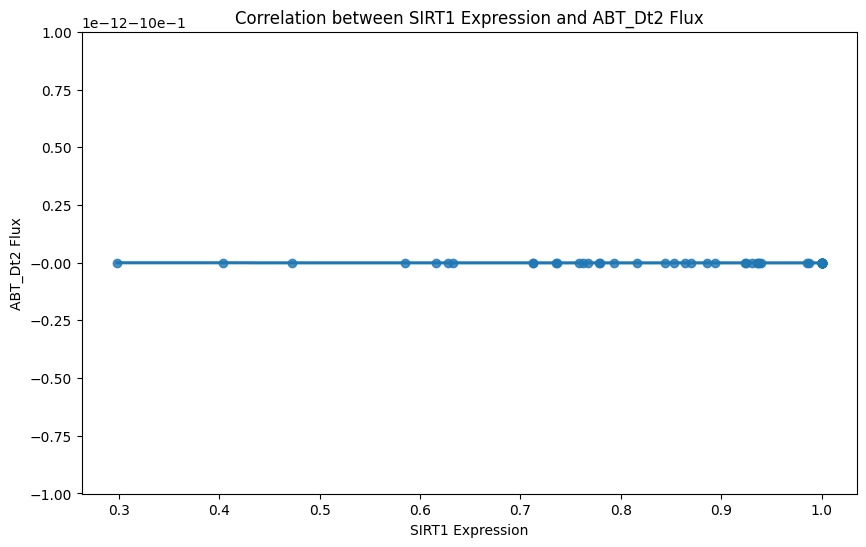

Linear regression results for SIRT1 and ABT_Dt2:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



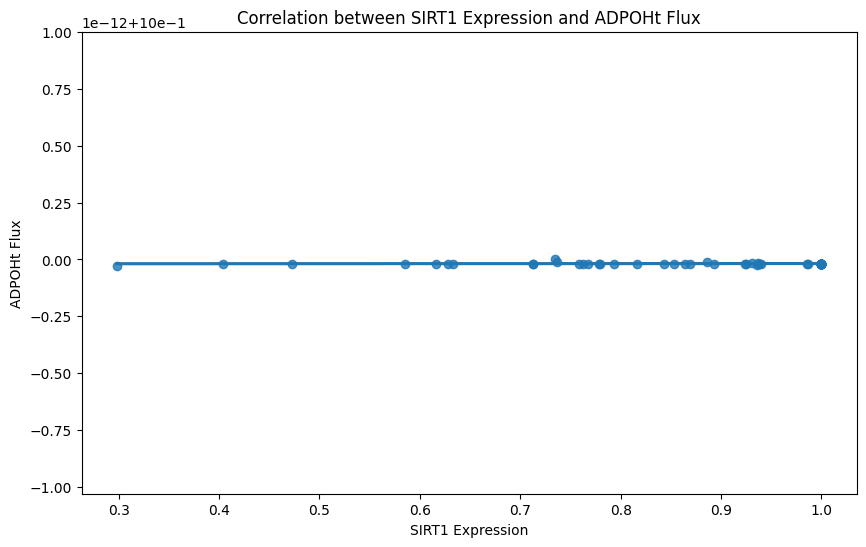

Linear regression results for SIRT1 and ADPOHt:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



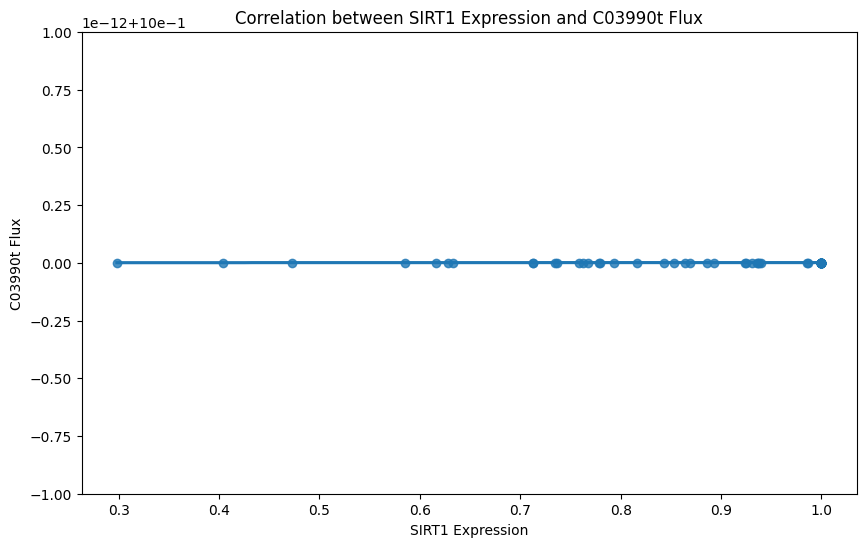

Linear regression results for SIRT1 and C03990t:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



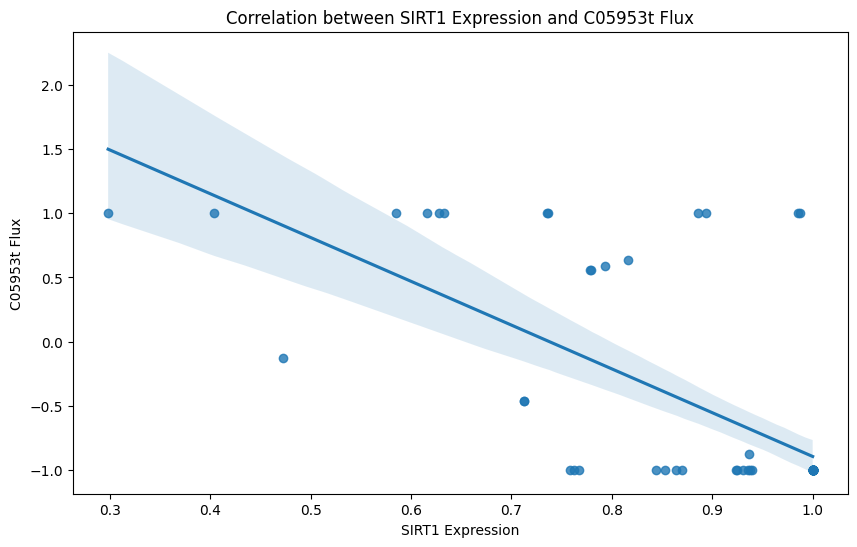

Linear regression results for SIRT1 and C05953t:
Slope: -3.411014425923834
Intercept: 2.516633903209354
R-squared: 0.4579724785377126
P-value: 9.27449795326258e-11
Standard error: 0.44673501102758373



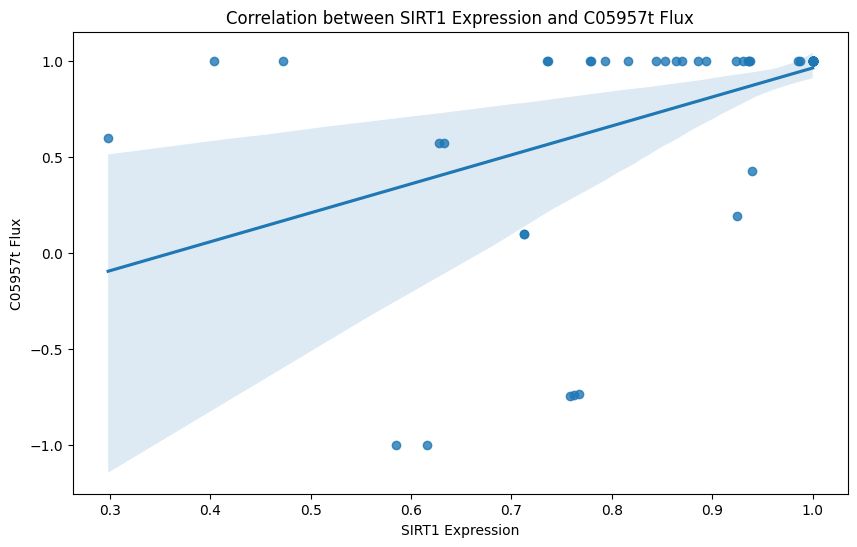

Linear regression results for SIRT1 and C05957t:
Slope: 1.5062653028614008
Intercept: -0.5436020749777561
R-squared: 0.22677799442585597
P-value: 2.6964104236889063e-05
Standard error: 0.33483324699163175



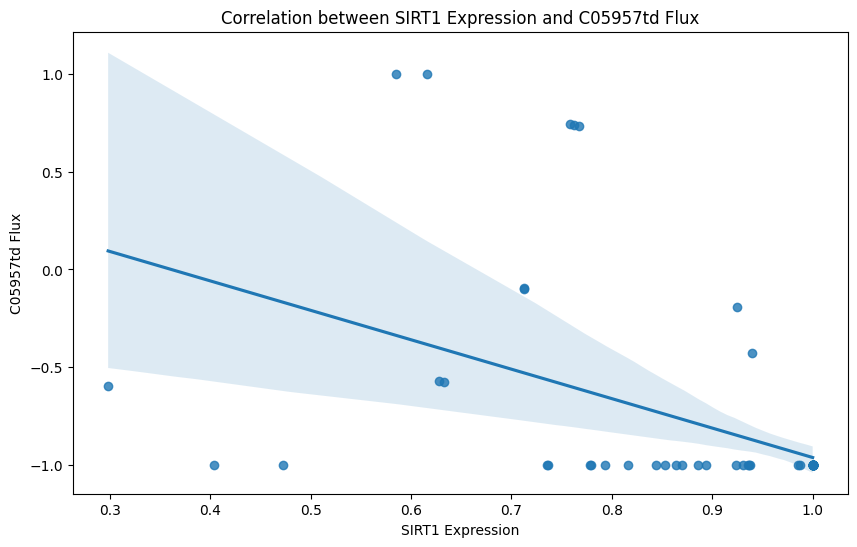

Linear regression results for SIRT1 and C05957td:
Slope: -1.5062653028614008
Intercept: 0.5436020749777561
R-squared: 0.22677799442585597
P-value: 2.6964104236889063e-05
Standard error: 0.33483324699163175



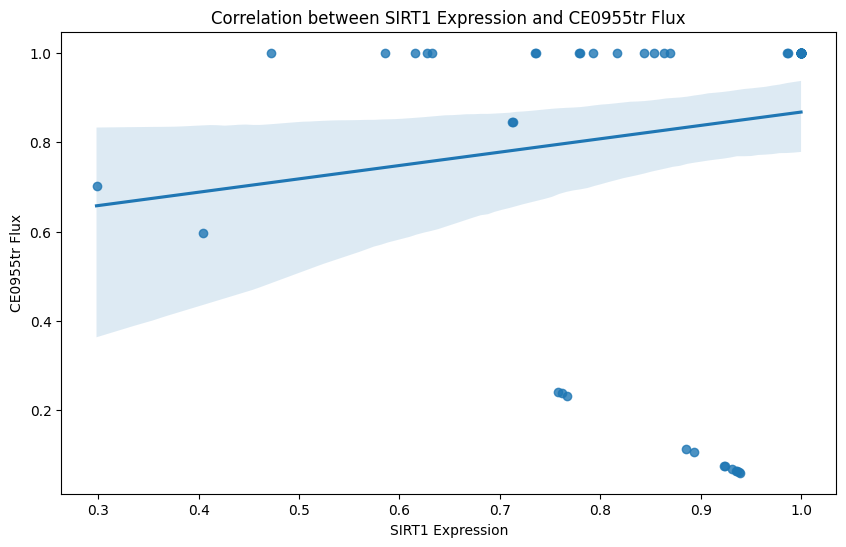

Linear regression results for SIRT1 and CE0955tr:
Slope: 0.2988283087648997
Intercept: 0.5684001410179964
R-squared: 0.020048298828276342
P-value: 0.23885896032543352
Standard error: 0.2515131888983019



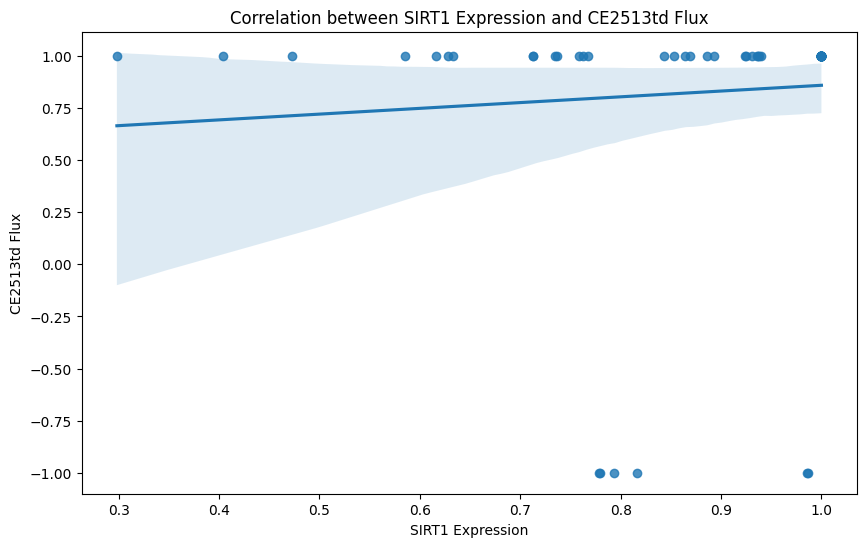

Linear regression results for SIRT1 and CE2513td:
Slope: 0.2768186966455749
Intercept: 0.5826388475604515
R-squared: 0.0061220061797607325
P-value: 0.516608341068919
Standard error: 0.4246103046763848



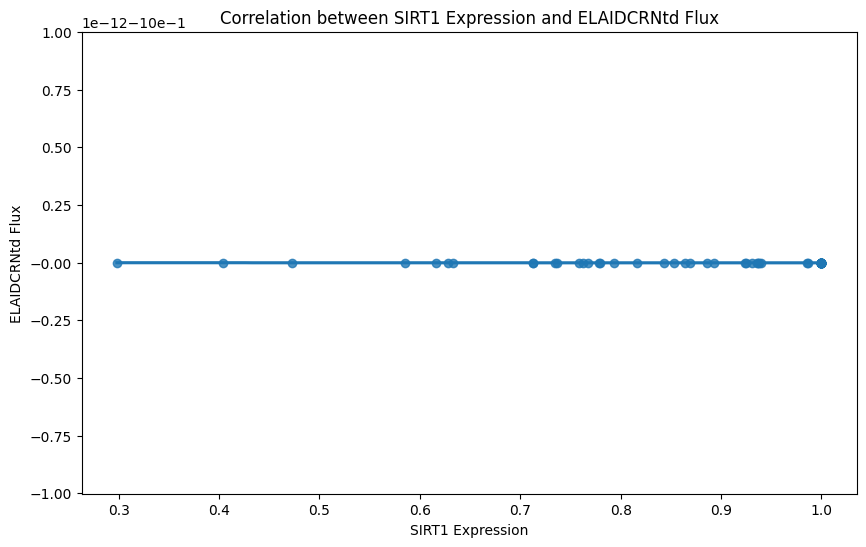

Linear regression results for SIRT1 and ELAIDCRNtd:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



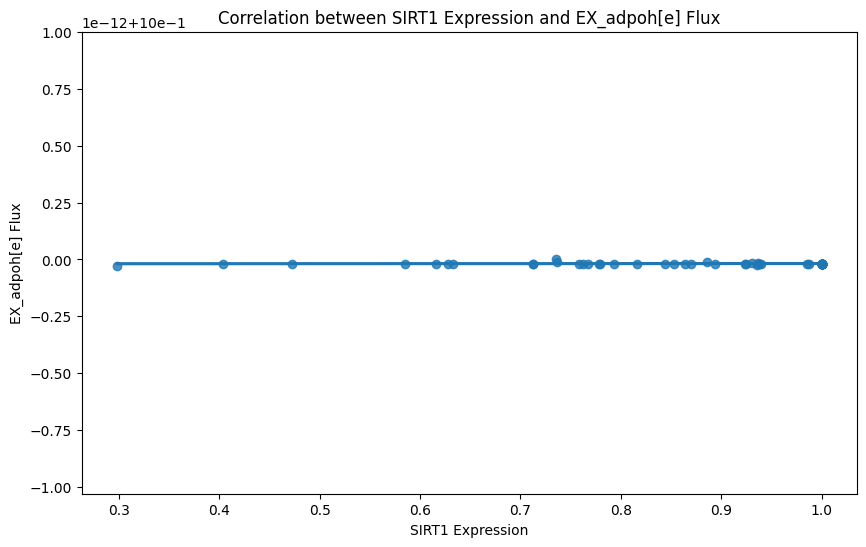

Linear regression results for SIRT1 and EX_adpoh[e]:
Slope: 1.6204385598653227e-15
Intercept: 0.9999999999999808
R-squared: 0.00788010265402158
P-value: 0.4616289689389451
Standard error: 2.188891153329398e-15



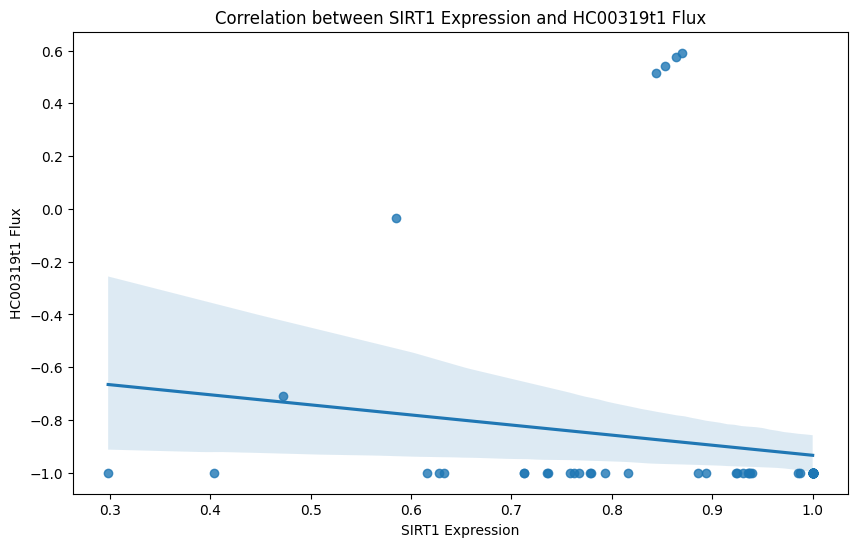

Linear regression results for SIRT1 and HC00319t1:
Slope: -0.3822704703609577
Intercept: -0.5516698203029925
R-squared: 0.025865407665583835
P-value: 0.18029706688482244
Standard error: 0.28242037449920804



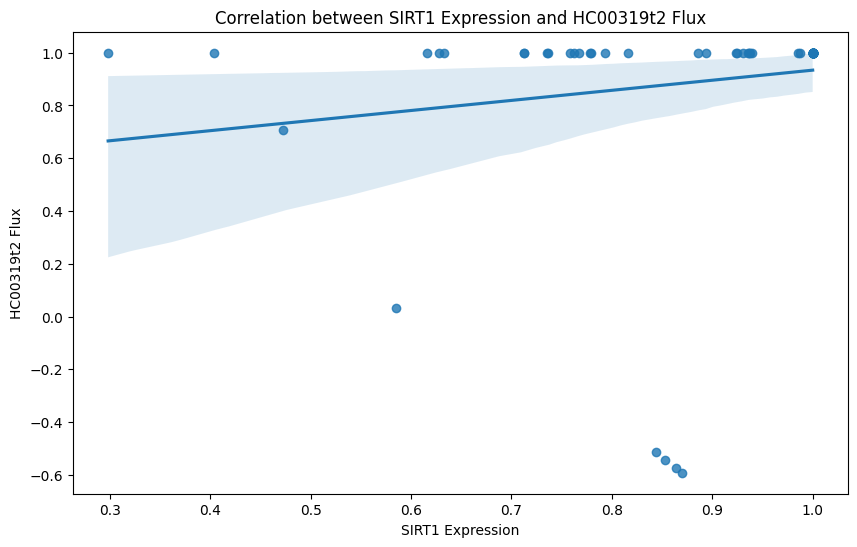

Linear regression results for SIRT1 and HC00319t2:
Slope: 0.3822704703609577
Intercept: 0.5516698203029925
R-squared: 0.025865407665583835
P-value: 0.18029706688482244
Standard error: 0.28242037449920804



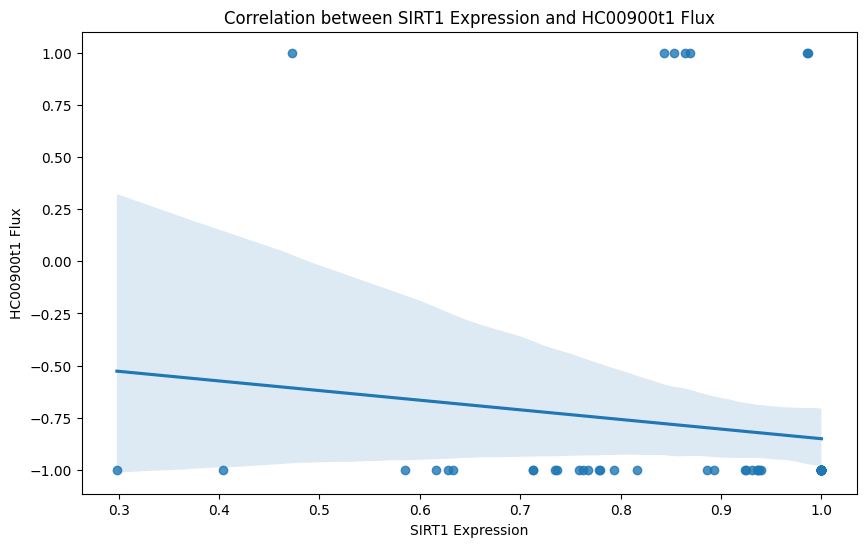

Linear regression results for SIRT1 and HC00900t1:
Slope: -0.46161039929051473
Intercept: -0.3886845086902966
R-squared: 0.014819743467555544
P-value: 0.3118590108948715
Standard error: 0.4530942446855674



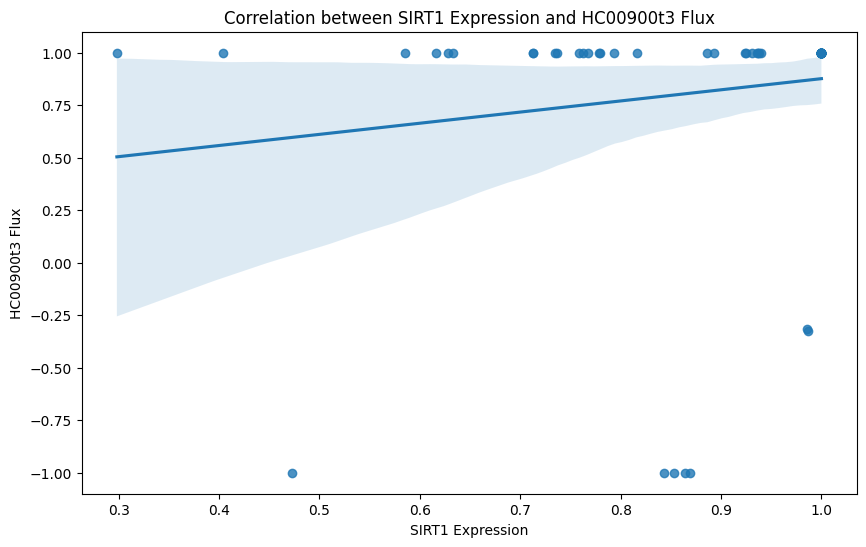

Linear regression results for SIRT1 and HC00900t3:
Slope: 0.5306460655979359
Intercept: 0.34588239771982754
R-squared: 0.02327357235870189
P-value: 0.20404949427595148
Standard error: 0.41384274638193913



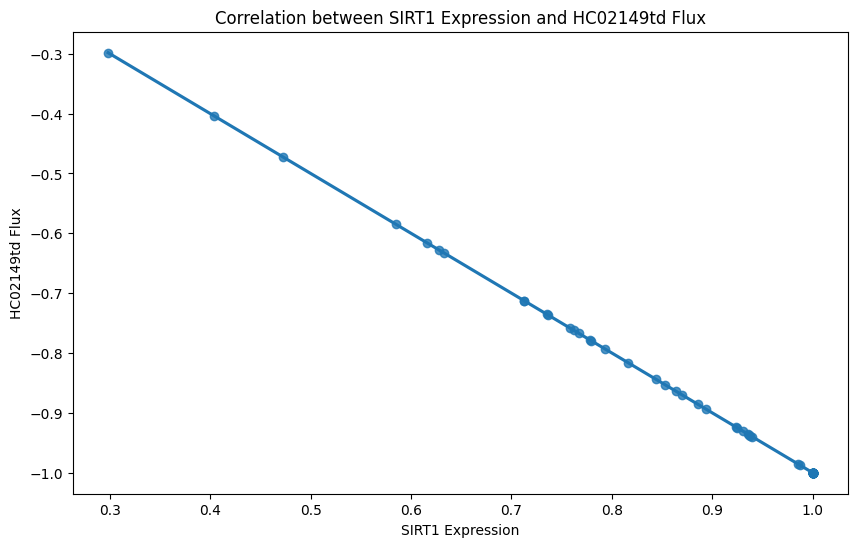

Linear regression results for SIRT1 and HC02149td:
Slope: -1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



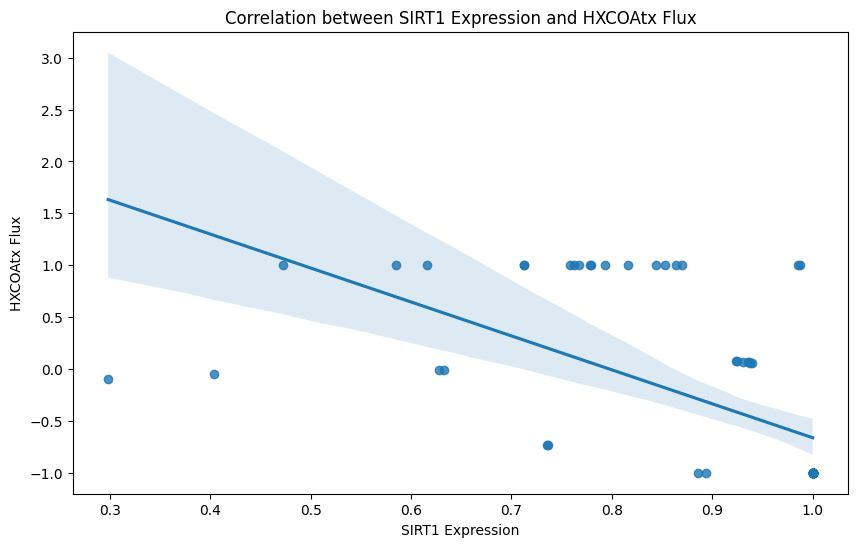

Linear regression results for SIRT1 and HXCOAtx:
Slope: -3.271563379581881
Intercept: 2.608662973769068
R-squared: 0.3644068356170004
P-value: 2.5103488056072926e-08
Standard error: 0.5201482531731898



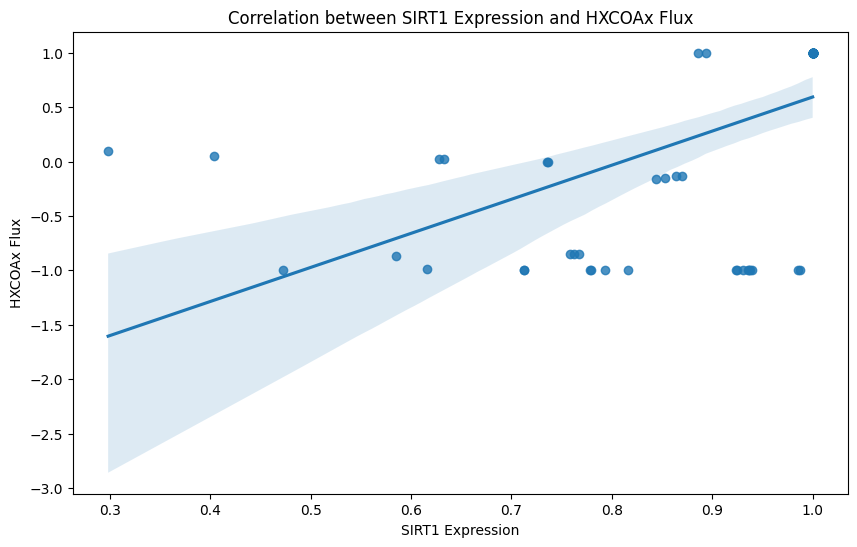

Linear regression results for SIRT1 and HXCOAx:
Slope: 3.1318203511800835
Intercept: -2.5386489990057726
R-squared: 0.3146393564590331
P-value: 3.620703857086909e-07
Standard error: 0.5564489853311089



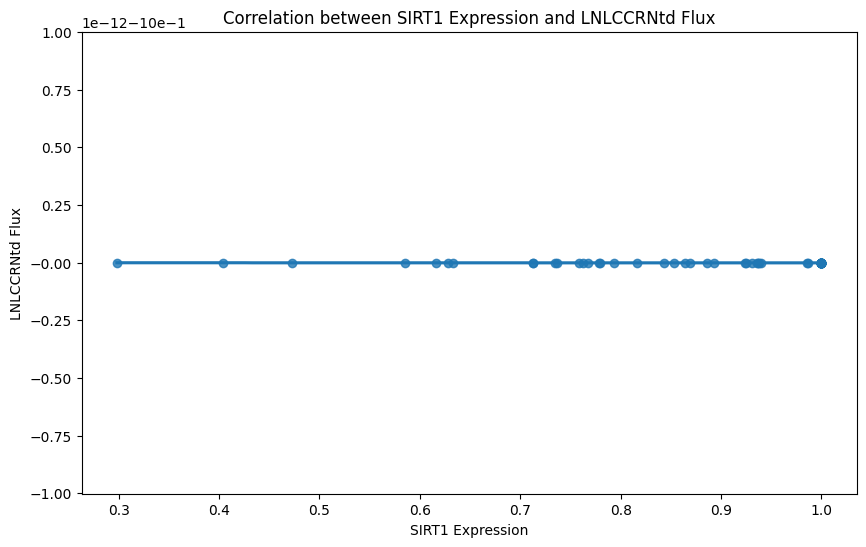

Linear regression results for SIRT1 and LNLCCRNtd:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



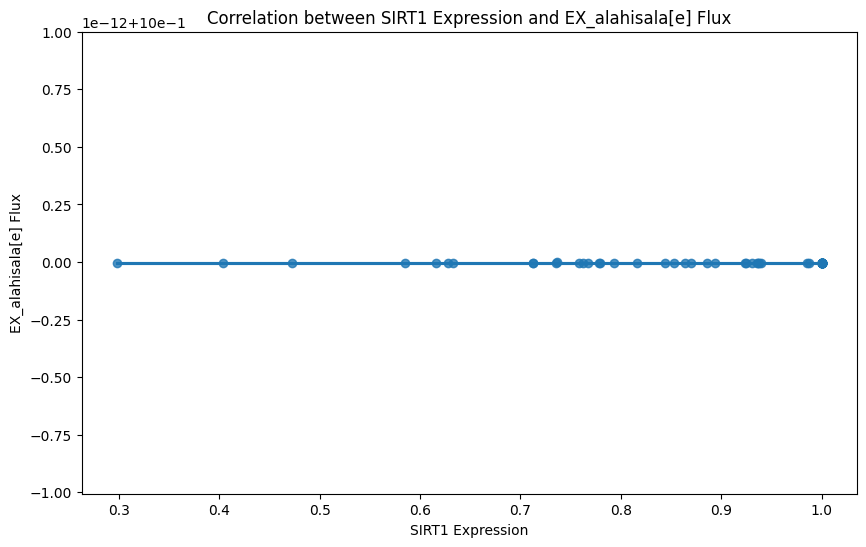

Linear regression results for SIRT1 and EX_alahisala[e]:
Slope: 2.23703817373021e-16
Intercept: 0.9999999999999956
R-squared: 0.0016308501877343004
P-value: 0.7380956099443488
Standard error: 6.663269701936384e-16



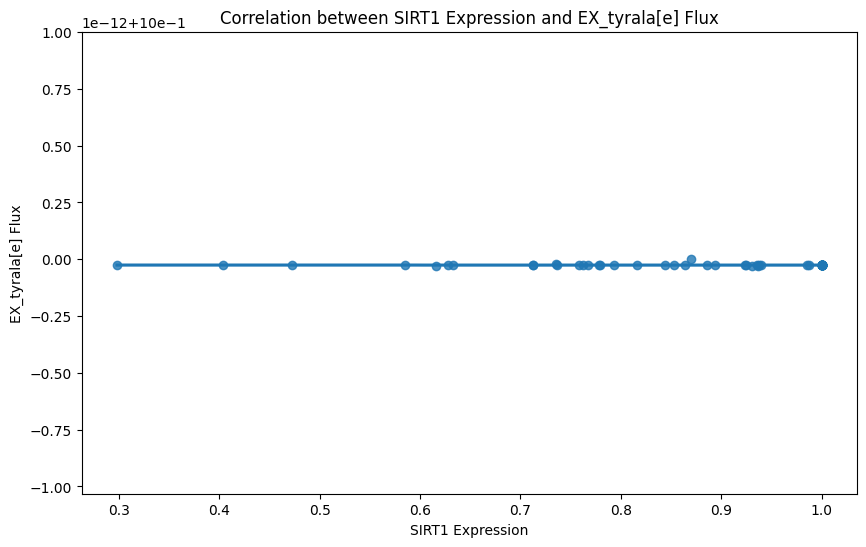

Linear regression results for SIRT1 and EX_tyrala[e]:
Slope: 3.8801113965521055e-16
Intercept: 0.9999999999999745
R-squared: 0.0003547596392253568
P-value: 0.8761088382927154
Standard error: 2.4795650018112636e-15



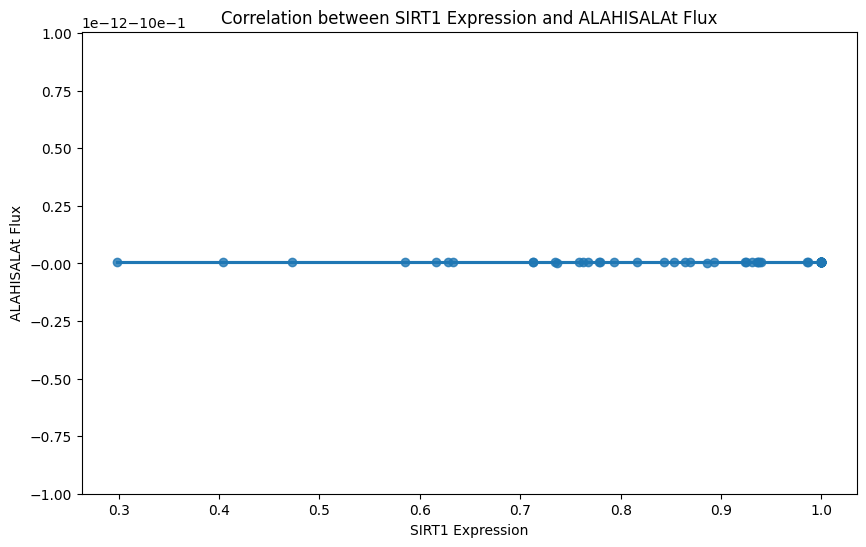

Linear regression results for SIRT1 and ALAHISALAt:
Slope: -2.23703817373021e-16
Intercept: -0.9999999999999956
R-squared: 0.0016308501877343004
P-value: 0.7380956099443488
Standard error: 6.663269701936384e-16



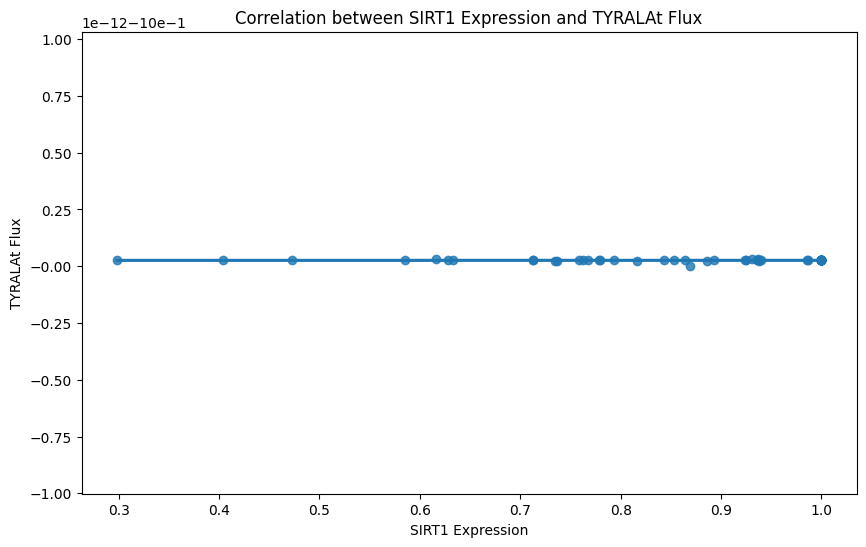

Linear regression results for SIRT1 and TYRALAt:
Slope: -3.8801113965521055e-16
Intercept: -0.9999999999999745
R-squared: 0.0003547596392253568
P-value: 0.8761088382927154
Standard error: 2.4795650018112636e-15



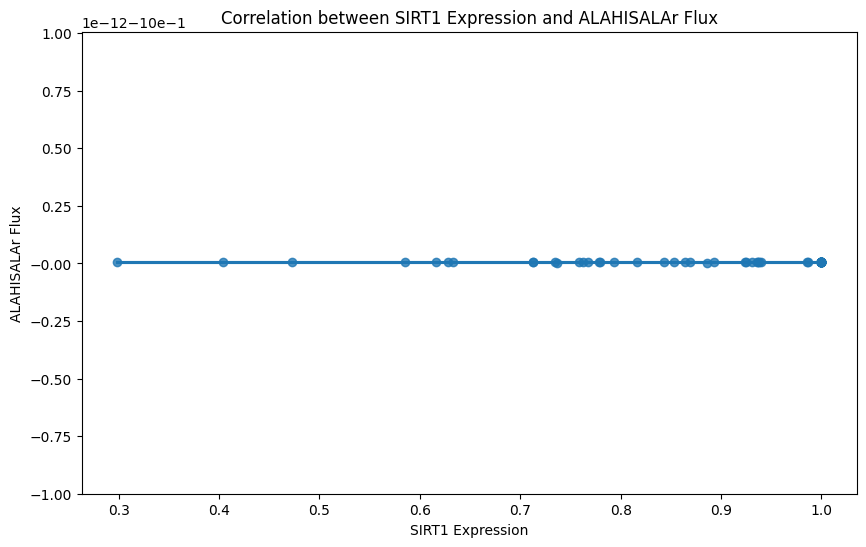

Linear regression results for SIRT1 and ALAHISALAr:
Slope: -2.23703817373021e-16
Intercept: -0.9999999999999956
R-squared: 0.0016308501877343004
P-value: 0.7380956099443488
Standard error: 6.663269701936384e-16



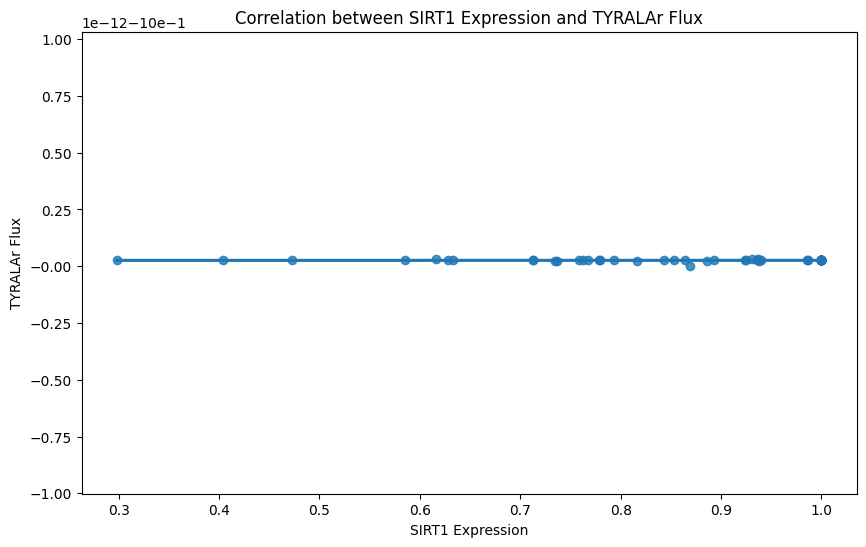

Linear regression results for SIRT1 and TYRALAr:
Slope: -3.8801113965521055e-16
Intercept: -0.9999999999999745
R-squared: 0.0003547596392253568
P-value: 0.8761088382927154
Standard error: 2.4795650018112636e-15



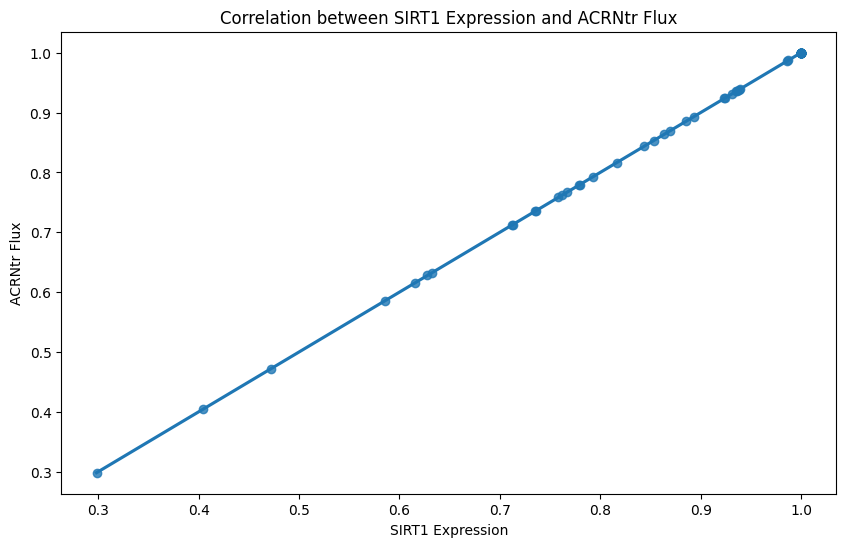

Linear regression results for SIRT1 and ACRNtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



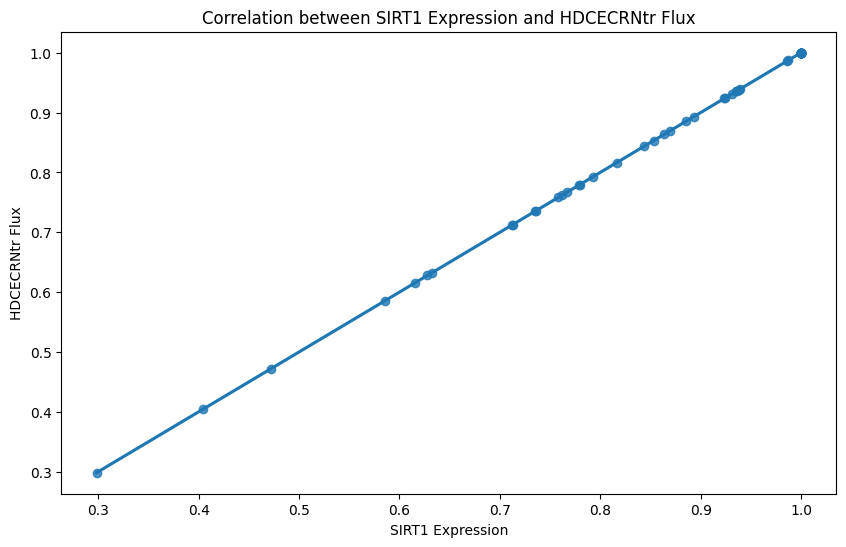

Linear regression results for SIRT1 and HDCECRNtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



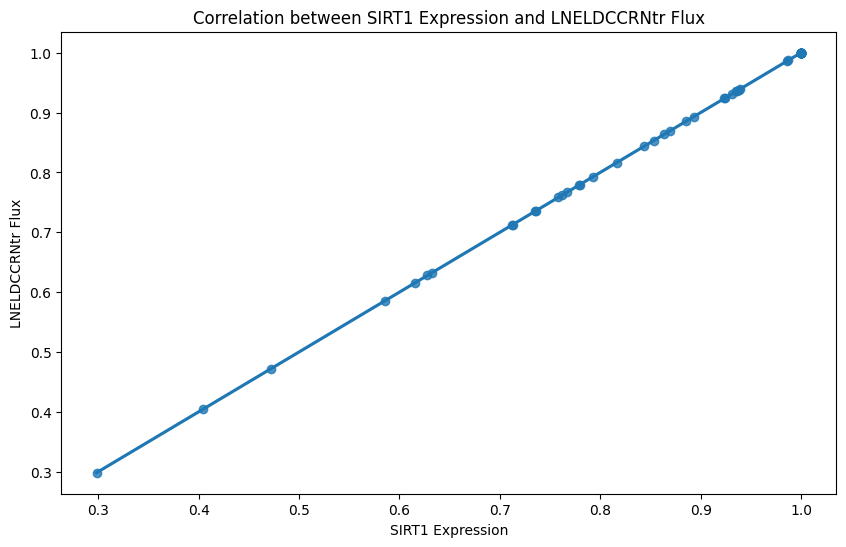

Linear regression results for SIRT1 and LNELDCCRNtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



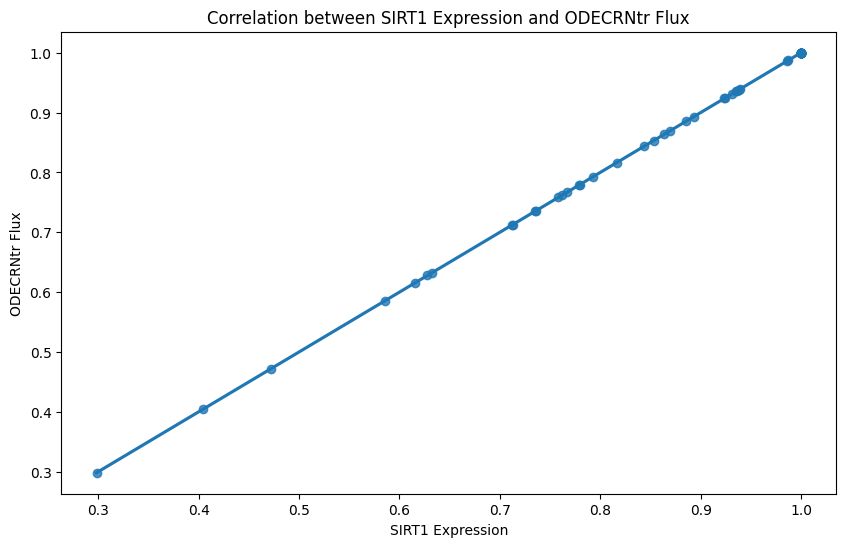

Linear regression results for SIRT1 and ODECRNtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



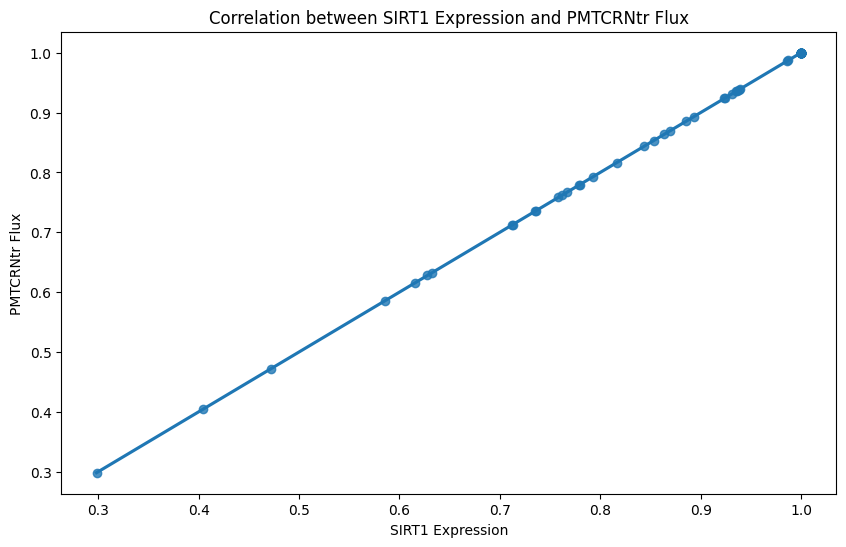

Linear regression results for SIRT1 and PMTCRNtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



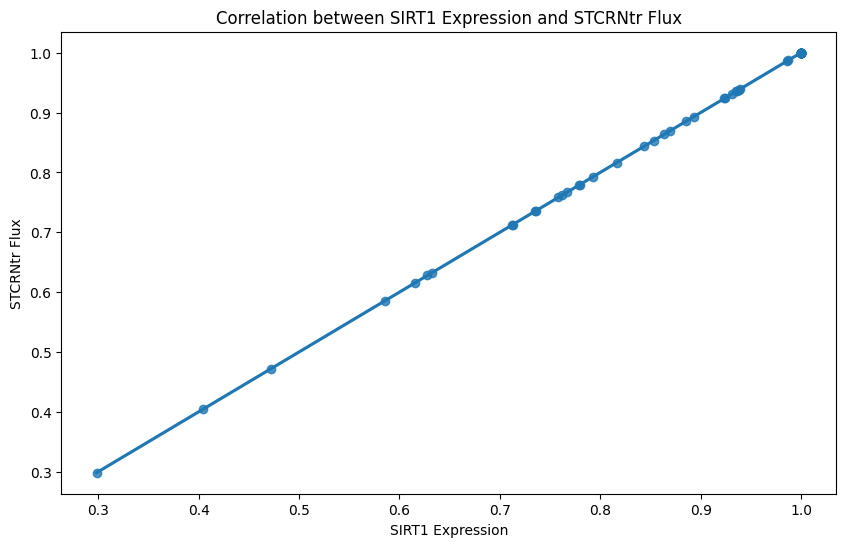

Linear regression results for SIRT1 and STCRNtr:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



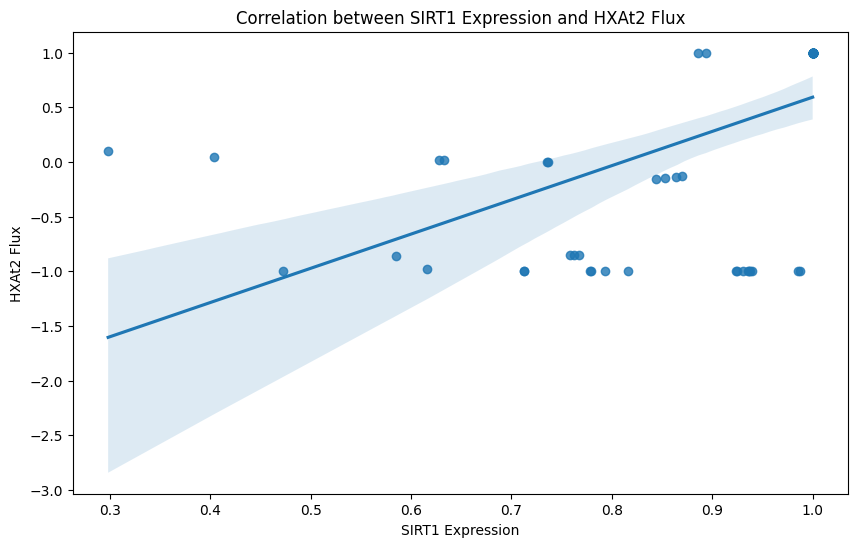

Linear regression results for SIRT1 and HXAt2:
Slope: 3.1318203511800835
Intercept: -2.5386489990057726
R-squared: 0.3146393564590331
P-value: 3.620703857086909e-07
Standard error: 0.5564489853311089



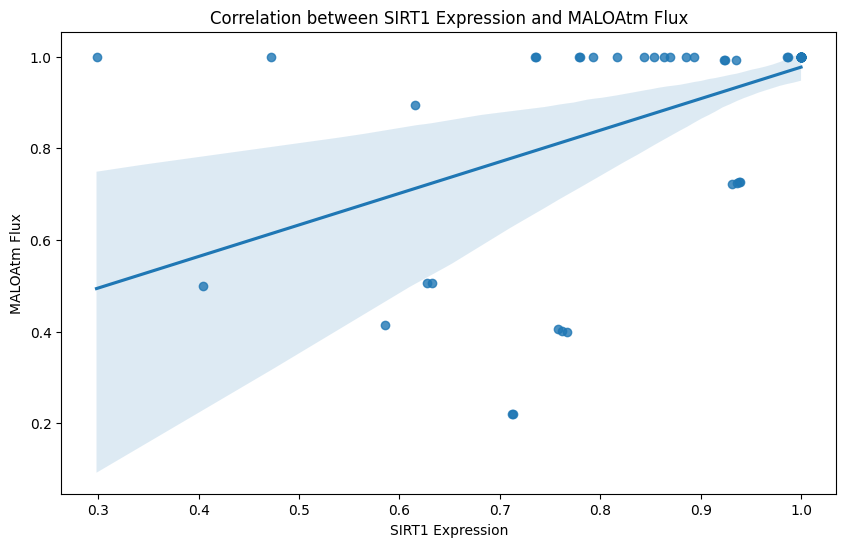

Linear regression results for SIRT1 and MALOAtm:
Slope: 0.6882370861924407
Intercept: 0.28878541116027
R-squared: 0.27196459708912046
P-value: 3.110669163027536e-06
Standard error: 0.1355606330963958



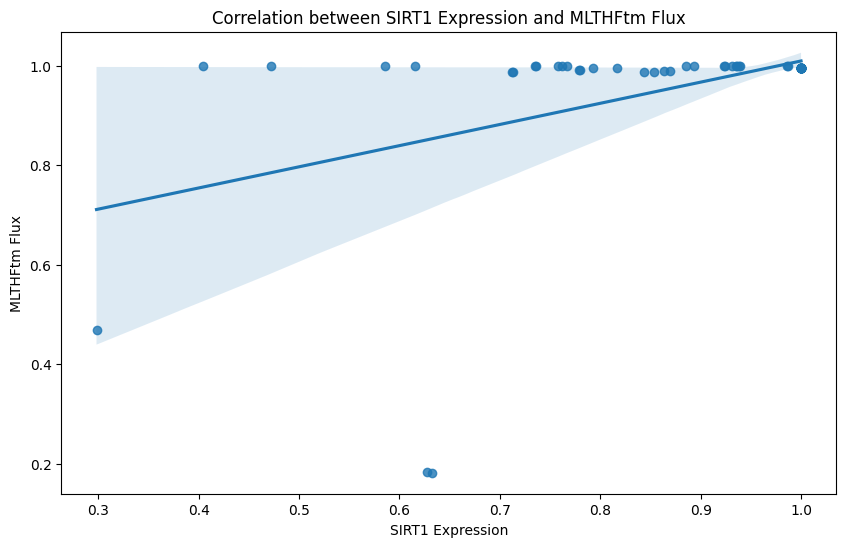

Linear regression results for SIRT1 and MLTHFtm:
Slope: 0.4253018157025075
Intercept: 0.5838995779441263
R-squared: 0.20656820255971736
P-value: 6.846847016256139e-05
Standard error: 0.10034500449964028



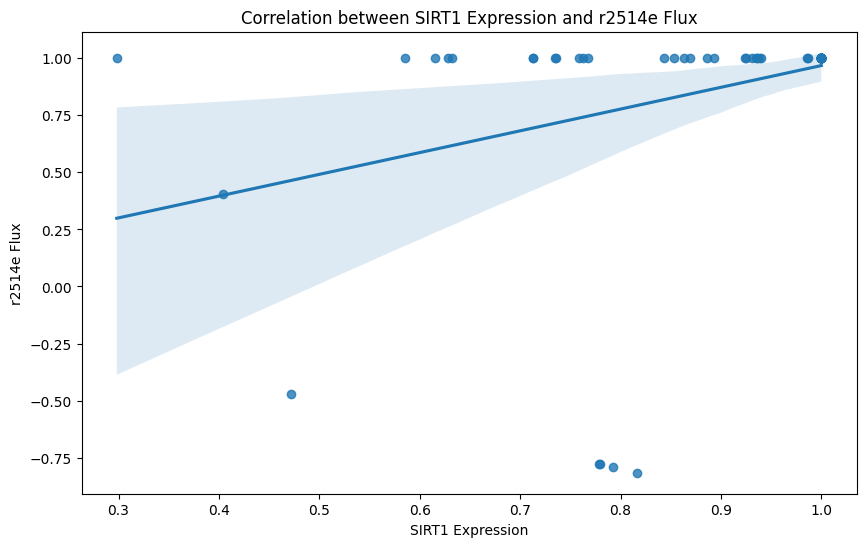

Linear regression results for SIRT1 and r2514e:
Slope: 0.9534529183715814
Intercept: 0.014536463712314096
R-squared: 0.11266006138455206
P-value: 0.004215859638656483
Standard error: 0.32213263857866425



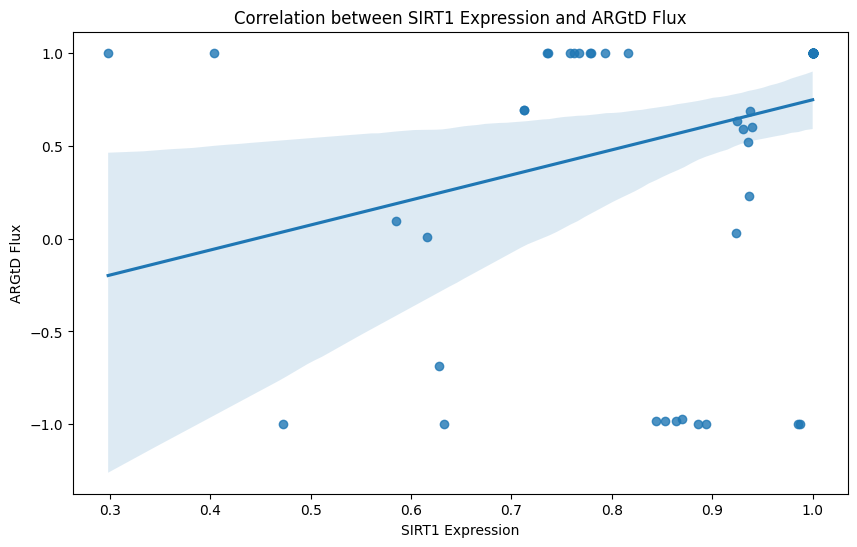

Linear regression results for SIRT1 and ARGtD:
Slope: 1.347649759153116
Intercept: -0.6008104038696727
R-squared: 0.08881641310632613
P-value: 0.011594953924623223
Standard error: 0.5196474754766389



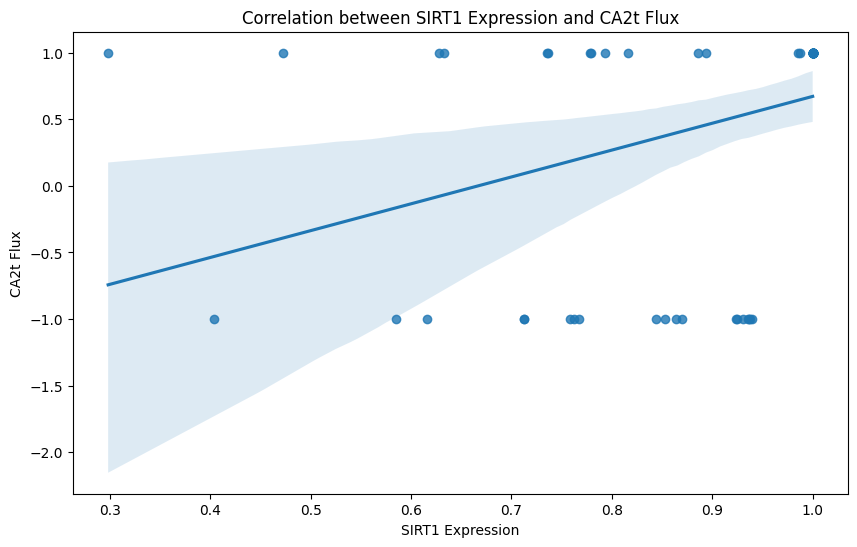

Linear regression results for SIRT1 and CA2t:
Slope: 2.0160158913860986
Intercept: -1.3438739106933262
R-squared: 0.12817357251701517
P-value: 0.002173607776085203
Standard error: 0.6329729863897641



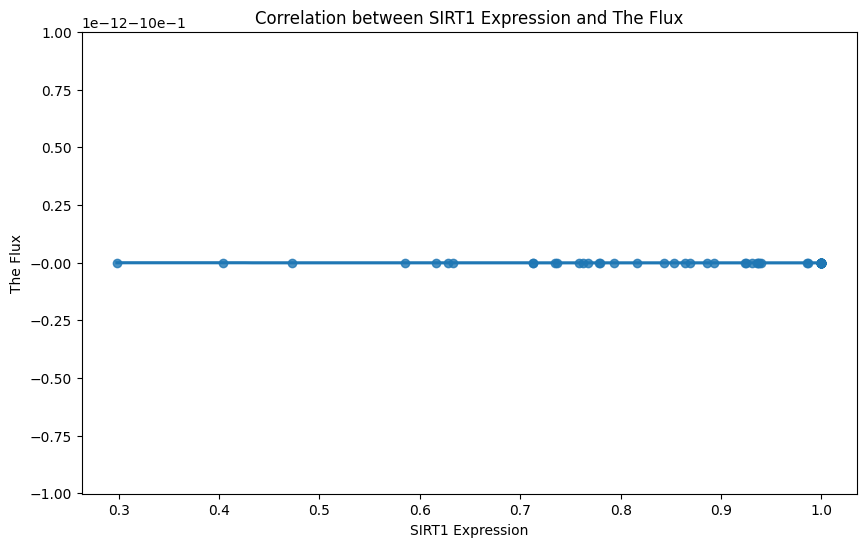

Linear regression results for SIRT1 and The:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



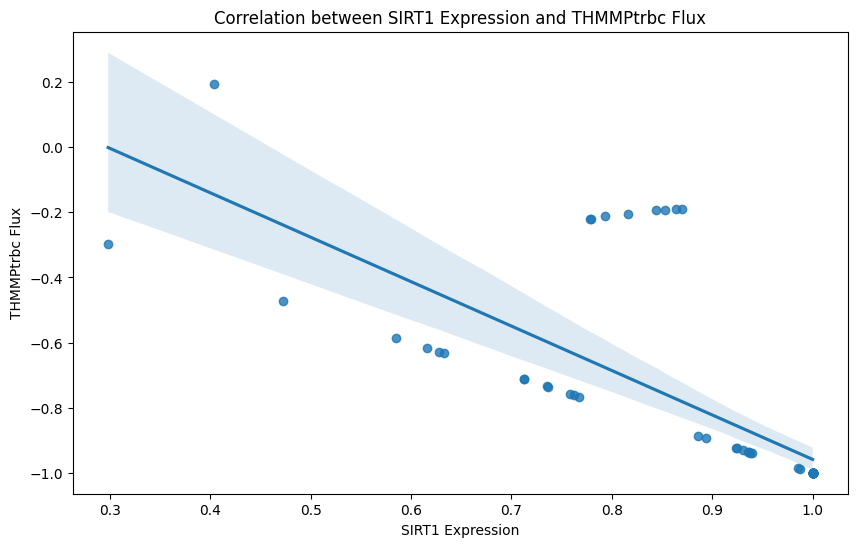

Linear regression results for SIRT1 and THMMPtrbc:
Slope: -1.365533297754923
Intercept: 0.40638165581787544
R-squared: 0.5394936152212938
P-value: 3.1009992664346997e-13
Standard error: 0.15188064142399077



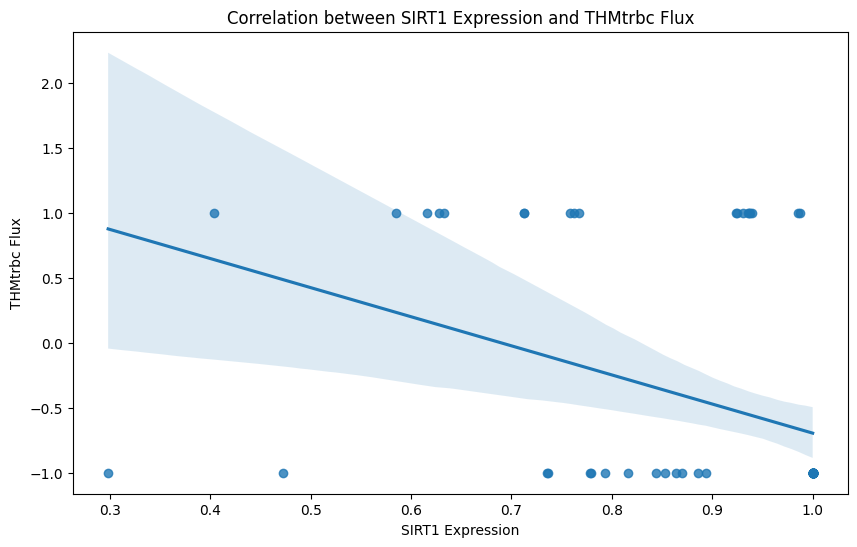

Linear regression results for SIRT1 and THMtrbc:
Slope: -2.24038714803932
Intercept: 1.54516791428985
R-squared: 0.15829118576489026
P-value: 0.0005905441586727479
Standard error: 0.6219437367333217



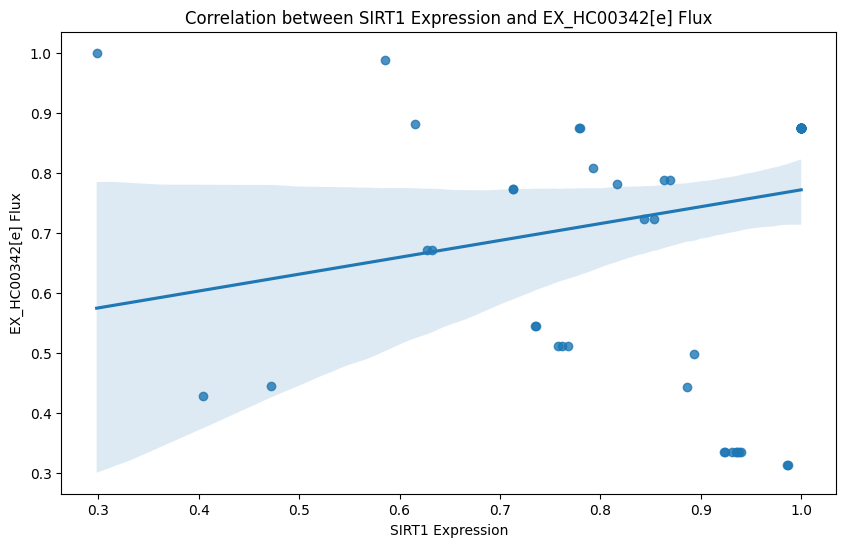

Linear regression results for SIRT1 and EX_HC00342[e]:
Slope: 0.2807774833569001
Intercept: 0.4910145437030513
R-squared: 0.046729836273422865
P-value: 0.07019808971977733
Standard error: 0.15266820597603534



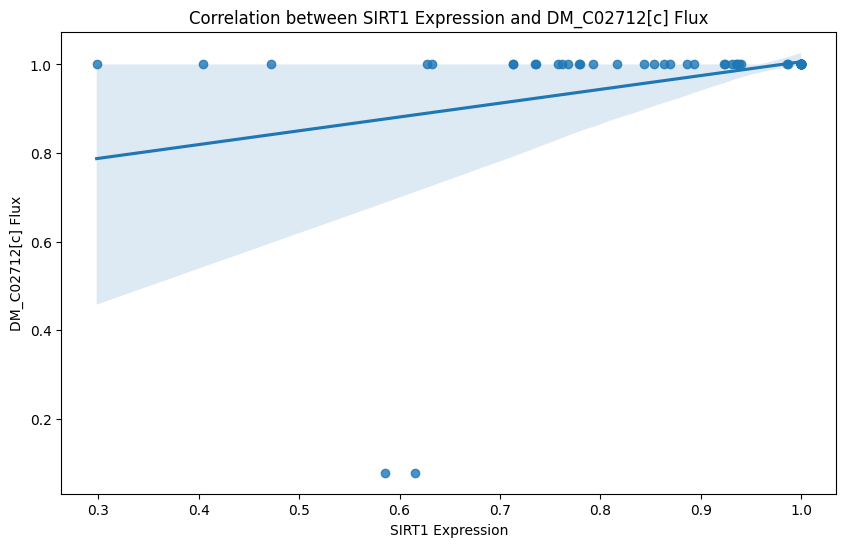

Linear regression results for SIRT1 and DM_C02712[c]:
Slope: 0.3114991030699578
Intercept: 0.6945828616841048
R-squared: 0.10320675955939364
P-value: 0.006300115862973329
Standard error: 0.1105412438062919



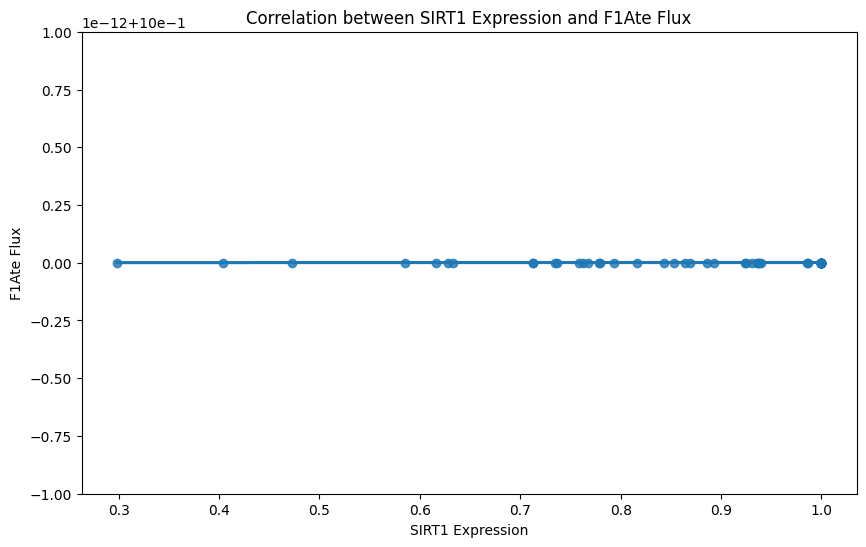

Linear regression results for SIRT1 and F1Ate:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



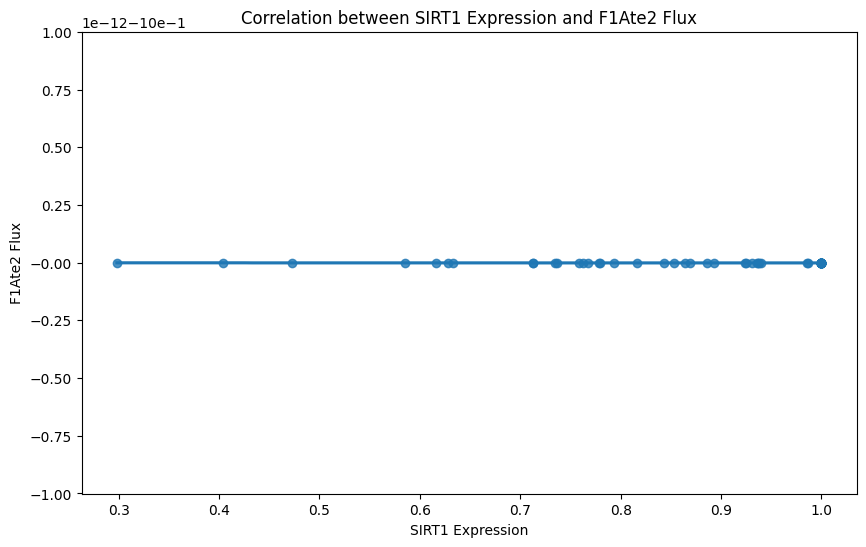

Linear regression results for SIRT1 and F1Ate2:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



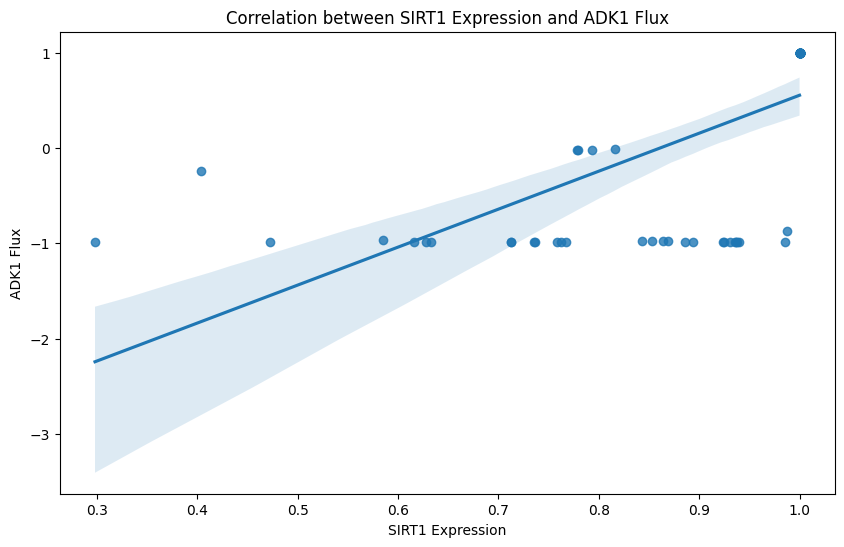

Linear regression results for SIRT1 and ADK1:
Slope: 3.9864790471228044
Intercept: -3.432833858951931
R-squared: 0.43858820512516766
P-value: 3.1813564208957896e-10
Standard error: 0.542971747742503



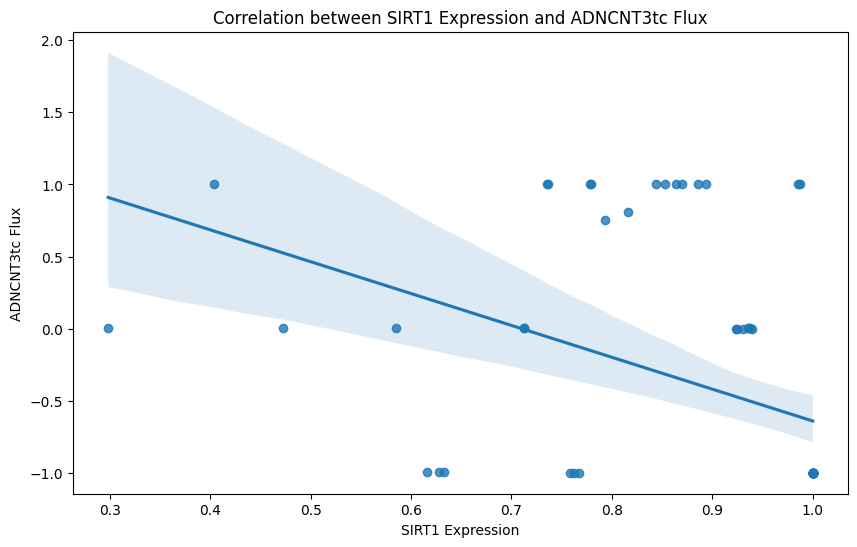

Linear regression results for SIRT1 and ADNCNT3tc:
Slope: -2.21009915668392
Intercept: 1.5689695385333238
R-squared: 0.1865616001488726
P-value: 0.00016912221635606144
Standard error: 0.5555695307249775



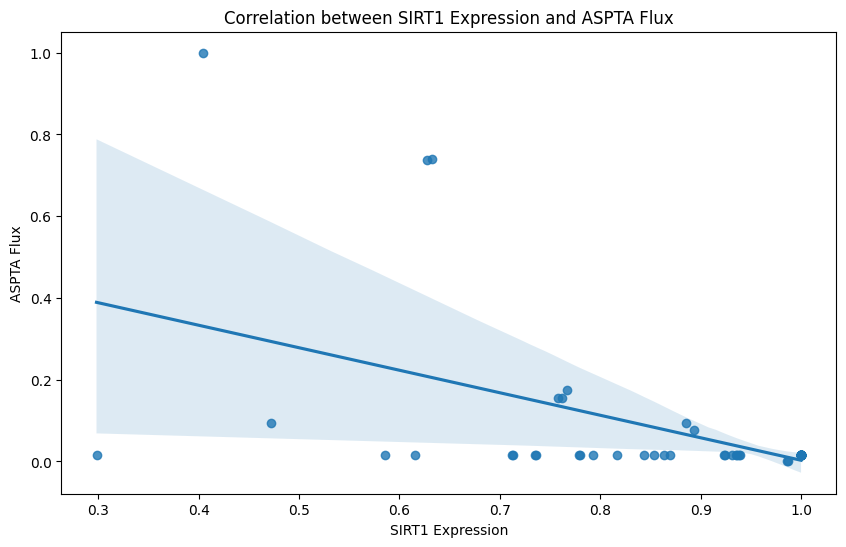

Linear regression results for SIRT1 and ASPTA:
Slope: -0.5505995958909472
Intercept: 0.553523320909457
R-squared: 0.27134865734131397
P-value: 3.2060731070610394e-06
Standard error: 0.10861939742875987



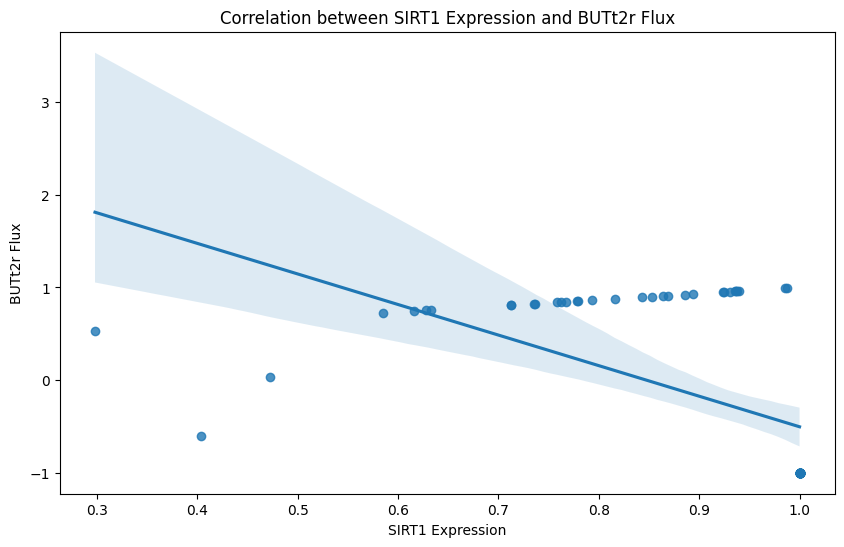

Linear regression results for SIRT1 and BUTt2r:
Slope: -3.30019166716741
Intercept: 2.796202271176203
R-squared: 0.31844550215881573
P-value: 2.971290629197728e-07
Standard error: 0.581229103836448



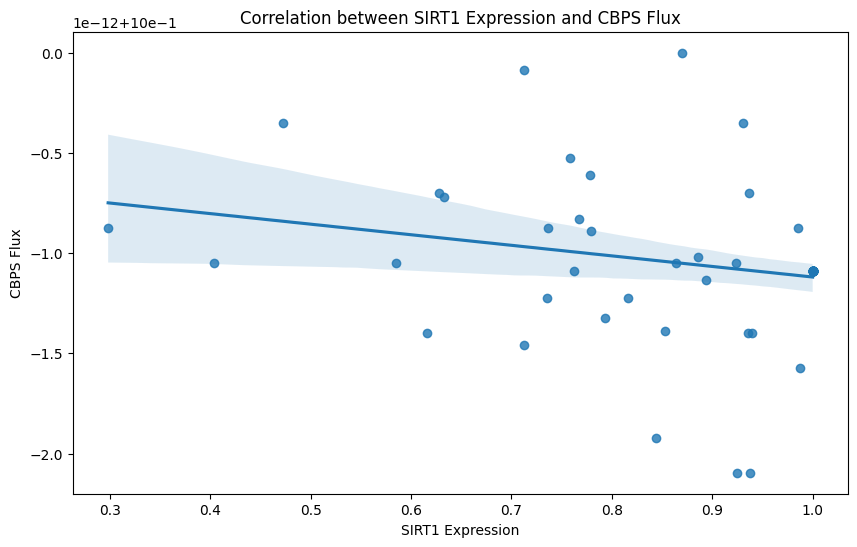

Linear regression results for SIRT1 and CBPS:
Slope: -5.277829540545984e-13
Intercept: 0.9999999999994079
R-squared: 0.06079076289091417
P-value: 0.03819330844196844
Standard error: 2.4974292565829327e-13



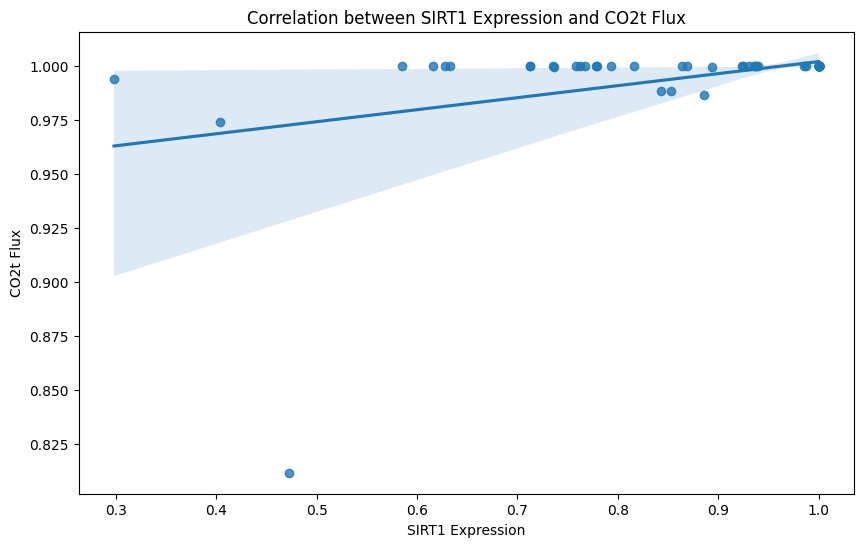

Linear regression results for SIRT1 and CO2t:
Slope: 0.05571194978494795
Intercept: 0.9463901332518703
R-squared: 0.15261815080940297
P-value: 0.0007563879291645673
Standard error: 0.015803755339212307



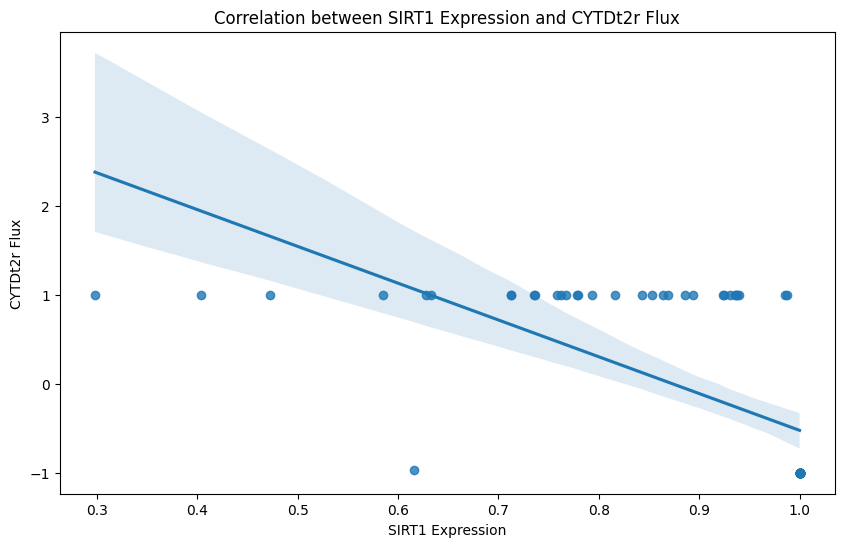

Linear regression results for SIRT1 and CYTDt2r:
Slope: -4.136871651203458
Intercept: 3.6131839655747555
R-squared: 0.4275663075845064
P-value: 6.296716597029649e-10
Standard error: 0.5762465757398693



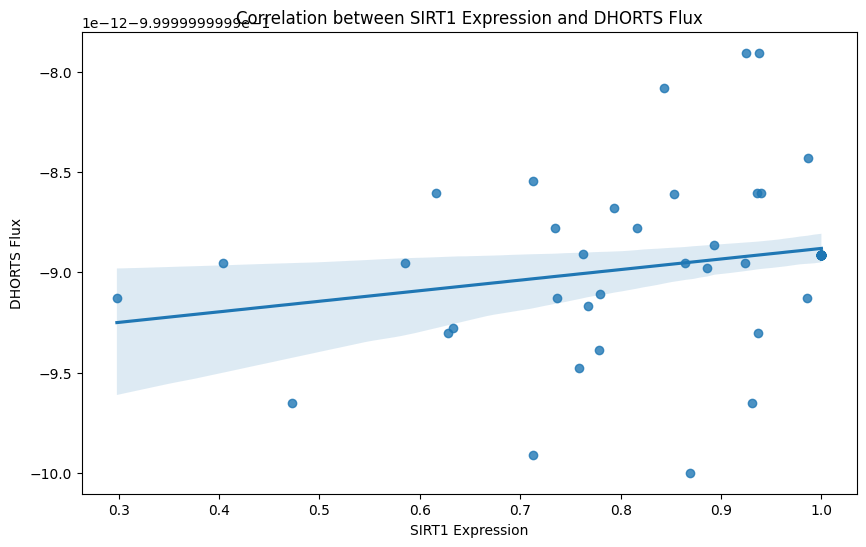

Linear regression results for SIRT1 and DHORTS:
Slope: 5.277829540545984e-13
Intercept: -0.9999999999994079
R-squared: 0.06079076289091417
P-value: 0.03819330844196844
Standard error: 2.4974292565829327e-13



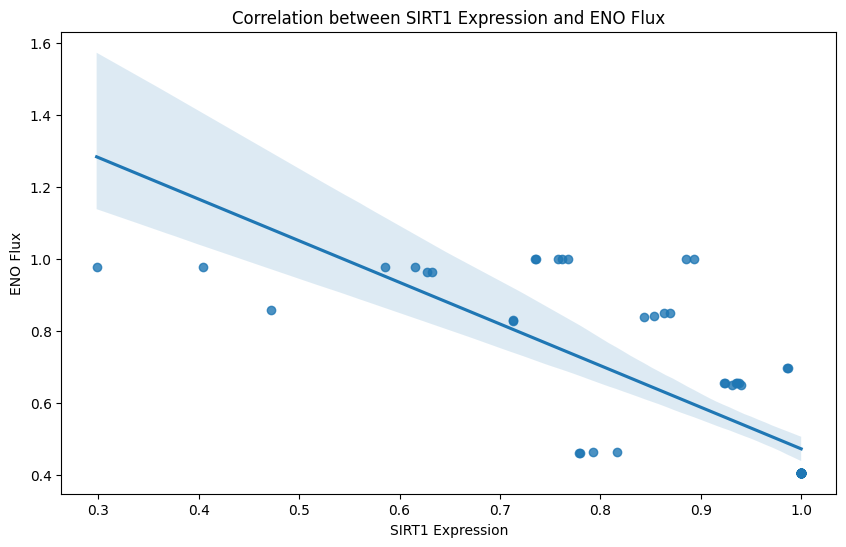

Linear regression results for SIRT1 and ENO:
Slope: -1.1556028070895772
Intercept: 1.62751645342935
R-squared: 0.6003465583924817
P-value: 2.2173807710872436e-15
Standard error: 0.11350756541146852



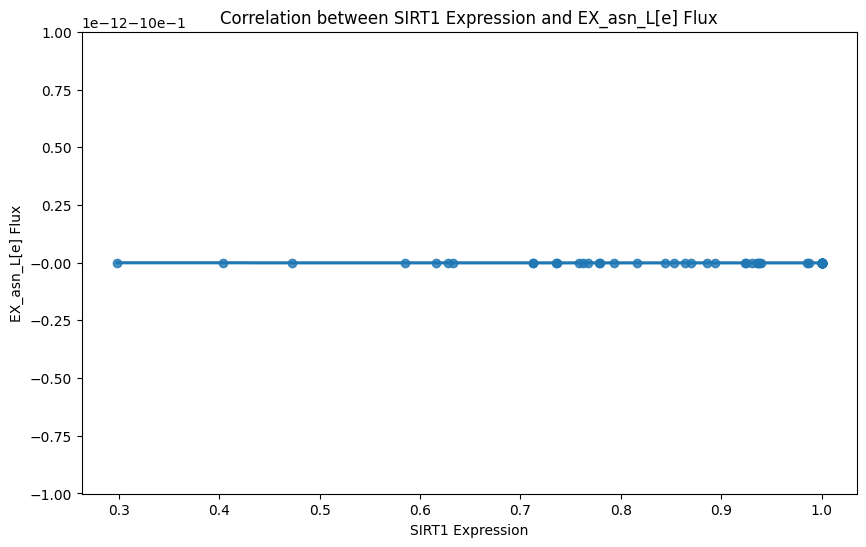

Linear regression results for SIRT1 and EX_asn_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



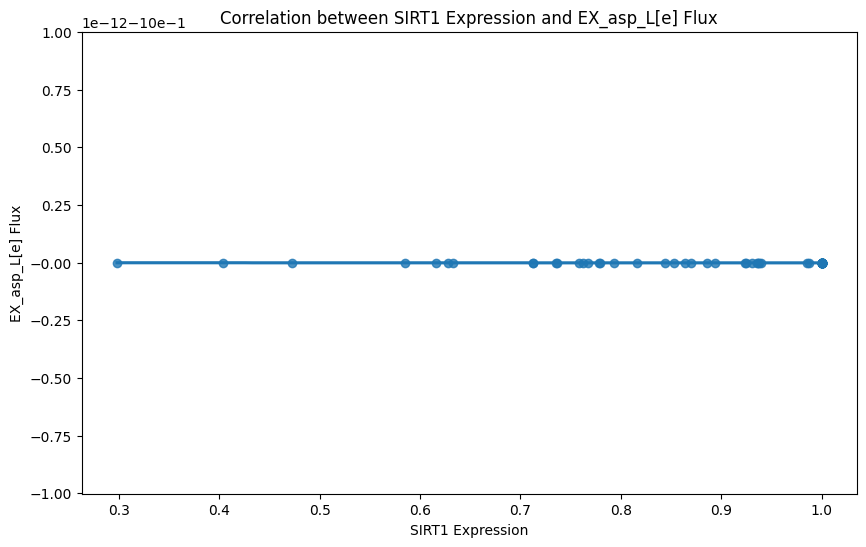

Linear regression results for SIRT1 and EX_asp_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



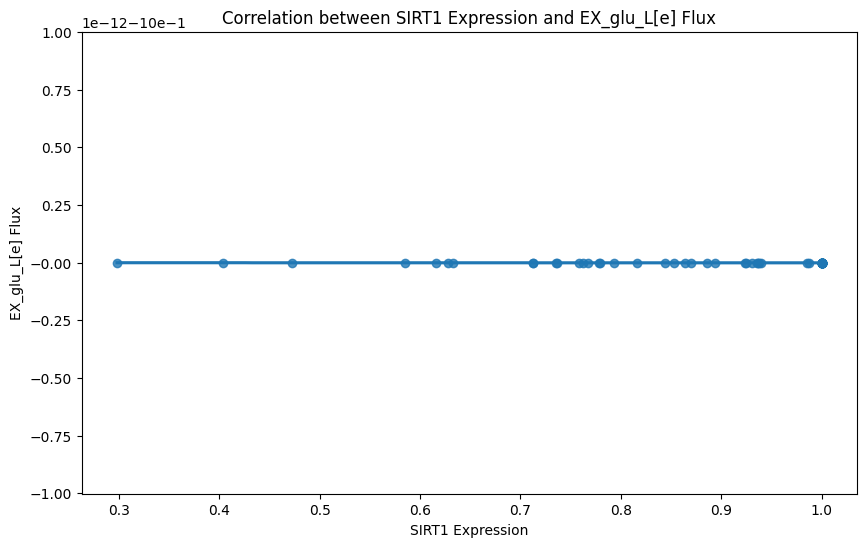

Linear regression results for SIRT1 and EX_glu_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



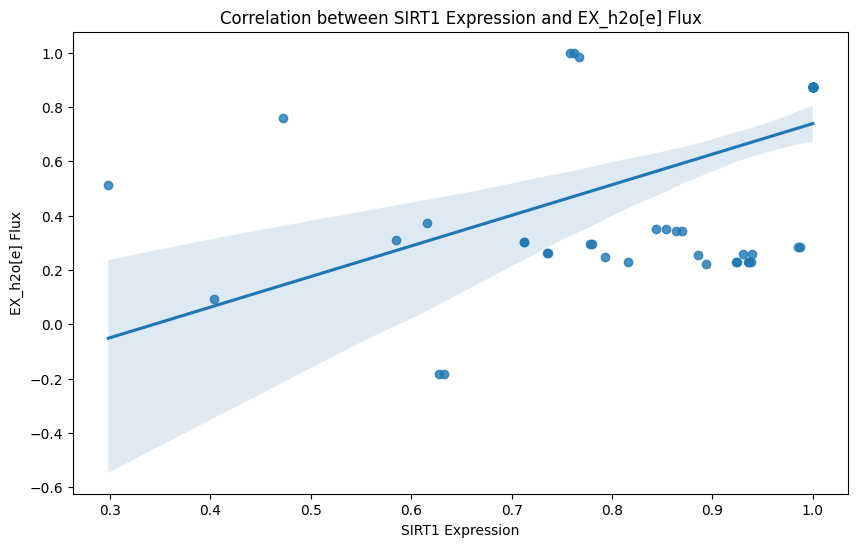

Linear regression results for SIRT1 and EX_h2o[e]:
Slope: 1.126722638408256
Intercept: -0.38766294478353436
R-squared: 0.29912258457399693
P-value: 8.022962386386917e-07
Standard error: 0.20762942706083784



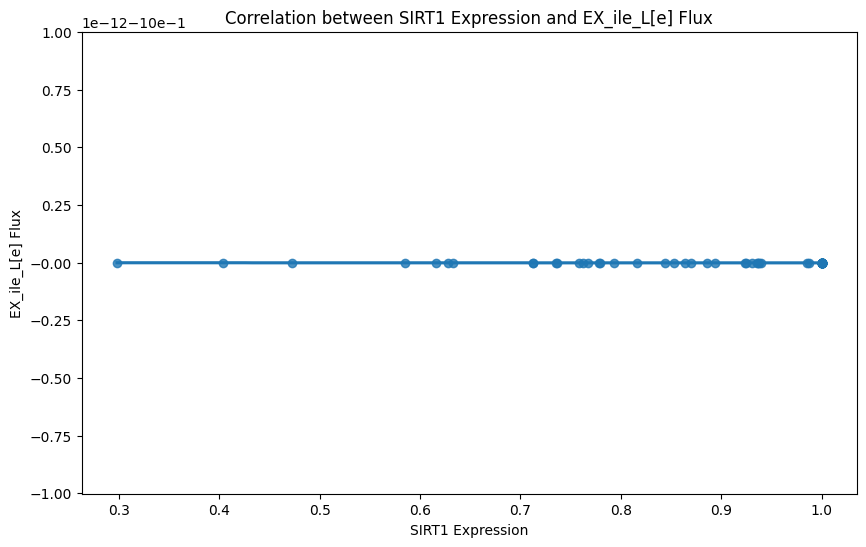

Linear regression results for SIRT1 and EX_ile_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



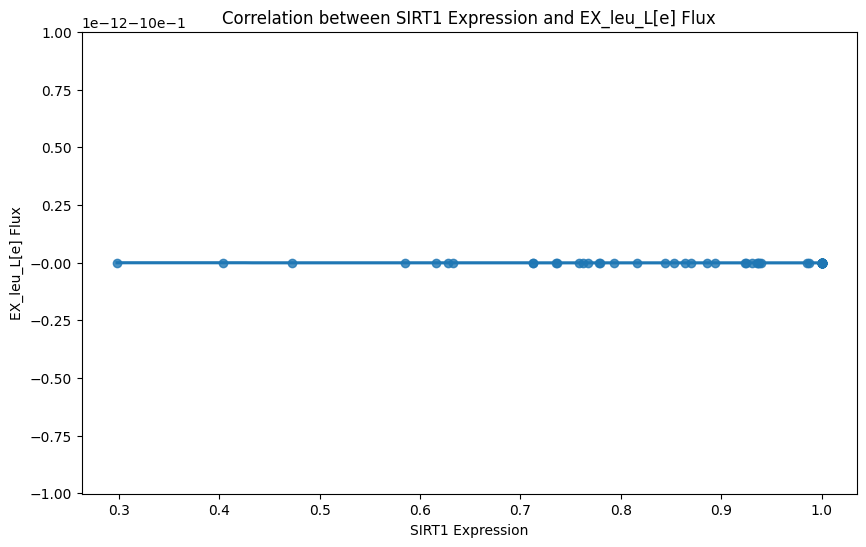

Linear regression results for SIRT1 and EX_leu_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



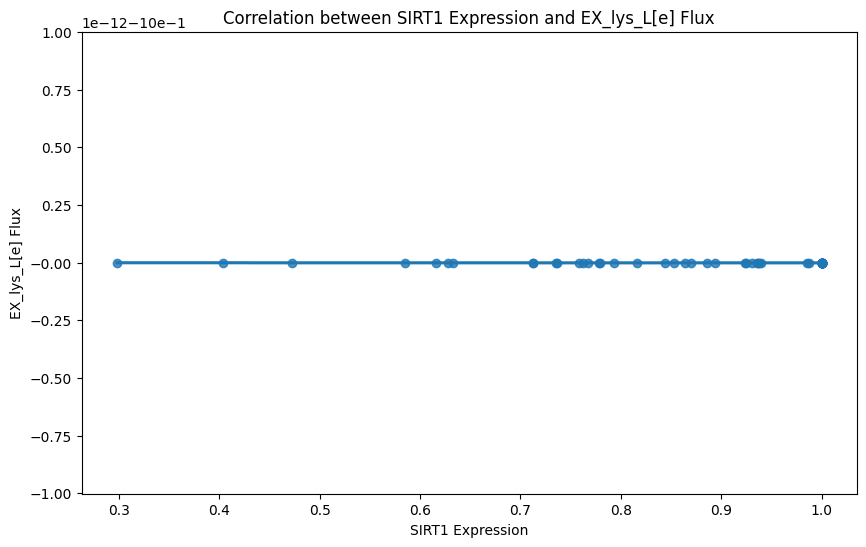

Linear regression results for SIRT1 and EX_lys_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



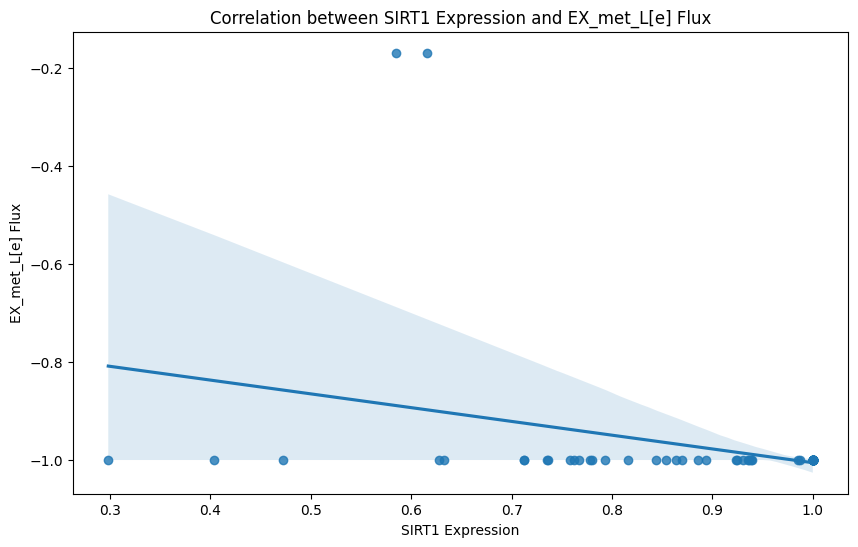

Linear regression results for SIRT1 and EX_met_L[e]:
Slope: -0.2810510362161329
Intercept: -0.7244364354315023
R-squared: 0.1032067595593936
P-value: 0.006300115862973335
Standard error: 0.09973618161398433



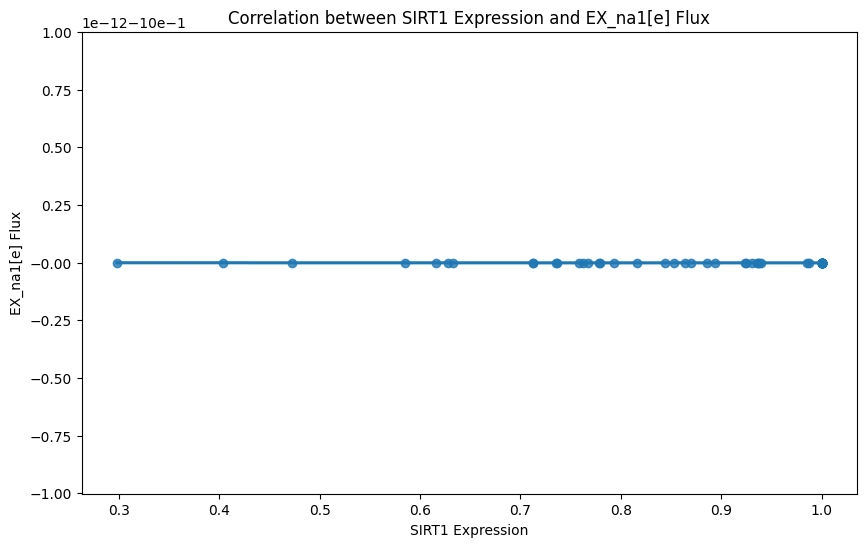

Linear regression results for SIRT1 and EX_na1[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



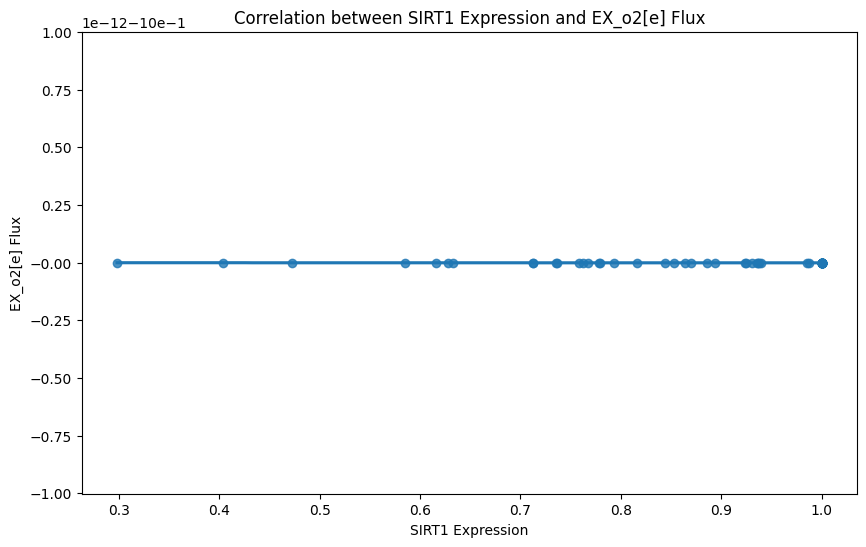

Linear regression results for SIRT1 and EX_o2[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



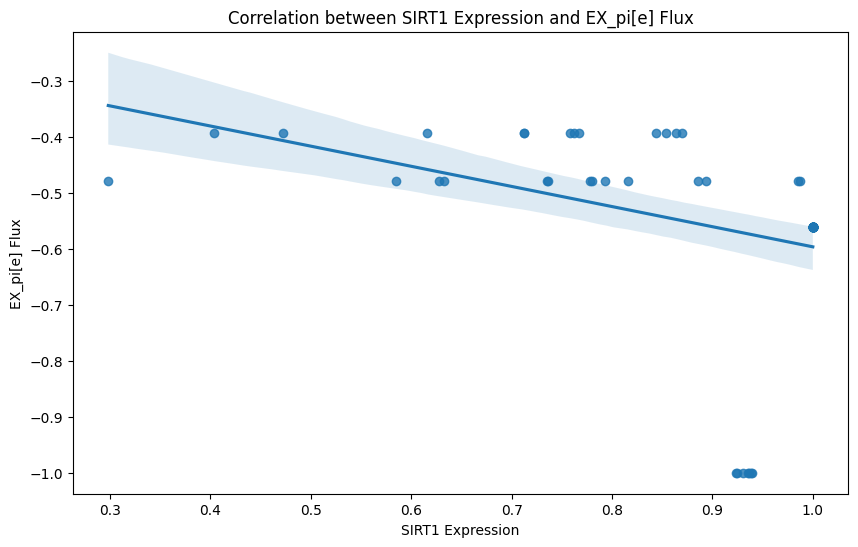

Linear regression results for SIRT1 and EX_pi[e]:
Slope: -0.35995145472240414
Intercept: -0.23618515365093445
R-squared: 0.127510139530102
P-value: 0.002236294616046228
Standard error: 0.11335148692553487



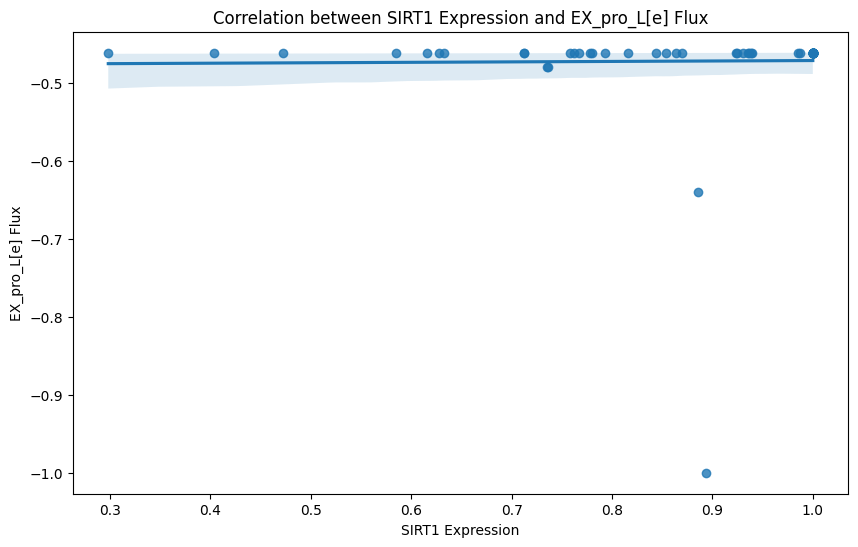

Linear regression results for SIRT1 and EX_pro_L[e]:
Slope: 0.005686347020879063
Intercept: -0.47736413933901356
R-squared: 0.0001806197790394379
P-value: 0.9114275809768788
Standard error: 0.05093155507578237



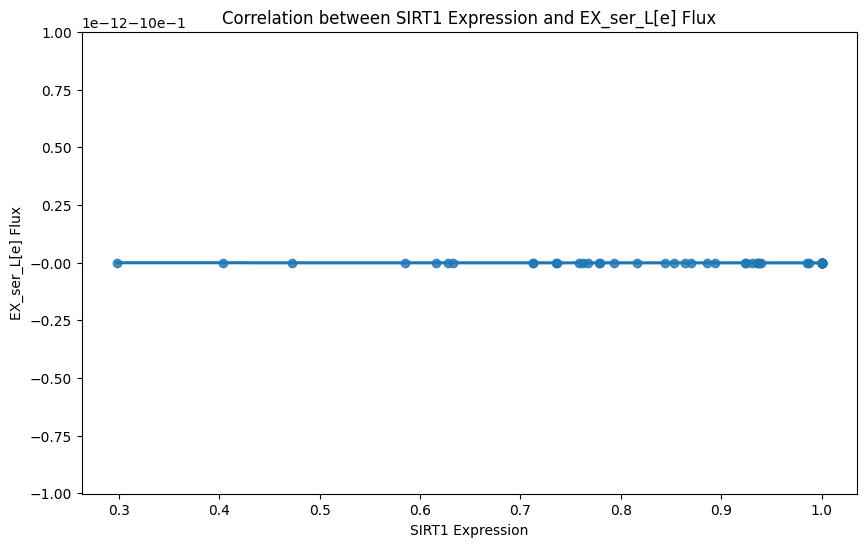

Linear regression results for SIRT1 and EX_ser_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



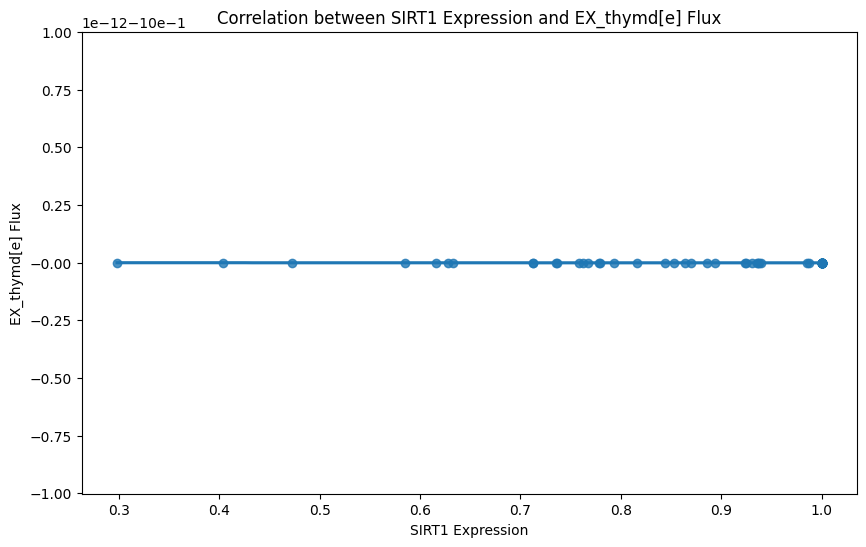

Linear regression results for SIRT1 and EX_thymd[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



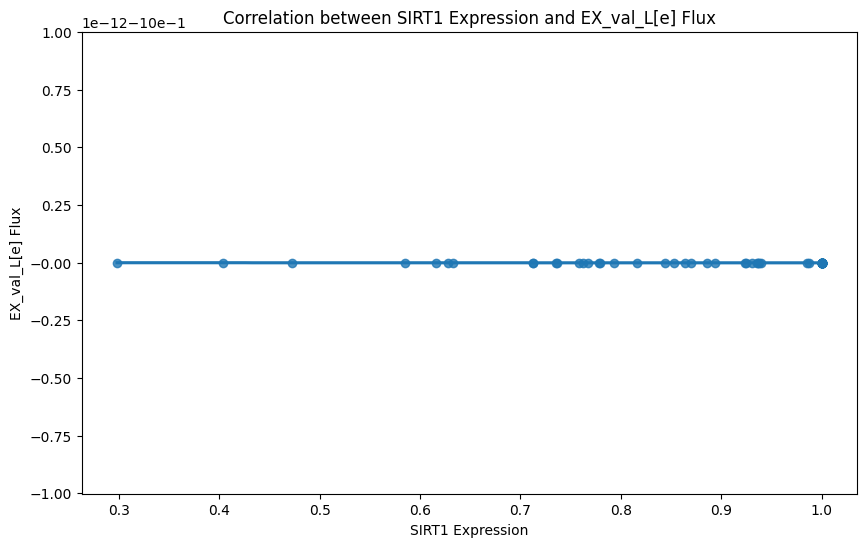

Linear regression results for SIRT1 and EX_val_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



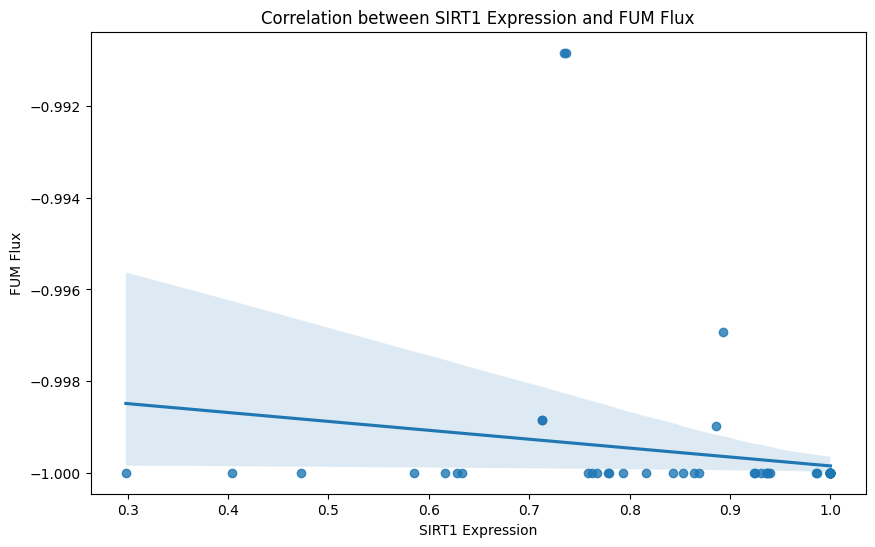

Linear regression results for SIRT1 and FUM:
Slope: -0.0019423634058748458
Intercept: -0.9979091768068744
R-squared: 0.03838832569317344
P-value: 0.101517600197751
Standard error: 0.001170324293558176



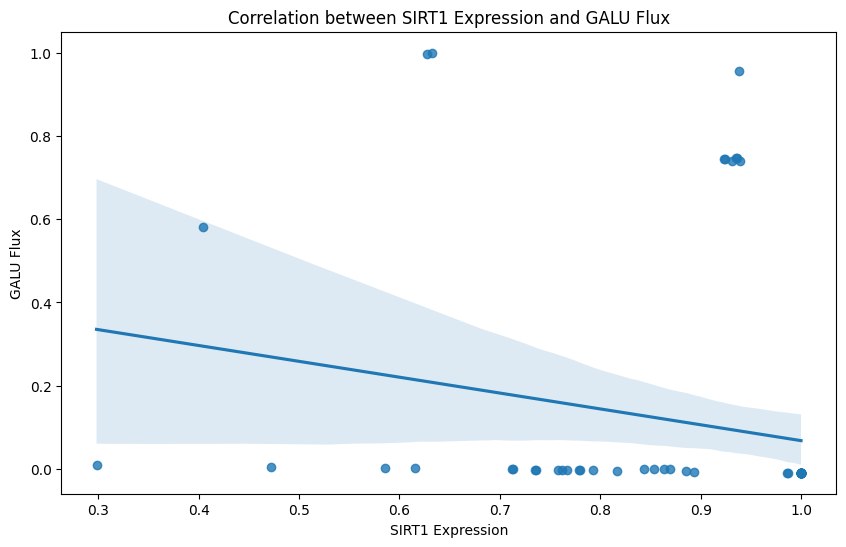

Linear regression results for SIRT1 and GALU:
Slope: -0.3809346927680446
Intercept: 0.449009995030068
R-squared: 0.04426169252649154
P-value: 0.07823263174737319
Standard error: 0.21309902849392434



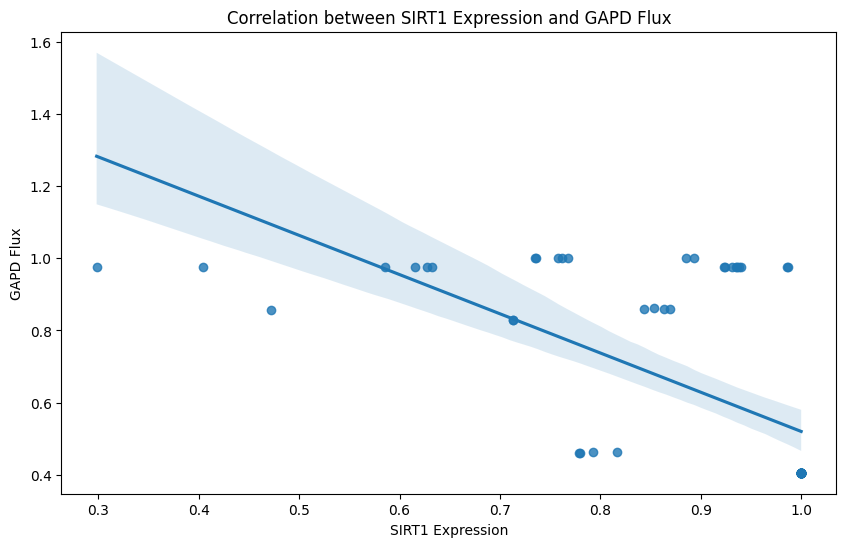

Linear regression results for SIRT1 and GAPD:
Slope: -1.0870025625960344
Intercept: 1.6070383628115752
R-squared: 0.40446802356443556
P-value: 2.5300683260844843e-09
Standard error: 0.15878755767562408



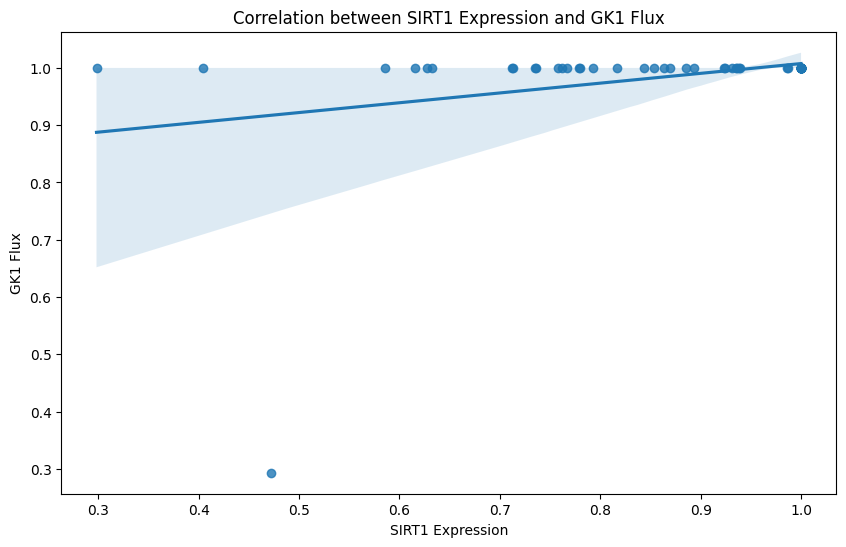

Linear regression results for SIRT1 and GK1:
Slope: 0.1711087137904379
Intercept: 0.8365355213161172
R-squared: 0.10434974471193799
P-value: 0.0060017773789951346
Standard error: 0.060349143798371585



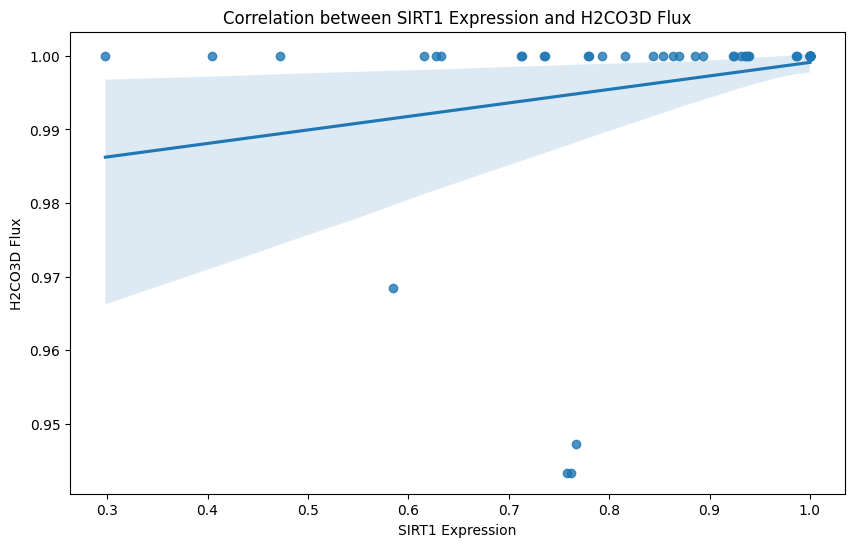

Linear regression results for SIRT1 and H2CO3D:
Slope: 0.0183406360478775
Intercept: 0.9807633107888486
R-squared: 0.0612388207386567
P-value: 0.037466444451961206
Standard error: 0.008644781063244468



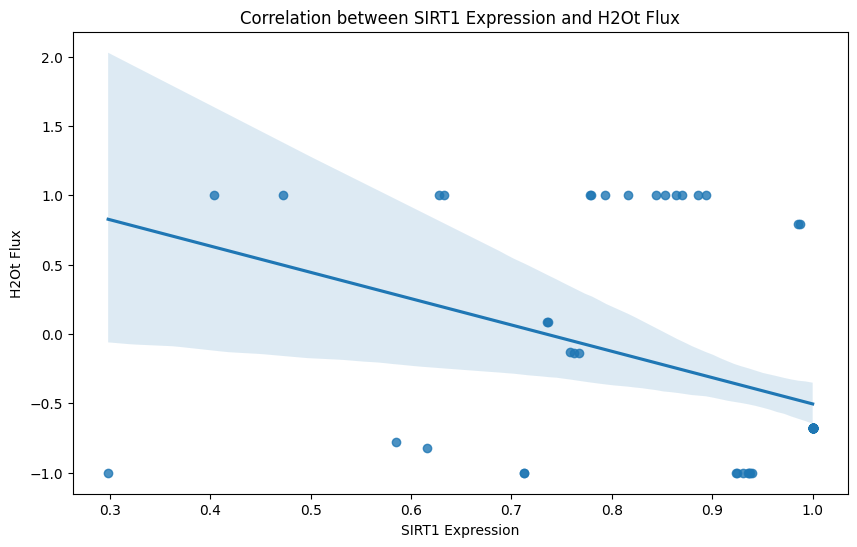

Linear regression results for SIRT1 and H2Ot:
Slope: -1.8968310107544313
Intercept: 1.3926749498018889
R-squared: 0.16970879176213644
P-value: 0.00035766391535555387
Standard error: 0.5050881094906403



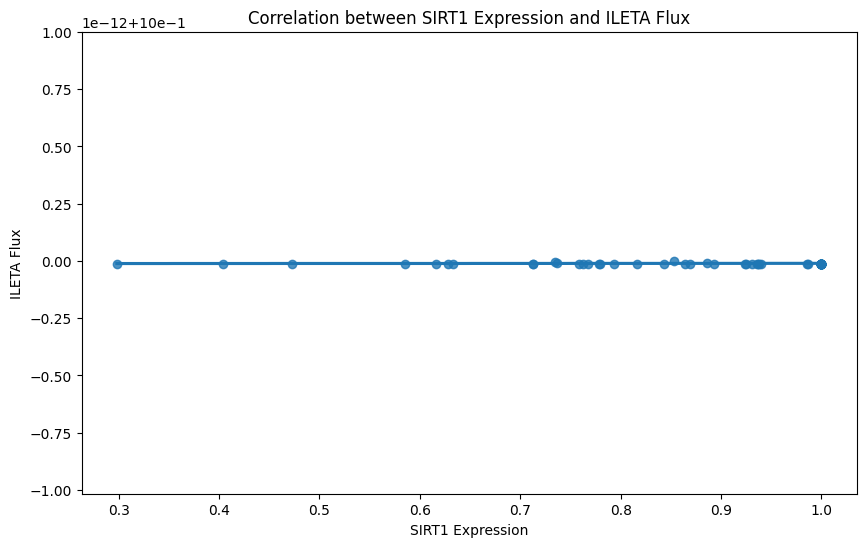

Linear regression results for SIRT1 and ILETA:
Slope: 3.4655920252695937e-16
Intercept: 0.999999999999988
R-squared: 0.0009666138617114191
P-value: 0.7968818261117835
Standard error: 1.3412705276813811e-15



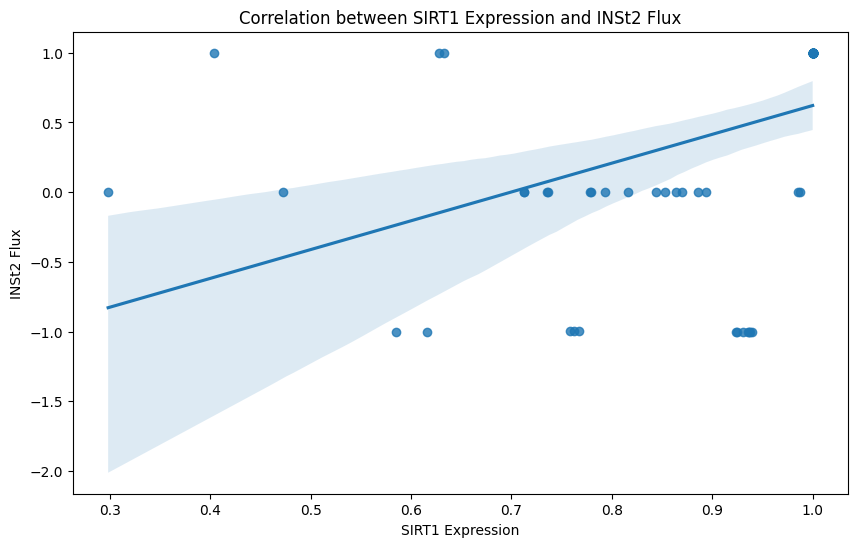

Linear regression results for SIRT1 and INSt2:
Slope: 2.0662665725661986
Intercept: -1.4449207703812523
R-squared: 0.18225315895079228
P-value: 0.00020502921495620384
Standard error: 0.5269066864061381



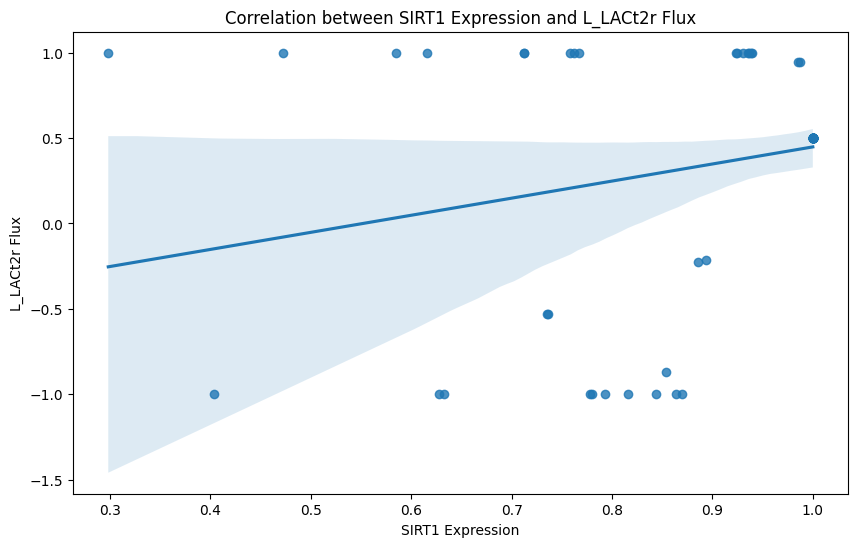

Linear regression results for SIRT1 and L_LACt2r:
Slope: 1.000874561963561
Intercept: -0.5524926550633502
R-squared: 0.058180392756323786
P-value: 0.042724912990977165
Standard error: 0.4847866430018055



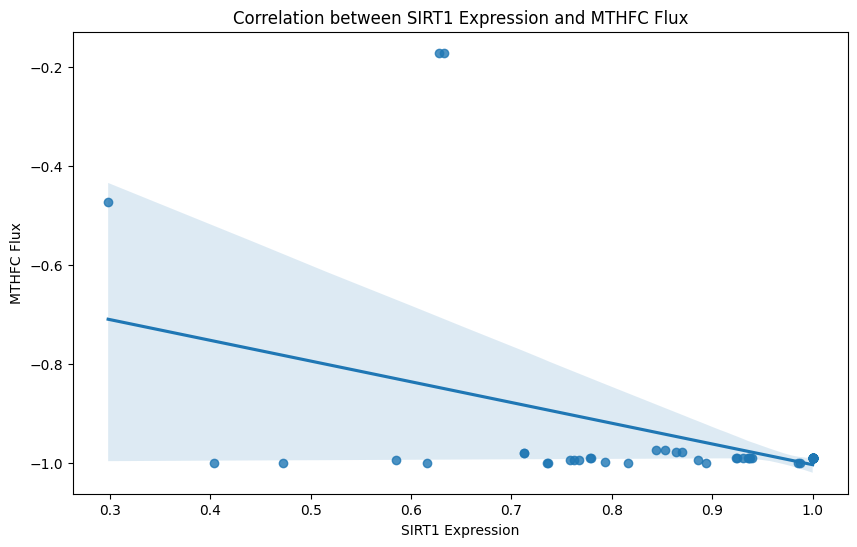

Linear regression results for SIRT1 and MTHFC:
Slope: -0.4188729249577404
Intercept: -0.584020342197981
R-squared: 0.19899548369955686
P-value: 9.660973292604568e-05
Standard error: 0.10117043479194514



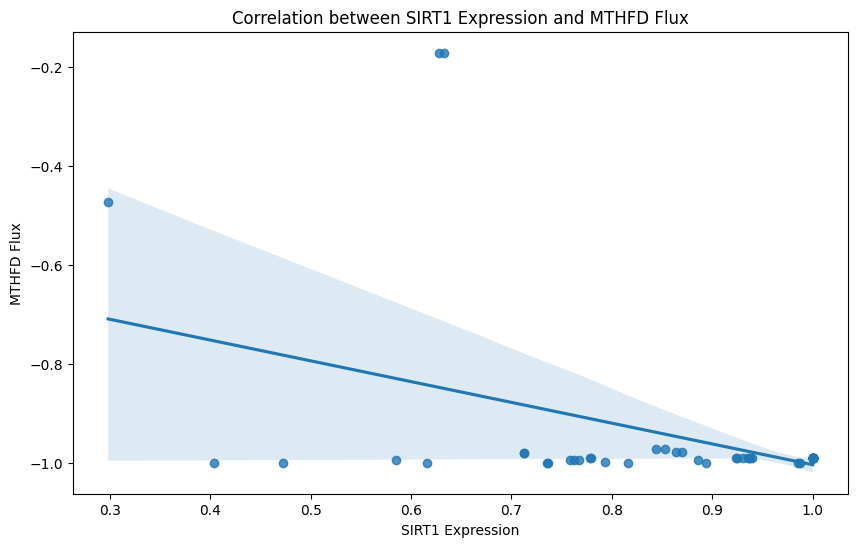

Linear regression results for SIRT1 and MTHFD:
Slope: -0.41974683144951674
Intercept: -0.583984912142068
R-squared: 0.19988993863955207
P-value: 9.277191507888269e-05
Standard error: 0.1010979337656167



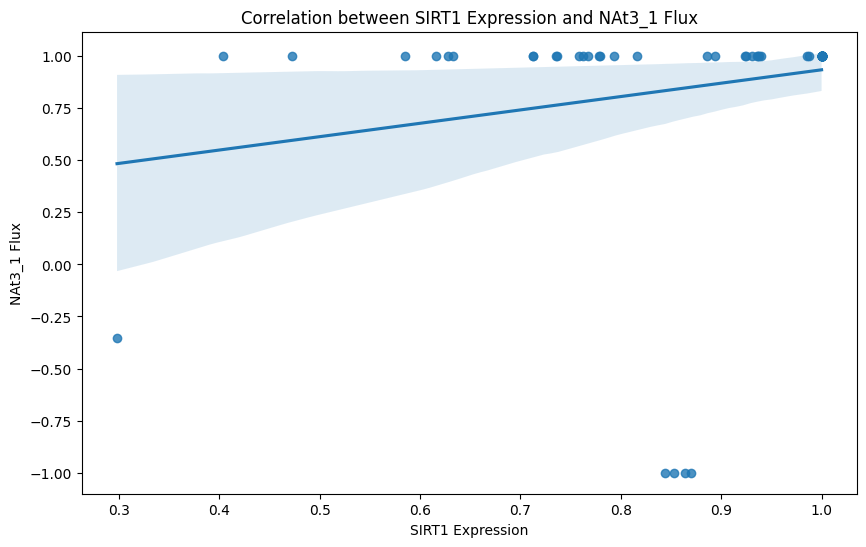

Linear regression results for SIRT1 and NAt3_1:
Slope: 0.6420820678137434
Intercept: 0.29223637261305335
R-squared: 0.04360435764563365
P-value: 0.08053158139355984
Standard error: 0.36200939649708236



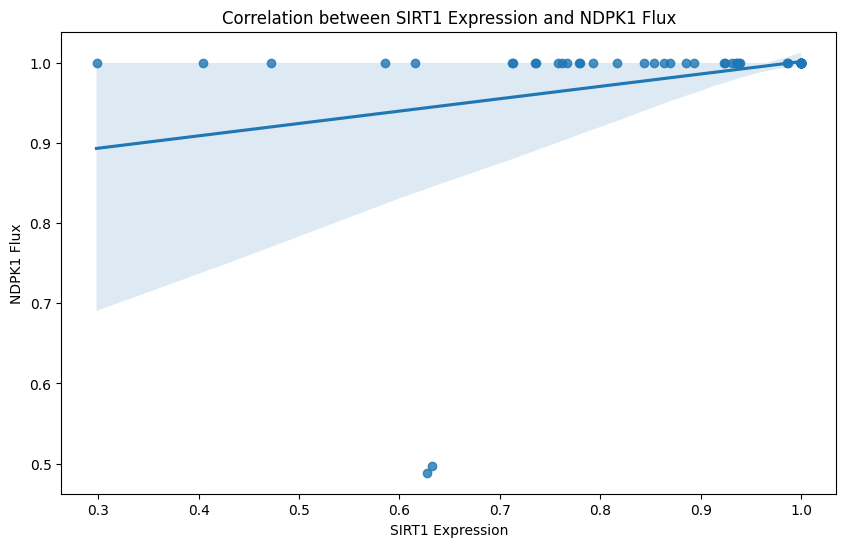

Linear regression results for SIRT1 and NDPK1:
Slope: 0.1543323332345708
Intercept: 0.8472504029825734
R-squared: 0.08357261291176507
P-value: 0.014480173050652466
Standard error: 0.061524687434721



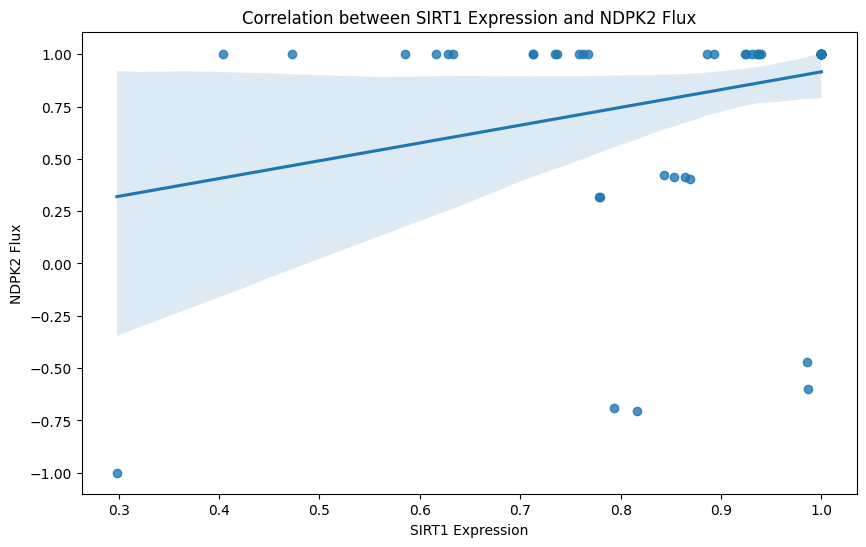

Linear regression results for SIRT1 and NDPK2:
Slope: 0.8501470344431745
Intercept: 0.06577932456917268
R-squared: 0.08630506173377227
P-value: 0.012896786049691187
Standard error: 0.3330059355980605



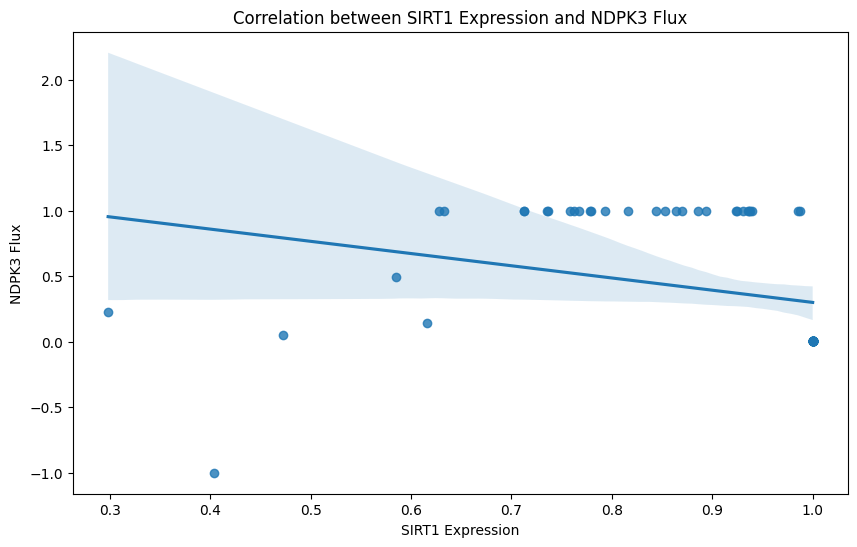

Linear regression results for SIRT1 and NDPK3:
Slope: -0.9322533152749682
Intercept: 1.2317467499263963
R-squared: 0.08374536660358661
P-value: 0.014374528573435344
Standard error: 0.37122489149509014



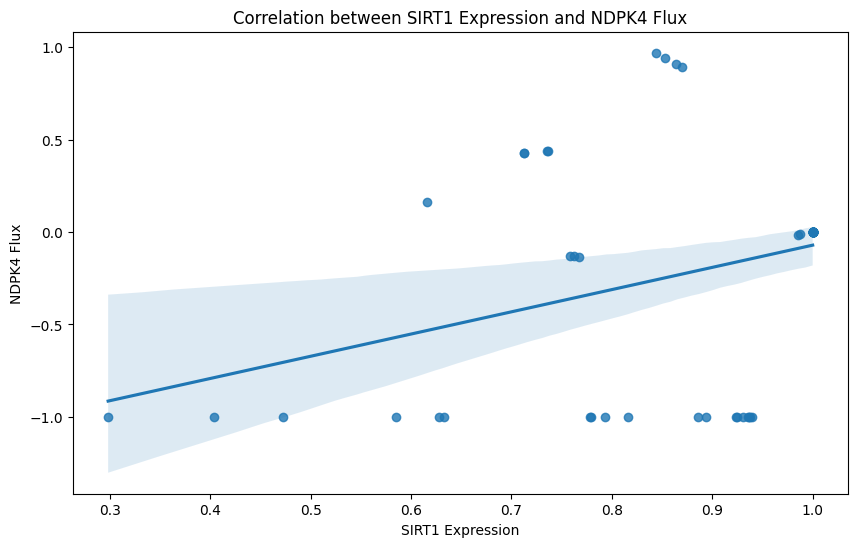

Linear regression results for SIRT1 and NDPK4:
Slope: 1.2015097081290076
Intercept: -1.2725271324571237
R-squared: 0.12311664591369192
P-value: 0.0026989426259722256
Standard error: 0.38602485108544526



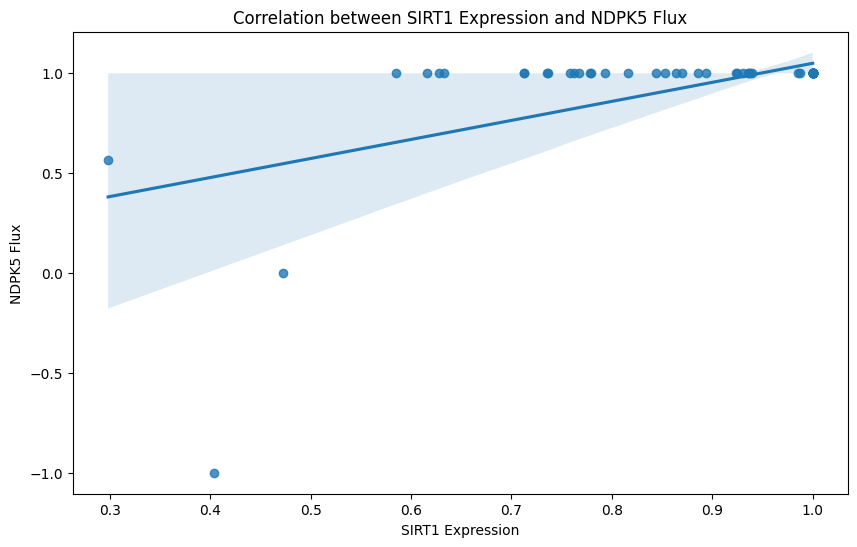

Linear regression results for SIRT1 and NDPK5:
Slope: 0.9526393573756685
Intercept: 0.09695469686446434
R-squared: 0.3173083385108908
P-value: 3.152389222179427e-07
Standard error: 0.16821918761295415



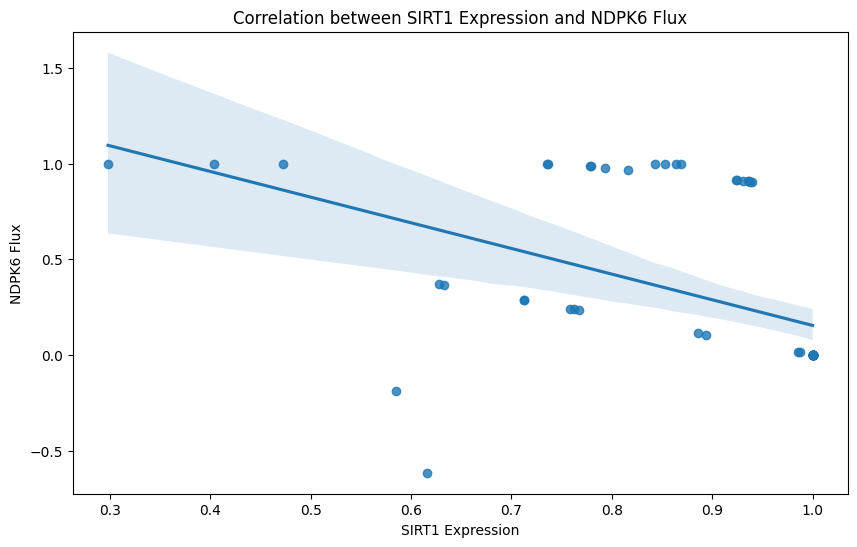

Linear regression results for SIRT1 and NDPK6:
Slope: -1.3406296020098378
Intercept: 1.4948436173682287
R-squared: 0.23202063841942555
P-value: 2.1105249798333635e-05
Standard error: 0.29362682232539467



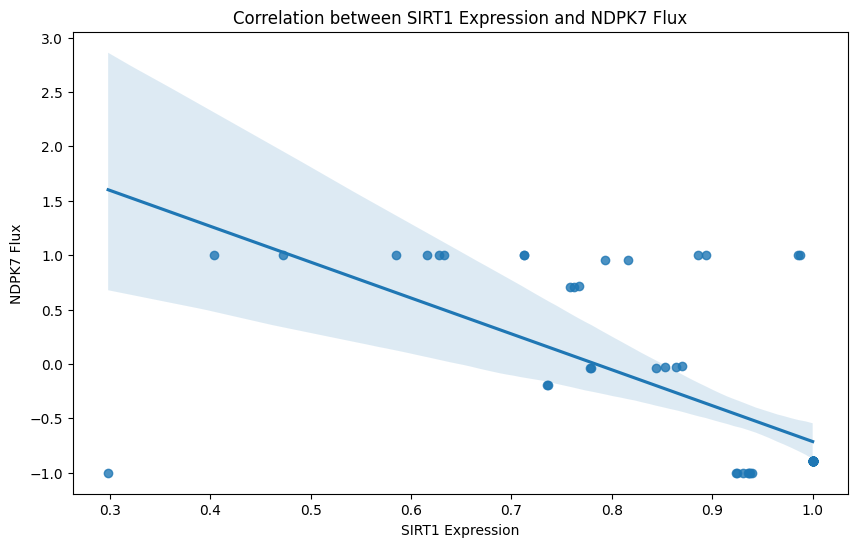

Linear regression results for SIRT1 and NDPK7:
Slope: -3.297926240811842
Intercept: 2.5843689916815427
R-squared: 0.4341187696766721
P-value: 4.202558610514123e-10
Standard error: 0.4532885570064371



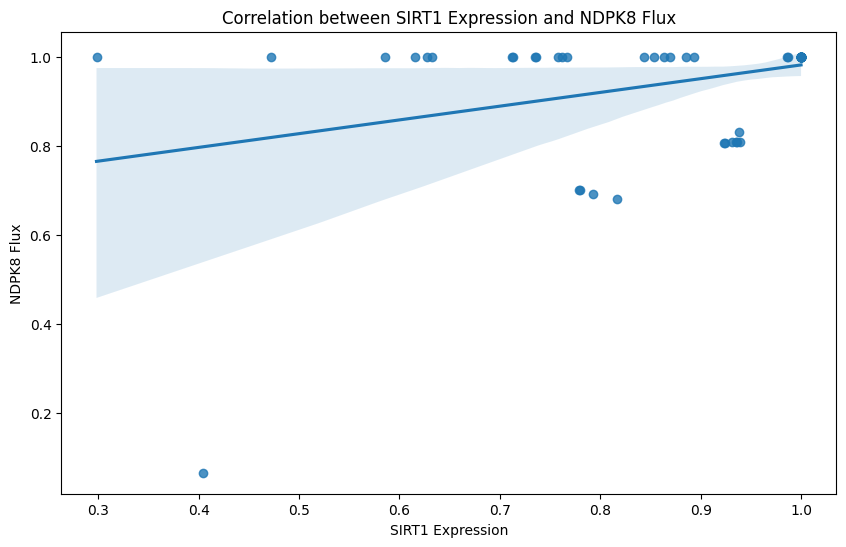

Linear regression results for SIRT1 and NDPK8:
Slope: 0.3089361384353371
Intercept: 0.6739644813146515
R-squared: 0.1266089922343496
P-value: 0.0023243110552502028
Standard error: 0.0976823840487595



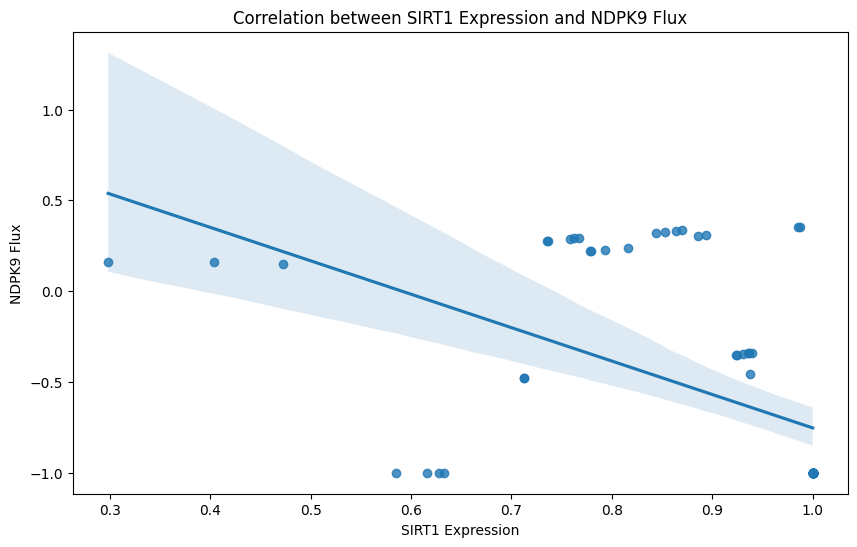

Linear regression results for SIRT1 and NDPK9:
Slope: -1.8403778924123875
Intercept: 1.0871745188776698
R-squared: 0.2658672261071558
P-value: 4.190838842116836e-06
Standard error: 0.3681606485897619



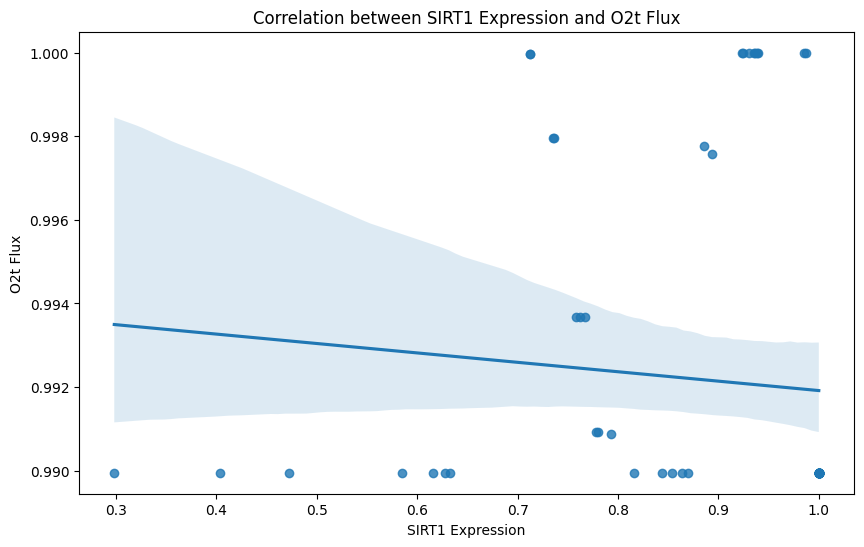

Linear regression results for SIRT1 and O2t:
Slope: -0.0022518385360995857
Intercept: 0.9941685748079564
R-squared: 0.008410955149332223
P-value: 0.4468594510631939
Standard error: 0.0029434448502244086



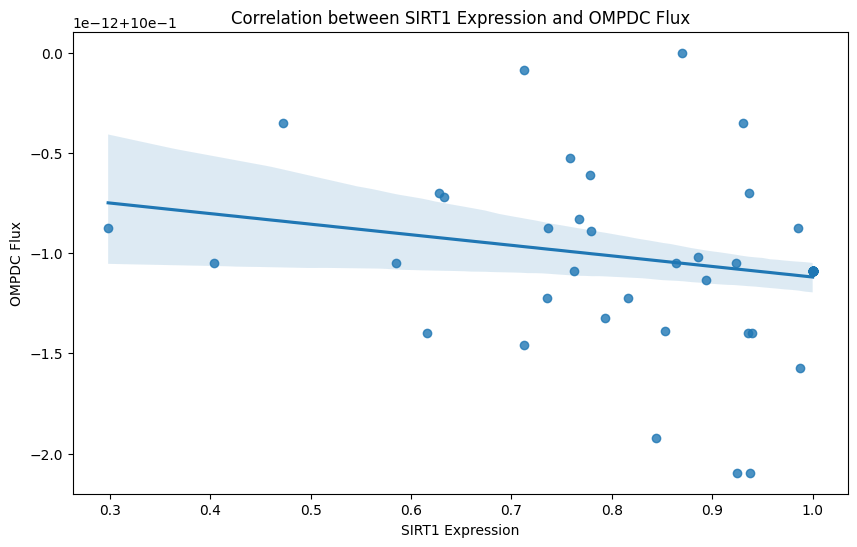

Linear regression results for SIRT1 and OMPDC:
Slope: -5.277829540545984e-13
Intercept: 0.9999999999994079
R-squared: 0.06079076289091417
P-value: 0.03819330844196844
Standard error: 2.4974292565829327e-13



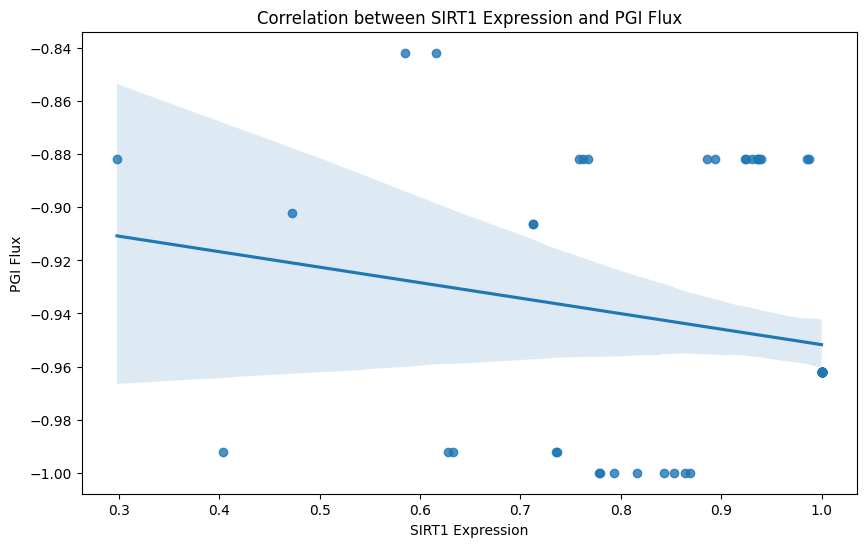

Linear regression results for SIRT1 and PGI:
Slope: -0.058385458786454604
Intercept: -0.8933583422186259
R-squared: 0.045134760908538935
P-value: 0.07528545443584275
Standard error: 0.03232924932169121



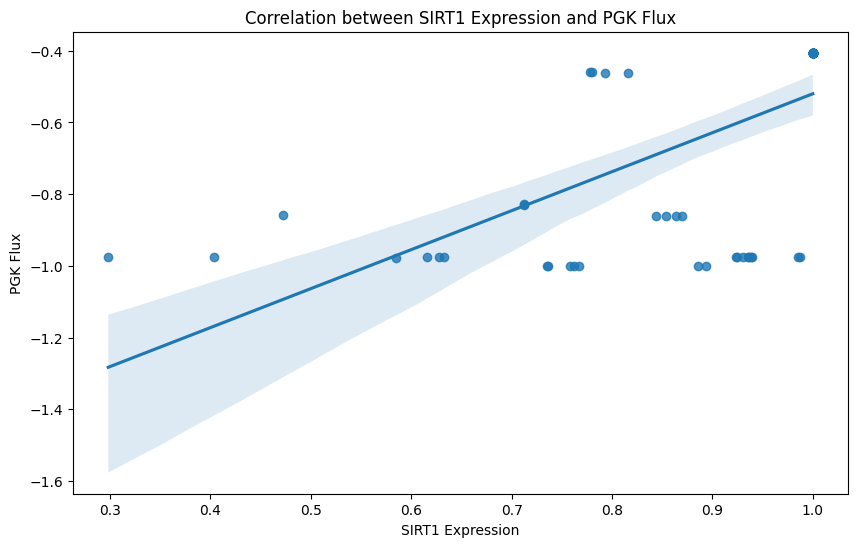

Linear regression results for SIRT1 and PGK:
Slope: 1.0870025625960347
Intercept: -1.6070383628115756
R-squared: 0.40446802356443556
P-value: 2.5300683260844843e-09
Standard error: 0.1587875576756241



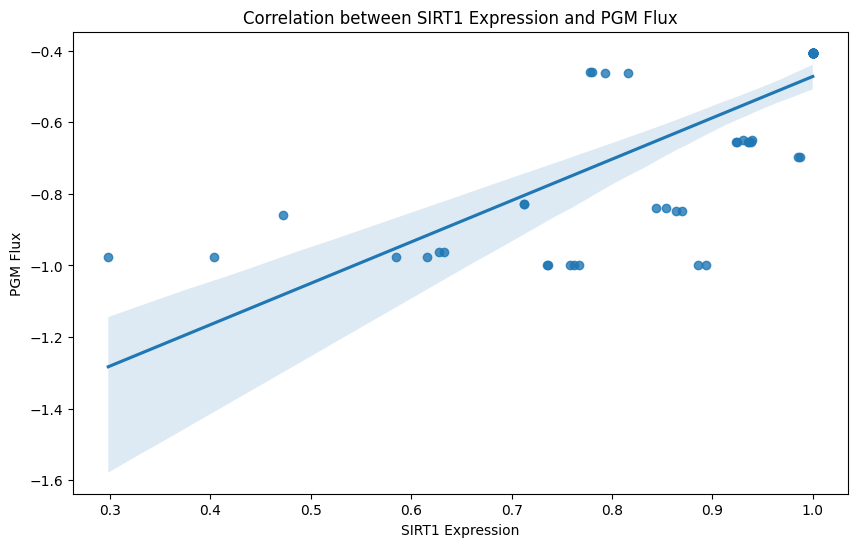

Linear regression results for SIRT1 and PGM:
Slope: 1.1556028070895772
Intercept: -1.62751645342935
R-squared: 0.6003465583924817
P-value: 2.2173807710872436e-15
Standard error: 0.11350756541146852



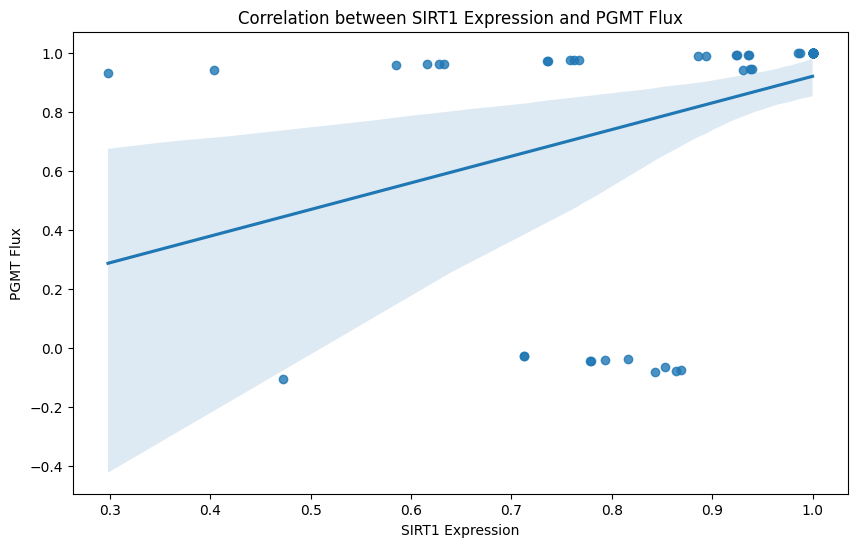

Linear regression results for SIRT1 and PGMT:
Slope: 0.9026316621491672
Intercept: 0.01755526131138163
R-squared: 0.1400593539431574
P-value: 0.0013036720714522038
Standard error: 0.26925526061613514



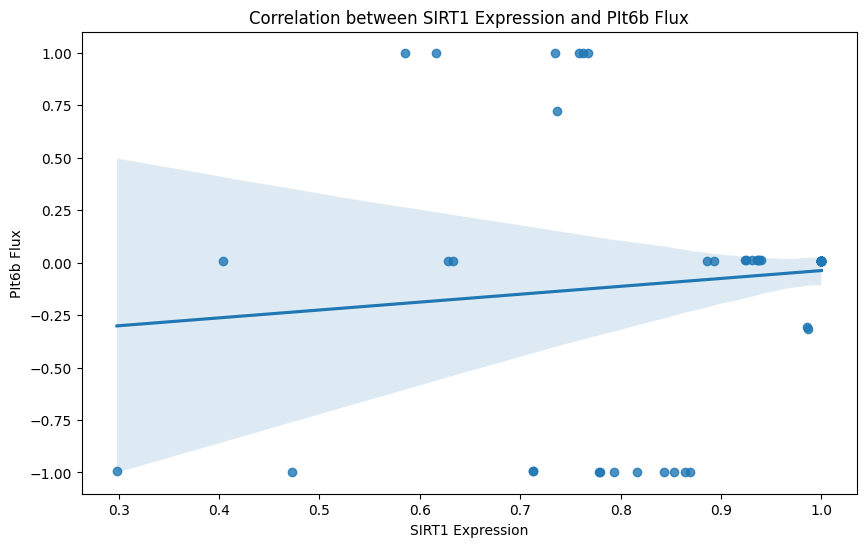

Linear regression results for SIRT1 and PIt6b:
Slope: 0.3757273016960659
Intercept: -0.4136468625432248
R-squared: 0.013576077341867913
P-value: 0.3332145929932181
Standard error: 0.3855607839167559



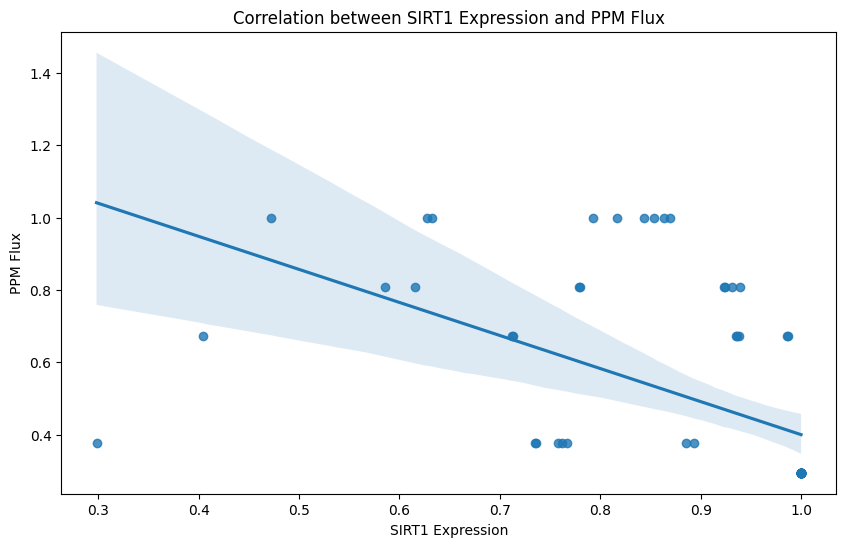

Linear regression results for SIRT1 and PPM:
Slope: -0.9130104564104347
Intercept: 1.313137922488942
R-squared: 0.2951191881582026
P-value: 9.82561648360786e-07
Standard error: 0.16986751224767888



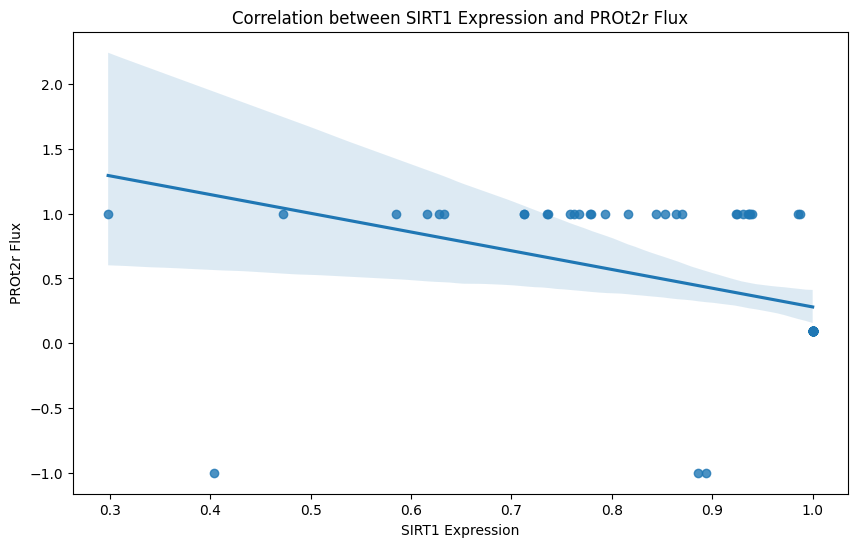

Linear regression results for SIRT1 and PROt2r:
Slope: -1.446038089450225
Intercept: 1.7260096675046173
R-squared: 0.1811505739456641
P-value: 0.00021535854197888586
Standard error: 0.3701155693545012



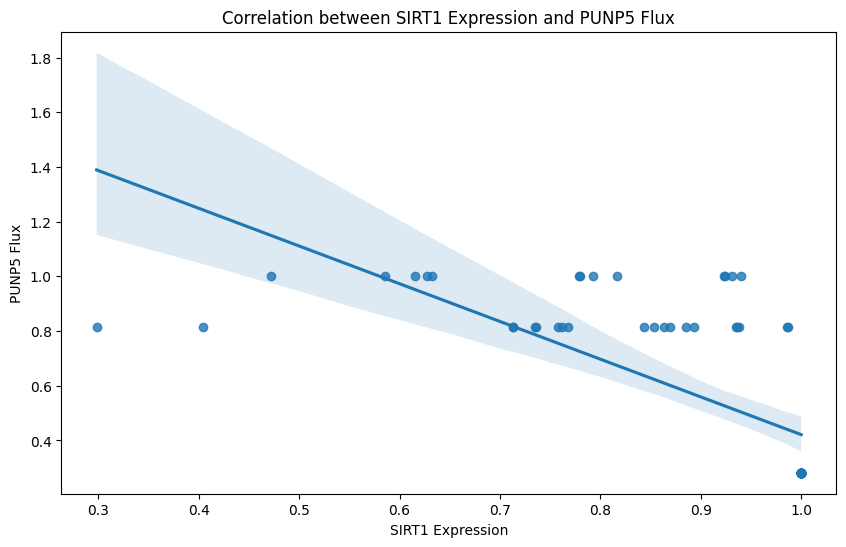

Linear regression results for SIRT1 and PUNP5:
Slope: -1.3793281916363083
Intercept: 1.8004391578354135
R-squared: 0.49557268297374946
P-value: 7.480256957199968e-12
Standard error: 0.1675284948227629



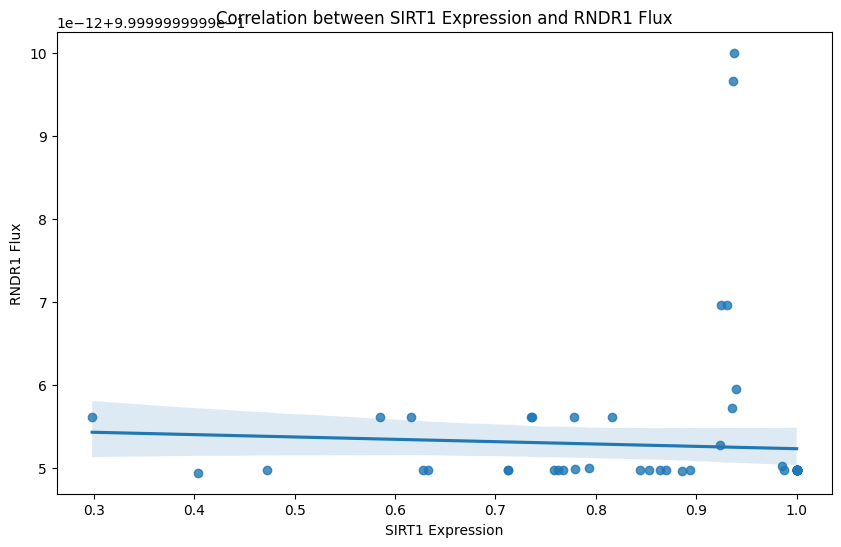

Linear regression results for SIRT1 and RNDR1:
Slope: -2.835641048498336e-13
Intercept: 0.9999999999955095
R-squared: 0.0026142137741849035
P-value: 0.6719641463714223
Standard error: 6.667879568687214e-13



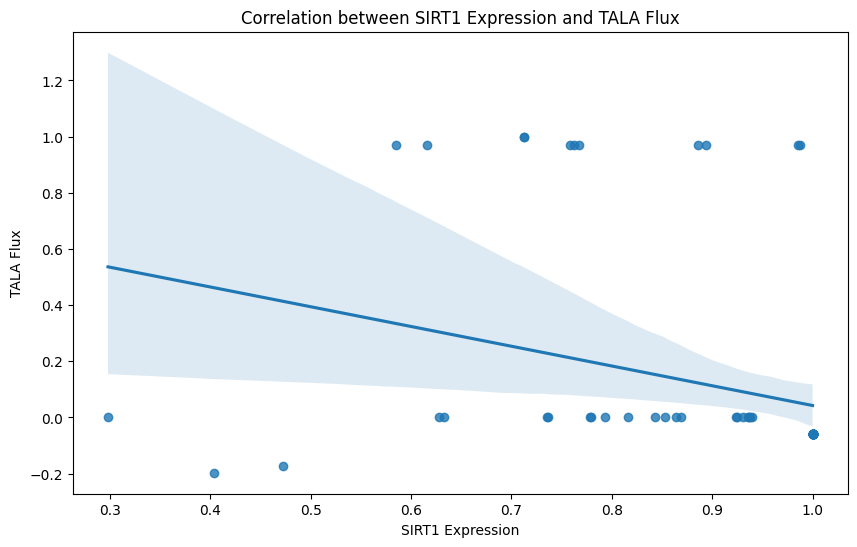

Linear regression results for SIRT1 and TALA:
Slope: -0.7034050391969244
Intercept: 0.7461082702440814
R-squared: 0.08931163221369383
P-value: 0.011354208197964117
Standard error: 0.27040319040342736



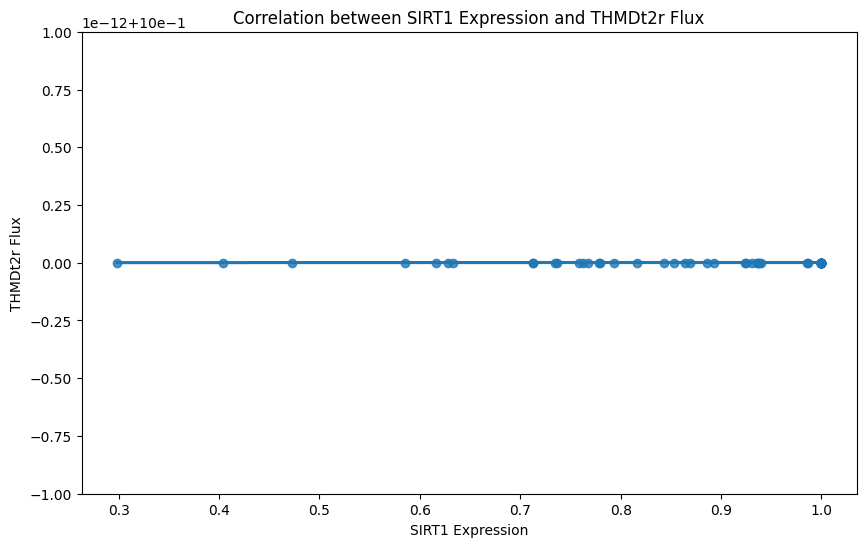

Linear regression results for SIRT1 and THMDt2r:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



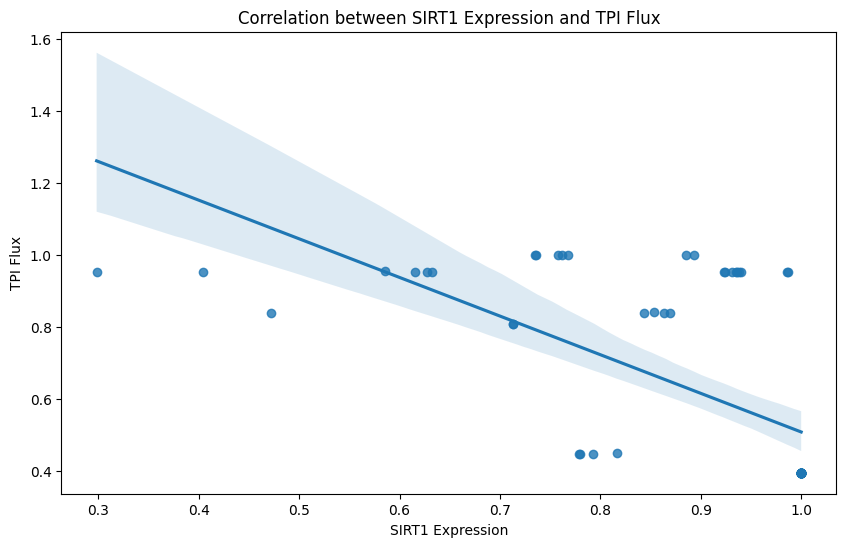

Linear regression results for SIRT1 and TPI:
Slope: -1.0726126980597461
Intercept: 1.5810736395266858
R-squared: 0.40145804491743164
P-value: 3.0212668570284615e-09
Standard error: 0.15766874289179283



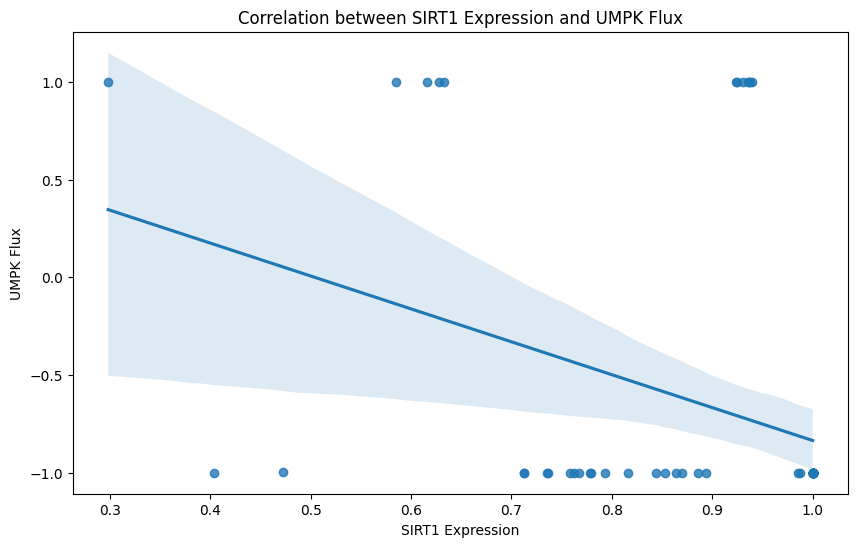

Linear regression results for SIRT1 and UMPK:
Slope: -1.6840828998928212
Intercept: 0.8489179726421338
R-squared: 0.12481637373129781
P-value: 0.00250969739932723
Standard error: 0.5368497215325353



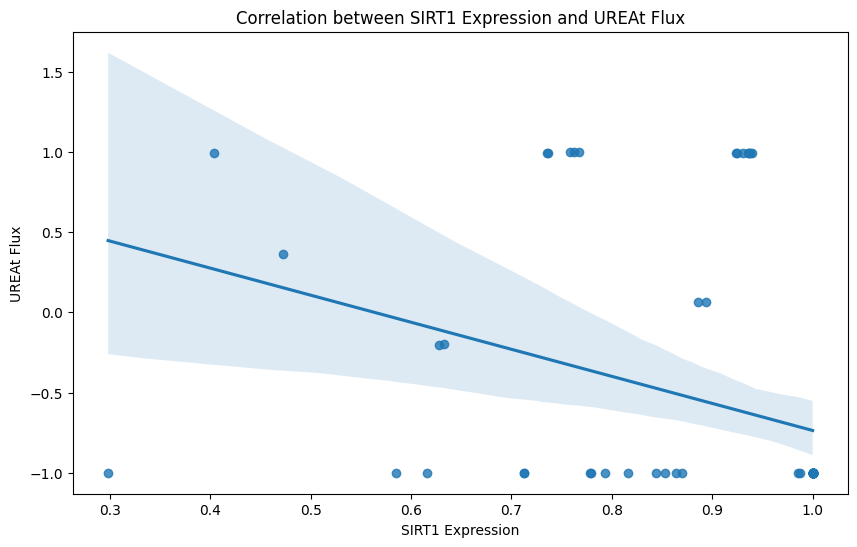

Linear regression results for SIRT1 and UREAt:
Slope: -1.6870732888041857
Intercept: 0.9503286459904614
R-squared: 0.11474938121085684
P-value: 0.003857024694286283
Standard error: 0.5641146095972348



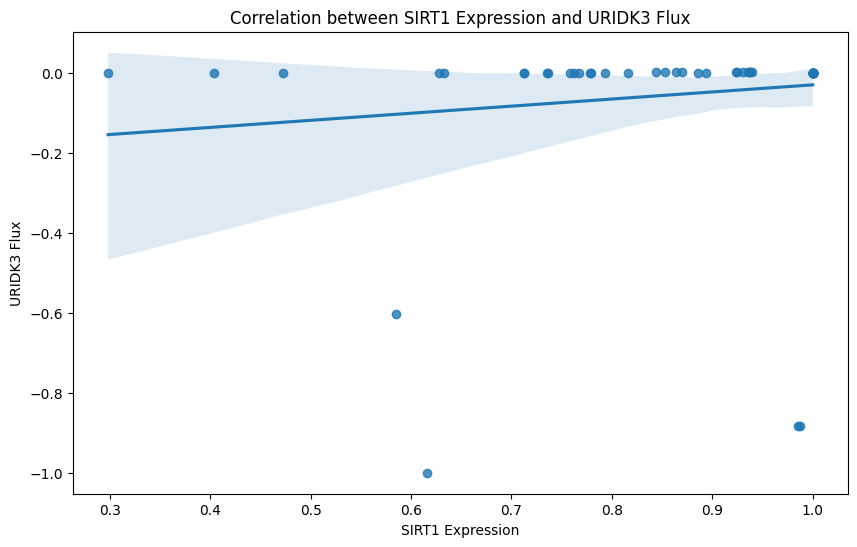

Linear regression results for SIRT1 and URIDK3:
Slope: 0.1776357795242711
Intercept: -0.20644995240329816
R-squared: 0.020048740106753737
P-value: 0.2388537389377943
Standard error: 0.14950805634314818



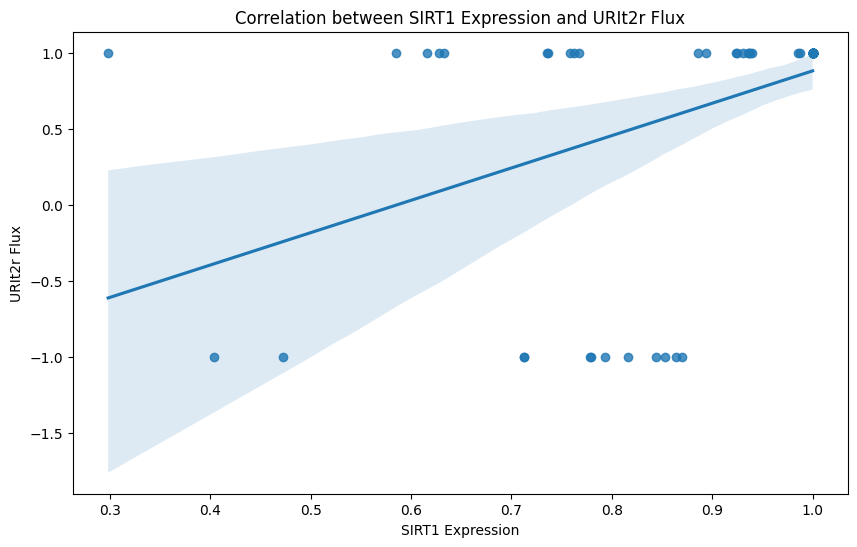

Linear regression results for SIRT1 and URIt2r:
Slope: 2.127368813406674
Intercept: -1.246590753921581
R-squared: 0.1991681322202743
P-value: 9.585704915490575e-05
Standard error: 0.5135455745597177



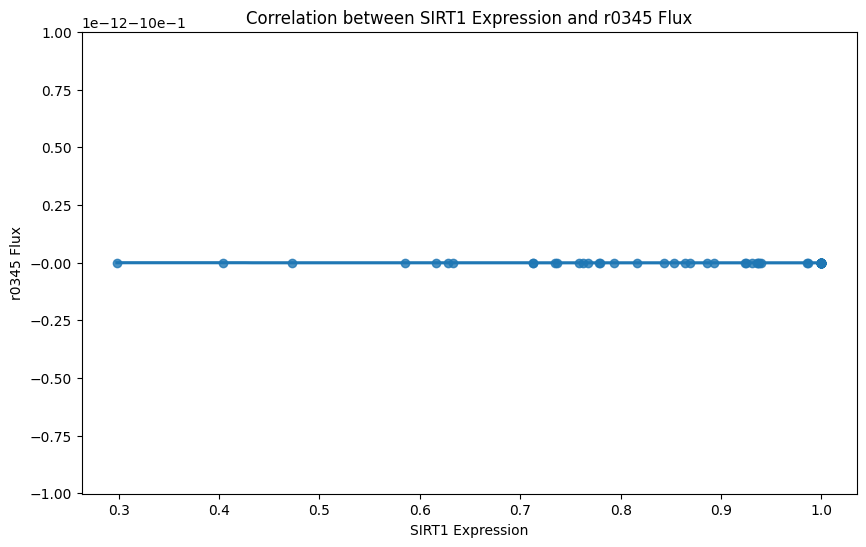

Linear regression results for SIRT1 and r0345:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



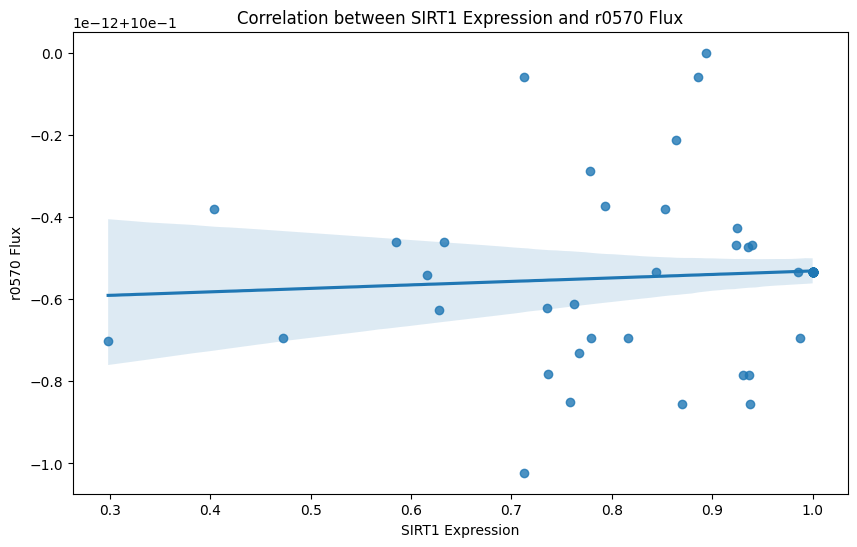

Linear regression results for SIRT1 and r0570:
Slope: 8.416250730103698e-14
Intercept: 0.999999999999383
R-squared: 0.006456491204908167
P-value: 0.5053337828450151
Standard error: 1.2568668824786563e-13



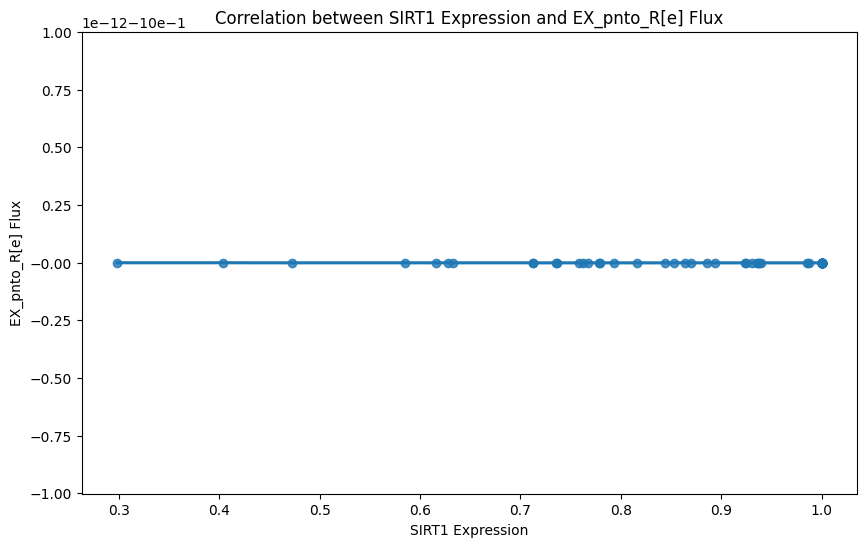

Linear regression results for SIRT1 and EX_pnto_R[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



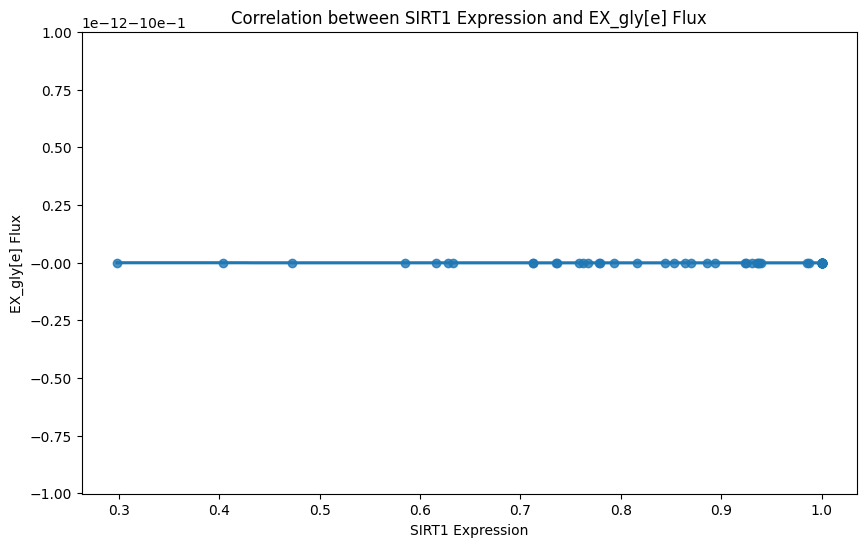

Linear regression results for SIRT1 and EX_gly[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



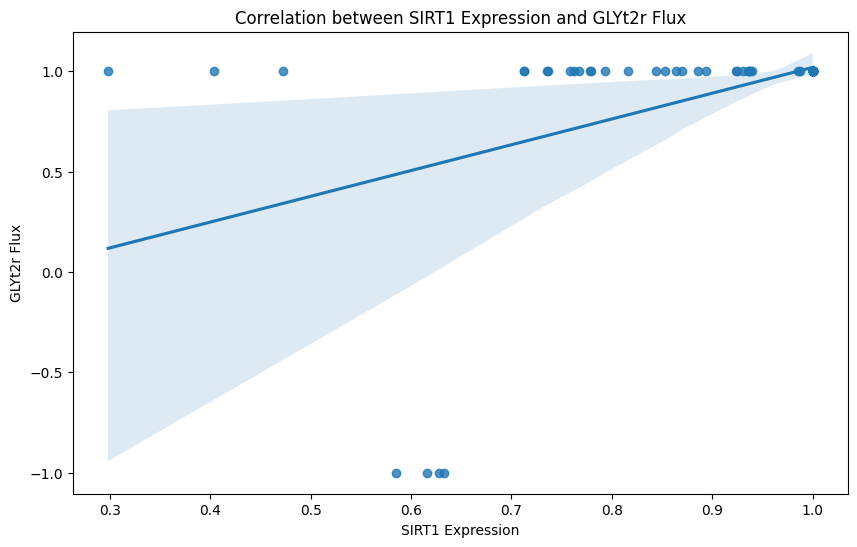

Linear regression results for SIRT1 and GLYt2r:
Slope: 1.2844728149053277
Intercept: -0.26503701058808227
R-squared: 0.19181500252621062
P-value: 0.00013359828528389348
Standard error: 0.31740552193932975



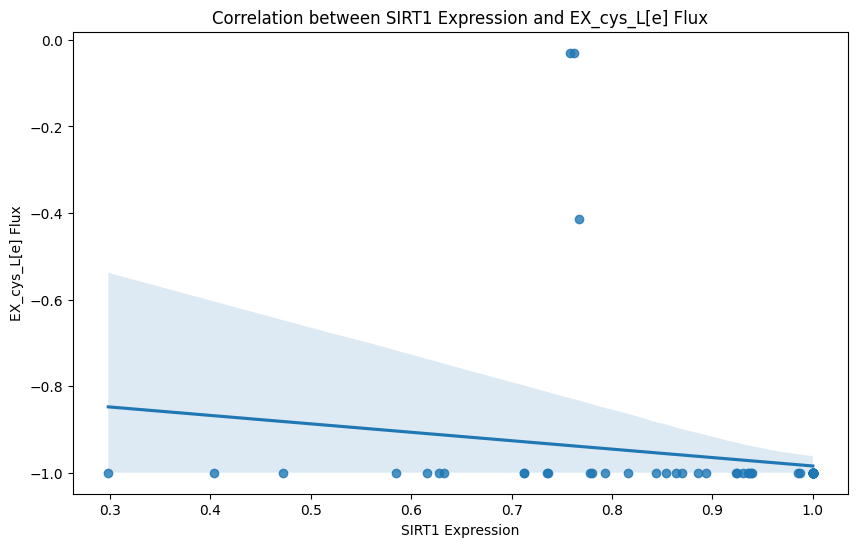

Linear regression results for SIRT1 and EX_cys_L[e]:
Slope: -0.1946965092760964
Intercept: -0.7897467081259335
R-squared: 0.031151015578381545
P-value: 0.140919790546385
Standard error: 0.13071503963145487



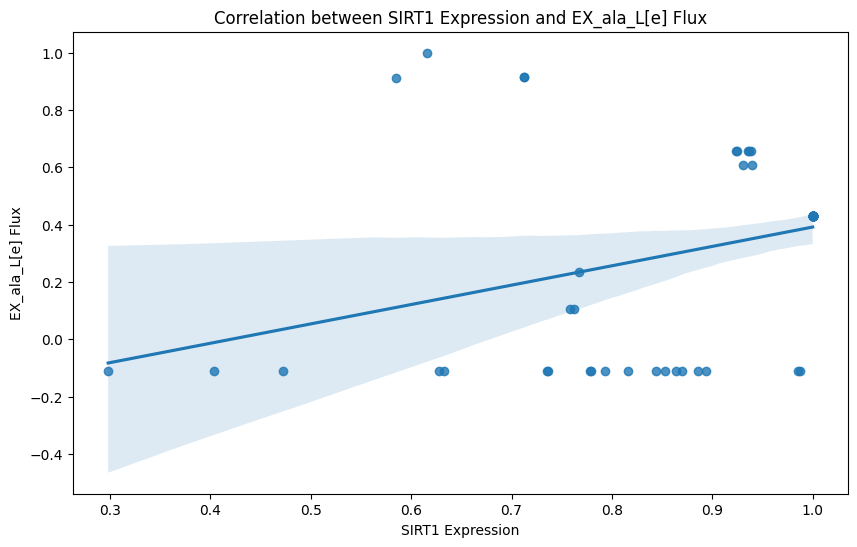

Linear regression results for SIRT1 and EX_ala_L[e]:
Slope: 0.6759170313044796
Intercept: -0.2840490118659115
R-squared: 0.12628960902494396
P-value: 0.0023563199116419927
Standard error: 0.2140271090292441



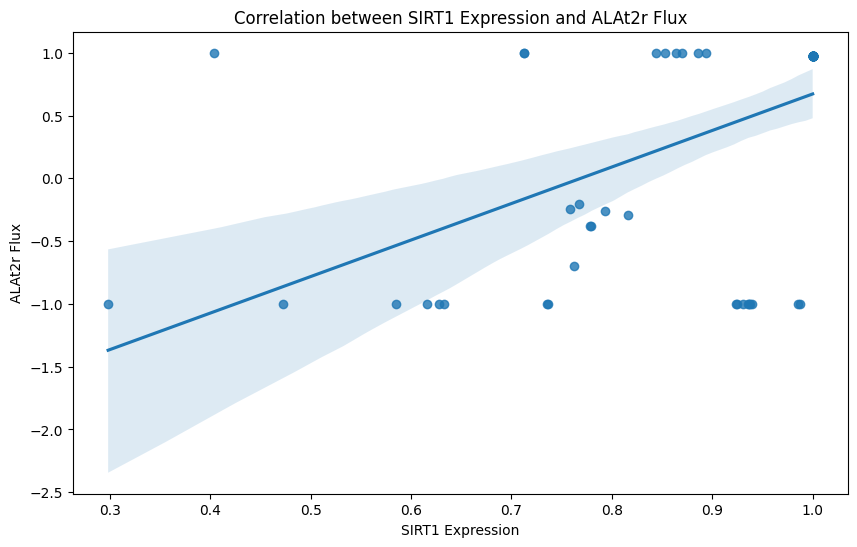

Linear regression results for SIRT1 and ALAt2r:
Slope: 2.908392067676496
Intercept: -2.236709993385138
R-squared: 0.27987638842098833
P-value: 2.105975965834095e-06
Standard error: 0.5616280641371421



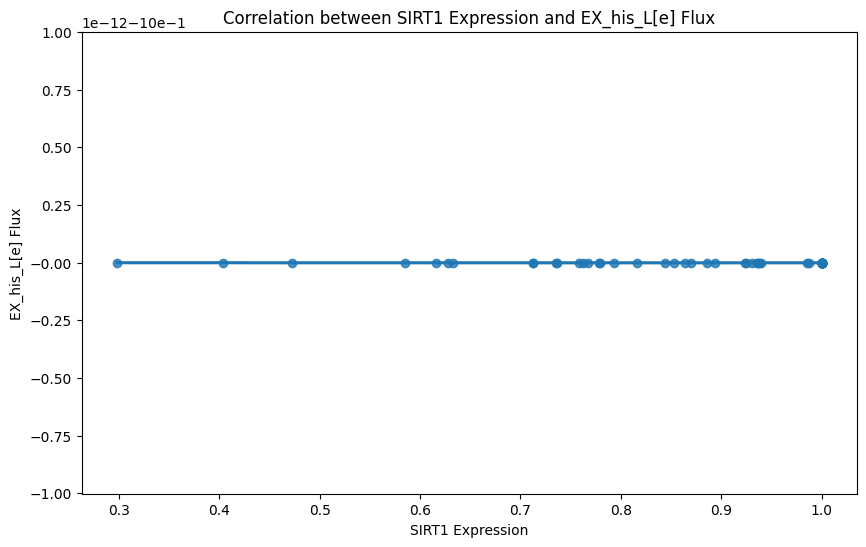

Linear regression results for SIRT1 and EX_his_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



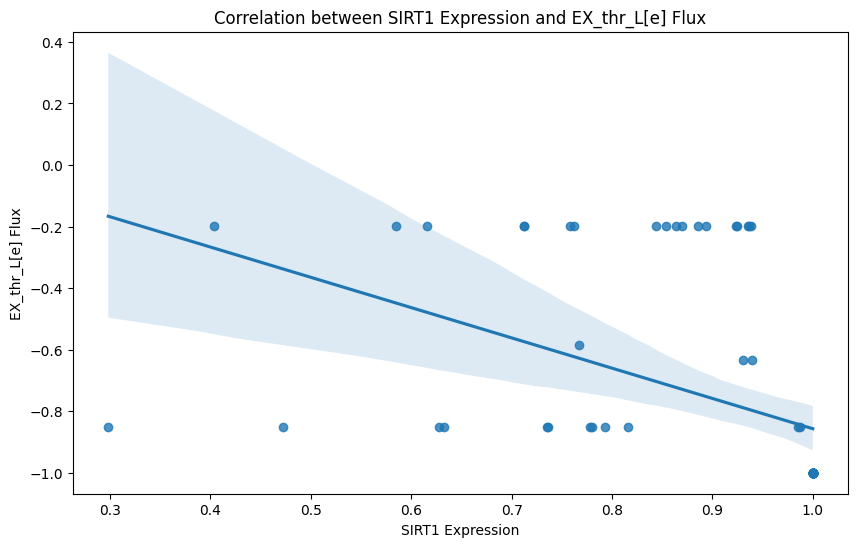

Linear regression results for SIRT1 and EX_thr_L[e]:
Slope: -0.9839702435588185
Intercept: 0.1269398511009825
R-squared: 0.2124472012095072
P-value: 5.231515460168798e-05
Standard error: 0.2280718851437618



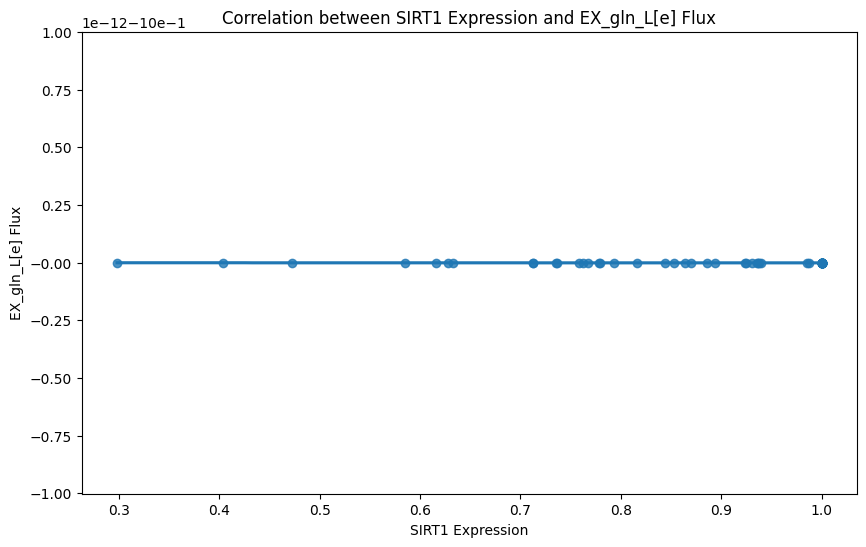

Linear regression results for SIRT1 and EX_gln_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



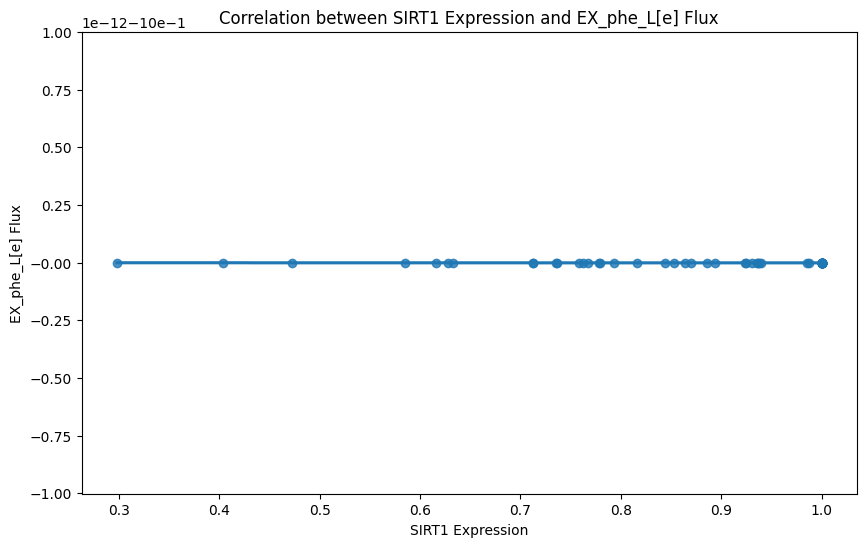

Linear regression results for SIRT1 and EX_phe_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



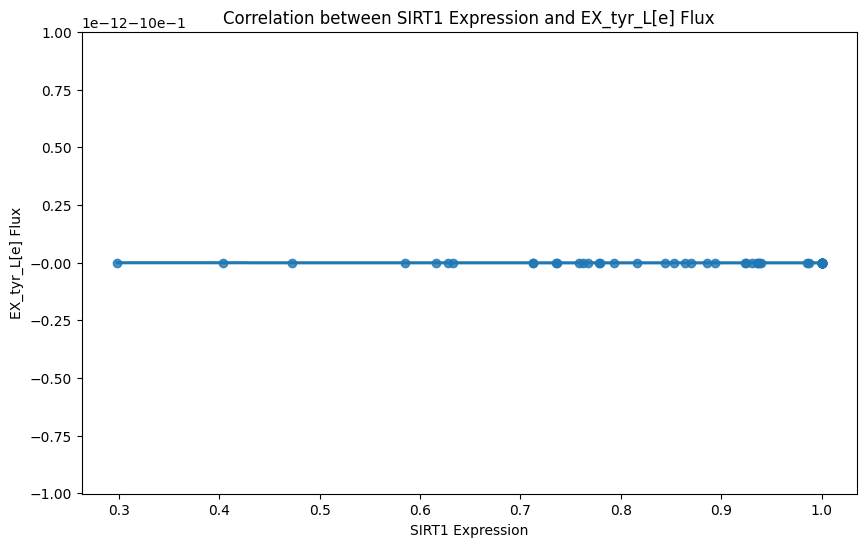

Linear regression results for SIRT1 and EX_tyr_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



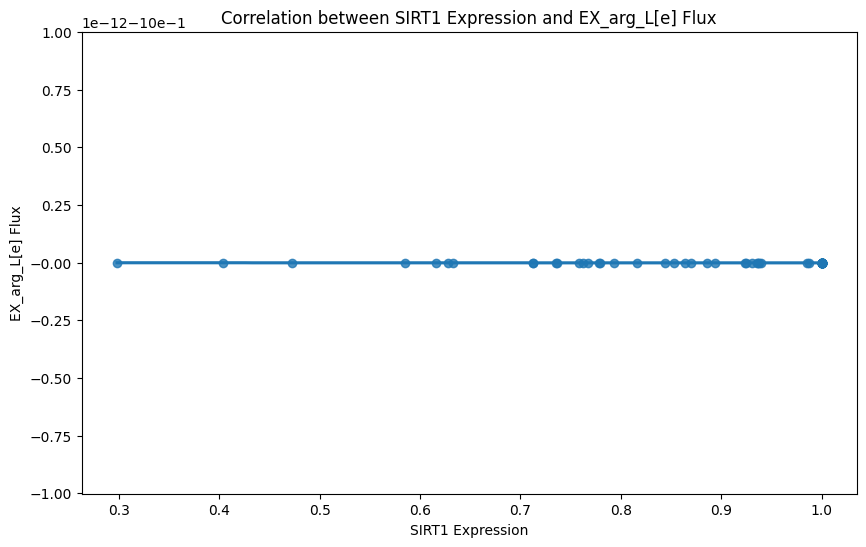

Linear regression results for SIRT1 and EX_arg_L[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



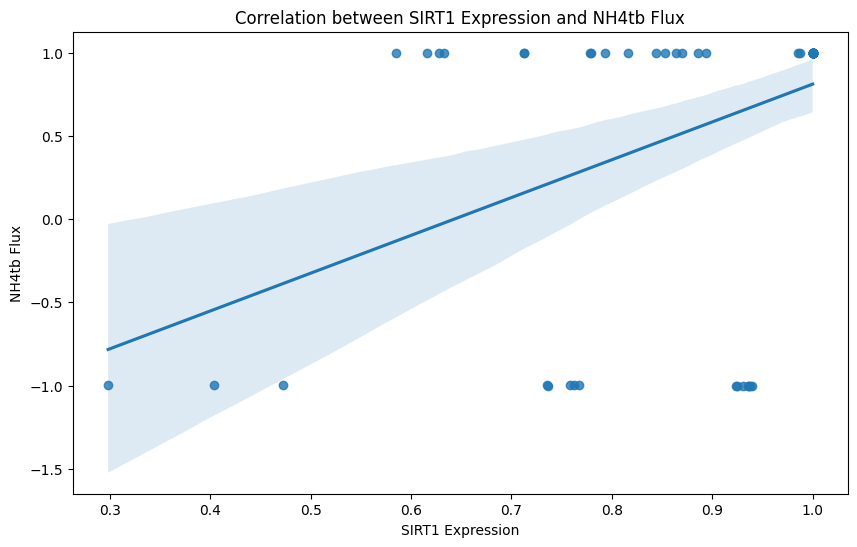

Linear regression results for SIRT1 and NH4tb:
Slope: 2.272212222290851
Intercept: -1.460910585060698
R-squared: 0.1916282249199334
P-value: 0.00013472559683243334
Standard error: 0.5618238591446404



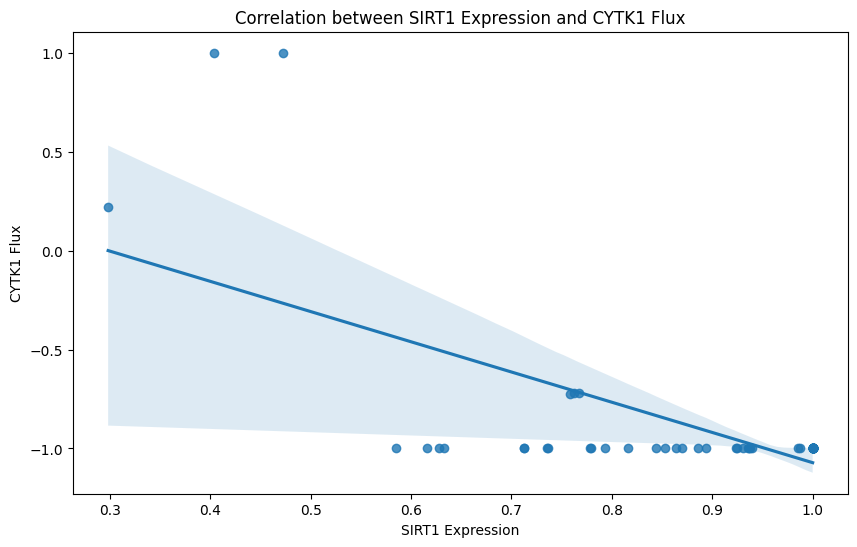

Linear regression results for SIRT1 and CYTK1:
Slope: -1.5273260576297565
Intercept: 0.45556388254453684
R-squared: 0.44455288789077596
P-value: 2.186817563790121e-10
Standard error: 0.20552604003423533



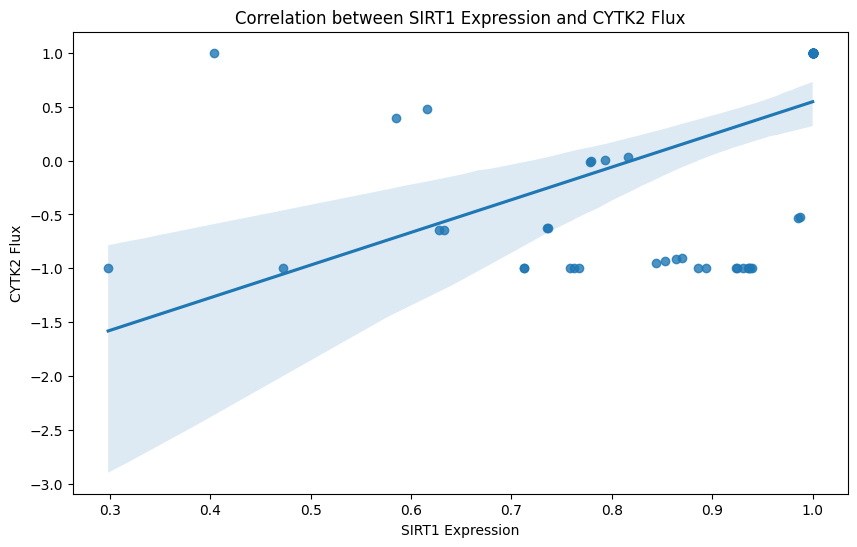

Linear regression results for SIRT1 and CYTK2:
Slope: 3.0294808609741692
Intercept: -2.4839614519849116
R-squared: 0.28233962109342187
P-value: 1.8636986894322242e-06
Standard error: 0.5814565123872241



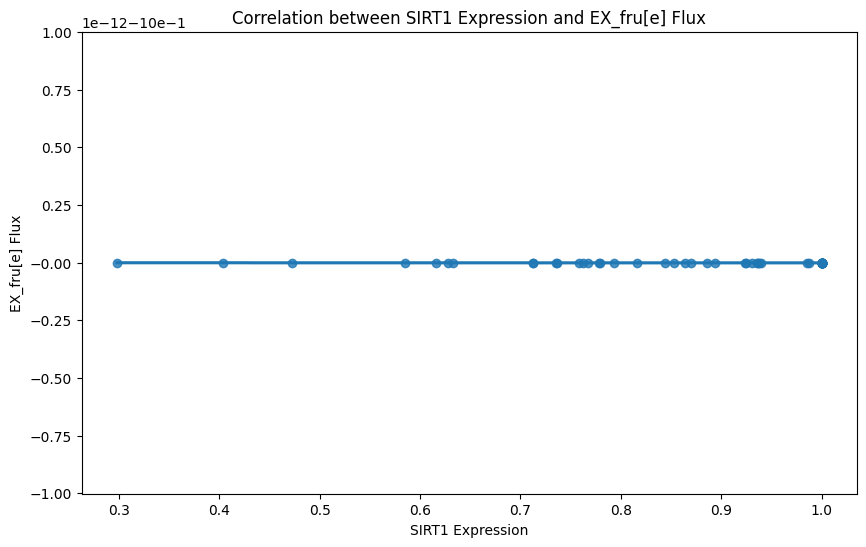

Linear regression results for SIRT1 and EX_fru[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



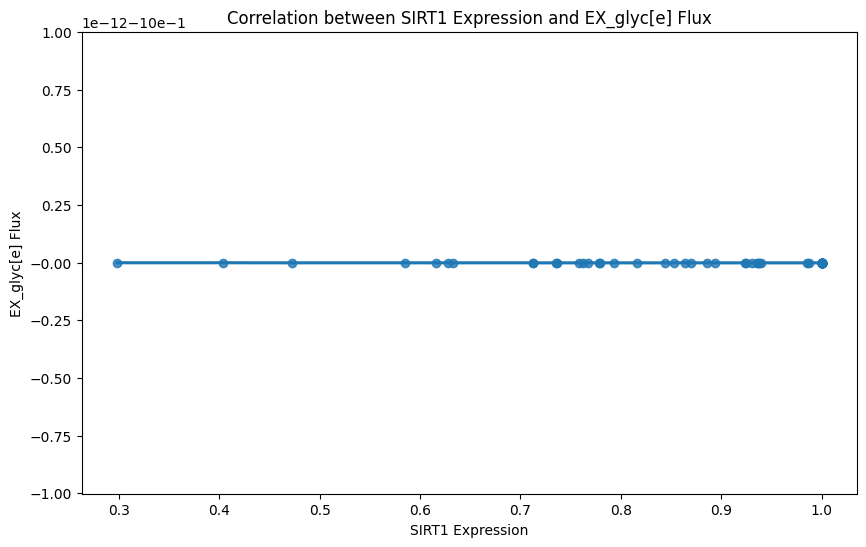

Linear regression results for SIRT1 and EX_glyc[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



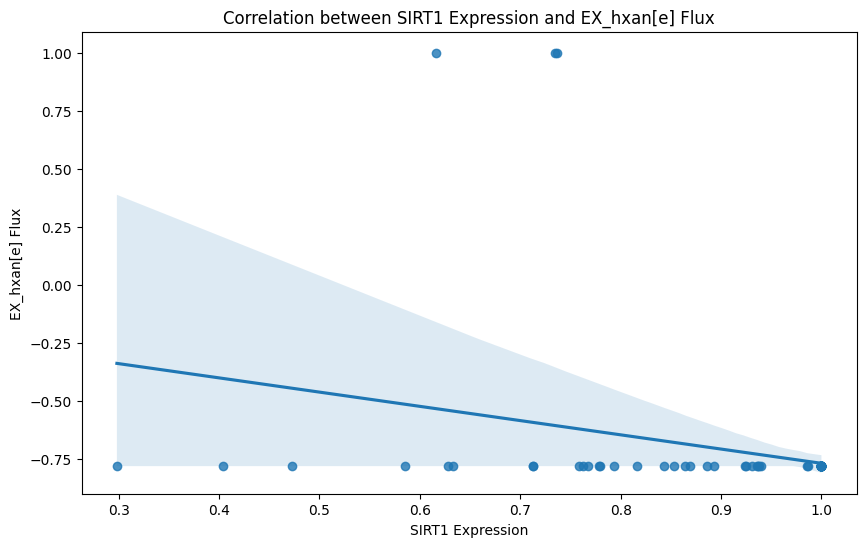

Linear regression results for SIRT1 and EX_hxan[e]:
Slope: -0.6136358930989467
Intercept: -0.15588835933561274
R-squared: 0.07246916092025549
P-value: 0.023198555304578886
Standard error: 0.26428576512928126



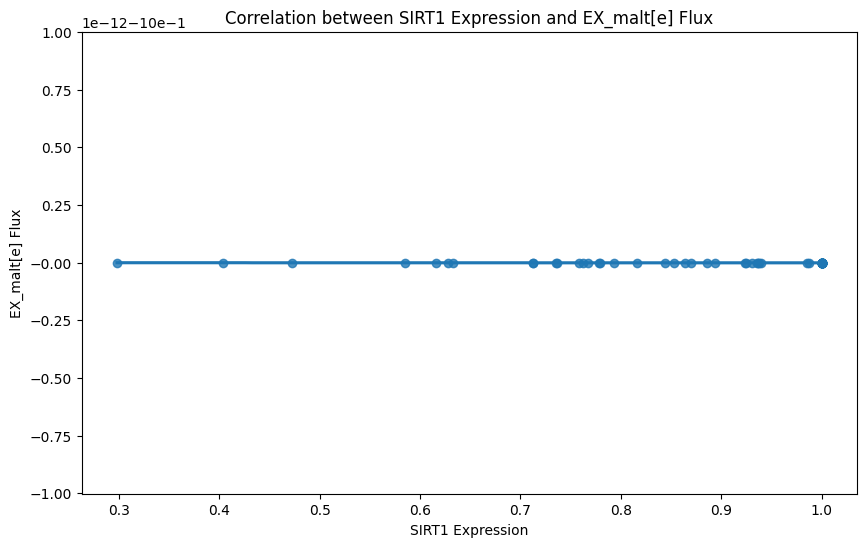

Linear regression results for SIRT1 and EX_malt[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



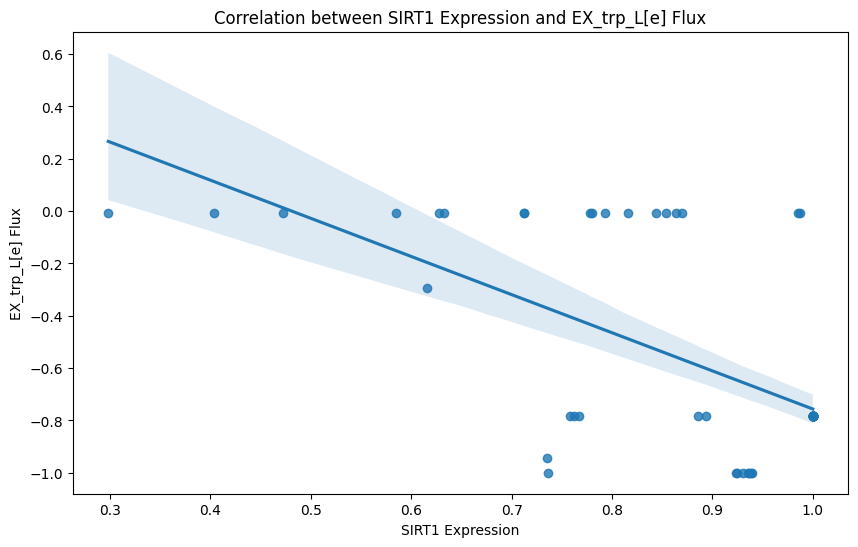

Linear regression results for SIRT1 and EX_trp_L[e]:
Slope: -1.4575845617052132
Intercept: 0.7010425058936282
R-squared: 0.4039721210614332
P-value: 2.6052720497082326e-09
Standard error: 0.21314090434995192



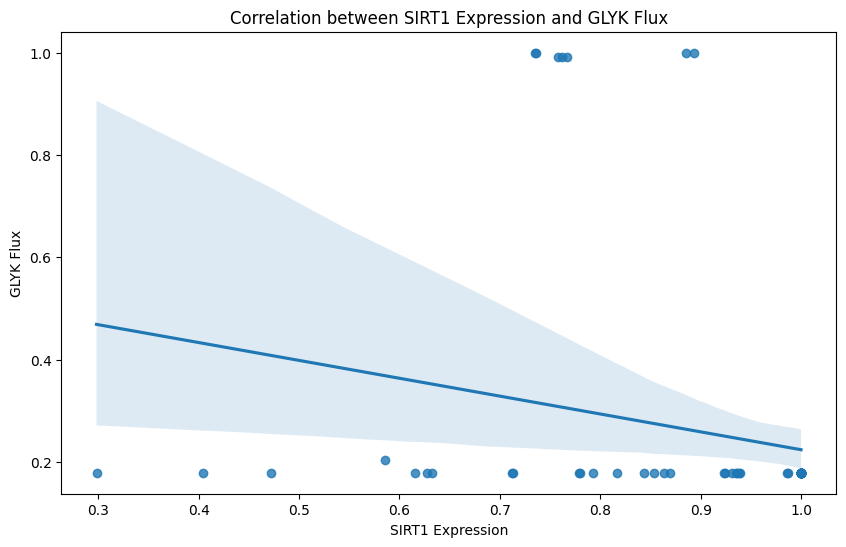

Linear regression results for SIRT1 and GLYK:
Slope: -0.3492568065690055
Intercept: 0.5729765483832648
R-squared: 0.05084134540087429
P-value: 0.058673405997089596
Standard error: 0.18166916583280346



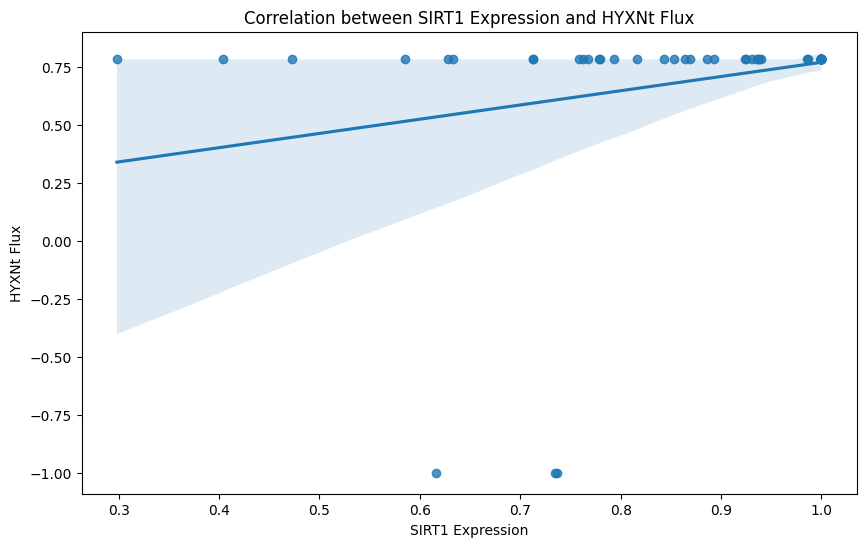

Linear regression results for SIRT1 and HYXNt:
Slope: 0.6136358930989467
Intercept: 0.15588835933561274
R-squared: 0.07246916092025549
P-value: 0.023198555304578886
Standard error: 0.26428576512928126



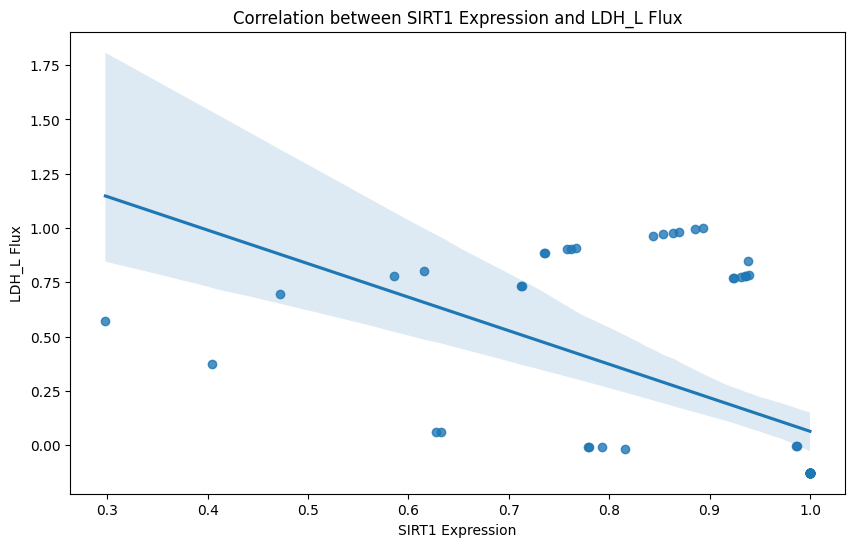

Linear regression results for SIRT1 and LDH_L:
Slope: -1.5437120752574822
Intercept: 1.6081943690738054
R-squared: 0.28829861325543527
P-value: 1.384510539482044e-06
Standard error: 0.29199094609444787



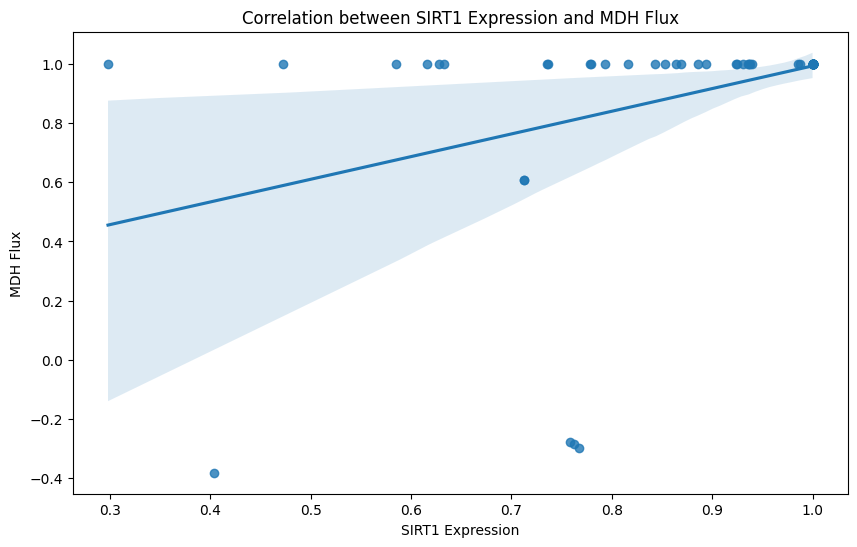

Linear regression results for SIRT1 and MDH:
Slope: 0.7672512976341166
Intercept: 0.2266796252108002
R-squared: 0.15454777543890055
P-value: 0.0006953975097906443
Standard error: 0.2160360573088293



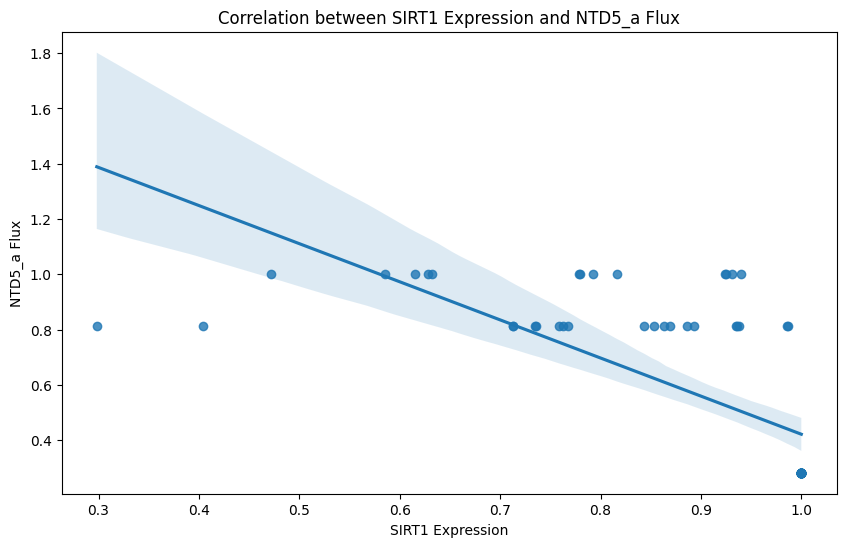

Linear regression results for SIRT1 and NTD5_a:
Slope: -1.379328191636309
Intercept: 1.800439157835414
R-squared: 0.49557268297374996
P-value: 7.480256957199697e-12
Standard error: 0.16752849482276286



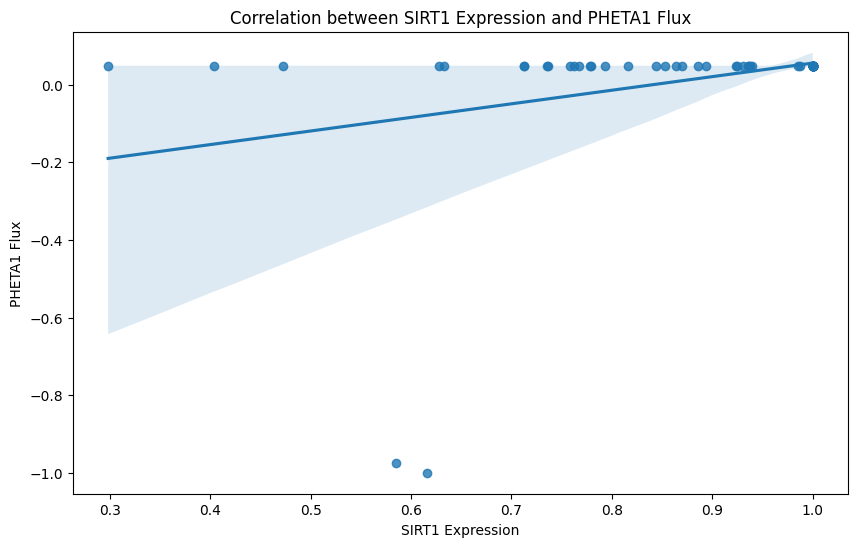

Linear regression results for SIRT1 and PHETA1:
Slope: 0.3502895408876716
Intercept: -0.2942197471175911
R-squared: 0.10306487510252414
P-value: 0.0063381641965895436
Standard error: 0.1244021253132958



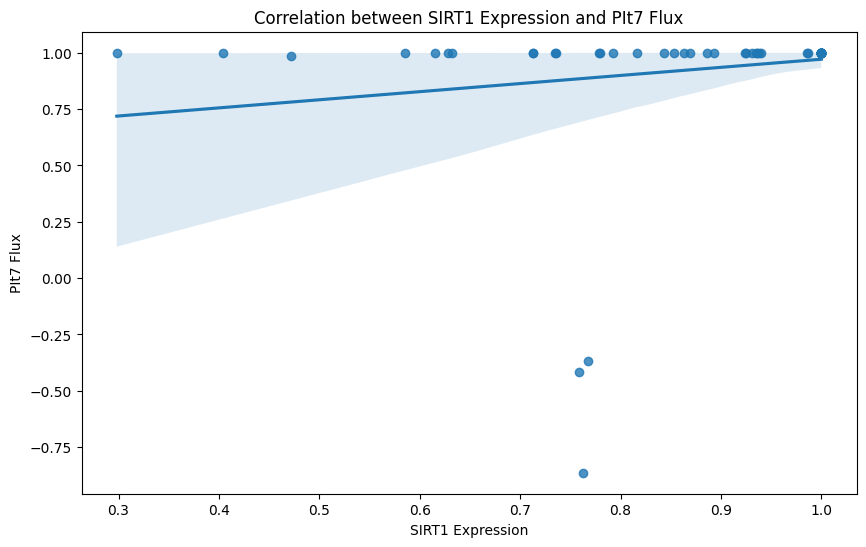

Linear regression results for SIRT1 and PIt7:
Slope: 0.35980021241573223
Intercept: 0.6115547030639568
R-squared: 0.03226256993100767
P-value: 0.1339147060512548
Standard error: 0.23722811613765035



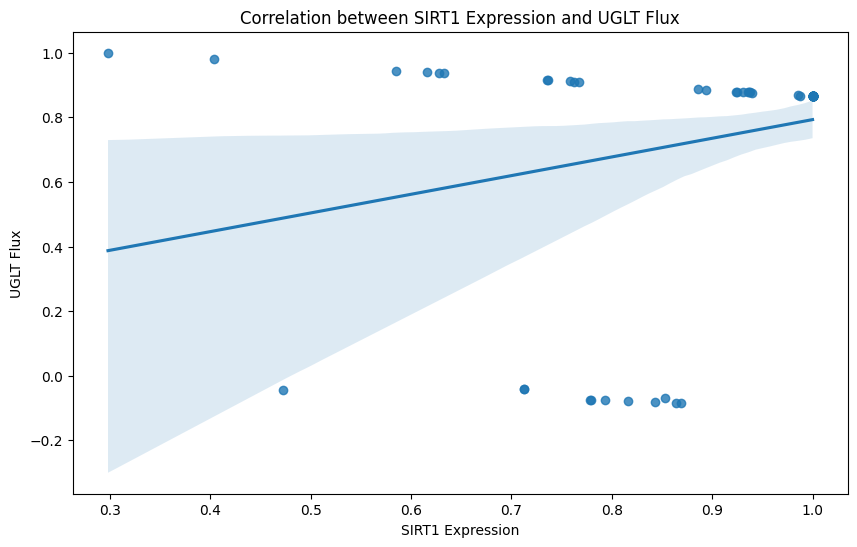

Linear regression results for SIRT1 and UGLT:
Slope: 0.5780838921296468
Intercept: 0.21485786962322262
R-squared: 0.0697064862020553
P-value: 0.02609329195030362
Standard error: 0.2542375670099459



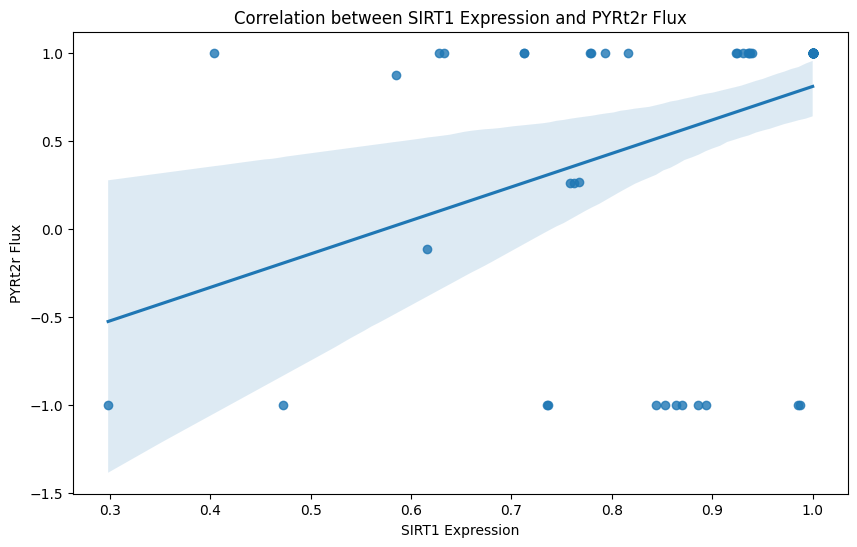

Linear regression results for SIRT1 and PYRt2r:
Slope: 1.9005764241929037
Intercept: -1.0918011186816292
R-squared: 0.15743545881001034
P-value: 0.0006130500557211986
Standard error: 0.5293112253465239



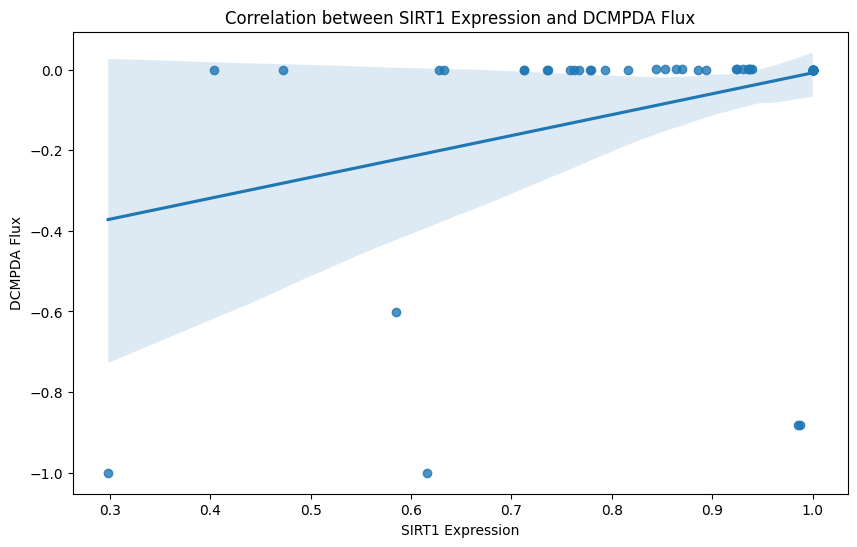

Linear regression results for SIRT1 and DCMPDA:
Slope: 0.518645490710942
Intercept: -0.526662090552132
R-squared: 0.1293631171953956
P-value: 0.00206552411938812
Standard error: 0.1619792394954798



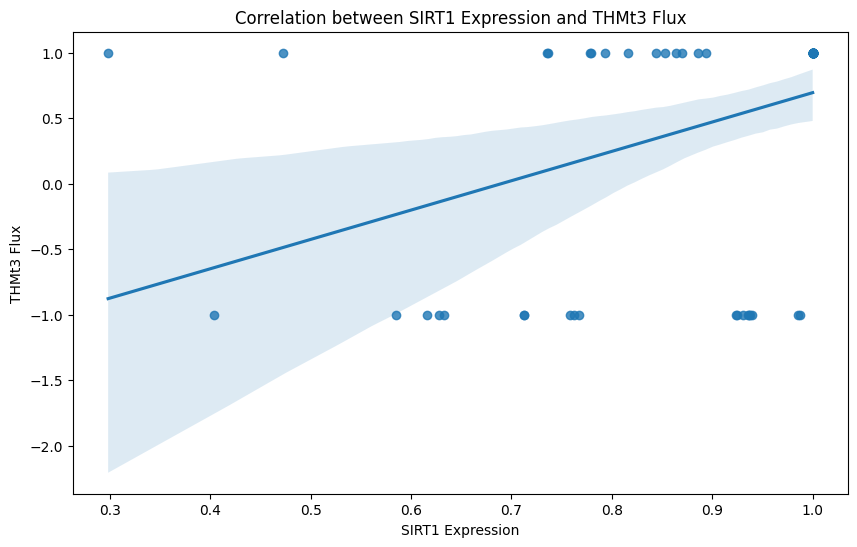

Linear regression results for SIRT1 and THMt3:
Slope: 2.24038714803932
Intercept: -1.54516791428985
R-squared: 0.15829118576489026
P-value: 0.0005905441586727479
Standard error: 0.6219437367333217



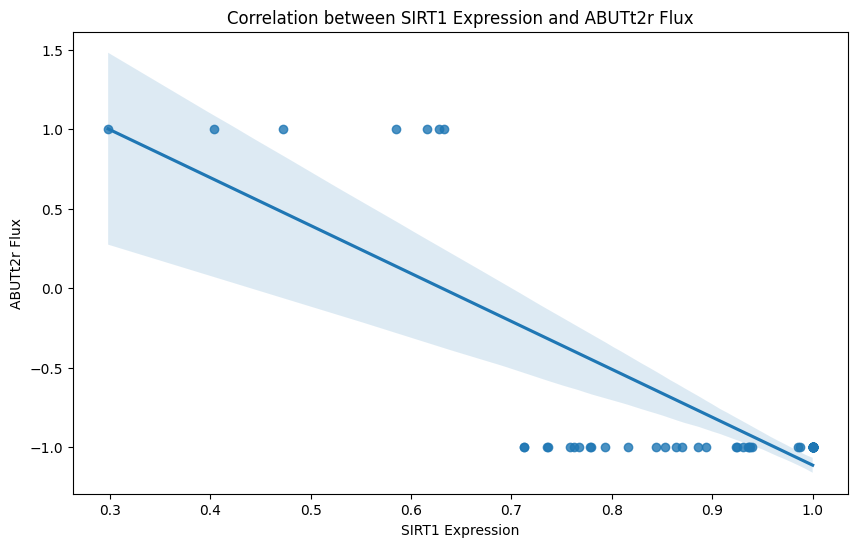

Linear regression results for SIRT1 and ABUTt2r:
Slope: -3.012922147589363
Intercept: 1.9002172156141846
R-squared: 0.6313429531691807
P-value: 1.3359299192866332e-16
Standard error: 0.27716728372179134



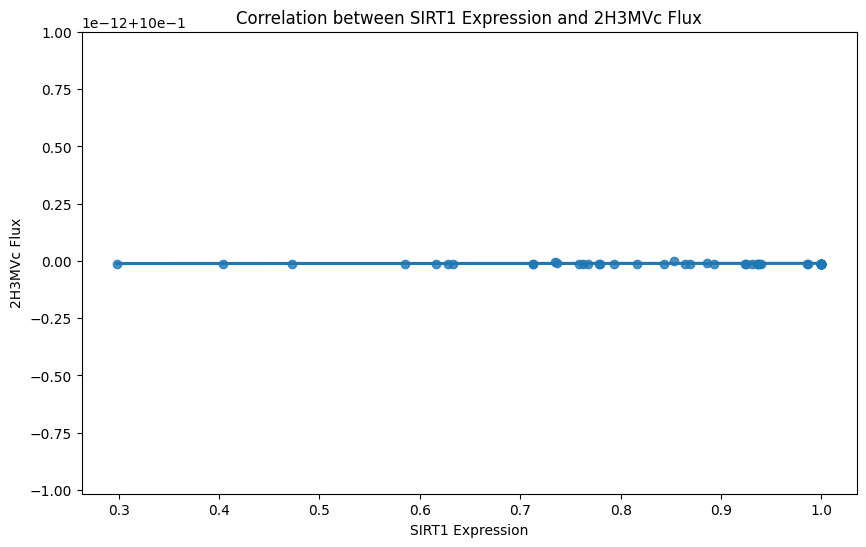

Linear regression results for SIRT1 and 2H3MVc:
Slope: 3.4655920252695937e-16
Intercept: 0.999999999999988
R-squared: 0.0009666138617114191
P-value: 0.7968818261117835
Standard error: 1.3412705276813811e-15



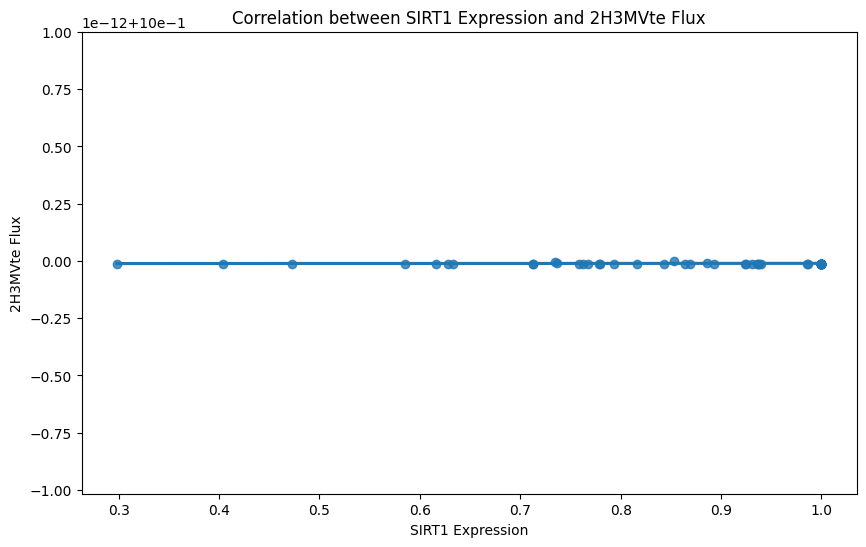

Linear regression results for SIRT1 and 2H3MVte:
Slope: 3.4655920252695937e-16
Intercept: 0.999999999999988
R-squared: 0.0009666138617114191
P-value: 0.7968818261117835
Standard error: 1.3412705276813811e-15



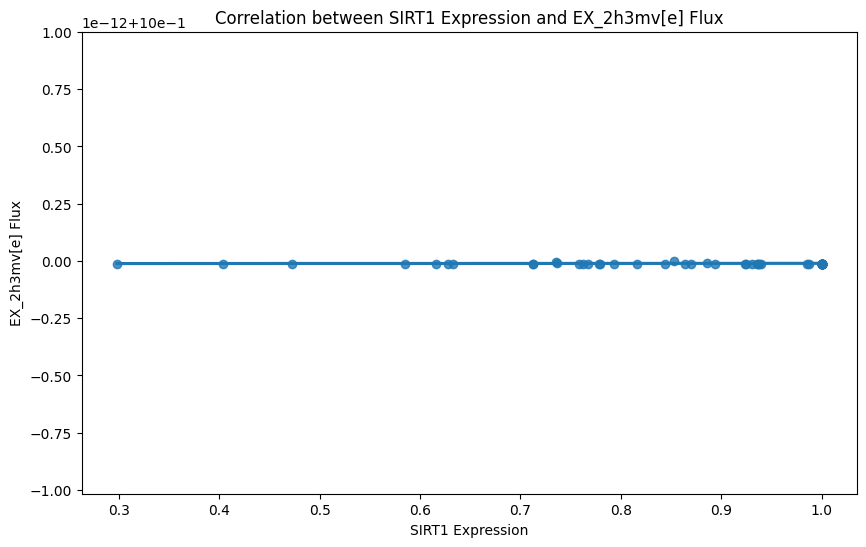

Linear regression results for SIRT1 and EX_2h3mv[e]:
Slope: 3.4655920252695937e-16
Intercept: 0.999999999999988
R-squared: 0.0009666138617114191
P-value: 0.7968818261117835
Standard error: 1.3412705276813811e-15



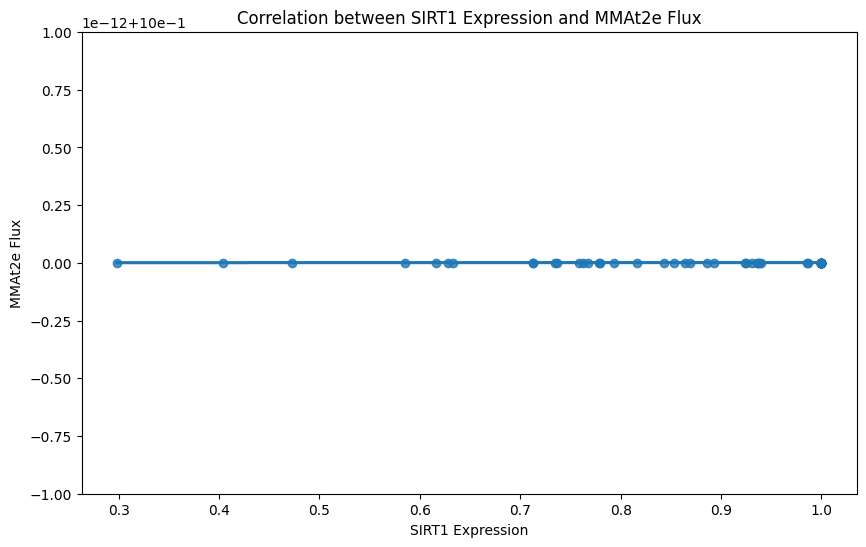

Linear regression results for SIRT1 and MMAt2e:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



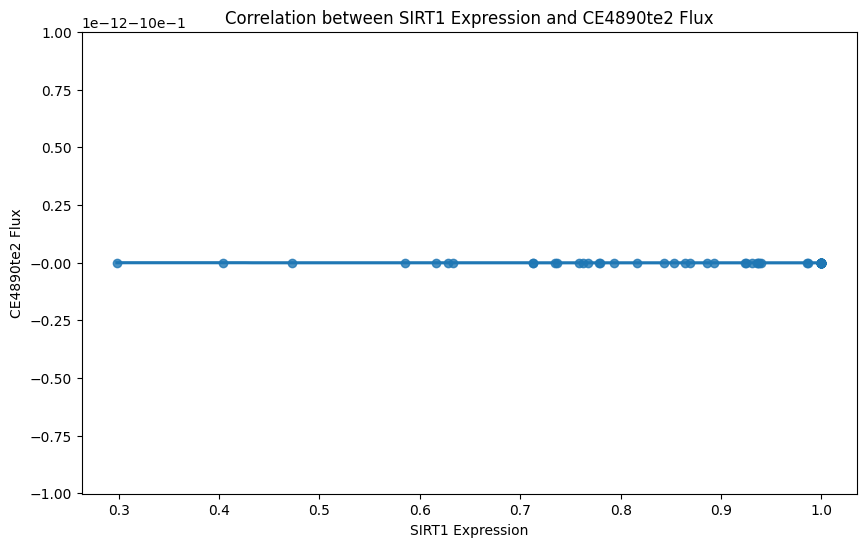

Linear regression results for SIRT1 and CE4890te2:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



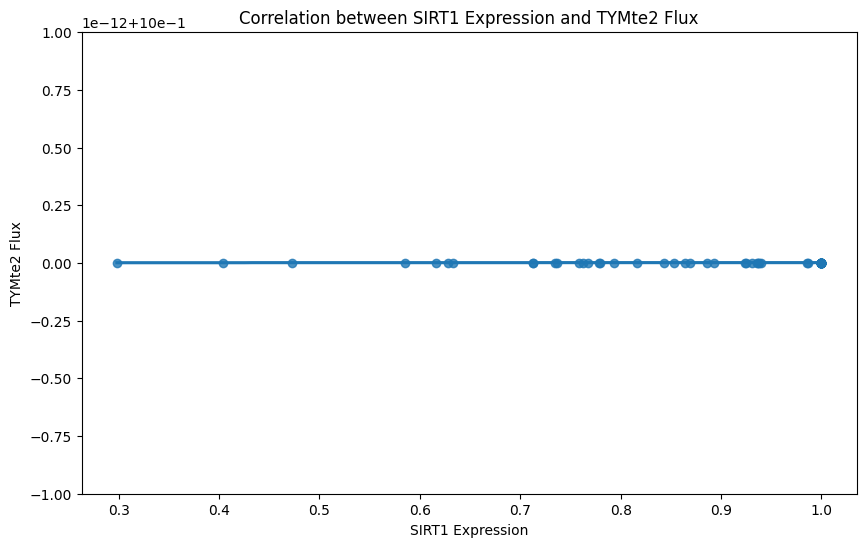

Linear regression results for SIRT1 and TYMte2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



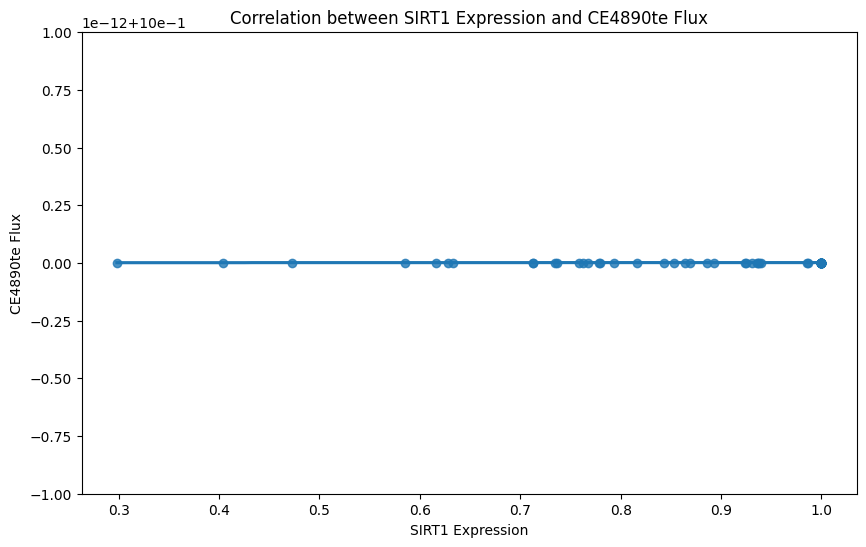

Linear regression results for SIRT1 and CE4890te:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



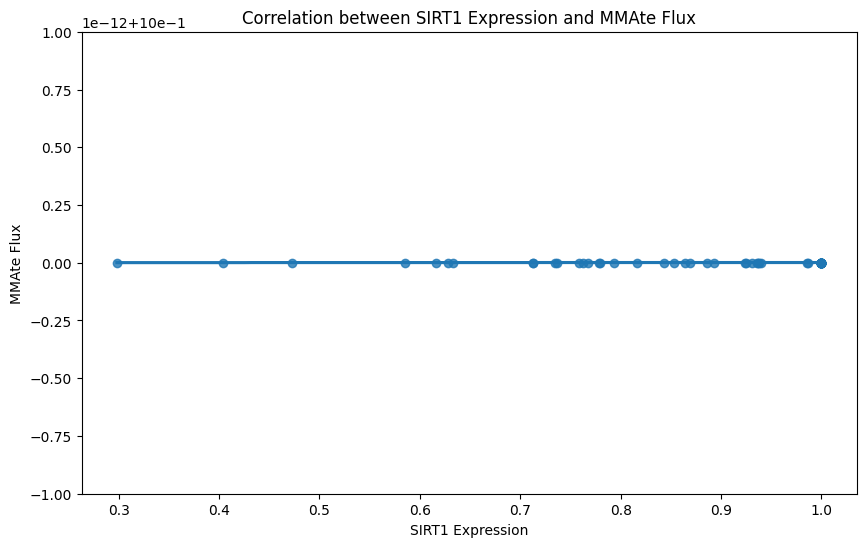

Linear regression results for SIRT1 and MMAte:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



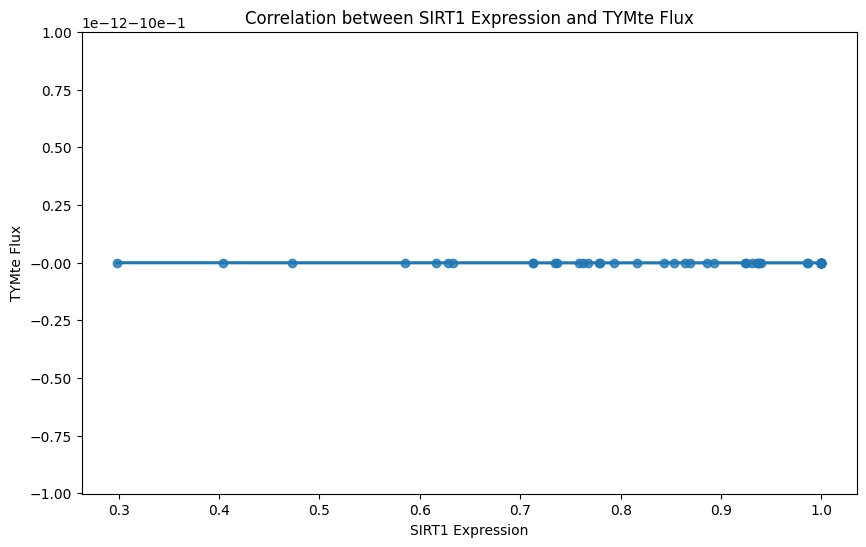

Linear regression results for SIRT1 and TYMte:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



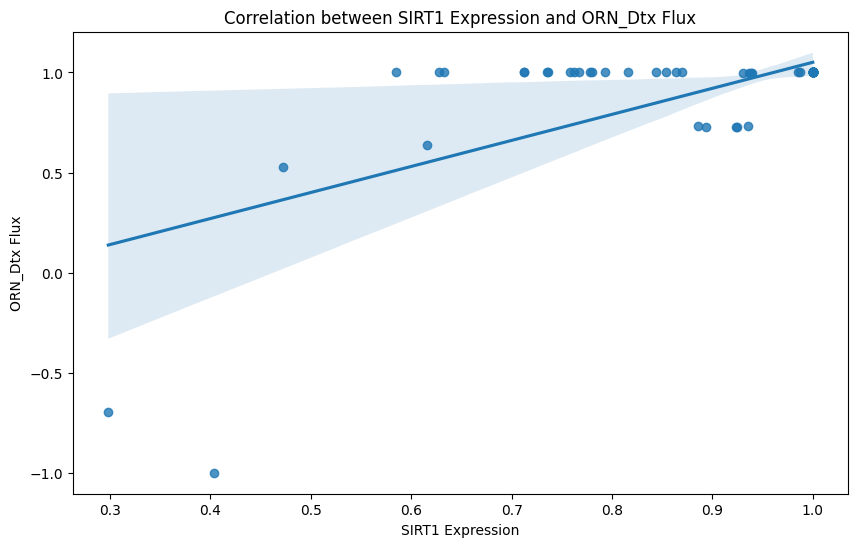

Linear regression results for SIRT1 and ORN_Dtx:
Slope: 1.3012831781873815
Intercept: -0.2503843128521376
R-squared: 0.41811473437547453
P-value: 1.1195443947424952e-09
Standard error: 0.1848069136553518



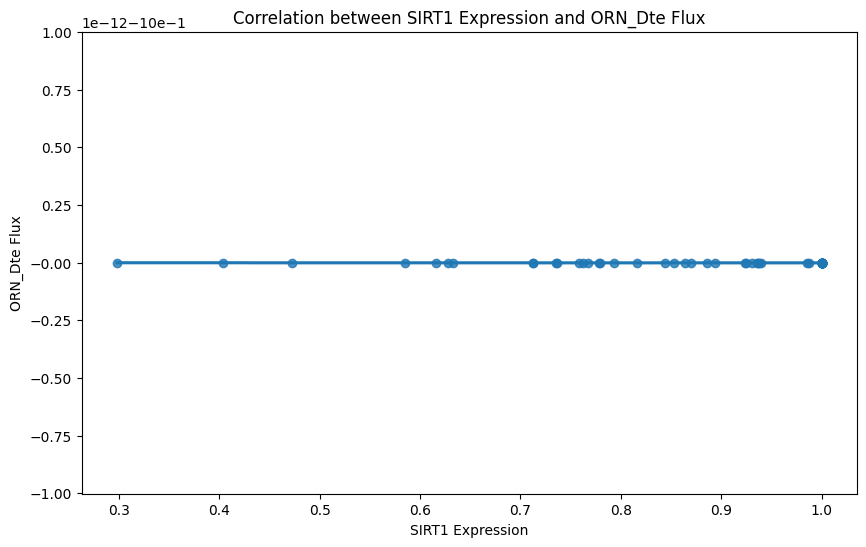

Linear regression results for SIRT1 and ORN_Dte:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



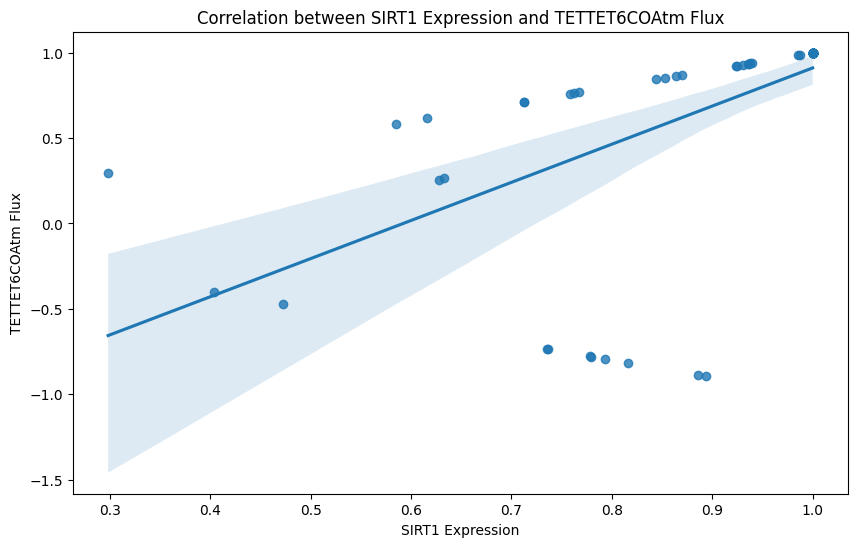

Linear regression results for SIRT1 and TETTET6COAtm:
Slope: 2.2332729205509496
Intercept: -1.322303489749343
R-squared: 0.3461885320374568
P-value: 6.815697552759637e-08
Standard error: 0.3694768079496322



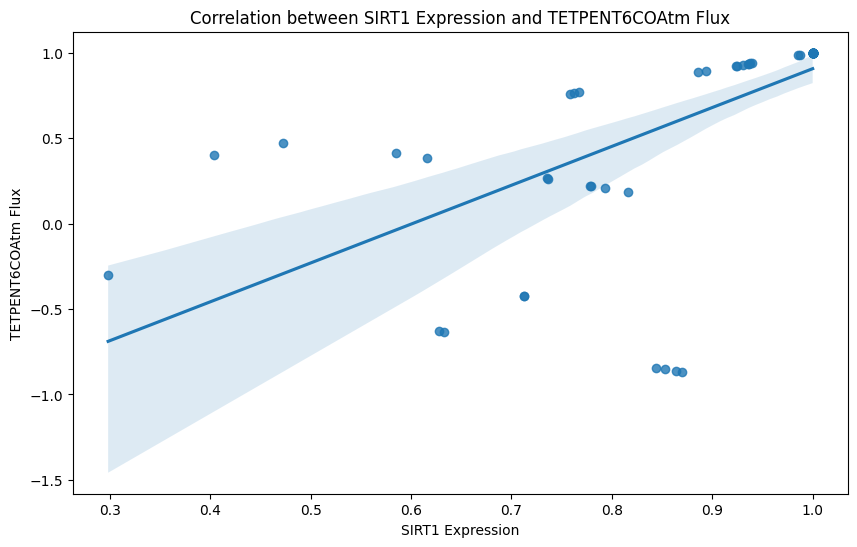

Linear regression results for SIRT1 and TETPENT6COAtm:
Slope: 2.2737654525519293
Intercept: -1.3671409712493254
R-squared: 0.4045391714397057
P-value: 2.5194534865423198e-09
Standard error: 0.33209889194559794



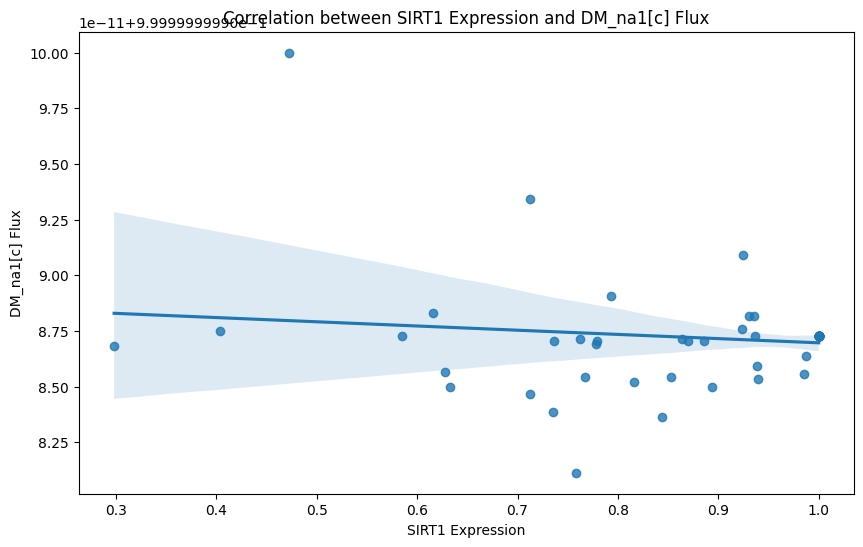

Linear regression results for SIRT1 and DM_na1[c]:
Slope: -1.8920358729684732e-12
Intercept: 0.9999999999888556
R-squared: 0.01955492786402373
P-value: 0.24478308099998758
Standard error: 1.6128290820154123e-12



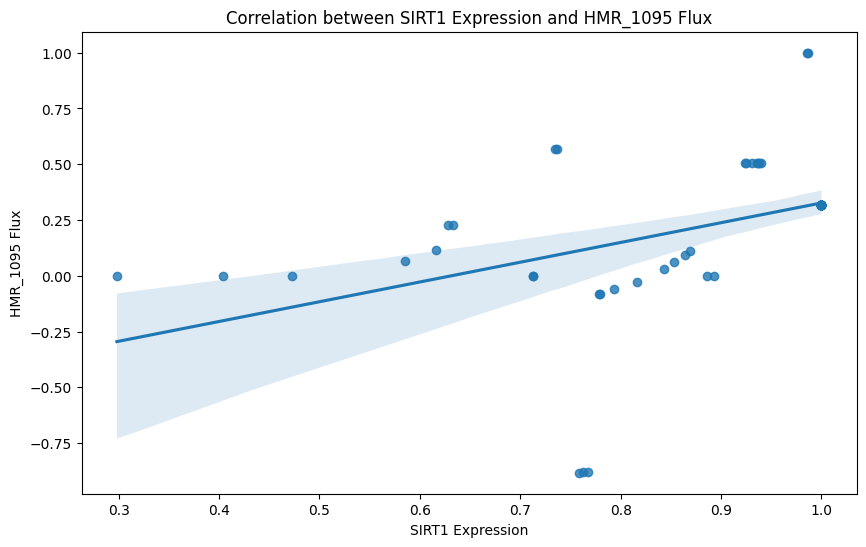

Linear regression results for SIRT1 and HMR_1095:
Slope: 0.8857789412781669
Intercept: -0.5592332504861204
R-squared: 0.20291629341641276
P-value: 8.086104943798948e-05
Standard error: 0.21134613555284418



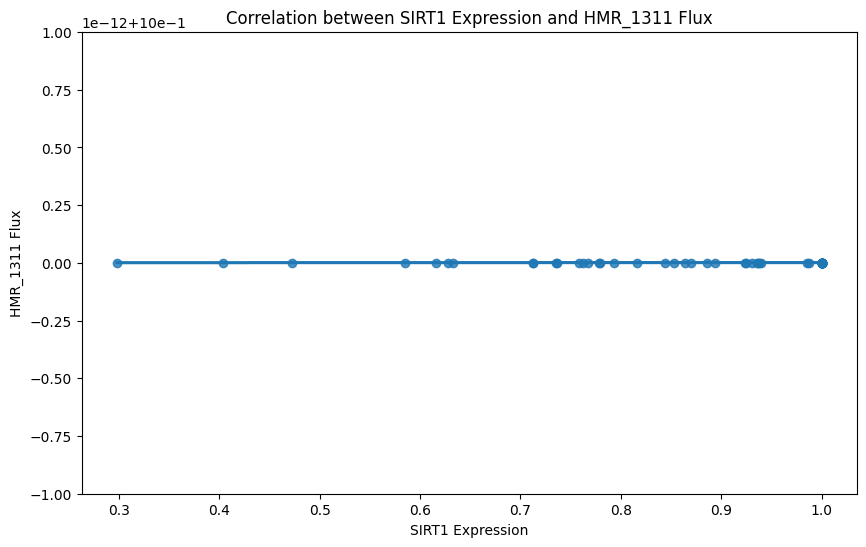

Linear regression results for SIRT1 and HMR_1311:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



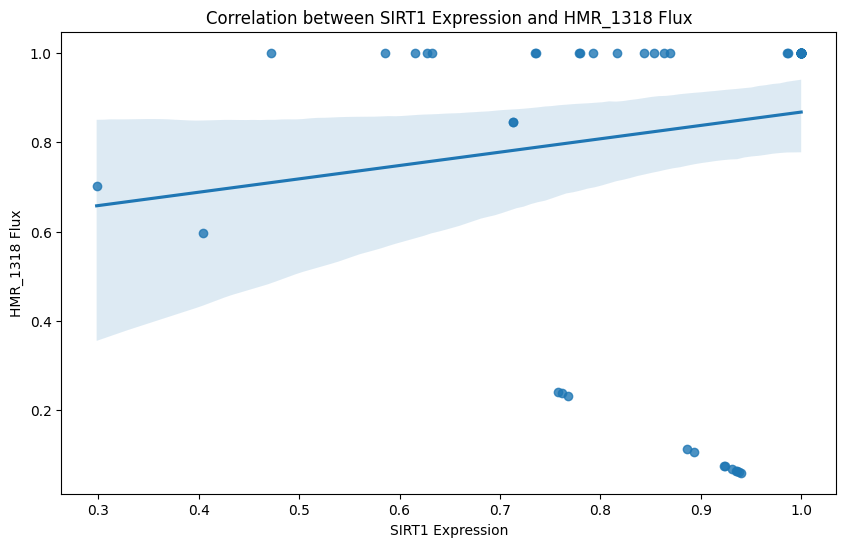

Linear regression results for SIRT1 and HMR_1318:
Slope: 0.2988283087648997
Intercept: 0.5684001410179964
R-squared: 0.020048298828276342
P-value: 0.23885896032543352
Standard error: 0.2515131888983019



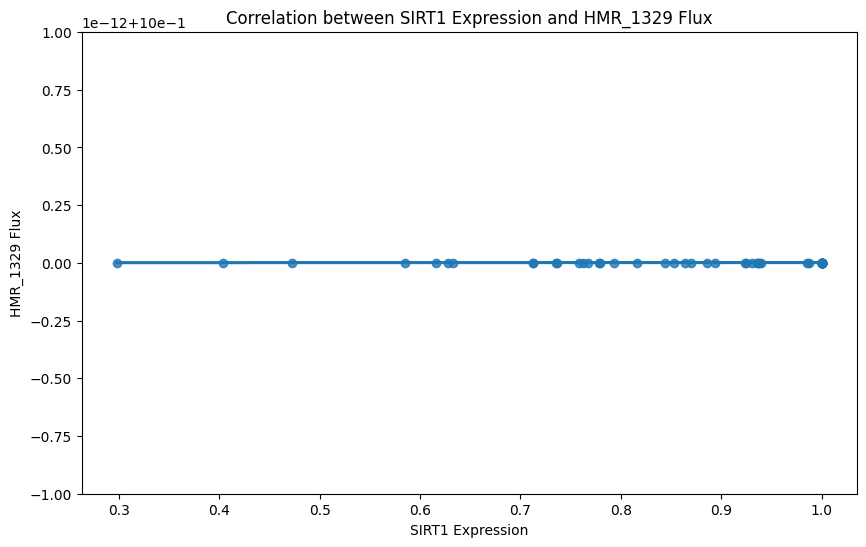

Linear regression results for SIRT1 and HMR_1329:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



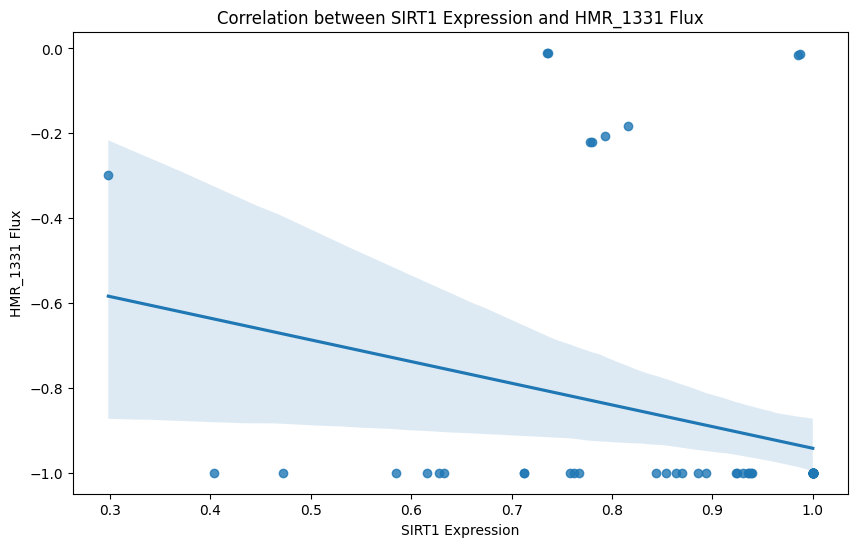

Linear regression results for SIRT1 and HMR_1331:
Slope: -0.5109483053225474
Intercept: -0.4314396223038144
R-squared: 0.07580339280348261
P-value: 0.02013342158010153
Standard error: 0.2147782406349313



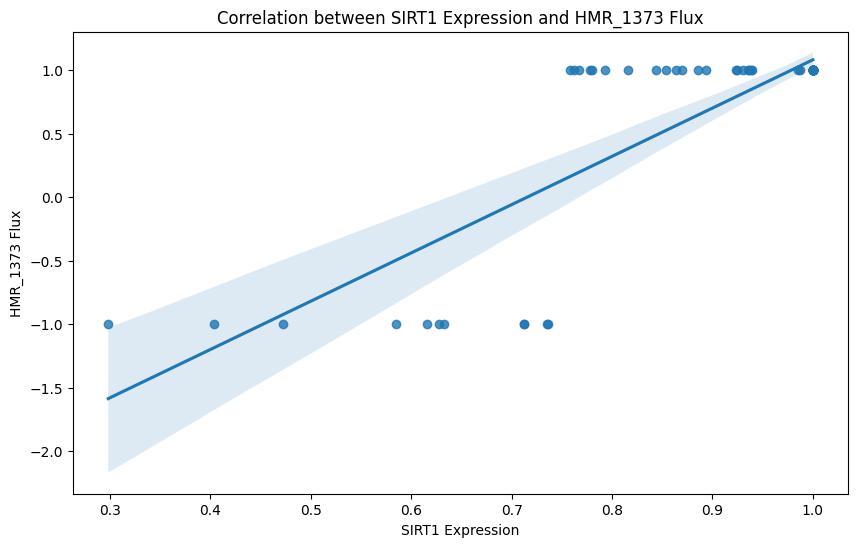

Linear regression results for SIRT1 and HMR_1373:
Slope: 3.801524997037321
Intercept: -2.720385965895401
R-squared: 0.682243328047746
P-value: 7.645990058587114e-19
Standard error: 0.31232805429407384



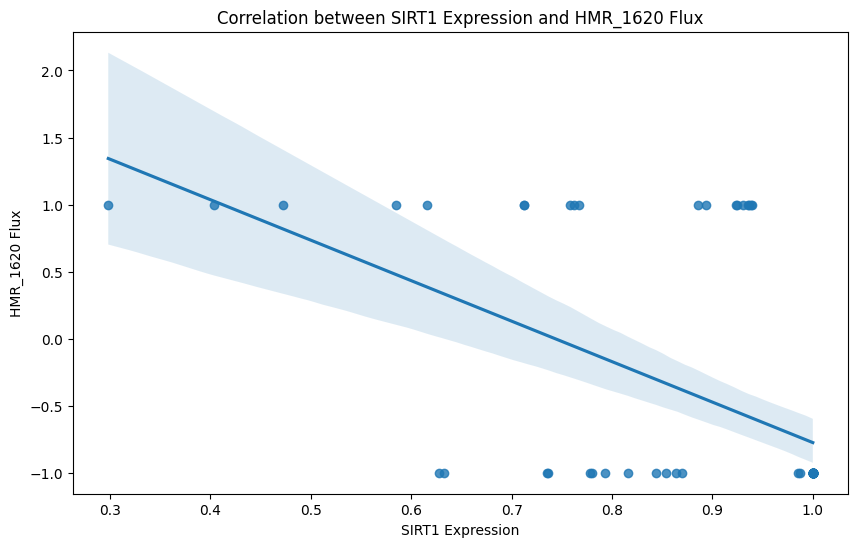

Linear regression results for SIRT1 and HMR_1620:
Slope: -3.019053160259966
Intercept: 2.243745804356604
R-squared: 0.28744324535065524
P-value: 1.4450533866656335e-06
Standard error: 0.572242213251848



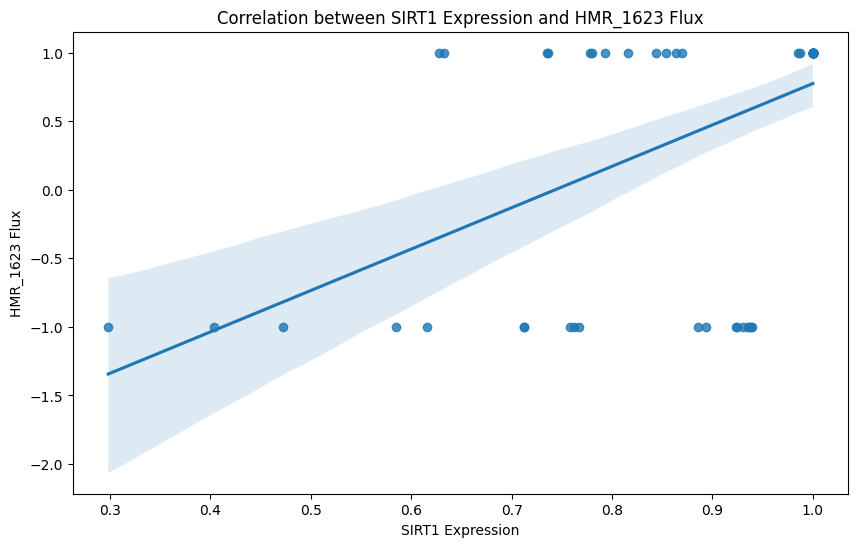

Linear regression results for SIRT1 and HMR_1623:
Slope: 3.019053160259966
Intercept: -2.243745804356604
R-squared: 0.28744324535065524
P-value: 1.4450533866656335e-06
Standard error: 0.572242213251848



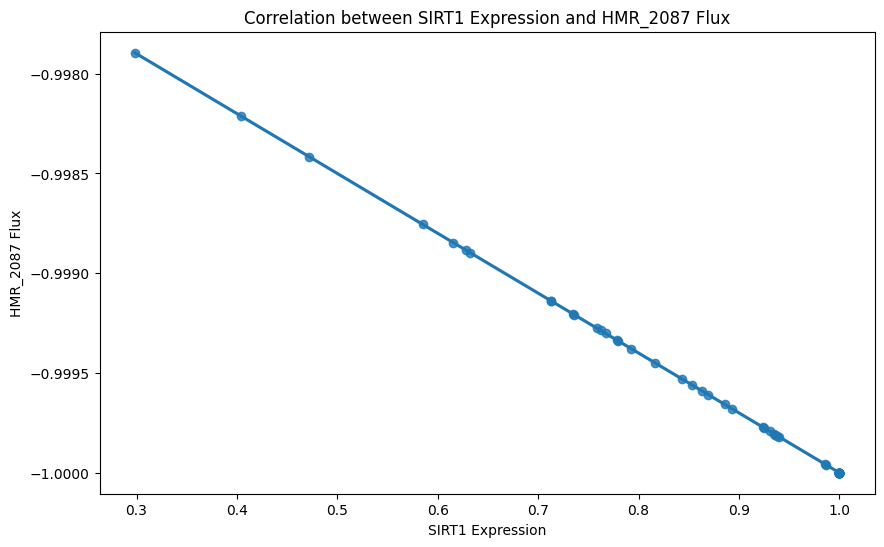

Linear regression results for SIRT1 and HMR_2087:
Slope: -0.003000000000000002
Intercept: -0.997
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



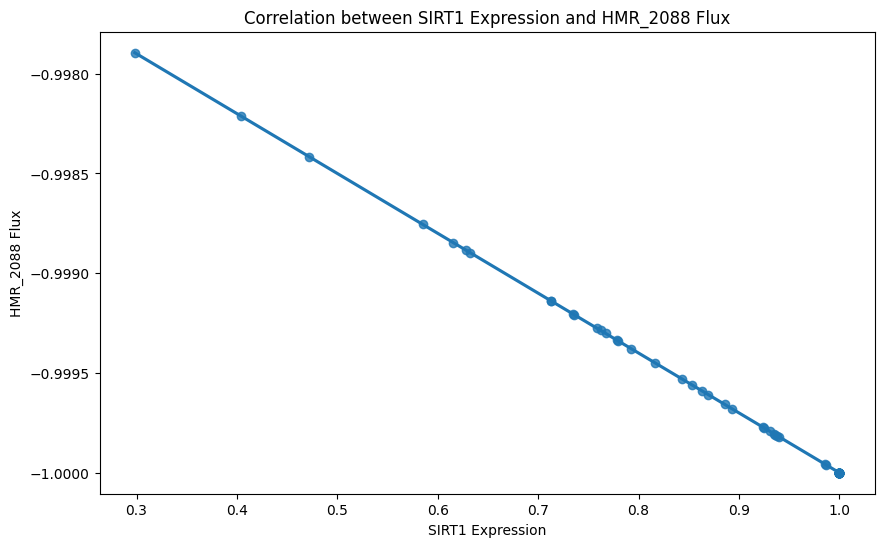

Linear regression results for SIRT1 and HMR_2088:
Slope: -0.003000000000000002
Intercept: -0.997
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



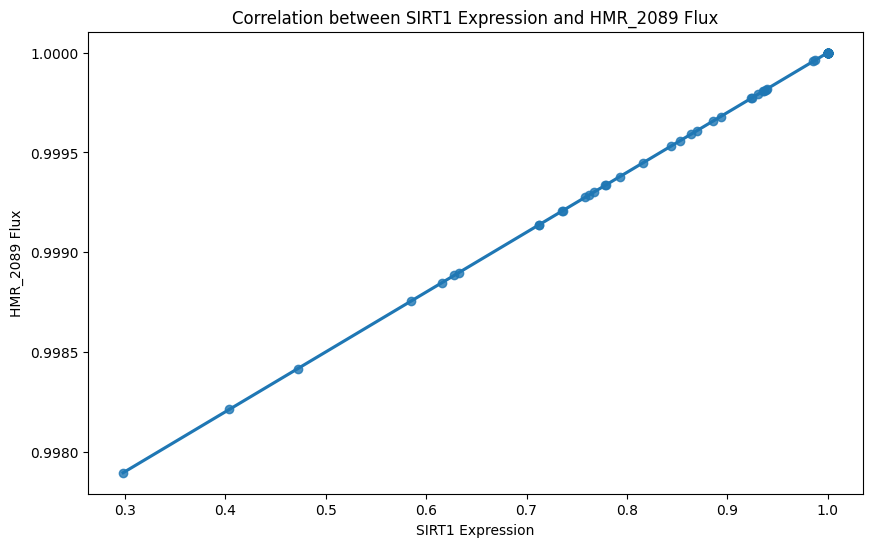

Linear regression results for SIRT1 and HMR_2089:
Slope: 0.003000000000000002
Intercept: 0.997
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



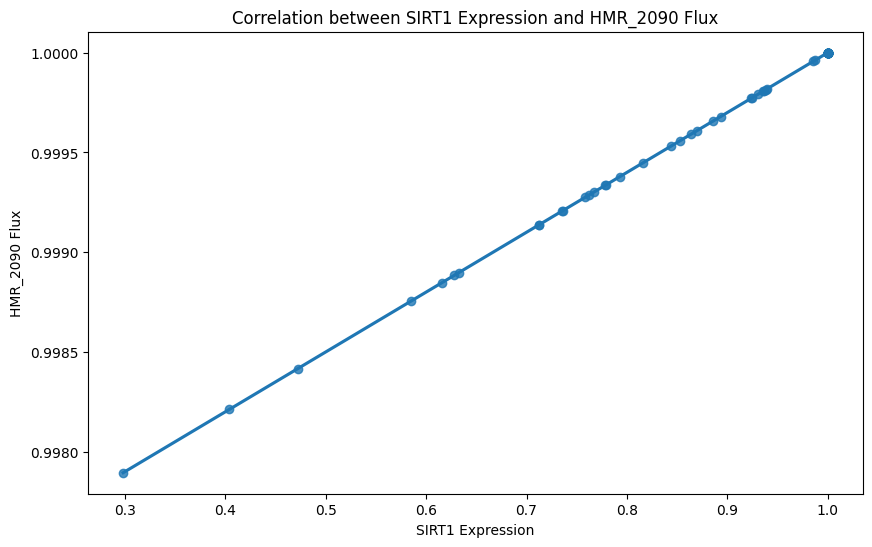

Linear regression results for SIRT1 and HMR_2090:
Slope: 0.003000000000000002
Intercept: 0.997
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



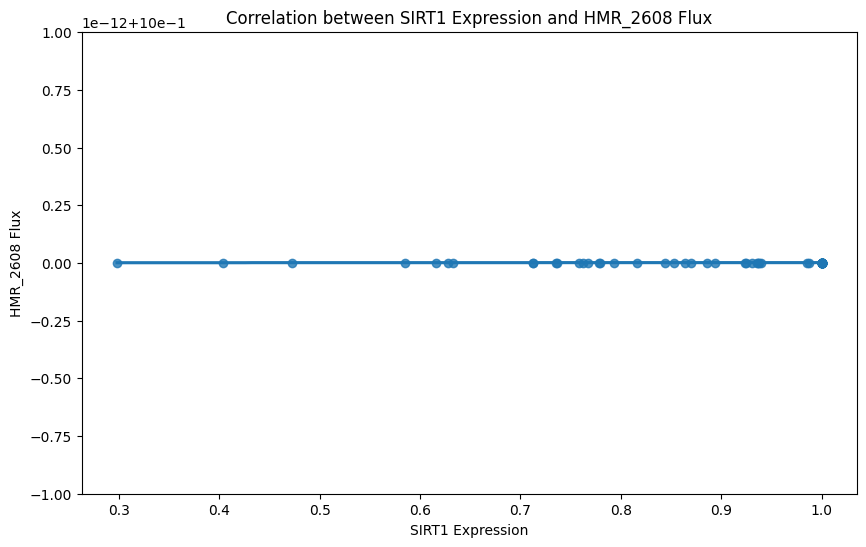

Linear regression results for SIRT1 and HMR_2608:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



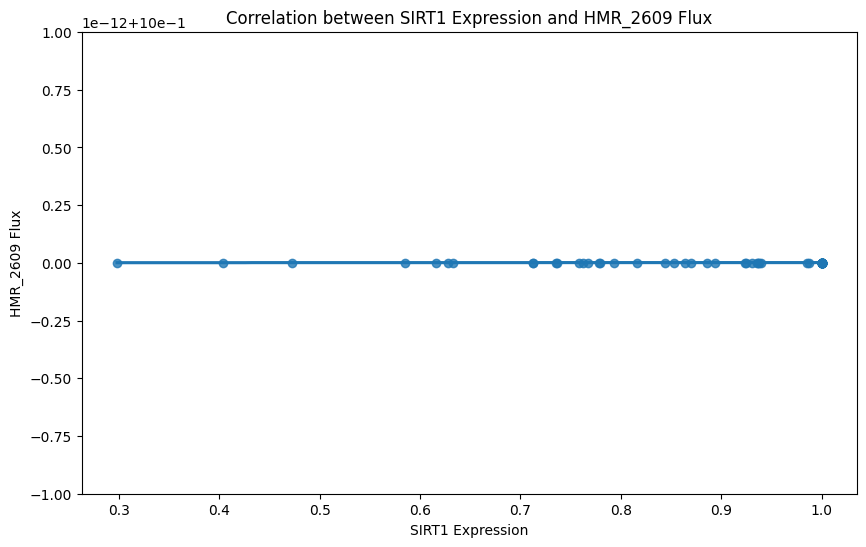

Linear regression results for SIRT1 and HMR_2609:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



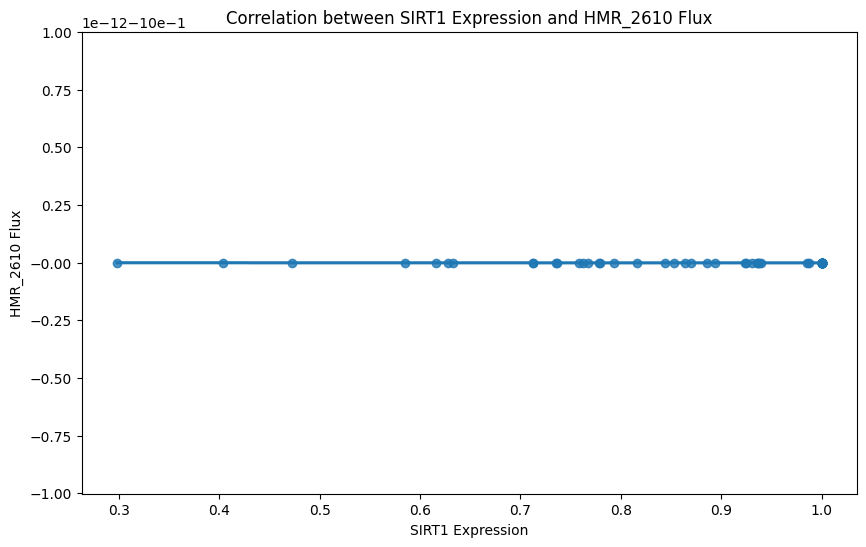

Linear regression results for SIRT1 and HMR_2610:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



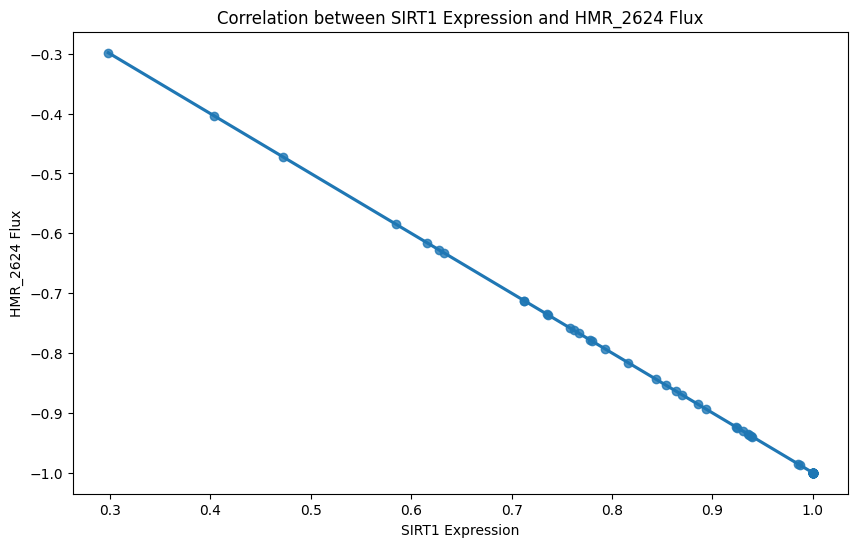

Linear regression results for SIRT1 and HMR_2624:
Slope: -1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



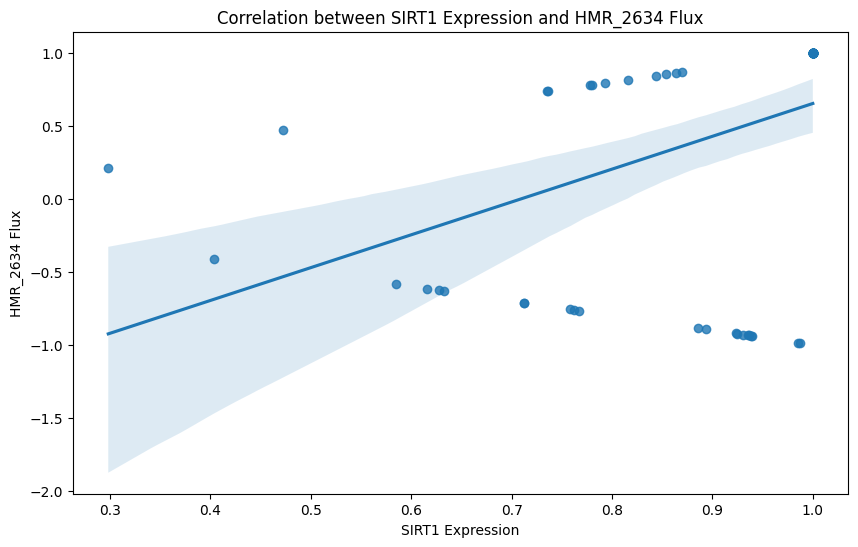

Linear regression results for SIRT1 and HMR_2634:
Slope: 2.249260611401856
Intercept: -1.597036945084168
R-squared: 0.19185834732870902
P-value: 0.00013333799765151037
Standard error: 0.5557361253874944



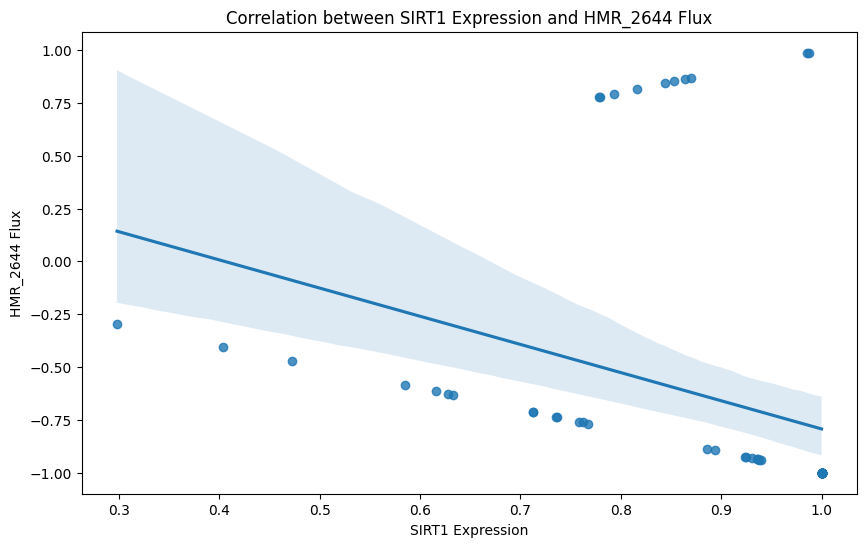

Linear regression results for SIRT1 and HMR_2644:
Slope: -1.3330950665425827
Intercept: 0.5402408692030255
R-squared: 0.10995325302341569
P-value: 0.004730357178105944
Standard error: 0.45660319188339504



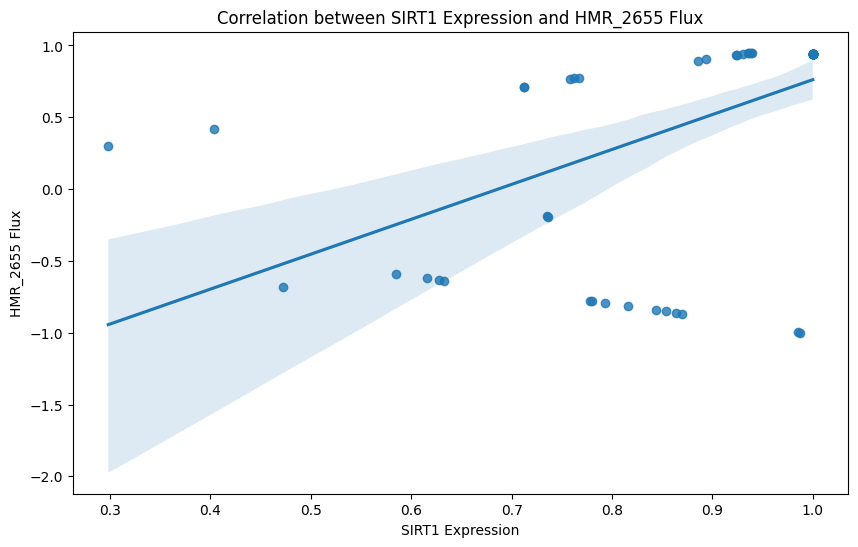

Linear regression results for SIRT1 and HMR_2655:
Slope: 2.430519618287535
Intercept: -1.6684953104683828
R-squared: 0.29446569642304865
P-value: 1.0155134666876285e-06
Standard error: 0.4529145764164092



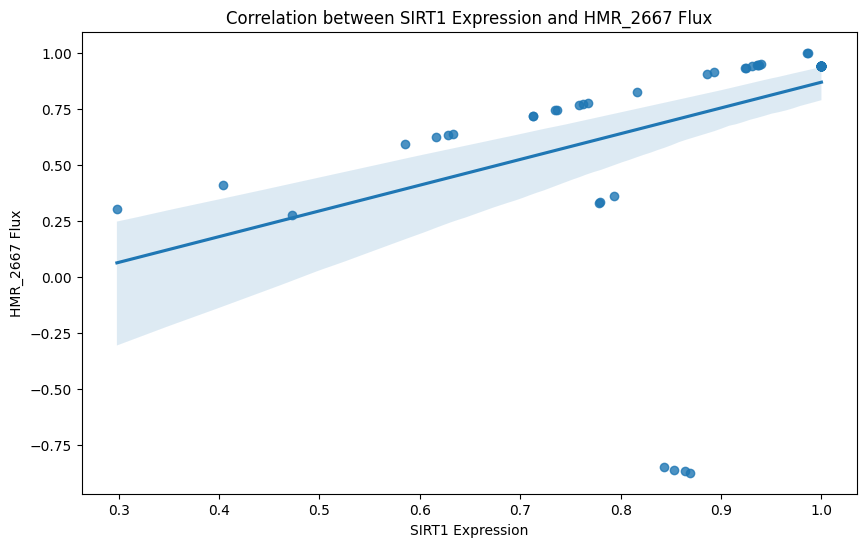

Linear regression results for SIRT1 and HMR_2667:
Slope: 1.1490974739423507
Intercept: -0.28060665994878997
R-squared: 0.17342767705218567
P-value: 0.00030346149837490643
Standard error: 0.3020045949018308



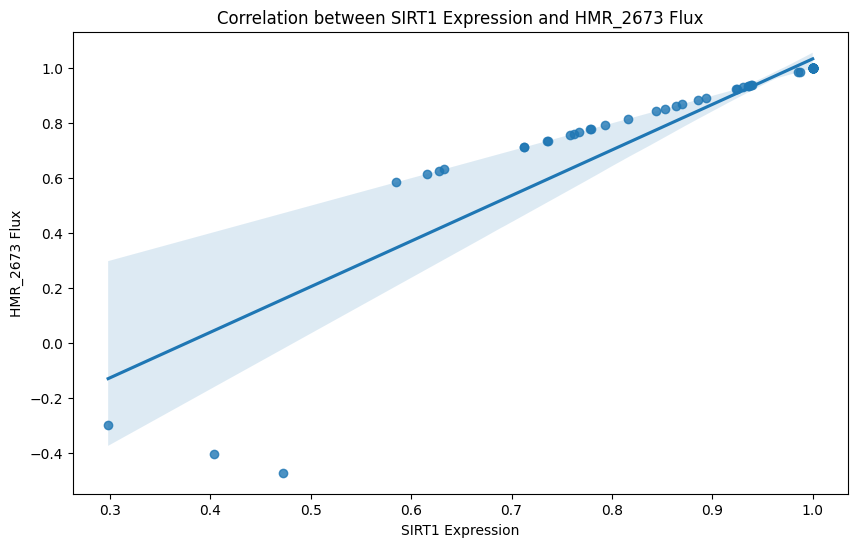

Linear regression results for SIRT1 and HMR_2673:
Slope: 1.6591274860676999
Intercept: -0.6244160957538494
R-squared: 0.8200808805760015
P-value: 2.1030472605115374e-27
Standard error: 0.09355468219302412



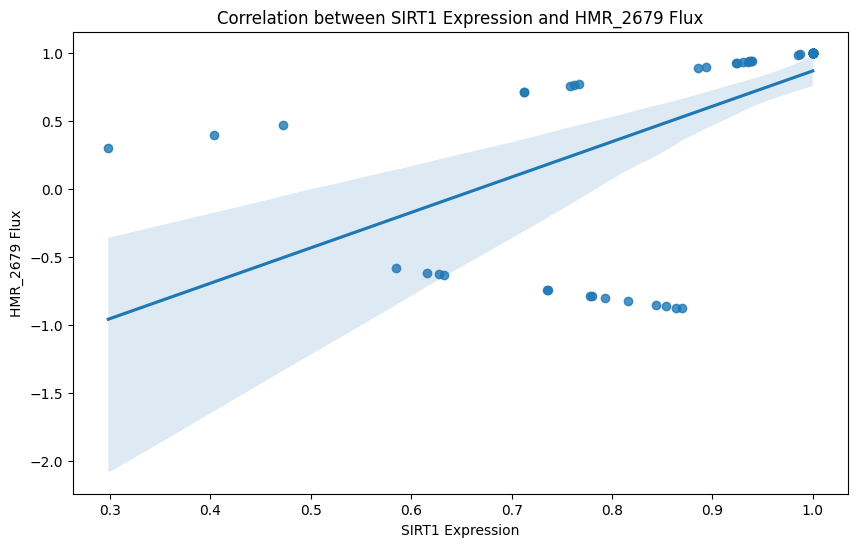

Linear regression results for SIRT1 and HMR_2679:
Slope: 2.601154546660201
Intercept: -1.7346287697262641
R-squared: 0.3536697626200278
P-value: 4.536993266614089e-08
Standard error: 0.42332106749046755



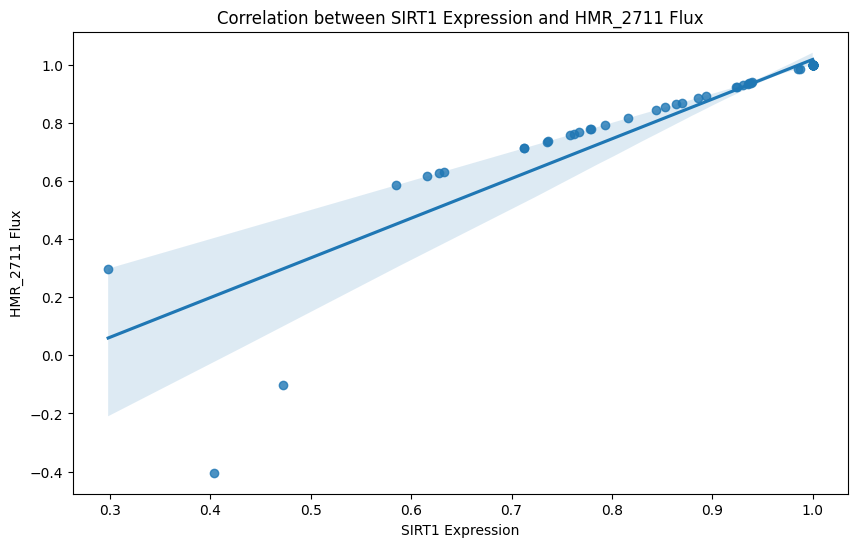

Linear regression results for SIRT1 and HMR_2711:
Slope: 1.365956147931103
Intercept: -0.34778090068274914
R-squared: 0.8197211569474214
P-value: 2.253553879198373e-27
Standard error: 0.07711724761028513



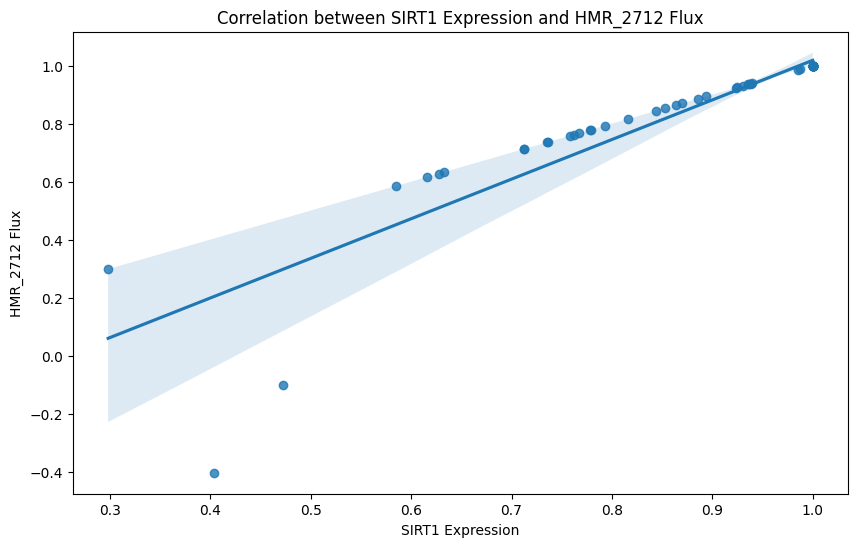

Linear regression results for SIRT1 and HMR_2712:
Slope: 1.365956147931103
Intercept: -0.34778090068274914
R-squared: 0.8197211569474214
P-value: 2.253553879198373e-27
Standard error: 0.07711724761028513



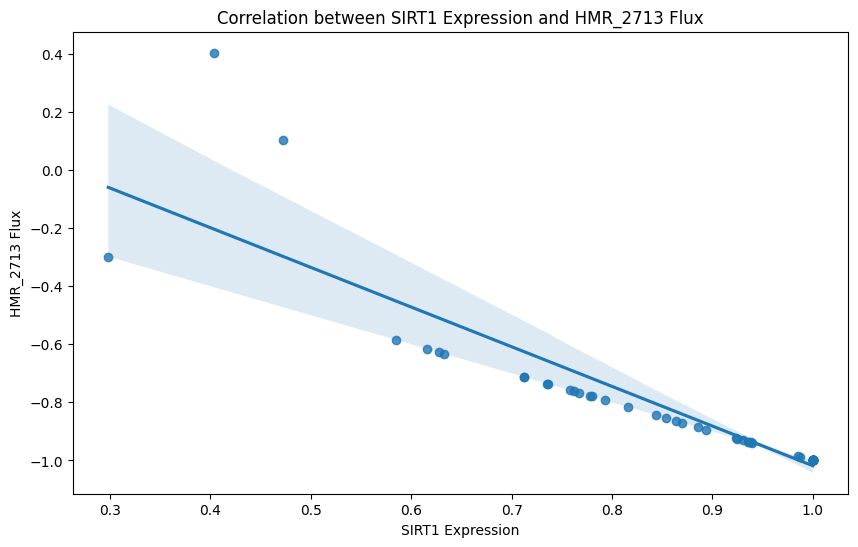

Linear regression results for SIRT1 and HMR_2713:
Slope: -1.365956147931103
Intercept: 0.34778090068274914
R-squared: 0.8197211569474214
P-value: 2.253553879198373e-27
Standard error: 0.07711724761028513



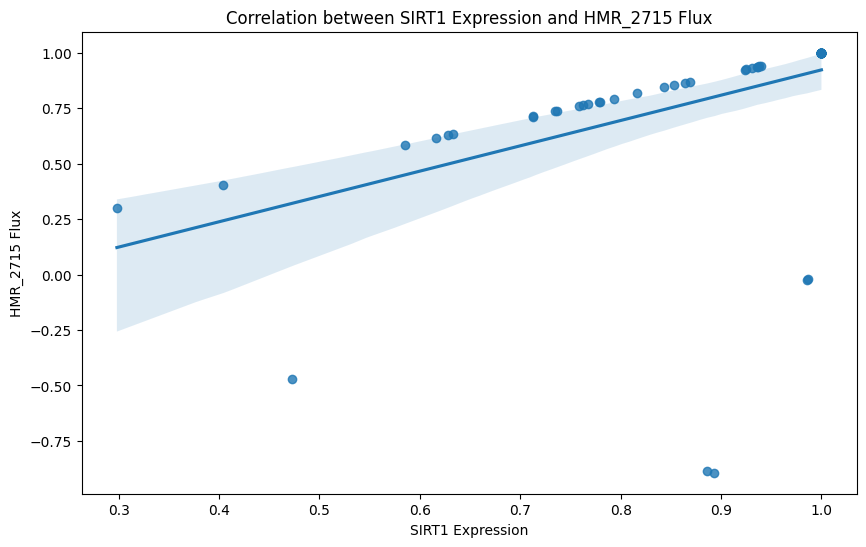

Linear regression results for SIRT1 and HMR_2715:
Slope: 1.1413101394303484
Intercept: -0.218621784197073
R-squared: 0.20953567412514584
P-value: 5.978460637686471e-05
Standard error: 0.2668647923167419



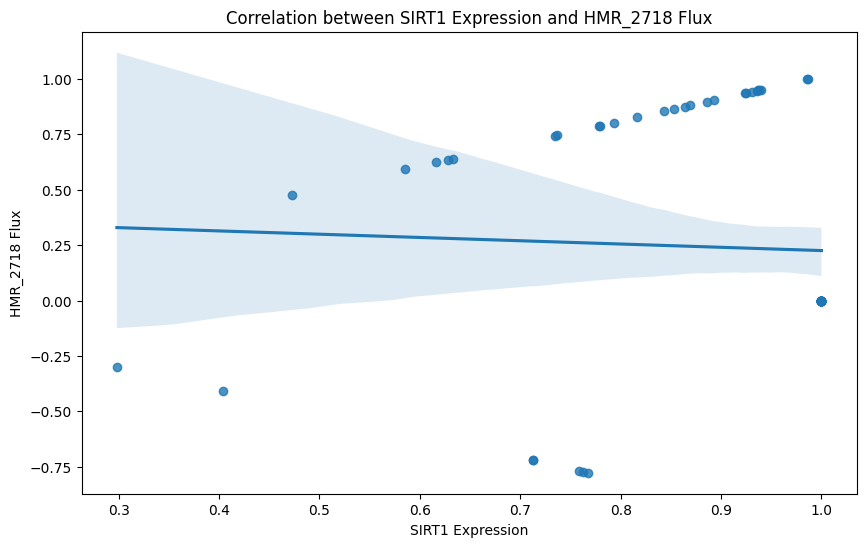

Linear regression results for SIRT1 and HMR_2718:
Slope: -0.14786380250870693
Intercept: 0.3732801788021759
R-squared: 0.0022128897895057776
P-value: 0.6968636727332265
Standard error: 0.3779865767722663



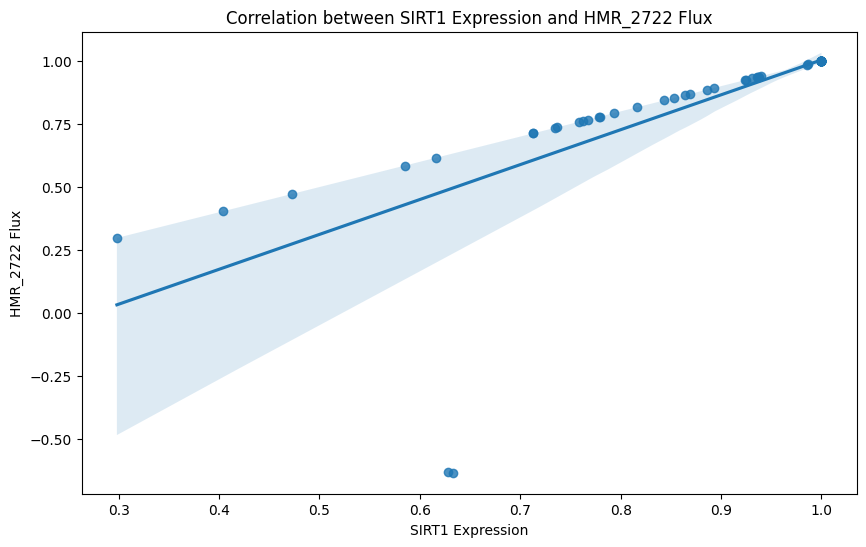

Linear regression results for SIRT1 and HMR_2722:
Slope: 1.3833640063241646
Intercept: -0.3794361911999088
R-squared: 0.5428039253622658
P-value: 2.410708287751202e-13
Standard error: 0.15284163783919663



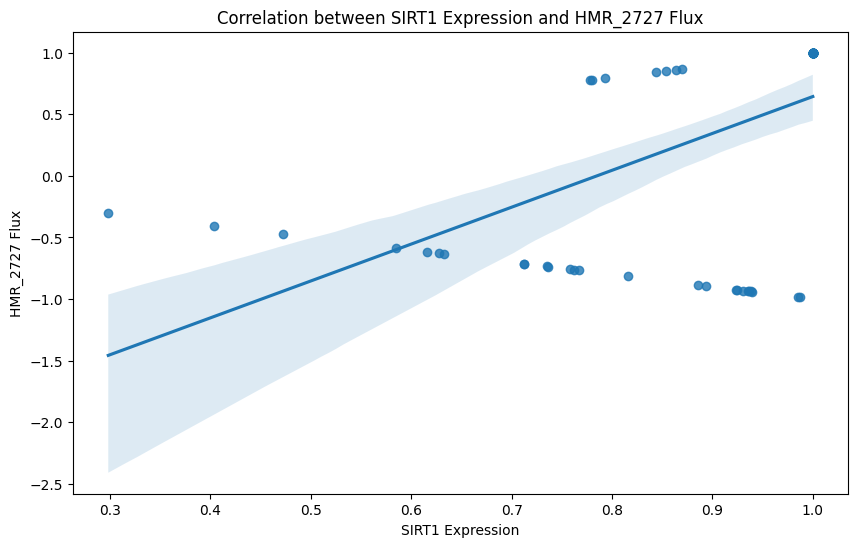

Linear regression results for SIRT1 and HMR_2727:
Slope: 2.9947559356826914
Intercept: -2.3506161724701826
R-squared: 0.3094176237214228
P-value: 4.7409252213820245e-07
Standard error: 0.5386071460961688



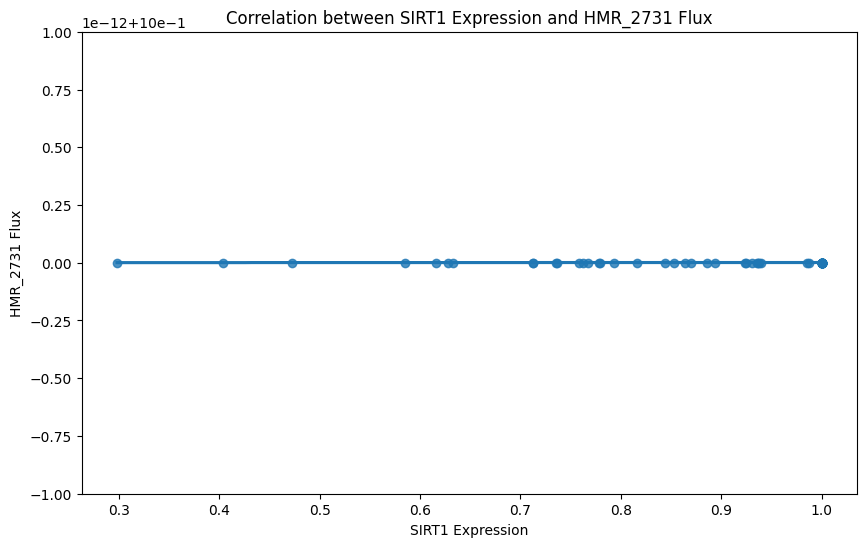

Linear regression results for SIRT1 and HMR_2731:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



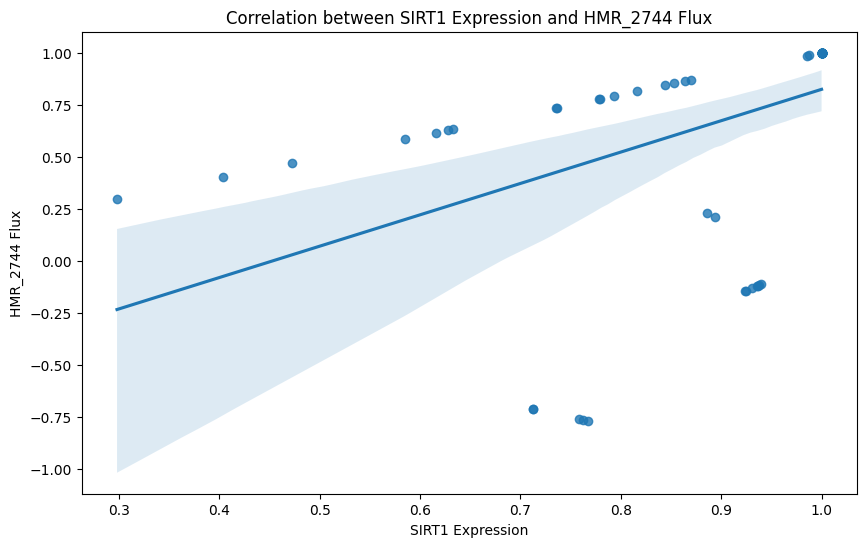

Linear regression results for SIRT1 and HMR_2744:
Slope: 1.5062725870794287
Intercept: -0.6820447518181526
R-squared: 0.20284337739322925
P-value: 8.112959130552392e-05
Standard error: 0.35947644630172454



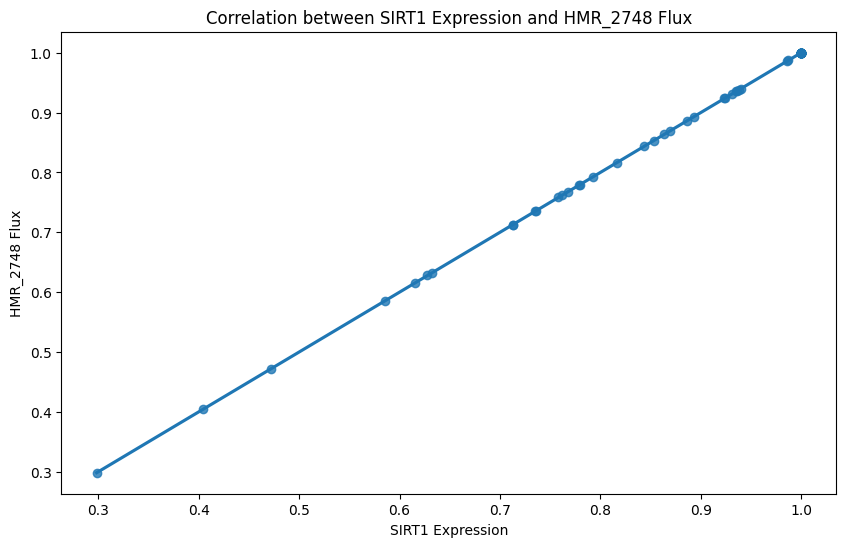

Linear regression results for SIRT1 and HMR_2748:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



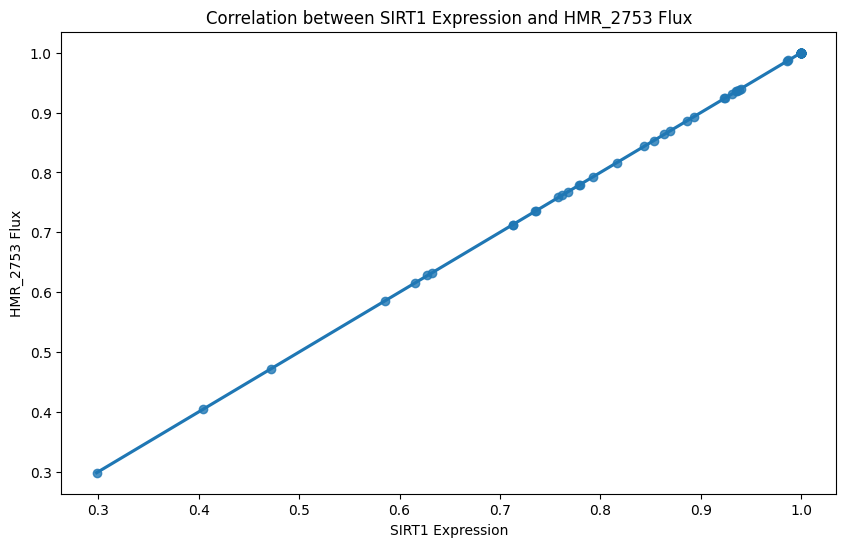

Linear regression results for SIRT1 and HMR_2753:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



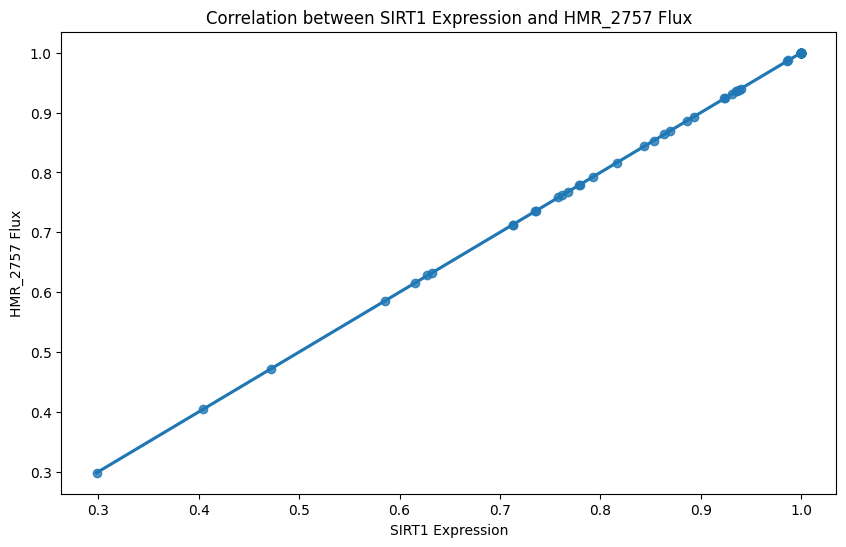

Linear regression results for SIRT1 and HMR_2757:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



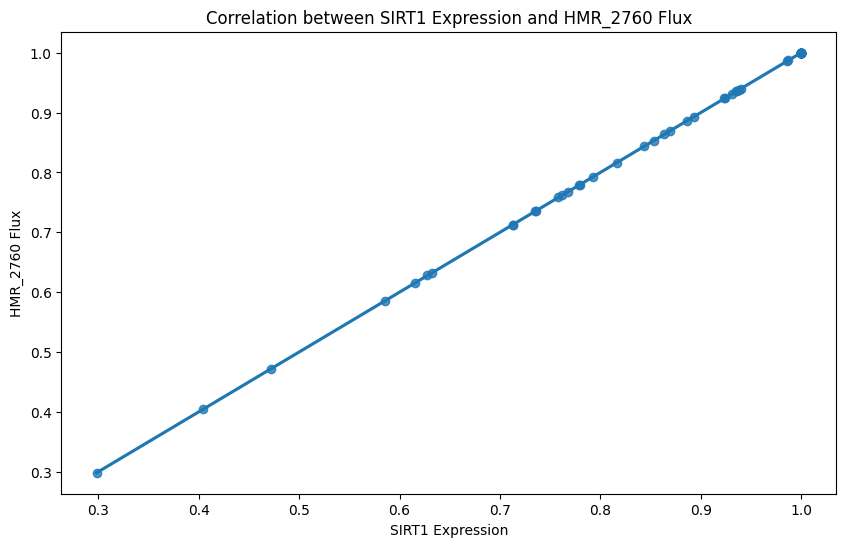

Linear regression results for SIRT1 and HMR_2760:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



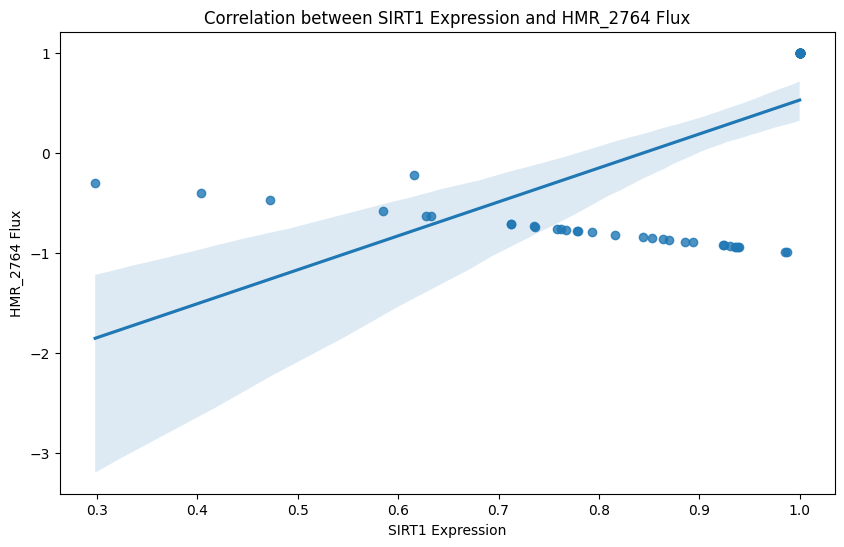

Linear regression results for SIRT1 and HMR_2764:
Slope: 3.389490330140359
Intercept: -2.862009355382141
R-squared: 0.35821051414401694
P-value: 3.536383643280964e-08
Standard error: 0.5461815031506813



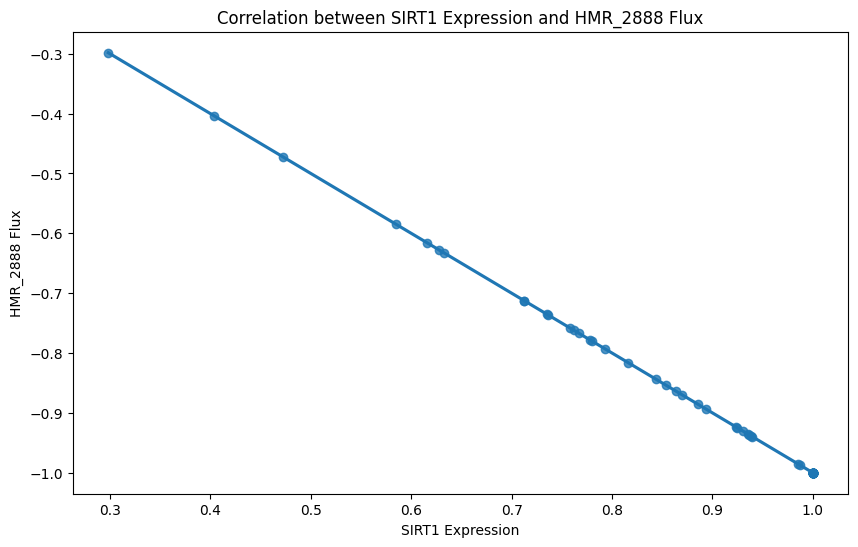

Linear regression results for SIRT1 and HMR_2888:
Slope: -1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



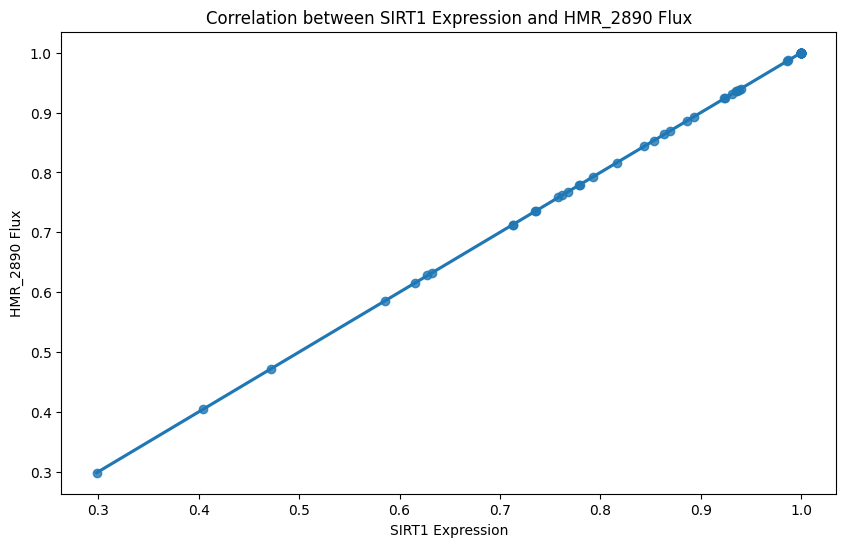

Linear regression results for SIRT1 and HMR_2890:
Slope: 1.0
Intercept: 0.0
R-squared: 1.0
P-value: 0.0
Standard error: 0.0



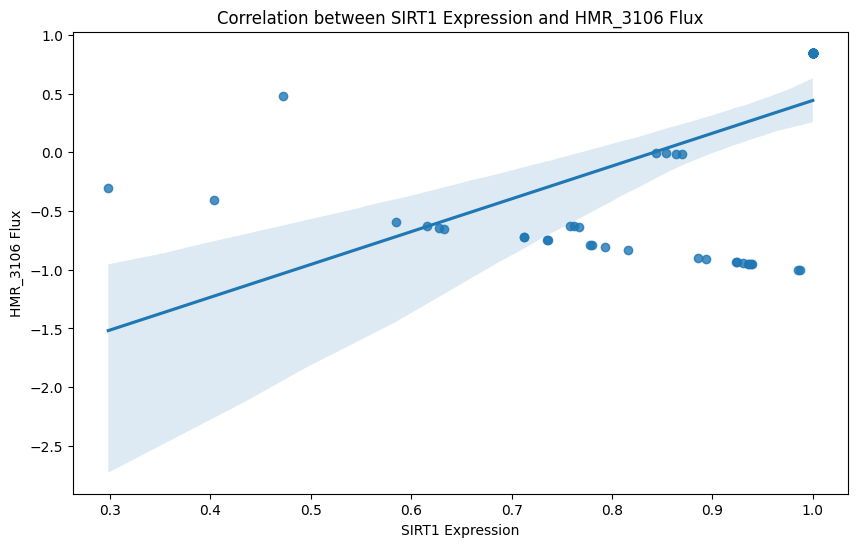

Linear regression results for SIRT1 and HMR_3106:
Slope: 2.793435245764809
Intercept: -2.3512150707595487
R-squared: 0.3146076085689281
P-value: 3.6266633508222196e-07
Standard error: 0.496362646954569



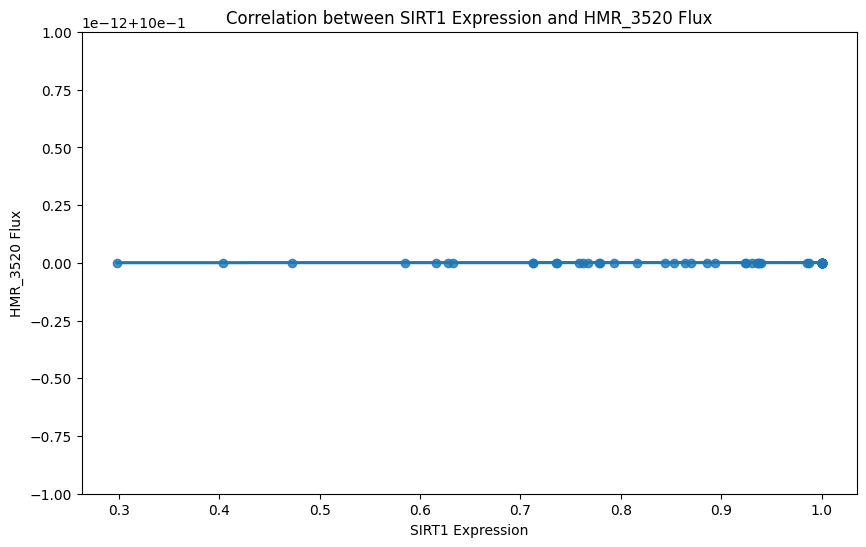

Linear regression results for SIRT1 and HMR_3520:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



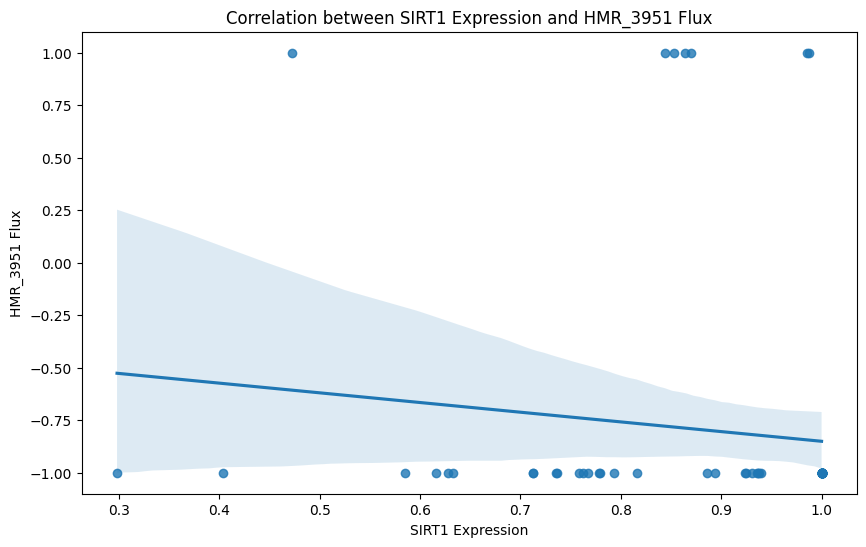

Linear regression results for SIRT1 and HMR_3951:
Slope: -0.46161039929051473
Intercept: -0.3886845086902966
R-squared: 0.014819743467555544
P-value: 0.3118590108948715
Standard error: 0.4530942446855674



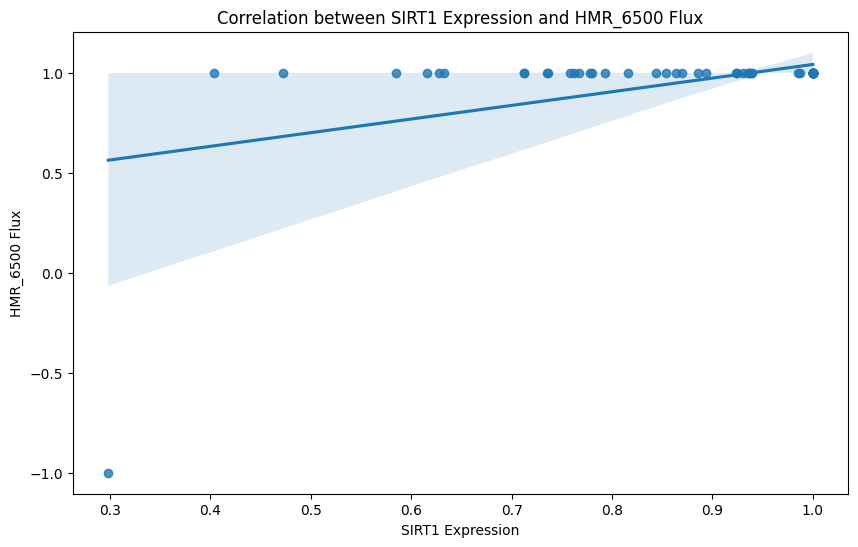

Linear regression results for SIRT1 and HMR_6500:
Slope: 0.6823778850579137
Intercept: 0.3596377019008141
R-squared: 0.207261853969341
P-value: 6.63342755094393e-05
Standard error: 0.16065919521652594



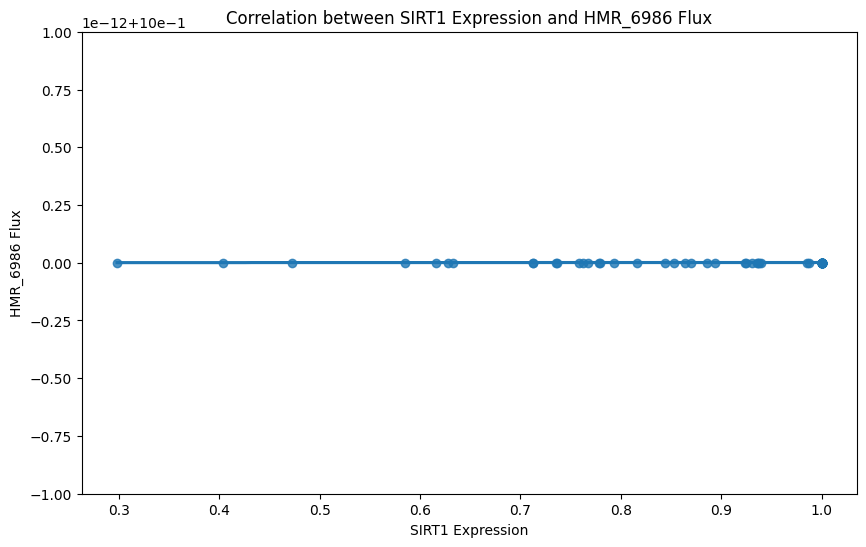

Linear regression results for SIRT1 and HMR_6986:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



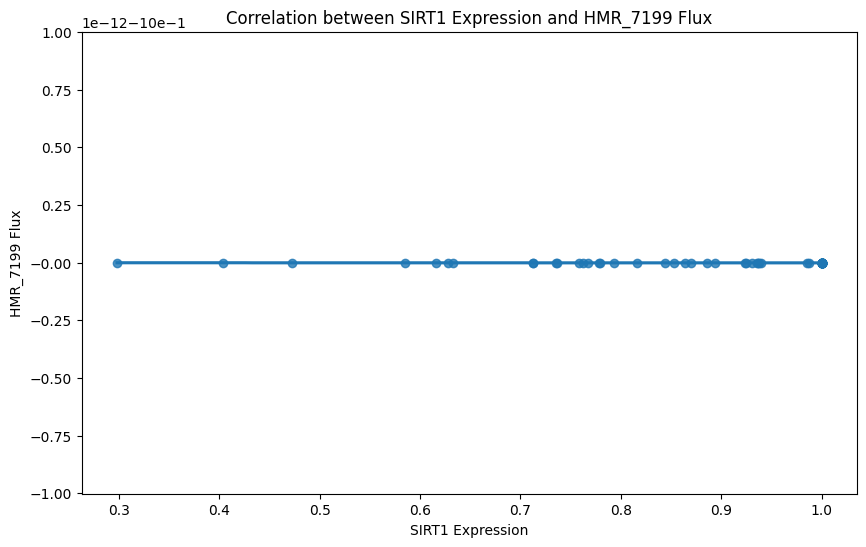

Linear regression results for SIRT1 and HMR_7199:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



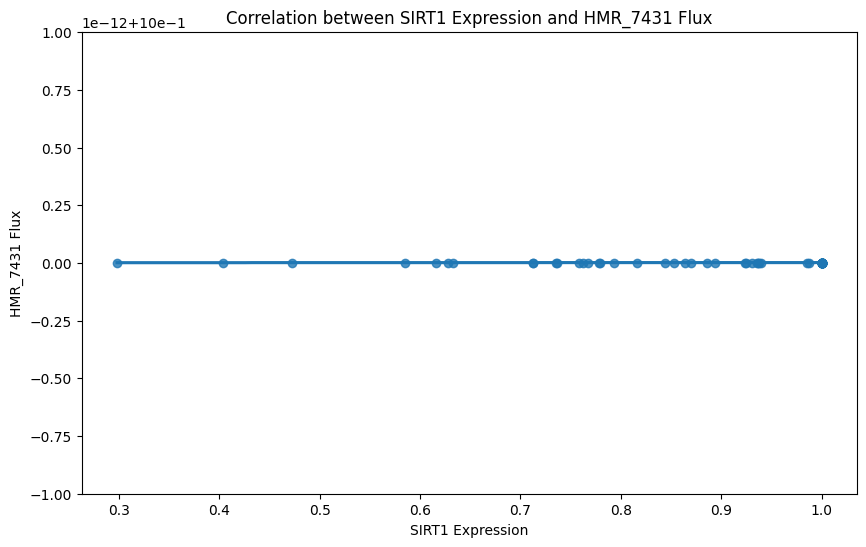

Linear regression results for SIRT1 and HMR_7431:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



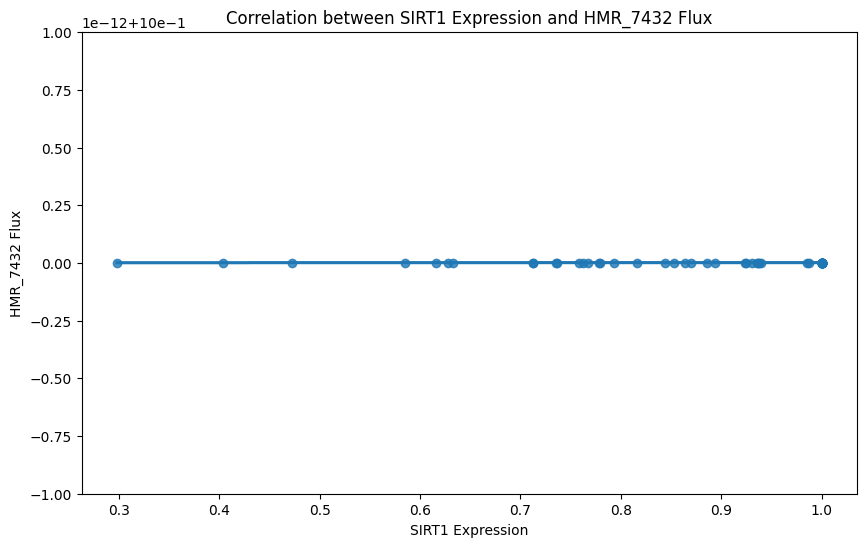

Linear regression results for SIRT1 and HMR_7432:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



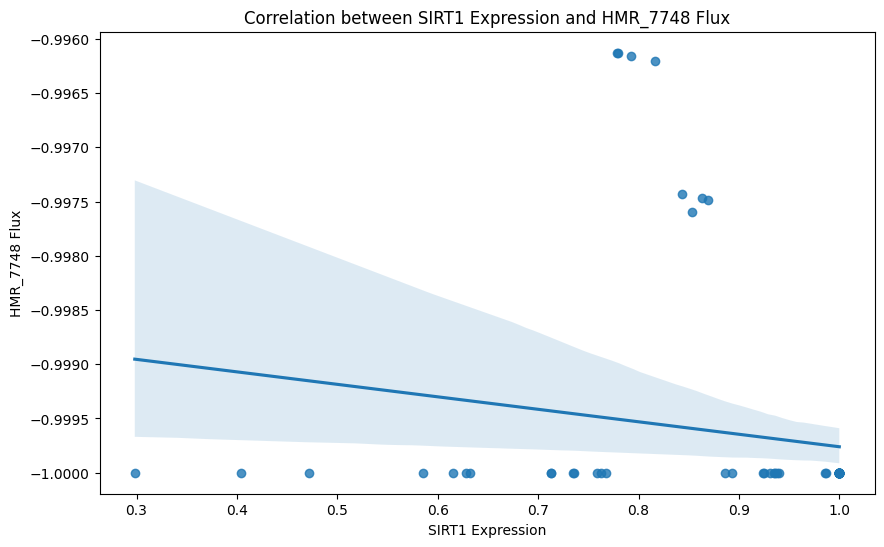

Linear regression results for SIRT1 and HMR_7748:
Slope: -0.0011509067614567695
Intercept: -0.9986095816453336
R-squared: 0.030909633645682055
P-value: 0.1424936544535263
Standard error: 0.0007758018402993088



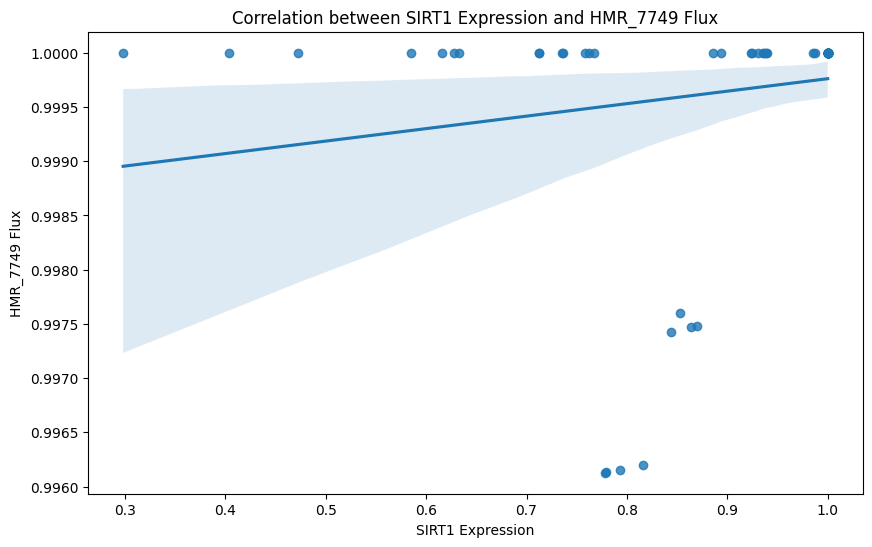

Linear regression results for SIRT1 and HMR_7749:
Slope: 0.0011509067614567695
Intercept: 0.9986095816453336
R-squared: 0.030909633645682055
P-value: 0.1424936544535263
Standard error: 0.0007758018402993088



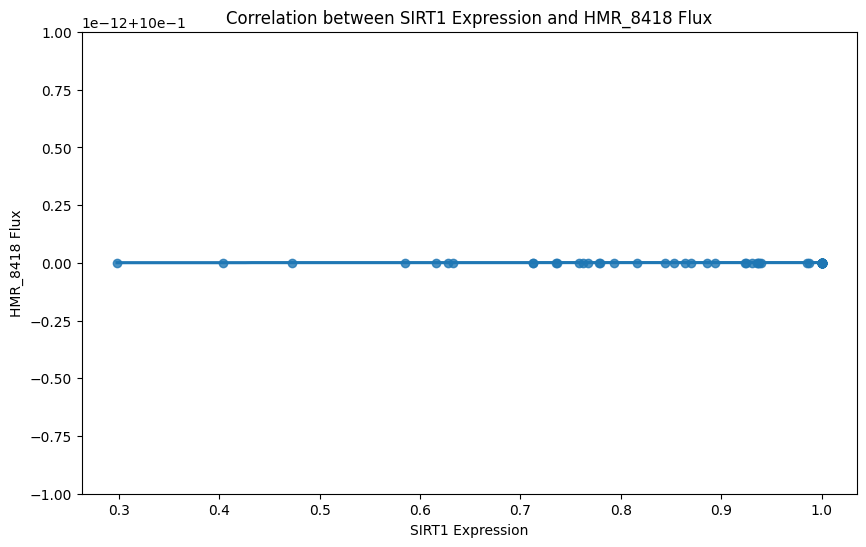

Linear regression results for SIRT1 and HMR_8418:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



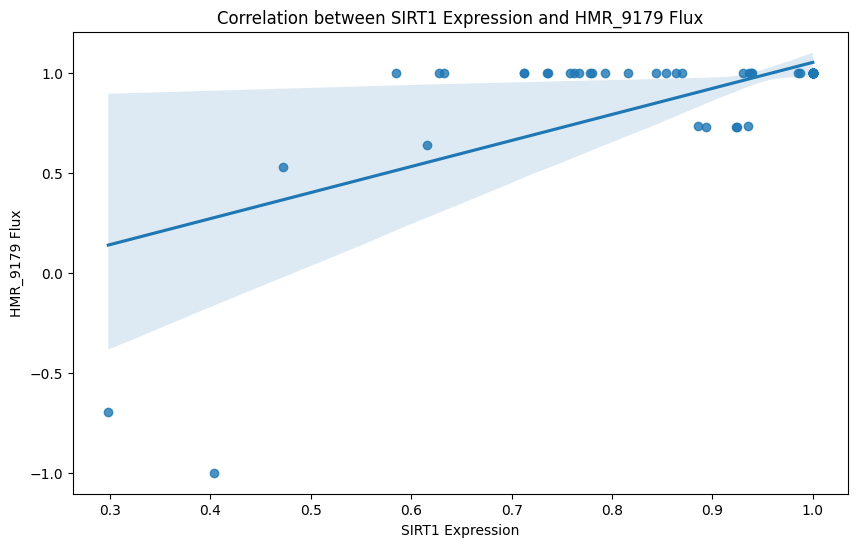

Linear regression results for SIRT1 and HMR_9179:
Slope: 1.3012831781873815
Intercept: -0.2503843128521376
R-squared: 0.41811473437547453
P-value: 1.1195443947424952e-09
Standard error: 0.1848069136553518



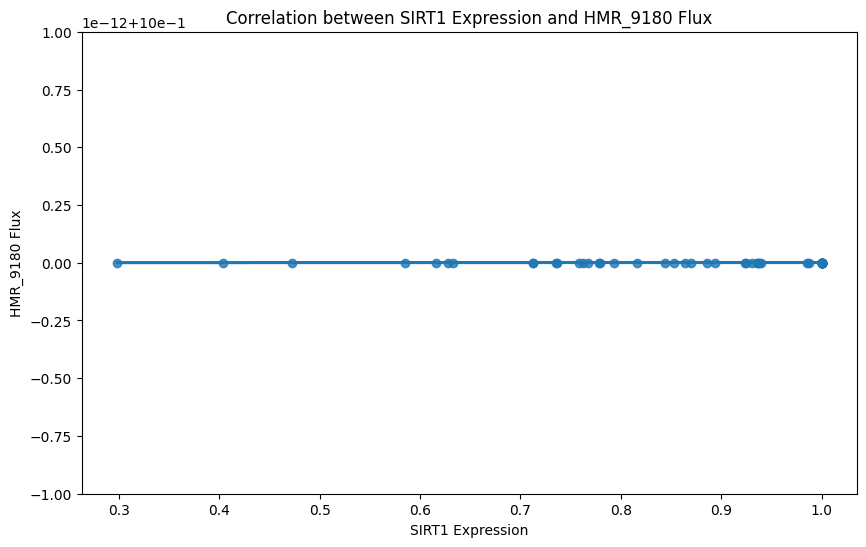

Linear regression results for SIRT1 and HMR_9180:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



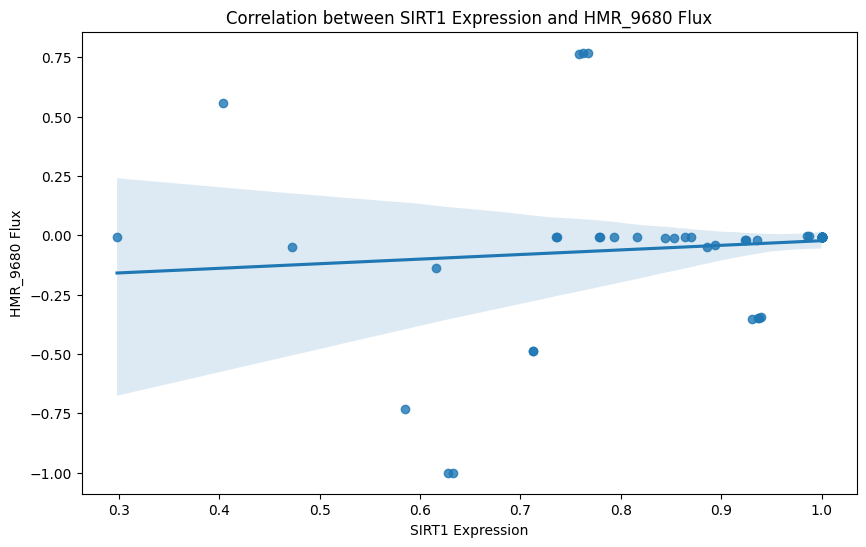

Linear regression results for SIRT1 and HMR_9680:
Slope: 0.19395049104294396
Intercept: -0.21636409426371142
R-squared: 0.012074831639930146
P-value: 0.36164044903167114
Standard error: 0.2111970369779424



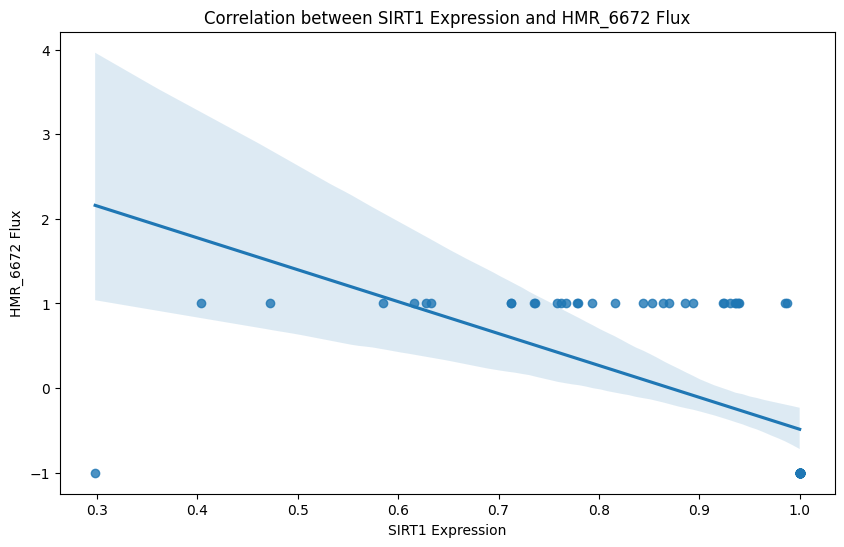

Linear regression results for SIRT1 and HMR_6672:
Slope: -3.770710448427725
Intercept: 3.2842900813061844
R-squared: 0.3549762645973474
P-value: 4.2238308106123656e-08
Standard error: 0.611908983920846



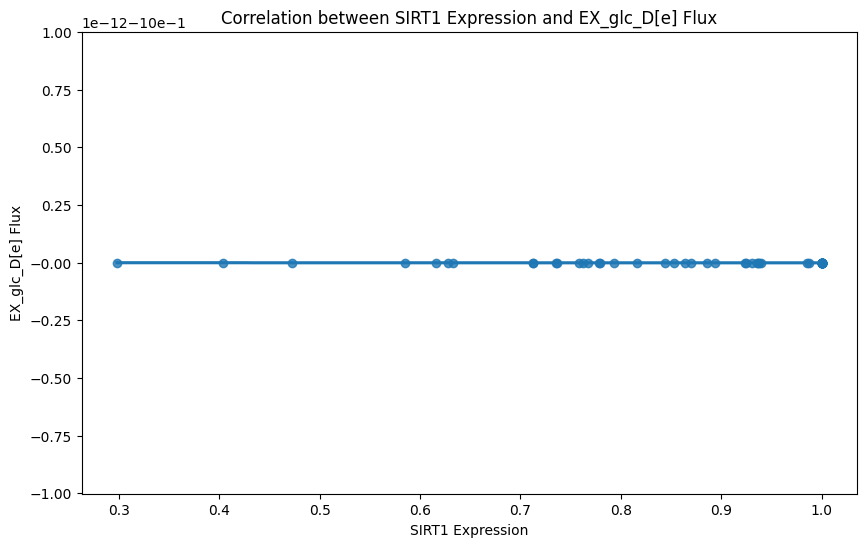

Linear regression results for SIRT1 and EX_glc_D[e]:
Slope: 0.0
Intercept: -1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



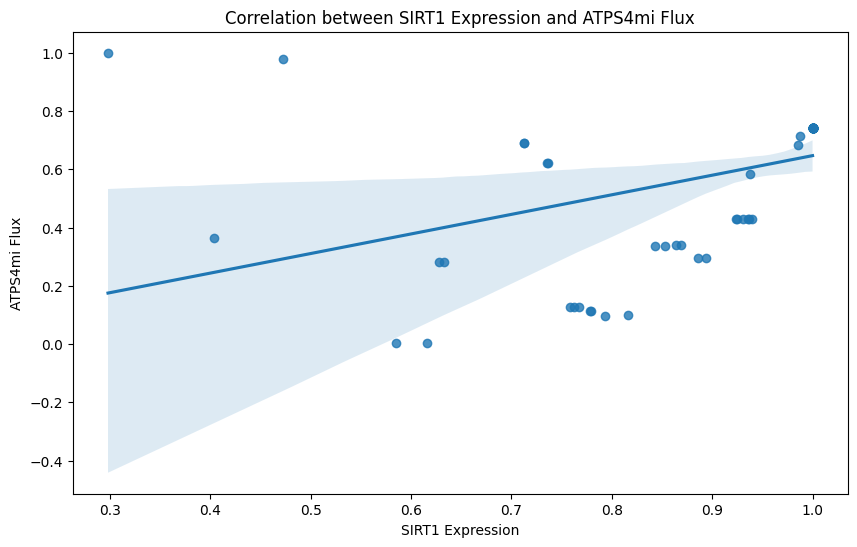

Linear regression results for SIRT1 and ATPS4mi:
Slope: 0.6722016293961193
Intercept: -0.025427349133642863
R-squared: 0.18352660864493459
P-value: 0.0001937025292818181
Standard error: 0.17068545478805436



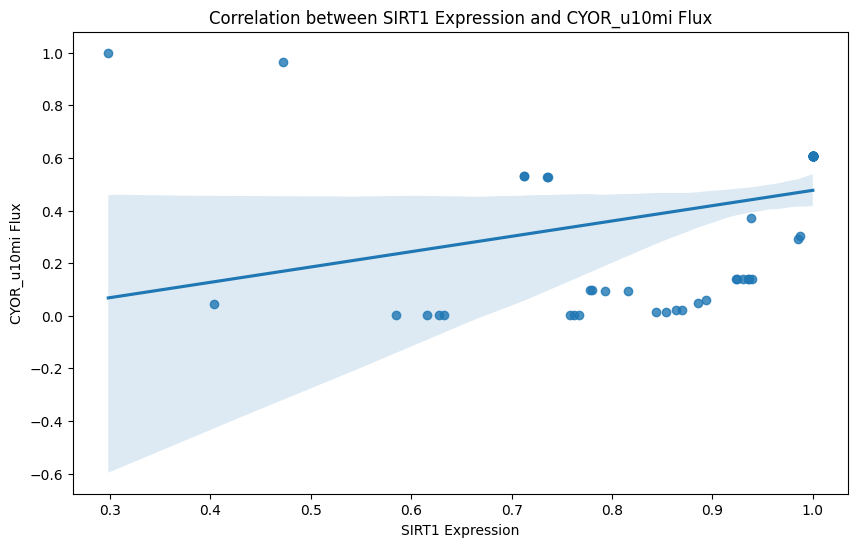

Linear regression results for SIRT1 and CYOR_u10mi:
Slope: 0.582985088562788
Intercept: -0.10615564030524238
R-squared: 0.11453868517022543
P-value: 0.003891793796736751
Standard error: 0.19513788812290356



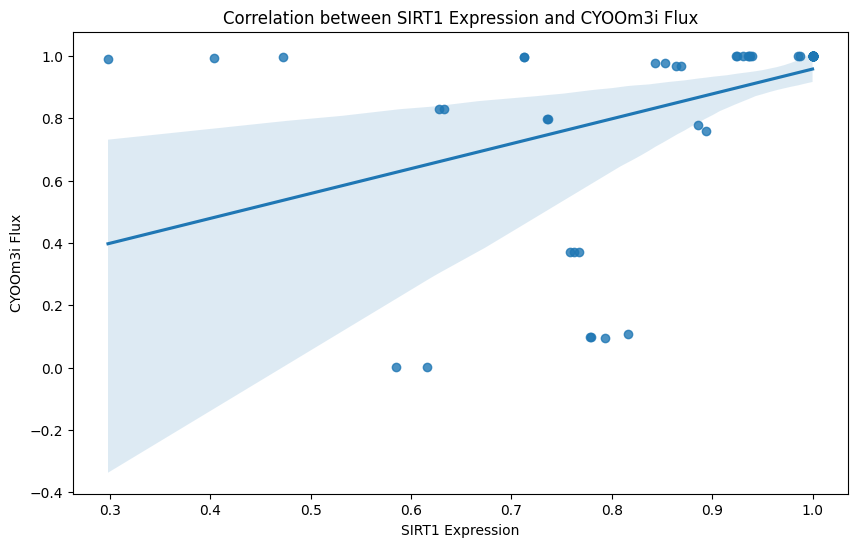

Linear regression results for SIRT1 and CYOOm3i:
Slope: 0.7987241762873291
Intercept: 0.15889030360668377
R-squared: 0.20112602260979798
P-value: 8.771285172587265e-05
Standard error: 0.19163608479229



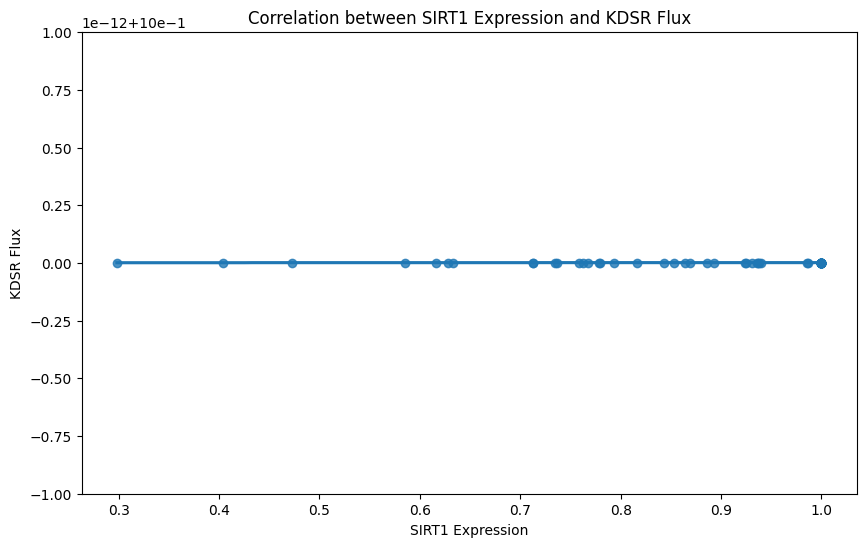

Linear regression results for SIRT1 and KDSR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



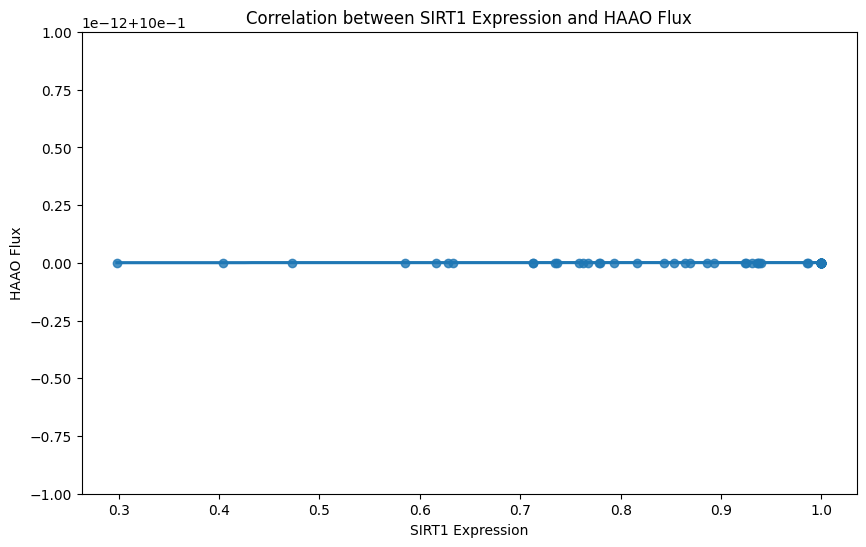

Linear regression results for SIRT1 and HAAO:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



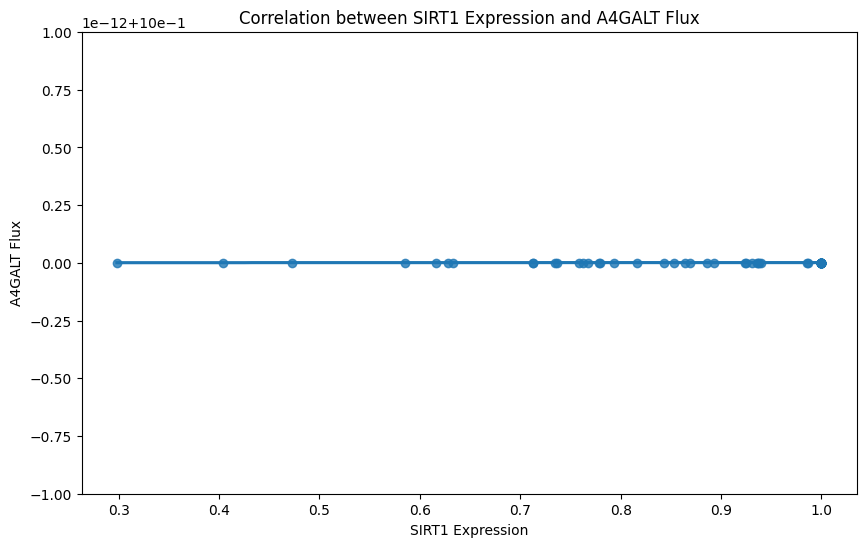

Linear regression results for SIRT1 and A4GALT:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



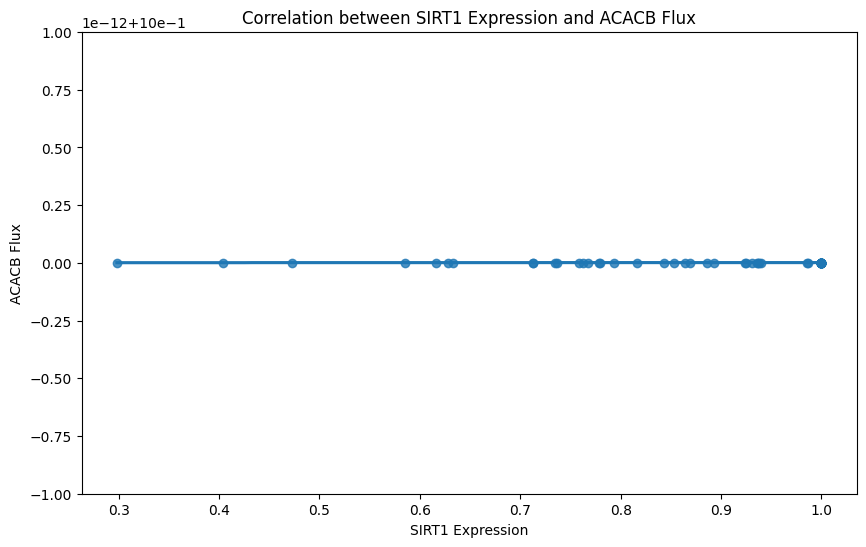

Linear regression results for SIRT1 and ACACB:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



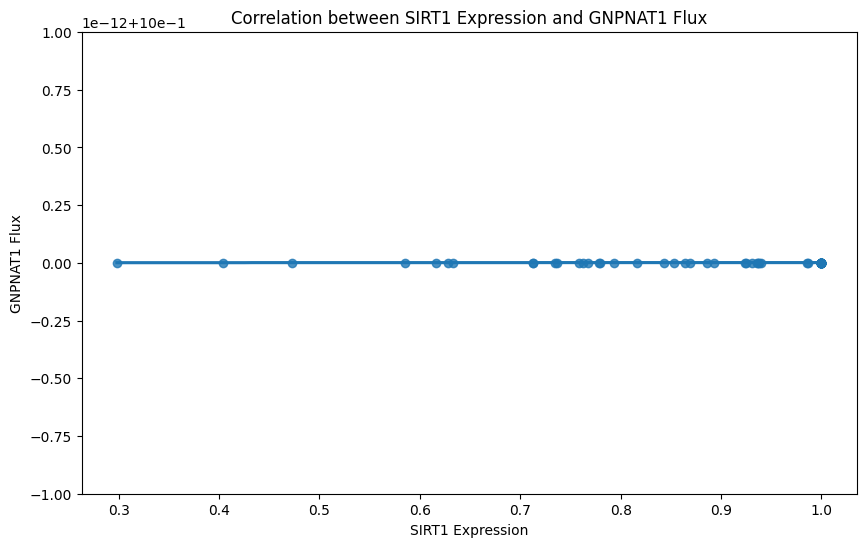

Linear regression results for SIRT1 and GNPNAT1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



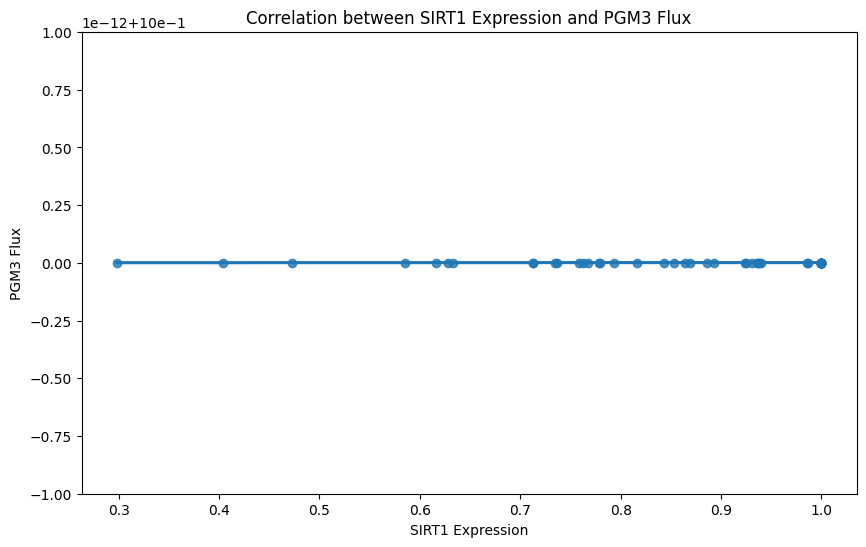

Linear regression results for SIRT1 and PGM3:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



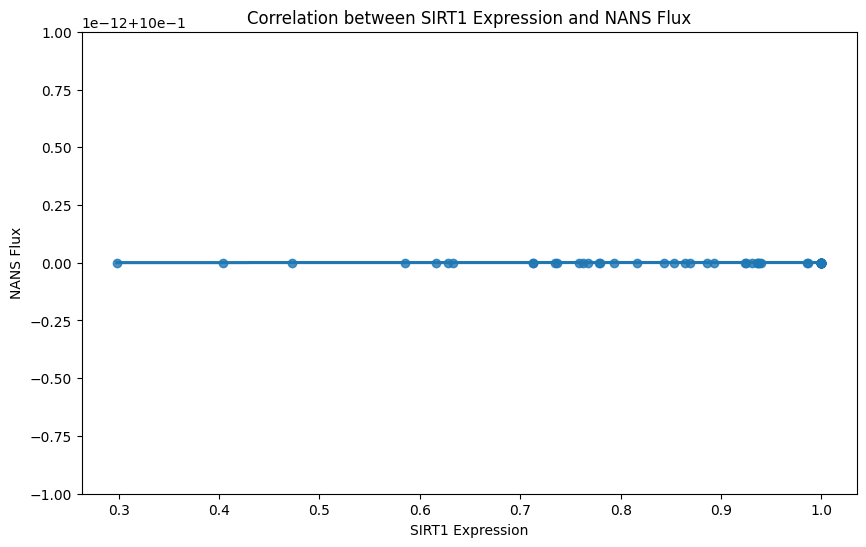

Linear regression results for SIRT1 and NANS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



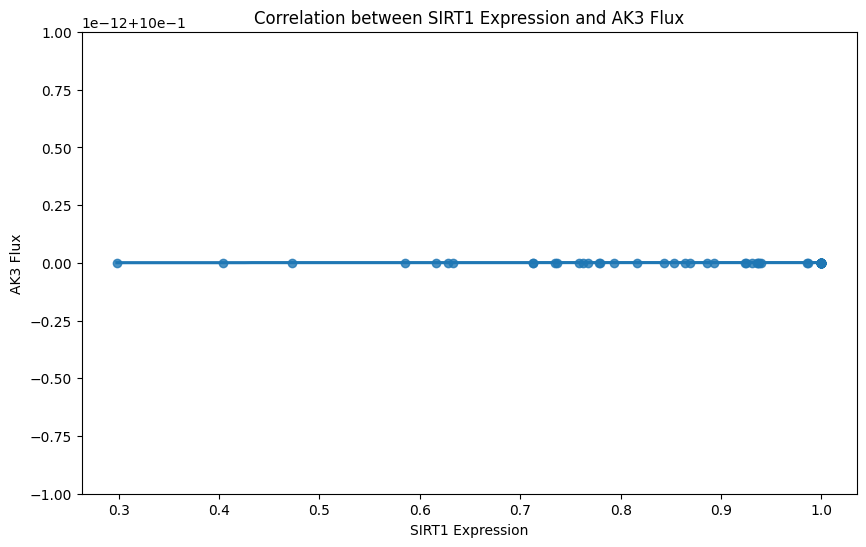

Linear regression results for SIRT1 and AK3:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



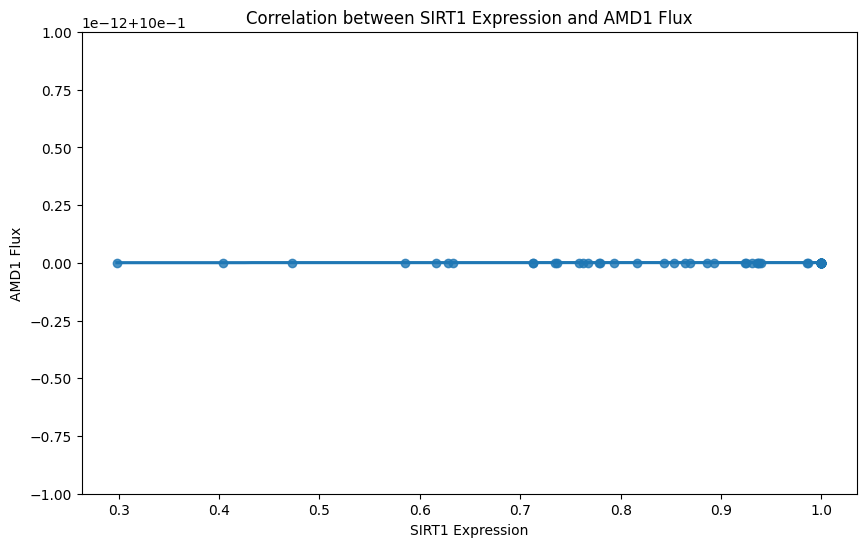

Linear regression results for SIRT1 and AMD1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



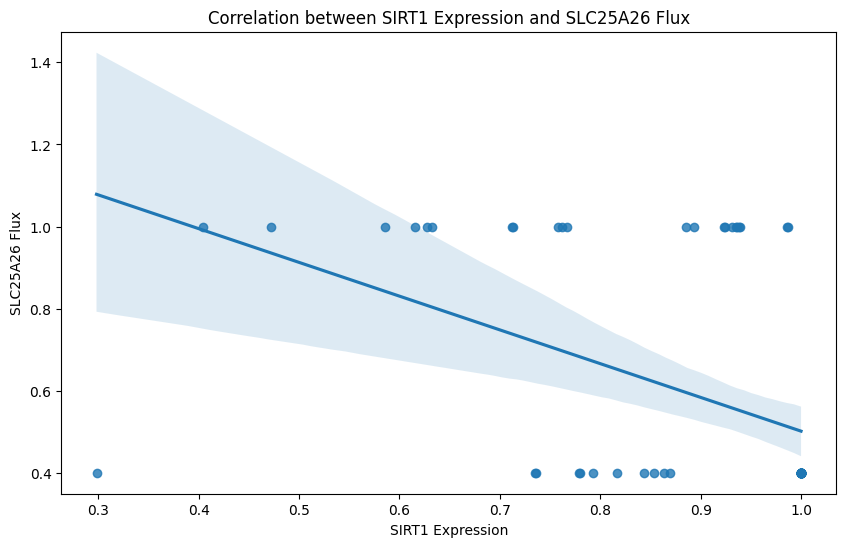

Linear regression results for SIRT1 and SLC25A26:
Slope: -0.8225283208572911
Intercept: 1.3238443223745562
R-squared: 0.21727411113981707
P-value: 4.189431888091254e-05
Standard error: 0.18794344066207103



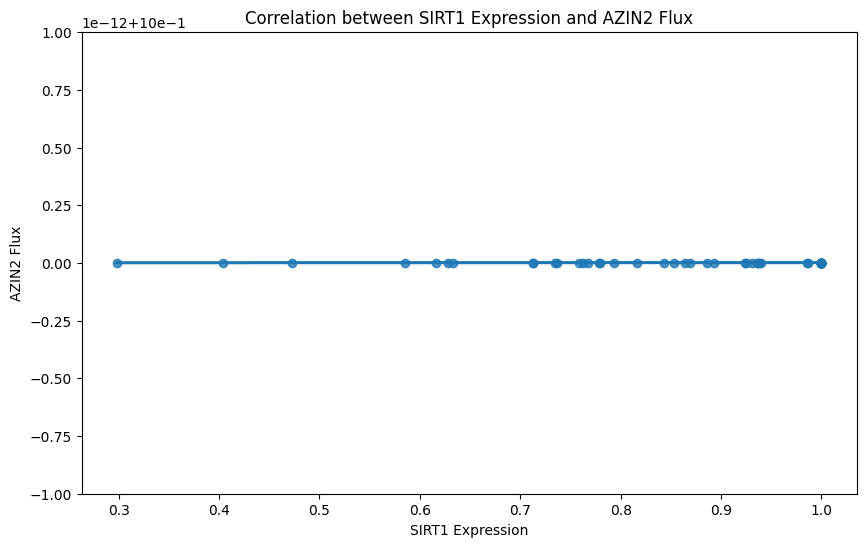

Linear regression results for SIRT1 and AZIN2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



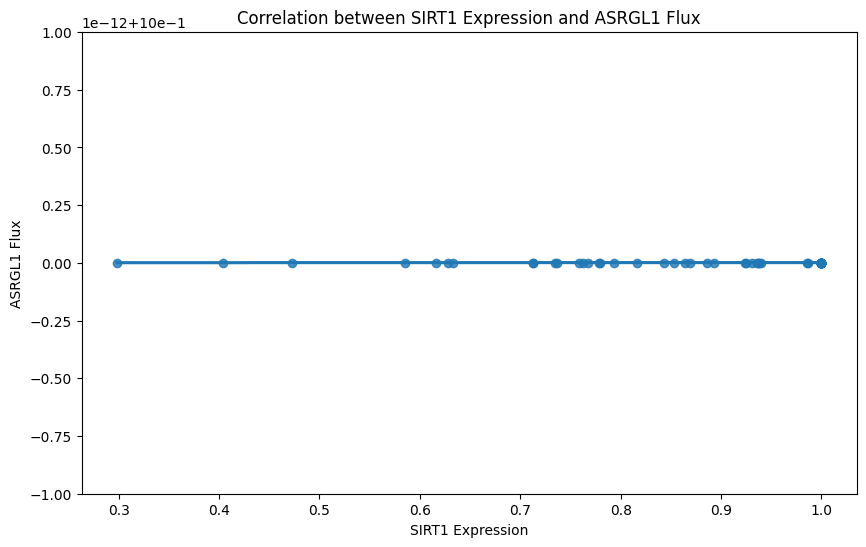

Linear regression results for SIRT1 and ASRGL1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



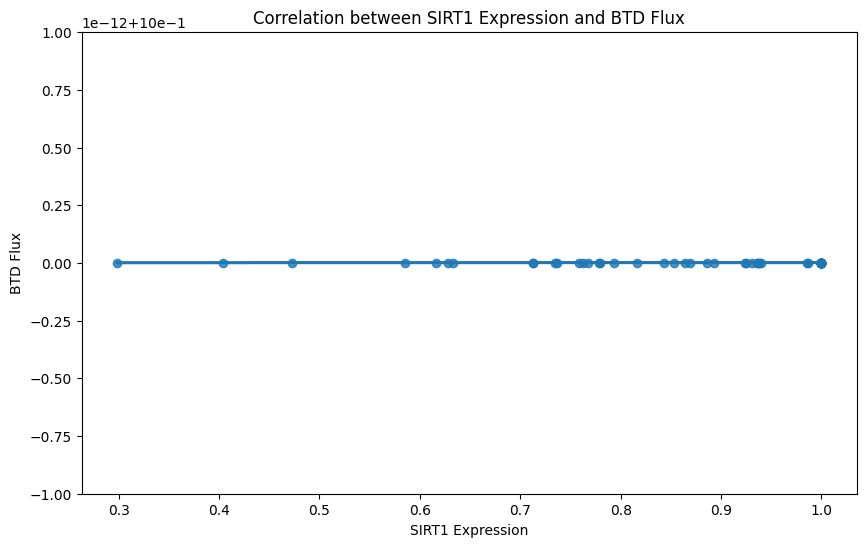

Linear regression results for SIRT1 and BTD:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



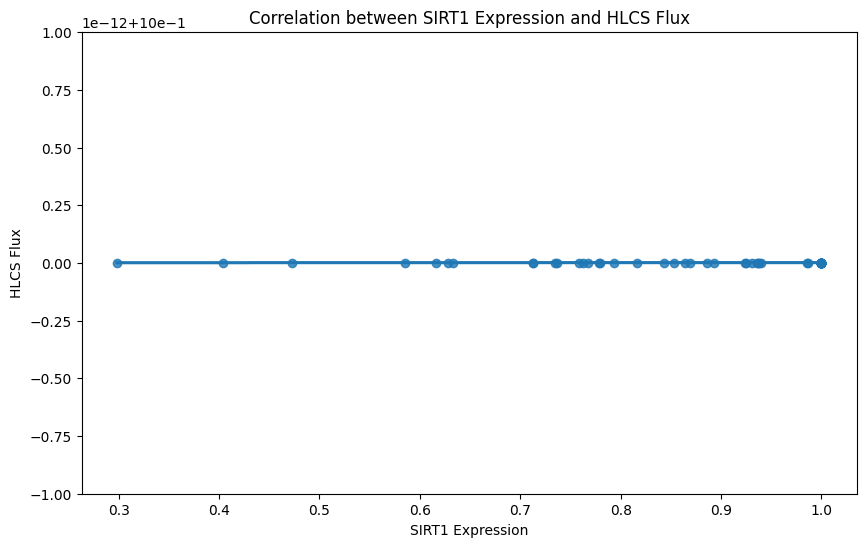

Linear regression results for SIRT1 and HLCS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



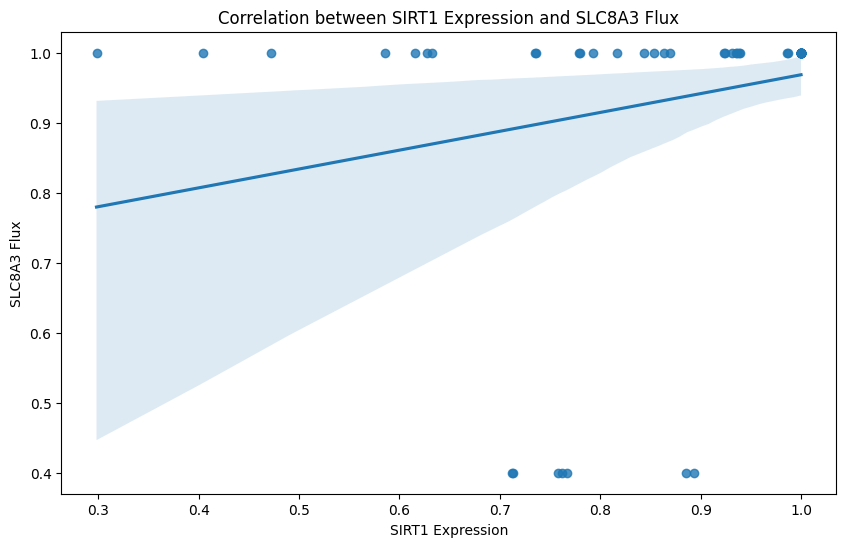

Linear regression results for SIRT1 and SLC8A3:
Slope: 0.26928437295170526
Intercept: 0.6992573985167456
R-squared: 0.05603628181450408
P-value: 0.04685825690362227
Standard error: 0.13305451052554146



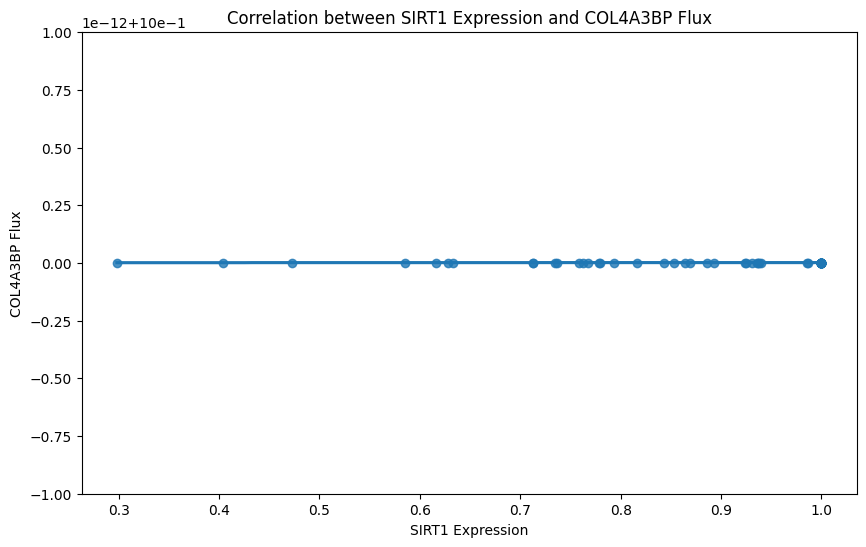

Linear regression results for SIRT1 and COL4A3BP:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



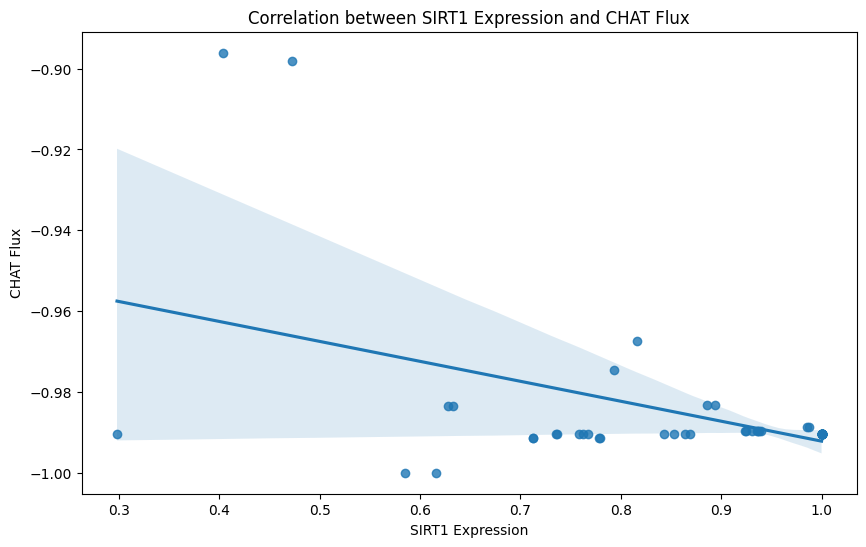

Linear regression results for SIRT1 and CHAT:
Slope: -0.04938220897863955
Intercept: -0.9428043290404099
R-squared: 0.2399359945228327
P-value: 1.4541172692243008e-05
Standard error: 0.010580917992959151



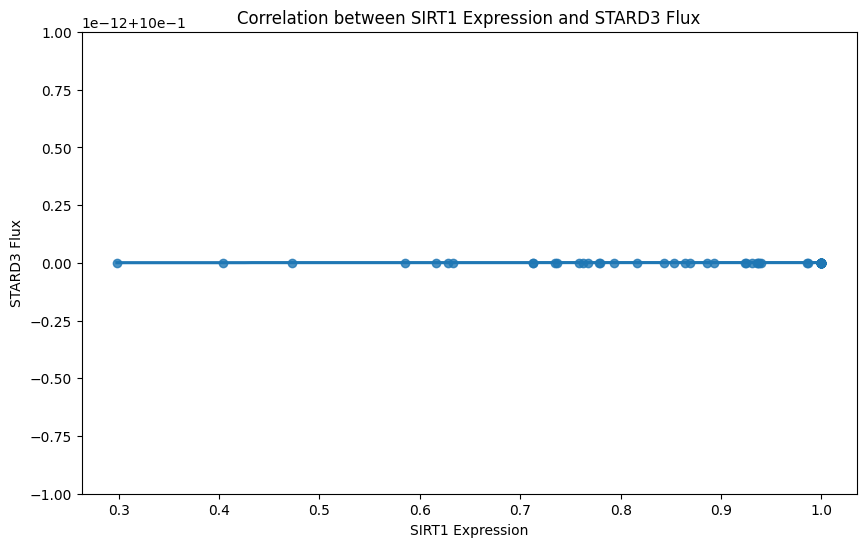

Linear regression results for SIRT1 and STARD3:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



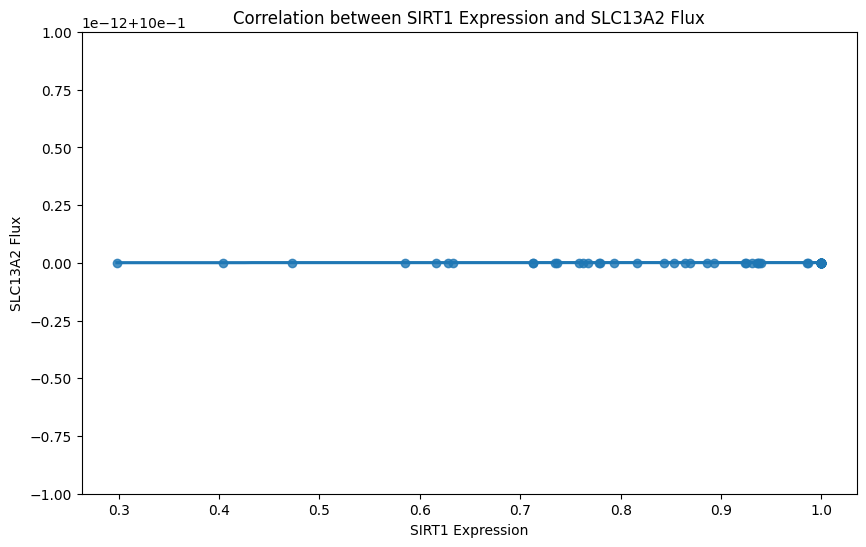

Linear regression results for SIRT1 and SLC13A2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



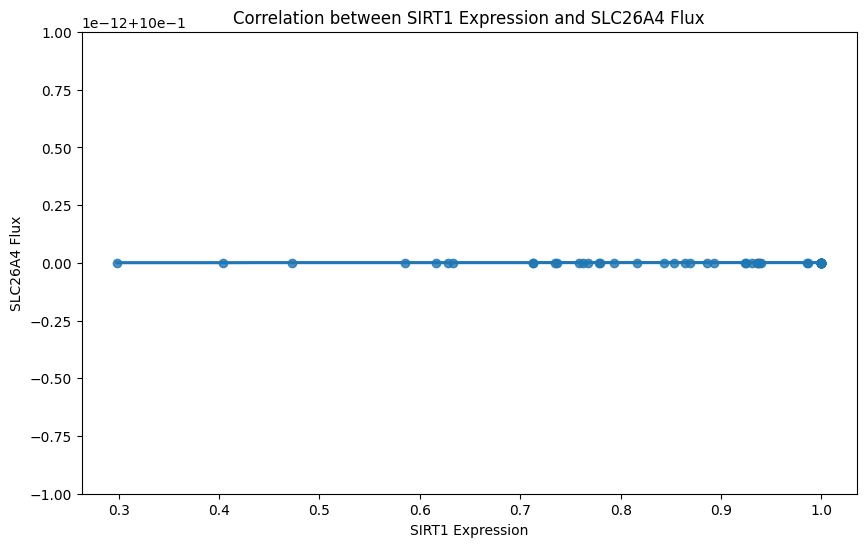

Linear regression results for SIRT1 and SLC26A4:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



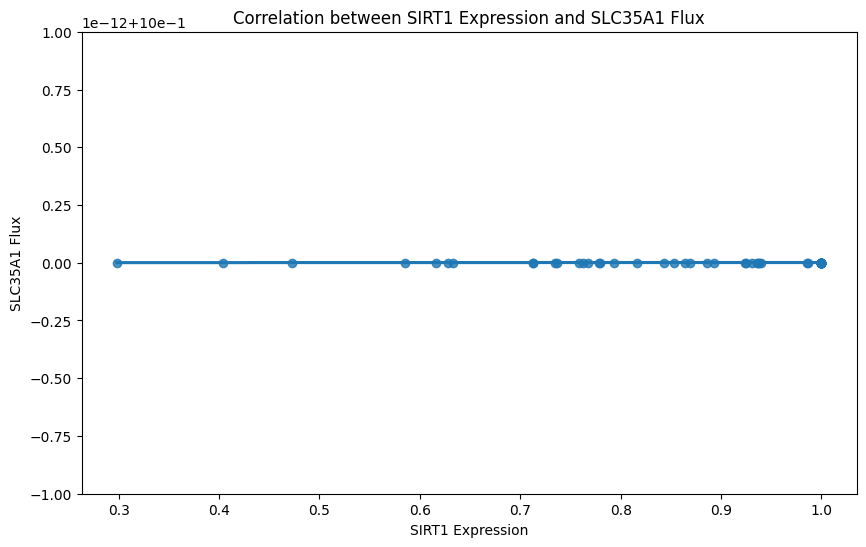

Linear regression results for SIRT1 and SLC35A1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



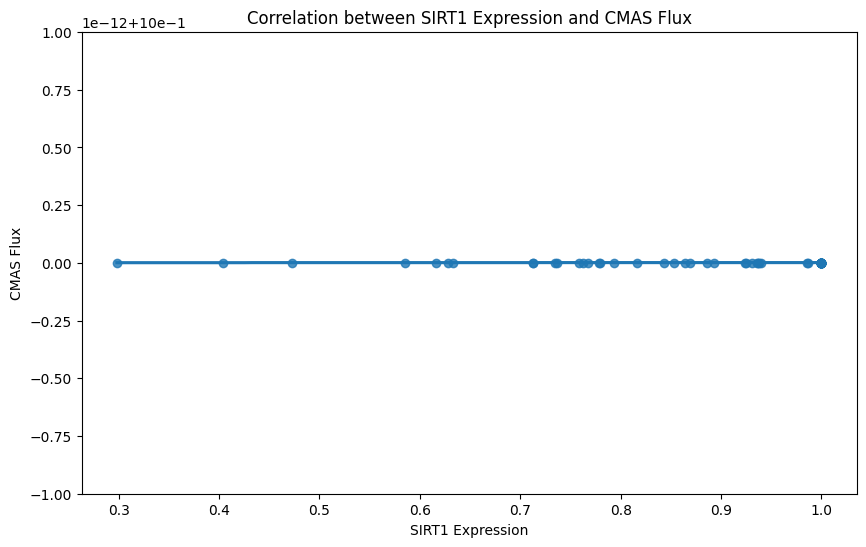

Linear regression results for SIRT1 and CMAS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



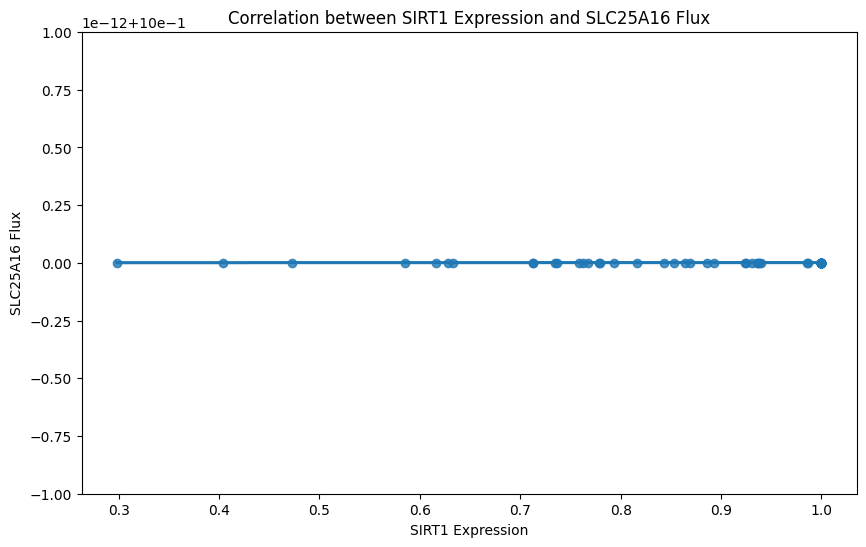

Linear regression results for SIRT1 and SLC25A16:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



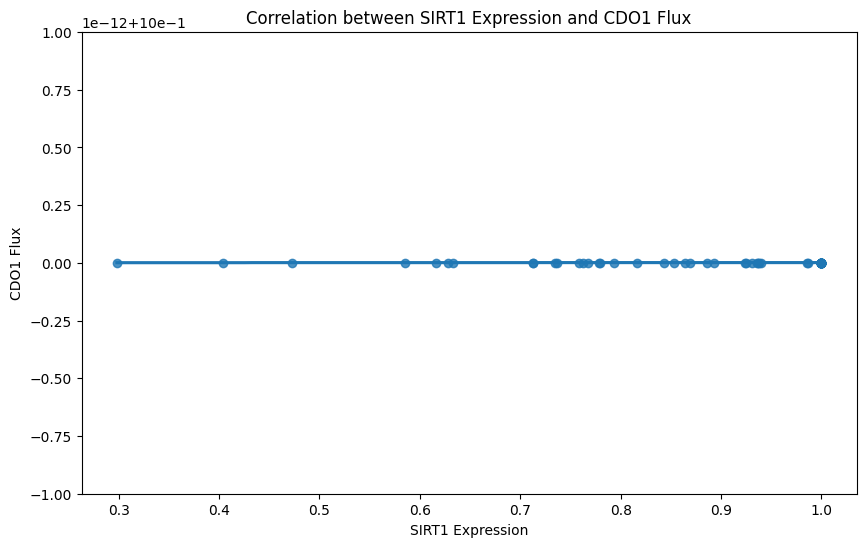

Linear regression results for SIRT1 and CDO1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



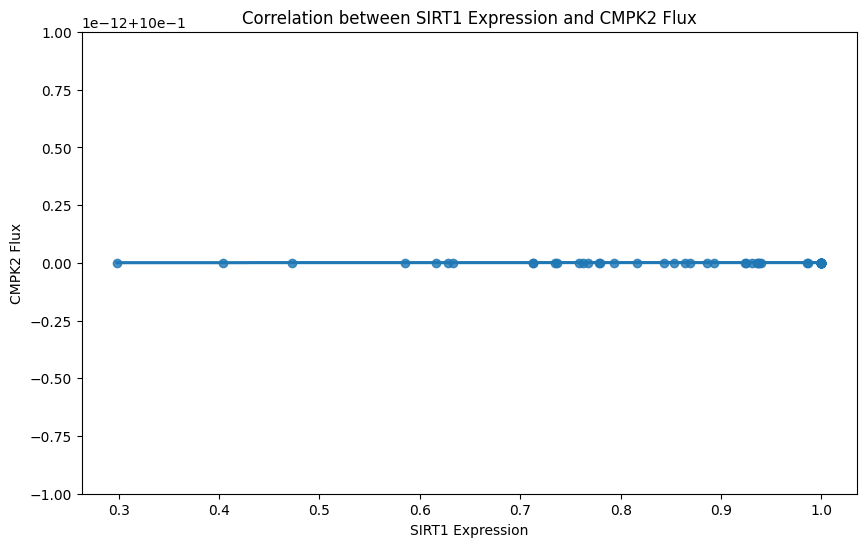

Linear regression results for SIRT1 and CMPK2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



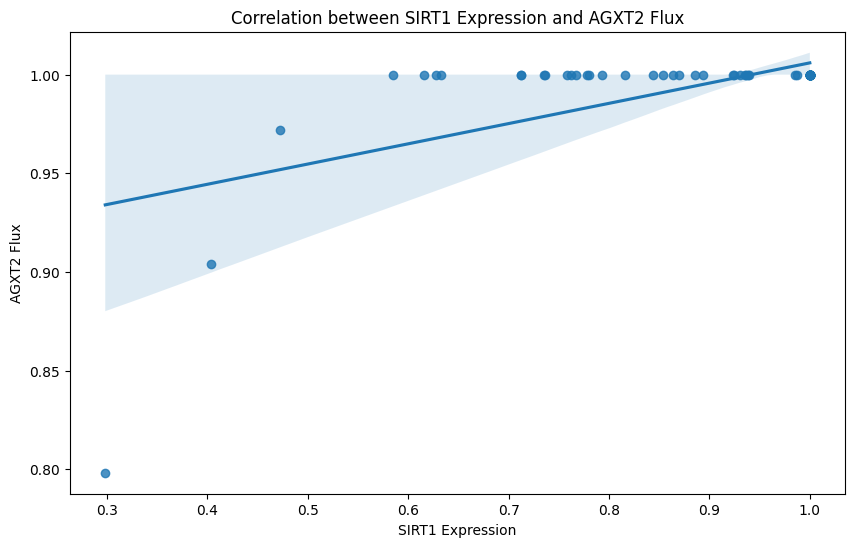

Linear regression results for SIRT1 and AGXT2:
Slope: 0.10254859013715918
Intercept: 0.9034129966203988
R-squared: 0.3751333362118147
P-value: 1.3767251311291382e-08
Standard error: 0.01593330966852077



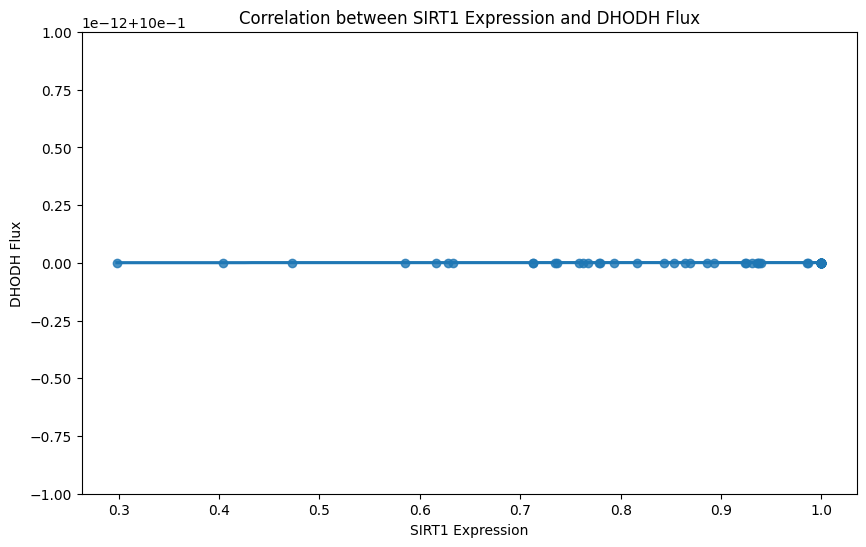

Linear regression results for SIRT1 and DHODH:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



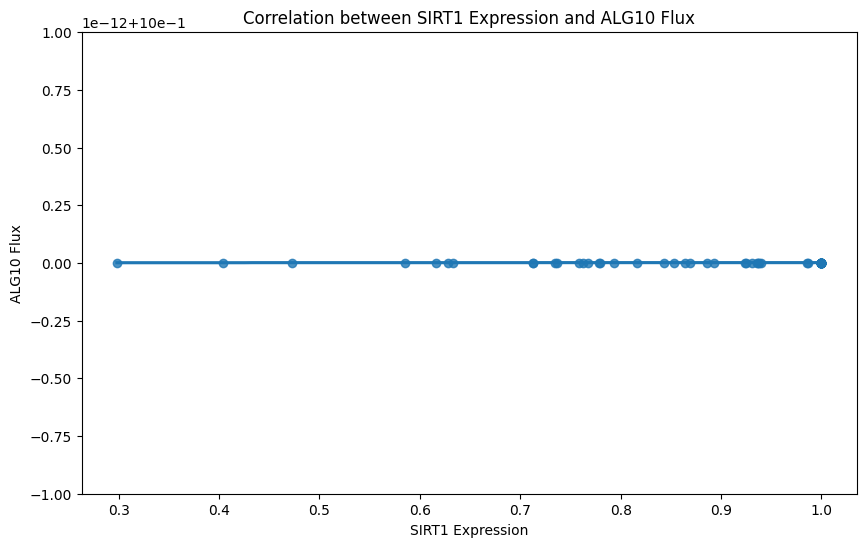

Linear regression results for SIRT1 and ALG10:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



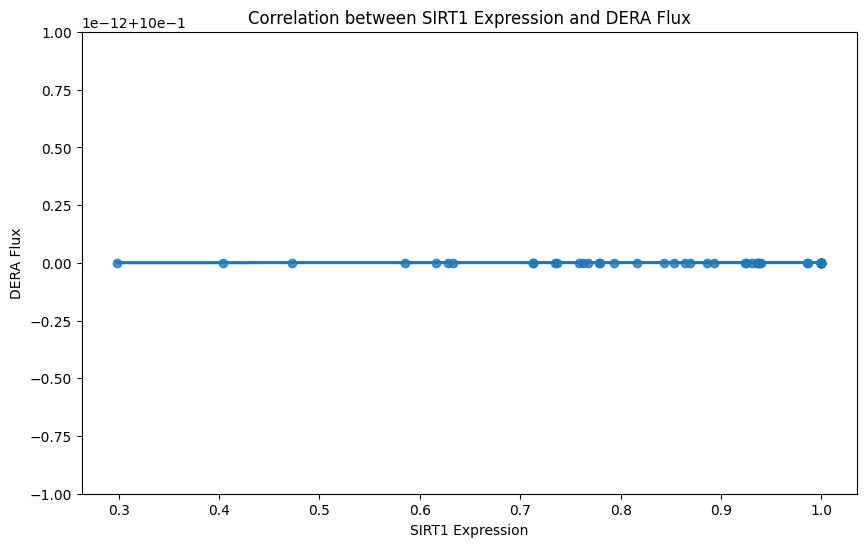

Linear regression results for SIRT1 and DERA:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



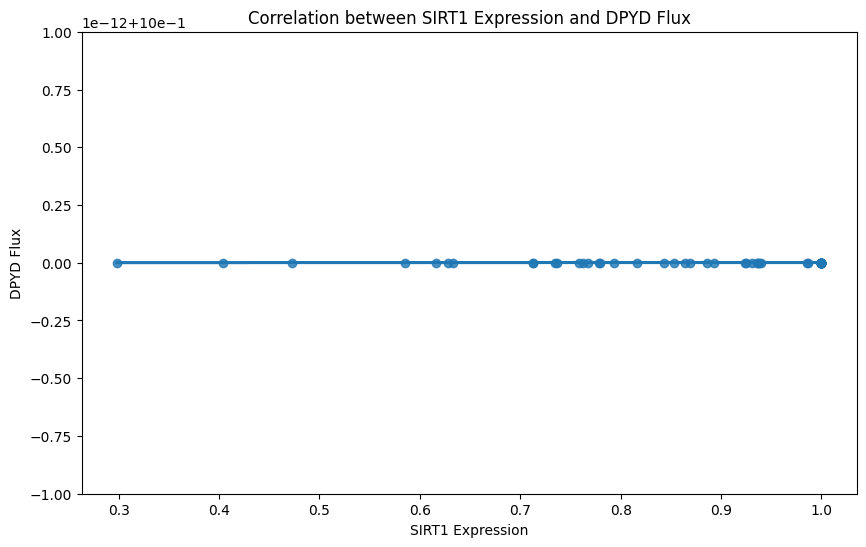

Linear regression results for SIRT1 and DPYD:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



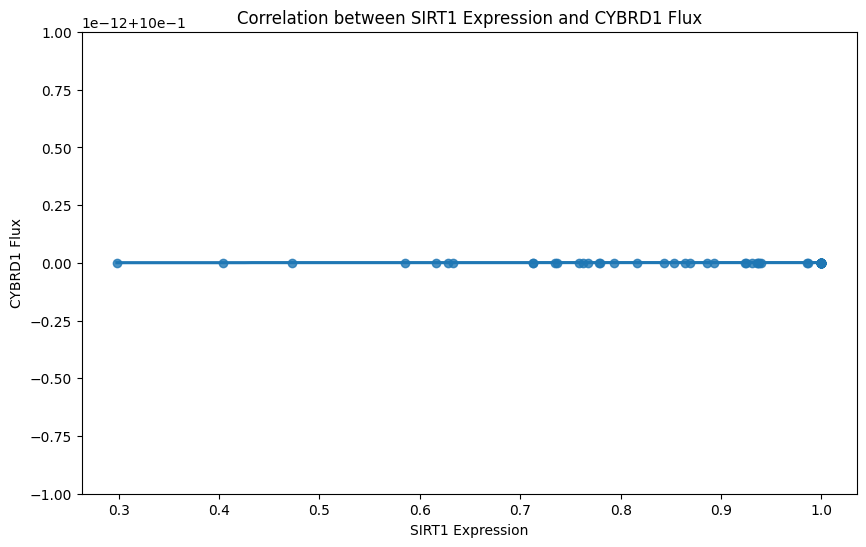

Linear regression results for SIRT1 and CYBRD1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



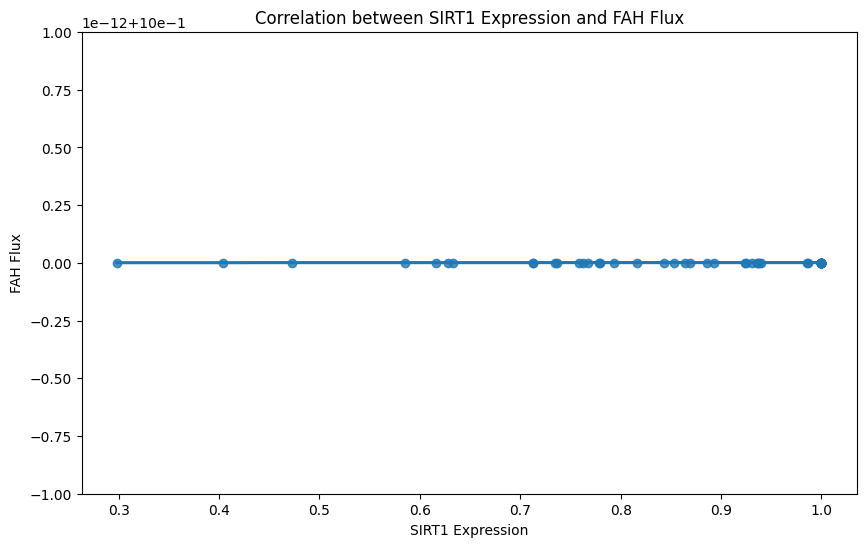

Linear regression results for SIRT1 and FAH:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



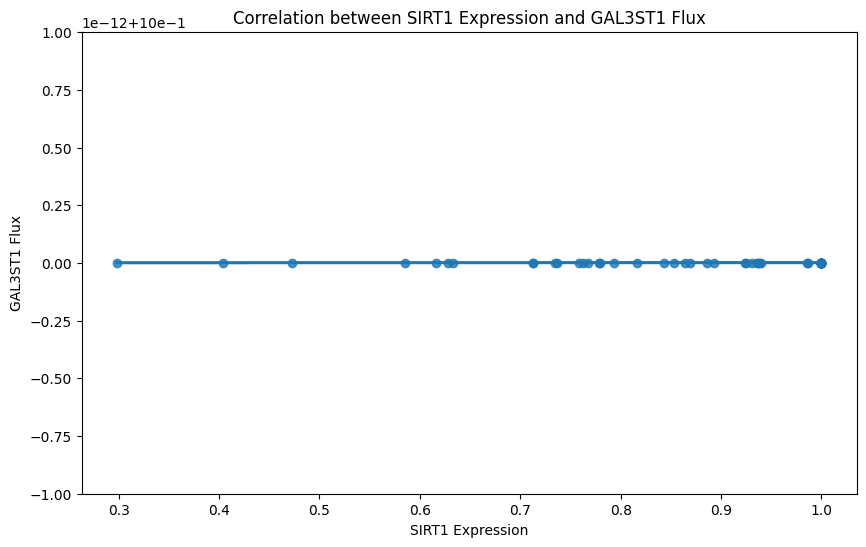

Linear regression results for SIRT1 and GAL3ST1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



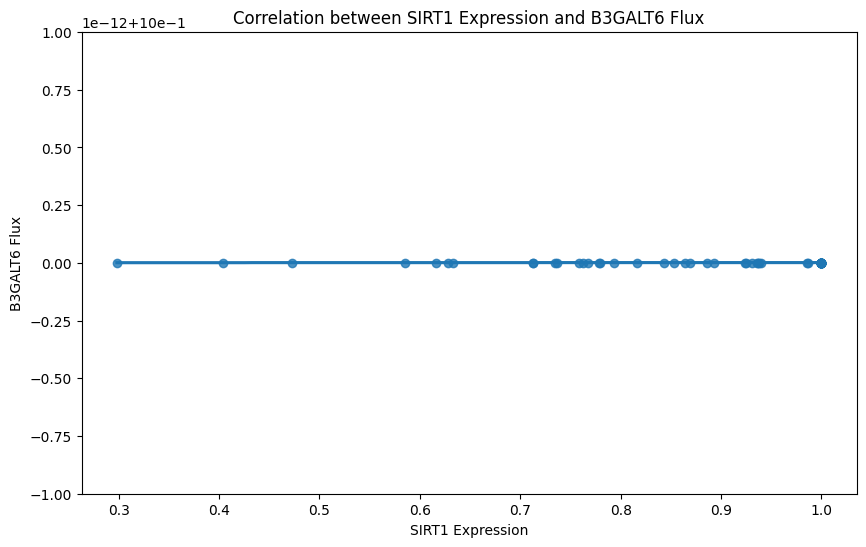

Linear regression results for SIRT1 and B3GALT6:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



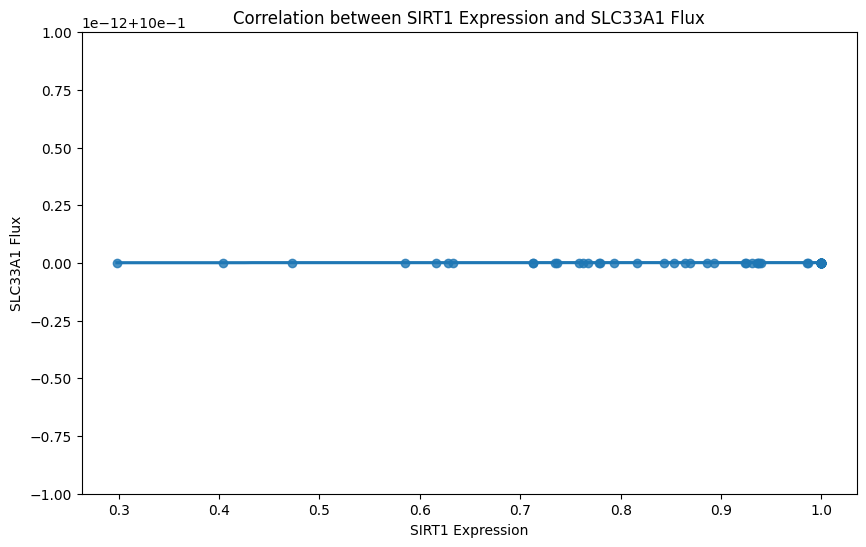

Linear regression results for SIRT1 and SLC33A1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



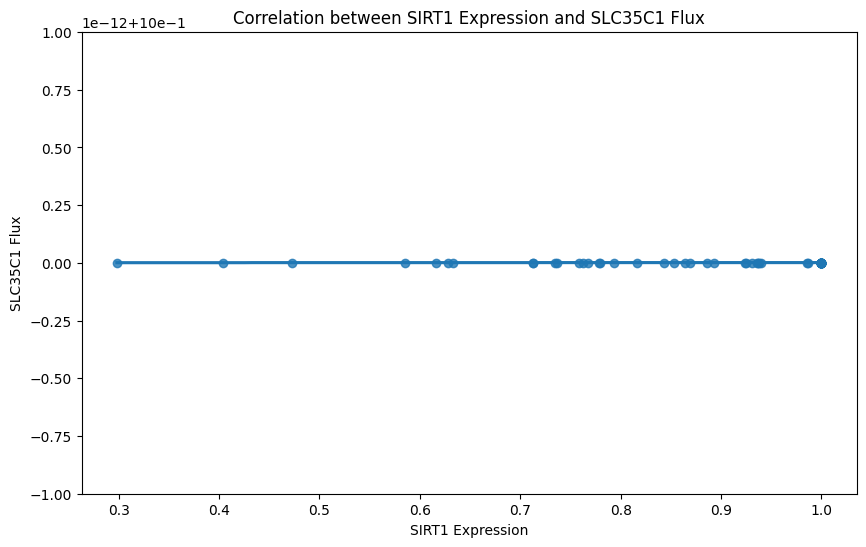

Linear regression results for SIRT1 and SLC35C1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



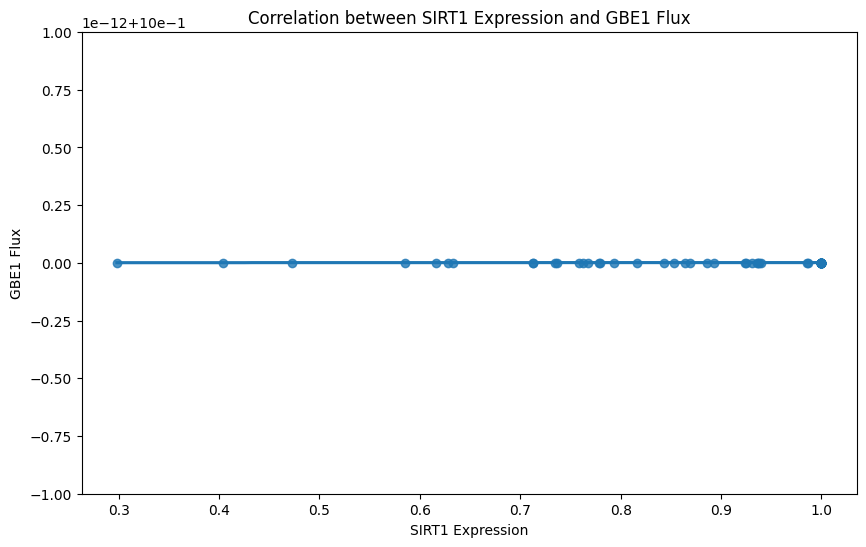

Linear regression results for SIRT1 and GBE1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



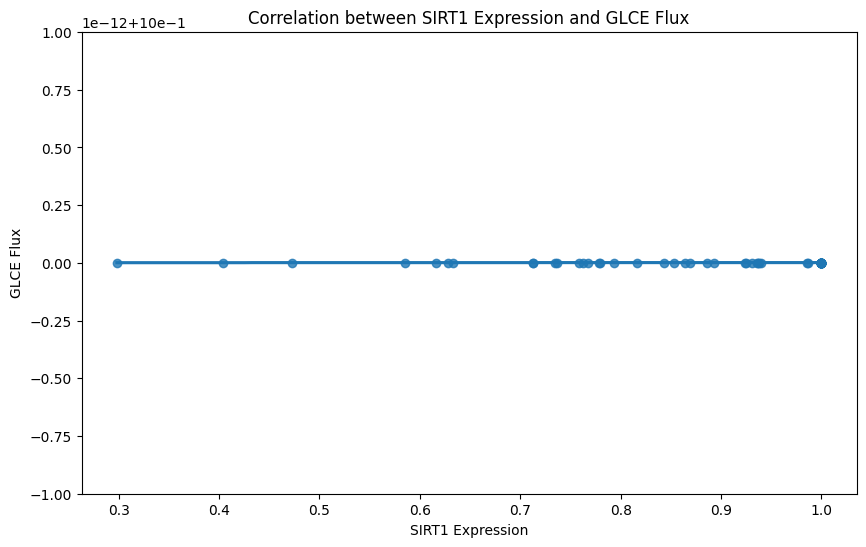

Linear regression results for SIRT1 and GLCE:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



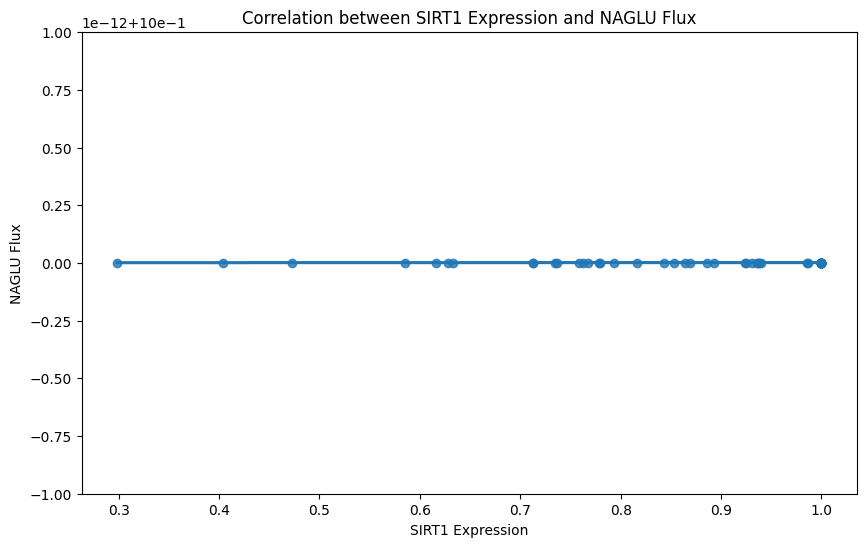

Linear regression results for SIRT1 and NAGLU:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



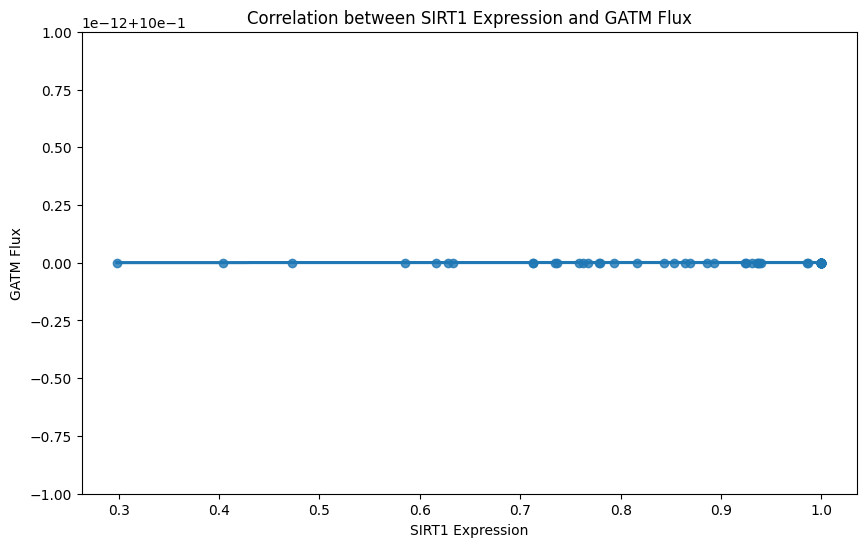

Linear regression results for SIRT1 and GATM:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



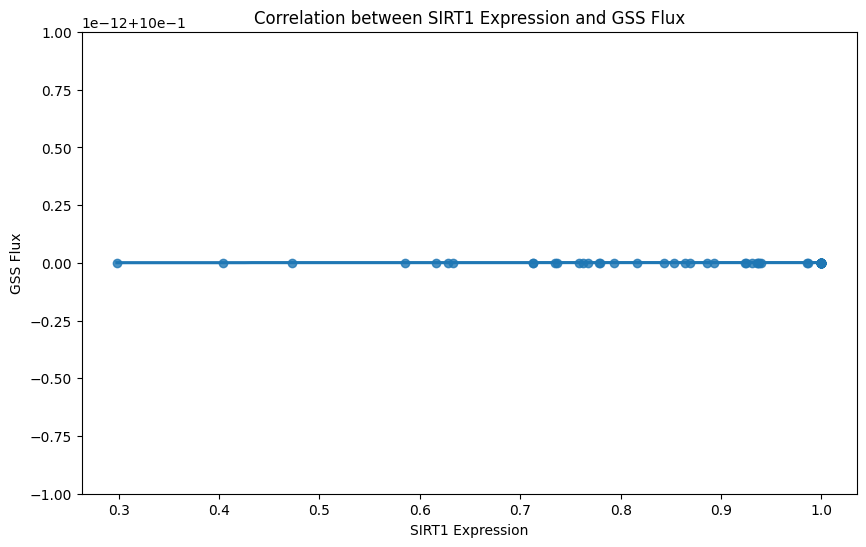

Linear regression results for SIRT1 and GSS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



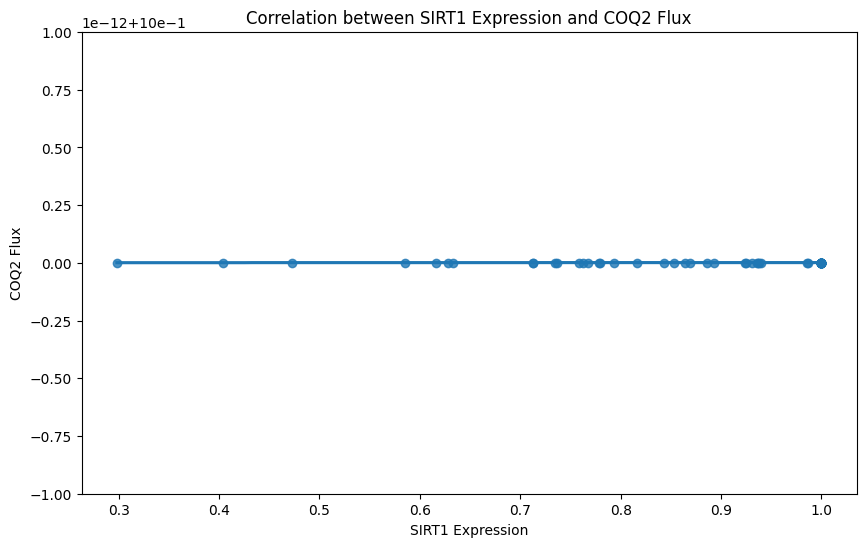

Linear regression results for SIRT1 and COQ2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



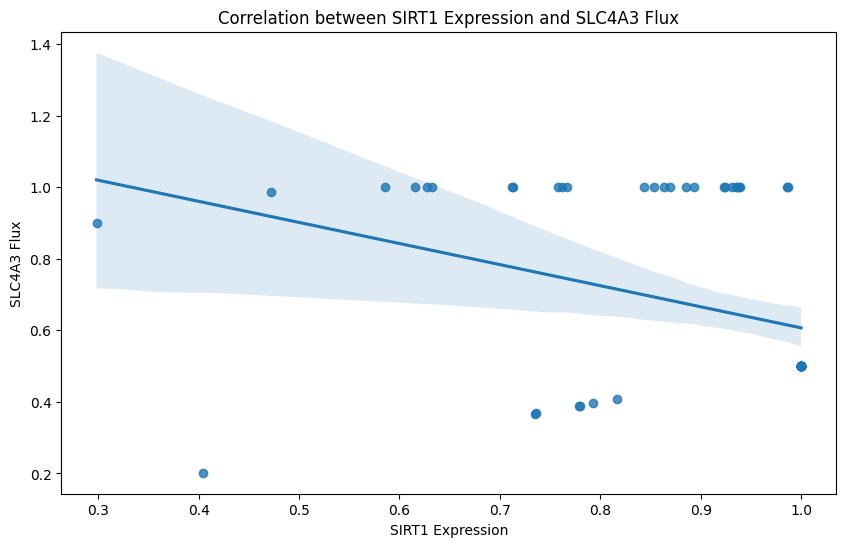

Linear regression results for SIRT1 and SLC4A3:
Slope: -0.589645257915301
Intercept: 1.19669428340334
R-squared: 0.13365632291748145
P-value: 0.0017177608559894913
Standard error: 0.1807243266953528



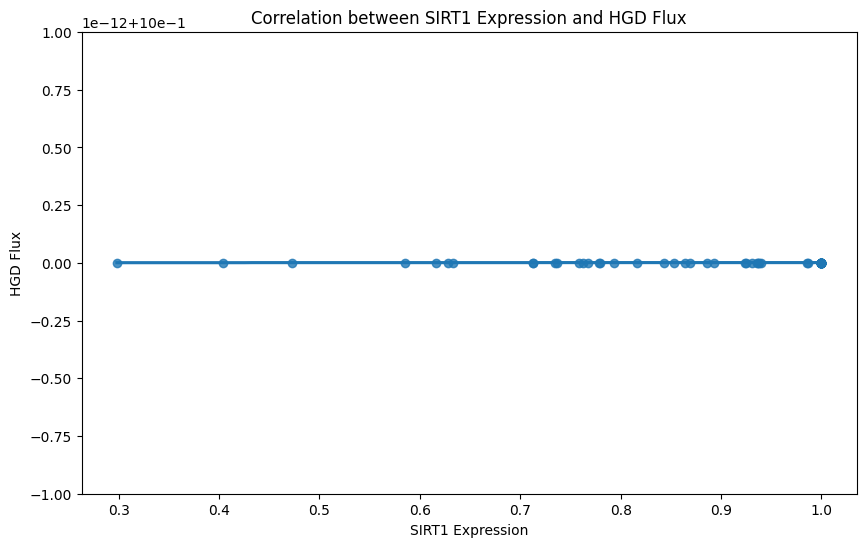

Linear regression results for SIRT1 and HGD:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



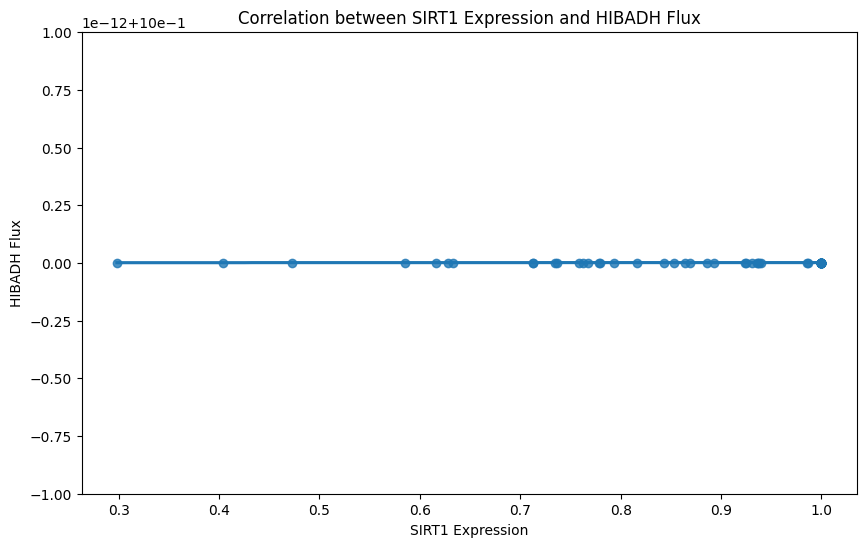

Linear regression results for SIRT1 and HIBADH:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



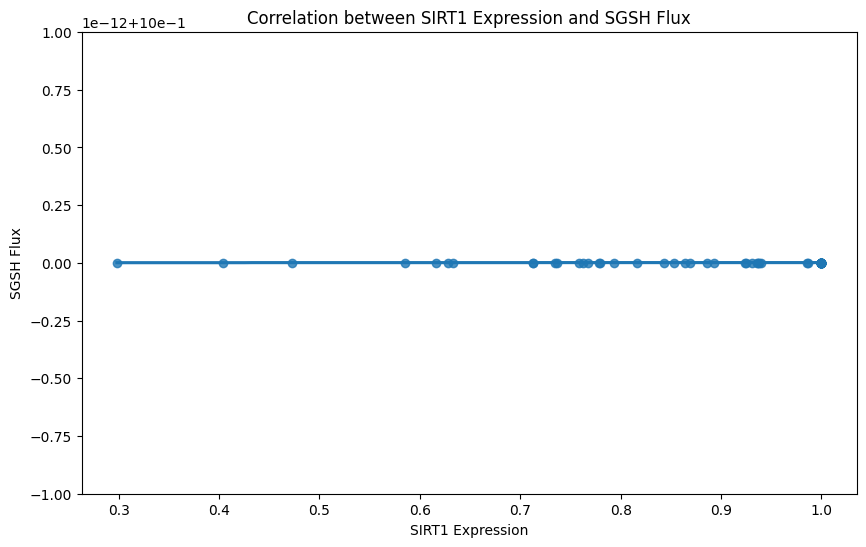

Linear regression results for SIRT1 and SGSH:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



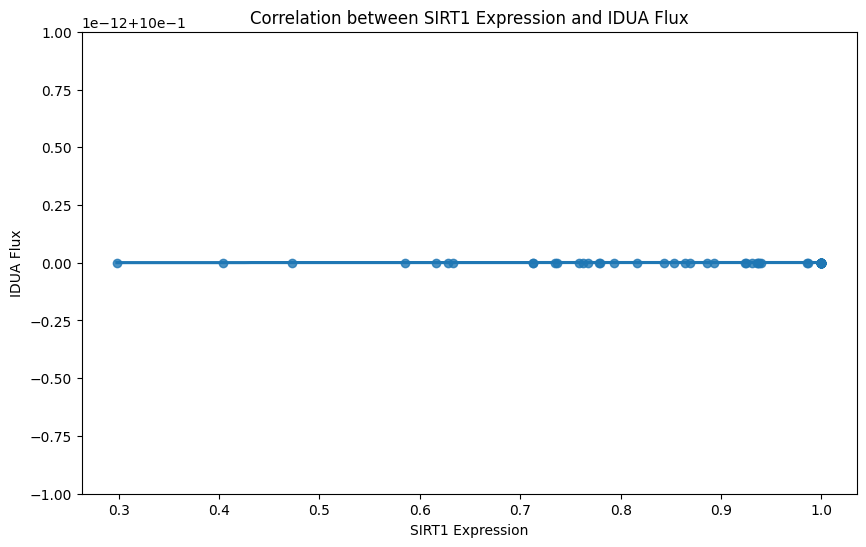

Linear regression results for SIRT1 and IDUA:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



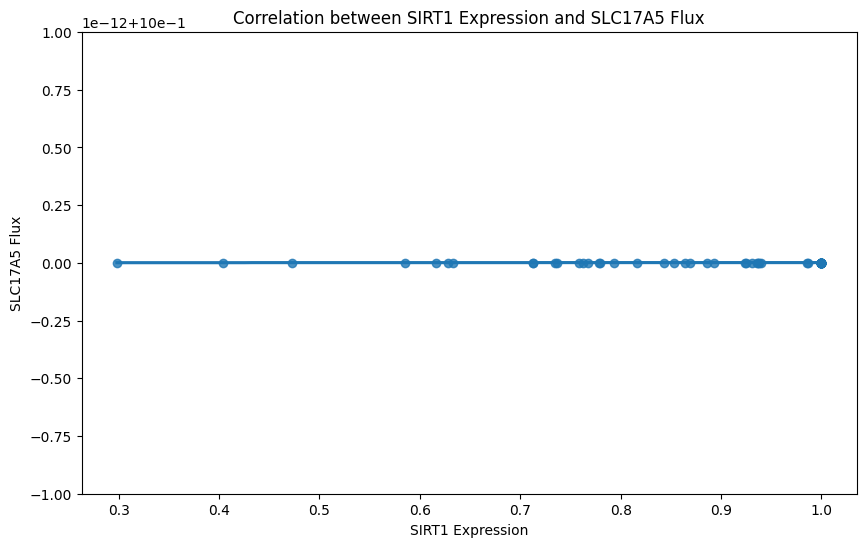

Linear regression results for SIRT1 and SLC17A5:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



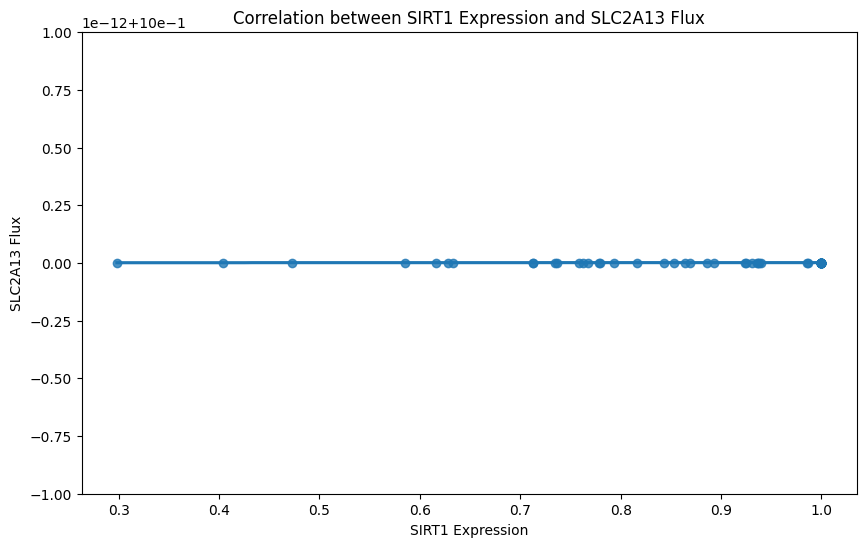

Linear regression results for SIRT1 and SLC2A13:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



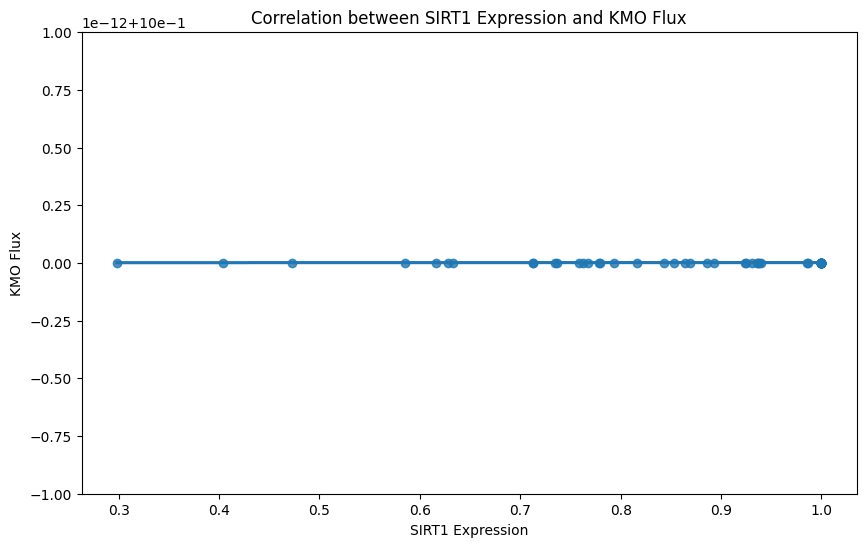

Linear regression results for SIRT1 and KMO:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



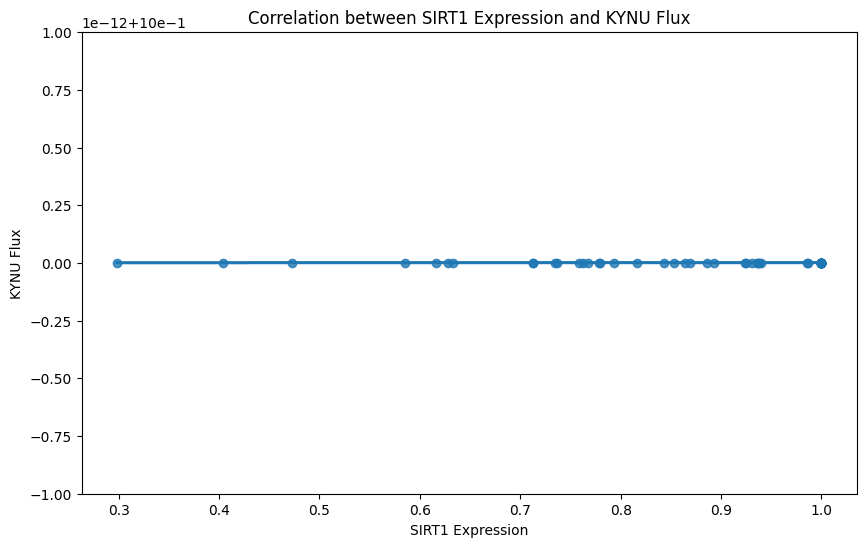

Linear regression results for SIRT1 and KYNU:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



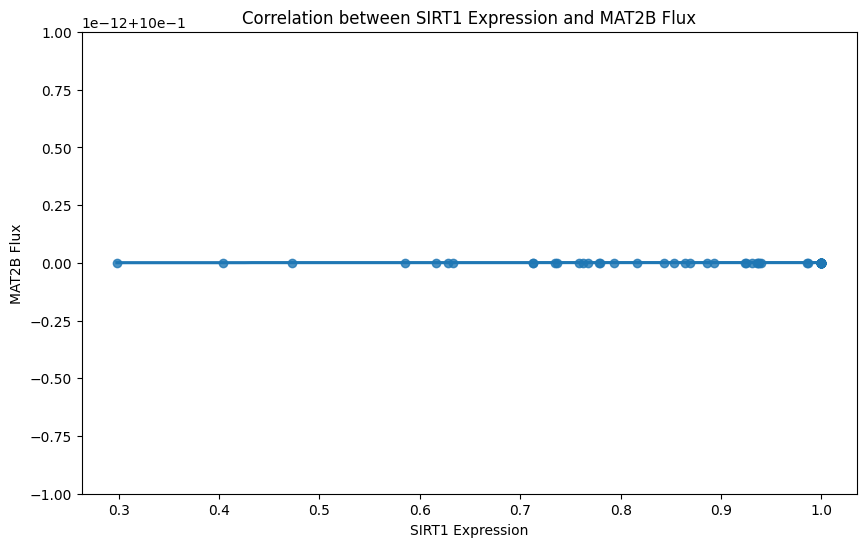

Linear regression results for SIRT1 and MAT2B:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



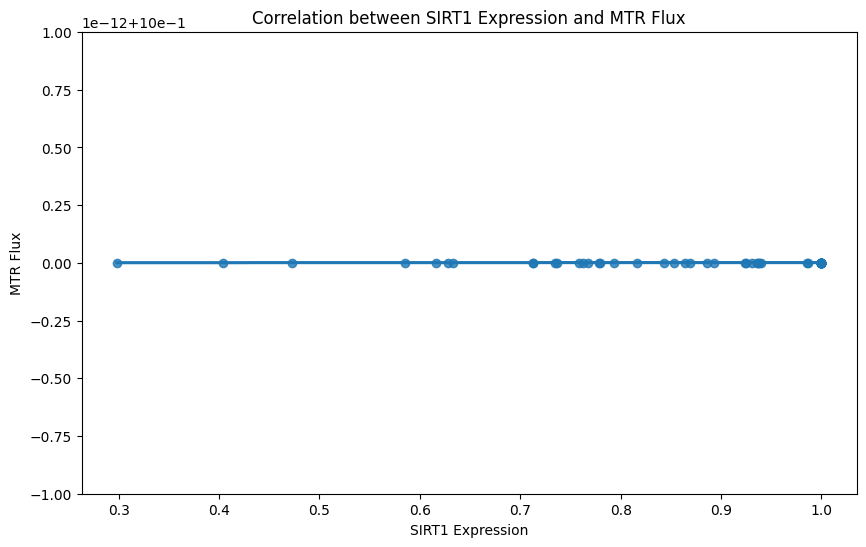

Linear regression results for SIRT1 and MTR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



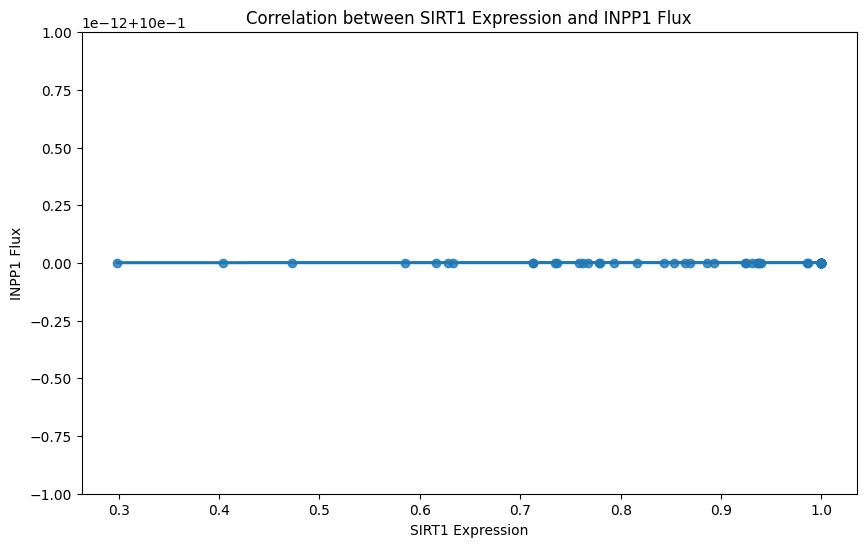

Linear regression results for SIRT1 and INPP1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



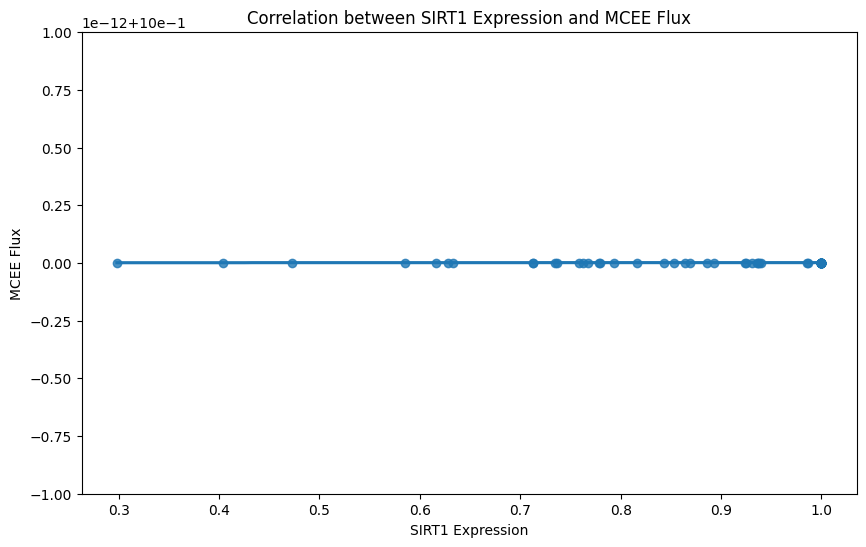

Linear regression results for SIRT1 and MCEE:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



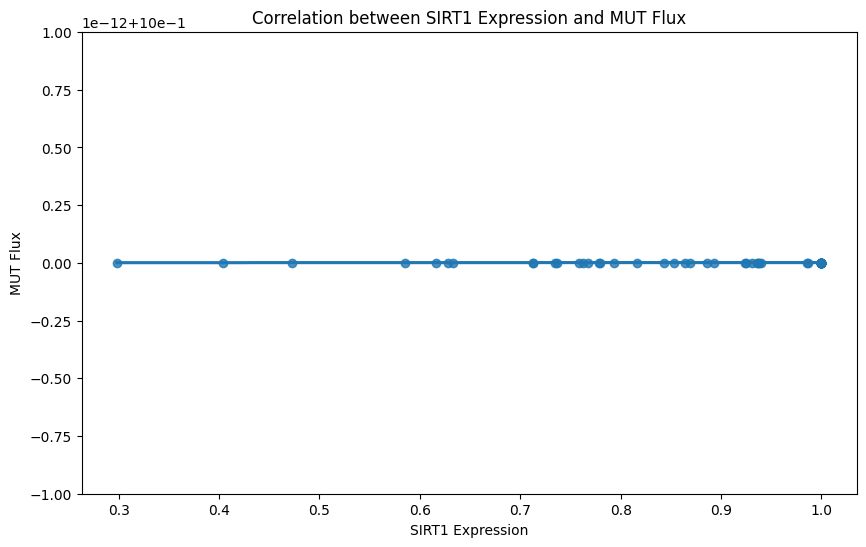

Linear regression results for SIRT1 and MUT:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



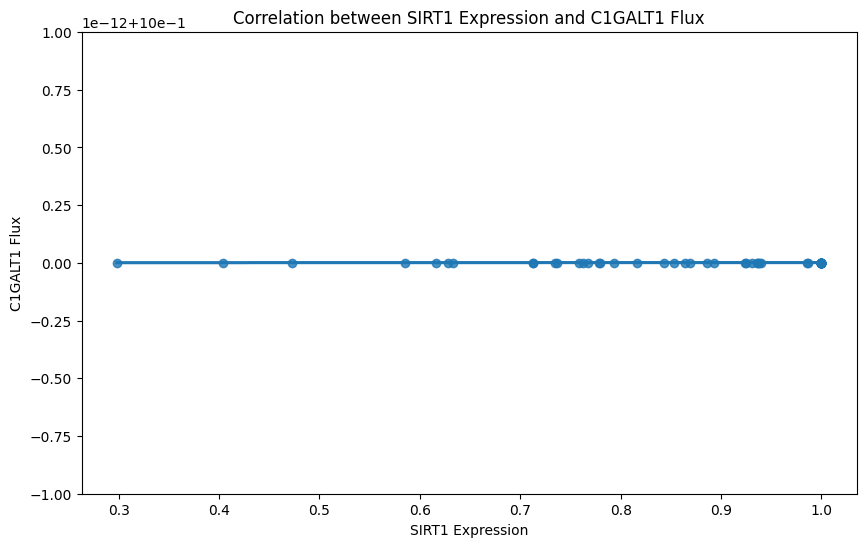

Linear regression results for SIRT1 and C1GALT1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



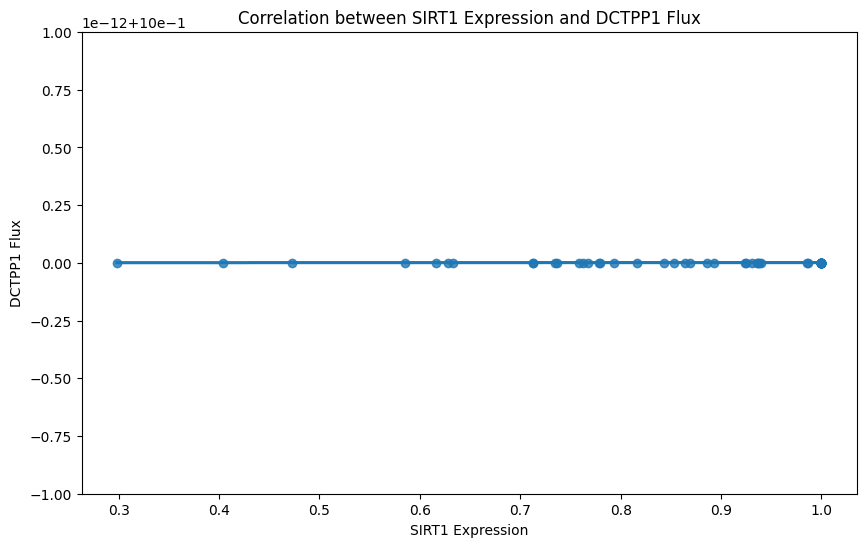

Linear regression results for SIRT1 and DCTPP1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



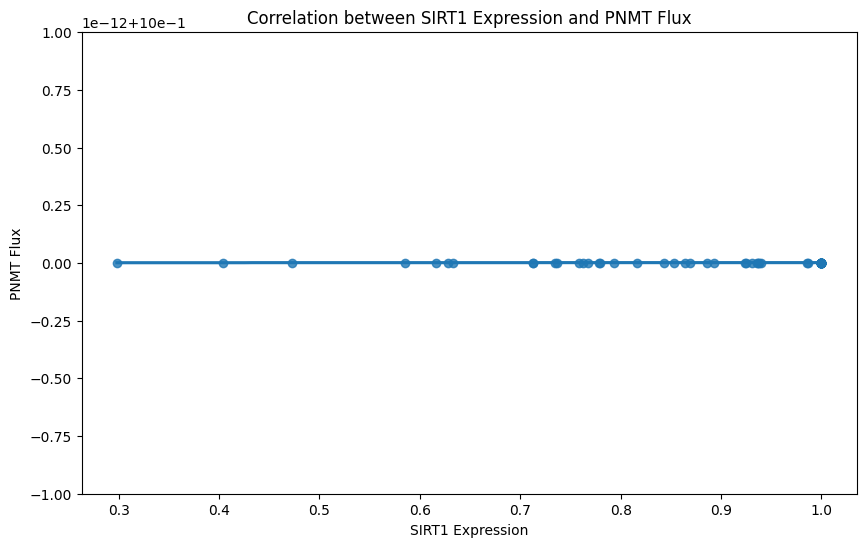

Linear regression results for SIRT1 and PNMT:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



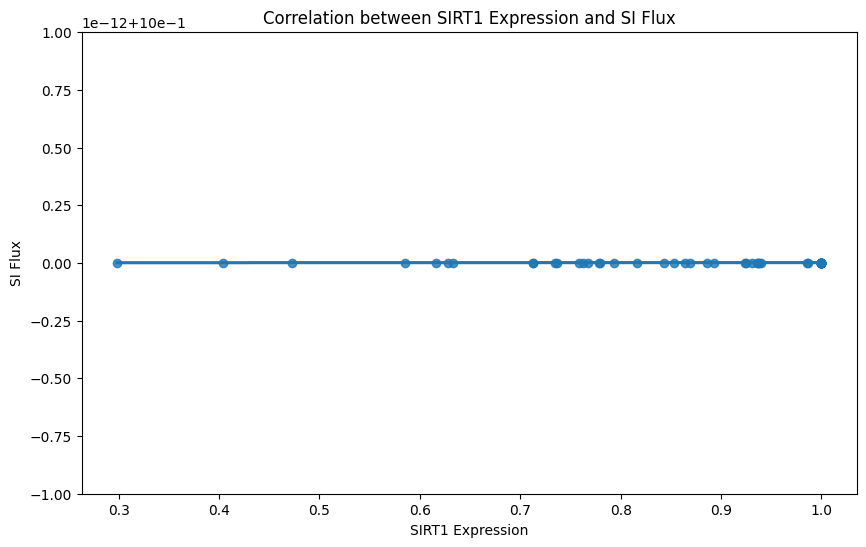

Linear regression results for SIRT1 and SI:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



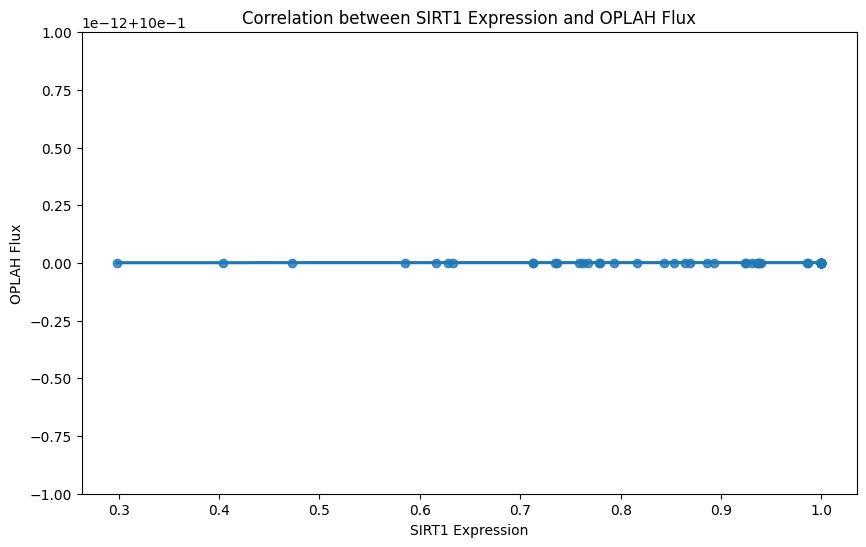

Linear regression results for SIRT1 and OPLAH:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



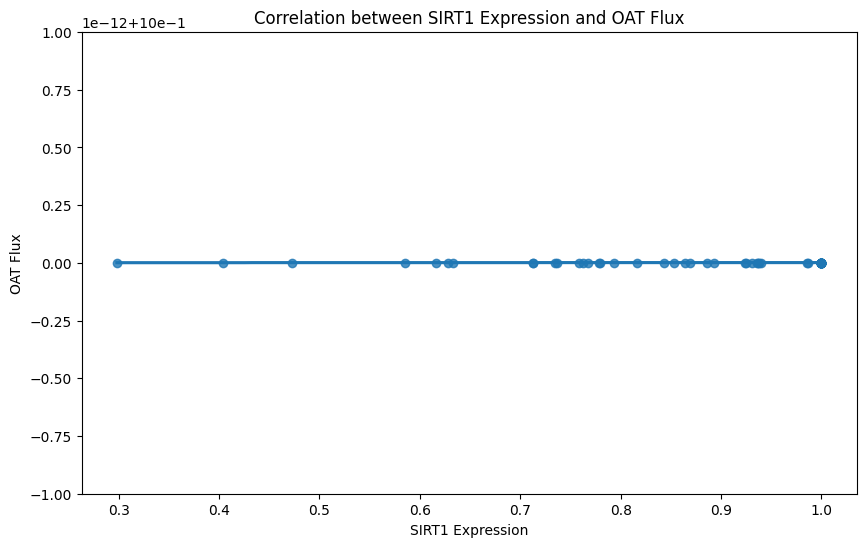

Linear regression results for SIRT1 and OAT:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



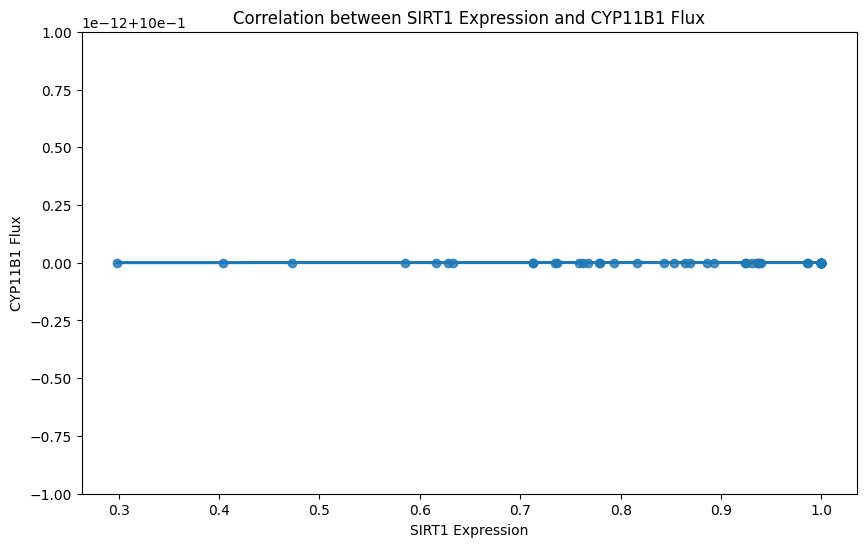

Linear regression results for SIRT1 and CYP11B1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



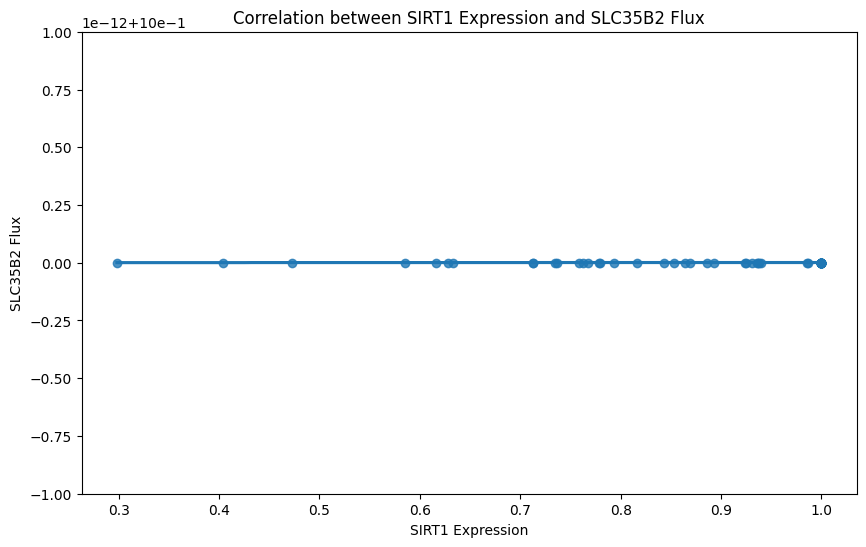

Linear regression results for SIRT1 and SLC35B2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



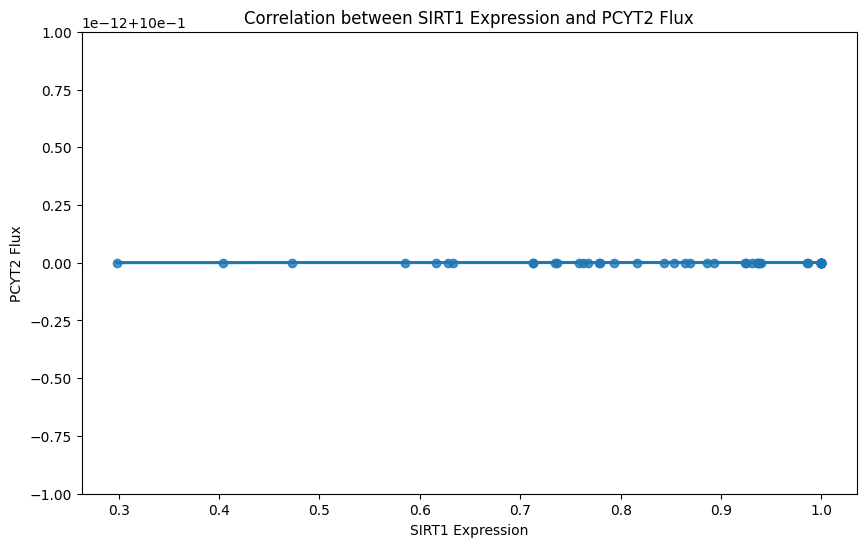

Linear regression results for SIRT1 and PCYT2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



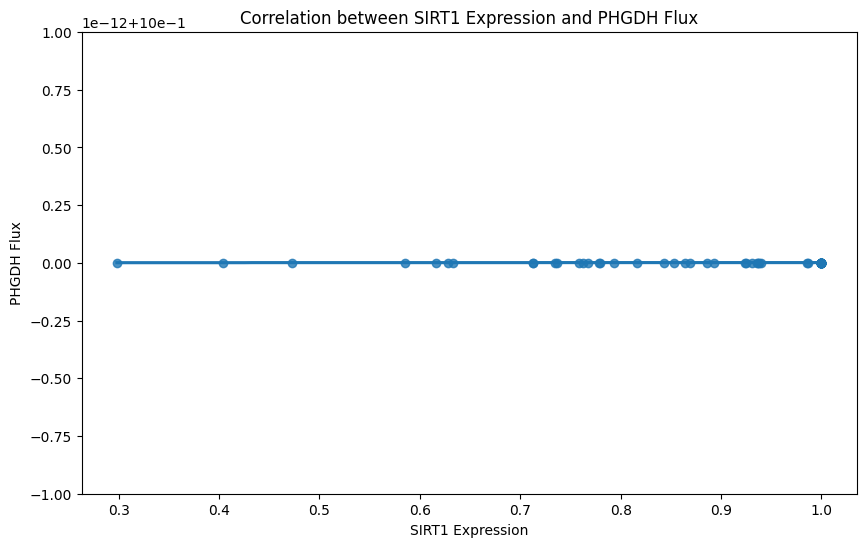

Linear regression results for SIRT1 and PHGDH:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



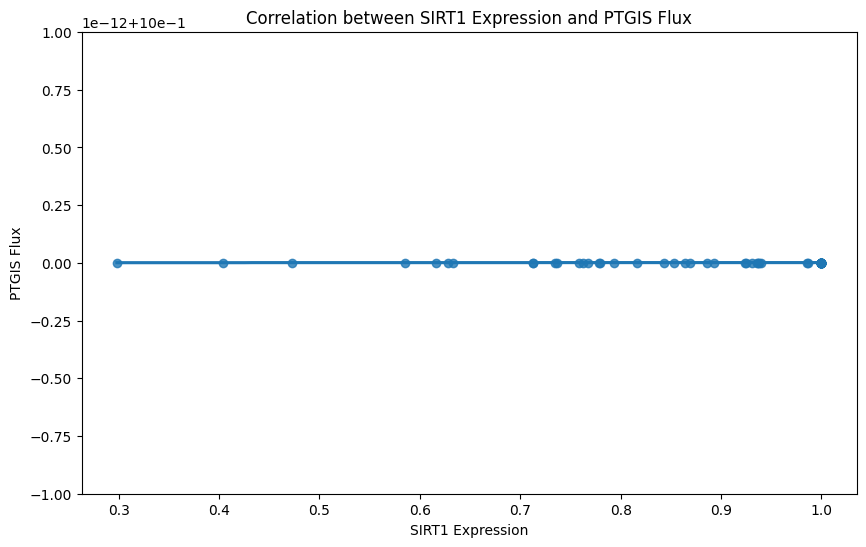

Linear regression results for SIRT1 and PTGIS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



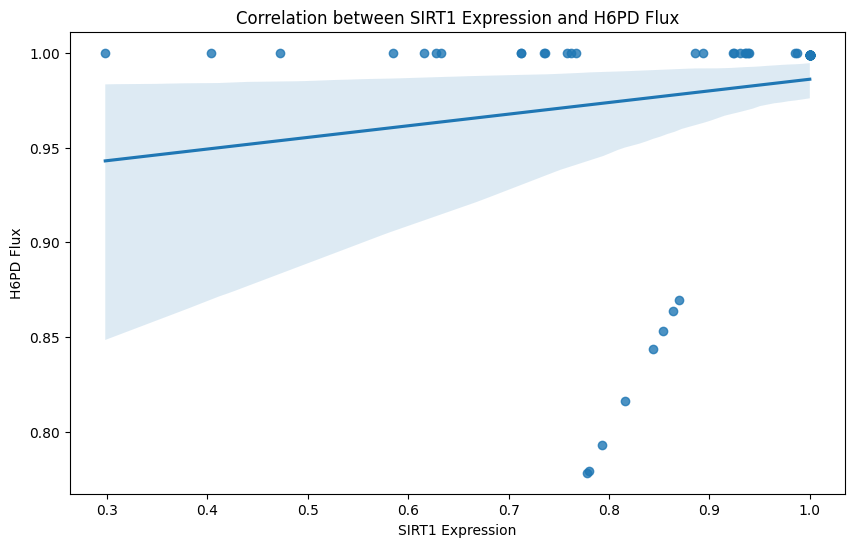

Linear regression results for SIRT1 and H6PD:
Slope: 0.06137858317339941
Intercept: 0.924641173205992
R-squared: 0.029166642480996673
P-value: 0.15445206400005415
Standard error: 0.04263059948013933



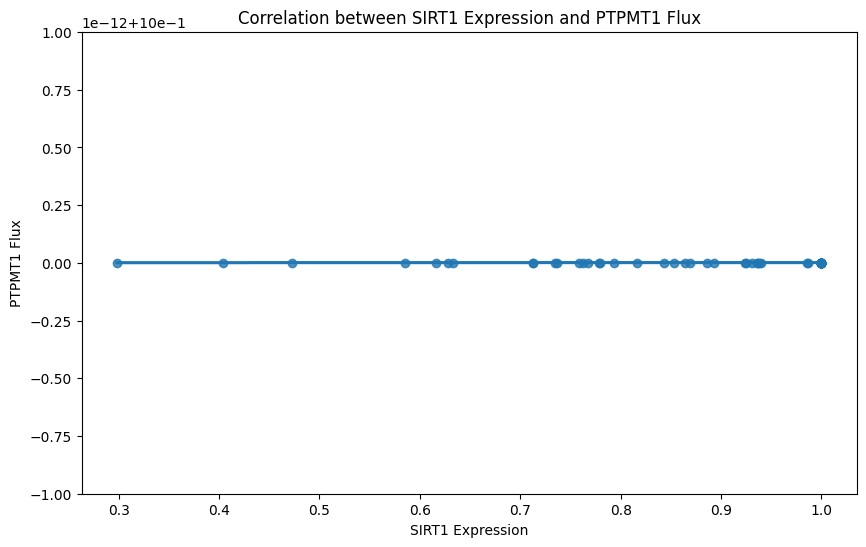

Linear regression results for SIRT1 and PTPMT1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



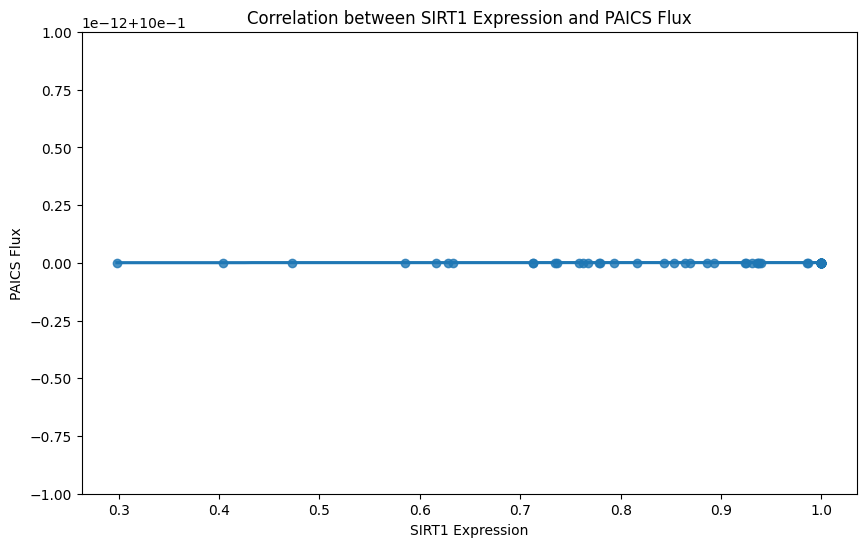

Linear regression results for SIRT1 and PAICS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



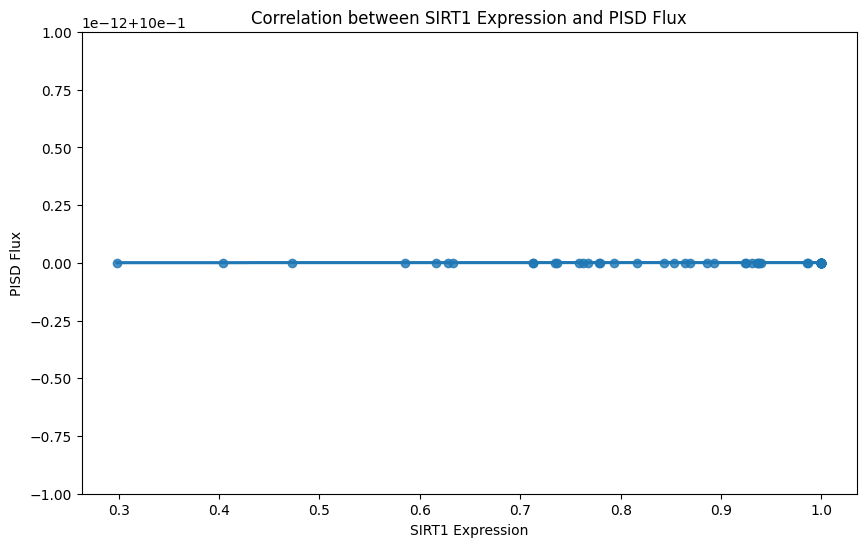

Linear regression results for SIRT1 and PISD:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



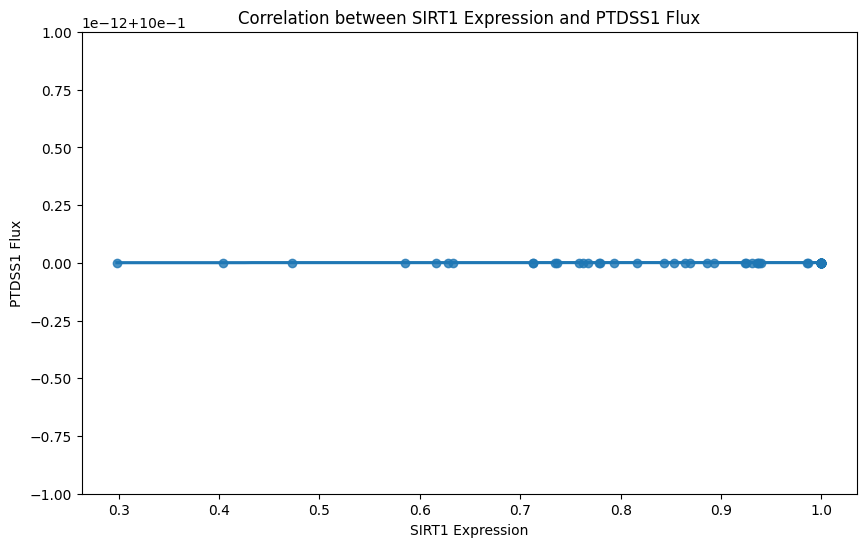

Linear regression results for SIRT1 and PTDSS1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



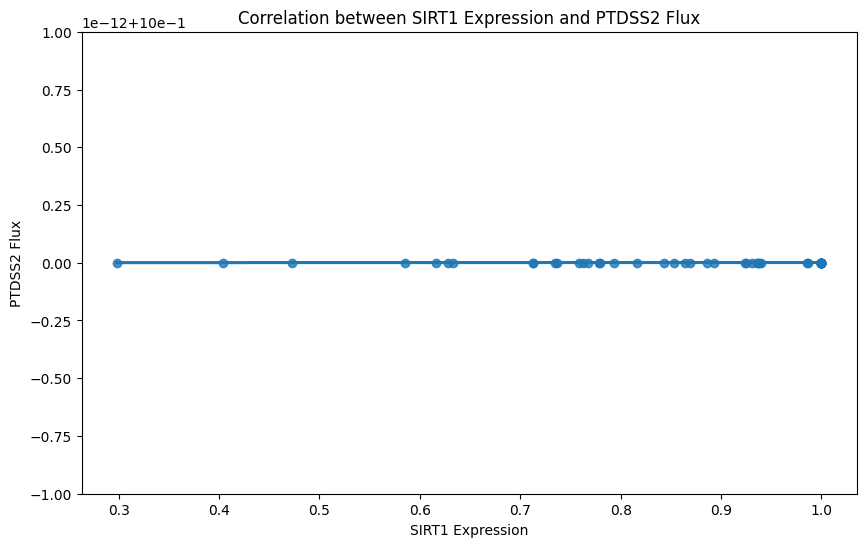

Linear regression results for SIRT1 and PTDSS2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



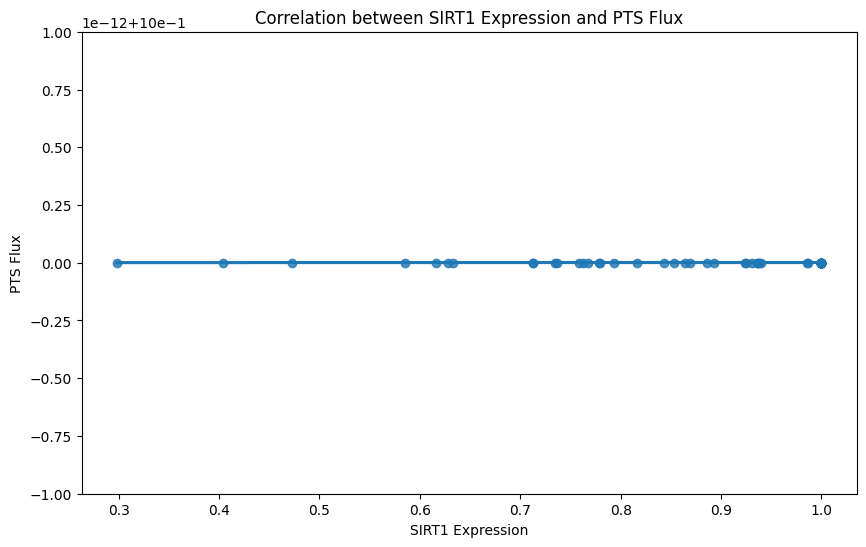

Linear regression results for SIRT1 and PTS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



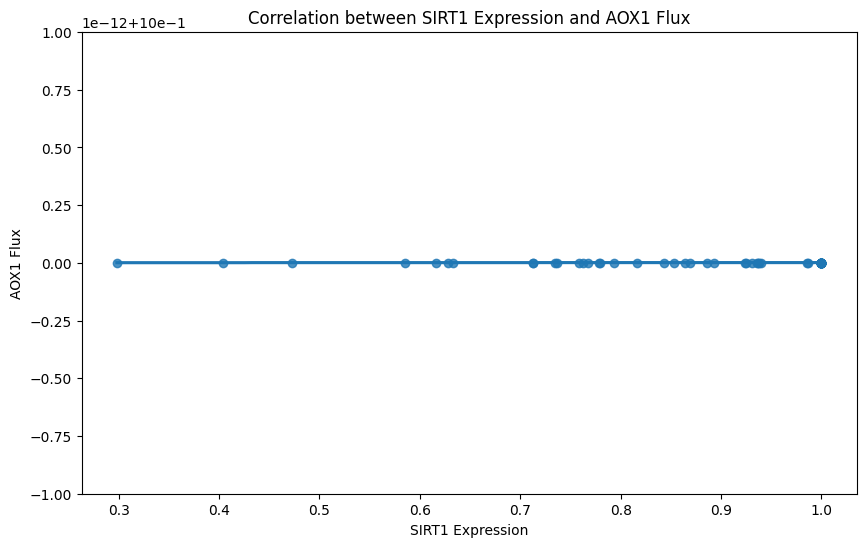

Linear regression results for SIRT1 and AOX1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



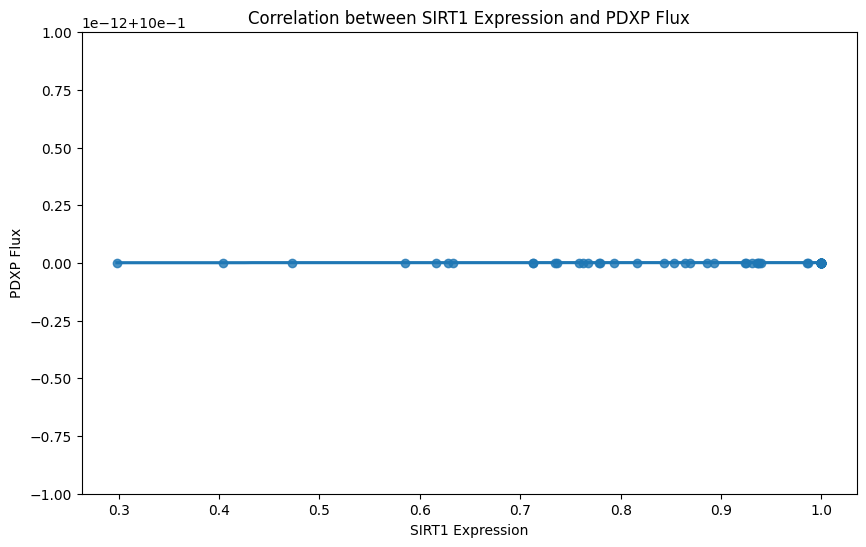

Linear regression results for SIRT1 and PDXP:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



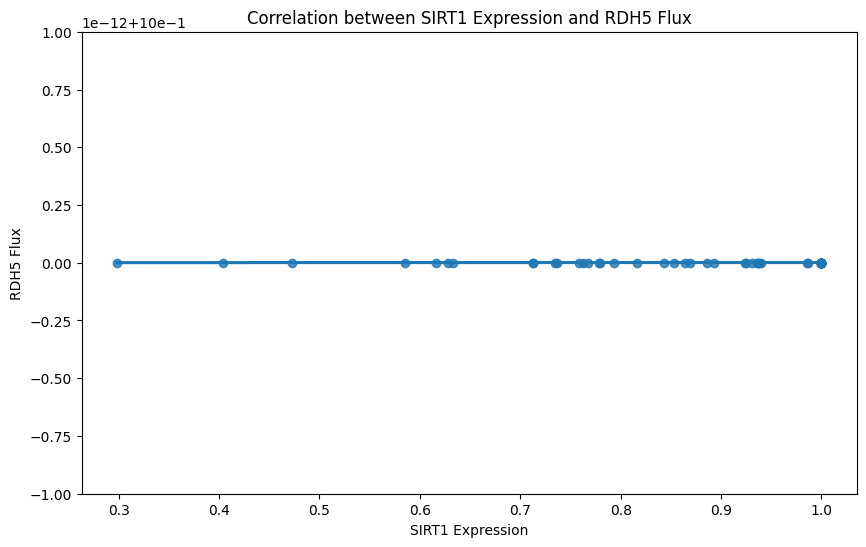

Linear regression results for SIRT1 and RDH5:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



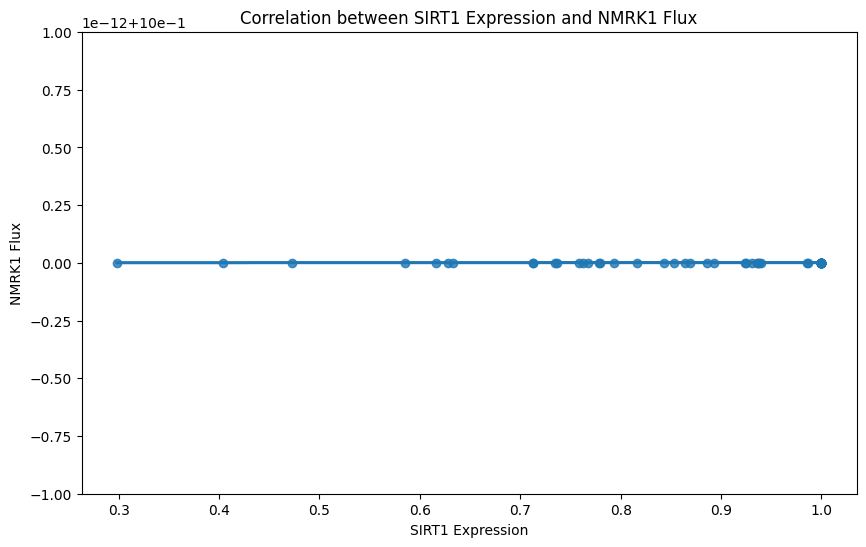

Linear regression results for SIRT1 and NMRK1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



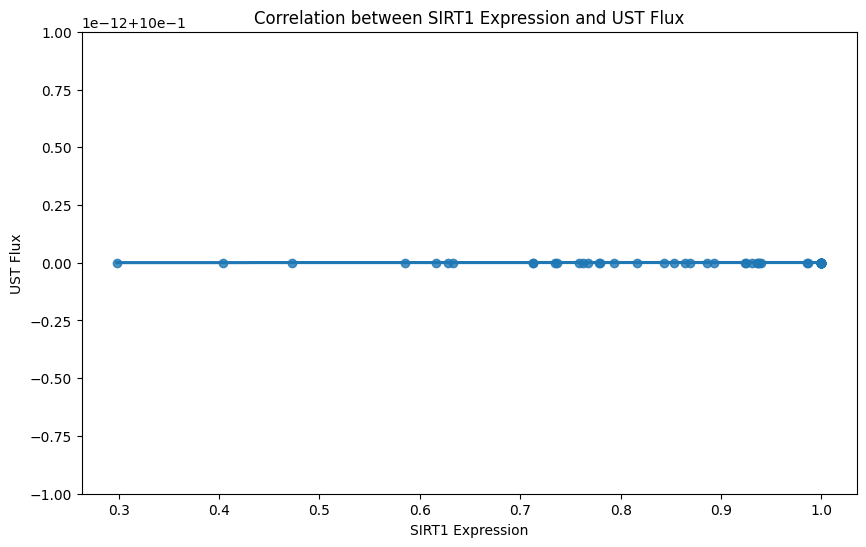

Linear regression results for SIRT1 and UST:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



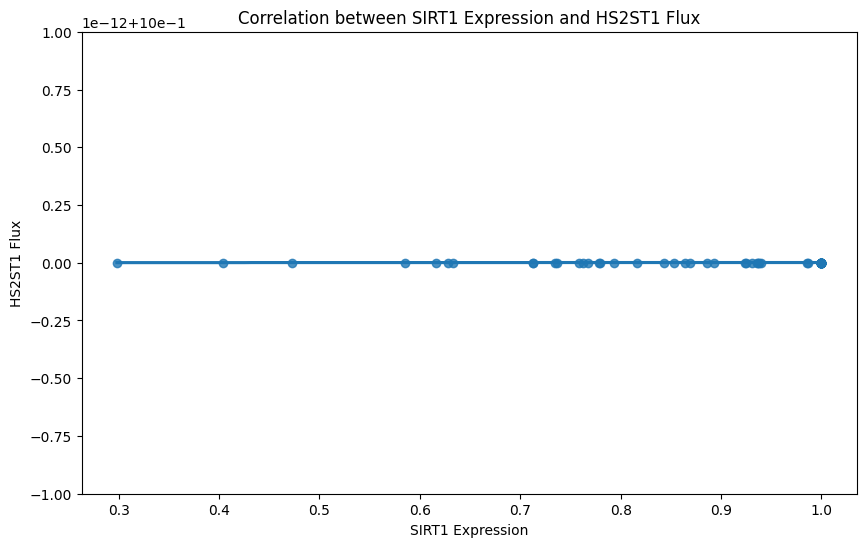

Linear regression results for SIRT1 and HS2ST1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



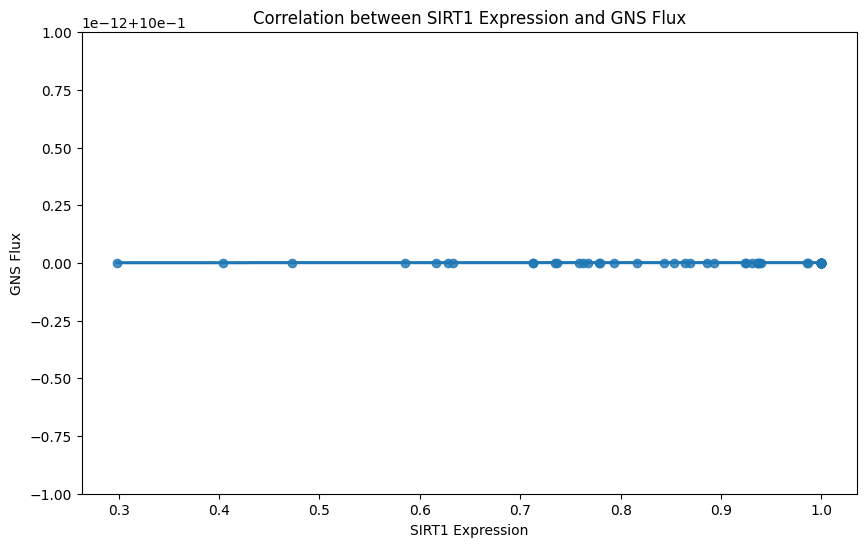

Linear regression results for SIRT1 and GNS:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



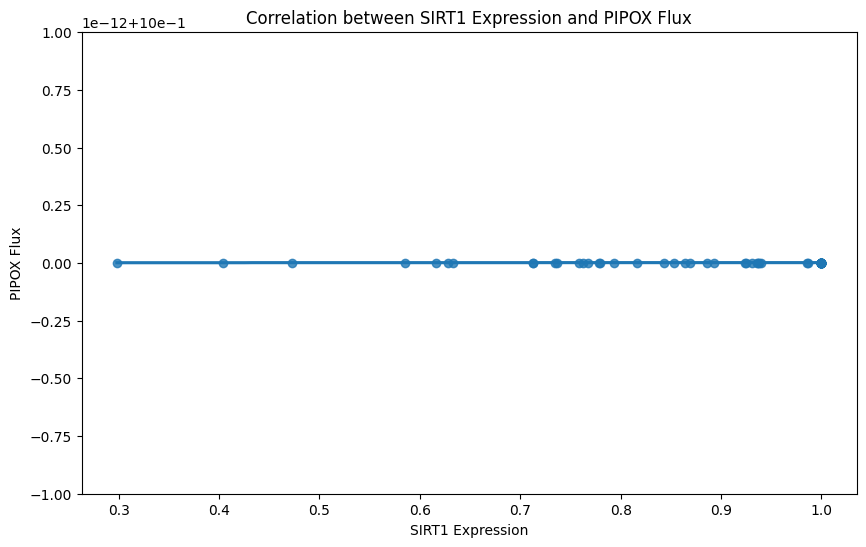

Linear regression results for SIRT1 and PIPOX:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



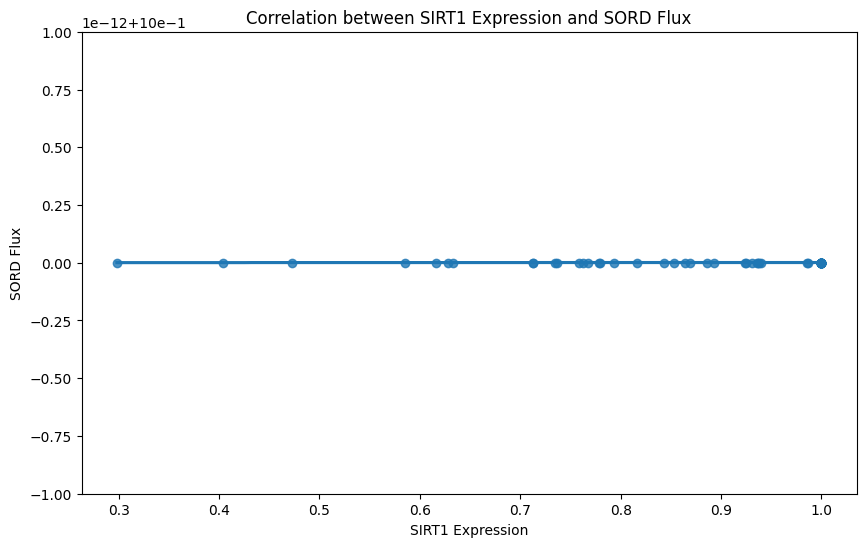

Linear regression results for SIRT1 and SORD:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



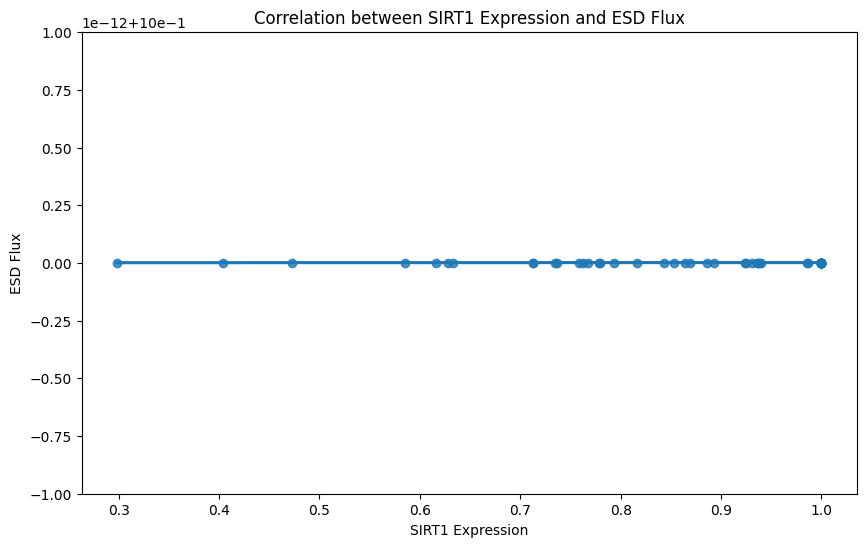

Linear regression results for SIRT1 and ESD:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



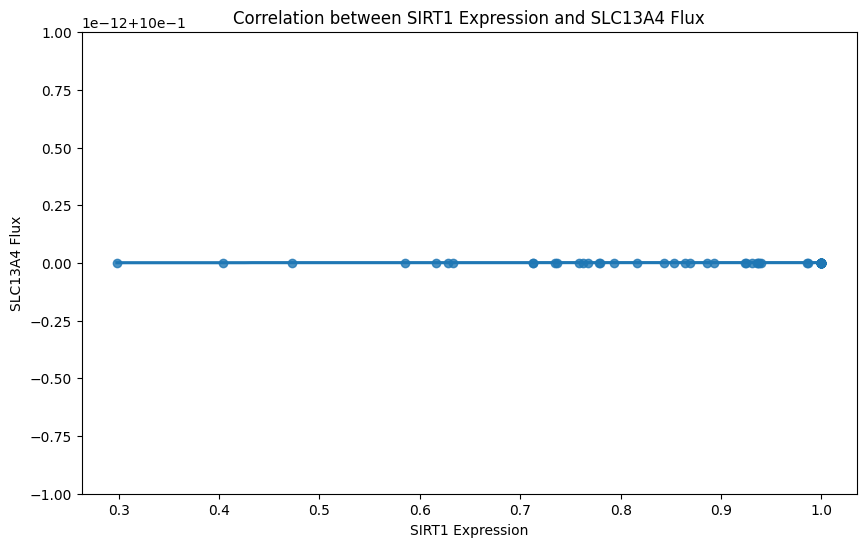

Linear regression results for SIRT1 and SLC13A4:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



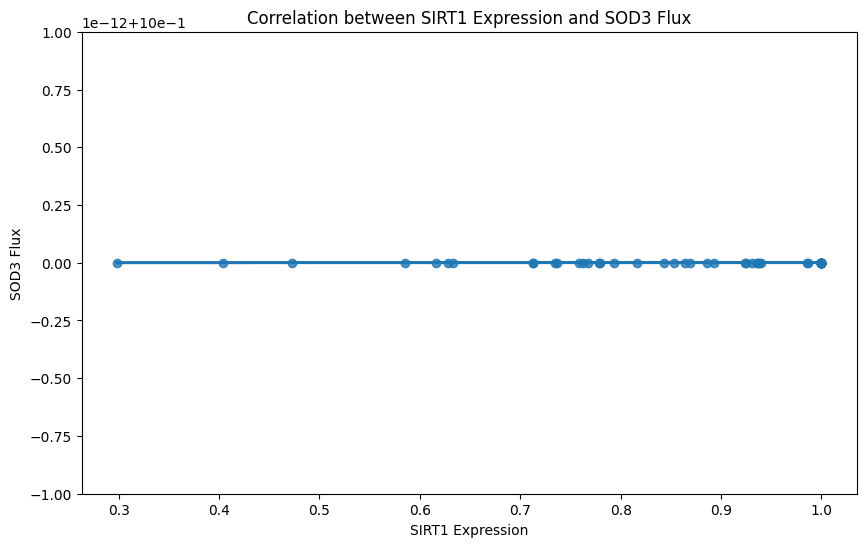

Linear regression results for SIRT1 and SOD3:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



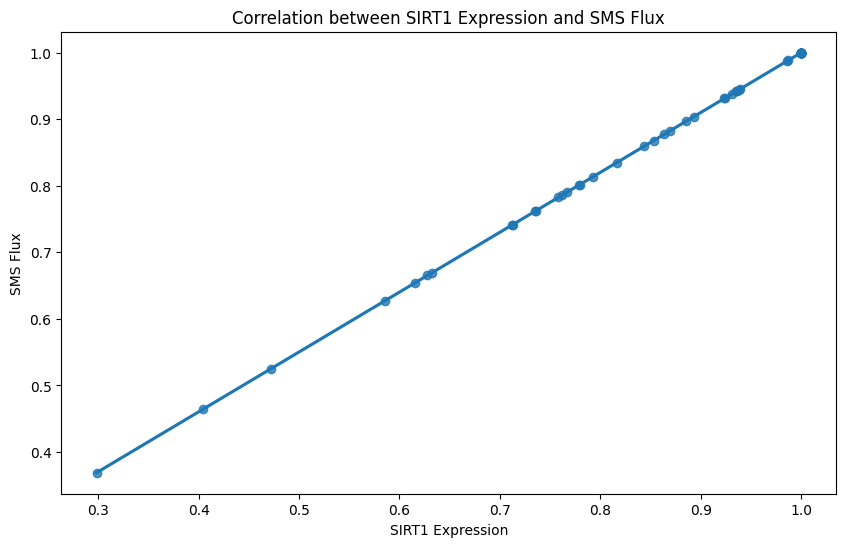

Linear regression results for SIRT1 and SMS:
Slope: 0.8995237305638227
Intercept: 0.10047626943617705
R-squared: 0.9999999999999993
P-value: 0.0
Standard error: 2.794916385545575e-09



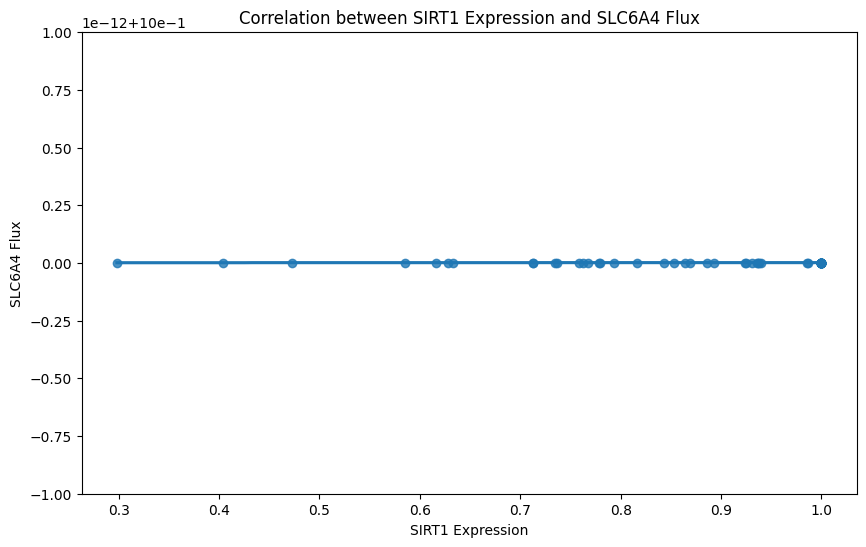

Linear regression results for SIRT1 and SLC6A4:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



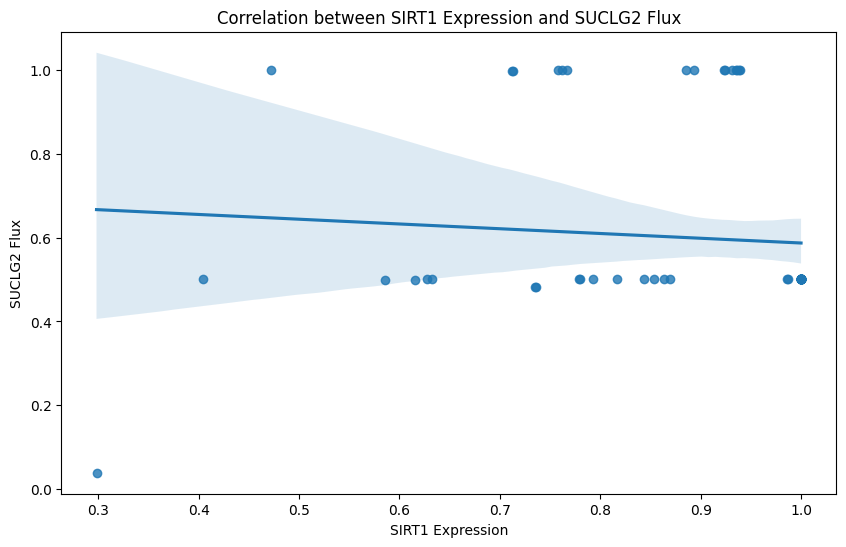

Linear regression results for SIRT1 and SUCLG2:
Slope: -0.11344751769893392
Intercept: 0.7003270800140458
R-squared: 0.006911608498491264
P-value: 0.49064861737584087
Standard error: 0.16370986109299282



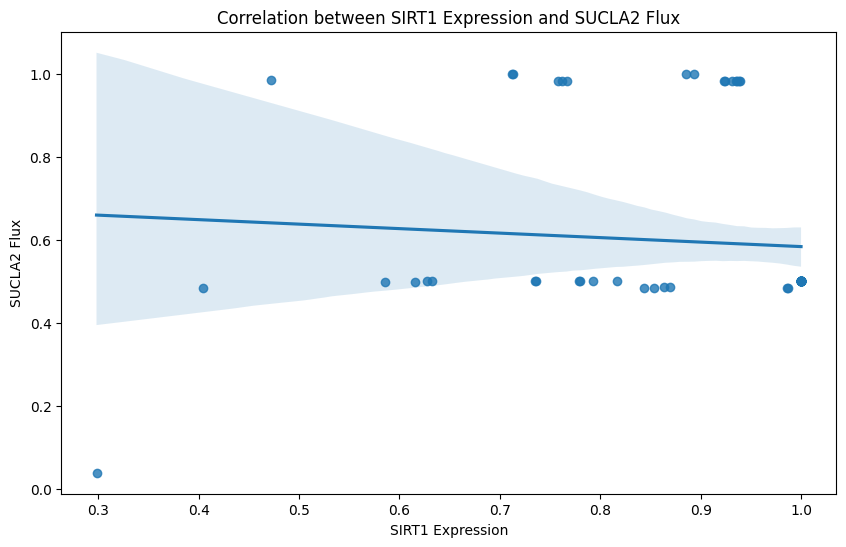

Linear regression results for SIRT1 and SUCLA2:
Slope: -0.10819839017624218
Intercept: 0.6922500223732415
R-squared: 0.006527135577135559
P-value: 0.5030062198392142
Standard error: 0.16069891394514602



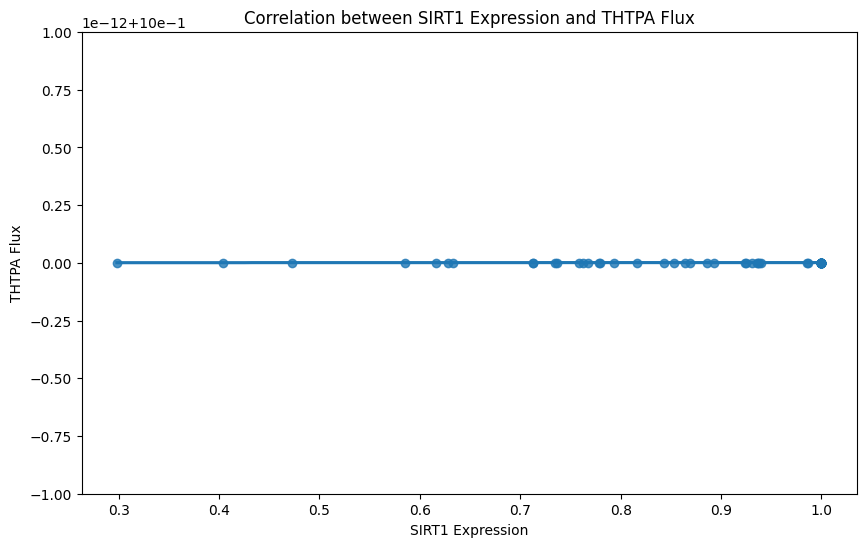

Linear regression results for SIRT1 and THTPA:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



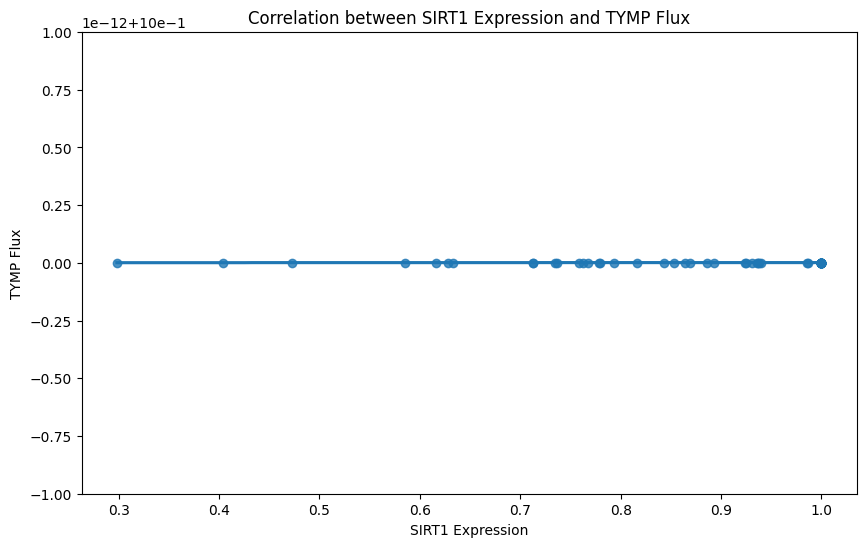

Linear regression results for SIRT1 and TYMP:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



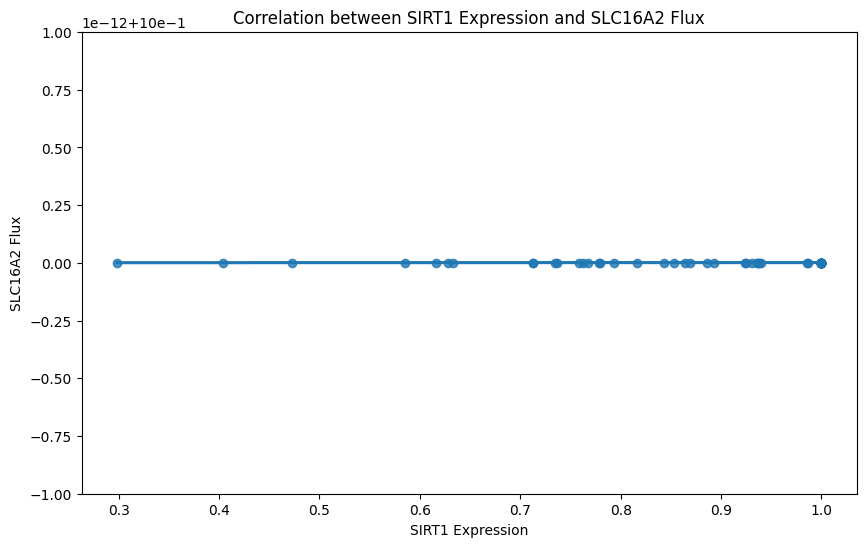

Linear regression results for SIRT1 and SLC16A2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



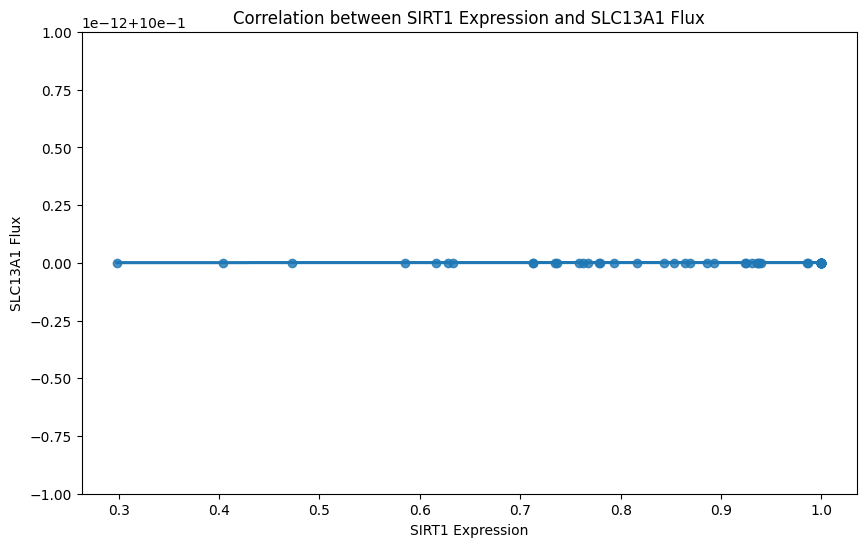

Linear regression results for SIRT1 and SLC13A1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



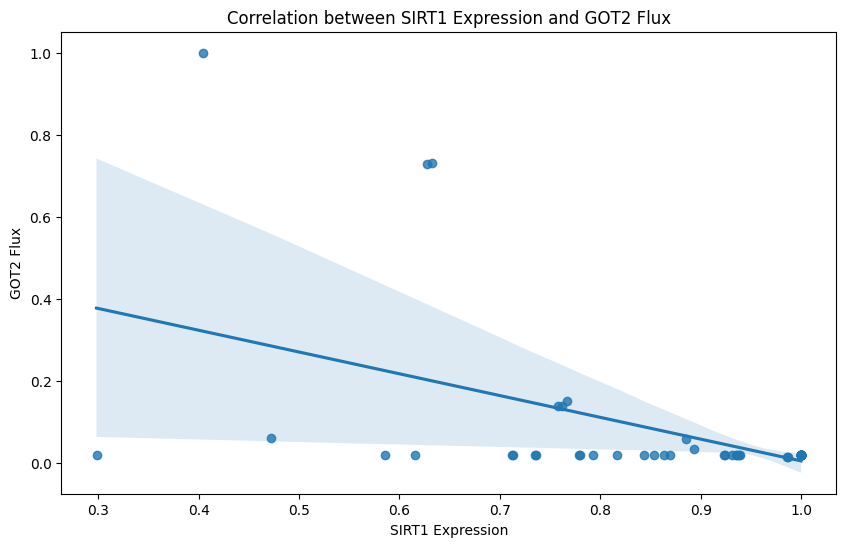

Linear regression results for SIRT1 and GOT2:
Slope: -0.5305127835850154
Intercept: 0.5360589472448039
R-squared: 0.2595594552870616
P-value: 5.691517355759402e-06
Standard error: 0.10786932890157216



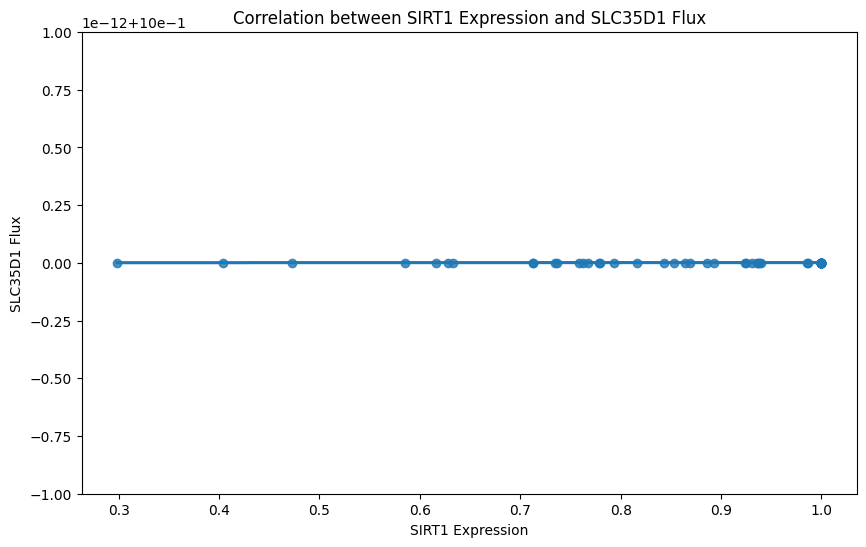

Linear regression results for SIRT1 and SLC35D1:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



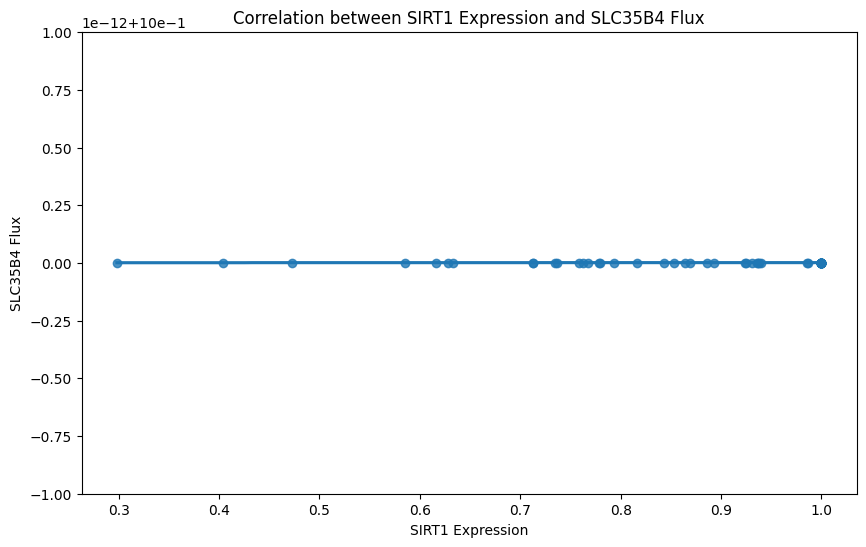

Linear regression results for SIRT1 and SLC35B4:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



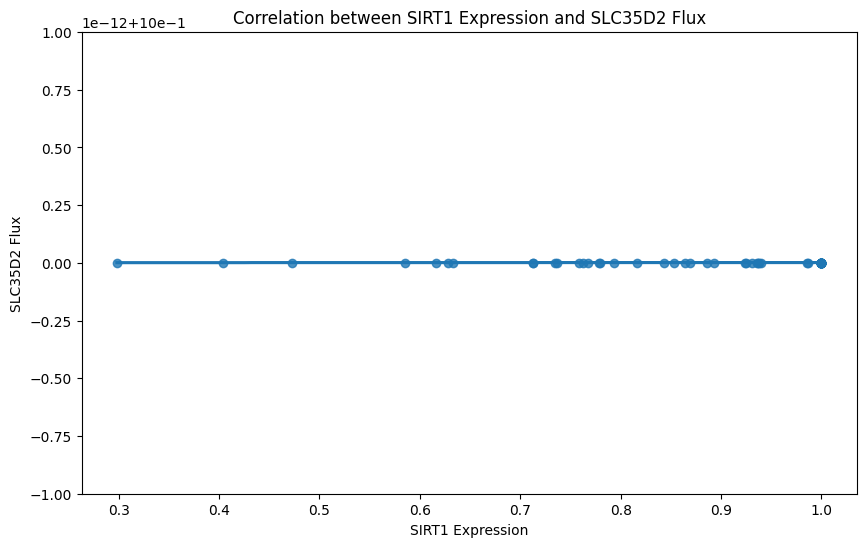

Linear regression results for SIRT1 and SLC35D2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



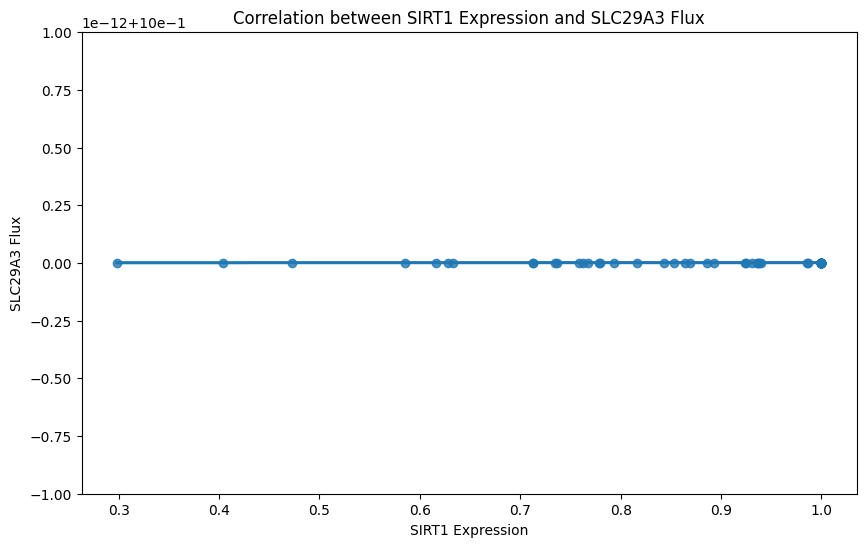

Linear regression results for SIRT1 and SLC29A3:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



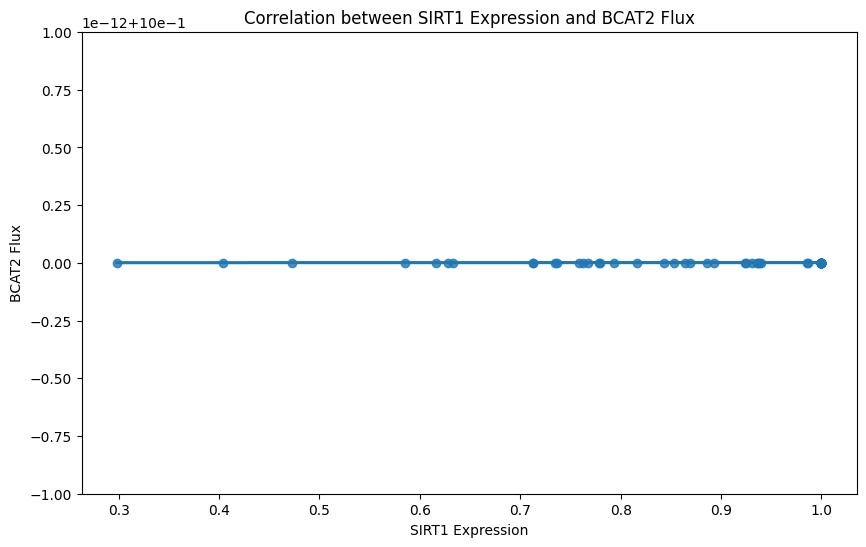

Linear regression results for SIRT1 and BCAT2:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



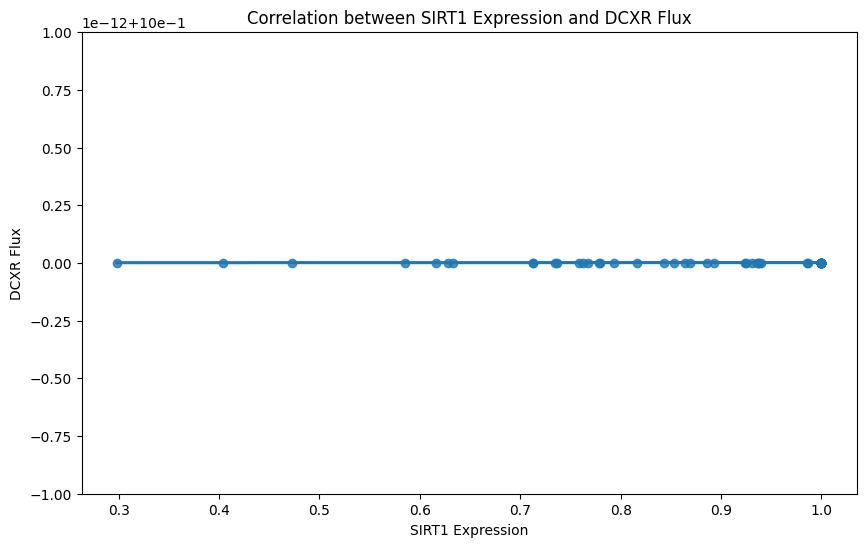

Linear regression results for SIRT1 and DCXR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



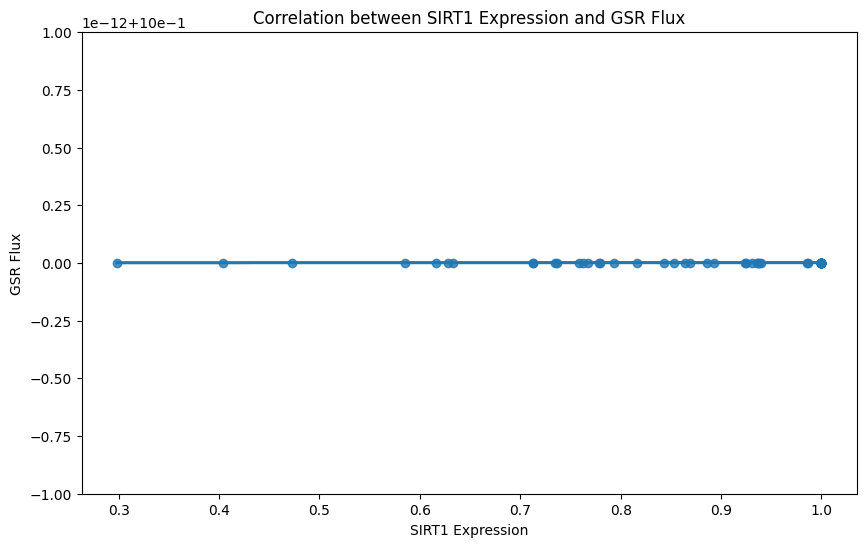

Linear regression results for SIRT1 and GSR:
Slope: 0.0
Intercept: 1.0
R-squared: 0.0
P-value: 1.0
Standard error: 0.0



KeyboardInterrupt: 

In [58]:
# Loop through each flux column and plot scatter plots
for column in non_zero_df_T.columns:
    if column != 'SIRT1':
        plt.figure(figsize=(10, 6))
        sns.regplot(x='SIRT1', y=column, data=non_zero_df_T)
        plt.title(f'Correlation between SIRT1 Expression and {column} Flux')
        plt.xlabel('SIRT1 Expression')
        plt.ylabel(f'{column} Flux')
        plt.show()
        
        # Perform linear regression for each flux column
        slope, intercept, r_value, p_value, std_err = linregress(non_zero_df_T['SIRT1'], non_zero_df_T[column])
        print(f"Linear regression results for SIRT1 and {column}:\n"
              f"Slope: {slope}\n"
              f"Intercept: {intercept}\n"
              f"R-squared: {r_value**2}\n"
              f"P-value: {p_value}\n"
              f"Standard error: {std_err}\n")
